In [1]:
import json
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
import tensorflow as tf
from hyperopt import Trials, STATUS_OK, tpe
from hyperas import optim
from keras.optimizers import SGD
from hyperas.distributions import choice, uniform
from keras.layers import Dense, Dropout, Activation
import keras
from sklearn.metrics import mean_squared_error
import math
from sklearn.metrics import plot_confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sn
from sklearn.metrics import mean_absolute_error
import seaborn as sns
from sklearn import preprocessing



Using TensorFlow backend.


In [3]:
import import_ipynb

import predictionLambda as pl


In [5]:
df_results.columns

NameError: name 'df_results' is not defined

In [6]:
df_core = pd.read_csv('./results-montage.csv')
df_more_data = pd.read_csv('./montage-more-data.csv')
df_results = pd.concat([df_core, df_more_data])
df_results = df_results.reset_index(drop=True)

In [7]:
df_results_tmp = df_results[df_results['task_type'] == 5 ]

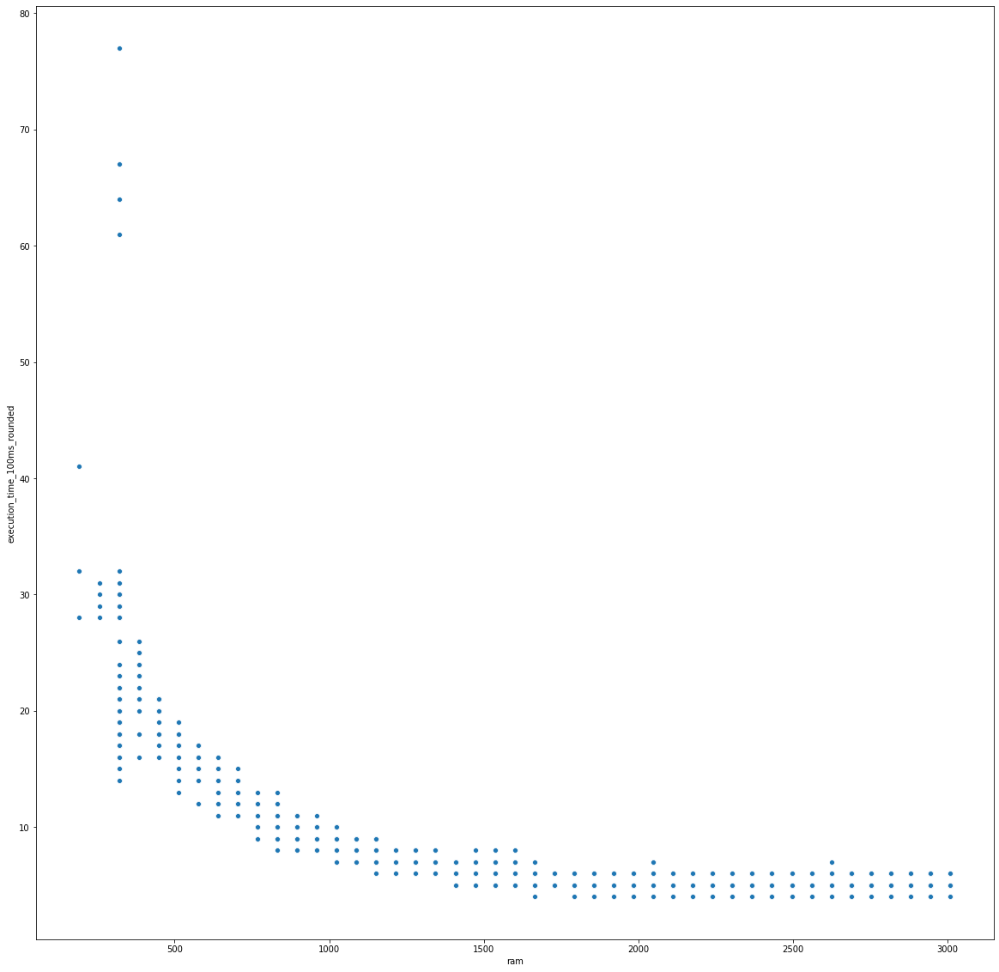

In [8]:
plt.figure(figsize=(20,20))
sns.scatterplot(data=df_results_tmp, x='ram', y='execution_time_100ms_rounded')

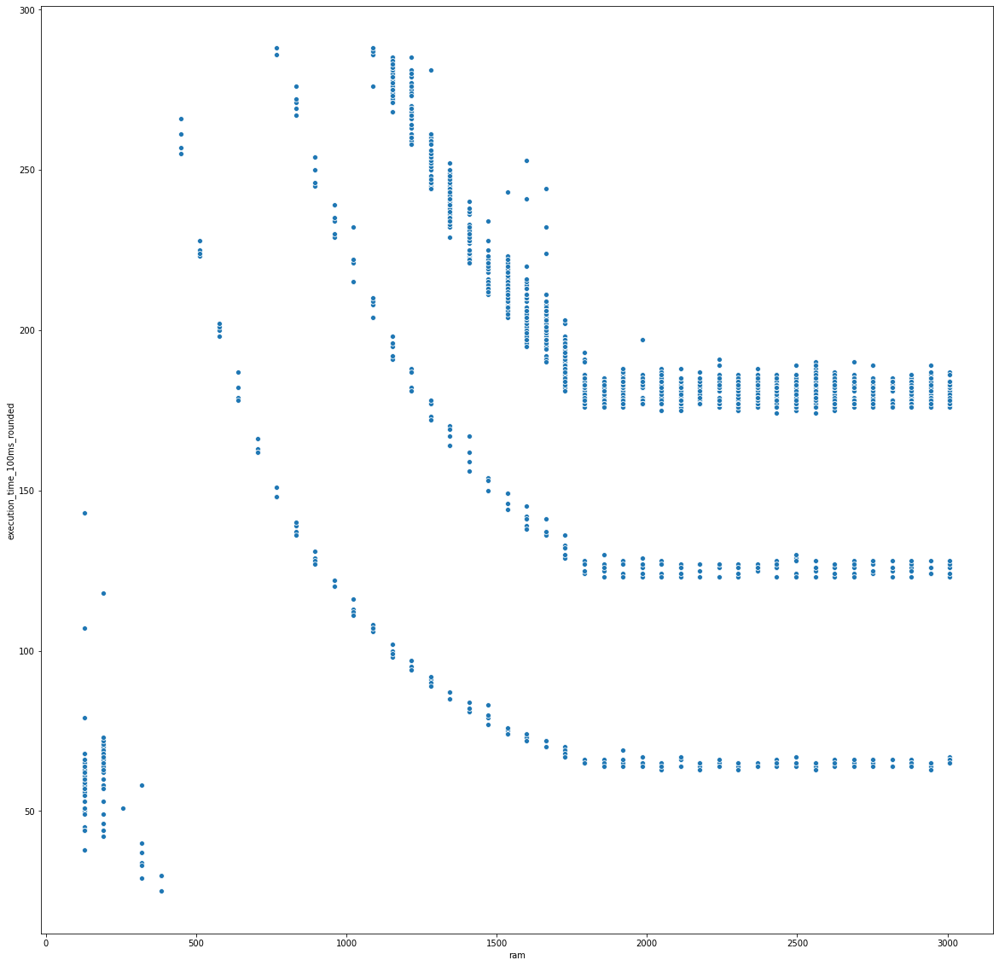

In [41]:
plt.figure(figsize=(20,20))
sns.scatterplot(data=df_results_tmp, x='ram', y='execution_time_100ms_rounded')

In [66]:
# find  NaN entries in your df
nanEntries = df_results[(df_results['task_type'] == 7) & (df_results['ram'] > 1800)].index.tolist()
# choose 10% randomly
dropIndices = np.random.default_rng().choice(nanEntries, size = int(df_results[(df_results['task_type'] == 7) & (df_results['ram'] > 1800)].shape[0]*0.6), replace=False)
# drop them
df_results = df_results.drop(dropIndices)

In [4]:
df_results = pd.read_csv('./results_after_removal.csv')


In [68]:
df_results.to_csv("results_after_removal.csv")

,Unnamed: 0,ram,ram_mapped,execution_time_100ms_rounded,execution_time_100ms_rounded_normalized,successed,upload_time_100ms_rounded,upload_time_100ms_rounded_normalized,download_time_100ms_rounded,download_time_100ms_rounded_normalized,...,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow,workflow_size,workflow_size_mapped
124,1017,192,39.0,NaN,NaN,1,NaN,NaN,NaN,NaN,...,14.199130,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0
125,1029,192,39.0,NaN,NaN,1,NaN,NaN,NaN,NaN,...,14.203263,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0
126,1034,192,39.0,NaN,NaN,1,NaN,NaN,NaN,NaN,...,14.202171,15.241410,15.241410,15.241410,2,15.934557,15.595658,montage,0.35,1.0
128,1046,192,39.0,NaN,NaN,1,NaN,NaN,NaN,NaN,...,19.715621,16.357402,16.357402,16.357402,2,17.050549,15.578064,montage,0.35,1.0
135,1074,192,39.0,NaN,NaN,1,NaN,NaN,NaN,NaN,...,14.242126,15.237249,15.237249,15.237249,2,15.930396,15.595658,montage,0.35,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20625,104696,960,34.0,NaN,NaN,1,NaN,NaN,NaN,NaN,...,11.039990,7.814400,7.814400,7.814400,1,7.814400,13.733667,montage,0.35,1.0
20627,104698,960,34.0,NaN,NaN,1,NaN,NaN,NaN,NaN,...,11.039990,7.814400,7.814400,7.814400,1,7.814400,13.733667,montage,0.35,1.0
20631,104702,960,34.0,NaN,NaN,1,NaN,NaN,NaN,NaN,...,11.039990,7.814400,7.814400,7.814400,1,7.814400,13.733667,montage,0.35,1.0
20641,104712,960,34.0,NaN,NaN,1,NaN,NaN,NaN,NaN,...,11.039990,7.814400,7.814400,7.814400,1,7.814400,13.733667,montage,0.35,1.0


In [8]:
x = df_results.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
df = pd.DataFrame(x_scaled)

ValueError: could not convert string to float: 'mConcatFit_1'

In [35]:
def model(x_train, y_train, x_test, y_test):
    model = keras.models.Sequential()
    model.add(Dense({{choice([50,70,90])}}))
    model.add(Activation('relu'))
    model.add(Dropout({{uniform(0.02, 0.1)}}))
    model.add(Dense({{choice([50,70,90])}}))
    model.add(Activation('relu'))
    model.add(Dropout({{uniform(0.02, 0.1)}}))
    
    model.add(Dense({{choice([50,70,90])}}))
    model.add(Activation('relu'))
    model.add(Dropout({{uniform(0.02, 0.1)}}))
        
    model.add(Dense(1))
    model.add(Activation('linear'))

    
    optim = {{choice(['rmsprop'])}}
    model.compile(loss='mean_squared_error', metrics=['accuracy'],optimizer='rmsprop')
        
    model.fit(x_train, y_train,
              batch_size={{choice([64,128,256])}},
              epochs={{choice([750,1000,1250])}},
              verbose=2)

    y_pred = model.predict(x_test)
    y_pred = np.nan_to_num(y_pred)
    error = mean_squared_error(y_test, y_pred)
    print('Test error:', error)
    return {'loss': error, 'status': STATUS_OK, 'model': model}

In [17]:
def model_failed(x_train, y_train, x_test, y_test):
    model = keras.models.Sequential()
    model.add(Dense({{choice([50,70,90])}}))
    model.add(Activation('relu'))
    model.add(Dropout({{uniform(0, 0.3)}}))
    model.add(Dense({{choice([50,70,90])}}))
    model.add(Activation('relu'))
    model.add(Dropout({{uniform(0, 0.3)}}))

    model.add(Dense(1))
    model.add(Activation('sigmoid'))

    
    adam = keras.optimizers.Adam(lr={{uniform(0.0001, 0.1)}})

    model.compile(loss='binary_crossentropy', metrics=['accuracy'],optimizer='adam')
        
    model.fit(x_train, y_train,
              batch_size={{choice([32,64,128,256])}},
              epochs={{choice([100,200,500,1000])}},
              verbose=2)

    y_pred = model.predict(x_test)
    y_pred = np.nan_to_num(y_pred)
    error = mean_squared_error(y_test, y_pred)
    print('Test error:', error)
    return {'loss': error, 'status': STATUS_OK, 'model': model}

In [34]:
def data():
    
    df_x = pd.read_csv('x_normalized.csv')
    df_y = pd.read_csv('y_normalized.csv')

    x = df_x.values
    y = df_y.values

    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    return x_train, y_train, x_test, y_test

In [82]:
def data_more():
    
    df_x = pd.read_csv('x_more_data.csv')
    df_y = pd.read_csv('y_more_data.csv')

    x = df_x.values
    y = df_y.values

    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    return x_train, y_train, x_test, y_test

In [13]:
def data_even():
    
    df_x = pd.read_csv('x.csv')
    df_y = pd.read_csv('y.csv')
 
    y = df_y.values
    x = df_x.values
    
    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    
    x_y_train = np.concatenate((x_train, y_train), axis=1)
    
    x_y_train_new = np.asarray([x for x in x_y_train if x[0] % 2 == 0 ])
    
    
    x_train = x_y_train_new[:,:-1]
    y_train = x_y_train_new[:,-1]

    return x_train, y_train, x_test, y_test

In [14]:
def data_1_run():
    def append_to_dict(my_dict, key):
        if key in my_dict:
            my_dict[key] += 1
        else:
            my_dict[key] = 1
        return my_dict[key] < 2   
    
    df_x = pd.read_csv('x_with_id.csv')
    df_y = pd.read_csv('y_with_id.csv')
         
    y = df_y.values
    x = df_x.values
    
    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    
    x_y_train = np.concatenate((x_train, y_train), axis=1)
    
    ram_number_dict = dict()
    x_y_train_new = np.asarray([x for x in x_y_train if append_to_dict(ram_number_dict, str(x[0]) + '_' + str(x[1]) + '_' + str(x[4]) + '_' + str(x[-2]))])
            
    x_train = x_y_train_new[:,:-1]
    x_train = np.delete(x_train, 1, 1)
    y_train = x_y_train_new[:,-1]
    x_test = np.delete(x_test, 1, 1)

    return x_train, y_train, x_test, y_test

In [8]:
def data_failed():
    
    df_x = pd.read_csv('x_failed_normalized.csv')
    df_y = pd.read_csv('y_failed_normalized.csv')

    x = df_x.values
    y = df_y.values

    x = np.asarray(x).astype('float32')
    y = np.asarray(y).astype('float32')
    x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, random_state = 0)
    return x_train, y_train, x_test, y_test

Tutaj jakis teskst


In [21]:
df_results = df_results[df_results['successed'] == 0]
df_y = df_results['lambda_time_100ms_rounded']
del df_results['lambda_time_100ms_rounded']
del df_results['download_time_100ms_rounded_normalized']
del df_results['ram_mapped']
del df_results['execution_time_100ms_rounded']
del df_results['execution_time_100ms_rounded_normalized']
del df_results['upload_time_100ms_rounded']
del df_results['upload_time_100ms_rounded_normalized']
del df_results['download_time_100ms_rounded']





In [23]:
del df_results['successed']
del df_results['lambda_time_100ms_rounded_normalized']
#del df_results['task_id']
#del df_results['workflow']
#del df_results['workflow_size']
#del df_results['Unnamed: 0']

KeyError: 'successed'

In [13]:
x = df_results.values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
df = pd.DataFrame(min_max_scaler.fit_transform(df_results), columns=df_results.columns, index=df_results.index)
df

,Unnamed: 0,ram,ram_mapped,execution_time_100ms_rounded,execution_time_100ms_rounded_normalized,successed,upload_time_100ms_rounded,upload_time_100ms_rounded_normalized,download_time_100ms_rounded,download_time_100ms_rounded_normalized,...,avg_size_in_ln,count_in_ln,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow_size_mapped
0,0.000000,0.488889,0.466667,0.055749,0.055749,0.0,0.000000,0.000000,0.035874,0.037559,...,0.000372,1.000000,0.147687,0.479222,0.479222,0.479222,0.0,0.450351,0.032764,0.0
1,0.000052,0.488889,0.466667,0.013937,0.013937,0.0,0.000000,0.000000,0.008969,0.009390,...,0.870938,0.298648,0.684250,0.003891,0.003891,0.003891,0.0,0.003657,0.000000,0.0
2,0.000078,0.488889,0.466667,0.557491,0.557491,0.0,0.009524,0.007576,0.004484,0.004695,...,0.729684,0.128621,0.440960,0.896399,0.896399,0.896399,1.0,0.902641,1.000000,0.0
3,0.000096,0.488889,0.466667,0.560976,0.560976,0.0,0.019048,0.015152,0.004484,0.004695,...,0.725344,0.128621,0.436360,0.896976,0.896976,0.896976,1.0,0.903183,1.000000,0.0
4,0.000156,0.488889,0.466667,0.560976,0.560976,0.0,0.009524,0.007576,0.000000,0.000000,...,0.725479,0.128621,0.436503,0.896784,0.896784,0.896784,1.0,0.903003,1.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26933,0.999948,0.977778,0.311111,0.038328,0.038328,0.0,0.009524,0.017857,0.008969,0.008969,...,1.000000,0.000000,0.656639,0.764553,0.764553,0.764553,0.0,0.718492,0.921610,0.0
26934,0.999957,0.977778,0.311111,0.059233,0.059233,0.0,0.000000,0.000000,0.017937,0.017937,...,0.000133,1.000000,0.147433,0.479222,0.479222,0.479222,0.0,0.450351,0.032764,0.0
26935,0.999974,0.977778,0.311111,0.027875,0.027875,0.0,0.028571,0.053571,0.197309,0.197309,...,0.890306,0.834988,1.000000,1.000000,1.000000,1.000000,1.0,1.000000,0.991510,0.0
26936,0.999991,0.977778,0.311111,0.013937,0.013937,0.0,0.000000,0.000000,0.080717,0.080717,...,0.889860,0.706367,0.928728,0.403442,0.403442,0.403442,0.0,0.379136,0.998439,0.0


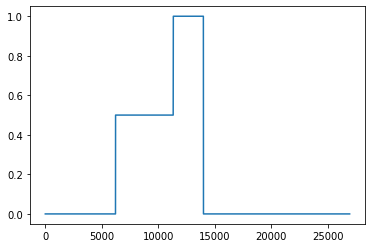

In [18]:
df_results['task_id'] = df_results['task_id'].str.split('_').str[1]

<ipython-input-18-c2d8a4b71457>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_results['task_id'] = df_results['task_id'].str.split('_').str[1]


In [97]:
df_results

,ram_mapped,task_count_log,all_tasks_count_log,task_type,min_size_in_ln,max_size_in_ln,avg_size_in_ln,count_in_ln,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow_size_mapped
0,22.0,0.477121,2.970347,2,5.545177,10.270212,5.985465,5.389072,11.374537,10.726632,10.726632,10.726632,1,10.726632,13.591236,1.0
14,22.0,2.815578,2.970347,1,5.624018,15.239332,15.016205,1.609438,16.625643,5.598422,5.598422,5.598422,1,5.598422,13.523338,1.0
19,22.0,2.815578,2.970347,1,5.624018,15.241410,15.018283,1.609438,16.627721,5.598422,5.598422,5.598422,1,5.598422,13.523338,1.0
20,22.0,2.120574,2.970347,4,7.814400,15.239332,14.547365,1.386294,15.933660,15.239332,15.239332,15.239332,2,15.932479,15.572224,1.0
30,22.0,0.477121,2.970347,6,5.616771,15.240718,15.215811,4.499810,19.715621,16.357402,16.357402,16.357402,2,17.050549,15.578064,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115040,15.0,0.477121,2.970347,5,8.900549,15.239332,15.214611,3.806662,19.021274,9.907280,9.907280,9.907280,1,9.907280,15.592423,1.0
115041,15.0,0.477121,2.970347,2,5.552960,10.270212,5.985063,5.389072,11.374135,10.726632,10.726632,10.726632,1,10.726632,13.591236,1.0
115042,15.0,0.477121,2.970347,5,8.900549,15.244175,15.219229,3.806662,19.025891,9.907280,9.907280,9.907280,1,9.907280,15.592423,1.0
115043,15.0,0.477121,2.970347,6,5.616771,15.240718,15.215811,4.499810,19.715621,16.357402,16.357402,16.357402,2,17.050549,15.578064,1.0


In [9]:
df_results = df_results.rename(columns={"successed": "failed"})
df_y_failed = df_results['failed']
del df_results['lambda_time_100ms_rounded']
del df_results['download_time_100ms_rounded_normalized']
del df_results['ram_mapped']
del df_results['execution_time_100ms_rounded']
del df_results['execution_time_100ms_rounded_normalized']
del df_results['upload_time_100ms_rounded']
del df_results['upload_time_100ms_rounded_normalized']
del df_results['download_time_100ms_rounded']  
del df_results['task_id']
del df_results['workflow']
del df_results['workflow_size'] 
del df_results['failed']


In [10]:
del df_results['lambda_time_100ms_rounded_normalized']


In [48]:
del df_results['task_count_log']
del df_results['all_tasks_count_log']
del df_results['min_size_in_ln']
del df_results['max_size_in_ln']
del df_results['count_in_ln']
del df_results['min_size_out_ln']
del df_results['max_size_out_ln']
del df_results['count_out']



In [12]:
del df_results['Unnamed: 0']

df_x = df_results
df_x

,ram,task_count_log,all_tasks_count_log,task_type,min_size_in_ln,max_size_in_ln,avg_size_in_ln,count_in_ln,sum_in_ln,min_size_out_ln,max_size_out_ln,avg_size_out_ln,count_out,sum_out_ln,exec_file_size_ln,workflow_size_mapped
0,1536,0.477121,2.970347,2,5.545177,10.270212,5.985465,5.389072,11.374537,10.726632,10.726632,10.726632,1,10.726632,13.591236,1.0
1,1536,2.815578,2.970347,1,5.624018,15.241410,15.018283,1.609438,16.627721,5.587249,5.587249,5.587249,1,5.587249,13.523338,1.0
2,1536,2.120574,2.970347,0,5.624018,14.245625,13.552658,0.693147,14.245806,15.237249,15.237249,15.237249,2,15.930396,15.595658,1.0
3,1536,2.120574,2.970347,0,5.624018,14.200582,13.507623,0.693147,14.200770,15.243484,15.243484,15.243484,2,15.936631,15.595658,1.0
4,1536,2.120574,2.970347,0,5.624018,14.201983,13.509024,0.693147,14.202171,15.241410,15.241410,15.241410,2,15.934557,15.595658,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
26933,2944,0.602060,2.970347,7,16.357402,16.357402,16.357402,0.000000,16.357402,13.811694,13.811694,13.811694,1,13.811694,15.433209,1.0
26934,2944,0.477121,2.970347,2,5.545177,10.270212,5.982981,5.389072,11.372053,10.726632,10.726632,10.726632,1,10.726632,13.591236,1.0
26935,2944,0.477121,2.970347,6,5.616771,15.244175,15.219244,4.499810,19.719054,16.357402,16.357402,16.357402,2,17.050549,15.578064,1.0
26936,2944,0.477121,2.970347,5,8.900549,15.239332,15.214611,3.806662,19.021274,9.907280,9.907280,9.907280,1,9.907280,15.592423,1.0


In [14]:
df_y_failed

0        0
1        0
2        0
3        0
4        0
        ..
26933    0
26934    0
26935    0
26936    0
26937    0
Name: failed, Length: 26938, dtype: int64

In [15]:
df_x.to_csv('x_failed_normalized.csv', index=False)
df_y_failed.to_csv('y_failed_normalized.csv', index=False)


In [36]:
x_train, y_train, x_test, y_test = data()

best_run, best_model = optim.minimize(model=model, data = data,
                                      algo=tpe.suggest,
                                      max_evals=200,
                                      trials=Trials(),
                                      notebook_name='predictionLambda')

>>> Imports:
#coding=utf-8

try:
    import json
except:
    pass

try:
    import pandas as pd
except:
    pass

try:
    import numpy as np
except:
    pass

try:
    from sklearn.model_selection import train_test_split
except:
    pass

try:
    import tensorflow as tf
except:
    pass

try:
    from hyperopt import Trials, STATUS_OK, tpe
except:
    pass

try:
    from hyperas import optim
except:
    pass

try:
    from keras.optimizers import SGD
except:
    pass

try:
    from hyperas.distributions import choice, uniform
except:
    pass

try:
    from keras.layers import Dense, Dropout, Activation
except:
    pass

try:
    import keras
except:
    pass

try:
    from sklearn.metrics import mean_squared_error
except:
    pass

try:
    import math
except:
    pass

try:
    from sklearn.metrics import plot_confusion_matrix
except:
    pass

try:
    import matplotlib.pyplot as plt
except:
    pass

try:
    import seaborn as sn
except:
    pass

try:
    from sklearn.metrics im

Epoch 115/1250                                         
 - 0s - loss: 8.1096e-04 - accuracy: 6.3606e-04        

Epoch 116/1250                                         
 - 0s - loss: 8.5105e-04 - accuracy: 6.3606e-04        

Epoch 117/1250                                         
 - 0s - loss: 8.2260e-04 - accuracy: 6.3606e-04        

Epoch 118/1250                                         
 - 0s - loss: 8.4258e-04 - accuracy: 6.3606e-04        

Epoch 119/1250                                         
 - 0s - loss: 8.1017e-04 - accuracy: 6.3606e-04        

Epoch 120/1250                                         
 - 0s - loss: 8.2876e-04 - accuracy: 6.3606e-04        

Epoch 121/1250                                         
 - 0s - loss: 8.3510e-04 - accuracy: 6.3606e-04        

Epoch 122/1250                                         
 - 0s - loss: 8.2220e-04 - accuracy: 6.3606e-04        

Epoch 123/1250                                         
 - 0s - loss: 8.3961e-04 - accuracy: 6.3

Epoch 260/1250                                         
 - 0s - loss: 7.3582e-04 - accuracy: 6.3606e-04        

Epoch 261/1250                                         
 - 0s - loss: 7.3531e-04 - accuracy: 6.3606e-04        

Epoch 262/1250                                         
 - 0s - loss: 7.1136e-04 - accuracy: 6.3606e-04        

Epoch 263/1250                                         
 - 0s - loss: 7.2134e-04 - accuracy: 6.3606e-04        

Epoch 264/1250                                         
 - 0s - loss: 7.2009e-04 - accuracy: 6.3606e-04        

Epoch 265/1250                                         
 - 0s - loss: 7.2204e-04 - accuracy: 6.3606e-04        

Epoch 266/1250                                         
 - 0s - loss: 7.0687e-04 - accuracy: 6.3606e-04        

Epoch 267/1250                                         
 - 0s - loss: 7.2928e-04 - accuracy: 6.3606e-04        

Epoch 268/1250                                         
 - 0s - loss: 7.1383e-04 - accuracy: 6.3

Epoch 405/1250                                         
 - 0s - loss: 6.8369e-04 - accuracy: 6.3606e-04        

Epoch 406/1250                                         
 - 0s - loss: 6.7694e-04 - accuracy: 6.3606e-04        

Epoch 407/1250                                         
 - 0s - loss: 6.9432e-04 - accuracy: 6.3606e-04        

Epoch 408/1250                                         
 - 0s - loss: 6.7723e-04 - accuracy: 6.3606e-04        

Epoch 409/1250                                         
 - 0s - loss: 7.0816e-04 - accuracy: 6.3606e-04        

Epoch 410/1250                                         
 - 0s - loss: 6.9663e-04 - accuracy: 6.3606e-04        

Epoch 411/1250                                         
 - 0s - loss: 7.0974e-04 - accuracy: 6.3606e-04        

Epoch 412/1250                                         
 - 0s - loss: 7.0278e-04 - accuracy: 6.3606e-04        

Epoch 413/1250                                         
 - 0s - loss: 6.9052e-04 - accuracy: 6.3

Epoch 550/1250                                         
 - 0s - loss: 6.7775e-04 - accuracy: 6.3606e-04        

Epoch 551/1250                                         
 - 0s - loss: 6.8207e-04 - accuracy: 6.3606e-04        

Epoch 552/1250                                         
 - 0s - loss: 6.7184e-04 - accuracy: 6.3606e-04        

Epoch 553/1250                                         
 - 0s - loss: 6.6474e-04 - accuracy: 6.3606e-04        

Epoch 554/1250                                         
 - 0s - loss: 6.7535e-04 - accuracy: 6.3606e-04        

Epoch 555/1250                                         
 - 0s - loss: 6.6340e-04 - accuracy: 6.3606e-04        

Epoch 556/1250                                         
 - 0s - loss: 6.8459e-04 - accuracy: 6.3606e-04        

Epoch 557/1250                                         
 - 0s - loss: 6.8244e-04 - accuracy: 6.3606e-04        

Epoch 558/1250                                         
 - 0s - loss: 6.7285e-04 - accuracy: 6.3

Epoch 695/1250                                         
 - 0s - loss: 6.7312e-04 - accuracy: 6.3606e-04        

Epoch 696/1250                                         
 - 0s - loss: 6.6023e-04 - accuracy: 6.3606e-04        

Epoch 697/1250                                         
 - 0s - loss: 6.6193e-04 - accuracy: 6.3606e-04        

Epoch 698/1250                                         
 - 0s - loss: 6.6980e-04 - accuracy: 6.3606e-04        

Epoch 699/1250                                         
 - 0s - loss: 6.5895e-04 - accuracy: 6.3606e-04        

Epoch 700/1250                                         
 - 0s - loss: 6.7329e-04 - accuracy: 6.3606e-04        

Epoch 701/1250                                         
 - 0s - loss: 6.6310e-04 - accuracy: 6.3606e-04        

Epoch 702/1250                                         
 - 0s - loss: 6.6312e-04 - accuracy: 6.3606e-04        

Epoch 703/1250                                         
 - 0s - loss: 6.5539e-04 - accuracy: 6.3

Epoch 840/1250                                         
 - 0s - loss: 6.7209e-04 - accuracy: 6.3606e-04        

Epoch 841/1250                                         
 - 0s - loss: 6.6554e-04 - accuracy: 6.3606e-04        

Epoch 842/1250                                         
 - 0s - loss: 6.8321e-04 - accuracy: 6.3606e-04        

Epoch 843/1250                                         
 - 0s - loss: 6.5176e-04 - accuracy: 6.3606e-04        

Epoch 844/1250                                         
 - 0s - loss: 6.7041e-04 - accuracy: 6.3606e-04        

Epoch 845/1250                                         
 - 0s - loss: 6.7172e-04 - accuracy: 6.3606e-04        

Epoch 846/1250                                         
 - 0s - loss: 6.8030e-04 - accuracy: 6.3606e-04        

Epoch 847/1250                                         
 - 0s - loss: 6.4706e-04 - accuracy: 6.3606e-04        

Epoch 848/1250                                         
 - 0s - loss: 6.6489e-04 - accuracy: 6.3

Epoch 985/1250                                         
 - 0s - loss: 6.4560e-04 - accuracy: 6.3606e-04        

Epoch 986/1250                                         
 - 0s - loss: 6.4555e-04 - accuracy: 6.3606e-04        

Epoch 987/1250                                         
 - 0s - loss: 6.5926e-04 - accuracy: 6.3606e-04        

Epoch 988/1250                                         
 - 0s - loss: 6.5696e-04 - accuracy: 6.3606e-04        

Epoch 989/1250                                         
 - 0s - loss: 6.4564e-04 - accuracy: 6.3606e-04        

Epoch 990/1250                                         
 - 0s - loss: 6.5218e-04 - accuracy: 6.3606e-04        

Epoch 991/1250                                         
 - 0s - loss: 6.5035e-04 - accuracy: 6.3606e-04        

Epoch 992/1250                                         
 - 0s - loss: 6.8076e-04 - accuracy: 6.3606e-04        

Epoch 993/1250                                         
 - 0s - loss: 6.6035e-04 - accuracy: 6.3

Epoch 1130/1250                                        
 - 0s - loss: 6.7427e-04 - accuracy: 6.3606e-04        

Epoch 1131/1250                                        
 - 0s - loss: 6.6996e-04 - accuracy: 6.3606e-04        

Epoch 1132/1250                                        
 - 0s - loss: 6.4145e-04 - accuracy: 6.3606e-04        

Epoch 1133/1250                                        
 - 0s - loss: 6.7247e-04 - accuracy: 6.3606e-04        

Epoch 1134/1250                                        
 - 0s - loss: 6.5665e-04 - accuracy: 6.3606e-04        

Epoch 1135/1250                                        
 - 0s - loss: 6.5783e-04 - accuracy: 6.3606e-04        

Epoch 1136/1250                                        
 - 0s - loss: 6.3021e-04 - accuracy: 6.3606e-04        

Epoch 1137/1250                                        
 - 0s - loss: 6.4826e-04 - accuracy: 6.3606e-04        

Epoch 1138/1250                                        
 - 0s - loss: 6.5586e-04 - accuracy: 6.3

 - 0s - loss: 0.0029 - accuracy: 6.3606e-04                                             

Epoch 16/750                                                                            
 - 0s - loss: 0.0028 - accuracy: 6.3606e-04                                             

Epoch 17/750                                                                            
 - 0s - loss: 0.0025 - accuracy: 6.3606e-04                                             

Epoch 18/750                                                                            
 - 0s - loss: 0.0026 - accuracy: 6.3606e-04                                             

Epoch 19/750                                                                            
 - 0s - loss: 0.0025 - accuracy: 6.3606e-04                                             

Epoch 20/750                                                                            
 - 0s - loss: 0.0023 - accuracy: 6.3606e-04                                             

Epoch 21/750   

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                             

Epoch 107/750                                                                           
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                             

Epoch 108/750                                                                           
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                             

Epoch 109/750                                                                           
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                             

Epoch 110/750                                                                           
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                             

Epoch 111/750                                                                           
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                             

Epoch 112/750  

 - 0s - loss: 9.3946e-04 - accuracy: 6.3606e-04                                         

Epoch 198/750                                                                           
 - 0s - loss: 9.3409e-04 - accuracy: 6.3606e-04                                         

Epoch 199/750                                                                           
 - 0s - loss: 9.7447e-04 - accuracy: 6.3606e-04                                         

Epoch 200/750                                                                           
 - 0s - loss: 9.4835e-04 - accuracy: 6.3606e-04                                         

Epoch 201/750                                                                           
 - 0s - loss: 9.7452e-04 - accuracy: 6.3606e-04                                         

Epoch 202/750                                                                           
 - 0s - loss: 9.4313e-04 - accuracy: 6.3606e-04                                         

Epoch 203/750  

 - 0s - loss: 8.6375e-04 - accuracy: 6.3606e-04                                         

Epoch 289/750                                                                           
 - 0s - loss: 8.7431e-04 - accuracy: 6.3606e-04                                         

Epoch 290/750                                                                           
 - 0s - loss: 8.5898e-04 - accuracy: 6.3606e-04                                         

Epoch 291/750                                                                           
 - 0s - loss: 8.9555e-04 - accuracy: 6.3606e-04                                         

Epoch 292/750                                                                           
 - 0s - loss: 8.6673e-04 - accuracy: 6.3606e-04                                         

Epoch 293/750                                                                           
 - 0s - loss: 8.7442e-04 - accuracy: 6.3606e-04                                         

Epoch 294/750  

 - 0s - loss: 8.1418e-04 - accuracy: 6.3606e-04                                         

Epoch 380/750                                                                           
 - 0s - loss: 8.2155e-04 - accuracy: 6.3606e-04                                         

Epoch 381/750                                                                           
 - 0s - loss: 8.2218e-04 - accuracy: 6.3606e-04                                         

Epoch 382/750                                                                           
 - 0s - loss: 8.0598e-04 - accuracy: 6.3606e-04                                         

Epoch 383/750                                                                           
 - 0s - loss: 8.5060e-04 - accuracy: 6.3606e-04                                         

Epoch 384/750                                                                           
 - 0s - loss: 8.0373e-04 - accuracy: 6.3606e-04                                         

Epoch 385/750  

 - 0s - loss: 7.9645e-04 - accuracy: 6.3606e-04                                         

Epoch 471/750                                                                           
 - 0s - loss: 8.0634e-04 - accuracy: 6.3606e-04                                         

Epoch 472/750                                                                           
 - 0s - loss: 8.0902e-04 - accuracy: 6.3606e-04                                         

Epoch 473/750                                                                           
 - 0s - loss: 8.0884e-04 - accuracy: 6.3606e-04                                         

Epoch 474/750                                                                           
 - 0s - loss: 7.8151e-04 - accuracy: 6.3606e-04                                         

Epoch 475/750                                                                           
 - 0s - loss: 8.1639e-04 - accuracy: 6.3606e-04                                         

Epoch 476/750  

 - 0s - loss: 7.8295e-04 - accuracy: 6.3606e-04                                         

Epoch 562/750                                                                           
 - 0s - loss: 7.5701e-04 - accuracy: 6.3606e-04                                         

Epoch 563/750                                                                           
 - 0s - loss: 7.8434e-04 - accuracy: 6.3606e-04                                         

Epoch 564/750                                                                           
 - 0s - loss: 7.5410e-04 - accuracy: 6.3606e-04                                         

Epoch 565/750                                                                           
 - 0s - loss: 7.8111e-04 - accuracy: 6.3606e-04                                         

Epoch 566/750                                                                           
 - 0s - loss: 7.7709e-04 - accuracy: 6.3606e-04                                         

Epoch 567/750  

 - 0s - loss: 7.6218e-04 - accuracy: 6.3606e-04                                         

Epoch 653/750                                                                           
 - 0s - loss: 7.5370e-04 - accuracy: 6.3606e-04                                         

Epoch 654/750                                                                           
 - 0s - loss: 7.7972e-04 - accuracy: 6.3606e-04                                         

Epoch 655/750                                                                           
 - 0s - loss: 7.4795e-04 - accuracy: 6.3606e-04                                         

Epoch 656/750                                                                           
 - 0s - loss: 7.5048e-04 - accuracy: 6.3606e-04                                         

Epoch 657/750                                                                           
 - 0s - loss: 7.4780e-04 - accuracy: 6.3606e-04                                         

Epoch 658/750  

 - 0s - loss: 7.5461e-04 - accuracy: 6.3606e-04                                         

Epoch 744/750                                                                           
 - 0s - loss: 7.5976e-04 - accuracy: 6.3606e-04                                         

Epoch 745/750                                                                           
 - 0s - loss: 7.5347e-04 - accuracy: 6.3606e-04                                         

Epoch 746/750                                                                           
 - 0s - loss: 7.3900e-04 - accuracy: 6.3606e-04                                         

Epoch 747/750                                                                           
 - 0s - loss: 7.5728e-04 - accuracy: 6.3606e-04                                         

Epoch 748/750                                                                           
 - 0s - loss: 7.5811e-04 - accuracy: 6.3606e-04                                         

Epoch 749/750  

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                             

Epoch 84/1000                                                                           
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                             

Epoch 85/1000                                                                           
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                             

Epoch 86/1000                                                                           
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                             

Epoch 87/1000                                                                           
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                             

Epoch 88/1000                                                                           
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                             

Epoch 89/1000  

 - 0s - loss: 8.4861e-04 - accuracy: 6.3606e-04                                         

Epoch 175/1000                                                                          
 - 0s - loss: 8.0785e-04 - accuracy: 6.3606e-04                                         

Epoch 176/1000                                                                          
 - 0s - loss: 8.1394e-04 - accuracy: 6.3606e-04                                         

Epoch 177/1000                                                                          
 - 0s - loss: 8.0783e-04 - accuracy: 6.3606e-04                                         

Epoch 178/1000                                                                          
 - 0s - loss: 8.2230e-04 - accuracy: 6.3606e-04                                         

Epoch 179/1000                                                                          
 - 0s - loss: 8.4544e-04 - accuracy: 6.3606e-04                                         

Epoch 180/1000 

 - 0s - loss: 7.5263e-04 - accuracy: 6.3606e-04                                         

Epoch 266/1000                                                                          
 - 0s - loss: 7.6523e-04 - accuracy: 6.3606e-04                                         

Epoch 267/1000                                                                          
 - 0s - loss: 7.5303e-04 - accuracy: 6.3606e-04                                         

Epoch 268/1000                                                                          
 - 0s - loss: 7.6518e-04 - accuracy: 6.3606e-04                                         

Epoch 269/1000                                                                          
 - 0s - loss: 7.8437e-04 - accuracy: 6.3606e-04                                         

Epoch 270/1000                                                                          
 - 0s - loss: 7.6183e-04 - accuracy: 6.3606e-04                                         

Epoch 271/1000 

 - 0s - loss: 6.9754e-04 - accuracy: 6.3606e-04                                         

Epoch 357/1000                                                                          
 - 0s - loss: 7.4140e-04 - accuracy: 6.3606e-04                                         

Epoch 358/1000                                                                          
 - 0s - loss: 7.3911e-04 - accuracy: 6.3606e-04                                         

Epoch 359/1000                                                                          
 - 0s - loss: 7.3416e-04 - accuracy: 6.3606e-04                                         

Epoch 360/1000                                                                          
 - 0s - loss: 7.3624e-04 - accuracy: 6.3606e-04                                         

Epoch 361/1000                                                                          
 - 0s - loss: 7.3982e-04 - accuracy: 6.3606e-04                                         

Epoch 362/1000 

 - 0s - loss: 7.1357e-04 - accuracy: 6.3606e-04                                         

Epoch 448/1000                                                                          
 - 0s - loss: 7.3162e-04 - accuracy: 6.3606e-04                                         

Epoch 449/1000                                                                          
 - 0s - loss: 7.3337e-04 - accuracy: 6.3606e-04                                         

Epoch 450/1000                                                                          
 - 0s - loss: 7.0798e-04 - accuracy: 6.3606e-04                                         

Epoch 451/1000                                                                          
 - 0s - loss: 7.0845e-04 - accuracy: 6.3606e-04                                         

Epoch 452/1000                                                                          
 - 0s - loss: 7.1198e-04 - accuracy: 6.3606e-04                                         

Epoch 453/1000 

 - 0s - loss: 6.9827e-04 - accuracy: 6.3606e-04                                         

Epoch 539/1000                                                                          
 - 0s - loss: 6.9874e-04 - accuracy: 6.3606e-04                                         

Epoch 540/1000                                                                          
 - 0s - loss: 7.0663e-04 - accuracy: 6.3606e-04                                         

Epoch 541/1000                                                                          
 - 0s - loss: 7.1555e-04 - accuracy: 6.3606e-04                                         

Epoch 542/1000                                                                          
 - 0s - loss: 6.8070e-04 - accuracy: 6.3606e-04                                         

Epoch 543/1000                                                                          
 - 0s - loss: 7.0783e-04 - accuracy: 6.3606e-04                                         

Epoch 544/1000 

 - 0s - loss: 6.9096e-04 - accuracy: 6.3606e-04                                         

Epoch 630/1000                                                                          
 - 0s - loss: 6.8488e-04 - accuracy: 6.3606e-04                                         

Epoch 631/1000                                                                          
 - 0s - loss: 7.0123e-04 - accuracy: 6.3606e-04                                         

Epoch 632/1000                                                                          
 - 0s - loss: 6.8231e-04 - accuracy: 6.3606e-04                                         

Epoch 633/1000                                                                          
 - 0s - loss: 6.9374e-04 - accuracy: 6.3606e-04                                         

Epoch 634/1000                                                                          
 - 0s - loss: 6.9709e-04 - accuracy: 6.3606e-04                                         

Epoch 635/1000 

 - 0s - loss: 6.7624e-04 - accuracy: 6.3606e-04                                         

Epoch 721/1000                                                                          
 - 0s - loss: 6.7888e-04 - accuracy: 6.3606e-04                                         

Epoch 722/1000                                                                          
 - 0s - loss: 6.9494e-04 - accuracy: 6.3606e-04                                         

Epoch 723/1000                                                                          
 - 0s - loss: 6.6594e-04 - accuracy: 6.3606e-04                                         

Epoch 724/1000                                                                          
 - 0s - loss: 6.9036e-04 - accuracy: 6.3606e-04                                         

Epoch 725/1000                                                                          
 - 0s - loss: 6.6670e-04 - accuracy: 6.3606e-04                                         

Epoch 726/1000 

 - 0s - loss: 6.6974e-04 - accuracy: 6.3606e-04                                         

Epoch 812/1000                                                                          
 - 0s - loss: 6.7105e-04 - accuracy: 6.3606e-04                                         

Epoch 813/1000                                                                          
 - 0s - loss: 6.7276e-04 - accuracy: 6.3606e-04                                         

Epoch 814/1000                                                                          
 - 0s - loss: 6.8339e-04 - accuracy: 6.3606e-04                                         

Epoch 815/1000                                                                          
 - 0s - loss: 6.6625e-04 - accuracy: 6.3606e-04                                         

Epoch 816/1000                                                                          
 - 0s - loss: 6.7038e-04 - accuracy: 6.3606e-04                                         

Epoch 817/1000 

 - 0s - loss: 6.7312e-04 - accuracy: 6.3606e-04                                         

Epoch 903/1000                                                                          
 - 0s - loss: 6.5327e-04 - accuracy: 6.3606e-04                                         

Epoch 904/1000                                                                          
 - 0s - loss: 6.5897e-04 - accuracy: 6.3606e-04                                         

Epoch 905/1000                                                                          
 - 0s - loss: 6.7368e-04 - accuracy: 6.3606e-04                                         

Epoch 906/1000                                                                          
 - 0s - loss: 6.5968e-04 - accuracy: 6.3606e-04                                         

Epoch 907/1000                                                                          
 - 0s - loss: 6.4401e-04 - accuracy: 6.3606e-04                                         

Epoch 908/1000 

 - 0s - loss: 6.5290e-04 - accuracy: 6.3606e-04                                         

Epoch 994/1000                                                                          
 - 0s - loss: 6.7407e-04 - accuracy: 6.3606e-04                                         

Epoch 995/1000                                                                          
 - 0s - loss: 6.5278e-04 - accuracy: 6.3606e-04                                         

Epoch 996/1000                                                                          
 - 0s - loss: 6.5383e-04 - accuracy: 6.3606e-04                                         

Epoch 997/1000                                                                          
 - 0s - loss: 6.5379e-04 - accuracy: 6.3606e-04                                         

Epoch 998/1000                                                                          
 - 0s - loss: 6.5744e-04 - accuracy: 6.3606e-04                                         

Epoch 999/1000 

 - 0s - loss: 9.4486e-04 - accuracy: 6.3606e-04                                         

Epoch 84/1000                                                                           
 - 0s - loss: 9.3343e-04 - accuracy: 6.3606e-04                                         

Epoch 85/1000                                                                           
 - 0s - loss: 9.4677e-04 - accuracy: 6.3606e-04                                         

Epoch 86/1000                                                                           
 - 0s - loss: 9.2488e-04 - accuracy: 6.3606e-04                                         

Epoch 87/1000                                                                           
 - 0s - loss: 9.5114e-04 - accuracy: 6.3606e-04                                         

Epoch 88/1000                                                                           
 - 0s - loss: 9.0309e-04 - accuracy: 6.3606e-04                                         

Epoch 89/1000  

 - 0s - loss: 8.0796e-04 - accuracy: 6.3606e-04                                         

Epoch 175/1000                                                                          
 - 0s - loss: 8.3963e-04 - accuracy: 6.3606e-04                                         

Epoch 176/1000                                                                          
 - 0s - loss: 8.2683e-04 - accuracy: 6.3606e-04                                         

Epoch 177/1000                                                                          
 - 0s - loss: 8.1623e-04 - accuracy: 6.3606e-04                                         

Epoch 178/1000                                                                          
 - 0s - loss: 8.4222e-04 - accuracy: 6.3606e-04                                         

Epoch 179/1000                                                                          
 - 0s - loss: 8.3901e-04 - accuracy: 6.3606e-04                                         

Epoch 180/1000 

 - 0s - loss: 8.0611e-04 - accuracy: 6.3606e-04                                         

Epoch 266/1000                                                                          
 - 0s - loss: 7.7932e-04 - accuracy: 6.3606e-04                                         

Epoch 267/1000                                                                          
 - 0s - loss: 7.8421e-04 - accuracy: 6.3606e-04                                         

Epoch 268/1000                                                                          
 - 0s - loss: 7.7759e-04 - accuracy: 6.3606e-04                                         

Epoch 269/1000                                                                          
 - 0s - loss: 7.7034e-04 - accuracy: 6.3606e-04                                         

Epoch 270/1000                                                                          
 - 0s - loss: 7.9373e-04 - accuracy: 6.3606e-04                                         

Epoch 271/1000 

 - 0s - loss: 7.6757e-04 - accuracy: 6.3606e-04                                         

Epoch 357/1000                                                                          
 - 0s - loss: 7.8019e-04 - accuracy: 6.3606e-04                                         

Epoch 358/1000                                                                          
 - 0s - loss: 7.6103e-04 - accuracy: 6.3606e-04                                         

Epoch 359/1000                                                                          
 - 0s - loss: 7.9155e-04 - accuracy: 6.3606e-04                                         

Epoch 360/1000                                                                          
 - 0s - loss: 7.4456e-04 - accuracy: 6.3606e-04                                         

Epoch 361/1000                                                                          
 - 0s - loss: 7.7245e-04 - accuracy: 6.3606e-04                                         

Epoch 362/1000 

 - 0s - loss: 7.3993e-04 - accuracy: 6.3606e-04                                         

Epoch 448/1000                                                                          
 - 0s - loss: 7.5394e-04 - accuracy: 6.3606e-04                                         

Epoch 449/1000                                                                          
 - 0s - loss: 7.5497e-04 - accuracy: 6.3606e-04                                         

Epoch 450/1000                                                                          
 - 0s - loss: 7.5233e-04 - accuracy: 6.3606e-04                                         

Epoch 451/1000                                                                          
 - 0s - loss: 7.4737e-04 - accuracy: 6.3606e-04                                         

Epoch 452/1000                                                                          
 - 0s - loss: 7.5684e-04 - accuracy: 6.3606e-04                                         

Epoch 453/1000 

 - 0s - loss: 7.3230e-04 - accuracy: 6.3606e-04                                         

Epoch 539/1000                                                                          
 - 0s - loss: 7.6437e-04 - accuracy: 6.3606e-04                                         

Epoch 540/1000                                                                          
 - 0s - loss: 7.5867e-04 - accuracy: 6.3606e-04                                         

Epoch 541/1000                                                                          
 - 0s - loss: 7.6556e-04 - accuracy: 6.3606e-04                                         

Epoch 542/1000                                                                          
 - 0s - loss: 7.7091e-04 - accuracy: 6.3606e-04                                         

Epoch 543/1000                                                                          
 - 0s - loss: 7.2642e-04 - accuracy: 6.3606e-04                                         

Epoch 544/1000 

 - 0s - loss: 7.2793e-04 - accuracy: 6.3606e-04                                         

Epoch 630/1000                                                                          
 - 0s - loss: 7.4101e-04 - accuracy: 6.3606e-04                                         

Epoch 631/1000                                                                          
 - 0s - loss: 7.4337e-04 - accuracy: 6.3606e-04                                         

Epoch 632/1000                                                                          
 - 0s - loss: 7.2614e-04 - accuracy: 6.3606e-04                                         

Epoch 633/1000                                                                          
 - 0s - loss: 7.7101e-04 - accuracy: 6.3606e-04                                         

Epoch 634/1000                                                                          
 - 0s - loss: 7.3723e-04 - accuracy: 6.3606e-04                                         

Epoch 635/1000 

 - 0s - loss: 7.5072e-04 - accuracy: 6.3606e-04                                         

Epoch 721/1000                                                                          
 - 0s - loss: 7.4832e-04 - accuracy: 6.3606e-04                                         

Epoch 722/1000                                                                          
 - 0s - loss: 7.1968e-04 - accuracy: 6.3606e-04                                         

Epoch 723/1000                                                                          
 - 0s - loss: 7.5334e-04 - accuracy: 6.3606e-04                                         

Epoch 724/1000                                                                          
 - 0s - loss: 7.6050e-04 - accuracy: 6.3606e-04                                         

Epoch 725/1000                                                                          
 - 0s - loss: 7.5152e-04 - accuracy: 6.3606e-04                                         

Epoch 726/1000 

 - 0s - loss: 7.5282e-04 - accuracy: 6.3606e-04                                         

Epoch 812/1000                                                                          
 - 0s - loss: 7.3593e-04 - accuracy: 6.3606e-04                                         

Epoch 813/1000                                                                          
 - 0s - loss: 7.1423e-04 - accuracy: 6.3606e-04                                         

Epoch 814/1000                                                                          
 - 0s - loss: 7.4912e-04 - accuracy: 6.3606e-04                                         

Epoch 815/1000                                                                          
 - 0s - loss: 7.2369e-04 - accuracy: 6.3606e-04                                         

Epoch 816/1000                                                                          
 - 0s - loss: 7.3273e-04 - accuracy: 6.3606e-04                                         

Epoch 817/1000 

 - 0s - loss: 7.3787e-04 - accuracy: 6.3606e-04                                         

Epoch 903/1000                                                                          
 - 0s - loss: 7.1882e-04 - accuracy: 6.3606e-04                                         

Epoch 904/1000                                                                          
 - 0s - loss: 7.2309e-04 - accuracy: 6.3606e-04                                         

Epoch 905/1000                                                                          
 - 0s - loss: 7.2606e-04 - accuracy: 6.3606e-04                                         

Epoch 906/1000                                                                          
 - 0s - loss: 7.1063e-04 - accuracy: 6.3606e-04                                         

Epoch 907/1000                                                                          
 - 0s - loss: 7.2195e-04 - accuracy: 6.3606e-04                                         

Epoch 908/1000 

 - 0s - loss: 7.2184e-04 - accuracy: 6.3606e-04                                         

Epoch 994/1000                                                                          
 - 0s - loss: 7.3253e-04 - accuracy: 6.3606e-04                                         

Epoch 995/1000                                                                          
 - 0s - loss: 7.3069e-04 - accuracy: 6.3606e-04                                         

Epoch 996/1000                                                                          
 - 0s - loss: 7.2816e-04 - accuracy: 6.3606e-04                                         

Epoch 997/1000                                                                          
 - 0s - loss: 7.2056e-04 - accuracy: 6.3606e-04                                         

Epoch 998/1000                                                                          
 - 0s - loss: 7.2791e-04 - accuracy: 6.3606e-04                                         

Epoch 999/1000 

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                             

Epoch 84/750                                                                            
 - 0s - loss: 9.7662e-04 - accuracy: 6.3606e-04                                         

Epoch 85/750                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                             

Epoch 86/750                                                                            
 - 0s - loss: 9.9156e-04 - accuracy: 6.3606e-04                                         

Epoch 87/750                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                             

Epoch 88/750                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                             

Epoch 89/750   

 - 0s - loss: 7.7481e-04 - accuracy: 6.3606e-04                                         

Epoch 175/750                                                                           
 - 0s - loss: 7.9282e-04 - accuracy: 6.3606e-04                                         

Epoch 176/750                                                                           
 - 0s - loss: 7.8256e-04 - accuracy: 6.3606e-04                                         

Epoch 177/750                                                                           
 - 0s - loss: 7.9614e-04 - accuracy: 6.3606e-04                                         

Epoch 178/750                                                                           
 - 0s - loss: 7.5693e-04 - accuracy: 6.3606e-04                                         

Epoch 179/750                                                                           
 - 0s - loss: 7.9823e-04 - accuracy: 6.3606e-04                                         

Epoch 180/750  

 - 0s - loss: 7.2831e-04 - accuracy: 6.3606e-04                                         

Epoch 266/750                                                                           
 - 0s - loss: 7.2389e-04 - accuracy: 6.3606e-04                                         

Epoch 267/750                                                                           
 - 0s - loss: 7.1444e-04 - accuracy: 6.3606e-04                                         

Epoch 268/750                                                                           
 - 0s - loss: 7.1589e-04 - accuracy: 6.3606e-04                                         

Epoch 269/750                                                                           
 - 0s - loss: 7.2487e-04 - accuracy: 6.3606e-04                                         

Epoch 270/750                                                                           
 - 0s - loss: 7.2085e-04 - accuracy: 6.3606e-04                                         

Epoch 271/750  

 - 0s - loss: 7.0141e-04 - accuracy: 6.3606e-04                                         

Epoch 357/750                                                                           
 - 0s - loss: 6.8347e-04 - accuracy: 6.3606e-04                                         

Epoch 358/750                                                                           
 - 0s - loss: 7.0094e-04 - accuracy: 6.3606e-04                                         

Epoch 359/750                                                                           
 - 0s - loss: 6.7356e-04 - accuracy: 6.3606e-04                                         

Epoch 360/750                                                                           
 - 0s - loss: 6.7040e-04 - accuracy: 6.3606e-04                                         

Epoch 361/750                                                                           
 - 0s - loss: 6.7660e-04 - accuracy: 6.3606e-04                                         

Epoch 362/750  

 - 0s - loss: 6.5962e-04 - accuracy: 6.3606e-04                                         

Epoch 448/750                                                                           
 - 0s - loss: 6.4980e-04 - accuracy: 6.3606e-04                                         

Epoch 449/750                                                                           
 - 0s - loss: 6.6245e-04 - accuracy: 6.3606e-04                                         

Epoch 450/750                                                                           
 - 0s - loss: 6.7051e-04 - accuracy: 6.3606e-04                                         

Epoch 451/750                                                                           
 - 0s - loss: 6.5716e-04 - accuracy: 6.3606e-04                                         

Epoch 452/750                                                                           
 - 0s - loss: 6.4823e-04 - accuracy: 6.3606e-04                                         

Epoch 453/750  

 - 0s - loss: 6.6378e-04 - accuracy: 6.3606e-04                                         

Epoch 539/750                                                                           
 - 0s - loss: 6.6391e-04 - accuracy: 6.3606e-04                                         

Epoch 540/750                                                                           
 - 0s - loss: 6.5495e-04 - accuracy: 6.3606e-04                                         

Epoch 541/750                                                                           
 - 0s - loss: 6.5057e-04 - accuracy: 6.3606e-04                                         

Epoch 542/750                                                                           
 - 0s - loss: 6.5946e-04 - accuracy: 6.3606e-04                                         

Epoch 543/750                                                                           
 - 0s - loss: 6.5573e-04 - accuracy: 6.3606e-04                                         

Epoch 544/750  

 - 0s - loss: 6.4914e-04 - accuracy: 6.3606e-04                                         

Epoch 630/750                                                                           
 - 0s - loss: 6.1881e-04 - accuracy: 6.3606e-04                                         

Epoch 631/750                                                                           
 - 0s - loss: 6.3442e-04 - accuracy: 6.3606e-04                                         

Epoch 632/750                                                                           
 - 0s - loss: 6.5431e-04 - accuracy: 6.3606e-04                                         

Epoch 633/750                                                                           
 - 0s - loss: 6.4472e-04 - accuracy: 6.3606e-04                                         

Epoch 634/750                                                                           
 - 0s - loss: 6.2754e-04 - accuracy: 6.3606e-04                                         

Epoch 635/750  

 - 0s - loss: 6.1917e-04 - accuracy: 6.3606e-04                                         

Epoch 721/750                                                                           
 - 0s - loss: 6.2694e-04 - accuracy: 6.3606e-04                                         

Epoch 722/750                                                                           
 - 0s - loss: 6.2480e-04 - accuracy: 6.3606e-04                                         

Epoch 723/750                                                                           
 - 0s - loss: 6.2482e-04 - accuracy: 6.3606e-04                                         

Epoch 724/750                                                                           
 - 0s - loss: 6.3313e-04 - accuracy: 6.3606e-04                                         

Epoch 725/750                                                                           
 - 0s - loss: 6.3311e-04 - accuracy: 6.3606e-04                                         

Epoch 726/750  

 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                             

Epoch 61/1250                                                                           
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                             

Epoch 62/1250                                                                           
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                             

Epoch 63/1250                                                                           
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                             

Epoch 64/1250                                                                           
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                             

Epoch 65/1250                                                                           
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                             

Epoch 66/1250  

 - 0s - loss: 9.4703e-04 - accuracy: 6.3606e-04                                         

Epoch 152/1250                                                                          
 - 0s - loss: 9.8000e-04 - accuracy: 6.3606e-04                                         

Epoch 153/1250                                                                          
 - 0s - loss: 9.4638e-04 - accuracy: 6.3606e-04                                         

Epoch 154/1250                                                                          
 - 0s - loss: 9.5085e-04 - accuracy: 6.3606e-04                                         

Epoch 155/1250                                                                          
 - 0s - loss: 9.3400e-04 - accuracy: 6.3606e-04                                         

Epoch 156/1250                                                                          
 - 0s - loss: 9.4099e-04 - accuracy: 6.3606e-04                                         

Epoch 157/1250 

 - 0s - loss: 8.4893e-04 - accuracy: 6.3606e-04                                         

Epoch 243/1250                                                                          
 - 0s - loss: 8.7342e-04 - accuracy: 6.3606e-04                                         

Epoch 244/1250                                                                          
 - 0s - loss: 8.4752e-04 - accuracy: 6.3606e-04                                         

Epoch 245/1250                                                                          
 - 0s - loss: 8.4448e-04 - accuracy: 6.3606e-04                                         

Epoch 246/1250                                                                          
 - 0s - loss: 8.4877e-04 - accuracy: 6.3606e-04                                         

Epoch 247/1250                                                                          
 - 0s - loss: 8.3140e-04 - accuracy: 6.3606e-04                                         

Epoch 248/1250 

 - 0s - loss: 8.3071e-04 - accuracy: 6.3606e-04                                         

Epoch 334/1250                                                                          
 - 0s - loss: 8.5004e-04 - accuracy: 6.3606e-04                                         

Epoch 335/1250                                                                          
 - 0s - loss: 8.2059e-04 - accuracy: 6.3606e-04                                         

Epoch 336/1250                                                                          
 - 0s - loss: 8.2665e-04 - accuracy: 6.3606e-04                                         

Epoch 337/1250                                                                          
 - 0s - loss: 8.1686e-04 - accuracy: 6.3606e-04                                         

Epoch 338/1250                                                                          
 - 0s - loss: 8.2455e-04 - accuracy: 6.3606e-04                                         

Epoch 339/1250 

 - 0s - loss: 7.9638e-04 - accuracy: 6.3606e-04                                         

Epoch 425/1250                                                                          
 - 0s - loss: 8.0329e-04 - accuracy: 6.3606e-04                                         

Epoch 426/1250                                                                          
 - 0s - loss: 7.9784e-04 - accuracy: 6.3606e-04                                         

Epoch 427/1250                                                                          
 - 0s - loss: 8.0660e-04 - accuracy: 6.3606e-04                                         

Epoch 428/1250                                                                          
 - 0s - loss: 8.0916e-04 - accuracy: 6.3606e-04                                         

Epoch 429/1250                                                                          
 - 0s - loss: 8.0378e-04 - accuracy: 6.3606e-04                                         

Epoch 430/1250 

 - 0s - loss: 7.9680e-04 - accuracy: 6.3606e-04                                         

Epoch 516/1250                                                                          
 - 0s - loss: 7.8457e-04 - accuracy: 6.3606e-04                                         

Epoch 517/1250                                                                          
 - 0s - loss: 7.6709e-04 - accuracy: 6.3606e-04                                         

Epoch 518/1250                                                                          
 - 0s - loss: 8.0082e-04 - accuracy: 6.3606e-04                                         

Epoch 519/1250                                                                          
 - 0s - loss: 7.6652e-04 - accuracy: 6.3606e-04                                         

Epoch 520/1250                                                                          
 - 0s - loss: 7.8836e-04 - accuracy: 6.3606e-04                                         

Epoch 521/1250 

 - 0s - loss: 8.0084e-04 - accuracy: 6.3606e-04                                         

Epoch 607/1250                                                                          
 - 0s - loss: 7.9354e-04 - accuracy: 6.3606e-04                                         

Epoch 608/1250                                                                          
 - 0s - loss: 7.7263e-04 - accuracy: 6.3606e-04                                         

Epoch 609/1250                                                                          
 - 0s - loss: 7.9569e-04 - accuracy: 6.3606e-04                                         

Epoch 610/1250                                                                          
 - 0s - loss: 7.7168e-04 - accuracy: 6.3606e-04                                         

Epoch 611/1250                                                                          
 - 0s - loss: 8.0060e-04 - accuracy: 6.3606e-04                                         

Epoch 612/1250 

 - 0s - loss: 7.4964e-04 - accuracy: 6.3606e-04                                         

Epoch 698/1250                                                                          
 - 0s - loss: 7.6245e-04 - accuracy: 6.3606e-04                                         

Epoch 699/1250                                                                          
 - 0s - loss: 7.8311e-04 - accuracy: 6.3606e-04                                         

Epoch 700/1250                                                                          
 - 0s - loss: 7.7057e-04 - accuracy: 6.3606e-04                                         

Epoch 701/1250                                                                          
 - 0s - loss: 7.7566e-04 - accuracy: 6.3606e-04                                         

Epoch 702/1250                                                                          
 - 0s - loss: 7.6527e-04 - accuracy: 6.3606e-04                                         

Epoch 703/1250 

 - 0s - loss: 7.6963e-04 - accuracy: 6.3606e-04                                         

Epoch 789/1250                                                                          
 - 0s - loss: 7.7669e-04 - accuracy: 6.3606e-04                                         

Epoch 790/1250                                                                          
 - 0s - loss: 7.8120e-04 - accuracy: 6.3606e-04                                         

Epoch 791/1250                                                                          
 - 0s - loss: 7.8491e-04 - accuracy: 6.3606e-04                                         

Epoch 792/1250                                                                          
 - 0s - loss: 7.5885e-04 - accuracy: 6.3606e-04                                         

Epoch 793/1250                                                                          
 - 0s - loss: 7.7555e-04 - accuracy: 6.3606e-04                                         

Epoch 794/1250 

 - 0s - loss: 7.6650e-04 - accuracy: 6.3606e-04                                         

Epoch 880/1250                                                                          
 - 0s - loss: 7.6764e-04 - accuracy: 6.3606e-04                                         

Epoch 881/1250                                                                          
 - 0s - loss: 7.6455e-04 - accuracy: 6.3606e-04                                         

Epoch 882/1250                                                                          
 - 0s - loss: 7.4764e-04 - accuracy: 6.3606e-04                                         

Epoch 883/1250                                                                          
 - 0s - loss: 7.7313e-04 - accuracy: 6.3606e-04                                         

Epoch 884/1250                                                                          
 - 0s - loss: 7.5982e-04 - accuracy: 6.3606e-04                                         

Epoch 885/1250 

 - 0s - loss: 7.4866e-04 - accuracy: 6.3606e-04                                         

Epoch 971/1250                                                                          
 - 0s - loss: 7.5625e-04 - accuracy: 6.3606e-04                                         

Epoch 972/1250                                                                          
 - 0s - loss: 7.5487e-04 - accuracy: 6.3606e-04                                         

Epoch 973/1250                                                                          
 - 0s - loss: 7.3651e-04 - accuracy: 6.3606e-04                                         

Epoch 974/1250                                                                          
 - 0s - loss: 7.6275e-04 - accuracy: 6.3606e-04                                         

Epoch 975/1250                                                                          
 - 0s - loss: 7.6685e-04 - accuracy: 6.3606e-04                                         

Epoch 976/1250 

 - 0s - loss: 7.5388e-04 - accuracy: 6.3606e-04                                         

Epoch 1062/1250                                                                         
 - 0s - loss: 7.5558e-04 - accuracy: 6.3606e-04                                         

Epoch 1063/1250                                                                         
 - 0s - loss: 7.4256e-04 - accuracy: 6.3606e-04                                         

Epoch 1064/1250                                                                         
 - 0s - loss: 7.5208e-04 - accuracy: 6.3606e-04                                         

Epoch 1065/1250                                                                         
 - 0s - loss: 7.4600e-04 - accuracy: 6.3606e-04                                         

Epoch 1066/1250                                                                         
 - 0s - loss: 7.4317e-04 - accuracy: 6.3606e-04                                         

Epoch 1067/1250

 - 0s - loss: 7.5764e-04 - accuracy: 6.3606e-04                                         

Epoch 1153/1250                                                                         
 - 0s - loss: 7.4438e-04 - accuracy: 6.3606e-04                                         

Epoch 1154/1250                                                                         
 - 0s - loss: 7.4462e-04 - accuracy: 6.3606e-04                                         

Epoch 1155/1250                                                                         
 - 0s - loss: 7.4061e-04 - accuracy: 6.3606e-04                                         

Epoch 1156/1250                                                                         
 - 0s - loss: 7.5491e-04 - accuracy: 6.3606e-04                                         

Epoch 1157/1250                                                                         
 - 0s - loss: 7.5772e-04 - accuracy: 6.3606e-04                                         

Epoch 1158/1250

 - 0s - loss: 7.5582e-04 - accuracy: 6.3606e-04                                         

Epoch 1244/1250                                                                         
 - 0s - loss: 7.5452e-04 - accuracy: 6.3606e-04                                         

Epoch 1245/1250                                                                         
 - 0s - loss: 7.6205e-04 - accuracy: 6.3606e-04                                         

Epoch 1246/1250                                                                         
 - 0s - loss: 7.3714e-04 - accuracy: 6.3606e-04                                         

Epoch 1247/1250                                                                         
 - 0s - loss: 7.4948e-04 - accuracy: 6.3606e-04                                         

Epoch 1248/1250                                                                         
 - 0s - loss: 7.3375e-04 - accuracy: 6.3606e-04                                         

Epoch 1249/1250

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                             

Epoch 84/750                                                                            
 - 0s - loss: 9.9796e-04 - accuracy: 6.3606e-04                                         

Epoch 85/750                                                                            
 - 0s - loss: 9.9607e-04 - accuracy: 6.3606e-04                                         

Epoch 86/750                                                                            
 - 0s - loss: 9.9929e-04 - accuracy: 6.3606e-04                                         

Epoch 87/750                                                                            
 - 0s - loss: 9.9425e-04 - accuracy: 6.3606e-04                                         

Epoch 88/750                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                             

Epoch 89/750   

 - 0s - loss: 9.0342e-04 - accuracy: 6.3606e-04                                         

Epoch 175/750                                                                           
 - 0s - loss: 9.0087e-04 - accuracy: 6.3606e-04                                         

Epoch 176/750                                                                           
 - 0s - loss: 8.7614e-04 - accuracy: 6.3606e-04                                         

Epoch 177/750                                                                           
 - 0s - loss: 8.8496e-04 - accuracy: 6.3606e-04                                         

Epoch 178/750                                                                           
 - 0s - loss: 9.0649e-04 - accuracy: 6.3606e-04                                         

Epoch 179/750                                                                           
 - 0s - loss: 9.3256e-04 - accuracy: 6.3606e-04                                         

Epoch 180/750  

 - 0s - loss: 8.7840e-04 - accuracy: 6.3606e-04                                         

Epoch 266/750                                                                           
 - 0s - loss: 8.8538e-04 - accuracy: 6.3606e-04                                         

Epoch 267/750                                                                           
 - 0s - loss: 8.5691e-04 - accuracy: 6.3606e-04                                         

Epoch 268/750                                                                           
 - 0s - loss: 8.6379e-04 - accuracy: 6.3606e-04                                         

Epoch 269/750                                                                           
 - 0s - loss: 8.6340e-04 - accuracy: 6.3606e-04                                         

Epoch 270/750                                                                           
 - 0s - loss: 8.5525e-04 - accuracy: 6.3606e-04                                         

Epoch 271/750  

 - 0s - loss: 8.3795e-04 - accuracy: 6.3606e-04                                         

Epoch 357/750                                                                           
 - 0s - loss: 8.4940e-04 - accuracy: 6.3606e-04                                         

Epoch 358/750                                                                           
 - 0s - loss: 8.3642e-04 - accuracy: 6.3606e-04                                         

Epoch 359/750                                                                           
 - 0s - loss: 8.2906e-04 - accuracy: 6.3606e-04                                         

Epoch 360/750                                                                           
 - 0s - loss: 8.3614e-04 - accuracy: 6.3606e-04                                         

Epoch 361/750                                                                           
 - 0s - loss: 8.3468e-04 - accuracy: 6.3606e-04                                         

Epoch 362/750  

 - 0s - loss: 8.1758e-04 - accuracy: 6.3606e-04                                         

Epoch 448/750                                                                           
 - 0s - loss: 8.3914e-04 - accuracy: 6.3606e-04                                         

Epoch 449/750                                                                           
 - 0s - loss: 8.2292e-04 - accuracy: 6.3606e-04                                         

Epoch 450/750                                                                           
 - 0s - loss: 8.1837e-04 - accuracy: 6.3606e-04                                         

Epoch 451/750                                                                           
 - 0s - loss: 8.0261e-04 - accuracy: 6.3606e-04                                         

Epoch 452/750                                                                           
 - 0s - loss: 8.1159e-04 - accuracy: 6.3606e-04                                         

Epoch 453/750  

 - 0s - loss: 8.2858e-04 - accuracy: 6.3606e-04                                         

Epoch 539/750                                                                           
 - 0s - loss: 8.2884e-04 - accuracy: 6.3606e-04                                         

Epoch 540/750                                                                           
 - 0s - loss: 8.2787e-04 - accuracy: 6.3606e-04                                         

Epoch 541/750                                                                           
 - 0s - loss: 8.0143e-04 - accuracy: 6.3606e-04                                         

Epoch 542/750                                                                           
 - 0s - loss: 8.0791e-04 - accuracy: 6.3606e-04                                         

Epoch 543/750                                                                           
 - 0s - loss: 8.3420e-04 - accuracy: 6.3606e-04                                         

Epoch 544/750  

 - 0s - loss: 8.2579e-04 - accuracy: 6.3606e-04                                         

Epoch 630/750                                                                           
 - 0s - loss: 7.9255e-04 - accuracy: 6.3606e-04                                         

Epoch 631/750                                                                           
 - 0s - loss: 8.1117e-04 - accuracy: 6.3606e-04                                         

Epoch 632/750                                                                           
 - 0s - loss: 8.1726e-04 - accuracy: 6.3606e-04                                         

Epoch 633/750                                                                           
 - 0s - loss: 7.7232e-04 - accuracy: 6.3606e-04                                         

Epoch 634/750                                                                           
 - 0s - loss: 8.3433e-04 - accuracy: 6.3606e-04                                         

Epoch 635/750  

 - 0s - loss: 8.1425e-04 - accuracy: 6.3606e-04                                         

Epoch 721/750                                                                           
 - 0s - loss: 7.9814e-04 - accuracy: 6.3606e-04                                         

Epoch 722/750                                                                           
 - 0s - loss: 8.0832e-04 - accuracy: 6.3606e-04                                         

Epoch 723/750                                                                           
 - 0s - loss: 8.0413e-04 - accuracy: 6.3606e-04                                         

Epoch 724/750                                                                           
 - 0s - loss: 8.2391e-04 - accuracy: 6.3606e-04                                         

Epoch 725/750                                                                           
 - 0s - loss: 8.1734e-04 - accuracy: 6.3606e-04                                         

Epoch 726/750  

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                             

Epoch 61/1250                                                                           
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                             

Epoch 62/1250                                                                           
 - 0s - loss: 9.7692e-04 - accuracy: 6.3606e-04                                         

Epoch 63/1250                                                                           
 - 0s - loss: 9.8785e-04 - accuracy: 6.3606e-04                                         

Epoch 64/1250                                                                           
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                             

Epoch 65/1250                                                                           
 - 0s - loss: 9.8030e-04 - accuracy: 6.3606e-04                                         

Epoch 66/1250  

 - 0s - loss: 7.6305e-04 - accuracy: 6.3606e-04                                         

Epoch 152/1250                                                                          
 - 0s - loss: 7.7726e-04 - accuracy: 6.3606e-04                                         

Epoch 153/1250                                                                          
 - 0s - loss: 7.8977e-04 - accuracy: 6.3606e-04                                         

Epoch 154/1250                                                                          
 - 0s - loss: 7.6736e-04 - accuracy: 6.3606e-04                                         

Epoch 155/1250                                                                          
 - 0s - loss: 7.7790e-04 - accuracy: 6.3606e-04                                         

Epoch 156/1250                                                                          
 - 0s - loss: 7.5783e-04 - accuracy: 6.3606e-04                                         

Epoch 157/1250 

 - 0s - loss: 6.7449e-04 - accuracy: 6.3606e-04                                         

Epoch 243/1250                                                                          
 - 0s - loss: 6.8989e-04 - accuracy: 6.3606e-04                                         

Epoch 244/1250                                                                          
 - 0s - loss: 6.8926e-04 - accuracy: 6.3606e-04                                         

Epoch 245/1250                                                                          
 - 0s - loss: 6.9174e-04 - accuracy: 6.3606e-04                                         

Epoch 246/1250                                                                          
 - 0s - loss: 6.8020e-04 - accuracy: 6.3606e-04                                         

Epoch 247/1250                                                                          
 - 0s - loss: 6.9788e-04 - accuracy: 6.3606e-04                                         

Epoch 248/1250 

 - 0s - loss: 6.2032e-04 - accuracy: 6.3606e-04                                         

Epoch 334/1250                                                                          
 - 0s - loss: 6.6245e-04 - accuracy: 6.3606e-04                                         

Epoch 335/1250                                                                          
 - 0s - loss: 6.5022e-04 - accuracy: 6.3606e-04                                         

Epoch 336/1250                                                                          
 - 0s - loss: 6.3091e-04 - accuracy: 6.3606e-04                                         

Epoch 337/1250                                                                          
 - 0s - loss: 6.4986e-04 - accuracy: 6.3606e-04                                         

Epoch 338/1250                                                                          
 - 0s - loss: 6.4555e-04 - accuracy: 6.3606e-04                                         

Epoch 339/1250 

 - 0s - loss: 6.5363e-04 - accuracy: 6.3606e-04                                         

Epoch 425/1250                                                                          
 - 0s - loss: 6.3388e-04 - accuracy: 6.3606e-04                                         

Epoch 426/1250                                                                          
 - 0s - loss: 6.3594e-04 - accuracy: 6.3606e-04                                         

Epoch 427/1250                                                                          
 - 0s - loss: 6.3789e-04 - accuracy: 6.3606e-04                                         

Epoch 428/1250                                                                          
 - 0s - loss: 6.4150e-04 - accuracy: 6.3606e-04                                         

Epoch 429/1250                                                                          
 - 0s - loss: 6.6288e-04 - accuracy: 6.3606e-04                                         

Epoch 430/1250 

 - 0s - loss: 6.0319e-04 - accuracy: 6.3606e-04                                         

Epoch 516/1250                                                                          
 - 0s - loss: 6.3061e-04 - accuracy: 6.3606e-04                                         

Epoch 517/1250                                                                          
 - 0s - loss: 6.2871e-04 - accuracy: 6.3606e-04                                         

Epoch 518/1250                                                                          
 - 0s - loss: 6.3977e-04 - accuracy: 6.3606e-04                                         

Epoch 519/1250                                                                          
 - 0s - loss: 6.1484e-04 - accuracy: 6.3606e-04                                         

Epoch 520/1250                                                                          
 - 0s - loss: 6.2713e-04 - accuracy: 6.3606e-04                                         

Epoch 521/1250 

 - 0s - loss: 6.0572e-04 - accuracy: 6.3606e-04                                         

Epoch 607/1250                                                                          
 - 0s - loss: 6.1596e-04 - accuracy: 6.3606e-04                                         

Epoch 608/1250                                                                          
 - 0s - loss: 5.8520e-04 - accuracy: 6.3606e-04                                         

Epoch 609/1250                                                                          
 - 0s - loss: 5.9883e-04 - accuracy: 6.3606e-04                                         

Epoch 610/1250                                                                          
 - 0s - loss: 6.0169e-04 - accuracy: 6.3606e-04                                         

Epoch 611/1250                                                                          
 - 0s - loss: 6.0724e-04 - accuracy: 6.3606e-04                                         

Epoch 612/1250 

 - 0s - loss: 5.9755e-04 - accuracy: 6.3606e-04                                         

Epoch 698/1250                                                                          
 - 0s - loss: 5.9394e-04 - accuracy: 6.3606e-04                                         

Epoch 699/1250                                                                          
 - 0s - loss: 5.8547e-04 - accuracy: 6.3606e-04                                         

Epoch 700/1250                                                                          
 - 0s - loss: 5.8549e-04 - accuracy: 6.3606e-04                                         

Epoch 701/1250                                                                          
 - 0s - loss: 6.0112e-04 - accuracy: 6.3606e-04                                         

Epoch 702/1250                                                                          
 - 0s - loss: 5.9843e-04 - accuracy: 6.3606e-04                                         

Epoch 703/1250 

 - 0s - loss: 6.0373e-04 - accuracy: 6.3606e-04                                         

Epoch 789/1250                                                                          
 - 0s - loss: 5.8223e-04 - accuracy: 6.3606e-04                                         

Epoch 790/1250                                                                          
 - 0s - loss: 5.9880e-04 - accuracy: 6.3606e-04                                         

Epoch 791/1250                                                                          
 - 0s - loss: 5.8147e-04 - accuracy: 6.3606e-04                                         

Epoch 792/1250                                                                          
 - 0s - loss: 5.9897e-04 - accuracy: 6.3606e-04                                         

Epoch 793/1250                                                                          
 - 0s - loss: 6.0676e-04 - accuracy: 6.3606e-04                                         

Epoch 794/1250 

 - 0s - loss: 5.9335e-04 - accuracy: 6.3606e-04                                         

Epoch 880/1250                                                                          
 - 0s - loss: 5.8736e-04 - accuracy: 6.3606e-04                                         

Epoch 881/1250                                                                          
 - 0s - loss: 5.8247e-04 - accuracy: 6.3606e-04                                         

Epoch 882/1250                                                                          
 - 0s - loss: 5.8758e-04 - accuracy: 6.3606e-04                                         

Epoch 883/1250                                                                          
 - 0s - loss: 5.8506e-04 - accuracy: 6.3606e-04                                         

Epoch 884/1250                                                                          
 - 0s - loss: 5.9032e-04 - accuracy: 6.3606e-04                                         

Epoch 885/1250 

 - 0s - loss: 5.7896e-04 - accuracy: 6.3606e-04                                         

Epoch 971/1250                                                                          
 - 0s - loss: 5.8078e-04 - accuracy: 6.3606e-04                                         

Epoch 972/1250                                                                          
 - 0s - loss: 5.8391e-04 - accuracy: 6.3606e-04                                         

Epoch 973/1250                                                                          
 - 0s - loss: 6.1220e-04 - accuracy: 6.3606e-04                                         

Epoch 974/1250                                                                          
 - 0s - loss: 5.7603e-04 - accuracy: 6.3606e-04                                         

Epoch 975/1250                                                                          
 - 0s - loss: 5.8825e-04 - accuracy: 6.3606e-04                                         

Epoch 976/1250 

 - 0s - loss: 5.7765e-04 - accuracy: 6.3606e-04                                         

Epoch 1062/1250                                                                         
 - 0s - loss: 5.7980e-04 - accuracy: 6.3606e-04                                         

Epoch 1063/1250                                                                         
 - 0s - loss: 5.8436e-04 - accuracy: 6.3606e-04                                         

Epoch 1064/1250                                                                         
 - 0s - loss: 5.9133e-04 - accuracy: 6.3606e-04                                         

Epoch 1065/1250                                                                         
 - 0s - loss: 5.7852e-04 - accuracy: 6.3606e-04                                         

Epoch 1066/1250                                                                         
 - 0s - loss: 5.6615e-04 - accuracy: 6.3606e-04                                         

Epoch 1067/1250

 - 0s - loss: 5.8680e-04 - accuracy: 6.3606e-04                                         

Epoch 1153/1250                                                                         
 - 0s - loss: 5.7513e-04 - accuracy: 6.3606e-04                                         

Epoch 1154/1250                                                                         
 - 0s - loss: 6.0429e-04 - accuracy: 6.3606e-04                                         

Epoch 1155/1250                                                                         
 - 0s - loss: 5.6872e-04 - accuracy: 6.3606e-04                                         

Epoch 1156/1250                                                                         
 - 0s - loss: 5.7296e-04 - accuracy: 6.3606e-04                                         

Epoch 1157/1250                                                                         
 - 0s - loss: 5.5554e-04 - accuracy: 6.3606e-04                                         

Epoch 1158/1250

 - 0s - loss: 5.6656e-04 - accuracy: 6.3606e-04                                         

Epoch 1244/1250                                                                         
 - 0s - loss: 5.7670e-04 - accuracy: 6.3606e-04                                         

Epoch 1245/1250                                                                         
 - 0s - loss: 5.7731e-04 - accuracy: 6.3606e-04                                         

Epoch 1246/1250                                                                         
 - 0s - loss: 5.7657e-04 - accuracy: 6.3606e-04                                         

Epoch 1247/1250                                                                         
 - 0s - loss: 5.7203e-04 - accuracy: 6.3606e-04                                         

Epoch 1248/1250                                                                         
 - 0s - loss: 5.8176e-04 - accuracy: 6.3606e-04                                         

Epoch 1249/1250

 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                             

Epoch 84/750                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                             

Epoch 85/750                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                             

Epoch 86/750                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                             

Epoch 87/750                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                             

Epoch 88/750                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                             

Epoch 89/750   

 - 0s - loss: 9.2515e-04 - accuracy: 6.3606e-04                                         

Epoch 175/750                                                                           
 - 0s - loss: 9.2118e-04 - accuracy: 6.3606e-04                                         

Epoch 176/750                                                                           
 - 0s - loss: 9.3893e-04 - accuracy: 6.3606e-04                                         

Epoch 177/750                                                                           
 - 0s - loss: 9.4417e-04 - accuracy: 6.3606e-04                                         

Epoch 178/750                                                                           
 - 0s - loss: 9.1349e-04 - accuracy: 6.3606e-04                                         

Epoch 179/750                                                                           
 - 0s - loss: 9.1467e-04 - accuracy: 6.3606e-04                                         

Epoch 180/750  

 - 0s - loss: 8.4143e-04 - accuracy: 6.3606e-04                                         

Epoch 266/750                                                                           
 - 0s - loss: 8.4201e-04 - accuracy: 6.3606e-04                                         

Epoch 267/750                                                                           
 - 0s - loss: 8.4063e-04 - accuracy: 6.3606e-04                                         

Epoch 268/750                                                                           
 - 0s - loss: 8.5714e-04 - accuracy: 6.3606e-04                                         

Epoch 269/750                                                                           
 - 0s - loss: 8.3986e-04 - accuracy: 6.3606e-04                                         

Epoch 270/750                                                                           
 - 0s - loss: 8.4582e-04 - accuracy: 6.3606e-04                                         

Epoch 271/750  

 - 0s - loss: 8.0997e-04 - accuracy: 6.3606e-04                                         

Epoch 357/750                                                                           
 - 0s - loss: 8.1434e-04 - accuracy: 6.3606e-04                                         

Epoch 358/750                                                                           
 - 0s - loss: 8.3908e-04 - accuracy: 6.3606e-04                                         

Epoch 359/750                                                                           
 - 0s - loss: 7.8756e-04 - accuracy: 6.3606e-04                                         

Epoch 360/750                                                                           
 - 0s - loss: 8.2448e-04 - accuracy: 6.3606e-04                                         

Epoch 361/750                                                                           
 - 0s - loss: 8.0836e-04 - accuracy: 6.3606e-04                                         

Epoch 362/750  

 - 0s - loss: 7.8504e-04 - accuracy: 6.3606e-04                                         

Epoch 448/750                                                                           
 - 0s - loss: 7.3805e-04 - accuracy: 6.3606e-04                                         

Epoch 449/750                                                                           
 - 0s - loss: 7.8388e-04 - accuracy: 6.3606e-04                                         

Epoch 450/750                                                                           
 - 0s - loss: 7.9643e-04 - accuracy: 6.3606e-04                                         

Epoch 451/750                                                                           
 - 0s - loss: 7.9793e-04 - accuracy: 6.3606e-04                                         

Epoch 452/750                                                                           
 - 0s - loss: 7.9787e-04 - accuracy: 6.3606e-04                                         

Epoch 453/750  

 - 0s - loss: 7.4861e-04 - accuracy: 6.3606e-04                                         

Epoch 539/750                                                                           
 - 0s - loss: 7.7541e-04 - accuracy: 6.3606e-04                                         

Epoch 540/750                                                                           
 - 0s - loss: 7.5850e-04 - accuracy: 6.3606e-04                                         

Epoch 541/750                                                                           
 - 0s - loss: 7.6416e-04 - accuracy: 6.3606e-04                                         

Epoch 542/750                                                                           
 - 0s - loss: 7.9628e-04 - accuracy: 6.3606e-04                                         

Epoch 543/750                                                                           
 - 0s - loss: 7.8044e-04 - accuracy: 6.3606e-04                                         

Epoch 544/750  

 - 0s - loss: 7.5926e-04 - accuracy: 6.3606e-04                                         

Epoch 630/750                                                                           
 - 0s - loss: 7.6700e-04 - accuracy: 6.3606e-04                                         

Epoch 631/750                                                                           
 - 0s - loss: 7.4354e-04 - accuracy: 6.3606e-04                                         

Epoch 632/750                                                                           
 - 0s - loss: 7.7304e-04 - accuracy: 6.3606e-04                                         

Epoch 633/750                                                                           
 - 0s - loss: 7.5126e-04 - accuracy: 6.3606e-04                                         

Epoch 634/750                                                                           
 - 0s - loss: 7.5901e-04 - accuracy: 6.3606e-04                                         

Epoch 635/750  

 - 0s - loss: 7.4195e-04 - accuracy: 6.3606e-04                                         

Epoch 721/750                                                                           
 - 0s - loss: 7.4109e-04 - accuracy: 6.3606e-04                                         

Epoch 722/750                                                                           
 - 0s - loss: 7.5731e-04 - accuracy: 6.3606e-04                                         

Epoch 723/750                                                                           
 - 0s - loss: 7.4288e-04 - accuracy: 6.3606e-04                                         

Epoch 724/750                                                                           
 - 0s - loss: 7.6841e-04 - accuracy: 6.3606e-04                                         

Epoch 725/750                                                                           
 - 0s - loss: 7.3903e-04 - accuracy: 6.3606e-04                                         

Epoch 726/750  

 - 0s - loss: 8.2133e-04 - accuracy: 6.3606e-04                                         

Epoch 61/1000                                                                           
 - 0s - loss: 7.7590e-04 - accuracy: 6.3606e-04                                         

Epoch 62/1000                                                                           
 - 0s - loss: 8.0866e-04 - accuracy: 6.3606e-04                                         

Epoch 63/1000                                                                           
 - 0s - loss: 8.1434e-04 - accuracy: 6.3606e-04                                         

Epoch 64/1000                                                                           
 - 0s - loss: 8.0256e-04 - accuracy: 6.3606e-04                                         

Epoch 65/1000                                                                           
 - 0s - loss: 7.9332e-04 - accuracy: 6.3606e-04                                         

Epoch 66/1000  

 - 0s - loss: 6.8450e-04 - accuracy: 6.3606e-04                                         

Epoch 152/1000                                                                          
 - 0s - loss: 7.0409e-04 - accuracy: 6.3606e-04                                         

Epoch 153/1000                                                                          
 - 0s - loss: 6.7547e-04 - accuracy: 6.3606e-04                                         

Epoch 154/1000                                                                          
 - 0s - loss: 6.8834e-04 - accuracy: 6.3606e-04                                         

Epoch 155/1000                                                                          
 - 0s - loss: 6.7086e-04 - accuracy: 6.3606e-04                                         

Epoch 156/1000                                                                          
 - 0s - loss: 6.6625e-04 - accuracy: 6.3606e-04                                         

Epoch 157/1000 

 - 0s - loss: 6.3767e-04 - accuracy: 6.3606e-04                                         

Epoch 243/1000                                                                          
 - 0s - loss: 6.4666e-04 - accuracy: 6.3606e-04                                         

Epoch 244/1000                                                                          
 - 0s - loss: 6.4836e-04 - accuracy: 6.3606e-04                                         

Epoch 245/1000                                                                          
 - 0s - loss: 6.4597e-04 - accuracy: 6.3606e-04                                         

Epoch 246/1000                                                                          
 - 0s - loss: 6.3968e-04 - accuracy: 6.3606e-04                                         

Epoch 247/1000                                                                          
 - 0s - loss: 6.5560e-04 - accuracy: 6.3606e-04                                         

Epoch 248/1000 

 - 0s - loss: 6.3404e-04 - accuracy: 6.3606e-04                                         

Epoch 334/1000                                                                          
 - 0s - loss: 6.0763e-04 - accuracy: 6.3606e-04                                         

Epoch 335/1000                                                                          
 - 0s - loss: 6.3226e-04 - accuracy: 6.3606e-04                                         

Epoch 336/1000                                                                          
 - 0s - loss: 6.4147e-04 - accuracy: 6.3606e-04                                         

Epoch 337/1000                                                                          
 - 0s - loss: 6.3488e-04 - accuracy: 6.3606e-04                                         

Epoch 338/1000                                                                          
 - 0s - loss: 6.4071e-04 - accuracy: 6.3606e-04                                         

Epoch 339/1000 

 - 0s - loss: 6.1032e-04 - accuracy: 6.3606e-04                                         

Epoch 425/1000                                                                          
 - 0s - loss: 6.2990e-04 - accuracy: 6.3606e-04                                         

Epoch 426/1000                                                                          
 - 0s - loss: 6.3053e-04 - accuracy: 6.3606e-04                                         

Epoch 427/1000                                                                          
 - 0s - loss: 6.1916e-04 - accuracy: 6.3606e-04                                         

Epoch 428/1000                                                                          
 - 0s - loss: 6.3853e-04 - accuracy: 6.3606e-04                                         

Epoch 429/1000                                                                          
 - 0s - loss: 6.2309e-04 - accuracy: 6.3606e-04                                         

Epoch 430/1000 

 - 0s - loss: 6.1248e-04 - accuracy: 6.3606e-04                                         

Epoch 516/1000                                                                          
 - 0s - loss: 6.2807e-04 - accuracy: 6.3606e-04                                         

Epoch 517/1000                                                                          
 - 0s - loss: 6.1681e-04 - accuracy: 6.3606e-04                                         

Epoch 518/1000                                                                          
 - 0s - loss: 6.2303e-04 - accuracy: 6.3606e-04                                         

Epoch 519/1000                                                                          
 - 0s - loss: 6.0828e-04 - accuracy: 6.3606e-04                                         

Epoch 520/1000                                                                          
 - 0s - loss: 6.2015e-04 - accuracy: 6.3606e-04                                         

Epoch 521/1000 

 - 0s - loss: 6.2721e-04 - accuracy: 6.3606e-04                                         

Epoch 607/1000                                                                          
 - 0s - loss: 6.1198e-04 - accuracy: 6.3606e-04                                         

Epoch 608/1000                                                                          
 - 0s - loss: 6.3082e-04 - accuracy: 6.3606e-04                                         

Epoch 609/1000                                                                          
 - 0s - loss: 6.0850e-04 - accuracy: 6.3606e-04                                         

Epoch 610/1000                                                                          
 - 0s - loss: 6.2188e-04 - accuracy: 6.3606e-04                                         

Epoch 611/1000                                                                          
 - 0s - loss: 6.0554e-04 - accuracy: 6.3606e-04                                         

Epoch 612/1000 

 - 0s - loss: 6.4211e-04 - accuracy: 6.3606e-04                                         

Epoch 698/1000                                                                          
 - 0s - loss: 6.2149e-04 - accuracy: 6.3606e-04                                         

Epoch 699/1000                                                                          
 - 0s - loss: 6.1126e-04 - accuracy: 6.3606e-04                                         

Epoch 700/1000                                                                          
 - 0s - loss: 6.3105e-04 - accuracy: 6.3606e-04                                         

Epoch 701/1000                                                                          
 - 0s - loss: 6.0906e-04 - accuracy: 6.3606e-04                                         

Epoch 702/1000                                                                          
 - 0s - loss: 6.0274e-04 - accuracy: 6.3606e-04                                         

Epoch 703/1000 

 - 0s - loss: 6.1532e-04 - accuracy: 6.3606e-04                                         

Epoch 789/1000                                                                          
 - 0s - loss: 6.0221e-04 - accuracy: 6.3606e-04                                         

Epoch 790/1000                                                                          
 - 0s - loss: 6.0451e-04 - accuracy: 6.3606e-04                                         

Epoch 791/1000                                                                          
 - 0s - loss: 6.3249e-04 - accuracy: 6.3606e-04                                         

Epoch 792/1000                                                                          
 - 0s - loss: 6.0706e-04 - accuracy: 6.3606e-04                                         

Epoch 793/1000                                                                          
 - 0s - loss: 6.0769e-04 - accuracy: 6.3606e-04                                         

Epoch 794/1000 

 - 0s - loss: 6.1283e-04 - accuracy: 6.3606e-04                                         

Epoch 880/1000                                                                          
 - 0s - loss: 6.1431e-04 - accuracy: 6.3606e-04                                         

Epoch 881/1000                                                                          
 - 0s - loss: 6.1237e-04 - accuracy: 6.3606e-04                                         

Epoch 882/1000                                                                          
 - 0s - loss: 5.9384e-04 - accuracy: 6.3606e-04                                         

Epoch 883/1000                                                                          
 - 0s - loss: 5.9491e-04 - accuracy: 6.3606e-04                                         

Epoch 884/1000                                                                          
 - 0s - loss: 6.0071e-04 - accuracy: 6.3606e-04                                         

Epoch 885/1000 

 - 0s - loss: 6.1299e-04 - accuracy: 6.3606e-04                                         

Epoch 971/1000                                                                          
 - 0s - loss: 5.8930e-04 - accuracy: 6.3606e-04                                         

Epoch 972/1000                                                                          
 - 0s - loss: 5.9042e-04 - accuracy: 6.3606e-04                                         

Epoch 973/1000                                                                          
 - 0s - loss: 5.9089e-04 - accuracy: 6.3606e-04                                         

Epoch 974/1000                                                                          
 - 0s - loss: 6.1539e-04 - accuracy: 6.3606e-04                                         

Epoch 975/1000                                                                          
 - 0s - loss: 5.9842e-04 - accuracy: 6.3606e-04                                         

Epoch 976/1000 

Epoch 60/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 61/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 62/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 63/1000                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 64/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 65/1000                                                                            
 - 0s

Epoch 150/1000                                                                           
 - 0s - loss: 8.5173e-04 - accuracy: 6.3606e-04                                          

Epoch 151/1000                                                                           
 - 0s - loss: 9.0739e-04 - accuracy: 6.3606e-04                                          

Epoch 152/1000                                                                           
 - 0s - loss: 8.9058e-04 - accuracy: 6.3606e-04                                          

Epoch 153/1000                                                                           
 - 0s - loss: 9.1486e-04 - accuracy: 6.3606e-04                                          

Epoch 154/1000                                                                           
 - 0s - loss: 8.9302e-04 - accuracy: 6.3606e-04                                          

Epoch 155/1000                                                                           
 - 0s

Epoch 240/1000                                                                           
 - 0s - loss: 8.2032e-04 - accuracy: 6.3606e-04                                          

Epoch 241/1000                                                                           
 - 0s - loss: 7.9242e-04 - accuracy: 6.3606e-04                                          

Epoch 242/1000                                                                           
 - 0s - loss: 7.9269e-04 - accuracy: 6.3606e-04                                          

Epoch 243/1000                                                                           
 - 0s - loss: 8.0665e-04 - accuracy: 6.3606e-04                                          

Epoch 244/1000                                                                           
 - 0s - loss: 8.0908e-04 - accuracy: 6.3606e-04                                          

Epoch 245/1000                                                                           
 - 0s

Epoch 330/1000                                                                           
 - 0s - loss: 7.6233e-04 - accuracy: 6.3606e-04                                          

Epoch 331/1000                                                                           
 - 0s - loss: 7.7399e-04 - accuracy: 6.3606e-04                                          

Epoch 332/1000                                                                           
 - 0s - loss: 7.8510e-04 - accuracy: 6.3606e-04                                          

Epoch 333/1000                                                                           
 - 0s - loss: 7.5794e-04 - accuracy: 6.3606e-04                                          

Epoch 334/1000                                                                           
 - 0s - loss: 7.2500e-04 - accuracy: 6.3606e-04                                          

Epoch 335/1000                                                                           
 - 0s

Epoch 420/1000                                                                           
 - 0s - loss: 7.5423e-04 - accuracy: 6.3606e-04                                          

Epoch 421/1000                                                                           
 - 0s - loss: 7.3501e-04 - accuracy: 6.3606e-04                                          

Epoch 422/1000                                                                           
 - 0s - loss: 7.4855e-04 - accuracy: 6.3606e-04                                          

Epoch 423/1000                                                                           
 - 0s - loss: 7.5383e-04 - accuracy: 6.3606e-04                                          

Epoch 424/1000                                                                           
 - 0s - loss: 7.4554e-04 - accuracy: 6.3606e-04                                          

Epoch 425/1000                                                                           
 - 0s

Epoch 510/1000                                                                           
 - 0s - loss: 7.3130e-04 - accuracy: 6.3606e-04                                          

Epoch 511/1000                                                                           
 - 0s - loss: 6.9974e-04 - accuracy: 6.3606e-04                                          

Epoch 512/1000                                                                           
 - 0s - loss: 7.4270e-04 - accuracy: 6.3606e-04                                          

Epoch 513/1000                                                                           
 - 0s - loss: 7.1359e-04 - accuracy: 6.3606e-04                                          

Epoch 514/1000                                                                           
 - 0s - loss: 6.9958e-04 - accuracy: 6.3606e-04                                          

Epoch 515/1000                                                                           
 - 0s

Epoch 600/1000                                                                           
 - 0s - loss: 7.1712e-04 - accuracy: 6.3606e-04                                          

Epoch 601/1000                                                                           
 - 0s - loss: 6.9432e-04 - accuracy: 6.3606e-04                                          

Epoch 602/1000                                                                           
 - 0s - loss: 6.8448e-04 - accuracy: 6.3606e-04                                          

Epoch 603/1000                                                                           
 - 0s - loss: 7.1896e-04 - accuracy: 6.3606e-04                                          

Epoch 604/1000                                                                           
 - 0s - loss: 7.0096e-04 - accuracy: 6.3606e-04                                          

Epoch 605/1000                                                                           
 - 0s

Epoch 690/1000                                                                           
 - 0s - loss: 6.8266e-04 - accuracy: 6.3606e-04                                          

Epoch 691/1000                                                                           
 - 0s - loss: 6.9786e-04 - accuracy: 6.3606e-04                                          

Epoch 692/1000                                                                           
 - 0s - loss: 7.1236e-04 - accuracy: 6.3606e-04                                          

Epoch 693/1000                                                                           
 - 0s - loss: 6.8840e-04 - accuracy: 6.3606e-04                                          

Epoch 694/1000                                                                           
 - 0s - loss: 6.9404e-04 - accuracy: 6.3606e-04                                          

Epoch 695/1000                                                                           
 - 0s

Epoch 780/1000                                                                           
 - 0s - loss: 6.8245e-04 - accuracy: 6.3606e-04                                          

Epoch 781/1000                                                                           
 - 0s - loss: 7.0757e-04 - accuracy: 6.3606e-04                                          

Epoch 782/1000                                                                           
 - 0s - loss: 6.8064e-04 - accuracy: 6.3606e-04                                          

Epoch 783/1000                                                                           
 - 0s - loss: 6.8552e-04 - accuracy: 6.3606e-04                                          

Epoch 784/1000                                                                           
 - 0s - loss: 6.8196e-04 - accuracy: 6.3606e-04                                          

Epoch 785/1000                                                                           
 - 0s

Epoch 870/1000                                                                           
 - 0s - loss: 6.7566e-04 - accuracy: 6.3606e-04                                          

Epoch 871/1000                                                                           
 - 0s - loss: 6.7824e-04 - accuracy: 6.3606e-04                                          

Epoch 872/1000                                                                           
 - 0s - loss: 6.7806e-04 - accuracy: 6.3606e-04                                          

Epoch 873/1000                                                                           
 - 0s - loss: 6.7675e-04 - accuracy: 6.3606e-04                                          

Epoch 874/1000                                                                           
 - 0s - loss: 6.9737e-04 - accuracy: 6.3606e-04                                          

Epoch 875/1000                                                                           
 - 0s

Epoch 960/1000                                                                           
 - 0s - loss: 6.8111e-04 - accuracy: 6.3606e-04                                          

Epoch 961/1000                                                                           
 - 0s - loss: 6.5553e-04 - accuracy: 6.3606e-04                                          

Epoch 962/1000                                                                           
 - 0s - loss: 6.6765e-04 - accuracy: 6.3606e-04                                          

Epoch 963/1000                                                                           
 - 0s - loss: 6.7829e-04 - accuracy: 6.3606e-04                                          

Epoch 964/1000                                                                           
 - 0s - loss: 6.7660e-04 - accuracy: 6.3606e-04                                          

Epoch 965/1000                                                                           
 - 0s

Epoch 49/1000                                                                            
 - 0s - loss: 9.9974e-04 - accuracy: 6.3606e-04                                          

Epoch 50/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 51/1000                                                                            
 - 0s - loss: 9.9392e-04 - accuracy: 6.3606e-04                                          

Epoch 52/1000                                                                            
 - 0s - loss: 9.5355e-04 - accuracy: 6.3606e-04                                          

Epoch 53/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 54/1000                                                                            
 - 0s

Epoch 139/1000                                                                           
 - 0s - loss: 7.9455e-04 - accuracy: 6.3606e-04                                          

Epoch 140/1000                                                                           
 - 0s - loss: 7.9594e-04 - accuracy: 6.3606e-04                                          

Epoch 141/1000                                                                           
 - 0s - loss: 7.9213e-04 - accuracy: 6.3606e-04                                          

Epoch 142/1000                                                                           
 - 0s - loss: 7.8180e-04 - accuracy: 6.3606e-04                                          

Epoch 143/1000                                                                           
 - 0s - loss: 7.9099e-04 - accuracy: 6.3606e-04                                          

Epoch 144/1000                                                                           
 - 0s

Epoch 229/1000                                                                           
 - 0s - loss: 7.7540e-04 - accuracy: 6.3606e-04                                          

Epoch 230/1000                                                                           
 - 0s - loss: 7.5273e-04 - accuracy: 6.3606e-04                                          

Epoch 231/1000                                                                           
 - 0s - loss: 7.2985e-04 - accuracy: 6.3606e-04                                          

Epoch 232/1000                                                                           
 - 0s - loss: 7.5184e-04 - accuracy: 6.3606e-04                                          

Epoch 233/1000                                                                           
 - 0s - loss: 7.6263e-04 - accuracy: 6.3606e-04                                          

Epoch 234/1000                                                                           
 - 0s

Epoch 319/1000                                                                           
 - 0s - loss: 7.2876e-04 - accuracy: 6.3606e-04                                          

Epoch 320/1000                                                                           
 - 0s - loss: 7.2824e-04 - accuracy: 6.3606e-04                                          

Epoch 321/1000                                                                           
 - 0s - loss: 7.2209e-04 - accuracy: 6.3606e-04                                          

Epoch 322/1000                                                                           
 - 0s - loss: 7.3037e-04 - accuracy: 6.3606e-04                                          

Epoch 323/1000                                                                           
 - 0s - loss: 7.0721e-04 - accuracy: 6.3606e-04                                          

Epoch 324/1000                                                                           
 - 0s

Epoch 409/1000                                                                           
 - 0s - loss: 7.2522e-04 - accuracy: 6.3606e-04                                          

Epoch 410/1000                                                                           
 - 0s - loss: 7.2175e-04 - accuracy: 6.3606e-04                                          

Epoch 411/1000                                                                           
 - 0s - loss: 7.1507e-04 - accuracy: 6.3606e-04                                          

Epoch 412/1000                                                                           
 - 0s - loss: 7.3240e-04 - accuracy: 6.3606e-04                                          

Epoch 413/1000                                                                           
 - 0s - loss: 7.1432e-04 - accuracy: 6.3606e-04                                          

Epoch 414/1000                                                                           
 - 0s

Epoch 499/1000                                                                           
 - 0s - loss: 7.1189e-04 - accuracy: 6.3606e-04                                          

Epoch 500/1000                                                                           
 - 0s - loss: 7.2137e-04 - accuracy: 6.3606e-04                                          

Epoch 501/1000                                                                           
 - 0s - loss: 7.8719e-04 - accuracy: 6.3606e-04                                          

Epoch 502/1000                                                                           
 - 0s - loss: 7.0424e-04 - accuracy: 6.3606e-04                                          

Epoch 503/1000                                                                           
 - 0s - loss: 7.3323e-04 - accuracy: 6.3606e-04                                          

Epoch 504/1000                                                                           
 - 0s

Epoch 589/1000                                                                           
 - 0s - loss: 7.1635e-04 - accuracy: 6.3606e-04                                          

Epoch 590/1000                                                                           
 - 0s - loss: 7.3235e-04 - accuracy: 6.3606e-04                                          

Epoch 591/1000                                                                           
 - 0s - loss: 7.1635e-04 - accuracy: 6.3606e-04                                          

Epoch 592/1000                                                                           
 - 0s - loss: 7.2145e-04 - accuracy: 6.3606e-04                                          

Epoch 593/1000                                                                           
 - 0s - loss: 7.1920e-04 - accuracy: 6.3606e-04                                          

Epoch 594/1000                                                                           
 - 0s

Epoch 679/1000                                                                           
 - 0s - loss: 6.9123e-04 - accuracy: 6.3606e-04                                          

Epoch 680/1000                                                                           
 - 0s - loss: 7.3286e-04 - accuracy: 6.3606e-04                                          

Epoch 681/1000                                                                           
 - 0s - loss: 7.2112e-04 - accuracy: 6.3606e-04                                          

Epoch 682/1000                                                                           
 - 0s - loss: 7.1676e-04 - accuracy: 6.3606e-04                                          

Epoch 683/1000                                                                           
 - 0s - loss: 7.6051e-04 - accuracy: 6.3606e-04                                          

Epoch 684/1000                                                                           
 - 0s

Epoch 769/1000                                                                           
 - 0s - loss: 7.2055e-04 - accuracy: 6.3606e-04                                          

Epoch 770/1000                                                                           
 - 0s - loss: 7.2669e-04 - accuracy: 6.3606e-04                                          

Epoch 771/1000                                                                           
 - 0s - loss: 7.6964e-04 - accuracy: 6.3606e-04                                          

Epoch 772/1000                                                                           
 - 0s - loss: 7.2546e-04 - accuracy: 6.3606e-04                                          

Epoch 773/1000                                                                           
 - 0s - loss: 7.1969e-04 - accuracy: 6.3606e-04                                          

Epoch 774/1000                                                                           
 - 0s

Epoch 859/1000                                                                           
 - 0s - loss: 7.0560e-04 - accuracy: 6.3606e-04                                          

Epoch 860/1000                                                                           
 - 0s - loss: 7.0822e-04 - accuracy: 6.3606e-04                                          

Epoch 861/1000                                                                           
 - 0s - loss: 7.2954e-04 - accuracy: 6.3606e-04                                          

Epoch 862/1000                                                                           
 - 0s - loss: 7.4509e-04 - accuracy: 6.3606e-04                                          

Epoch 863/1000                                                                           
 - 0s - loss: 7.0828e-04 - accuracy: 6.3606e-04                                          

Epoch 864/1000                                                                           
 - 0s

Epoch 949/1000                                                                           
 - 0s - loss: 7.3019e-04 - accuracy: 6.3606e-04                                          

Epoch 950/1000                                                                           
 - 0s - loss: 6.9589e-04 - accuracy: 6.3606e-04                                          

Epoch 951/1000                                                                           
 - 0s - loss: 6.9370e-04 - accuracy: 6.3606e-04                                          

Epoch 952/1000                                                                           
 - 0s - loss: 7.3512e-04 - accuracy: 6.3606e-04                                          

Epoch 953/1000                                                                           
 - 0s - loss: 7.2244e-04 - accuracy: 6.3606e-04                                          

Epoch 954/1000                                                                           
 - 0s

 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                               

Epoch 38/1000                                                                             
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                               

Epoch 39/1000                                                                             
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                               

Epoch 40/1000                                                                             
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                               

Epoch 41/1000                                                                             
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                               

Epoch 42/1000                                                                             
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                          

 - 0s - loss: 9.6595e-04 - accuracy: 6.3606e-04                                           

Epoch 127/1000                                                                            
 - 0s - loss: 9.6654e-04 - accuracy: 6.3606e-04                                           

Epoch 128/1000                                                                            
 - 0s - loss: 9.6633e-04 - accuracy: 6.3606e-04                                           

Epoch 129/1000                                                                            
 - 0s - loss: 9.6247e-04 - accuracy: 6.3606e-04                                           

Epoch 130/1000                                                                            
 - 0s - loss: 9.4892e-04 - accuracy: 6.3606e-04                                           

Epoch 131/1000                                                                            
 - 0s - loss: 9.6891e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 8.1959e-04 - accuracy: 6.3606e-04                                           

Epoch 216/1000                                                                            
 - 0s - loss: 8.2812e-04 - accuracy: 6.3606e-04                                           

Epoch 217/1000                                                                            
 - 0s - loss: 8.2464e-04 - accuracy: 6.3606e-04                                           

Epoch 218/1000                                                                            
 - 0s - loss: 8.5465e-04 - accuracy: 6.3606e-04                                           

Epoch 219/1000                                                                            
 - 0s - loss: 8.3517e-04 - accuracy: 6.3606e-04                                           

Epoch 220/1000                                                                            
 - 0s - loss: 8.4022e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 7.6772e-04 - accuracy: 6.3606e-04                                           

Epoch 305/1000                                                                            
 - 0s - loss: 7.7524e-04 - accuracy: 6.3606e-04                                           

Epoch 306/1000                                                                            
 - 0s - loss: 7.9687e-04 - accuracy: 6.3606e-04                                           

Epoch 307/1000                                                                            
 - 0s - loss: 7.9147e-04 - accuracy: 6.3606e-04                                           

Epoch 308/1000                                                                            
 - 0s - loss: 7.9670e-04 - accuracy: 6.3606e-04                                           

Epoch 309/1000                                                                            
 - 0s - loss: 7.4261e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 7.5790e-04 - accuracy: 6.3606e-04                                           

Epoch 394/1000                                                                            
 - 0s - loss: 7.7330e-04 - accuracy: 6.3606e-04                                           

Epoch 395/1000                                                                            
 - 0s - loss: 7.4238e-04 - accuracy: 6.3606e-04                                           

Epoch 396/1000                                                                            
 - 0s - loss: 7.6770e-04 - accuracy: 6.3606e-04                                           

Epoch 397/1000                                                                            
 - 0s - loss: 7.5208e-04 - accuracy: 6.3606e-04                                           

Epoch 398/1000                                                                            
 - 0s - loss: 7.6599e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 7.6898e-04 - accuracy: 6.3606e-04                                           

Epoch 483/1000                                                                            
 - 0s - loss: 7.4088e-04 - accuracy: 6.3606e-04                                           

Epoch 484/1000                                                                            
 - 0s - loss: 7.5844e-04 - accuracy: 6.3606e-04                                           

Epoch 485/1000                                                                            
 - 0s - loss: 7.3339e-04 - accuracy: 6.3606e-04                                           

Epoch 486/1000                                                                            
 - 0s - loss: 7.4048e-04 - accuracy: 6.3606e-04                                           

Epoch 487/1000                                                                            
 - 0s - loss: 7.6103e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 7.2163e-04 - accuracy: 6.3606e-04                                           

Epoch 572/1000                                                                            
 - 0s - loss: 7.3254e-04 - accuracy: 6.3606e-04                                           

Epoch 573/1000                                                                            
 - 0s - loss: 7.3168e-04 - accuracy: 6.3606e-04                                           

Epoch 574/1000                                                                            
 - 0s - loss: 7.3264e-04 - accuracy: 6.3606e-04                                           

Epoch 575/1000                                                                            
 - 0s - loss: 7.5926e-04 - accuracy: 6.3606e-04                                           

Epoch 576/1000                                                                            
 - 0s - loss: 7.1999e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 7.1578e-04 - accuracy: 6.3606e-04                                           

Epoch 661/1000                                                                            
 - 0s - loss: 7.2656e-04 - accuracy: 6.3606e-04                                           

Epoch 662/1000                                                                            
 - 0s - loss: 7.1081e-04 - accuracy: 6.3606e-04                                           

Epoch 663/1000                                                                            
 - 0s - loss: 6.9999e-04 - accuracy: 6.3606e-04                                           

Epoch 664/1000                                                                            
 - 0s - loss: 7.1356e-04 - accuracy: 6.3606e-04                                           

Epoch 665/1000                                                                            
 - 0s - loss: 7.1222e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.9743e-04 - accuracy: 6.3606e-04                                           

Epoch 750/1000                                                                            
 - 0s - loss: 7.0954e-04 - accuracy: 6.3606e-04                                           

Epoch 751/1000                                                                            
 - 0s - loss: 7.3656e-04 - accuracy: 6.3606e-04                                           

Epoch 752/1000                                                                            
 - 0s - loss: 7.1362e-04 - accuracy: 6.3606e-04                                           

Epoch 753/1000                                                                            
 - 0s - loss: 7.0909e-04 - accuracy: 6.3606e-04                                           

Epoch 754/1000                                                                            
 - 0s - loss: 7.3539e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 7.1367e-04 - accuracy: 6.3606e-04                                           

Epoch 839/1000                                                                            
 - 0s - loss: 7.1042e-04 - accuracy: 6.3606e-04                                           

Epoch 840/1000                                                                            
 - 0s - loss: 7.0478e-04 - accuracy: 6.3606e-04                                           

Epoch 841/1000                                                                            
 - 0s - loss: 7.1031e-04 - accuracy: 6.3606e-04                                           

Epoch 842/1000                                                                            
 - 0s - loss: 7.0185e-04 - accuracy: 6.3606e-04                                           

Epoch 843/1000                                                                            
 - 0s - loss: 6.9554e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 7.0104e-04 - accuracy: 6.3606e-04                                           

Epoch 928/1000                                                                            
 - 0s - loss: 6.8822e-04 - accuracy: 6.3606e-04                                           

Epoch 929/1000                                                                            
 - 0s - loss: 6.9722e-04 - accuracy: 6.3606e-04                                           

Epoch 930/1000                                                                            
 - 0s - loss: 7.0399e-04 - accuracy: 6.3606e-04                                           

Epoch 931/1000                                                                            
 - 0s - loss: 7.1615e-04 - accuracy: 6.3606e-04                                           

Epoch 932/1000                                                                            
 - 0s - loss: 6.9257e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                              

Epoch 16/750                                                                             
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                              

Epoch 17/750                                                                             
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                              

Epoch 18/750                                                                             
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                              

Epoch 19/750                                                                             
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                              

Epoch 20/750                                                                             
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                              

Epoc

 - 0s - loss: 9.8730e-04 - accuracy: 6.3606e-04                                          

Epoch 106/750                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 107/750                                                                            
 - 0s - loss: 9.9297e-04 - accuracy: 6.3606e-04                                          

Epoch 108/750                                                                            
 - 0s - loss: 9.8464e-04 - accuracy: 6.3606e-04                                          

Epoch 109/750                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 110/750                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoc

 - 0s - loss: 8.2594e-04 - accuracy: 6.3606e-04                                          

Epoch 196/750                                                                            
 - 0s - loss: 8.8049e-04 - accuracy: 6.3606e-04                                          

Epoch 197/750                                                                            
 - 0s - loss: 8.4354e-04 - accuracy: 6.3606e-04                                          

Epoch 198/750                                                                            
 - 0s - loss: 8.7598e-04 - accuracy: 6.3606e-04                                          

Epoch 199/750                                                                            
 - 0s - loss: 8.9831e-04 - accuracy: 6.3606e-04                                          

Epoch 200/750                                                                            
 - 0s - loss: 8.8558e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 8.0091e-04 - accuracy: 6.3606e-04                                          

Epoch 286/750                                                                            
 - 0s - loss: 7.8602e-04 - accuracy: 6.3606e-04                                          

Epoch 287/750                                                                            
 - 0s - loss: 8.4537e-04 - accuracy: 6.3606e-04                                          

Epoch 288/750                                                                            
 - 0s - loss: 8.1842e-04 - accuracy: 6.3606e-04                                          

Epoch 289/750                                                                            
 - 0s - loss: 8.1694e-04 - accuracy: 6.3606e-04                                          

Epoch 290/750                                                                            
 - 0s - loss: 8.2477e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.8130e-04 - accuracy: 6.3606e-04                                          

Epoch 376/750                                                                            
 - 0s - loss: 7.6877e-04 - accuracy: 6.3606e-04                                          

Epoch 377/750                                                                            
 - 0s - loss: 7.9843e-04 - accuracy: 6.3606e-04                                          

Epoch 378/750                                                                            
 - 0s - loss: 8.0015e-04 - accuracy: 6.3606e-04                                          

Epoch 379/750                                                                            
 - 0s - loss: 7.7128e-04 - accuracy: 6.3606e-04                                          

Epoch 380/750                                                                            
 - 0s - loss: 7.9175e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.7320e-04 - accuracy: 6.3606e-04                                          

Epoch 466/750                                                                            
 - 0s - loss: 7.7326e-04 - accuracy: 6.3606e-04                                          

Epoch 467/750                                                                            
 - 0s - loss: 7.7585e-04 - accuracy: 6.3606e-04                                          

Epoch 468/750                                                                            
 - 0s - loss: 7.7986e-04 - accuracy: 6.3606e-04                                          

Epoch 469/750                                                                            
 - 0s - loss: 7.6881e-04 - accuracy: 6.3606e-04                                          

Epoch 470/750                                                                            
 - 0s - loss: 7.6292e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.4884e-04 - accuracy: 6.3606e-04                                          

Epoch 556/750                                                                            
 - 0s - loss: 7.4789e-04 - accuracy: 6.3606e-04                                          

Epoch 557/750                                                                            
 - 0s - loss: 7.4023e-04 - accuracy: 6.3606e-04                                          

Epoch 558/750                                                                            
 - 0s - loss: 7.3291e-04 - accuracy: 6.3606e-04                                          

Epoch 559/750                                                                            
 - 0s - loss: 7.6081e-04 - accuracy: 6.3606e-04                                          

Epoch 560/750                                                                            
 - 0s - loss: 7.4146e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.3134e-04 - accuracy: 6.3606e-04                                          

Epoch 646/750                                                                            
 - 0s - loss: 7.4753e-04 - accuracy: 6.3606e-04                                          

Epoch 647/750                                                                            
 - 0s - loss: 7.5983e-04 - accuracy: 6.3606e-04                                          

Epoch 648/750                                                                            
 - 0s - loss: 7.4869e-04 - accuracy: 6.3606e-04                                          

Epoch 649/750                                                                            
 - 0s - loss: 7.5509e-04 - accuracy: 6.3606e-04                                          

Epoch 650/750                                                                            
 - 0s - loss: 7.5736e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.1841e-04 - accuracy: 6.3606e-04                                          

Epoch 736/750                                                                            
 - 0s - loss: 7.4194e-04 - accuracy: 6.3606e-04                                          

Epoch 737/750                                                                            
 - 0s - loss: 7.4497e-04 - accuracy: 6.3606e-04                                          

Epoch 738/750                                                                            
 - 0s - loss: 7.4654e-04 - accuracy: 6.3606e-04                                          

Epoch 739/750                                                                            
 - 0s - loss: 7.4999e-04 - accuracy: 6.3606e-04                                          

Epoch 740/750                                                                            
 - 0s - loss: 7.3352e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 8.3818e-04 - accuracy: 6.3606e-04                                          

Epoch 75/1000                                                                            
 - 0s - loss: 8.3749e-04 - accuracy: 6.3606e-04                                          

Epoch 76/1000                                                                            
 - 0s - loss: 8.3056e-04 - accuracy: 6.3606e-04                                          

Epoch 77/1000                                                                            
 - 0s - loss: 8.5738e-04 - accuracy: 6.3606e-04                                          

Epoch 78/1000                                                                            
 - 0s - loss: 8.3486e-04 - accuracy: 6.3606e-04                                          

Epoch 79/1000                                                                            
 - 0s - loss: 8.4820e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.3266e-04 - accuracy: 6.3606e-04                                          

Epoch 165/1000                                                                           
 - 0s - loss: 7.3345e-04 - accuracy: 6.3606e-04                                          

Epoch 166/1000                                                                           
 - 0s - loss: 7.4590e-04 - accuracy: 6.3606e-04                                          

Epoch 167/1000                                                                           
 - 0s - loss: 7.3552e-04 - accuracy: 6.3606e-04                                          

Epoch 168/1000                                                                           
 - 0s - loss: 7.4521e-04 - accuracy: 6.3606e-04                                          

Epoch 169/1000                                                                           
 - 0s - loss: 7.4913e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.0621e-04 - accuracy: 6.3606e-04                                          

Epoch 255/1000                                                                           
 - 0s - loss: 6.9791e-04 - accuracy: 6.3606e-04                                          

Epoch 256/1000                                                                           
 - 0s - loss: 6.8481e-04 - accuracy: 6.3606e-04                                          

Epoch 257/1000                                                                           
 - 0s - loss: 6.9188e-04 - accuracy: 6.3606e-04                                          

Epoch 258/1000                                                                           
 - 0s - loss: 7.0469e-04 - accuracy: 6.3606e-04                                          

Epoch 259/1000                                                                           
 - 0s - loss: 7.3582e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.0126e-04 - accuracy: 6.3606e-04                                          

Epoch 345/1000                                                                           
 - 0s - loss: 6.7670e-04 - accuracy: 6.3606e-04                                          

Epoch 346/1000                                                                           
 - 0s - loss: 6.9512e-04 - accuracy: 6.3606e-04                                          

Epoch 347/1000                                                                           
 - 0s - loss: 6.9177e-04 - accuracy: 6.3606e-04                                          

Epoch 348/1000                                                                           
 - 0s - loss: 6.6268e-04 - accuracy: 6.3606e-04                                          

Epoch 349/1000                                                                           
 - 0s - loss: 6.8125e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.9305e-04 - accuracy: 6.3606e-04                                          

Epoch 435/1000                                                                           
 - 0s - loss: 6.8327e-04 - accuracy: 6.3606e-04                                          

Epoch 436/1000                                                                           
 - 0s - loss: 6.9026e-04 - accuracy: 6.3606e-04                                          

Epoch 437/1000                                                                           
 - 0s - loss: 7.1047e-04 - accuracy: 6.3606e-04                                          

Epoch 438/1000                                                                           
 - 0s - loss: 6.6574e-04 - accuracy: 6.3606e-04                                          

Epoch 439/1000                                                                           
 - 0s - loss: 6.8107e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.8266e-04 - accuracy: 6.3606e-04                                          

Epoch 525/1000                                                                           
 - 0s - loss: 6.7780e-04 - accuracy: 6.3606e-04                                          

Epoch 526/1000                                                                           
 - 0s - loss: 6.7662e-04 - accuracy: 6.3606e-04                                          

Epoch 527/1000                                                                           
 - 0s - loss: 6.8574e-04 - accuracy: 6.3606e-04                                          

Epoch 528/1000                                                                           
 - 0s - loss: 6.7416e-04 - accuracy: 6.3606e-04                                          

Epoch 529/1000                                                                           
 - 0s - loss: 6.6504e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.6394e-04 - accuracy: 6.3606e-04                                          

Epoch 615/1000                                                                           
 - 0s - loss: 6.7565e-04 - accuracy: 6.3606e-04                                          

Epoch 616/1000                                                                           
 - 0s - loss: 6.4358e-04 - accuracy: 6.3606e-04                                          

Epoch 617/1000                                                                           
 - 0s - loss: 6.8060e-04 - accuracy: 6.3606e-04                                          

Epoch 618/1000                                                                           
 - 0s - loss: 6.8174e-04 - accuracy: 6.3606e-04                                          

Epoch 619/1000                                                                           
 - 0s - loss: 6.7477e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.9807e-04 - accuracy: 6.3606e-04                                          

Epoch 705/1000                                                                           
 - 0s - loss: 6.6948e-04 - accuracy: 6.3606e-04                                          

Epoch 706/1000                                                                           
 - 0s - loss: 6.5615e-04 - accuracy: 6.3606e-04                                          

Epoch 707/1000                                                                           
 - 0s - loss: 6.6990e-04 - accuracy: 6.3606e-04                                          

Epoch 708/1000                                                                           
 - 0s - loss: 6.3158e-04 - accuracy: 6.3606e-04                                          

Epoch 709/1000                                                                           
 - 0s - loss: 6.6998e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.6801e-04 - accuracy: 6.3606e-04                                          

Epoch 795/1000                                                                           
 - 0s - loss: 6.7270e-04 - accuracy: 6.3606e-04                                          

Epoch 796/1000                                                                           
 - 0s - loss: 6.6393e-04 - accuracy: 6.3606e-04                                          

Epoch 797/1000                                                                           
 - 0s - loss: 6.6488e-04 - accuracy: 6.3606e-04                                          

Epoch 798/1000                                                                           
 - 0s - loss: 6.5908e-04 - accuracy: 6.3606e-04                                          

Epoch 799/1000                                                                           
 - 0s - loss: 6.6491e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.6434e-04 - accuracy: 6.3606e-04                                          

Epoch 885/1000                                                                           
 - 0s - loss: 6.9185e-04 - accuracy: 6.3606e-04                                          

Epoch 886/1000                                                                           
 - 0s - loss: 6.5483e-04 - accuracy: 6.3606e-04                                          

Epoch 887/1000                                                                           
 - 0s - loss: 6.6909e-04 - accuracy: 6.3606e-04                                          

Epoch 888/1000                                                                           
 - 0s - loss: 6.5699e-04 - accuracy: 6.3606e-04                                          

Epoch 889/1000                                                                           
 - 0s - loss: 6.7797e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.5635e-04 - accuracy: 6.3606e-04                                          

Epoch 975/1000                                                                           
 - 0s - loss: 6.5556e-04 - accuracy: 6.3606e-04                                          

Epoch 976/1000                                                                           
 - 0s - loss: 6.6611e-04 - accuracy: 6.3606e-04                                          

Epoch 977/1000                                                                           
 - 0s - loss: 6.7512e-04 - accuracy: 6.3606e-04                                          

Epoch 978/1000                                                                           
 - 0s - loss: 7.0142e-04 - accuracy: 6.3606e-04                                          

Epoch 979/1000                                                                           
 - 0s - loss: 6.4903e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 64/1000                                                                            
 - 0s - loss: 9.6911e-04 - accuracy: 6.3606e-04                                          

Epoch 65/1000                                                                            
 - 0s - loss: 9.5272e-04 - accuracy: 6.3606e-04                                          

Epoch 66/1000                                                                            
 - 0s - loss: 9.8348e-04 - accuracy: 6.3606e-04                                          

Epoch 67/1000                                                                            
 - 0s - loss: 9.6290e-04 - accuracy: 6.3606e-04                                          

Epoch 68/1000                                                                            
 - 0s - loss: 9.6840e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.2157e-04 - accuracy: 6.3606e-04                                          

Epoch 154/1000                                                                           
 - 0s - loss: 7.4282e-04 - accuracy: 6.3606e-04                                          

Epoch 155/1000                                                                           
 - 0s - loss: 7.2583e-04 - accuracy: 6.3606e-04                                          

Epoch 156/1000                                                                           
 - 0s - loss: 7.1106e-04 - accuracy: 6.3606e-04                                          

Epoch 157/1000                                                                           
 - 0s - loss: 7.2937e-04 - accuracy: 6.3606e-04                                          

Epoch 158/1000                                                                           
 - 0s - loss: 7.3095e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.6665e-04 - accuracy: 6.3606e-04                                          

Epoch 244/1000                                                                           
 - 0s - loss: 6.6674e-04 - accuracy: 6.3606e-04                                          

Epoch 245/1000                                                                           
 - 0s - loss: 6.7396e-04 - accuracy: 6.3606e-04                                          

Epoch 246/1000                                                                           
 - 0s - loss: 6.5215e-04 - accuracy: 6.3606e-04                                          

Epoch 247/1000                                                                           
 - 0s - loss: 6.5974e-04 - accuracy: 6.3606e-04                                          

Epoch 248/1000                                                                           
 - 0s - loss: 6.7294e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.4413e-04 - accuracy: 6.3606e-04                                          

Epoch 334/1000                                                                           
 - 0s - loss: 6.3368e-04 - accuracy: 6.3606e-04                                          

Epoch 335/1000                                                                           
 - 0s - loss: 6.4151e-04 - accuracy: 6.3606e-04                                          

Epoch 336/1000                                                                           
 - 0s - loss: 6.5626e-04 - accuracy: 6.3606e-04                                          

Epoch 337/1000                                                                           
 - 0s - loss: 6.4408e-04 - accuracy: 6.3606e-04                                          

Epoch 338/1000                                                                           
 - 0s - loss: 6.1497e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.2280e-04 - accuracy: 6.3606e-04                                          

Epoch 424/1000                                                                           
 - 0s - loss: 6.4702e-04 - accuracy: 6.3606e-04                                          

Epoch 425/1000                                                                           
 - 0s - loss: 6.4893e-04 - accuracy: 6.3606e-04                                          

Epoch 426/1000                                                                           
 - 0s - loss: 6.3661e-04 - accuracy: 6.3606e-04                                          

Epoch 427/1000                                                                           
 - 0s - loss: 6.3909e-04 - accuracy: 6.3606e-04                                          

Epoch 428/1000                                                                           
 - 0s - loss: 6.3705e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.0324e-04 - accuracy: 6.3606e-04                                          

Epoch 514/1000                                                                           
 - 0s - loss: 6.1489e-04 - accuracy: 6.3606e-04                                          

Epoch 515/1000                                                                           
 - 0s - loss: 6.2844e-04 - accuracy: 6.3606e-04                                          

Epoch 516/1000                                                                           
 - 0s - loss: 6.2056e-04 - accuracy: 6.3606e-04                                          

Epoch 517/1000                                                                           
 - 0s - loss: 6.2726e-04 - accuracy: 6.3606e-04                                          

Epoch 518/1000                                                                           
 - 0s - loss: 6.1736e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.0584e-04 - accuracy: 6.3606e-04                                          

Epoch 604/1000                                                                           
 - 0s - loss: 6.2006e-04 - accuracy: 6.3606e-04                                          

Epoch 605/1000                                                                           
 - 0s - loss: 6.4933e-04 - accuracy: 6.3606e-04                                          

Epoch 606/1000                                                                           
 - 0s - loss: 6.2599e-04 - accuracy: 6.3606e-04                                          

Epoch 607/1000                                                                           
 - 0s - loss: 6.0966e-04 - accuracy: 6.3606e-04                                          

Epoch 608/1000                                                                           
 - 0s - loss: 6.1643e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.2608e-04 - accuracy: 6.3606e-04                                          

Epoch 694/1000                                                                           
 - 0s - loss: 6.1581e-04 - accuracy: 6.3606e-04                                          

Epoch 695/1000                                                                           
 - 0s - loss: 5.9959e-04 - accuracy: 6.3606e-04                                          

Epoch 696/1000                                                                           
 - 0s - loss: 6.1750e-04 - accuracy: 6.3606e-04                                          

Epoch 697/1000                                                                           
 - 0s - loss: 6.1116e-04 - accuracy: 6.3606e-04                                          

Epoch 698/1000                                                                           
 - 0s - loss: 6.2523e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.0904e-04 - accuracy: 6.3606e-04                                          

Epoch 784/1000                                                                           
 - 0s - loss: 6.0836e-04 - accuracy: 6.3606e-04                                          

Epoch 785/1000                                                                           
 - 0s - loss: 6.0451e-04 - accuracy: 6.3606e-04                                          

Epoch 786/1000                                                                           
 - 0s - loss: 6.0250e-04 - accuracy: 6.3606e-04                                          

Epoch 787/1000                                                                           
 - 0s - loss: 5.9961e-04 - accuracy: 6.3606e-04                                          

Epoch 788/1000                                                                           
 - 0s - loss: 6.1473e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.0433e-04 - accuracy: 6.3606e-04                                          

Epoch 874/1000                                                                           
 - 0s - loss: 6.1153e-04 - accuracy: 6.3606e-04                                          

Epoch 875/1000                                                                           
 - 0s - loss: 5.9426e-04 - accuracy: 6.3606e-04                                          

Epoch 876/1000                                                                           
 - 0s - loss: 6.2509e-04 - accuracy: 6.3606e-04                                          

Epoch 877/1000                                                                           
 - 0s - loss: 5.9780e-04 - accuracy: 6.3606e-04                                          

Epoch 878/1000                                                                           
 - 0s - loss: 6.1540e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 5.9069e-04 - accuracy: 6.3606e-04                                          

Epoch 964/1000                                                                           
 - 0s - loss: 6.1363e-04 - accuracy: 6.3606e-04                                          

Epoch 965/1000                                                                           
 - 0s - loss: 5.9814e-04 - accuracy: 6.3606e-04                                          

Epoch 966/1000                                                                           
 - 0s - loss: 6.0571e-04 - accuracy: 6.3606e-04                                          

Epoch 967/1000                                                                           
 - 0s - loss: 6.1147e-04 - accuracy: 6.3606e-04                                          

Epoch 968/1000                                                                           
 - 0s - loss: 5.9325e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 53/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 54/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 55/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 56/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 57/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoc

 - 0s - loss: 8.5954e-04 - accuracy: 6.3606e-04                                          

Epoch 143/1000                                                                           
 - 0s - loss: 8.7777e-04 - accuracy: 6.3606e-04                                          

Epoch 144/1000                                                                           
 - 0s - loss: 9.1060e-04 - accuracy: 6.3606e-04                                          

Epoch 145/1000                                                                           
 - 0s - loss: 8.9329e-04 - accuracy: 6.3606e-04                                          

Epoch 146/1000                                                                           
 - 0s - loss: 8.9228e-04 - accuracy: 6.3606e-04                                          

Epoch 147/1000                                                                           
 - 0s - loss: 8.8715e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 8.4226e-04 - accuracy: 6.3606e-04                                          

Epoch 233/1000                                                                           
 - 0s - loss: 8.3562e-04 - accuracy: 6.3606e-04                                          

Epoch 234/1000                                                                           
 - 0s - loss: 8.2281e-04 - accuracy: 6.3606e-04                                          

Epoch 235/1000                                                                           
 - 0s - loss: 8.1425e-04 - accuracy: 6.3606e-04                                          

Epoch 236/1000                                                                           
 - 0s - loss: 8.2038e-04 - accuracy: 6.3606e-04                                          

Epoch 237/1000                                                                           
 - 0s - loss: 8.3343e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.9475e-04 - accuracy: 6.3606e-04                                          

Epoch 323/1000                                                                           
 - 0s - loss: 7.7552e-04 - accuracy: 6.3606e-04                                          

Epoch 324/1000                                                                           
 - 0s - loss: 7.7750e-04 - accuracy: 6.3606e-04                                          

Epoch 325/1000                                                                           
 - 0s - loss: 8.1367e-04 - accuracy: 6.3606e-04                                          

Epoch 326/1000                                                                           
 - 0s - loss: 7.8100e-04 - accuracy: 6.3606e-04                                          

Epoch 327/1000                                                                           
 - 0s - loss: 7.9004e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.9758e-04 - accuracy: 6.3606e-04                                          

Epoch 413/1000                                                                           
 - 0s - loss: 7.9224e-04 - accuracy: 6.3606e-04                                          

Epoch 414/1000                                                                           
 - 0s - loss: 7.8664e-04 - accuracy: 6.3606e-04                                          

Epoch 415/1000                                                                           
 - 0s - loss: 7.6325e-04 - accuracy: 6.3606e-04                                          

Epoch 416/1000                                                                           
 - 0s - loss: 7.7990e-04 - accuracy: 6.3606e-04                                          

Epoch 417/1000                                                                           
 - 0s - loss: 7.7760e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.5362e-04 - accuracy: 6.3606e-04                                          

Epoch 503/1000                                                                           
 - 0s - loss: 7.7634e-04 - accuracy: 6.3606e-04                                          

Epoch 504/1000                                                                           
 - 0s - loss: 7.4902e-04 - accuracy: 6.3606e-04                                          

Epoch 505/1000                                                                           
 - 0s - loss: 7.4921e-04 - accuracy: 6.3606e-04                                          

Epoch 506/1000                                                                           
 - 0s - loss: 7.7802e-04 - accuracy: 6.3606e-04                                          

Epoch 507/1000                                                                           
 - 0s - loss: 7.4702e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.7949e-04 - accuracy: 6.3606e-04                                          

Epoch 593/1000                                                                           
 - 0s - loss: 7.6677e-04 - accuracy: 6.3606e-04                                          

Epoch 594/1000                                                                           
 - 0s - loss: 7.4279e-04 - accuracy: 6.3606e-04                                          

Epoch 595/1000                                                                           
 - 0s - loss: 7.5720e-04 - accuracy: 6.3606e-04                                          

Epoch 596/1000                                                                           
 - 0s - loss: 7.5251e-04 - accuracy: 6.3606e-04                                          

Epoch 597/1000                                                                           
 - 0s - loss: 7.5403e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.5136e-04 - accuracy: 6.3606e-04                                          

Epoch 683/1000                                                                           
 - 0s - loss: 7.5102e-04 - accuracy: 6.3606e-04                                          

Epoch 684/1000                                                                           
 - 0s - loss: 7.4115e-04 - accuracy: 6.3606e-04                                          

Epoch 685/1000                                                                           
 - 0s - loss: 7.6443e-04 - accuracy: 6.3606e-04                                          

Epoch 686/1000                                                                           
 - 0s - loss: 7.7988e-04 - accuracy: 6.3606e-04                                          

Epoch 687/1000                                                                           
 - 0s - loss: 7.5601e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.4039e-04 - accuracy: 6.3606e-04                                          

Epoch 773/1000                                                                           
 - 0s - loss: 7.3276e-04 - accuracy: 6.3606e-04                                          

Epoch 774/1000                                                                           
 - 0s - loss: 7.6904e-04 - accuracy: 6.3606e-04                                          

Epoch 775/1000                                                                           
 - 0s - loss: 7.7122e-04 - accuracy: 6.3606e-04                                          

Epoch 776/1000                                                                           
 - 0s - loss: 7.3180e-04 - accuracy: 6.3606e-04                                          

Epoch 777/1000                                                                           
 - 0s - loss: 7.6571e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.6008e-04 - accuracy: 6.3606e-04                                          

Epoch 863/1000                                                                           
 - 0s - loss: 7.4105e-04 - accuracy: 6.3606e-04                                          

Epoch 864/1000                                                                           
 - 0s - loss: 7.5780e-04 - accuracy: 6.3606e-04                                          

Epoch 865/1000                                                                           
 - 0s - loss: 7.3326e-04 - accuracy: 6.3606e-04                                          

Epoch 866/1000                                                                           
 - 0s - loss: 7.2768e-04 - accuracy: 6.3606e-04                                          

Epoch 867/1000                                                                           
 - 0s - loss: 7.2987e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.3536e-04 - accuracy: 6.3606e-04                                          

Epoch 953/1000                                                                           
 - 0s - loss: 7.3684e-04 - accuracy: 6.3606e-04                                          

Epoch 954/1000                                                                           
 - 0s - loss: 7.2377e-04 - accuracy: 6.3606e-04                                          

Epoch 955/1000                                                                           
 - 0s - loss: 7.4250e-04 - accuracy: 6.3606e-04                                          

Epoch 956/1000                                                                           
 - 0s - loss: 7.4765e-04 - accuracy: 6.3606e-04                                          

Epoch 957/1000                                                                           
 - 0s - loss: 7.5382e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 42/750                                                                             
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 43/750                                                                             
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 44/750                                                                             
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 45/750                                                                             
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 46/750                                                                             
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoc

 - 0s - loss: 8.7746e-04 - accuracy: 6.3606e-04                                          

Epoch 132/750                                                                            
 - 0s - loss: 8.8177e-04 - accuracy: 6.3606e-04                                          

Epoch 133/750                                                                            
 - 0s - loss: 8.9034e-04 - accuracy: 6.3606e-04                                          

Epoch 134/750                                                                            
 - 0s - loss: 8.9368e-04 - accuracy: 6.3606e-04                                          

Epoch 135/750                                                                            
 - 0s - loss: 8.8162e-04 - accuracy: 6.3606e-04                                          

Epoch 136/750                                                                            
 - 0s - loss: 9.2513e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 8.3984e-04 - accuracy: 6.3606e-04                                          

Epoch 222/750                                                                            
 - 0s - loss: 8.6856e-04 - accuracy: 6.3606e-04                                          

Epoch 223/750                                                                            
 - 0s - loss: 8.6427e-04 - accuracy: 6.3606e-04                                          

Epoch 224/750                                                                            
 - 0s - loss: 8.3516e-04 - accuracy: 6.3606e-04                                          

Epoch 225/750                                                                            
 - 0s - loss: 8.3543e-04 - accuracy: 6.3606e-04                                          

Epoch 226/750                                                                            
 - 0s - loss: 8.3658e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.9685e-04 - accuracy: 6.3606e-04                                          

Epoch 312/750                                                                            
 - 0s - loss: 8.3692e-04 - accuracy: 6.3606e-04                                          

Epoch 313/750                                                                            
 - 0s - loss: 8.3443e-04 - accuracy: 6.3606e-04                                          

Epoch 314/750                                                                            
 - 0s - loss: 7.8014e-04 - accuracy: 6.3606e-04                                          

Epoch 315/750                                                                            
 - 0s - loss: 7.9631e-04 - accuracy: 6.3606e-04                                          

Epoch 316/750                                                                            
 - 0s - loss: 8.4569e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.9309e-04 - accuracy: 6.3606e-04                                          

Epoch 402/750                                                                            
 - 0s - loss: 8.1432e-04 - accuracy: 6.3606e-04                                          

Epoch 403/750                                                                            
 - 0s - loss: 7.8562e-04 - accuracy: 6.3606e-04                                          

Epoch 404/750                                                                            
 - 0s - loss: 7.9558e-04 - accuracy: 6.3606e-04                                          

Epoch 405/750                                                                            
 - 0s - loss: 8.0147e-04 - accuracy: 6.3606e-04                                          

Epoch 406/750                                                                            
 - 0s - loss: 7.7713e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.9423e-04 - accuracy: 6.3606e-04                                          

Epoch 492/750                                                                            
 - 0s - loss: 7.6582e-04 - accuracy: 6.3606e-04                                          

Epoch 493/750                                                                            
 - 0s - loss: 7.9574e-04 - accuracy: 6.3606e-04                                          

Epoch 494/750                                                                            
 - 0s - loss: 8.1226e-04 - accuracy: 6.3606e-04                                          

Epoch 495/750                                                                            
 - 0s - loss: 8.2283e-04 - accuracy: 6.3606e-04                                          

Epoch 496/750                                                                            
 - 0s - loss: 7.9329e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.8781e-04 - accuracy: 6.3606e-04                                          

Epoch 582/750                                                                            
 - 0s - loss: 8.0309e-04 - accuracy: 6.3606e-04                                          

Epoch 583/750                                                                            
 - 0s - loss: 7.6855e-04 - accuracy: 6.3606e-04                                          

Epoch 584/750                                                                            
 - 0s - loss: 7.7685e-04 - accuracy: 6.3606e-04                                          

Epoch 585/750                                                                            
 - 0s - loss: 7.8439e-04 - accuracy: 6.3606e-04                                          

Epoch 586/750                                                                            
 - 0s - loss: 7.8144e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 8.0900e-04 - accuracy: 6.3606e-04                                          

Epoch 672/750                                                                            
 - 0s - loss: 7.4410e-04 - accuracy: 6.3606e-04                                          

Epoch 673/750                                                                            
 - 0s - loss: 7.8025e-04 - accuracy: 6.3606e-04                                          

Epoch 674/750                                                                            
 - 0s - loss: 7.5059e-04 - accuracy: 6.3606e-04                                          

Epoch 675/750                                                                            
 - 0s - loss: 8.0289e-04 - accuracy: 6.3606e-04                                          

Epoch 676/750                                                                            
 - 0s - loss: 8.0528e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                              

Epoch 11/750                                                                             
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                              

Epoch 12/750                                                                             
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                              

Epoch 13/750                                                                             
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                              

Epoch 14/750                                                                             
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                              

Epoch 15/750                                                                             
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                              

Epoc

 - 0s - loss: 8.7058e-04 - accuracy: 6.3606e-04                                          

Epoch 101/750                                                                            
 - 0s - loss: 8.6816e-04 - accuracy: 6.3606e-04                                          

Epoch 102/750                                                                            
 - 0s - loss: 9.0171e-04 - accuracy: 6.3606e-04                                          

Epoch 103/750                                                                            
 - 0s - loss: 8.9881e-04 - accuracy: 6.3606e-04                                          

Epoch 104/750                                                                            
 - 0s - loss: 8.7711e-04 - accuracy: 6.3606e-04                                          

Epoch 105/750                                                                            
 - 0s - loss: 8.7156e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 8.1405e-04 - accuracy: 6.3606e-04                                          

Epoch 191/750                                                                            
 - 0s - loss: 8.1524e-04 - accuracy: 6.3606e-04                                          

Epoch 192/750                                                                            
 - 0s - loss: 8.1104e-04 - accuracy: 6.3606e-04                                          

Epoch 193/750                                                                            
 - 0s - loss: 8.3723e-04 - accuracy: 6.3606e-04                                          

Epoch 194/750                                                                            
 - 0s - loss: 8.0316e-04 - accuracy: 6.3606e-04                                          

Epoch 195/750                                                                            
 - 0s - loss: 7.9958e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.8931e-04 - accuracy: 6.3606e-04                                          

Epoch 281/750                                                                            
 - 0s - loss: 7.7904e-04 - accuracy: 6.3606e-04                                          

Epoch 282/750                                                                            
 - 0s - loss: 8.0228e-04 - accuracy: 6.3606e-04                                          

Epoch 283/750                                                                            
 - 0s - loss: 8.0290e-04 - accuracy: 6.3606e-04                                          

Epoch 284/750                                                                            
 - 0s - loss: 7.5161e-04 - accuracy: 6.3606e-04                                          

Epoch 285/750                                                                            
 - 0s - loss: 7.6457e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.5382e-04 - accuracy: 6.3606e-04                                          

Epoch 371/750                                                                            
 - 0s - loss: 7.9016e-04 - accuracy: 6.3606e-04                                          

Epoch 372/750                                                                            
 - 0s - loss: 7.6262e-04 - accuracy: 6.3606e-04                                          

Epoch 373/750                                                                            
 - 0s - loss: 7.9215e-04 - accuracy: 6.3606e-04                                          

Epoch 374/750                                                                            
 - 0s - loss: 7.6888e-04 - accuracy: 6.3606e-04                                          

Epoch 375/750                                                                            
 - 0s - loss: 7.5769e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.5745e-04 - accuracy: 6.3606e-04                                          

Epoch 461/750                                                                            
 - 0s - loss: 7.5159e-04 - accuracy: 6.3606e-04                                          

Epoch 462/750                                                                            
 - 0s - loss: 7.7442e-04 - accuracy: 6.3606e-04                                          

Epoch 463/750                                                                            
 - 0s - loss: 7.5196e-04 - accuracy: 6.3606e-04                                          

Epoch 464/750                                                                            
 - 0s - loss: 7.6532e-04 - accuracy: 6.3606e-04                                          

Epoch 465/750                                                                            
 - 0s - loss: 7.5495e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.6295e-04 - accuracy: 6.3606e-04                                          

Epoch 551/750                                                                            
 - 0s - loss: 7.5408e-04 - accuracy: 6.3606e-04                                          

Epoch 552/750                                                                            
 - 0s - loss: 7.3907e-04 - accuracy: 6.3606e-04                                          

Epoch 553/750                                                                            
 - 0s - loss: 7.4839e-04 - accuracy: 6.3606e-04                                          

Epoch 554/750                                                                            
 - 0s - loss: 7.6398e-04 - accuracy: 6.3606e-04                                          

Epoch 555/750                                                                            
 - 0s - loss: 7.3503e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.4378e-04 - accuracy: 6.3606e-04                                          

Epoch 641/750                                                                            
 - 0s - loss: 7.2418e-04 - accuracy: 6.3606e-04                                          

Epoch 642/750                                                                            
 - 0s - loss: 7.5252e-04 - accuracy: 6.3606e-04                                          

Epoch 643/750                                                                            
 - 0s - loss: 7.3959e-04 - accuracy: 6.3606e-04                                          

Epoch 644/750                                                                            
 - 0s - loss: 7.4537e-04 - accuracy: 6.3606e-04                                          

Epoch 645/750                                                                            
 - 0s - loss: 7.3914e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.3245e-04 - accuracy: 6.3606e-04                                          

Epoch 731/750                                                                            
 - 0s - loss: 7.0929e-04 - accuracy: 6.3606e-04                                          

Epoch 732/750                                                                            
 - 0s - loss: 7.4659e-04 - accuracy: 6.3606e-04                                          

Epoch 733/750                                                                            
 - 0s - loss: 7.3534e-04 - accuracy: 6.3606e-04                                          

Epoch 734/750                                                                            
 - 0s - loss: 7.3115e-04 - accuracy: 6.3606e-04                                          

Epoch 735/750                                                                            
 - 0s - loss: 7.1371e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                              

Epoch 70/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 71/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 72/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 73/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 74/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoc

 - 0s - loss: 8.6726e-04 - accuracy: 6.3606e-04                                          

Epoch 160/1000                                                                           
 - 0s - loss: 8.9041e-04 - accuracy: 6.3606e-04                                          

Epoch 161/1000                                                                           
 - 0s - loss: 8.6986e-04 - accuracy: 6.3606e-04                                          

Epoch 162/1000                                                                           
 - 0s - loss: 8.9893e-04 - accuracy: 6.3606e-04                                          

Epoch 163/1000                                                                           
 - 0s - loss: 8.5934e-04 - accuracy: 6.3606e-04                                          

Epoch 164/1000                                                                           
 - 0s - loss: 9.0828e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 8.5465e-04 - accuracy: 6.3606e-04                                          

Epoch 250/1000                                                                           
 - 0s - loss: 8.4371e-04 - accuracy: 6.3606e-04                                          

Epoch 251/1000                                                                           
 - 0s - loss: 7.8901e-04 - accuracy: 6.3606e-04                                          

Epoch 252/1000                                                                           
 - 0s - loss: 8.2948e-04 - accuracy: 6.3606e-04                                          

Epoch 253/1000                                                                           
 - 0s - loss: 8.0985e-04 - accuracy: 6.3606e-04                                          

Epoch 254/1000                                                                           
 - 0s - loss: 8.0538e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.8614e-04 - accuracy: 6.3606e-04                                          

Epoch 340/1000                                                                           
 - 0s - loss: 7.4926e-04 - accuracy: 6.3606e-04                                          

Epoch 341/1000                                                                           
 - 0s - loss: 7.8477e-04 - accuracy: 6.3606e-04                                          

Epoch 342/1000                                                                           
 - 0s - loss: 7.5094e-04 - accuracy: 6.3606e-04                                          

Epoch 343/1000                                                                           
 - 0s - loss: 7.7974e-04 - accuracy: 6.3606e-04                                          

Epoch 344/1000                                                                           
 - 0s - loss: 7.8066e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.6260e-04 - accuracy: 6.3606e-04                                          

Epoch 430/1000                                                                           
 - 0s - loss: 7.5705e-04 - accuracy: 6.3606e-04                                          

Epoch 431/1000                                                                           
 - 0s - loss: 7.5261e-04 - accuracy: 6.3606e-04                                          

Epoch 432/1000                                                                           
 - 0s - loss: 7.5868e-04 - accuracy: 6.3606e-04                                          

Epoch 433/1000                                                                           
 - 0s - loss: 7.4814e-04 - accuracy: 6.3606e-04                                          

Epoch 434/1000                                                                           
 - 0s - loss: 7.4974e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.2286e-04 - accuracy: 6.3606e-04                                          

Epoch 520/1000                                                                           
 - 0s - loss: 7.4263e-04 - accuracy: 6.3606e-04                                          

Epoch 521/1000                                                                           
 - 0s - loss: 7.1931e-04 - accuracy: 6.3606e-04                                          

Epoch 522/1000                                                                           
 - 0s - loss: 7.3117e-04 - accuracy: 6.3606e-04                                          

Epoch 523/1000                                                                           
 - 0s - loss: 7.2155e-04 - accuracy: 6.3606e-04                                          

Epoch 524/1000                                                                           
 - 0s - loss: 7.2413e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.0957e-04 - accuracy: 6.3606e-04                                          

Epoch 610/1000                                                                           
 - 0s - loss: 7.1876e-04 - accuracy: 6.3606e-04                                          

Epoch 611/1000                                                                           
 - 0s - loss: 7.1815e-04 - accuracy: 6.3606e-04                                          

Epoch 612/1000                                                                           
 - 0s - loss: 7.2509e-04 - accuracy: 6.3606e-04                                          

Epoch 613/1000                                                                           
 - 0s - loss: 7.4848e-04 - accuracy: 6.3606e-04                                          

Epoch 614/1000                                                                           
 - 0s - loss: 7.3815e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.0315e-04 - accuracy: 6.3606e-04                                          

Epoch 700/1000                                                                           
 - 0s - loss: 7.0062e-04 - accuracy: 6.3606e-04                                          

Epoch 701/1000                                                                           
 - 0s - loss: 7.1395e-04 - accuracy: 6.3606e-04                                          

Epoch 702/1000                                                                           
 - 0s - loss: 7.2980e-04 - accuracy: 6.3606e-04                                          

Epoch 703/1000                                                                           
 - 0s - loss: 7.1976e-04 - accuracy: 6.3606e-04                                          

Epoch 704/1000                                                                           
 - 0s - loss: 7.0393e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.0705e-04 - accuracy: 6.3606e-04                                          

Epoch 790/1000                                                                           
 - 0s - loss: 7.0385e-04 - accuracy: 6.3606e-04                                          

Epoch 791/1000                                                                           
 - 0s - loss: 7.1840e-04 - accuracy: 6.3606e-04                                          

Epoch 792/1000                                                                           
 - 0s - loss: 7.0394e-04 - accuracy: 6.3606e-04                                          

Epoch 793/1000                                                                           
 - 0s - loss: 7.0034e-04 - accuracy: 6.3606e-04                                          

Epoch 794/1000                                                                           
 - 0s - loss: 7.1161e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.0349e-04 - accuracy: 6.3606e-04                                          

Epoch 880/1000                                                                           
 - 0s - loss: 7.1883e-04 - accuracy: 6.3606e-04                                          

Epoch 881/1000                                                                           
 - 0s - loss: 6.8730e-04 - accuracy: 6.3606e-04                                          

Epoch 882/1000                                                                           
 - 0s - loss: 6.9327e-04 - accuracy: 6.3606e-04                                          

Epoch 883/1000                                                                           
 - 0s - loss: 7.0770e-04 - accuracy: 6.3606e-04                                          

Epoch 884/1000                                                                           
 - 0s - loss: 6.8812e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.7743e-04 - accuracy: 6.3606e-04                                          

Epoch 970/1000                                                                           
 - 0s - loss: 6.9084e-04 - accuracy: 6.3606e-04                                          

Epoch 971/1000                                                                           
 - 0s - loss: 6.8908e-04 - accuracy: 6.3606e-04                                          

Epoch 972/1000                                                                           
 - 0s - loss: 6.8950e-04 - accuracy: 6.3606e-04                                          

Epoch 973/1000                                                                           
 - 0s - loss: 6.9172e-04 - accuracy: 6.3606e-04                                          

Epoch 974/1000                                                                           
 - 0s - loss: 6.9719e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 8.8476e-04 - accuracy: 6.3606e-04                                          

Epoch 59/1000                                                                            
 - 0s - loss: 8.8490e-04 - accuracy: 6.3606e-04                                          

Epoch 60/1000                                                                            
 - 0s - loss: 8.7416e-04 - accuracy: 6.3606e-04                                          

Epoch 61/1000                                                                            
 - 0s - loss: 8.7593e-04 - accuracy: 6.3606e-04                                          

Epoch 62/1000                                                                            
 - 0s - loss: 8.6196e-04 - accuracy: 6.3606e-04                                          

Epoch 63/1000                                                                            
 - 0s - loss: 8.6648e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.4941e-04 - accuracy: 6.3606e-04                                          

Epoch 149/1000                                                                           
 - 0s - loss: 7.4348e-04 - accuracy: 6.3606e-04                                          

Epoch 150/1000                                                                           
 - 0s - loss: 7.2636e-04 - accuracy: 6.3606e-04                                          

Epoch 151/1000                                                                           
 - 0s - loss: 7.5076e-04 - accuracy: 6.3606e-04                                          

Epoch 152/1000                                                                           
 - 0s - loss: 7.2851e-04 - accuracy: 6.3606e-04                                          

Epoch 153/1000                                                                           
 - 0s - loss: 7.4555e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.1531e-04 - accuracy: 6.3606e-04                                          

Epoch 239/1000                                                                           
 - 0s - loss: 7.1450e-04 - accuracy: 6.3606e-04                                          

Epoch 240/1000                                                                           
 - 0s - loss: 7.0215e-04 - accuracy: 6.3606e-04                                          

Epoch 241/1000                                                                           
 - 0s - loss: 7.2439e-04 - accuracy: 6.3606e-04                                          

Epoch 242/1000                                                                           
 - 0s - loss: 7.0587e-04 - accuracy: 6.3606e-04                                          

Epoch 243/1000                                                                           
 - 0s - loss: 7.1097e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.1059e-04 - accuracy: 6.3606e-04                                          

Epoch 329/1000                                                                           
 - 0s - loss: 7.0150e-04 - accuracy: 6.3606e-04                                          

Epoch 330/1000                                                                           
 - 0s - loss: 6.9454e-04 - accuracy: 6.3606e-04                                          

Epoch 331/1000                                                                           
 - 0s - loss: 6.9970e-04 - accuracy: 6.3606e-04                                          

Epoch 332/1000                                                                           
 - 0s - loss: 6.8644e-04 - accuracy: 6.3606e-04                                          

Epoch 333/1000                                                                           
 - 0s - loss: 7.0246e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.8761e-04 - accuracy: 6.3606e-04                                          

Epoch 419/1000                                                                           
 - 0s - loss: 6.9103e-04 - accuracy: 6.3606e-04                                          

Epoch 420/1000                                                                           
 - 0s - loss: 6.7568e-04 - accuracy: 6.3606e-04                                          

Epoch 421/1000                                                                           
 - 0s - loss: 6.7951e-04 - accuracy: 6.3606e-04                                          

Epoch 422/1000                                                                           
 - 0s - loss: 6.7993e-04 - accuracy: 6.3606e-04                                          

Epoch 423/1000                                                                           
 - 0s - loss: 6.9299e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.9139e-04 - accuracy: 6.3606e-04                                          

Epoch 509/1000                                                                           
 - 0s - loss: 6.6898e-04 - accuracy: 6.3606e-04                                          

Epoch 510/1000                                                                           
 - 0s - loss: 6.7481e-04 - accuracy: 6.3606e-04                                          

Epoch 511/1000                                                                           
 - 0s - loss: 6.9738e-04 - accuracy: 6.3606e-04                                          

Epoch 512/1000                                                                           
 - 0s - loss: 6.7335e-04 - accuracy: 6.3606e-04                                          

Epoch 513/1000                                                                           
 - 0s - loss: 6.6942e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.8945e-04 - accuracy: 6.3606e-04                                          

Epoch 599/1000                                                                           
 - 0s - loss: 6.6090e-04 - accuracy: 6.3606e-04                                          

Epoch 600/1000                                                                           
 - 0s - loss: 6.7738e-04 - accuracy: 6.3606e-04                                          

Epoch 601/1000                                                                           
 - 0s - loss: 6.8028e-04 - accuracy: 6.3606e-04                                          

Epoch 602/1000                                                                           
 - 0s - loss: 6.9063e-04 - accuracy: 6.3606e-04                                          

Epoch 603/1000                                                                           
 - 0s - loss: 6.9066e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.8405e-04 - accuracy: 6.3606e-04                                          

Epoch 689/1000                                                                           
 - 0s - loss: 6.7774e-04 - accuracy: 6.3606e-04                                          

Epoch 690/1000                                                                           
 - 0s - loss: 6.7381e-04 - accuracy: 6.3606e-04                                          

Epoch 691/1000                                                                           
 - 0s - loss: 6.7052e-04 - accuracy: 6.3606e-04                                          

Epoch 692/1000                                                                           
 - 0s - loss: 6.8204e-04 - accuracy: 6.3606e-04                                          

Epoch 693/1000                                                                           
 - 0s - loss: 6.9922e-04 - accuracy: 6.3606e-04                                          

Epoc

Epoch 778/1000                                                                             
 - 0s - loss: 6.6626e-04 - accuracy: 6.3606e-04                                            

Epoch 779/1000                                                                             
 - 0s - loss: 6.6914e-04 - accuracy: 6.3606e-04                                            

Epoch 780/1000                                                                             
 - 0s - loss: 6.4948e-04 - accuracy: 6.3606e-04                                            

Epoch 781/1000                                                                             
 - 0s - loss: 6.6949e-04 - accuracy: 6.3606e-04                                            

Epoch 782/1000                                                                             
 - 0s - loss: 6.7949e-04 - accuracy: 6.3606e-04                                            

Epoch 783/1000                                                             

Epoch 866/1000                                                                             
 - 0s - loss: 6.7038e-04 - accuracy: 6.3606e-04                                            

Epoch 867/1000                                                                             
 - 0s - loss: 6.9566e-04 - accuracy: 6.3606e-04                                            

Epoch 868/1000                                                                             
 - 0s - loss: 6.7352e-04 - accuracy: 6.3606e-04                                            

Epoch 869/1000                                                                             
 - 0s - loss: 6.7150e-04 - accuracy: 6.3606e-04                                            

Epoch 870/1000                                                                             
 - 0s - loss: 6.5766e-04 - accuracy: 6.3606e-04                                            

Epoch 871/1000                                                             

Epoch 954/1000                                                                             
 - 0s - loss: 6.7035e-04 - accuracy: 6.3606e-04                                            

Epoch 955/1000                                                                             
 - 0s - loss: 6.7284e-04 - accuracy: 6.3606e-04                                            

Epoch 956/1000                                                                             
 - 0s - loss: 6.5764e-04 - accuracy: 6.3606e-04                                            

Epoch 957/1000                                                                             
 - 0s - loss: 6.7430e-04 - accuracy: 6.3606e-04                                            

Epoch 958/1000                                                                             
 - 0s - loss: 6.8762e-04 - accuracy: 6.3606e-04                                            

Epoch 959/1000                                                             

 - 0s - loss: 8.6917e-04 - accuracy: 6.3606e-04                                             

Epoch 41/1000                                                                               
 - 0s - loss: 8.6061e-04 - accuracy: 6.3606e-04                                             

Epoch 42/1000                                                                               
 - 0s - loss: 8.5614e-04 - accuracy: 6.3606e-04                                             

Epoch 43/1000                                                                               
 - 0s - loss: 8.7345e-04 - accuracy: 6.3606e-04                                             

Epoch 44/1000                                                                               
 - 0s - loss: 8.2707e-04 - accuracy: 6.3606e-04                                             

Epoch 45/1000                                                                               
 - 0s - loss: 8.6089e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.6511e-04 - accuracy: 6.3606e-04                                             

Epoch 128/1000                                                                              
 - 0s - loss: 6.6258e-04 - accuracy: 6.3606e-04                                             

Epoch 129/1000                                                                              
 - 0s - loss: 6.7731e-04 - accuracy: 6.3606e-04                                             

Epoch 130/1000                                                                              
 - 0s - loss: 6.6154e-04 - accuracy: 6.3606e-04                                             

Epoch 131/1000                                                                              
 - 0s - loss: 6.6598e-04 - accuracy: 6.3606e-04                                             

Epoch 132/1000                                                                              
 - 0s - loss: 6.5537e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.2157e-04 - accuracy: 6.3606e-04                                             

Epoch 215/1000                                                                              
 - 0s - loss: 6.4017e-04 - accuracy: 6.3606e-04                                             

Epoch 216/1000                                                                              
 - 0s - loss: 6.3930e-04 - accuracy: 6.3606e-04                                             

Epoch 217/1000                                                                              
 - 0s - loss: 6.2218e-04 - accuracy: 6.3606e-04                                             

Epoch 218/1000                                                                              
 - 0s - loss: 6.3438e-04 - accuracy: 6.3606e-04                                             

Epoch 219/1000                                                                              
 - 0s - loss: 6.2950e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.9150e-04 - accuracy: 6.3606e-04                                             

Epoch 302/1000                                                                              
 - 0s - loss: 6.0887e-04 - accuracy: 6.3606e-04                                             

Epoch 303/1000                                                                              
 - 0s - loss: 6.1250e-04 - accuracy: 6.3606e-04                                             

Epoch 304/1000                                                                              
 - 0s - loss: 6.1328e-04 - accuracy: 6.3606e-04                                             

Epoch 305/1000                                                                              
 - 0s - loss: 6.1328e-04 - accuracy: 6.3606e-04                                             

Epoch 306/1000                                                                              
 - 0s - loss: 5.9847e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.9181e-04 - accuracy: 6.3606e-04                                             

Epoch 389/1000                                                                              
 - 0s - loss: 6.0847e-04 - accuracy: 6.3606e-04                                             

Epoch 390/1000                                                                              
 - 0s - loss: 5.9891e-04 - accuracy: 6.3606e-04                                             

Epoch 391/1000                                                                              
 - 0s - loss: 5.8425e-04 - accuracy: 6.3606e-04                                             

Epoch 392/1000                                                                              
 - 0s - loss: 6.1069e-04 - accuracy: 6.3606e-04                                             

Epoch 393/1000                                                                              
 - 0s - loss: 6.0990e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.0261e-04 - accuracy: 6.3606e-04                                             

Epoch 476/1000                                                                              
 - 0s - loss: 6.0303e-04 - accuracy: 6.3606e-04                                             

Epoch 477/1000                                                                              
 - 0s - loss: 5.8688e-04 - accuracy: 6.3606e-04                                             

Epoch 478/1000                                                                              
 - 0s - loss: 5.7601e-04 - accuracy: 6.3606e-04                                             

Epoch 479/1000                                                                              
 - 0s - loss: 6.0559e-04 - accuracy: 6.3606e-04                                             

Epoch 480/1000                                                                              
 - 0s - loss: 6.1066e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.9745e-04 - accuracy: 6.3606e-04                                             

Epoch 563/1000                                                                              
 - 0s - loss: 5.9295e-04 - accuracy: 6.3606e-04                                             

Epoch 564/1000                                                                              
 - 0s - loss: 5.8192e-04 - accuracy: 6.3606e-04                                             

Epoch 565/1000                                                                              
 - 0s - loss: 5.8696e-04 - accuracy: 6.3606e-04                                             

Epoch 566/1000                                                                              
 - 0s - loss: 5.8563e-04 - accuracy: 6.3606e-04                                             

Epoch 567/1000                                                                              
 - 0s - loss: 5.9101e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.8181e-04 - accuracy: 6.3606e-04                                             

Epoch 650/1000                                                                              
 - 0s - loss: 5.8448e-04 - accuracy: 6.3606e-04                                             

Epoch 651/1000                                                                              
 - 0s - loss: 5.8060e-04 - accuracy: 6.3606e-04                                             

Epoch 652/1000                                                                              
 - 0s - loss: 5.8710e-04 - accuracy: 6.3606e-04                                             

Epoch 653/1000                                                                              
 - 0s - loss: 5.9292e-04 - accuracy: 6.3606e-04                                             

Epoch 654/1000                                                                              
 - 0s - loss: 5.7450e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.6916e-04 - accuracy: 6.3606e-04                                             

Epoch 737/1000                                                                              
 - 0s - loss: 5.9138e-04 - accuracy: 6.3606e-04                                             

Epoch 738/1000                                                                              
 - 0s - loss: 5.9006e-04 - accuracy: 6.3606e-04                                             

Epoch 739/1000                                                                              
 - 0s - loss: 5.8935e-04 - accuracy: 6.3606e-04                                             

Epoch 740/1000                                                                              
 - 0s - loss: 5.8036e-04 - accuracy: 6.3606e-04                                             

Epoch 741/1000                                                                              
 - 0s - loss: 5.8519e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.9196e-04 - accuracy: 6.3606e-04                                             

Epoch 824/1000                                                                              
 - 0s - loss: 5.8985e-04 - accuracy: 6.3606e-04                                             

Epoch 825/1000                                                                              
 - 0s - loss: 5.7569e-04 - accuracy: 6.3606e-04                                             

Epoch 826/1000                                                                              
 - 0s - loss: 5.9954e-04 - accuracy: 6.3606e-04                                             

Epoch 827/1000                                                                              
 - 0s - loss: 5.8455e-04 - accuracy: 6.3606e-04                                             

Epoch 828/1000                                                                              
 - 0s - loss: 5.9400e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.8353e-04 - accuracy: 6.3606e-04                                             

Epoch 911/1000                                                                              
 - 0s - loss: 5.8794e-04 - accuracy: 6.3606e-04                                             

Epoch 912/1000                                                                              
 - 0s - loss: 5.8544e-04 - accuracy: 6.3606e-04                                             

Epoch 913/1000                                                                              
 - 0s - loss: 5.9167e-04 - accuracy: 6.3606e-04                                             

Epoch 914/1000                                                                              
 - 0s - loss: 5.8112e-04 - accuracy: 6.3606e-04                                             

Epoch 915/1000                                                                              
 - 0s - loss: 5.9483e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.8355e-04 - accuracy: 6.3606e-04                                             

Epoch 998/1000                                                                              
 - 0s - loss: 5.7998e-04 - accuracy: 6.3606e-04                                             

Epoch 999/1000                                                                              
 - 0s - loss: 6.0489e-04 - accuracy: 6.3606e-04                                             

Epoch 1000/1000                                                                             
 - 0s - loss: 5.8063e-04 - accuracy: 6.3606e-04                                             

Test error:                                                                                 
0.0005303376                                                                                
Epoch 1/1000                                                                                
 - 0s - loss: 0.0247 - accuracy: 5.8306e-04                       

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                 

Epoch 84/1000                                                                               
 - 0s - loss: 9.6673e-04 - accuracy: 6.3606e-04                                             

Epoch 85/1000                                                                               
 - 0s - loss: 9.8423e-04 - accuracy: 6.3606e-04                                             

Epoch 86/1000                                                                               
 - 0s - loss: 9.5413e-04 - accuracy: 6.3606e-04                                             

Epoch 87/1000                                                                               
 - 0s - loss: 9.4507e-04 - accuracy: 6.3606e-04                                             

Epoch 88/1000                                                                               
 - 0s - loss: 9.7940e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 8.3602e-04 - accuracy: 6.3606e-04                                             

Epoch 171/1000                                                                              
 - 0s - loss: 8.1297e-04 - accuracy: 6.3606e-04                                             

Epoch 172/1000                                                                              
 - 0s - loss: 8.1978e-04 - accuracy: 6.3606e-04                                             

Epoch 173/1000                                                                              
 - 0s - loss: 7.9464e-04 - accuracy: 6.3606e-04                                             

Epoch 174/1000                                                                              
 - 0s - loss: 8.1847e-04 - accuracy: 6.3606e-04                                             

Epoch 175/1000                                                                              
 - 0s - loss: 7.7559e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 7.4040e-04 - accuracy: 6.3606e-04                                             

Epoch 258/1000                                                                              
 - 0s - loss: 7.5739e-04 - accuracy: 6.3606e-04                                             

Epoch 259/1000                                                                              
 - 0s - loss: 7.5078e-04 - accuracy: 6.3606e-04                                             

Epoch 260/1000                                                                              
 - 0s - loss: 7.4219e-04 - accuracy: 6.3606e-04                                             

Epoch 261/1000                                                                              
 - 0s - loss: 7.2225e-04 - accuracy: 6.3606e-04                                             

Epoch 262/1000                                                                              
 - 0s - loss: 7.4427e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 7.1298e-04 - accuracy: 6.3606e-04                                             

Epoch 345/1000                                                                              
 - 0s - loss: 7.1622e-04 - accuracy: 6.3606e-04                                             

Epoch 346/1000                                                                              
 - 0s - loss: 7.1997e-04 - accuracy: 6.3606e-04                                             

Epoch 347/1000                                                                              
 - 0s - loss: 7.1185e-04 - accuracy: 6.3606e-04                                             

Epoch 348/1000                                                                              
 - 0s - loss: 7.2123e-04 - accuracy: 6.3606e-04                                             

Epoch 349/1000                                                                              
 - 0s - loss: 7.0981e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.8758e-04 - accuracy: 6.3606e-04                                             

Epoch 432/1000                                                                              
 - 0s - loss: 6.8353e-04 - accuracy: 6.3606e-04                                             

Epoch 433/1000                                                                              
 - 0s - loss: 6.6750e-04 - accuracy: 6.3606e-04                                             

Epoch 434/1000                                                                              
 - 0s - loss: 7.0751e-04 - accuracy: 6.3606e-04                                             

Epoch 435/1000                                                                              
 - 0s - loss: 6.8026e-04 - accuracy: 6.3606e-04                                             

Epoch 436/1000                                                                              
 - 0s - loss: 6.8058e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.8100e-04 - accuracy: 6.3606e-04                                             

Epoch 519/1000                                                                              
 - 0s - loss: 6.8288e-04 - accuracy: 6.3606e-04                                             

Epoch 520/1000                                                                              
 - 0s - loss: 6.5097e-04 - accuracy: 6.3606e-04                                             

Epoch 521/1000                                                                              
 - 0s - loss: 6.8308e-04 - accuracy: 6.3606e-04                                             

Epoch 522/1000                                                                              
 - 0s - loss: 6.9371e-04 - accuracy: 6.3606e-04                                             

Epoch 523/1000                                                                              
 - 0s - loss: 6.7924e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.7840e-04 - accuracy: 6.3606e-04                                             

Epoch 606/1000                                                                              
 - 0s - loss: 6.7492e-04 - accuracy: 6.3606e-04                                             

Epoch 607/1000                                                                              
 - 0s - loss: 6.4960e-04 - accuracy: 6.3606e-04                                             

Epoch 608/1000                                                                              
 - 0s - loss: 6.7325e-04 - accuracy: 6.3606e-04                                             

Epoch 609/1000                                                                              
 - 0s - loss: 6.5949e-04 - accuracy: 6.3606e-04                                             

Epoch 610/1000                                                                              
 - 0s - loss: 6.8735e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.7177e-04 - accuracy: 6.3606e-04                                             

Epoch 693/1000                                                                              
 - 0s - loss: 6.6180e-04 - accuracy: 6.3606e-04                                             

Epoch 694/1000                                                                              
 - 0s - loss: 6.5706e-04 - accuracy: 6.3606e-04                                             

Epoch 695/1000                                                                              
 - 0s - loss: 6.4555e-04 - accuracy: 6.3606e-04                                             

Epoch 696/1000                                                                              
 - 0s - loss: 6.5550e-04 - accuracy: 6.3606e-04                                             

Epoch 697/1000                                                                              
 - 0s - loss: 6.4303e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.6060e-04 - accuracy: 6.3606e-04                                             

Epoch 780/1000                                                                              
 - 0s - loss: 6.5453e-04 - accuracy: 6.3606e-04                                             

Epoch 781/1000                                                                              
 - 0s - loss: 6.5345e-04 - accuracy: 6.3606e-04                                             

Epoch 782/1000                                                                              
 - 0s - loss: 6.5621e-04 - accuracy: 6.3606e-04                                             

Epoch 783/1000                                                                              
 - 0s - loss: 6.5967e-04 - accuracy: 6.3606e-04                                             

Epoch 784/1000                                                                              
 - 0s - loss: 6.5142e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.4991e-04 - accuracy: 6.3606e-04                                             

Epoch 867/1000                                                                              
 - 0s - loss: 6.6163e-04 - accuracy: 6.3606e-04                                             

Epoch 868/1000                                                                              
 - 0s - loss: 6.4109e-04 - accuracy: 6.3606e-04                                             

Epoch 869/1000                                                                              
 - 0s - loss: 6.5158e-04 - accuracy: 6.3606e-04                                             

Epoch 870/1000                                                                              
 - 0s - loss: 6.4417e-04 - accuracy: 6.3606e-04                                             

Epoch 871/1000                                                                              
 - 0s - loss: 6.5938e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.3694e-04 - accuracy: 6.3606e-04                                             

Epoch 954/1000                                                                              
 - 0s - loss: 6.3448e-04 - accuracy: 6.3606e-04                                             

Epoch 955/1000                                                                              
 - 0s - loss: 6.6089e-04 - accuracy: 6.3606e-04                                             

Epoch 956/1000                                                                              
 - 0s - loss: 6.4230e-04 - accuracy: 6.3606e-04                                             

Epoch 957/1000                                                                              
 - 0s - loss: 6.4322e-04 - accuracy: 6.3606e-04                                             

Epoch 958/1000                                                                              
 - 0s - loss: 6.4216e-04 - accuracy: 6.3606e-04                  

Epoch 40/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 41/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 42/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 43/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 44/1250                                                                              
 - 0s - loss: 9.8789e-04 - accuracy: 6.3606e-04                                            

Epoch 45/1250                                                              

Epoch 128/1250                                                                             
 - 0s - loss: 7.4157e-04 - accuracy: 6.3606e-04                                            

Epoch 129/1250                                                                             
 - 0s - loss: 7.5344e-04 - accuracy: 6.3606e-04                                            

Epoch 130/1250                                                                             
 - 0s - loss: 7.3401e-04 - accuracy: 6.3606e-04                                            

Epoch 131/1250                                                                             
 - 0s - loss: 7.4812e-04 - accuracy: 6.3606e-04                                            

Epoch 132/1250                                                                             
 - 0s - loss: 7.4799e-04 - accuracy: 6.3606e-04                                            

Epoch 133/1250                                                             

Epoch 216/1250                                                                             
 - 0s - loss: 7.0602e-04 - accuracy: 6.3606e-04                                            

Epoch 217/1250                                                                             
 - 0s - loss: 7.0721e-04 - accuracy: 6.3606e-04                                            

Epoch 218/1250                                                                             
 - 0s - loss: 6.7310e-04 - accuracy: 6.3606e-04                                            

Epoch 219/1250                                                                             
 - 0s - loss: 6.8190e-04 - accuracy: 6.3606e-04                                            

Epoch 220/1250                                                                             
 - 0s - loss: 7.1011e-04 - accuracy: 6.3606e-04                                            

Epoch 221/1250                                                             

Epoch 304/1250                                                                             
 - 0s - loss: 6.8826e-04 - accuracy: 6.3606e-04                                            

Epoch 305/1250                                                                             
 - 0s - loss: 6.7695e-04 - accuracy: 6.3606e-04                                            

Epoch 306/1250                                                                             
 - 0s - loss: 6.9844e-04 - accuracy: 6.3606e-04                                            

Epoch 307/1250                                                                             
 - 0s - loss: 6.8479e-04 - accuracy: 6.3606e-04                                            

Epoch 308/1250                                                                             
 - 0s - loss: 6.8145e-04 - accuracy: 6.3606e-04                                            

Epoch 309/1250                                                             

Epoch 392/1250                                                                             
 - 0s - loss: 6.7354e-04 - accuracy: 6.3606e-04                                            

Epoch 393/1250                                                                             
 - 0s - loss: 6.4156e-04 - accuracy: 6.3606e-04                                            

Epoch 394/1250                                                                             
 - 0s - loss: 6.7782e-04 - accuracy: 6.3606e-04                                            

Epoch 395/1250                                                                             
 - 0s - loss: 6.6910e-04 - accuracy: 6.3606e-04                                            

Epoch 396/1250                                                                             
 - 0s - loss: 6.6633e-04 - accuracy: 6.3606e-04                                            

Epoch 397/1250                                                             

Epoch 480/1250                                                                             
 - 0s - loss: 6.8015e-04 - accuracy: 6.3606e-04                                            

Epoch 481/1250                                                                             
 - 0s - loss: 6.5371e-04 - accuracy: 6.3606e-04                                            

Epoch 482/1250                                                                             
 - 0s - loss: 6.5160e-04 - accuracy: 6.3606e-04                                            

Epoch 483/1250                                                                             
 - 0s - loss: 6.5701e-04 - accuracy: 6.3606e-04                                            

Epoch 484/1250                                                                             
 - 0s - loss: 6.6427e-04 - accuracy: 6.3606e-04                                            

Epoch 485/1250                                                             

Epoch 568/1250                                                                             
 - 0s - loss: 6.3653e-04 - accuracy: 6.3606e-04                                            

Epoch 569/1250                                                                             
 - 0s - loss: 6.6199e-04 - accuracy: 6.3606e-04                                            

Epoch 570/1250                                                                             
 - 0s - loss: 6.4315e-04 - accuracy: 6.3606e-04                                            

Epoch 571/1250                                                                             
 - 0s - loss: 6.4271e-04 - accuracy: 6.3606e-04                                            

Epoch 572/1250                                                                             
 - 0s - loss: 6.5794e-04 - accuracy: 6.3606e-04                                            

Epoch 573/1250                                                             

Epoch 656/1250                                                                             
 - 0s - loss: 6.3935e-04 - accuracy: 6.3606e-04                                            

Epoch 657/1250                                                                             
 - 0s - loss: 6.2738e-04 - accuracy: 6.3606e-04                                            

Epoch 658/1250                                                                             
 - 0s - loss: 6.4440e-04 - accuracy: 6.3606e-04                                            

Epoch 659/1250                                                                             
 - 0s - loss: 6.5675e-04 - accuracy: 6.3606e-04                                            

Epoch 660/1250                                                                             
 - 0s - loss: 6.3336e-04 - accuracy: 6.3606e-04                                            

Epoch 661/1250                                                             

Epoch 744/1250                                                                             
 - 0s - loss: 6.5067e-04 - accuracy: 6.3606e-04                                            

Epoch 745/1250                                                                             
 - 0s - loss: 6.4149e-04 - accuracy: 6.3606e-04                                            

Epoch 746/1250                                                                             
 - 0s - loss: 6.4559e-04 - accuracy: 6.3606e-04                                            

Epoch 747/1250                                                                             
 - 0s - loss: 6.4299e-04 - accuracy: 6.3606e-04                                            

Epoch 748/1250                                                                             
 - 0s - loss: 6.5183e-04 - accuracy: 6.3606e-04                                            

Epoch 749/1250                                                             

Epoch 832/1250                                                                             
 - 0s - loss: 6.4842e-04 - accuracy: 6.3606e-04                                            

Epoch 833/1250                                                                             
 - 0s - loss: 6.3823e-04 - accuracy: 6.3606e-04                                            

Epoch 834/1250                                                                             
 - 0s - loss: 6.3488e-04 - accuracy: 6.3606e-04                                            

Epoch 835/1250                                                                             
 - 0s - loss: 6.6570e-04 - accuracy: 6.3606e-04                                            

Epoch 836/1250                                                                             
 - 0s - loss: 6.2955e-04 - accuracy: 6.3606e-04                                            

Epoch 837/1250                                                             

Epoch 920/1250                                                                             
 - 0s - loss: 6.2929e-04 - accuracy: 6.3606e-04                                            

Epoch 921/1250                                                                             
 - 0s - loss: 6.3383e-04 - accuracy: 6.3606e-04                                            

Epoch 922/1250                                                                             
 - 0s - loss: 6.4692e-04 - accuracy: 6.3606e-04                                            

Epoch 923/1250                                                                             
 - 0s - loss: 6.5073e-04 - accuracy: 6.3606e-04                                            

Epoch 924/1250                                                                             
 - 0s - loss: 6.2717e-04 - accuracy: 6.3606e-04                                            

Epoch 925/1250                                                             

Epoch 1008/1250                                                                            
 - 0s - loss: 6.4405e-04 - accuracy: 6.3606e-04                                            

Epoch 1009/1250                                                                            
 - 0s - loss: 6.3023e-04 - accuracy: 6.3606e-04                                            

Epoch 1010/1250                                                                            
 - 0s - loss: 6.5701e-04 - accuracy: 6.3606e-04                                            

Epoch 1011/1250                                                                            
 - 0s - loss: 6.2411e-04 - accuracy: 6.3606e-04                                            

Epoch 1012/1250                                                                            
 - 0s - loss: 6.4133e-04 - accuracy: 6.3606e-04                                            

Epoch 1013/1250                                                            

Epoch 1096/1250                                                                            
 - 0s - loss: 6.4936e-04 - accuracy: 6.3606e-04                                            

Epoch 1097/1250                                                                            
 - 0s - loss: 6.1495e-04 - accuracy: 6.3606e-04                                            

Epoch 1098/1250                                                                            
 - 0s - loss: 6.5468e-04 - accuracy: 6.3606e-04                                            

Epoch 1099/1250                                                                            
 - 0s - loss: 6.4362e-04 - accuracy: 6.3606e-04                                            

Epoch 1100/1250                                                                            
 - 0s - loss: 6.2905e-04 - accuracy: 6.3606e-04                                            

Epoch 1101/1250                                                            

Epoch 1184/1250                                                                            
 - 0s - loss: 6.5519e-04 - accuracy: 6.3606e-04                                            

Epoch 1185/1250                                                                            
 - 0s - loss: 6.4917e-04 - accuracy: 6.3606e-04                                            

Epoch 1186/1250                                                                            
 - 0s - loss: 6.5519e-04 - accuracy: 6.3606e-04                                            

Epoch 1187/1250                                                                            
 - 0s - loss: 6.3787e-04 - accuracy: 6.3606e-04                                            

Epoch 1188/1250                                                                            
 - 0s - loss: 6.3297e-04 - accuracy: 6.3606e-04                                            

Epoch 1189/1250                                                            

Epoch 21/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 22/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 23/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 24/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 25/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 26/1000                                                    

Epoch 108/1000                                                                              
 - 0s - loss: 7.1980e-04 - accuracy: 6.3606e-04                                             

Epoch 109/1000                                                                              
 - 0s - loss: 7.0872e-04 - accuracy: 6.3606e-04                                             

Epoch 110/1000                                                                              
 - 0s - loss: 7.1606e-04 - accuracy: 6.3606e-04                                             

Epoch 111/1000                                                                              
 - 0s - loss: 6.9165e-04 - accuracy: 6.3606e-04                                             

Epoch 112/1000                                                                              
 - 0s - loss: 7.0727e-04 - accuracy: 6.3606e-04                                             

Epoch 113/1000                                                   

Epoch 195/1000                                                                              
 - 0s - loss: 6.6704e-04 - accuracy: 6.3606e-04                                             

Epoch 196/1000                                                                              
 - 0s - loss: 6.6111e-04 - accuracy: 6.3606e-04                                             

Epoch 197/1000                                                                              
 - 0s - loss: 6.6269e-04 - accuracy: 6.3606e-04                                             

Epoch 198/1000                                                                              
 - 0s - loss: 6.6482e-04 - accuracy: 6.3606e-04                                             

Epoch 199/1000                                                                              
 - 0s - loss: 6.6262e-04 - accuracy: 6.3606e-04                                             

Epoch 200/1000                                                   

Epoch 282/1000                                                                              
 - 0s - loss: 6.5104e-04 - accuracy: 6.3606e-04                                             

Epoch 283/1000                                                                              
 - 0s - loss: 6.5277e-04 - accuracy: 6.3606e-04                                             

Epoch 284/1000                                                                              
 - 0s - loss: 6.4425e-04 - accuracy: 6.3606e-04                                             

Epoch 285/1000                                                                              
 - 0s - loss: 6.2805e-04 - accuracy: 6.3606e-04                                             

Epoch 286/1000                                                                              
 - 0s - loss: 6.4687e-04 - accuracy: 6.3606e-04                                             

Epoch 287/1000                                                   

Epoch 369/1000                                                                              
 - 0s - loss: 6.3565e-04 - accuracy: 6.3606e-04                                             

Epoch 370/1000                                                                              
 - 0s - loss: 6.4416e-04 - accuracy: 6.3606e-04                                             

Epoch 371/1000                                                                              
 - 0s - loss: 6.4459e-04 - accuracy: 6.3606e-04                                             

Epoch 372/1000                                                                              
 - 0s - loss: 6.4160e-04 - accuracy: 6.3606e-04                                             

Epoch 373/1000                                                                              
 - 0s - loss: 6.4450e-04 - accuracy: 6.3606e-04                                             

Epoch 374/1000                                                   

Epoch 456/1000                                                                              
 - 0s - loss: 6.4183e-04 - accuracy: 6.3606e-04                                             

Epoch 457/1000                                                                              
 - 0s - loss: 6.1707e-04 - accuracy: 6.3606e-04                                             

Epoch 458/1000                                                                              
 - 0s - loss: 6.3692e-04 - accuracy: 6.3606e-04                                             

Epoch 459/1000                                                                              
 - 0s - loss: 6.3178e-04 - accuracy: 6.3606e-04                                             

Epoch 460/1000                                                                              
 - 0s - loss: 6.2610e-04 - accuracy: 6.3606e-04                                             

Epoch 461/1000                                                   

Epoch 543/1000                                                                              
 - 0s - loss: 6.4316e-04 - accuracy: 6.3606e-04                                             

Epoch 544/1000                                                                              
 - 0s - loss: 6.3118e-04 - accuracy: 6.3606e-04                                             

Epoch 545/1000                                                                              
 - 0s - loss: 6.1740e-04 - accuracy: 6.3606e-04                                             

Epoch 546/1000                                                                              
 - 0s - loss: 6.1049e-04 - accuracy: 6.3606e-04                                             

Epoch 547/1000                                                                              
 - 0s - loss: 6.2260e-04 - accuracy: 6.3606e-04                                             

Epoch 548/1000                                                   

Epoch 630/1000                                                                              
 - 0s - loss: 6.1243e-04 - accuracy: 6.3606e-04                                             

Epoch 631/1000                                                                              
 - 0s - loss: 6.1060e-04 - accuracy: 6.3606e-04                                             

Epoch 632/1000                                                                              
 - 0s - loss: 6.2424e-04 - accuracy: 6.3606e-04                                             

Epoch 633/1000                                                                              
 - 0s - loss: 6.2025e-04 - accuracy: 6.3606e-04                                             

Epoch 634/1000                                                                              
 - 0s - loss: 6.2175e-04 - accuracy: 6.3606e-04                                             

Epoch 635/1000                                                   

Epoch 717/1000                                                                              
 - 0s - loss: 6.2366e-04 - accuracy: 6.3606e-04                                             

Epoch 718/1000                                                                              
 - 0s - loss: 6.2248e-04 - accuracy: 6.3606e-04                                             

Epoch 719/1000                                                                              
 - 0s - loss: 6.1304e-04 - accuracy: 6.3606e-04                                             

Epoch 720/1000                                                                              
 - 0s - loss: 6.1950e-04 - accuracy: 6.3606e-04                                             

Epoch 721/1000                                                                              
 - 0s - loss: 6.3290e-04 - accuracy: 6.3606e-04                                             

Epoch 722/1000                                                   

Epoch 804/1000                                                                              
 - 0s - loss: 6.1207e-04 - accuracy: 6.3606e-04                                             

Epoch 805/1000                                                                              
 - 0s - loss: 6.0897e-04 - accuracy: 6.3606e-04                                             

Epoch 806/1000                                                                              
 - 0s - loss: 6.0648e-04 - accuracy: 6.3606e-04                                             

Epoch 807/1000                                                                              
 - 0s - loss: 6.1570e-04 - accuracy: 6.3606e-04                                             

Epoch 808/1000                                                                              
 - 0s - loss: 6.1175e-04 - accuracy: 6.3606e-04                                             

Epoch 809/1000                                                   

Epoch 891/1000                                                                              
 - 0s - loss: 6.1993e-04 - accuracy: 6.3606e-04                                             

Epoch 892/1000                                                                              
 - 0s - loss: 6.2634e-04 - accuracy: 6.3606e-04                                             

Epoch 893/1000                                                                              
 - 0s - loss: 6.1035e-04 - accuracy: 6.3606e-04                                             

Epoch 894/1000                                                                              
 - 0s - loss: 6.0979e-04 - accuracy: 6.3606e-04                                             

Epoch 895/1000                                                                              
 - 0s - loss: 6.1725e-04 - accuracy: 6.3606e-04                                             

Epoch 896/1000                                                   

Epoch 978/1000                                                                              
 - 0s - loss: 6.1357e-04 - accuracy: 6.3606e-04                                             

Epoch 979/1000                                                                              
 - 0s - loss: 6.1487e-04 - accuracy: 6.3606e-04                                             

Epoch 980/1000                                                                              
 - 0s - loss: 6.1347e-04 - accuracy: 6.3606e-04                                             

Epoch 981/1000                                                                              
 - 0s - loss: 6.1776e-04 - accuracy: 6.3606e-04                                             

Epoch 982/1000                                                                              
 - 0s - loss: 6.1501e-04 - accuracy: 6.3606e-04                                             

Epoch 983/1000                                                   

Epoch 64/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 65/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 66/1000                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                 

Epoch 67/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 68/1000                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                 

Epoch 69/1000                                                    

Epoch 151/1000                                                                              
 - 0s - loss: 7.6583e-04 - accuracy: 6.3606e-04                                             

Epoch 152/1000                                                                              
 - 0s - loss: 7.8295e-04 - accuracy: 6.3606e-04                                             

Epoch 153/1000                                                                              
 - 0s - loss: 7.7062e-04 - accuracy: 6.3606e-04                                             

Epoch 154/1000                                                                              
 - 0s - loss: 7.6018e-04 - accuracy: 6.3606e-04                                             

Epoch 155/1000                                                                              
 - 0s - loss: 7.6308e-04 - accuracy: 6.3606e-04                                             

Epoch 156/1000                                                   

Epoch 238/1000                                                                              
 - 0s - loss: 7.2116e-04 - accuracy: 6.3606e-04                                             

Epoch 239/1000                                                                              
 - 0s - loss: 6.8265e-04 - accuracy: 6.3606e-04                                             

Epoch 240/1000                                                                              
 - 0s - loss: 7.1019e-04 - accuracy: 6.3606e-04                                             

Epoch 241/1000                                                                              
 - 0s - loss: 7.2385e-04 - accuracy: 6.3606e-04                                             

Epoch 242/1000                                                                              
 - 0s - loss: 7.1153e-04 - accuracy: 6.3606e-04                                             

Epoch 243/1000                                                   

Epoch 325/1000                                                                              
 - 0s - loss: 6.6581e-04 - accuracy: 6.3606e-04                                             

Epoch 326/1000                                                                              
 - 0s - loss: 6.6563e-04 - accuracy: 6.3606e-04                                             

Epoch 327/1000                                                                              
 - 0s - loss: 6.7960e-04 - accuracy: 6.3606e-04                                             

Epoch 328/1000                                                                              
 - 0s - loss: 6.8001e-04 - accuracy: 6.3606e-04                                             

Epoch 329/1000                                                                              
 - 0s - loss: 6.7192e-04 - accuracy: 6.3606e-04                                             

Epoch 330/1000                                                   

Epoch 412/1000                                                                              
 - 0s - loss: 6.5665e-04 - accuracy: 6.3606e-04                                             

Epoch 413/1000                                                                              
 - 0s - loss: 6.5933e-04 - accuracy: 6.3606e-04                                             

Epoch 414/1000                                                                              
 - 0s - loss: 6.6868e-04 - accuracy: 6.3606e-04                                             

Epoch 415/1000                                                                              
 - 0s - loss: 6.5202e-04 - accuracy: 6.3606e-04                                             

Epoch 416/1000                                                                              
 - 0s - loss: 6.5307e-04 - accuracy: 6.3606e-04                                             

Epoch 417/1000                                                   

Epoch 499/1000                                                                              
 - 0s - loss: 6.4594e-04 - accuracy: 6.3606e-04                                             

Epoch 500/1000                                                                              
 - 0s - loss: 6.3359e-04 - accuracy: 6.3606e-04                                             

Epoch 501/1000                                                                              
 - 0s - loss: 6.5820e-04 - accuracy: 6.3606e-04                                             

Epoch 502/1000                                                                              
 - 0s - loss: 6.5901e-04 - accuracy: 6.3606e-04                                             

Epoch 503/1000                                                                              
 - 0s - loss: 6.4440e-04 - accuracy: 6.3606e-04                                             

Epoch 504/1000                                                   

Epoch 586/1000                                                                              
 - 0s - loss: 6.2016e-04 - accuracy: 6.3606e-04                                             

Epoch 587/1000                                                                              
 - 0s - loss: 6.2701e-04 - accuracy: 6.3606e-04                                             

Epoch 588/1000                                                                              
 - 0s - loss: 6.5016e-04 - accuracy: 6.3606e-04                                             

Epoch 589/1000                                                                              
 - 0s - loss: 6.3038e-04 - accuracy: 6.3606e-04                                             

Epoch 590/1000                                                                              
 - 0s - loss: 6.3081e-04 - accuracy: 6.3606e-04                                             

Epoch 591/1000                                                   

Epoch 673/1000                                                                              
 - 0s - loss: 6.1980e-04 - accuracy: 6.3606e-04                                             

Epoch 674/1000                                                                              
 - 0s - loss: 6.1937e-04 - accuracy: 6.3606e-04                                             

Epoch 675/1000                                                                              
 - 0s - loss: 6.1496e-04 - accuracy: 6.3606e-04                                             

Epoch 676/1000                                                                              
 - 0s - loss: 6.1436e-04 - accuracy: 6.3606e-04                                             

Epoch 677/1000                                                                              
 - 0s - loss: 6.2878e-04 - accuracy: 6.3606e-04                                             

Epoch 678/1000                                                   

Epoch 760/1000                                                                              
 - 0s - loss: 6.0205e-04 - accuracy: 6.3606e-04                                             

Epoch 761/1000                                                                              
 - 0s - loss: 6.0320e-04 - accuracy: 6.3606e-04                                             

Epoch 762/1000                                                                              
 - 0s - loss: 5.9490e-04 - accuracy: 6.3606e-04                                             

Epoch 763/1000                                                                              
 - 0s - loss: 6.1113e-04 - accuracy: 6.3606e-04                                             

Epoch 764/1000                                                                              
 - 0s - loss: 6.2466e-04 - accuracy: 6.3606e-04                                             

Epoch 765/1000                                                   

Epoch 847/1000                                                                              
 - 0s - loss: 6.2127e-04 - accuracy: 6.3606e-04                                             

Epoch 848/1000                                                                              
 - 0s - loss: 5.9424e-04 - accuracy: 6.3606e-04                                             

Epoch 849/1000                                                                              
 - 0s - loss: 6.0799e-04 - accuracy: 6.3606e-04                                             

Epoch 850/1000                                                                              
 - 0s - loss: 6.0485e-04 - accuracy: 6.3606e-04                                             

Epoch 851/1000                                                                              
 - 0s - loss: 6.0918e-04 - accuracy: 6.3606e-04                                             

Epoch 852/1000                                                   

Epoch 934/1000                                                                              
 - 0s - loss: 6.2697e-04 - accuracy: 6.3606e-04                                             

Epoch 935/1000                                                                              
 - 0s - loss: 5.9624e-04 - accuracy: 6.3606e-04                                             

Epoch 936/1000                                                                              
 - 0s - loss: 6.1519e-04 - accuracy: 6.3606e-04                                             

Epoch 937/1000                                                                              
 - 0s - loss: 5.9812e-04 - accuracy: 6.3606e-04                                             

Epoch 938/1000                                                                              
 - 0s - loss: 6.1544e-04 - accuracy: 6.3606e-04                                             

Epoch 939/1000                                                   

Epoch 20/1000                                                                               
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                 

Epoch 21/1000                                                                               
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                 

Epoch 22/1000                                                                               
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                 

Epoch 23/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 24/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 25/1000                                                    

Epoch 107/1000                                                                              
 - 0s - loss: 7.6455e-04 - accuracy: 6.3606e-04                                             

Epoch 108/1000                                                                              
 - 0s - loss: 7.6142e-04 - accuracy: 6.3606e-04                                             

Epoch 109/1000                                                                              
 - 0s - loss: 7.3948e-04 - accuracy: 6.3606e-04                                             

Epoch 110/1000                                                                              
 - 0s - loss: 7.5563e-04 - accuracy: 6.3606e-04                                             

Epoch 111/1000                                                                              
 - 0s - loss: 7.5633e-04 - accuracy: 6.3606e-04                                             

Epoch 112/1000                                                   

Epoch 194/1000                                                                              
 - 0s - loss: 7.1251e-04 - accuracy: 6.3606e-04                                             

Epoch 195/1000                                                                              
 - 0s - loss: 6.9916e-04 - accuracy: 6.3606e-04                                             

Epoch 196/1000                                                                              
 - 0s - loss: 6.9855e-04 - accuracy: 6.3606e-04                                             

Epoch 197/1000                                                                              
 - 0s - loss: 7.0694e-04 - accuracy: 6.3606e-04                                             

Epoch 198/1000                                                                              
 - 0s - loss: 7.0817e-04 - accuracy: 6.3606e-04                                             

Epoch 199/1000                                                   

Epoch 281/1000                                                                              
 - 0s - loss: 6.7874e-04 - accuracy: 6.3606e-04                                             

Epoch 282/1000                                                                              
 - 0s - loss: 6.8311e-04 - accuracy: 6.3606e-04                                             

Epoch 283/1000                                                                              
 - 0s - loss: 6.7077e-04 - accuracy: 6.3606e-04                                             

Epoch 284/1000                                                                              
 - 0s - loss: 7.0685e-04 - accuracy: 6.3606e-04                                             

Epoch 285/1000                                                                              
 - 0s - loss: 6.7698e-04 - accuracy: 6.3606e-04                                             

Epoch 286/1000                                                   

Epoch 368/1000                                                                              
 - 0s - loss: 6.6644e-04 - accuracy: 6.3606e-04                                             

Epoch 369/1000                                                                              
 - 0s - loss: 6.5585e-04 - accuracy: 6.3606e-04                                             

Epoch 370/1000                                                                              
 - 0s - loss: 6.6577e-04 - accuracy: 6.3606e-04                                             

Epoch 371/1000                                                                              
 - 0s - loss: 6.6645e-04 - accuracy: 6.3606e-04                                             

Epoch 372/1000                                                                              
 - 0s - loss: 6.6555e-04 - accuracy: 6.3606e-04                                             

Epoch 373/1000                                                   

Epoch 455/1000                                                                              
 - 0s - loss: 6.5865e-04 - accuracy: 6.3606e-04                                             

Epoch 456/1000                                                                              
 - 0s - loss: 6.5324e-04 - accuracy: 6.3606e-04                                             

Epoch 457/1000                                                                              
 - 0s - loss: 6.6575e-04 - accuracy: 6.3606e-04                                             

Epoch 458/1000                                                                              
 - 0s - loss: 6.6299e-04 - accuracy: 6.3606e-04                                             

Epoch 459/1000                                                                              
 - 0s - loss: 6.5301e-04 - accuracy: 6.3606e-04                                             

Epoch 460/1000                                                   

Epoch 542/1000                                                                              
 - 0s - loss: 6.6702e-04 - accuracy: 6.3606e-04                                             

Epoch 543/1000                                                                              
 - 0s - loss: 6.4973e-04 - accuracy: 6.3606e-04                                             

Epoch 544/1000                                                                              
 - 0s - loss: 6.6921e-04 - accuracy: 6.3606e-04                                             

Epoch 545/1000                                                                              
 - 0s - loss: 6.7036e-04 - accuracy: 6.3606e-04                                             

Epoch 546/1000                                                                              
 - 0s - loss: 6.5597e-04 - accuracy: 6.3606e-04                                             

Epoch 547/1000                                                   

Epoch 629/1000                                                                              
 - 0s - loss: 6.3491e-04 - accuracy: 6.3606e-04                                             

Epoch 630/1000                                                                              
 - 0s - loss: 6.6956e-04 - accuracy: 6.3606e-04                                             

Epoch 631/1000                                                                              
 - 0s - loss: 6.3183e-04 - accuracy: 6.3606e-04                                             

Epoch 632/1000                                                                              
 - 0s - loss: 6.4456e-04 - accuracy: 6.3606e-04                                             

Epoch 633/1000                                                                              
 - 0s - loss: 6.3174e-04 - accuracy: 6.3606e-04                                             

Epoch 634/1000                                                   

Epoch 716/1000                                                                              
 - 0s - loss: 6.3896e-04 - accuracy: 6.3606e-04                                             

Epoch 717/1000                                                                              
 - 0s - loss: 6.3305e-04 - accuracy: 6.3606e-04                                             

Epoch 718/1000                                                                              
 - 0s - loss: 6.4669e-04 - accuracy: 6.3606e-04                                             

Epoch 719/1000                                                                              
 - 0s - loss: 6.2778e-04 - accuracy: 6.3606e-04                                             

Epoch 720/1000                                                                              
 - 0s - loss: 6.3810e-04 - accuracy: 6.3606e-04                                             

Epoch 721/1000                                                   

Epoch 803/1000                                                                              
 - 0s - loss: 6.4440e-04 - accuracy: 6.3606e-04                                             

Epoch 804/1000                                                                              
 - 0s - loss: 6.5855e-04 - accuracy: 6.3606e-04                                             

Epoch 805/1000                                                                              
 - 0s - loss: 6.4068e-04 - accuracy: 6.3606e-04                                             

Epoch 806/1000                                                                              
 - 0s - loss: 6.3611e-04 - accuracy: 6.3606e-04                                             

Epoch 807/1000                                                                              
 - 0s - loss: 6.4269e-04 - accuracy: 6.3606e-04                                             

Epoch 808/1000                                                   

Epoch 890/1000                                                                              
 - 0s - loss: 6.5016e-04 - accuracy: 6.3606e-04                                             

Epoch 891/1000                                                                              
 - 0s - loss: 6.4377e-04 - accuracy: 6.3606e-04                                             

Epoch 892/1000                                                                              
 - 0s - loss: 6.4408e-04 - accuracy: 6.3606e-04                                             

Epoch 893/1000                                                                              
 - 0s - loss: 6.4330e-04 - accuracy: 6.3606e-04                                             

Epoch 894/1000                                                                              
 - 0s - loss: 6.3044e-04 - accuracy: 6.3606e-04                                             

Epoch 895/1000                                                   

Epoch 977/1000                                                                              
 - 0s - loss: 6.4102e-04 - accuracy: 6.3606e-04                                             

Epoch 978/1000                                                                              
 - 0s - loss: 6.4284e-04 - accuracy: 6.3606e-04                                             

Epoch 979/1000                                                                              
 - 0s - loss: 6.5819e-04 - accuracy: 6.3606e-04                                             

Epoch 980/1000                                                                              
 - 0s - loss: 6.3687e-04 - accuracy: 6.3606e-04                                             

Epoch 981/1000                                                                              
 - 0s - loss: 6.3751e-04 - accuracy: 6.3606e-04                                             

Epoch 982/1000                                                   

Epoch 63/1250                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 64/1250                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 65/1250                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                 

Epoch 66/1250                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 67/1250                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 68/1250                                                    

Epoch 150/1250                                                                              
 - 0s - loss: 7.6189e-04 - accuracy: 6.3606e-04                                             

Epoch 151/1250                                                                              
 - 0s - loss: 7.6216e-04 - accuracy: 6.3606e-04                                             

Epoch 152/1250                                                                              
 - 0s - loss: 7.7054e-04 - accuracy: 6.3606e-04                                             

Epoch 153/1250                                                                              
 - 0s - loss: 7.7249e-04 - accuracy: 6.3606e-04                                             

Epoch 154/1250                                                                              
 - 0s - loss: 7.6790e-04 - accuracy: 6.3606e-04                                             

Epoch 155/1250                                                   

Epoch 237/1250                                                                              
 - 0s - loss: 6.7993e-04 - accuracy: 6.3606e-04                                             

Epoch 238/1250                                                                              
 - 0s - loss: 6.9198e-04 - accuracy: 6.3606e-04                                             

Epoch 239/1250                                                                              
 - 0s - loss: 6.9094e-04 - accuracy: 6.3606e-04                                             

Epoch 240/1250                                                                              
 - 0s - loss: 6.9038e-04 - accuracy: 6.3606e-04                                             

Epoch 241/1250                                                                              
 - 0s - loss: 6.8061e-04 - accuracy: 6.3606e-04                                             

Epoch 242/1250                                                   

Epoch 324/1250                                                                              
 - 0s - loss: 6.5174e-04 - accuracy: 6.3606e-04                                             

Epoch 325/1250                                                                              
 - 0s - loss: 6.5732e-04 - accuracy: 6.3606e-04                                             

Epoch 326/1250                                                                              
 - 0s - loss: 6.5331e-04 - accuracy: 6.3606e-04                                             

Epoch 327/1250                                                                              
 - 0s - loss: 6.5777e-04 - accuracy: 6.3606e-04                                             

Epoch 328/1250                                                                              
 - 0s - loss: 6.7268e-04 - accuracy: 6.3606e-04                                             

Epoch 329/1250                                                   

Epoch 411/1250                                                                              
 - 0s - loss: 6.3313e-04 - accuracy: 6.3606e-04                                             

Epoch 412/1250                                                                              
 - 0s - loss: 6.4557e-04 - accuracy: 6.3606e-04                                             

Epoch 413/1250                                                                              
 - 0s - loss: 6.3025e-04 - accuracy: 6.3606e-04                                             

Epoch 414/1250                                                                              
 - 0s - loss: 6.4064e-04 - accuracy: 6.3606e-04                                             

Epoch 415/1250                                                                              
 - 0s - loss: 6.3282e-04 - accuracy: 6.3606e-04                                             

Epoch 416/1250                                                   

Epoch 498/1250                                                                              
 - 0s - loss: 6.2191e-04 - accuracy: 6.3606e-04                                             

Epoch 499/1250                                                                              
 - 0s - loss: 6.2859e-04 - accuracy: 6.3606e-04                                             

Epoch 500/1250                                                                              
 - 0s - loss: 6.1998e-04 - accuracy: 6.3606e-04                                             

Epoch 501/1250                                                                              
 - 0s - loss: 6.2036e-04 - accuracy: 6.3606e-04                                             

Epoch 502/1250                                                                              
 - 0s - loss: 6.0383e-04 - accuracy: 6.3606e-04                                             

Epoch 503/1250                                                   

Epoch 585/1250                                                                              
 - 0s - loss: 6.1362e-04 - accuracy: 6.3606e-04                                             

Epoch 586/1250                                                                              
 - 0s - loss: 6.1219e-04 - accuracy: 6.3606e-04                                             

Epoch 587/1250                                                                              
 - 0s - loss: 6.0491e-04 - accuracy: 6.3606e-04                                             

Epoch 588/1250                                                                              
 - 0s - loss: 6.1498e-04 - accuracy: 6.3606e-04                                             

Epoch 589/1250                                                                              
 - 0s - loss: 6.0195e-04 - accuracy: 6.3606e-04                                             

Epoch 590/1250                                                   

Epoch 672/1250                                                                              
 - 0s - loss: 5.8989e-04 - accuracy: 6.3606e-04                                             

Epoch 673/1250                                                                              
 - 0s - loss: 5.9159e-04 - accuracy: 6.3606e-04                                             

Epoch 674/1250                                                                              
 - 0s - loss: 6.0640e-04 - accuracy: 6.3606e-04                                             

Epoch 675/1250                                                                              
 - 0s - loss: 5.8679e-04 - accuracy: 6.3606e-04                                             

Epoch 676/1250                                                                              
 - 0s - loss: 5.8798e-04 - accuracy: 6.3606e-04                                             

Epoch 677/1250                                                   

Epoch 759/1250                                                                              
 - 0s - loss: 5.7136e-04 - accuracy: 6.3606e-04                                             

Epoch 760/1250                                                                              
 - 0s - loss: 5.8846e-04 - accuracy: 6.3606e-04                                             

Epoch 761/1250                                                                              
 - 0s - loss: 5.9264e-04 - accuracy: 6.3606e-04                                             

Epoch 762/1250                                                                              
 - 0s - loss: 5.8698e-04 - accuracy: 6.3606e-04                                             

Epoch 763/1250                                                                              
 - 0s - loss: 5.8814e-04 - accuracy: 6.3606e-04                                             

Epoch 764/1250                                                   

Epoch 846/1250                                                                              
 - 0s - loss: 5.8351e-04 - accuracy: 6.3606e-04                                             

Epoch 847/1250                                                                              
 - 0s - loss: 5.9369e-04 - accuracy: 6.3606e-04                                             

Epoch 848/1250                                                                              
 - 0s - loss: 6.0003e-04 - accuracy: 6.3606e-04                                             

Epoch 849/1250                                                                              
 - 0s - loss: 5.8831e-04 - accuracy: 6.3606e-04                                             

Epoch 850/1250                                                                              
 - 0s - loss: 5.7044e-04 - accuracy: 6.3606e-04                                             

Epoch 851/1250                                                   

Epoch 933/1250                                                                              
 - 0s - loss: 5.8579e-04 - accuracy: 6.3606e-04                                             

Epoch 934/1250                                                                              
 - 0s - loss: 5.5919e-04 - accuracy: 6.3606e-04                                             

Epoch 935/1250                                                                              
 - 0s - loss: 5.7211e-04 - accuracy: 6.3606e-04                                             

Epoch 936/1250                                                                              
 - 0s - loss: 5.8009e-04 - accuracy: 6.3606e-04                                             

Epoch 937/1250                                                                              
 - 0s - loss: 5.8453e-04 - accuracy: 6.3606e-04                                             

Epoch 938/1250                                                   

Epoch 1020/1250                                                                             
 - 0s - loss: 5.6894e-04 - accuracy: 6.3606e-04                                             

Epoch 1021/1250                                                                             
 - 0s - loss: 5.9086e-04 - accuracy: 6.3606e-04                                             

Epoch 1022/1250                                                                             
 - 0s - loss: 5.7477e-04 - accuracy: 6.3606e-04                                             

Epoch 1023/1250                                                                             
 - 0s - loss: 5.7877e-04 - accuracy: 6.3606e-04                                             

Epoch 1024/1250                                                                             
 - 0s - loss: 5.7674e-04 - accuracy: 6.3606e-04                                             

Epoch 1025/1250                                                  

Epoch 1107/1250                                                                             
 - 0s - loss: 5.6969e-04 - accuracy: 6.3606e-04                                             

Epoch 1108/1250                                                                             
 - 0s - loss: 5.6675e-04 - accuracy: 6.3606e-04                                             

Epoch 1109/1250                                                                             
 - 0s - loss: 5.7060e-04 - accuracy: 6.3606e-04                                             

Epoch 1110/1250                                                                             
 - 0s - loss: 5.7148e-04 - accuracy: 6.3606e-04                                             

Epoch 1111/1250                                                                             
 - 0s - loss: 5.7861e-04 - accuracy: 6.3606e-04                                             

Epoch 1112/1250                                                  

Epoch 1194/1250                                                                             
 - 0s - loss: 5.6558e-04 - accuracy: 6.3606e-04                                             

Epoch 1195/1250                                                                             
 - 0s - loss: 5.7461e-04 - accuracy: 6.3606e-04                                             

Epoch 1196/1250                                                                             
 - 0s - loss: 5.8301e-04 - accuracy: 6.3606e-04                                             

Epoch 1197/1250                                                                             
 - 0s - loss: 5.6808e-04 - accuracy: 6.3606e-04                                             

Epoch 1198/1250                                                                             
 - 0s - loss: 5.5560e-04 - accuracy: 6.3606e-04                                             

Epoch 1199/1250                                                  

Epoch 30/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 31/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 32/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 33/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 34/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 35/1000                                                    

Epoch 117/1000                                                                              
 - 0s - loss: 8.2328e-04 - accuracy: 6.3606e-04                                             

Epoch 118/1000                                                                              
 - 0s - loss: 7.9457e-04 - accuracy: 6.3606e-04                                             

Epoch 119/1000                                                                              
 - 0s - loss: 7.7521e-04 - accuracy: 6.3606e-04                                             

Epoch 120/1000                                                                              
 - 0s - loss: 8.0557e-04 - accuracy: 6.3606e-04                                             

Epoch 121/1000                                                                              
 - 0s - loss: 7.9840e-04 - accuracy: 6.3606e-04                                             

Epoch 122/1000                                                   

Epoch 204/1000                                                                              
 - 0s - loss: 7.7966e-04 - accuracy: 6.3606e-04                                             

Epoch 205/1000                                                                              
 - 0s - loss: 7.6972e-04 - accuracy: 6.3606e-04                                             

Epoch 206/1000                                                                              
 - 0s - loss: 7.3844e-04 - accuracy: 6.3606e-04                                             

Epoch 207/1000                                                                              
 - 0s - loss: 7.6159e-04 - accuracy: 6.3606e-04                                             

Epoch 208/1000                                                                              
 - 0s - loss: 7.6670e-04 - accuracy: 6.3606e-04                                             

Epoch 209/1000                                                   

Epoch 291/1000                                                                              
 - 0s - loss: 7.2393e-04 - accuracy: 6.3606e-04                                             

Epoch 292/1000                                                                              
 - 0s - loss: 7.4182e-04 - accuracy: 6.3606e-04                                             

Epoch 293/1000                                                                              
 - 0s - loss: 7.3384e-04 - accuracy: 6.3606e-04                                             

Epoch 294/1000                                                                              
 - 0s - loss: 7.5190e-04 - accuracy: 6.3606e-04                                             

Epoch 295/1000                                                                              
 - 0s - loss: 7.1833e-04 - accuracy: 6.3606e-04                                             

Epoch 296/1000                                                   

Epoch 378/1000                                                                              
 - 0s - loss: 7.2054e-04 - accuracy: 6.3606e-04                                             

Epoch 379/1000                                                                              
 - 0s - loss: 7.3746e-04 - accuracy: 6.3606e-04                                             

Epoch 380/1000                                                                              
 - 0s - loss: 7.3003e-04 - accuracy: 6.3606e-04                                             

Epoch 381/1000                                                                              
 - 0s - loss: 7.1599e-04 - accuracy: 6.3606e-04                                             

Epoch 382/1000                                                                              
 - 0s - loss: 7.1161e-04 - accuracy: 6.3606e-04                                             

Epoch 383/1000                                                   

Epoch 465/1000                                                                              
 - 0s - loss: 7.3981e-04 - accuracy: 6.3606e-04                                             

Epoch 466/1000                                                                              
 - 0s - loss: 7.2187e-04 - accuracy: 6.3606e-04                                             

Epoch 467/1000                                                                              
 - 0s - loss: 7.6757e-04 - accuracy: 6.3606e-04                                             

Epoch 468/1000                                                                              
 - 0s - loss: 7.3312e-04 - accuracy: 6.3606e-04                                             

Epoch 469/1000                                                                              
 - 0s - loss: 7.2268e-04 - accuracy: 6.3606e-04                                             

Epoch 470/1000                                                   

Epoch 552/1000                                                                              
 - 0s - loss: 7.0701e-04 - accuracy: 6.3606e-04                                             

Epoch 553/1000                                                                              
 - 0s - loss: 7.3033e-04 - accuracy: 6.3606e-04                                             

Epoch 554/1000                                                                              
 - 0s - loss: 7.3027e-04 - accuracy: 6.3606e-04                                             

Epoch 555/1000                                                                              
 - 0s - loss: 6.9481e-04 - accuracy: 6.3606e-04                                             

Epoch 556/1000                                                                              
 - 0s - loss: 7.2694e-04 - accuracy: 6.3606e-04                                             

Epoch 557/1000                                                   

Epoch 639/1000                                                                              
 - 0s - loss: 7.1084e-04 - accuracy: 6.3606e-04                                             

Epoch 640/1000                                                                              
 - 0s - loss: 7.6667e-04 - accuracy: 6.3606e-04                                             

Epoch 641/1000                                                                              
 - 0s - loss: 7.1065e-04 - accuracy: 6.3606e-04                                             

Epoch 642/1000                                                                              
 - 0s - loss: 7.3263e-04 - accuracy: 6.3606e-04                                             

Epoch 643/1000                                                                              
 - 0s - loss: 7.1357e-04 - accuracy: 6.3606e-04                                             

Epoch 644/1000                                                   

Epoch 726/1000                                                                              
 - 0s - loss: 7.0842e-04 - accuracy: 6.3606e-04                                             

Epoch 727/1000                                                                              
 - 0s - loss: 7.1681e-04 - accuracy: 6.3606e-04                                             

Epoch 728/1000                                                                              
 - 0s - loss: 7.4028e-04 - accuracy: 6.3606e-04                                             

Epoch 729/1000                                                                              
 - 0s - loss: 7.1306e-04 - accuracy: 6.3606e-04                                             

Epoch 730/1000                                                                              
 - 0s - loss: 7.1962e-04 - accuracy: 6.3606e-04                                             

Epoch 731/1000                                                   

Epoch 813/1000                                                                              
 - 0s - loss: 7.4855e-04 - accuracy: 6.3606e-04                                             

Epoch 814/1000                                                                              
 - 0s - loss: 7.4352e-04 - accuracy: 6.3606e-04                                             

Epoch 815/1000                                                                              
 - 0s - loss: 6.9781e-04 - accuracy: 6.3606e-04                                             

Epoch 816/1000                                                                              
 - 0s - loss: 7.3543e-04 - accuracy: 6.3606e-04                                             

Epoch 817/1000                                                                              
 - 0s - loss: 7.2508e-04 - accuracy: 6.3606e-04                                             

Epoch 818/1000                                                   

Epoch 900/1000                                                                              
 - 0s - loss: 7.1364e-04 - accuracy: 6.3606e-04                                             

Epoch 901/1000                                                                              
 - 0s - loss: 7.3207e-04 - accuracy: 6.3606e-04                                             

Epoch 902/1000                                                                              
 - 0s - loss: 7.2099e-04 - accuracy: 6.3606e-04                                             

Epoch 903/1000                                                                              
 - 0s - loss: 7.2521e-04 - accuracy: 6.3606e-04                                             

Epoch 904/1000                                                                              
 - 0s - loss: 7.1541e-04 - accuracy: 6.3606e-04                                             

Epoch 905/1000                                                   

Epoch 987/1000                                                                              
 - 0s - loss: 6.8561e-04 - accuracy: 6.3606e-04                                             

Epoch 988/1000                                                                              
 - 0s - loss: 6.9142e-04 - accuracy: 6.3606e-04                                             

Epoch 989/1000                                                                              
 - 0s - loss: 7.0980e-04 - accuracy: 6.3606e-04                                             

Epoch 990/1000                                                                              
 - 0s - loss: 6.9806e-04 - accuracy: 6.3606e-04                                             

Epoch 991/1000                                                                              
 - 0s - loss: 7.5499e-04 - accuracy: 6.3606e-04                                             

Epoch 992/1000                                                   

Epoch 73/1250                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 74/1250                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 75/1250                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 76/1250                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 77/1250                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 78/1250                                                    

Epoch 160/1250                                                                              
 - 0s - loss: 8.2551e-04 - accuracy: 6.3606e-04                                             

Epoch 161/1250                                                                              
 - 0s - loss: 8.2054e-04 - accuracy: 6.3606e-04                                             

Epoch 162/1250                                                                              
 - 0s - loss: 8.1731e-04 - accuracy: 6.3606e-04                                             

Epoch 163/1250                                                                              
 - 0s - loss: 8.1800e-04 - accuracy: 6.3606e-04                                             

Epoch 164/1250                                                                              
 - 0s - loss: 7.9430e-04 - accuracy: 6.3606e-04                                             

Epoch 165/1250                                                   

Epoch 247/1250                                                                              
 - 0s - loss: 7.2729e-04 - accuracy: 6.3606e-04                                             

Epoch 248/1250                                                                              
 - 0s - loss: 7.5590e-04 - accuracy: 6.3606e-04                                             

Epoch 249/1250                                                                              
 - 0s - loss: 7.5893e-04 - accuracy: 6.3606e-04                                             

Epoch 250/1250                                                                              
 - 0s - loss: 7.4362e-04 - accuracy: 6.3606e-04                                             

Epoch 251/1250                                                                              
 - 0s - loss: 7.3549e-04 - accuracy: 6.3606e-04                                             

Epoch 252/1250                                                   

Epoch 334/1250                                                                              
 - 0s - loss: 7.2151e-04 - accuracy: 6.3606e-04                                             

Epoch 335/1250                                                                              
 - 0s - loss: 7.3147e-04 - accuracy: 6.3606e-04                                             

Epoch 336/1250                                                                              
 - 0s - loss: 6.8937e-04 - accuracy: 6.3606e-04                                             

Epoch 337/1250                                                                              
 - 0s - loss: 7.0349e-04 - accuracy: 6.3606e-04                                             

Epoch 338/1250                                                                              
 - 0s - loss: 7.0554e-04 - accuracy: 6.3606e-04                                             

Epoch 339/1250                                                   

Epoch 421/1250                                                                              
 - 0s - loss: 6.9523e-04 - accuracy: 6.3606e-04                                             

Epoch 422/1250                                                                              
 - 0s - loss: 6.7928e-04 - accuracy: 6.3606e-04                                             

Epoch 423/1250                                                                              
 - 0s - loss: 7.0157e-04 - accuracy: 6.3606e-04                                             

Epoch 424/1250                                                                              
 - 0s - loss: 6.6080e-04 - accuracy: 6.3606e-04                                             

Epoch 425/1250                                                                              
 - 0s - loss: 6.9233e-04 - accuracy: 6.3606e-04                                             

Epoch 426/1250                                                   

Epoch 508/1250                                                                              
 - 0s - loss: 6.6371e-04 - accuracy: 6.3606e-04                                             

Epoch 509/1250                                                                              
 - 0s - loss: 6.6337e-04 - accuracy: 6.3606e-04                                             

Epoch 510/1250                                                                              
 - 0s - loss: 6.6708e-04 - accuracy: 6.3606e-04                                             

Epoch 511/1250                                                                              
 - 0s - loss: 6.6529e-04 - accuracy: 6.3606e-04                                             

Epoch 512/1250                                                                              
 - 0s - loss: 6.6155e-04 - accuracy: 6.3606e-04                                             

Epoch 513/1250                                                   

Epoch 595/1250                                                                              
 - 0s - loss: 6.6719e-04 - accuracy: 6.3606e-04                                             

Epoch 596/1250                                                                              
 - 0s - loss: 6.6605e-04 - accuracy: 6.3606e-04                                             

Epoch 597/1250                                                                              
 - 0s - loss: 6.5538e-04 - accuracy: 6.3606e-04                                             

Epoch 598/1250                                                                              
 - 0s - loss: 6.4310e-04 - accuracy: 6.3606e-04                                             

Epoch 599/1250                                                                              
 - 0s - loss: 6.6288e-04 - accuracy: 6.3606e-04                                             

Epoch 600/1250                                                   

Epoch 682/1250                                                                              
 - 0s - loss: 6.6773e-04 - accuracy: 6.3606e-04                                             

Epoch 683/1250                                                                              
 - 0s - loss: 6.3545e-04 - accuracy: 6.3606e-04                                             

Epoch 684/1250                                                                              
 - 0s - loss: 6.4776e-04 - accuracy: 6.3606e-04                                             

Epoch 685/1250                                                                              
 - 0s - loss: 6.6376e-04 - accuracy: 6.3606e-04                                             

Epoch 686/1250                                                                              
 - 0s - loss: 6.4456e-04 - accuracy: 6.3606e-04                                             

Epoch 687/1250                                                   

Epoch 769/1250                                                                              
 - 0s - loss: 6.2105e-04 - accuracy: 6.3606e-04                                             

Epoch 770/1250                                                                              
 - 0s - loss: 6.2431e-04 - accuracy: 6.3606e-04                                             

Epoch 771/1250                                                                              
 - 0s - loss: 6.3491e-04 - accuracy: 6.3606e-04                                             

Epoch 772/1250                                                                              
 - 0s - loss: 6.4208e-04 - accuracy: 6.3606e-04                                             

Epoch 773/1250                                                                              
 - 0s - loss: 6.3116e-04 - accuracy: 6.3606e-04                                             

Epoch 774/1250                                                   

Epoch 856/1250                                                                              
 - 0s - loss: 6.2929e-04 - accuracy: 6.3606e-04                                             

Epoch 857/1250                                                                              
 - 0s - loss: 6.5580e-04 - accuracy: 6.3606e-04                                             

Epoch 858/1250                                                                              
 - 0s - loss: 6.3796e-04 - accuracy: 6.3606e-04                                             

Epoch 859/1250                                                                              
 - 0s - loss: 6.1671e-04 - accuracy: 6.3606e-04                                             

Epoch 860/1250                                                                              
 - 0s - loss: 6.2648e-04 - accuracy: 6.3606e-04                                             

Epoch 861/1250                                                   

Epoch 943/1250                                                                              
 - 0s - loss: 6.1691e-04 - accuracy: 6.3606e-04                                             

Epoch 944/1250                                                                              
 - 0s - loss: 6.2328e-04 - accuracy: 6.3606e-04                                             

Epoch 945/1250                                                                              
 - 0s - loss: 6.1416e-04 - accuracy: 6.3606e-04                                             

Epoch 946/1250                                                                              
 - 0s - loss: 6.0274e-04 - accuracy: 6.3606e-04                                             

Epoch 947/1250                                                                              
 - 0s - loss: 6.2985e-04 - accuracy: 6.3606e-04                                             

Epoch 948/1250                                                   

Epoch 1030/1250                                                                             
 - 0s - loss: 6.2637e-04 - accuracy: 6.3606e-04                                             

Epoch 1031/1250                                                                             
 - 0s - loss: 6.2090e-04 - accuracy: 6.3606e-04                                             

Epoch 1032/1250                                                                             
 - 0s - loss: 6.2953e-04 - accuracy: 6.3606e-04                                             

Epoch 1033/1250                                                                             
 - 0s - loss: 6.2819e-04 - accuracy: 6.3606e-04                                             

Epoch 1034/1250                                                                             
 - 0s - loss: 6.1807e-04 - accuracy: 6.3606e-04                                             

Epoch 1035/1250                                                  

Epoch 1117/1250                                                                             
 - 0s - loss: 6.1046e-04 - accuracy: 6.3606e-04                                             

Epoch 1118/1250                                                                             
 - 0s - loss: 6.2665e-04 - accuracy: 6.3606e-04                                             

Epoch 1119/1250                                                                             
 - 0s - loss: 6.0218e-04 - accuracy: 6.3606e-04                                             

Epoch 1120/1250                                                                             
 - 0s - loss: 5.9881e-04 - accuracy: 6.3606e-04                                             

Epoch 1121/1250                                                                             
 - 0s - loss: 6.0859e-04 - accuracy: 6.3606e-04                                             

Epoch 1122/1250                                                  

Epoch 1204/1250                                                                             
 - 0s - loss: 6.1095e-04 - accuracy: 6.3606e-04                                             

Epoch 1205/1250                                                                             
 - 0s - loss: 6.1575e-04 - accuracy: 6.3606e-04                                             

Epoch 1206/1250                                                                             
 - 0s - loss: 6.0958e-04 - accuracy: 6.3606e-04                                             

Epoch 1207/1250                                                                             
 - 0s - loss: 6.0786e-04 - accuracy: 6.3606e-04                                             

Epoch 1208/1250                                                                             
 - 0s - loss: 6.1638e-04 - accuracy: 6.3606e-04                                             

Epoch 1209/1250                                                  

Epoch 40/1000                                                                               
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 41/1000                                                                               
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 42/1000                                                                               
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                 

Epoch 43/1000                                                                               
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                 

Epoch 44/1000                                                                               
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                 

Epoch 45/1000                                                    

Epoch 127/1000                                                                              
 - 0s - loss: 8.2869e-04 - accuracy: 6.3606e-04                                             

Epoch 128/1000                                                                              
 - 0s - loss: 8.6094e-04 - accuracy: 6.3606e-04                                             

Epoch 129/1000                                                                              
 - 0s - loss: 8.3661e-04 - accuracy: 6.3606e-04                                             

Epoch 130/1000                                                                              
 - 0s - loss: 8.4140e-04 - accuracy: 6.3606e-04                                             

Epoch 131/1000                                                                              
 - 0s - loss: 8.4378e-04 - accuracy: 6.3606e-04                                             

Epoch 132/1000                                                   

Epoch 214/1000                                                                              
 - 0s - loss: 7.6536e-04 - accuracy: 6.3606e-04                                             

Epoch 215/1000                                                                              
 - 0s - loss: 7.6310e-04 - accuracy: 6.3606e-04                                             

Epoch 216/1000                                                                              
 - 0s - loss: 7.4351e-04 - accuracy: 6.3606e-04                                             

Epoch 217/1000                                                                              
 - 0s - loss: 7.4722e-04 - accuracy: 6.3606e-04                                             

Epoch 218/1000                                                                              
 - 0s - loss: 7.4580e-04 - accuracy: 6.3606e-04                                             

Epoch 219/1000                                                   

Epoch 301/1000                                                                              
 - 0s - loss: 7.1899e-04 - accuracy: 6.3606e-04                                             

Epoch 302/1000                                                                              
 - 0s - loss: 7.1974e-04 - accuracy: 6.3606e-04                                             

Epoch 303/1000                                                                              
 - 0s - loss: 7.2235e-04 - accuracy: 6.3606e-04                                             

Epoch 304/1000                                                                              
 - 0s - loss: 7.0608e-04 - accuracy: 6.3606e-04                                             

Epoch 305/1000                                                                              
 - 0s - loss: 7.4026e-04 - accuracy: 6.3606e-04                                             

Epoch 306/1000                                                   

Epoch 388/1000                                                                              
 - 0s - loss: 6.9342e-04 - accuracy: 6.3606e-04                                             

Epoch 389/1000                                                                              
 - 0s - loss: 6.8793e-04 - accuracy: 6.3606e-04                                             

Epoch 390/1000                                                                              
 - 0s - loss: 6.8853e-04 - accuracy: 6.3606e-04                                             

Epoch 391/1000                                                                              
 - 0s - loss: 6.9091e-04 - accuracy: 6.3606e-04                                             

Epoch 392/1000                                                                              
 - 0s - loss: 6.7385e-04 - accuracy: 6.3606e-04                                             

Epoch 393/1000                                                   

Epoch 475/1000                                                                              
 - 0s - loss: 6.7937e-04 - accuracy: 6.3606e-04                                             

Epoch 476/1000                                                                              
 - 0s - loss: 6.7863e-04 - accuracy: 6.3606e-04                                             

Epoch 477/1000                                                                              
 - 0s - loss: 6.8065e-04 - accuracy: 6.3606e-04                                             

Epoch 478/1000                                                                              
 - 0s - loss: 6.6404e-04 - accuracy: 6.3606e-04                                             

Epoch 479/1000                                                                              
 - 0s - loss: 6.8199e-04 - accuracy: 6.3606e-04                                             

Epoch 480/1000                                                   

Epoch 562/1000                                                                              
 - 0s - loss: 6.5804e-04 - accuracy: 6.3606e-04                                             

Epoch 563/1000                                                                              
 - 0s - loss: 6.8040e-04 - accuracy: 6.3606e-04                                             

Epoch 564/1000                                                                              
 - 0s - loss: 6.6515e-04 - accuracy: 6.3606e-04                                             

Epoch 565/1000                                                                              
 - 0s - loss: 6.5426e-04 - accuracy: 6.3606e-04                                             

Epoch 566/1000                                                                              
 - 0s - loss: 6.6040e-04 - accuracy: 6.3606e-04                                             

Epoch 567/1000                                                   

Epoch 649/1000                                                                              
 - 0s - loss: 6.4605e-04 - accuracy: 6.3606e-04                                             

Epoch 650/1000                                                                              
 - 0s - loss: 6.4870e-04 - accuracy: 6.3606e-04                                             

Epoch 651/1000                                                                              
 - 0s - loss: 6.4760e-04 - accuracy: 6.3606e-04                                             

Epoch 652/1000                                                                              
 - 0s - loss: 6.4635e-04 - accuracy: 6.3606e-04                                             

Epoch 653/1000                                                                              
 - 0s - loss: 6.5344e-04 - accuracy: 6.3606e-04                                             

Epoch 654/1000                                                   

Epoch 736/1000                                                                              
 - 0s - loss: 6.4480e-04 - accuracy: 6.3606e-04                                             

Epoch 737/1000                                                                              
 - 0s - loss: 6.4857e-04 - accuracy: 6.3606e-04                                             

Epoch 738/1000                                                                              
 - 0s - loss: 6.5068e-04 - accuracy: 6.3606e-04                                             

Epoch 739/1000                                                                              
 - 0s - loss: 6.5147e-04 - accuracy: 6.3606e-04                                             

Epoch 740/1000                                                                              
 - 0s - loss: 6.4460e-04 - accuracy: 6.3606e-04                                             

Epoch 741/1000                                                   

Epoch 823/1000                                                                              
 - 0s - loss: 6.2933e-04 - accuracy: 6.3606e-04                                             

Epoch 824/1000                                                                              
 - 0s - loss: 6.4061e-04 - accuracy: 6.3606e-04                                             

Epoch 825/1000                                                                              
 - 0s - loss: 6.3373e-04 - accuracy: 6.3606e-04                                             

Epoch 826/1000                                                                              
 - 0s - loss: 6.3609e-04 - accuracy: 6.3606e-04                                             

Epoch 827/1000                                                                              
 - 0s - loss: 6.3639e-04 - accuracy: 6.3606e-04                                             

Epoch 828/1000                                                   

Epoch 910/1000                                                                              
 - 0s - loss: 6.3482e-04 - accuracy: 6.3606e-04                                             

Epoch 911/1000                                                                              
 - 0s - loss: 6.3910e-04 - accuracy: 6.3606e-04                                             

Epoch 912/1000                                                                              
 - 0s - loss: 6.4403e-04 - accuracy: 6.3606e-04                                             

Epoch 913/1000                                                                              
 - 0s - loss: 6.3376e-04 - accuracy: 6.3606e-04                                             

Epoch 914/1000                                                                              
 - 0s - loss: 6.4754e-04 - accuracy: 6.3606e-04                                             

Epoch 915/1000                                                   

Epoch 997/1000                                                                              
 - 0s - loss: 6.2779e-04 - accuracy: 6.3606e-04                                             

Epoch 998/1000                                                                              
 - 0s - loss: 6.3597e-04 - accuracy: 6.3606e-04                                             

Epoch 999/1000                                                                              
 - 0s - loss: 6.3576e-04 - accuracy: 6.3606e-04                                             

Epoch 1000/1000                                                                             
 - 0s - loss: 6.4511e-04 - accuracy: 6.3606e-04                                             

Test error:                                                                                 
0.00049772096                                                                               
Epoch 1/1000                                                      

Epoch 84/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 85/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 86/1000                                                                              
 - 0s - loss: 9.8429e-04 - accuracy: 6.3606e-04                                            

Epoch 87/1000                                                                              
 - 0s - loss: 9.6164e-04 - accuracy: 6.3606e-04                                            

Epoch 88/1000                                                                              
 - 0s - loss: 9.6719e-04 - accuracy: 6.3606e-04                                            

Epoch 89/1000                                                              

Epoch 172/1000                                                                             
 - 0s - loss: 8.5297e-04 - accuracy: 6.3606e-04                                            

Epoch 173/1000                                                                             
 - 0s - loss: 8.4604e-04 - accuracy: 6.3606e-04                                            

Epoch 174/1000                                                                             
 - 0s - loss: 8.9443e-04 - accuracy: 6.3606e-04                                            

Epoch 175/1000                                                                             
 - 0s - loss: 8.4668e-04 - accuracy: 6.3606e-04                                            

Epoch 176/1000                                                                             
 - 0s - loss: 8.4353e-04 - accuracy: 6.3606e-04                                            

Epoch 177/1000                                                             

Epoch 260/1000                                                                             
 - 0s - loss: 7.9906e-04 - accuracy: 6.3606e-04                                            

Epoch 261/1000                                                                             
 - 0s - loss: 8.0149e-04 - accuracy: 6.3606e-04                                            

Epoch 262/1000                                                                             
 - 0s - loss: 7.7185e-04 - accuracy: 6.3606e-04                                            

Epoch 263/1000                                                                             
 - 0s - loss: 8.0351e-04 - accuracy: 6.3606e-04                                            

Epoch 264/1000                                                                             
 - 0s - loss: 7.9900e-04 - accuracy: 6.3606e-04                                            

Epoch 265/1000                                                             

Epoch 348/1000                                                                             
 - 0s - loss: 7.5699e-04 - accuracy: 6.3606e-04                                            

Epoch 349/1000                                                                             
 - 0s - loss: 7.5771e-04 - accuracy: 6.3606e-04                                            

Epoch 350/1000                                                                             
 - 0s - loss: 7.5245e-04 - accuracy: 6.3606e-04                                            

Epoch 351/1000                                                                             
 - 0s - loss: 7.6598e-04 - accuracy: 6.3606e-04                                            

Epoch 352/1000                                                                             
 - 0s - loss: 7.8694e-04 - accuracy: 6.3606e-04                                            

Epoch 353/1000                                                             

Epoch 436/1000                                                                             
 - 0s - loss: 7.6088e-04 - accuracy: 6.3606e-04                                            

Epoch 437/1000                                                                             
 - 0s - loss: 7.5673e-04 - accuracy: 6.3606e-04                                            

Epoch 438/1000                                                                             
 - 0s - loss: 7.7324e-04 - accuracy: 6.3606e-04                                            

Epoch 439/1000                                                                             
 - 0s - loss: 7.5604e-04 - accuracy: 6.3606e-04                                            

Epoch 440/1000                                                                             
 - 0s - loss: 7.6143e-04 - accuracy: 6.3606e-04                                            

Epoch 441/1000                                                             

Epoch 524/1000                                                                             
 - 0s - loss: 7.5259e-04 - accuracy: 6.3606e-04                                            

Epoch 525/1000                                                                             
 - 0s - loss: 7.4841e-04 - accuracy: 6.3606e-04                                            

Epoch 526/1000                                                                             
 - 0s - loss: 7.5841e-04 - accuracy: 6.3606e-04                                            

Epoch 527/1000                                                                             
 - 0s - loss: 7.5291e-04 - accuracy: 6.3606e-04                                            

Epoch 528/1000                                                                             
 - 0s - loss: 7.3321e-04 - accuracy: 6.3606e-04                                            

Epoch 529/1000                                                             

Epoch 612/1000                                                                             
 - 0s - loss: 7.4032e-04 - accuracy: 6.3606e-04                                            

Epoch 613/1000                                                                             
 - 0s - loss: 7.4976e-04 - accuracy: 6.3606e-04                                            

Epoch 614/1000                                                                             
 - 0s - loss: 7.2595e-04 - accuracy: 6.3606e-04                                            

Epoch 615/1000                                                                             
 - 0s - loss: 7.5325e-04 - accuracy: 6.3606e-04                                            

Epoch 616/1000                                                                             
 - 0s - loss: 7.3697e-04 - accuracy: 6.3606e-04                                            

Epoch 617/1000                                                             

Epoch 700/1000                                                                             
 - 0s - loss: 7.4743e-04 - accuracy: 6.3606e-04                                            

Epoch 701/1000                                                                             
 - 0s - loss: 7.3706e-04 - accuracy: 6.3606e-04                                            

Epoch 702/1000                                                                             
 - 0s - loss: 7.3113e-04 - accuracy: 6.3606e-04                                            

Epoch 703/1000                                                                             
 - 0s - loss: 7.4359e-04 - accuracy: 6.3606e-04                                            

Epoch 704/1000                                                                             
 - 0s - loss: 7.3602e-04 - accuracy: 6.3606e-04                                            

Epoch 705/1000                                                             

Epoch 788/1000                                                                             
 - 0s - loss: 7.3808e-04 - accuracy: 6.3606e-04                                            

Epoch 789/1000                                                                             
 - 0s - loss: 7.4418e-04 - accuracy: 6.3606e-04                                            

Epoch 790/1000                                                                             
 - 0s - loss: 7.3550e-04 - accuracy: 6.3606e-04                                            

Epoch 791/1000                                                                             
 - 0s - loss: 7.4970e-04 - accuracy: 6.3606e-04                                            

Epoch 792/1000                                                                             
 - 0s - loss: 7.4192e-04 - accuracy: 6.3606e-04                                            

Epoch 793/1000                                                             

Epoch 876/1000                                                                             
 - 0s - loss: 7.3549e-04 - accuracy: 6.3606e-04                                            

Epoch 877/1000                                                                             
 - 0s - loss: 7.1601e-04 - accuracy: 6.3606e-04                                            

Epoch 878/1000                                                                             
 - 0s - loss: 7.2433e-04 - accuracy: 6.3606e-04                                            

Epoch 879/1000                                                                             
 - 0s - loss: 7.2735e-04 - accuracy: 6.3606e-04                                            

Epoch 880/1000                                                                             
 - 0s - loss: 7.3201e-04 - accuracy: 6.3606e-04                                            

Epoch 881/1000                                                             

Epoch 964/1000                                                                             
 - 0s - loss: 7.1604e-04 - accuracy: 6.3606e-04                                            

Epoch 965/1000                                                                             
 - 0s - loss: 7.1496e-04 - accuracy: 6.3606e-04                                            

Epoch 966/1000                                                                             
 - 0s - loss: 7.0789e-04 - accuracy: 6.3606e-04                                            

Epoch 967/1000                                                                             
 - 0s - loss: 7.2558e-04 - accuracy: 6.3606e-04                                            

Epoch 968/1000                                                                             
 - 0s - loss: 7.3057e-04 - accuracy: 6.3606e-04                                            

Epoch 969/1000                                                             

Epoch 51/1000                                                                              
 - 0s - loss: 9.4817e-04 - accuracy: 6.3606e-04                                            

Epoch 52/1000                                                                              
 - 0s - loss: 9.8797e-04 - accuracy: 6.3606e-04                                            

Epoch 53/1000                                                                              
 - 0s - loss: 9.2040e-04 - accuracy: 6.3606e-04                                            

Epoch 54/1000                                                                              
 - 0s - loss: 9.7503e-04 - accuracy: 6.3606e-04                                            

Epoch 55/1000                                                                              
 - 0s - loss: 9.5597e-04 - accuracy: 6.3606e-04                                            

Epoch 56/1000                                                              

Epoch 139/1000                                                                             
 - 0s - loss: 8.0539e-04 - accuracy: 6.3606e-04                                            

Epoch 140/1000                                                                             
 - 0s - loss: 8.2827e-04 - accuracy: 6.3606e-04                                            

Epoch 141/1000                                                                             
 - 0s - loss: 8.2718e-04 - accuracy: 6.3606e-04                                            

Epoch 142/1000                                                                             
 - 0s - loss: 8.2215e-04 - accuracy: 6.3606e-04                                            

Epoch 143/1000                                                                             
 - 0s - loss: 8.1036e-04 - accuracy: 6.3606e-04                                            

Epoch 144/1000                                                             

Epoch 227/1000                                                                             
 - 0s - loss: 7.7715e-04 - accuracy: 6.3606e-04                                            

Epoch 228/1000                                                                             
 - 0s - loss: 7.8147e-04 - accuracy: 6.3606e-04                                            

Epoch 229/1000                                                                             
 - 0s - loss: 7.6332e-04 - accuracy: 6.3606e-04                                            

Epoch 230/1000                                                                             
 - 0s - loss: 7.8930e-04 - accuracy: 6.3606e-04                                            

Epoch 231/1000                                                                             
 - 0s - loss: 7.7377e-04 - accuracy: 6.3606e-04                                            

Epoch 232/1000                                                             

Epoch 315/1000                                                                             
 - 0s - loss: 7.7968e-04 - accuracy: 6.3606e-04                                            

Epoch 316/1000                                                                             
 - 0s - loss: 7.4592e-04 - accuracy: 6.3606e-04                                            

Epoch 317/1000                                                                             
 - 0s - loss: 7.7375e-04 - accuracy: 6.3606e-04                                            

Epoch 318/1000                                                                             
 - 0s - loss: 7.6922e-04 - accuracy: 6.3606e-04                                            

Epoch 319/1000                                                                             
 - 0s - loss: 7.7590e-04 - accuracy: 6.3606e-04                                            

Epoch 320/1000                                                             

Epoch 403/1000                                                                             
 - 0s - loss: 7.6899e-04 - accuracy: 6.3606e-04                                            

Epoch 404/1000                                                                             
 - 0s - loss: 7.7502e-04 - accuracy: 6.3606e-04                                            

Epoch 405/1000                                                                             
 - 0s - loss: 7.2961e-04 - accuracy: 6.3606e-04                                            

Epoch 406/1000                                                                             
 - 0s - loss: 7.5507e-04 - accuracy: 6.3606e-04                                            

Epoch 407/1000                                                                             
 - 0s - loss: 7.5766e-04 - accuracy: 6.3606e-04                                            

Epoch 408/1000                                                             

Epoch 491/1000                                                                             
 - 0s - loss: 7.5486e-04 - accuracy: 6.3606e-04                                            

Epoch 492/1000                                                                             
 - 0s - loss: 7.3367e-04 - accuracy: 6.3606e-04                                            

Epoch 493/1000                                                                             
 - 0s - loss: 7.5637e-04 - accuracy: 6.3606e-04                                            

Epoch 494/1000                                                                             
 - 0s - loss: 7.4543e-04 - accuracy: 6.3606e-04                                            

Epoch 495/1000                                                                             
 - 0s - loss: 7.3746e-04 - accuracy: 6.3606e-04                                            

Epoch 496/1000                                                             

Epoch 579/1000                                                                             
 - 0s - loss: 7.5746e-04 - accuracy: 6.3606e-04                                            

Epoch 580/1000                                                                             
 - 0s - loss: 7.4064e-04 - accuracy: 6.3606e-04                                            

Epoch 581/1000                                                                             
 - 0s - loss: 7.4349e-04 - accuracy: 6.3606e-04                                            

Epoch 582/1000                                                                             
 - 0s - loss: 7.4776e-04 - accuracy: 6.3606e-04                                            

Epoch 583/1000                                                                             
 - 0s - loss: 7.3640e-04 - accuracy: 6.3606e-04                                            

Epoch 584/1000                                                             

Epoch 667/1000                                                                             
 - 0s - loss: 7.3816e-04 - accuracy: 6.3606e-04                                            

Epoch 668/1000                                                                             
 - 0s - loss: 7.2584e-04 - accuracy: 6.3606e-04                                            

Epoch 669/1000                                                                             
 - 0s - loss: 7.1770e-04 - accuracy: 6.3606e-04                                            

Epoch 670/1000                                                                             
 - 0s - loss: 7.4087e-04 - accuracy: 6.3606e-04                                            

Epoch 671/1000                                                                             
 - 0s - loss: 7.1624e-04 - accuracy: 6.3606e-04                                            

Epoch 672/1000                                                             

Epoch 755/1000                                                                             
 - 0s - loss: 7.3717e-04 - accuracy: 6.3606e-04                                            

Epoch 756/1000                                                                             
 - 0s - loss: 7.1360e-04 - accuracy: 6.3606e-04                                            

Epoch 757/1000                                                                             
 - 0s - loss: 7.2195e-04 - accuracy: 6.3606e-04                                            

Epoch 758/1000                                                                             
 - 0s - loss: 7.2164e-04 - accuracy: 6.3606e-04                                            

Epoch 759/1000                                                                             
 - 0s - loss: 7.2748e-04 - accuracy: 6.3606e-04                                            

Epoch 760/1000                                                             

Epoch 843/1000                                                                             
 - 0s - loss: 7.2549e-04 - accuracy: 6.3606e-04                                            

Epoch 844/1000                                                                             
 - 0s - loss: 7.3491e-04 - accuracy: 6.3606e-04                                            

Epoch 845/1000                                                                             
 - 0s - loss: 7.3764e-04 - accuracy: 6.3606e-04                                            

Epoch 846/1000                                                                             
 - 0s - loss: 7.2844e-04 - accuracy: 6.3606e-04                                            

Epoch 847/1000                                                                             
 - 0s - loss: 7.3379e-04 - accuracy: 6.3606e-04                                            

Epoch 848/1000                                                             

Epoch 931/1000                                                                             
 - 0s - loss: 7.3585e-04 - accuracy: 6.3606e-04                                            

Epoch 932/1000                                                                             
 - 0s - loss: 7.2192e-04 - accuracy: 6.3606e-04                                            

Epoch 933/1000                                                                             
 - 0s - loss: 7.4186e-04 - accuracy: 6.3606e-04                                            

Epoch 934/1000                                                                             
 - 0s - loss: 7.3918e-04 - accuracy: 6.3606e-04                                            

Epoch 935/1000                                                                             
 - 0s - loss: 7.1686e-04 - accuracy: 6.3606e-04                                            

Epoch 936/1000                                                             

Epoch 18/1250                                                                               
 - 0s - loss: 0.0024 - accuracy: 6.3606e-04                                                 

Epoch 19/1250                                                                               
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                 

Epoch 20/1250                                                                               
 - 0s - loss: 0.0022 - accuracy: 6.3606e-04                                                 

Epoch 21/1250                                                                               
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                 

Epoch 22/1250                                                                               
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                 

Epoch 23/1250                                                    

Epoch 105/1250                                                                              
 - 0s - loss: 8.9830e-04 - accuracy: 6.3606e-04                                             

Epoch 106/1250                                                                              
 - 0s - loss: 8.7852e-04 - accuracy: 6.3606e-04                                             

Epoch 107/1250                                                                              
 - 0s - loss: 8.8067e-04 - accuracy: 6.3606e-04                                             

Epoch 108/1250                                                                              
 - 0s - loss: 8.6760e-04 - accuracy: 6.3606e-04                                             

Epoch 109/1250                                                                              
 - 0s - loss: 8.6937e-04 - accuracy: 6.3606e-04                                             

Epoch 110/1250                                                   

Epoch 192/1250                                                                              
 - 0s - loss: 7.5834e-04 - accuracy: 6.3606e-04                                             

Epoch 193/1250                                                                              
 - 0s - loss: 7.4159e-04 - accuracy: 6.3606e-04                                             

Epoch 194/1250                                                                              
 - 0s - loss: 7.3568e-04 - accuracy: 6.3606e-04                                             

Epoch 195/1250                                                                              
 - 0s - loss: 7.4416e-04 - accuracy: 6.3606e-04                                             

Epoch 196/1250                                                                              
 - 0s - loss: 7.2866e-04 - accuracy: 6.3606e-04                                             

Epoch 197/1250                                                   

Epoch 279/1250                                                                              
 - 0s - loss: 6.8208e-04 - accuracy: 6.3606e-04                                             

Epoch 280/1250                                                                              
 - 0s - loss: 6.8150e-04 - accuracy: 6.3606e-04                                             

Epoch 281/1250                                                                              
 - 0s - loss: 6.8662e-04 - accuracy: 6.3606e-04                                             

Epoch 282/1250                                                                              
 - 0s - loss: 6.9311e-04 - accuracy: 6.3606e-04                                             

Epoch 283/1250                                                                              
 - 0s - loss: 6.6906e-04 - accuracy: 6.3606e-04                                             

Epoch 284/1250                                                   

Epoch 366/1250                                                                              
 - 0s - loss: 6.4274e-04 - accuracy: 6.3606e-04                                             

Epoch 367/1250                                                                              
 - 0s - loss: 6.7116e-04 - accuracy: 6.3606e-04                                             

Epoch 368/1250                                                                              
 - 0s - loss: 6.6917e-04 - accuracy: 6.3606e-04                                             

Epoch 369/1250                                                                              
 - 0s - loss: 6.4385e-04 - accuracy: 6.3606e-04                                             

Epoch 370/1250                                                                              
 - 0s - loss: 6.4471e-04 - accuracy: 6.3606e-04                                             

Epoch 371/1250                                                   

Epoch 453/1250                                                                              
 - 0s - loss: 6.2961e-04 - accuracy: 6.3606e-04                                             

Epoch 454/1250                                                                              
 - 0s - loss: 6.4185e-04 - accuracy: 6.3606e-04                                             

Epoch 455/1250                                                                              
 - 0s - loss: 6.5088e-04 - accuracy: 6.3606e-04                                             

Epoch 456/1250                                                                              
 - 0s - loss: 6.1270e-04 - accuracy: 6.3606e-04                                             

Epoch 457/1250                                                                              
 - 0s - loss: 6.3578e-04 - accuracy: 6.3606e-04                                             

Epoch 458/1250                                                   

Epoch 540/1250                                                                              
 - 0s - loss: 6.2952e-04 - accuracy: 6.3606e-04                                             

Epoch 541/1250                                                                              
 - 0s - loss: 6.3365e-04 - accuracy: 6.3606e-04                                             

Epoch 542/1250                                                                              
 - 0s - loss: 6.2297e-04 - accuracy: 6.3606e-04                                             

Epoch 543/1250                                                                              
 - 0s - loss: 6.2642e-04 - accuracy: 6.3606e-04                                             

Epoch 544/1250                                                                              
 - 0s - loss: 6.2150e-04 - accuracy: 6.3606e-04                                             

Epoch 545/1250                                                   

Epoch 627/1250                                                                              
 - 0s - loss: 6.0375e-04 - accuracy: 6.3606e-04                                             

Epoch 628/1250                                                                              
 - 0s - loss: 6.0566e-04 - accuracy: 6.3606e-04                                             

Epoch 629/1250                                                                              
 - 0s - loss: 6.1980e-04 - accuracy: 6.3606e-04                                             

Epoch 630/1250                                                                              
 - 0s - loss: 6.1461e-04 - accuracy: 6.3606e-04                                             

Epoch 631/1250                                                                              
 - 0s - loss: 6.3255e-04 - accuracy: 6.3606e-04                                             

Epoch 632/1250                                                   

Epoch 714/1250                                                                              
 - 0s - loss: 6.0579e-04 - accuracy: 6.3606e-04                                             

Epoch 715/1250                                                                              
 - 0s - loss: 6.2946e-04 - accuracy: 6.3606e-04                                             

Epoch 716/1250                                                                              
 - 0s - loss: 6.1474e-04 - accuracy: 6.3606e-04                                             

Epoch 717/1250                                                                              
 - 0s - loss: 6.1978e-04 - accuracy: 6.3606e-04                                             

Epoch 718/1250                                                                              
 - 0s - loss: 5.9780e-04 - accuracy: 6.3606e-04                                             

Epoch 719/1250                                                   

Epoch 801/1250                                                                              
 - 0s - loss: 6.0832e-04 - accuracy: 6.3606e-04                                             

Epoch 802/1250                                                                              
 - 0s - loss: 5.9971e-04 - accuracy: 6.3606e-04                                             

Epoch 803/1250                                                                              
 - 0s - loss: 5.7787e-04 - accuracy: 6.3606e-04                                             

Epoch 804/1250                                                                              
 - 0s - loss: 6.0908e-04 - accuracy: 6.3606e-04                                             

Epoch 805/1250                                                                              
 - 0s - loss: 6.1710e-04 - accuracy: 6.3606e-04                                             

Epoch 806/1250                                                   

Epoch 888/1250                                                                              
 - 0s - loss: 5.7335e-04 - accuracy: 6.3606e-04                                             

Epoch 889/1250                                                                              
 - 0s - loss: 6.0251e-04 - accuracy: 6.3606e-04                                             

Epoch 890/1250                                                                              
 - 0s - loss: 5.8943e-04 - accuracy: 6.3606e-04                                             

Epoch 891/1250                                                                              
 - 0s - loss: 6.0609e-04 - accuracy: 6.3606e-04                                             

Epoch 892/1250                                                                              
 - 0s - loss: 6.1154e-04 - accuracy: 6.3606e-04                                             

Epoch 893/1250                                                   

Epoch 975/1250                                                                              
 - 0s - loss: 5.9524e-04 - accuracy: 6.3606e-04                                             

Epoch 976/1250                                                                              
 - 0s - loss: 6.1312e-04 - accuracy: 6.3606e-04                                             

Epoch 977/1250                                                                              
 - 0s - loss: 5.9070e-04 - accuracy: 6.3606e-04                                             

Epoch 978/1250                                                                              
 - 0s - loss: 5.9945e-04 - accuracy: 6.3606e-04                                             

Epoch 979/1250                                                                              
 - 0s - loss: 6.1115e-04 - accuracy: 6.3606e-04                                             

Epoch 980/1250                                                   

Epoch 1062/1250                                                                             
 - 0s - loss: 6.0600e-04 - accuracy: 6.3606e-04                                             

Epoch 1063/1250                                                                             
 - 0s - loss: 5.8856e-04 - accuracy: 6.3606e-04                                             

Epoch 1064/1250                                                                             
 - 0s - loss: 6.1078e-04 - accuracy: 6.3606e-04                                             

Epoch 1065/1250                                                                             
 - 0s - loss: 6.0430e-04 - accuracy: 6.3606e-04                                             

Epoch 1066/1250                                                                             
 - 0s - loss: 5.9635e-04 - accuracy: 6.3606e-04                                             

Epoch 1067/1250                                                  

Epoch 1149/1250                                                                             
 - 0s - loss: 5.8204e-04 - accuracy: 6.3606e-04                                             

Epoch 1150/1250                                                                             
 - 0s - loss: 6.0011e-04 - accuracy: 6.3606e-04                                             

Epoch 1151/1250                                                                             
 - 0s - loss: 5.9200e-04 - accuracy: 6.3606e-04                                             

Epoch 1152/1250                                                                             
 - 0s - loss: 5.9727e-04 - accuracy: 6.3606e-04                                             

Epoch 1153/1250                                                                             
 - 0s - loss: 6.0003e-04 - accuracy: 6.3606e-04                                             

Epoch 1154/1250                                                  

Epoch 1236/1250                                                                             
 - 0s - loss: 5.8441e-04 - accuracy: 6.3606e-04                                             

Epoch 1237/1250                                                                             
 - 0s - loss: 5.9745e-04 - accuracy: 6.3606e-04                                             

Epoch 1238/1250                                                                             
 - 0s - loss: 5.8248e-04 - accuracy: 6.3606e-04                                             

Epoch 1239/1250                                                                             
 - 0s - loss: 5.8107e-04 - accuracy: 6.3606e-04                                             

Epoch 1240/1250                                                                             
 - 0s - loss: 5.8739e-04 - accuracy: 6.3606e-04                                             

Epoch 1241/1250                                                  

Epoch 73/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 74/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 75/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 76/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 77/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 78/1000                                                              

Epoch 161/1000                                                                             
 - 0s - loss: 9.5446e-04 - accuracy: 6.3606e-04                                            

Epoch 162/1000                                                                             
 - 0s - loss: 9.5827e-04 - accuracy: 6.3606e-04                                            

Epoch 163/1000                                                                             
 - 0s - loss: 9.5329e-04 - accuracy: 6.3606e-04                                            

Epoch 164/1000                                                                             
 - 0s - loss: 9.4685e-04 - accuracy: 6.3606e-04                                            

Epoch 165/1000                                                                             
 - 0s - loss: 9.5655e-04 - accuracy: 6.3606e-04                                            

Epoch 166/1000                                                             

Epoch 249/1000                                                                             
 - 0s - loss: 8.5165e-04 - accuracy: 6.3606e-04                                            

Epoch 250/1000                                                                             
 - 0s - loss: 8.6238e-04 - accuracy: 6.3606e-04                                            

Epoch 251/1000                                                                             
 - 0s - loss: 8.5977e-04 - accuracy: 6.3606e-04                                            

Epoch 252/1000                                                                             
 - 0s - loss: 8.8067e-04 - accuracy: 6.3606e-04                                            

Epoch 253/1000                                                                             
 - 0s - loss: 9.2711e-04 - accuracy: 6.3606e-04                                            

Epoch 254/1000                                                             

Epoch 337/1000                                                                             
 - 0s - loss: 8.1739e-04 - accuracy: 6.3606e-04                                            

Epoch 338/1000                                                                             
 - 0s - loss: 8.0484e-04 - accuracy: 6.3606e-04                                            

Epoch 339/1000                                                                             
 - 0s - loss: 8.0402e-04 - accuracy: 6.3606e-04                                            

Epoch 340/1000                                                                             
 - 0s - loss: 8.2912e-04 - accuracy: 6.3606e-04                                            

Epoch 341/1000                                                                             
 - 0s - loss: 8.3549e-04 - accuracy: 6.3606e-04                                            

Epoch 342/1000                                                             

Epoch 425/1000                                                                             
 - 0s - loss: 7.9188e-04 - accuracy: 6.3606e-04                                            

Epoch 426/1000                                                                             
 - 0s - loss: 8.0597e-04 - accuracy: 6.3606e-04                                            

Epoch 427/1000                                                                             
 - 0s - loss: 7.9553e-04 - accuracy: 6.3606e-04                                            

Epoch 428/1000                                                                             
 - 0s - loss: 7.8086e-04 - accuracy: 6.3606e-04                                            

Epoch 429/1000                                                                             
 - 0s - loss: 7.9129e-04 - accuracy: 6.3606e-04                                            

Epoch 430/1000                                                             

Epoch 513/1000                                                                             
 - 0s - loss: 7.8118e-04 - accuracy: 6.3606e-04                                            

Epoch 514/1000                                                                             
 - 0s - loss: 7.8823e-04 - accuracy: 6.3606e-04                                            

Epoch 515/1000                                                                             
 - 0s - loss: 7.7940e-04 - accuracy: 6.3606e-04                                            

Epoch 516/1000                                                                             
 - 0s - loss: 7.9423e-04 - accuracy: 6.3606e-04                                            

Epoch 517/1000                                                                             
 - 0s - loss: 7.7367e-04 - accuracy: 6.3606e-04                                            

Epoch 518/1000                                                             

Epoch 601/1000                                                                             
 - 0s - loss: 7.4029e-04 - accuracy: 6.3606e-04                                            

Epoch 602/1000                                                                             
 - 0s - loss: 7.6194e-04 - accuracy: 6.3606e-04                                            

Epoch 603/1000                                                                             
 - 0s - loss: 7.7907e-04 - accuracy: 6.3606e-04                                            

Epoch 604/1000                                                                             
 - 0s - loss: 7.6760e-04 - accuracy: 6.3606e-04                                            

Epoch 605/1000                                                                             
 - 0s - loss: 7.5945e-04 - accuracy: 6.3606e-04                                            

Epoch 606/1000                                                             

Epoch 689/1000                                                                             
 - 0s - loss: 7.5766e-04 - accuracy: 6.3606e-04                                            

Epoch 690/1000                                                                             
 - 0s - loss: 7.4867e-04 - accuracy: 6.3606e-04                                            

Epoch 691/1000                                                                             
 - 0s - loss: 7.3631e-04 - accuracy: 6.3606e-04                                            

Epoch 692/1000                                                                             
 - 0s - loss: 7.5033e-04 - accuracy: 6.3606e-04                                            

Epoch 693/1000                                                                             
 - 0s - loss: 7.4631e-04 - accuracy: 6.3606e-04                                            

Epoch 694/1000                                                             

Epoch 777/1000                                                                             
 - 0s - loss: 7.1267e-04 - accuracy: 6.3606e-04                                            

Epoch 778/1000                                                                             
 - 0s - loss: 7.5919e-04 - accuracy: 6.3606e-04                                            

Epoch 779/1000                                                                             
 - 0s - loss: 7.1690e-04 - accuracy: 6.3606e-04                                            

Epoch 780/1000                                                                             
 - 0s - loss: 7.3193e-04 - accuracy: 6.3606e-04                                            

Epoch 781/1000                                                                             
 - 0s - loss: 7.3767e-04 - accuracy: 6.3606e-04                                            

Epoch 782/1000                                                             

Epoch 865/1000                                                                             
 - 0s - loss: 7.0336e-04 - accuracy: 6.3606e-04                                            

Epoch 866/1000                                                                             
 - 0s - loss: 7.4107e-04 - accuracy: 6.3606e-04                                            

Epoch 867/1000                                                                             
 - 0s - loss: 7.3578e-04 - accuracy: 6.3606e-04                                            

Epoch 868/1000                                                                             
 - 0s - loss: 7.1543e-04 - accuracy: 6.3606e-04                                            

Epoch 869/1000                                                                             
 - 0s - loss: 7.2131e-04 - accuracy: 6.3606e-04                                            

Epoch 870/1000                                                             

Epoch 953/1000                                                                             
 - 0s - loss: 7.2384e-04 - accuracy: 6.3606e-04                                            

Epoch 954/1000                                                                             
 - 0s - loss: 7.1245e-04 - accuracy: 6.3606e-04                                            

Epoch 955/1000                                                                             
 - 0s - loss: 7.0737e-04 - accuracy: 6.3606e-04                                            

Epoch 956/1000                                                                             
 - 0s - loss: 7.2466e-04 - accuracy: 6.3606e-04                                            

Epoch 957/1000                                                                             
 - 0s - loss: 7.2655e-04 - accuracy: 6.3606e-04                                            

Epoch 958/1000                                                             

Epoch 40/750                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 41/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 42/750                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 43/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 44/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 45/750                                                               

Epoch 128/750                                                                              
 - 0s - loss: 8.3393e-04 - accuracy: 6.3606e-04                                            

Epoch 129/750                                                                              
 - 0s - loss: 8.1884e-04 - accuracy: 6.3606e-04                                            

Epoch 130/750                                                                              
 - 0s - loss: 8.3686e-04 - accuracy: 6.3606e-04                                            

Epoch 131/750                                                                              
 - 0s - loss: 8.1607e-04 - accuracy: 6.3606e-04                                            

Epoch 132/750                                                                              
 - 0s - loss: 8.3264e-04 - accuracy: 6.3606e-04                                            

Epoch 133/750                                                              

Epoch 216/750                                                                              
 - 0s - loss: 7.3182e-04 - accuracy: 6.3606e-04                                            

Epoch 217/750                                                                              
 - 0s - loss: 7.4281e-04 - accuracy: 6.3606e-04                                            

Epoch 218/750                                                                              
 - 0s - loss: 7.4095e-04 - accuracy: 6.3606e-04                                            

Epoch 219/750                                                                              
 - 0s - loss: 7.3328e-04 - accuracy: 6.3606e-04                                            

Epoch 220/750                                                                              
 - 0s - loss: 7.4599e-04 - accuracy: 6.3606e-04                                            

Epoch 221/750                                                              

Epoch 304/750                                                                              
 - 0s - loss: 7.2103e-04 - accuracy: 6.3606e-04                                            

Epoch 305/750                                                                              
 - 0s - loss: 7.0834e-04 - accuracy: 6.3606e-04                                            

Epoch 306/750                                                                              
 - 0s - loss: 7.2059e-04 - accuracy: 6.3606e-04                                            

Epoch 307/750                                                                              
 - 0s - loss: 7.0572e-04 - accuracy: 6.3606e-04                                            

Epoch 308/750                                                                              
 - 0s - loss: 7.3599e-04 - accuracy: 6.3606e-04                                            

Epoch 309/750                                                              

Epoch 392/750                                                                              
 - 0s - loss: 6.9241e-04 - accuracy: 6.3606e-04                                            

Epoch 393/750                                                                              
 - 0s - loss: 6.9576e-04 - accuracy: 6.3606e-04                                            

Epoch 394/750                                                                              
 - 0s - loss: 6.9416e-04 - accuracy: 6.3606e-04                                            

Epoch 395/750                                                                              
 - 0s - loss: 6.9610e-04 - accuracy: 6.3606e-04                                            

Epoch 396/750                                                                              
 - 0s - loss: 6.9454e-04 - accuracy: 6.3606e-04                                            

Epoch 397/750                                                              

Epoch 480/750                                                                              
 - 0s - loss: 6.8468e-04 - accuracy: 6.3606e-04                                            

Epoch 481/750                                                                              
 - 0s - loss: 6.5648e-04 - accuracy: 6.3606e-04                                            

Epoch 482/750                                                                              
 - 0s - loss: 6.8970e-04 - accuracy: 6.3606e-04                                            

Epoch 483/750                                                                              
 - 0s - loss: 6.7438e-04 - accuracy: 6.3606e-04                                            

Epoch 484/750                                                                              
 - 0s - loss: 6.9325e-04 - accuracy: 6.3606e-04                                            

Epoch 485/750                                                              

Epoch 568/750                                                                              
 - 0s - loss: 6.7426e-04 - accuracy: 6.3606e-04                                            

Epoch 569/750                                                                              
 - 0s - loss: 6.6623e-04 - accuracy: 6.3606e-04                                            

Epoch 570/750                                                                              
 - 0s - loss: 6.7655e-04 - accuracy: 6.3606e-04                                            

Epoch 571/750                                                                              
 - 0s - loss: 6.8347e-04 - accuracy: 6.3606e-04                                            

Epoch 572/750                                                                              
 - 0s - loss: 6.6617e-04 - accuracy: 6.3606e-04                                            

Epoch 573/750                                                              

Epoch 656/750                                                                              
 - 0s - loss: 6.4979e-04 - accuracy: 6.3606e-04                                            

Epoch 657/750                                                                              
 - 0s - loss: 6.6055e-04 - accuracy: 6.3606e-04                                            

Epoch 658/750                                                                              
 - 0s - loss: 6.5591e-04 - accuracy: 6.3606e-04                                            

Epoch 659/750                                                                              
 - 0s - loss: 6.5789e-04 - accuracy: 6.3606e-04                                            

Epoch 660/750                                                                              
 - 0s - loss: 6.5723e-04 - accuracy: 6.3606e-04                                            

Epoch 661/750                                                              

Epoch 744/750                                                                              
 - 0s - loss: 6.4632e-04 - accuracy: 6.3606e-04                                            

Epoch 745/750                                                                              
 - 0s - loss: 6.5400e-04 - accuracy: 6.3606e-04                                            

Epoch 746/750                                                                              
 - 0s - loss: 6.6175e-04 - accuracy: 6.3606e-04                                            

Epoch 747/750                                                                              
 - 0s - loss: 6.7040e-04 - accuracy: 6.3606e-04                                            

Epoch 748/750                                                                              
 - 0s - loss: 6.7076e-04 - accuracy: 6.3606e-04                                            

Epoch 749/750                                                              

Epoch 81/1250                                                                              
 - 0s - loss: 9.0224e-04 - accuracy: 6.3606e-04                                            

Epoch 82/1250                                                                              
 - 0s - loss: 8.9464e-04 - accuracy: 6.3606e-04                                            

Epoch 83/1250                                                                              
 - 0s - loss: 8.9474e-04 - accuracy: 6.3606e-04                                            

Epoch 84/1250                                                                              
 - 0s - loss: 8.9868e-04 - accuracy: 6.3606e-04                                            

Epoch 85/1250                                                                              
 - 0s - loss: 8.8173e-04 - accuracy: 6.3606e-04                                            

Epoch 86/1250                                                              

Epoch 169/1250                                                                             
 - 0s - loss: 7.6373e-04 - accuracy: 6.3606e-04                                            

Epoch 170/1250                                                                             
 - 0s - loss: 7.2514e-04 - accuracy: 6.3606e-04                                            

Epoch 171/1250                                                                             
 - 0s - loss: 7.2583e-04 - accuracy: 6.3606e-04                                            

Epoch 172/1250                                                                             
 - 0s - loss: 7.1467e-04 - accuracy: 6.3606e-04                                            

Epoch 173/1250                                                                             
 - 0s - loss: 7.1760e-04 - accuracy: 6.3606e-04                                            

Epoch 174/1250                                                             

Epoch 257/1250                                                                             
 - 0s - loss: 7.0775e-04 - accuracy: 6.3606e-04                                            

Epoch 258/1250                                                                             
 - 0s - loss: 6.8649e-04 - accuracy: 6.3606e-04                                            

Epoch 259/1250                                                                             
 - 0s - loss: 6.8767e-04 - accuracy: 6.3606e-04                                            

Epoch 260/1250                                                                             
 - 0s - loss: 7.0584e-04 - accuracy: 6.3606e-04                                            

Epoch 261/1250                                                                             
 - 0s - loss: 7.1557e-04 - accuracy: 6.3606e-04                                            

Epoch 262/1250                                                             

Epoch 345/1250                                                                             
 - 0s - loss: 6.7217e-04 - accuracy: 6.3606e-04                                            

Epoch 346/1250                                                                             
 - 0s - loss: 6.7572e-04 - accuracy: 6.3606e-04                                            

Epoch 347/1250                                                                             
 - 0s - loss: 6.5560e-04 - accuracy: 6.3606e-04                                            

Epoch 348/1250                                                                             
 - 0s - loss: 6.7422e-04 - accuracy: 6.3606e-04                                            

Epoch 349/1250                                                                             
 - 0s - loss: 6.5261e-04 - accuracy: 6.3606e-04                                            

Epoch 350/1250                                                             

Epoch 433/1250                                                                             
 - 0s - loss: 6.4676e-04 - accuracy: 6.3606e-04                                            

Epoch 434/1250                                                                             
 - 0s - loss: 6.7268e-04 - accuracy: 6.3606e-04                                            

Epoch 435/1250                                                                             
 - 0s - loss: 6.6122e-04 - accuracy: 6.3606e-04                                            

Epoch 436/1250                                                                             
 - 0s - loss: 6.6559e-04 - accuracy: 6.3606e-04                                            

Epoch 437/1250                                                                             
 - 0s - loss: 6.7484e-04 - accuracy: 6.3606e-04                                            

Epoch 438/1250                                                             

Epoch 521/1250                                                                             
 - 0s - loss: 6.3577e-04 - accuracy: 6.3606e-04                                            

Epoch 522/1250                                                                             
 - 0s - loss: 6.4624e-04 - accuracy: 6.3606e-04                                            

Epoch 523/1250                                                                             
 - 0s - loss: 6.5445e-04 - accuracy: 6.3606e-04                                            

Epoch 524/1250                                                                             
 - 0s - loss: 6.6933e-04 - accuracy: 6.3606e-04                                            

Epoch 525/1250                                                                             
 - 0s - loss: 6.6344e-04 - accuracy: 6.3606e-04                                            

Epoch 526/1250                                                             

Epoch 609/1250                                                                             
 - 0s - loss: 6.5323e-04 - accuracy: 6.3606e-04                                            

Epoch 610/1250                                                                             
 - 0s - loss: 6.4601e-04 - accuracy: 6.3606e-04                                            

Epoch 611/1250                                                                             
 - 0s - loss: 6.3948e-04 - accuracy: 6.3606e-04                                            

Epoch 612/1250                                                                             
 - 0s - loss: 6.4816e-04 - accuracy: 6.3606e-04                                            

Epoch 613/1250                                                                             
 - 0s - loss: 6.4392e-04 - accuracy: 6.3606e-04                                            

Epoch 614/1250                                                             

Epoch 697/1250                                                                             
 - 0s - loss: 6.5248e-04 - accuracy: 6.3606e-04                                            

Epoch 698/1250                                                                             
 - 0s - loss: 6.4030e-04 - accuracy: 6.3606e-04                                            

Epoch 699/1250                                                                             
 - 0s - loss: 6.4694e-04 - accuracy: 6.3606e-04                                            

Epoch 700/1250                                                                             
 - 0s - loss: 6.4210e-04 - accuracy: 6.3606e-04                                            

Epoch 701/1250                                                                             
 - 0s - loss: 6.5804e-04 - accuracy: 6.3606e-04                                            

Epoch 702/1250                                                             

Epoch 785/1250                                                                             
 - 0s - loss: 6.4167e-04 - accuracy: 6.3606e-04                                            

Epoch 786/1250                                                                             
 - 0s - loss: 6.3429e-04 - accuracy: 6.3606e-04                                            

Epoch 787/1250                                                                             
 - 0s - loss: 6.8670e-04 - accuracy: 6.3606e-04                                            

Epoch 788/1250                                                                             
 - 0s - loss: 6.8127e-04 - accuracy: 6.3606e-04                                            

Epoch 789/1250                                                                             
 - 0s - loss: 6.5761e-04 - accuracy: 6.3606e-04                                            

Epoch 790/1250                                                             

Epoch 873/1250                                                                             
 - 0s - loss: 6.4467e-04 - accuracy: 6.3606e-04                                            

Epoch 874/1250                                                                             
 - 0s - loss: 6.4334e-04 - accuracy: 6.3606e-04                                            

Epoch 875/1250                                                                             
 - 0s - loss: 6.7212e-04 - accuracy: 6.3606e-04                                            

Epoch 876/1250                                                                             
 - 0s - loss: 6.3962e-04 - accuracy: 6.3606e-04                                            

Epoch 877/1250                                                                             
 - 0s - loss: 6.5597e-04 - accuracy: 6.3606e-04                                            

Epoch 878/1250                                                             

Epoch 961/1250                                                                             
 - 0s - loss: 6.4752e-04 - accuracy: 6.3606e-04                                            

Epoch 962/1250                                                                             
 - 0s - loss: 6.5178e-04 - accuracy: 6.3606e-04                                            

Epoch 963/1250                                                                             
 - 0s - loss: 6.3534e-04 - accuracy: 6.3606e-04                                            

Epoch 964/1250                                                                             
 - 0s - loss: 6.3417e-04 - accuracy: 6.3606e-04                                            

Epoch 965/1250                                                                             
 - 0s - loss: 6.4038e-04 - accuracy: 6.3606e-04                                            

Epoch 966/1250                                                             

Epoch 1049/1250                                                                            
 - 0s - loss: 6.6345e-04 - accuracy: 6.3606e-04                                            

Epoch 1050/1250                                                                            
 - 0s - loss: 6.5382e-04 - accuracy: 6.3606e-04                                            

Epoch 1051/1250                                                                            
 - 0s - loss: 6.5453e-04 - accuracy: 6.3606e-04                                            

Epoch 1052/1250                                                                            
 - 0s - loss: 6.3588e-04 - accuracy: 6.3606e-04                                            

Epoch 1053/1250                                                                            
 - 0s - loss: 6.4000e-04 - accuracy: 6.3606e-04                                            

Epoch 1054/1250                                                            

Epoch 1137/1250                                                                            
 - 0s - loss: 6.4869e-04 - accuracy: 6.3606e-04                                            

Epoch 1138/1250                                                                            
 - 0s - loss: 6.3605e-04 - accuracy: 6.3606e-04                                            

Epoch 1139/1250                                                                            
 - 0s - loss: 6.3847e-04 - accuracy: 6.3606e-04                                            

Epoch 1140/1250                                                                            
 - 0s - loss: 6.6051e-04 - accuracy: 6.3606e-04                                            

Epoch 1141/1250                                                                            
 - 0s - loss: 6.4408e-04 - accuracy: 6.3606e-04                                            

Epoch 1142/1250                                                            

Epoch 1225/1250                                                                            
 - 0s - loss: 6.4738e-04 - accuracy: 6.3606e-04                                            

Epoch 1226/1250                                                                            
 - 0s - loss: 6.3004e-04 - accuracy: 6.3606e-04                                            

Epoch 1227/1250                                                                            
 - 0s - loss: 6.5251e-04 - accuracy: 6.3606e-04                                            

Epoch 1228/1250                                                                            
 - 0s - loss: 6.3255e-04 - accuracy: 6.3606e-04                                            

Epoch 1229/1250                                                                            
 - 0s - loss: 6.5147e-04 - accuracy: 6.3606e-04                                            

Epoch 1230/1250                                                            

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 62/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 63/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 64/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 65/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 66/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                      

 - 0s - loss: 8.1188e-04 - accuracy: 6.3606e-04                                             

Epoch 149/1000                                                                              
 - 0s - loss: 8.0066e-04 - accuracy: 6.3606e-04                                             

Epoch 150/1000                                                                              
 - 0s - loss: 7.8958e-04 - accuracy: 6.3606e-04                                             

Epoch 151/1000                                                                              
 - 0s - loss: 8.1418e-04 - accuracy: 6.3606e-04                                             

Epoch 152/1000                                                                              
 - 0s - loss: 7.8140e-04 - accuracy: 6.3606e-04                                             

Epoch 153/1000                                                                              
 - 0s - loss: 7.8666e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 7.0393e-04 - accuracy: 6.3606e-04                                             

Epoch 236/1000                                                                              
 - 0s - loss: 7.0072e-04 - accuracy: 6.3606e-04                                             

Epoch 237/1000                                                                              
 - 0s - loss: 7.0452e-04 - accuracy: 6.3606e-04                                             

Epoch 238/1000                                                                              
 - 0s - loss: 6.8739e-04 - accuracy: 6.3606e-04                                             

Epoch 239/1000                                                                              
 - 0s - loss: 7.1154e-04 - accuracy: 6.3606e-04                                             

Epoch 240/1000                                                                              
 - 0s - loss: 7.1940e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.5490e-04 - accuracy: 6.3606e-04                                             

Epoch 323/1000                                                                              
 - 0s - loss: 6.7886e-04 - accuracy: 6.3606e-04                                             

Epoch 324/1000                                                                              
 - 0s - loss: 6.6454e-04 - accuracy: 6.3606e-04                                             

Epoch 325/1000                                                                              
 - 0s - loss: 6.6528e-04 - accuracy: 6.3606e-04                                             

Epoch 326/1000                                                                              
 - 0s - loss: 6.5179e-04 - accuracy: 6.3606e-04                                             

Epoch 327/1000                                                                              
 - 0s - loss: 6.6227e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.3712e-04 - accuracy: 6.3606e-04                                             

Epoch 410/1000                                                                              
 - 0s - loss: 6.4512e-04 - accuracy: 6.3606e-04                                             

Epoch 411/1000                                                                              
 - 0s - loss: 6.3445e-04 - accuracy: 6.3606e-04                                             

Epoch 412/1000                                                                              
 - 0s - loss: 6.3177e-04 - accuracy: 6.3606e-04                                             

Epoch 413/1000                                                                              
 - 0s - loss: 6.4003e-04 - accuracy: 6.3606e-04                                             

Epoch 414/1000                                                                              
 - 0s - loss: 6.4843e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.3856e-04 - accuracy: 6.3606e-04                                             

Epoch 497/1000                                                                              
 - 0s - loss: 6.1303e-04 - accuracy: 6.3606e-04                                             

Epoch 498/1000                                                                              
 - 0s - loss: 5.9520e-04 - accuracy: 6.3606e-04                                             

Epoch 499/1000                                                                              
 - 0s - loss: 6.2037e-04 - accuracy: 6.3606e-04                                             

Epoch 500/1000                                                                              
 - 0s - loss: 6.1278e-04 - accuracy: 6.3606e-04                                             

Epoch 501/1000                                                                              
 - 0s - loss: 6.1865e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.9230e-04 - accuracy: 6.3606e-04                                             

Epoch 584/1000                                                                              
 - 0s - loss: 5.9811e-04 - accuracy: 6.3606e-04                                             

Epoch 585/1000                                                                              
 - 0s - loss: 6.0305e-04 - accuracy: 6.3606e-04                                             

Epoch 586/1000                                                                              
 - 0s - loss: 6.0866e-04 - accuracy: 6.3606e-04                                             

Epoch 587/1000                                                                              
 - 0s - loss: 5.9866e-04 - accuracy: 6.3606e-04                                             

Epoch 588/1000                                                                              
 - 0s - loss: 6.1858e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.1206e-04 - accuracy: 6.3606e-04                                             

Epoch 671/1000                                                                              
 - 0s - loss: 5.7105e-04 - accuracy: 6.3606e-04                                             

Epoch 672/1000                                                                              
 - 0s - loss: 5.9414e-04 - accuracy: 6.3606e-04                                             

Epoch 673/1000                                                                              
 - 0s - loss: 6.1003e-04 - accuracy: 6.3606e-04                                             

Epoch 674/1000                                                                              
 - 0s - loss: 6.1091e-04 - accuracy: 6.3606e-04                                             

Epoch 675/1000                                                                              
 - 0s - loss: 5.9483e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.1791e-04 - accuracy: 6.3606e-04                                             

Epoch 758/1000                                                                              
 - 0s - loss: 5.8378e-04 - accuracy: 6.3606e-04                                             

Epoch 759/1000                                                                              
 - 0s - loss: 5.9478e-04 - accuracy: 6.3606e-04                                             

Epoch 760/1000                                                                              
 - 0s - loss: 5.9566e-04 - accuracy: 6.3606e-04                                             

Epoch 761/1000                                                                              
 - 0s - loss: 5.9857e-04 - accuracy: 6.3606e-04                                             

Epoch 762/1000                                                                              
 - 0s - loss: 5.7393e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.9537e-04 - accuracy: 6.3606e-04                                             

Epoch 845/1000                                                                              
 - 0s - loss: 5.7010e-04 - accuracy: 6.3606e-04                                             

Epoch 846/1000                                                                              
 - 0s - loss: 5.9305e-04 - accuracy: 6.3606e-04                                             

Epoch 847/1000                                                                              
 - 0s - loss: 5.7695e-04 - accuracy: 6.3606e-04                                             

Epoch 848/1000                                                                              
 - 0s - loss: 5.8567e-04 - accuracy: 6.3606e-04                                             

Epoch 849/1000                                                                              
 - 0s - loss: 5.7141e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.9820e-04 - accuracy: 6.3606e-04                                             

Epoch 932/1000                                                                              
 - 0s - loss: 5.8941e-04 - accuracy: 6.3606e-04                                             

Epoch 933/1000                                                                              
 - 0s - loss: 5.6974e-04 - accuracy: 6.3606e-04                                             

Epoch 934/1000                                                                              
 - 0s - loss: 5.9565e-04 - accuracy: 6.3606e-04                                             

Epoch 935/1000                                                                              
 - 0s - loss: 5.6850e-04 - accuracy: 6.3606e-04                                             

Epoch 936/1000                                                                              
 - 0s - loss: 5.7376e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 19/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 20/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 21/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 22/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.0224e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                                             
 - 0s - loss: 8.0065e-04 - accuracy: 6.3606e-04                                            

Epoch 107/1000                                                                             
 - 0s - loss: 8.0135e-04 - accuracy: 6.3606e-04                                            

Epoch 108/1000                                                                             
 - 0s - loss: 8.2537e-04 - accuracy: 6.3606e-04                                            

Epoch 109/1000                                                                             
 - 0s - loss: 7.9268e-04 - accuracy: 6.3606e-04                                            

Epoch 110/1000                                                                             
 - 0s - loss: 8.3820e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.5504e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                                             
 - 0s - loss: 7.5203e-04 - accuracy: 6.3606e-04                                            

Epoch 195/1000                                                                             
 - 0s - loss: 7.5201e-04 - accuracy: 6.3606e-04                                            

Epoch 196/1000                                                                             
 - 0s - loss: 7.4622e-04 - accuracy: 6.3606e-04                                            

Epoch 197/1000                                                                             
 - 0s - loss: 7.3806e-04 - accuracy: 6.3606e-04                                            

Epoch 198/1000                                                                             
 - 0s - loss: 7.7273e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1419e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                                             
 - 0s - loss: 7.3081e-04 - accuracy: 6.3606e-04                                            

Epoch 283/1000                                                                             
 - 0s - loss: 7.1046e-04 - accuracy: 6.3606e-04                                            

Epoch 284/1000                                                                             
 - 0s - loss: 7.4879e-04 - accuracy: 6.3606e-04                                            

Epoch 285/1000                                                                             
 - 0s - loss: 7.1705e-04 - accuracy: 6.3606e-04                                            

Epoch 286/1000                                                                             
 - 0s - loss: 7.0646e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2790e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                                             
 - 0s - loss: 7.3513e-04 - accuracy: 6.3606e-04                                            

Epoch 371/1000                                                                             
 - 0s - loss: 7.0856e-04 - accuracy: 6.3606e-04                                            

Epoch 372/1000                                                                             
 - 0s - loss: 7.0560e-04 - accuracy: 6.3606e-04                                            

Epoch 373/1000                                                                             
 - 0s - loss: 7.2534e-04 - accuracy: 6.3606e-04                                            

Epoch 374/1000                                                                             
 - 0s - loss: 6.9876e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8675e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                                             
 - 0s - loss: 7.2520e-04 - accuracy: 6.3606e-04                                            

Epoch 459/1000                                                                             
 - 0s - loss: 6.9695e-04 - accuracy: 6.3606e-04                                            

Epoch 460/1000                                                                             
 - 0s - loss: 7.0202e-04 - accuracy: 6.3606e-04                                            

Epoch 461/1000                                                                             
 - 0s - loss: 6.8804e-04 - accuracy: 6.3606e-04                                            

Epoch 462/1000                                                                             
 - 0s - loss: 7.0187e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8280e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                                             
 - 0s - loss: 7.0431e-04 - accuracy: 6.3606e-04                                            

Epoch 547/1000                                                                             
 - 0s - loss: 6.9781e-04 - accuracy: 6.3606e-04                                            

Epoch 548/1000                                                                             
 - 0s - loss: 7.0752e-04 - accuracy: 6.3606e-04                                            

Epoch 549/1000                                                                             
 - 0s - loss: 6.9570e-04 - accuracy: 6.3606e-04                                            

Epoch 550/1000                                                                             
 - 0s - loss: 6.7465e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7996e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                                             
 - 0s - loss: 6.7317e-04 - accuracy: 6.3606e-04                                            

Epoch 635/1000                                                                             
 - 0s - loss: 6.7709e-04 - accuracy: 6.3606e-04                                            

Epoch 636/1000                                                                             
 - 0s - loss: 6.8828e-04 - accuracy: 6.3606e-04                                            

Epoch 637/1000                                                                             
 - 0s - loss: 6.9432e-04 - accuracy: 6.3606e-04                                            

Epoch 638/1000                                                                             
 - 0s - loss: 7.0438e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1405e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                                             
 - 0s - loss: 7.0523e-04 - accuracy: 6.3606e-04                                            

Epoch 723/1000                                                                             
 - 0s - loss: 6.7764e-04 - accuracy: 6.3606e-04                                            

Epoch 724/1000                                                                             
 - 0s - loss: 6.9386e-04 - accuracy: 6.3606e-04                                            

Epoch 725/1000                                                                             
 - 0s - loss: 6.9030e-04 - accuracy: 6.3606e-04                                            

Epoch 726/1000                                                                             
 - 0s - loss: 7.0623e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7887e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                                             
 - 0s - loss: 6.7392e-04 - accuracy: 6.3606e-04                                            

Epoch 811/1000                                                                             
 - 0s - loss: 7.0718e-04 - accuracy: 6.3606e-04                                            

Epoch 812/1000                                                                             
 - 0s - loss: 6.8729e-04 - accuracy: 6.3606e-04                                            

Epoch 813/1000                                                                             
 - 0s - loss: 7.1444e-04 - accuracy: 6.3606e-04                                            

Epoch 814/1000                                                                             
 - 0s - loss: 6.8074e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9469e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                                             
 - 0s - loss: 6.7977e-04 - accuracy: 6.3606e-04                                            

Epoch 899/1000                                                                             
 - 0s - loss: 6.9420e-04 - accuracy: 6.3606e-04                                            

Epoch 900/1000                                                                             
 - 0s - loss: 6.8621e-04 - accuracy: 6.3606e-04                                            

Epoch 901/1000                                                                             
 - 0s - loss: 7.1192e-04 - accuracy: 6.3606e-04                                            

Epoch 902/1000                                                                             
 - 0s - loss: 6.7718e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7646e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                                             
 - 0s - loss: 6.9410e-04 - accuracy: 6.3606e-04                                            

Epoch 987/1000                                                                             
 - 0s - loss: 7.1566e-04 - accuracy: 6.3606e-04                                            

Epoch 988/1000                                                                             
 - 0s - loss: 7.0399e-04 - accuracy: 6.3606e-04                                            

Epoch 989/1000                                                                             
 - 0s - loss: 7.0826e-04 - accuracy: 6.3606e-04                                            

Epoch 990/1000                                                                             
 - 0s - loss: 7.0820e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 9.6779e-04 - accuracy: 6.3606e-04                                             

Epoch 72/750                                                                                
 - 0s - loss: 9.5629e-04 - accuracy: 6.3606e-04                                             

Epoch 73/750                                                                                
 - 0s - loss: 9.5655e-04 - accuracy: 6.3606e-04                                             

Epoch 74/750                                                                                
 - 0s - loss: 9.3940e-04 - accuracy: 6.3606e-04                                             

Epoch 75/750                                                                                
 - 0s - loss: 9.3402e-04 - accuracy: 6.3606e-04                                             

Epoch 76/750                                                                                
 - 0s - loss: 9.1317e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 7.4921e-04 - accuracy: 6.3606e-04                                             

Epoch 159/750                                                                               
 - 0s - loss: 7.2934e-04 - accuracy: 6.3606e-04                                             

Epoch 160/750                                                                               
 - 0s - loss: 7.3448e-04 - accuracy: 6.3606e-04                                             

Epoch 161/750                                                                               
 - 0s - loss: 7.1499e-04 - accuracy: 6.3606e-04                                             

Epoch 162/750                                                                               
 - 0s - loss: 7.2796e-04 - accuracy: 6.3606e-04                                             

Epoch 163/750                                                                               
 - 0s - loss: 7.1836e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.6045e-04 - accuracy: 6.3606e-04                                             

Epoch 246/750                                                                               
 - 0s - loss: 6.7462e-04 - accuracy: 6.3606e-04                                             

Epoch 247/750                                                                               
 - 0s - loss: 6.4807e-04 - accuracy: 6.3606e-04                                             

Epoch 248/750                                                                               
 - 0s - loss: 6.6065e-04 - accuracy: 6.3606e-04                                             

Epoch 249/750                                                                               
 - 0s - loss: 6.5735e-04 - accuracy: 6.3606e-04                                             

Epoch 250/750                                                                               
 - 0s - loss: 6.6892e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.1339e-04 - accuracy: 6.3606e-04                                             

Epoch 333/750                                                                               
 - 0s - loss: 6.1801e-04 - accuracy: 6.3606e-04                                             

Epoch 334/750                                                                               
 - 0s - loss: 6.1586e-04 - accuracy: 6.3606e-04                                             

Epoch 335/750                                                                               
 - 0s - loss: 6.1957e-04 - accuracy: 6.3606e-04                                             

Epoch 336/750                                                                               
 - 0s - loss: 6.2523e-04 - accuracy: 6.3606e-04                                             

Epoch 337/750                                                                               
 - 0s - loss: 6.1310e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.1274e-04 - accuracy: 6.3606e-04                                             

Epoch 420/750                                                                               
 - 0s - loss: 6.1029e-04 - accuracy: 6.3606e-04                                             

Epoch 421/750                                                                               
 - 0s - loss: 6.0275e-04 - accuracy: 6.3606e-04                                             

Epoch 422/750                                                                               
 - 0s - loss: 6.0708e-04 - accuracy: 6.3606e-04                                             

Epoch 423/750                                                                               
 - 0s - loss: 6.1407e-04 - accuracy: 6.3606e-04                                             

Epoch 424/750                                                                               
 - 0s - loss: 6.1734e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 6.0358e-04 - accuracy: 6.3606e-04                                             

Epoch 507/750                                                                               
 - 0s - loss: 6.0467e-04 - accuracy: 6.3606e-04                                             

Epoch 508/750                                                                               
 - 0s - loss: 5.9276e-04 - accuracy: 6.3606e-04                                             

Epoch 509/750                                                                               
 - 0s - loss: 6.0036e-04 - accuracy: 6.3606e-04                                             

Epoch 510/750                                                                               
 - 0s - loss: 5.8706e-04 - accuracy: 6.3606e-04                                             

Epoch 511/750                                                                               
 - 0s - loss: 5.7456e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.9489e-04 - accuracy: 6.3606e-04                                             

Epoch 594/750                                                                               
 - 0s - loss: 5.7322e-04 - accuracy: 6.3606e-04                                             

Epoch 595/750                                                                               
 - 0s - loss: 5.7847e-04 - accuracy: 6.3606e-04                                             

Epoch 596/750                                                                               
 - 0s - loss: 5.9380e-04 - accuracy: 6.3606e-04                                             

Epoch 597/750                                                                               
 - 0s - loss: 5.8017e-04 - accuracy: 6.3606e-04                                             

Epoch 598/750                                                                               
 - 0s - loss: 5.8290e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 5.7003e-04 - accuracy: 6.3606e-04                                             

Epoch 681/750                                                                               
 - 0s - loss: 5.7653e-04 - accuracy: 6.3606e-04                                             

Epoch 682/750                                                                               
 - 0s - loss: 5.6862e-04 - accuracy: 6.3606e-04                                             

Epoch 683/750                                                                               
 - 0s - loss: 5.7504e-04 - accuracy: 6.3606e-04                                             

Epoch 684/750                                                                               
 - 0s - loss: 5.7653e-04 - accuracy: 6.3606e-04                                             

Epoch 685/750                                                                               
 - 0s - loss: 5.6993e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                                              
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 19/1000                                                                              
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 20/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 21/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                

 - 0s - loss: 9.1336e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 9.2120e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                                             
 - 0s - loss: 8.9248e-04 - accuracy: 6.3606e-04                                            

Epoch 107/1000                                                                             
 - 0s - loss: 8.9393e-04 - accuracy: 6.3606e-04                                            

Epoch 108/1000                                                                             
 - 0s - loss: 8.8853e-04 - accuracy: 6.3606e-04                                            

Epoch 109/1000                                                                             
 - 0s - loss: 8.9010e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.0189e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 7.7433e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                                             
 - 0s - loss: 8.1126e-04 - accuracy: 6.3606e-04                                            

Epoch 195/1000                                                                             
 - 0s - loss: 7.8499e-04 - accuracy: 6.3606e-04                                            

Epoch 196/1000                                                                             
 - 0s - loss: 7.7470e-04 - accuracy: 6.3606e-04                                            

Epoch 197/1000                                                                             
 - 0s - loss: 7.8946e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.5922e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 7.6892e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                                             
 - 0s - loss: 7.1706e-04 - accuracy: 6.3606e-04                                            

Epoch 283/1000                                                                             
 - 0s - loss: 7.4728e-04 - accuracy: 6.3606e-04                                            

Epoch 284/1000                                                                             
 - 0s - loss: 7.5757e-04 - accuracy: 6.3606e-04                                            

Epoch 285/1000                                                                             
 - 0s - loss: 7.4272e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3257e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 7.4466e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                                             
 - 0s - loss: 7.3939e-04 - accuracy: 6.3606e-04                                            

Epoch 371/1000                                                                             
 - 0s - loss: 7.3325e-04 - accuracy: 6.3606e-04                                            

Epoch 372/1000                                                                             
 - 0s - loss: 7.3944e-04 - accuracy: 6.3606e-04                                            

Epoch 373/1000                                                                             
 - 0s - loss: 7.4945e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0123e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 7.3233e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                                             
 - 0s - loss: 7.3492e-04 - accuracy: 6.3606e-04                                            

Epoch 459/1000                                                                             
 - 0s - loss: 7.2120e-04 - accuracy: 6.3606e-04                                            

Epoch 460/1000                                                                             
 - 0s - loss: 7.1981e-04 - accuracy: 6.3606e-04                                            

Epoch 461/1000                                                                             
 - 0s - loss: 7.2893e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0960e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 7.2541e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                                             
 - 0s - loss: 7.1886e-04 - accuracy: 6.3606e-04                                            

Epoch 547/1000                                                                             
 - 0s - loss: 6.8284e-04 - accuracy: 6.3606e-04                                            

Epoch 548/1000                                                                             
 - 0s - loss: 7.2676e-04 - accuracy: 6.3606e-04                                            

Epoch 549/1000                                                                             
 - 0s - loss: 7.0598e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1377e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 6.9840e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                                             
 - 0s - loss: 7.0563e-04 - accuracy: 6.3606e-04                                            

Epoch 635/1000                                                                             
 - 0s - loss: 6.8756e-04 - accuracy: 6.3606e-04                                            

Epoch 636/1000                                                                             
 - 0s - loss: 7.1299e-04 - accuracy: 6.3606e-04                                            

Epoch 637/1000                                                                             
 - 0s - loss: 7.0298e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8803e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 6.9332e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                                             
 - 0s - loss: 6.8991e-04 - accuracy: 6.3606e-04                                            

Epoch 723/1000                                                                             
 - 0s - loss: 6.9050e-04 - accuracy: 6.3606e-04                                            

Epoch 724/1000                                                                             
 - 0s - loss: 7.1134e-04 - accuracy: 6.3606e-04                                            

Epoch 725/1000                                                                             
 - 0s - loss: 7.0039e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9743e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 6.8519e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                                             
 - 0s - loss: 6.7942e-04 - accuracy: 6.3606e-04                                            

Epoch 811/1000                                                                             
 - 0s - loss: 6.8605e-04 - accuracy: 6.3606e-04                                            

Epoch 812/1000                                                                             
 - 0s - loss: 6.7518e-04 - accuracy: 6.3606e-04                                            

Epoch 813/1000                                                                             
 - 0s - loss: 6.9872e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8836e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 7.0175e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                                             
 - 0s - loss: 6.8833e-04 - accuracy: 6.3606e-04                                            

Epoch 899/1000                                                                             
 - 0s - loss: 6.8353e-04 - accuracy: 6.3606e-04                                            

Epoch 900/1000                                                                             
 - 0s - loss: 6.6869e-04 - accuracy: 6.3606e-04                                            

Epoch 901/1000                                                                             
 - 0s - loss: 6.8796e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8428e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 6.8240e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                                             
 - 0s - loss: 6.7531e-04 - accuracy: 6.3606e-04                                            

Epoch 987/1000                                                                             
 - 0s - loss: 6.8310e-04 - accuracy: 6.3606e-04                                            

Epoch 988/1000                                                                             
 - 0s - loss: 6.8542e-04 - accuracy: 6.3606e-04                                            

Epoch 989/1000                                                                             
 - 0s - loss: 6.6773e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 72/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 73/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 74/1250                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 75/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 76/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                

 - 0s - loss: 9.4842e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1250                                                                             
 - 0s - loss: 9.2454e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1250                                                                             
 - 0s - loss: 9.4931e-04 - accuracy: 6.3606e-04                                            

Epoch 162/1250                                                                             
 - 0s - loss: 9.5940e-04 - accuracy: 6.3606e-04                                            

Epoch 163/1250                                                                             
 - 0s - loss: 9.1047e-04 - accuracy: 6.3606e-04                                            

Epoch 164/1250                                                                             
 - 0s - loss: 9.3647e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.7122e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1250                                                                             
 - 0s - loss: 8.8209e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1250                                                                             
 - 0s - loss: 8.6633e-04 - accuracy: 6.3606e-04                                            

Epoch 250/1250                                                                             
 - 0s - loss: 8.5473e-04 - accuracy: 6.3606e-04                                            

Epoch 251/1250                                                                             
 - 0s - loss: 8.6159e-04 - accuracy: 6.3606e-04                                            

Epoch 252/1250                                                                             
 - 0s - loss: 8.3163e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.3869e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1250                                                                             
 - 0s - loss: 8.0378e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1250                                                                             
 - 0s - loss: 8.5814e-04 - accuracy: 6.3606e-04                                            

Epoch 338/1250                                                                             
 - 0s - loss: 8.2480e-04 - accuracy: 6.3606e-04                                            

Epoch 339/1250                                                                             
 - 0s - loss: 8.3417e-04 - accuracy: 6.3606e-04                                            

Epoch 340/1250                                                                             
 - 0s - loss: 8.3325e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.1477e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1250                                                                             
 - 0s - loss: 8.1595e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1250                                                                             
 - 0s - loss: 8.0778e-04 - accuracy: 6.3606e-04                                            

Epoch 426/1250                                                                             
 - 0s - loss: 8.0249e-04 - accuracy: 6.3606e-04                                            

Epoch 427/1250                                                                             
 - 0s - loss: 7.9739e-04 - accuracy: 6.3606e-04                                            

Epoch 428/1250                                                                             
 - 0s - loss: 8.0682e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.7368e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1250                                                                             
 - 0s - loss: 7.8101e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1250                                                                             
 - 0s - loss: 8.1533e-04 - accuracy: 6.3606e-04                                            

Epoch 514/1250                                                                             
 - 0s - loss: 7.8055e-04 - accuracy: 6.3606e-04                                            

Epoch 515/1250                                                                             
 - 0s - loss: 8.0166e-04 - accuracy: 6.3606e-04                                            

Epoch 516/1250                                                                             
 - 0s - loss: 7.8937e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.6992e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1250                                                                             
 - 0s - loss: 7.7776e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1250                                                                             
 - 0s - loss: 7.7307e-04 - accuracy: 6.3606e-04                                            

Epoch 602/1250                                                                             
 - 0s - loss: 7.7201e-04 - accuracy: 6.3606e-04                                            

Epoch 603/1250                                                                             
 - 0s - loss: 7.7588e-04 - accuracy: 6.3606e-04                                            

Epoch 604/1250                                                                             
 - 0s - loss: 7.9636e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.6402e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1250                                                                             
 - 0s - loss: 7.6297e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1250                                                                             
 - 0s - loss: 7.6481e-04 - accuracy: 6.3606e-04                                            

Epoch 690/1250                                                                             
 - 0s - loss: 7.5942e-04 - accuracy: 6.3606e-04                                            

Epoch 691/1250                                                                             
 - 0s - loss: 7.6597e-04 - accuracy: 6.3606e-04                                            

Epoch 692/1250                                                                             
 - 0s - loss: 7.7607e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.4321e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1250                                                                             
 - 0s - loss: 7.3733e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1250                                                                             
 - 0s - loss: 7.6334e-04 - accuracy: 6.3606e-04                                            

Epoch 778/1250                                                                             
 - 0s - loss: 7.7347e-04 - accuracy: 6.3606e-04                                            

Epoch 779/1250                                                                             
 - 0s - loss: 7.6754e-04 - accuracy: 6.3606e-04                                            

Epoch 780/1250                                                                             
 - 0s - loss: 7.4561e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.5458e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1250                                                                             
 - 0s - loss: 7.5005e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1250                                                                             
 - 0s - loss: 7.5050e-04 - accuracy: 6.3606e-04                                            

Epoch 866/1250                                                                             
 - 0s - loss: 7.3619e-04 - accuracy: 6.3606e-04                                            

Epoch 867/1250                                                                             
 - 0s - loss: 7.7152e-04 - accuracy: 6.3606e-04                                            

Epoch 868/1250                                                                             
 - 0s - loss: 7.4182e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.4016e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1250                                                                             
 - 0s - loss: 7.4279e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1250                                                                             
 - 0s - loss: 7.2514e-04 - accuracy: 6.3606e-04                                            

Epoch 954/1250                                                                             
 - 0s - loss: 7.3792e-04 - accuracy: 6.3606e-04                                            

Epoch 955/1250                                                                             
 - 0s - loss: 7.5147e-04 - accuracy: 6.3606e-04                                            

Epoch 956/1250                                                                             
 - 0s - loss: 7.3736e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.5820e-04 - accuracy: 6.3606e-04                                            

Epoch 1040/1250                                                                            
 - 0s - loss: 7.0861e-04 - accuracy: 6.3606e-04                                            

Epoch 1041/1250                                                                            
 - 0s - loss: 7.3545e-04 - accuracy: 6.3606e-04                                            

Epoch 1042/1250                                                                            
 - 0s - loss: 7.5934e-04 - accuracy: 6.3606e-04                                            

Epoch 1043/1250                                                                            
 - 0s - loss: 7.3244e-04 - accuracy: 6.3606e-04                                            

Epoch 1044/1250                                                                            
 - 0s - loss: 7.5658e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1676e-04 - accuracy: 6.3606e-04                                            

Epoch 1128/1250                                                                            
 - 0s - loss: 7.0588e-04 - accuracy: 6.3606e-04                                            

Epoch 1129/1250                                                                            
 - 0s - loss: 7.2965e-04 - accuracy: 6.3606e-04                                            

Epoch 1130/1250                                                                            
 - 0s - loss: 7.5768e-04 - accuracy: 6.3606e-04                                            

Epoch 1131/1250                                                                            
 - 0s - loss: 7.3901e-04 - accuracy: 6.3606e-04                                            

Epoch 1132/1250                                                                            
 - 0s - loss: 7.4519e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0850e-04 - accuracy: 6.3606e-04                                            

Epoch 1216/1250                                                                            
 - 0s - loss: 7.3424e-04 - accuracy: 6.3606e-04                                            

Epoch 1217/1250                                                                            
 - 0s - loss: 7.2623e-04 - accuracy: 6.3606e-04                                            

Epoch 1218/1250                                                                            
 - 0s - loss: 7.2130e-04 - accuracy: 6.3606e-04                                            

Epoch 1219/1250                                                                            
 - 0s - loss: 7.2093e-04 - accuracy: 6.3606e-04                                            

Epoch 1220/1250                                                                            
 - 0s - loss: 7.2352e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 9.9660e-04 - accuracy: 6.3606e-04                                            

Epoch 53/1000                                                                              
 - 0s - loss: 9.6758e-04 - accuracy: 6.3606e-04                                            

Epoch 54/1000                                                                              
 - 0s - loss: 9.8475e-04 - accuracy: 6.3606e-04                                            

Epoch 55/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 56/1000                                                                              
 - 0s - loss: 9.8058e-04 - accuracy: 6.3606e-04                                            

Epoch 57/1000                                                                              
 - 0s - loss: 9.6697e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.0189e-04 - accuracy: 6.3606e-04                                            

Epoch 141/1000                                                                             
 - 0s - loss: 8.0252e-04 - accuracy: 6.3606e-04                                            

Epoch 142/1000                                                                             
 - 0s - loss: 8.0823e-04 - accuracy: 6.3606e-04                                            

Epoch 143/1000                                                                             
 - 0s - loss: 8.1046e-04 - accuracy: 6.3606e-04                                            

Epoch 144/1000                                                                             
 - 0s - loss: 8.0506e-04 - accuracy: 6.3606e-04                                            

Epoch 145/1000                                                                             
 - 0s - loss: 8.1758e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.8574e-04 - accuracy: 6.3606e-04                                            

Epoch 229/1000                                                                             
 - 0s - loss: 7.5131e-04 - accuracy: 6.3606e-04                                            

Epoch 230/1000                                                                             
 - 0s - loss: 7.4701e-04 - accuracy: 6.3606e-04                                            

Epoch 231/1000                                                                             
 - 0s - loss: 7.8211e-04 - accuracy: 6.3606e-04                                            

Epoch 232/1000                                                                             
 - 0s - loss: 7.4767e-04 - accuracy: 6.3606e-04                                            

Epoch 233/1000                                                                             
 - 0s - loss: 7.6601e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2249e-04 - accuracy: 6.3606e-04                                            

Epoch 317/1000                                                                             
 - 0s - loss: 7.4257e-04 - accuracy: 6.3606e-04                                            

Epoch 318/1000                                                                             
 - 0s - loss: 7.5036e-04 - accuracy: 6.3606e-04                                            

Epoch 319/1000                                                                             
 - 0s - loss: 7.4445e-04 - accuracy: 6.3606e-04                                            

Epoch 320/1000                                                                             
 - 0s - loss: 7.7895e-04 - accuracy: 6.3606e-04                                            

Epoch 321/1000                                                                             
 - 0s - loss: 7.3366e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3736e-04 - accuracy: 6.3606e-04                                            

Epoch 405/1000                                                                             
 - 0s - loss: 7.1326e-04 - accuracy: 6.3606e-04                                            

Epoch 406/1000                                                                             
 - 0s - loss: 7.3823e-04 - accuracy: 6.3606e-04                                            

Epoch 407/1000                                                                             
 - 0s - loss: 7.5217e-04 - accuracy: 6.3606e-04                                            

Epoch 408/1000                                                                             
 - 0s - loss: 7.3493e-04 - accuracy: 6.3606e-04                                            

Epoch 409/1000                                                                             
 - 0s - loss: 7.1798e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2611e-04 - accuracy: 6.3606e-04                                            

Epoch 493/1000                                                                             
 - 0s - loss: 7.0084e-04 - accuracy: 6.3606e-04                                            

Epoch 494/1000                                                                             
 - 0s - loss: 7.0092e-04 - accuracy: 6.3606e-04                                            

Epoch 495/1000                                                                             
 - 0s - loss: 7.3610e-04 - accuracy: 6.3606e-04                                            

Epoch 496/1000                                                                             
 - 0s - loss: 7.3361e-04 - accuracy: 6.3606e-04                                            

Epoch 497/1000                                                                             
 - 0s - loss: 7.2681e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2900e-04 - accuracy: 6.3606e-04                                            

Epoch 581/1000                                                                             
 - 0s - loss: 7.0874e-04 - accuracy: 6.3606e-04                                            

Epoch 582/1000                                                                             
 - 0s - loss: 7.1470e-04 - accuracy: 6.3606e-04                                            

Epoch 583/1000                                                                             
 - 0s - loss: 7.2172e-04 - accuracy: 6.3606e-04                                            

Epoch 584/1000                                                                             
 - 0s - loss: 7.0587e-04 - accuracy: 6.3606e-04                                            

Epoch 585/1000                                                                             
 - 0s - loss: 7.2316e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0684e-04 - accuracy: 6.3606e-04                                            

Epoch 669/1000                                                                             
 - 0s - loss: 7.1032e-04 - accuracy: 6.3606e-04                                            

Epoch 670/1000                                                                             
 - 0s - loss: 7.2262e-04 - accuracy: 6.3606e-04                                            

Epoch 671/1000                                                                             
 - 0s - loss: 7.1779e-04 - accuracy: 6.3606e-04                                            

Epoch 672/1000                                                                             
 - 0s - loss: 7.3470e-04 - accuracy: 6.3606e-04                                            

Epoch 673/1000                                                                             
 - 0s - loss: 7.1865e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3557e-04 - accuracy: 6.3606e-04                                            

Epoch 757/1000                                                                             
 - 0s - loss: 7.4945e-04 - accuracy: 6.3606e-04                                            

Epoch 758/1000                                                                             
 - 0s - loss: 7.2995e-04 - accuracy: 6.3606e-04                                            

Epoch 759/1000                                                                             
 - 0s - loss: 6.9329e-04 - accuracy: 6.3606e-04                                            

Epoch 760/1000                                                                             
 - 0s - loss: 7.1544e-04 - accuracy: 6.3606e-04                                            

Epoch 761/1000                                                                             
 - 0s - loss: 7.3738e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2763e-04 - accuracy: 6.3606e-04                                            

Epoch 845/1000                                                                             
 - 0s - loss: 7.3196e-04 - accuracy: 6.3606e-04                                            

Epoch 846/1000                                                                             
 - 0s - loss: 7.2174e-04 - accuracy: 6.3606e-04                                            

Epoch 847/1000                                                                             
 - 0s - loss: 7.1138e-04 - accuracy: 6.3606e-04                                            

Epoch 848/1000                                                                             
 - 0s - loss: 7.0008e-04 - accuracy: 6.3606e-04                                            

Epoch 849/1000                                                                             
 - 0s - loss: 7.2693e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0213e-04 - accuracy: 6.3606e-04                                            

Epoch 933/1000                                                                             
 - 0s - loss: 6.9093e-04 - accuracy: 6.3606e-04                                            

Epoch 934/1000                                                                             
 - 0s - loss: 6.8786e-04 - accuracy: 6.3606e-04                                            

Epoch 935/1000                                                                             
 - 0s - loss: 7.0778e-04 - accuracy: 6.3606e-04                                            

Epoch 936/1000                                                                             
 - 0s - loss: 7.4275e-04 - accuracy: 6.3606e-04                                            

Epoch 937/1000                                                                             
 - 0s - loss: 7.1790e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 20/750                                                                               
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 21/750                                                                               
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 22/750                                                                               
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 23/750                                                                               
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 24/750                                                                               
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 108/750                                                                              
 - 0s - loss: 9.9706e-04 - accuracy: 6.3606e-04                                            

Epoch 109/750                                                                              
 - 0s - loss: 9.7268e-04 - accuracy: 6.3606e-04                                            

Epoch 110/750                                                                              
 - 0s - loss: 9.4716e-04 - accuracy: 6.3606e-04                                            

Epoch 111/750                                                                              
 - 0s - loss: 9.9157e-04 - accuracy: 6.3606e-04                                            

Epoch 112/750                                                                              
 - 0s - loss: 9.6884e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.9161e-04 - accuracy: 6.3606e-04                                            

Epoch 196/750                                                                              
 - 0s - loss: 8.8154e-04 - accuracy: 6.3606e-04                                            

Epoch 197/750                                                                              
 - 0s - loss: 8.9070e-04 - accuracy: 6.3606e-04                                            

Epoch 198/750                                                                              
 - 0s - loss: 9.0999e-04 - accuracy: 6.3606e-04                                            

Epoch 199/750                                                                              
 - 0s - loss: 8.8396e-04 - accuracy: 6.3606e-04                                            

Epoch 200/750                                                                              
 - 0s - loss: 8.7952e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.4650e-04 - accuracy: 6.3606e-04                                            

Epoch 284/750                                                                              
 - 0s - loss: 8.2312e-04 - accuracy: 6.3606e-04                                            

Epoch 285/750                                                                              
 - 0s - loss: 8.4767e-04 - accuracy: 6.3606e-04                                            

Epoch 286/750                                                                              
 - 0s - loss: 8.5278e-04 - accuracy: 6.3606e-04                                            

Epoch 287/750                                                                              
 - 0s - loss: 8.2634e-04 - accuracy: 6.3606e-04                                            

Epoch 288/750                                                                              
 - 0s - loss: 8.0043e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.2230e-04 - accuracy: 6.3606e-04                                            

Epoch 372/750                                                                              
 - 0s - loss: 8.2031e-04 - accuracy: 6.3606e-04                                            

Epoch 373/750                                                                              
 - 0s - loss: 8.1196e-04 - accuracy: 6.3606e-04                                            

Epoch 374/750                                                                              
 - 0s - loss: 8.1277e-04 - accuracy: 6.3606e-04                                            

Epoch 375/750                                                                              
 - 0s - loss: 8.2001e-04 - accuracy: 6.3606e-04                                            

Epoch 376/750                                                                              
 - 0s - loss: 8.4386e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.1851e-04 - accuracy: 6.3606e-04                                            

Epoch 460/750                                                                              
 - 0s - loss: 8.2890e-04 - accuracy: 6.3606e-04                                            

Epoch 461/750                                                                              
 - 0s - loss: 8.0951e-04 - accuracy: 6.3606e-04                                            

Epoch 462/750                                                                              
 - 0s - loss: 8.0371e-04 - accuracy: 6.3606e-04                                            

Epoch 463/750                                                                              
 - 0s - loss: 8.2796e-04 - accuracy: 6.3606e-04                                            

Epoch 464/750                                                                              
 - 0s - loss: 7.9753e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.9627e-04 - accuracy: 6.3606e-04                                            

Epoch 548/750                                                                              
 - 0s - loss: 8.2339e-04 - accuracy: 6.3606e-04                                            

Epoch 549/750                                                                              
 - 0s - loss: 8.2630e-04 - accuracy: 6.3606e-04                                            

Epoch 550/750                                                                              
 - 0s - loss: 7.8916e-04 - accuracy: 6.3606e-04                                            

Epoch 551/750                                                                              
 - 0s - loss: 8.2448e-04 - accuracy: 6.3606e-04                                            

Epoch 552/750                                                                              
 - 0s - loss: 8.0110e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.6604e-04 - accuracy: 6.3606e-04                                            

Epoch 636/750                                                                              
 - 0s - loss: 7.9755e-04 - accuracy: 6.3606e-04                                            

Epoch 637/750                                                                              
 - 0s - loss: 7.7537e-04 - accuracy: 6.3606e-04                                            

Epoch 638/750                                                                              
 - 0s - loss: 8.0740e-04 - accuracy: 6.3606e-04                                            

Epoch 639/750                                                                              
 - 0s - loss: 7.8073e-04 - accuracy: 6.3606e-04                                            

Epoch 640/750                                                                              
 - 0s - loss: 7.9990e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.9836e-04 - accuracy: 6.3606e-04                                            

Epoch 724/750                                                                              
 - 0s - loss: 7.8882e-04 - accuracy: 6.3606e-04                                            

Epoch 725/750                                                                              
 - 0s - loss: 7.8877e-04 - accuracy: 6.3606e-04                                            

Epoch 726/750                                                                              
 - 0s - loss: 7.9986e-04 - accuracy: 6.3606e-04                                            

Epoch 727/750                                                                              
 - 0s - loss: 8.1990e-04 - accuracy: 6.3606e-04                                            

Epoch 728/750                                                                              
 - 0s - loss: 7.8920e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 61/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 62/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 63/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 64/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 65/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                

 - 0s - loss: 7.8110e-04 - accuracy: 6.3606e-04                                            

Epoch 149/1000                                                                             
 - 0s - loss: 7.7192e-04 - accuracy: 6.3606e-04                                            

Epoch 150/1000                                                                             
 - 0s - loss: 7.5825e-04 - accuracy: 6.3606e-04                                            

Epoch 151/1000                                                                             
 - 0s - loss: 7.7757e-04 - accuracy: 6.3606e-04                                            

Epoch 152/1000                                                                             
 - 0s - loss: 7.4798e-04 - accuracy: 6.3606e-04                                            

Epoch 153/1000                                                                             
 - 0s - loss: 7.5350e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8114e-04 - accuracy: 6.3606e-04                                            

Epoch 237/1000                                                                             
 - 0s - loss: 6.8805e-04 - accuracy: 6.3606e-04                                            

Epoch 238/1000                                                                             
 - 0s - loss: 6.7179e-04 - accuracy: 6.3606e-04                                            

Epoch 239/1000                                                                             
 - 0s - loss: 6.9957e-04 - accuracy: 6.3606e-04                                            

Epoch 240/1000                                                                             
 - 0s - loss: 6.5997e-04 - accuracy: 6.3606e-04                                            

Epoch 241/1000                                                                             
 - 0s - loss: 6.9187e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5208e-04 - accuracy: 6.3606e-04                                            

Epoch 325/1000                                                                             
 - 0s - loss: 6.6590e-04 - accuracy: 6.3606e-04                                            

Epoch 326/1000                                                                             
 - 0s - loss: 6.5607e-04 - accuracy: 6.3606e-04                                            

Epoch 327/1000                                                                             
 - 0s - loss: 6.3870e-04 - accuracy: 6.3606e-04                                            

Epoch 328/1000                                                                             
 - 0s - loss: 6.5644e-04 - accuracy: 6.3606e-04                                            

Epoch 329/1000                                                                             
 - 0s - loss: 6.4933e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0186e-04 - accuracy: 6.3606e-04                                            

Epoch 413/1000                                                                             
 - 0s - loss: 6.0330e-04 - accuracy: 6.3606e-04                                            

Epoch 414/1000                                                                             
 - 0s - loss: 6.1408e-04 - accuracy: 6.3606e-04                                            

Epoch 415/1000                                                                             
 - 0s - loss: 6.2071e-04 - accuracy: 6.3606e-04                                            

Epoch 416/1000                                                                             
 - 0s - loss: 6.1910e-04 - accuracy: 6.3606e-04                                            

Epoch 417/1000                                                                             
 - 0s - loss: 6.2196e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8867e-04 - accuracy: 6.3606e-04                                            

Epoch 501/1000                                                                             
 - 0s - loss: 6.2015e-04 - accuracy: 6.3606e-04                                            

Epoch 502/1000                                                                             
 - 0s - loss: 5.8329e-04 - accuracy: 6.3606e-04                                            

Epoch 503/1000                                                                             
 - 0s - loss: 5.9251e-04 - accuracy: 6.3606e-04                                            

Epoch 504/1000                                                                             
 - 0s - loss: 5.7738e-04 - accuracy: 6.3606e-04                                            

Epoch 505/1000                                                                             
 - 0s - loss: 6.0445e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1759e-04 - accuracy: 6.3606e-04                                            

Epoch 589/1000                                                                             
 - 0s - loss: 5.9511e-04 - accuracy: 6.3606e-04                                            

Epoch 590/1000                                                                             
 - 0s - loss: 5.8271e-04 - accuracy: 6.3606e-04                                            

Epoch 591/1000                                                                             
 - 0s - loss: 5.7596e-04 - accuracy: 6.3606e-04                                            

Epoch 592/1000                                                                             
 - 0s - loss: 5.8376e-04 - accuracy: 6.3606e-04                                            

Epoch 593/1000                                                                             
 - 0s - loss: 5.9147e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9081e-04 - accuracy: 6.3606e-04                                            

Epoch 677/1000                                                                             
 - 0s - loss: 5.7601e-04 - accuracy: 6.3606e-04                                            

Epoch 678/1000                                                                             
 - 0s - loss: 5.9747e-04 - accuracy: 6.3606e-04                                            

Epoch 679/1000                                                                             
 - 0s - loss: 5.8723e-04 - accuracy: 6.3606e-04                                            

Epoch 680/1000                                                                             
 - 0s - loss: 5.7896e-04 - accuracy: 6.3606e-04                                            

Epoch 681/1000                                                                             
 - 0s - loss: 5.8558e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7592e-04 - accuracy: 6.3606e-04                                            

Epoch 765/1000                                                                             
 - 0s - loss: 5.7417e-04 - accuracy: 6.3606e-04                                            

Epoch 766/1000                                                                             
 - 0s - loss: 5.7961e-04 - accuracy: 6.3606e-04                                            

Epoch 767/1000                                                                             
 - 0s - loss: 5.7620e-04 - accuracy: 6.3606e-04                                            

Epoch 768/1000                                                                             
 - 0s - loss: 5.7229e-04 - accuracy: 6.3606e-04                                            

Epoch 769/1000                                                                             
 - 0s - loss: 5.6573e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.6323e-04 - accuracy: 6.3606e-04                                            

Epoch 853/1000                                                                             
 - 0s - loss: 5.9541e-04 - accuracy: 6.3606e-04                                            

Epoch 854/1000                                                                             
 - 0s - loss: 5.8076e-04 - accuracy: 6.3606e-04                                            

Epoch 855/1000                                                                             
 - 0s - loss: 5.6303e-04 - accuracy: 6.3606e-04                                            

Epoch 856/1000                                                                             
 - 0s - loss: 5.6278e-04 - accuracy: 6.3606e-04                                            

Epoch 857/1000                                                                             
 - 0s - loss: 5.7185e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.6921e-04 - accuracy: 6.3606e-04                                            

Epoch 941/1000                                                                             
 - 0s - loss: 5.7774e-04 - accuracy: 6.3606e-04                                            

Epoch 942/1000                                                                             
 - 0s - loss: 5.6910e-04 - accuracy: 6.3606e-04                                            

Epoch 943/1000                                                                             
 - 0s - loss: 5.6368e-04 - accuracy: 6.3606e-04                                            

Epoch 944/1000                                                                             
 - 0s - loss: 5.5595e-04 - accuracy: 6.3606e-04                                            

Epoch 945/1000                                                                             
 - 0s - loss: 5.6588e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 28/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 29/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 30/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 31/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 32/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                

 - 0s - loss: 7.6407e-04 - accuracy: 6.3606e-04                                            

Epoch 116/1000                                                                             
 - 0s - loss: 7.7950e-04 - accuracy: 6.3606e-04                                            

Epoch 117/1000                                                                             
 - 0s - loss: 7.9311e-04 - accuracy: 6.3606e-04                                            

Epoch 118/1000                                                                             
 - 0s - loss: 8.0766e-04 - accuracy: 6.3606e-04                                            

Epoch 119/1000                                                                             
 - 0s - loss: 7.9226e-04 - accuracy: 6.3606e-04                                            

Epoch 120/1000                                                                             
 - 0s - loss: 7.5486e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3704e-04 - accuracy: 6.3606e-04                                            

Epoch 204/1000                                                                             
 - 0s - loss: 7.1801e-04 - accuracy: 6.3606e-04                                            

Epoch 205/1000                                                                             
 - 0s - loss: 7.3721e-04 - accuracy: 6.3606e-04                                            

Epoch 206/1000                                                                             
 - 0s - loss: 7.2686e-04 - accuracy: 6.3606e-04                                            

Epoch 207/1000                                                                             
 - 0s - loss: 7.1592e-04 - accuracy: 6.3606e-04                                            

Epoch 208/1000                                                                             
 - 0s - loss: 7.1832e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0781e-04 - accuracy: 6.3606e-04                                            

Epoch 292/1000                                                                             
 - 0s - loss: 7.1066e-04 - accuracy: 6.3606e-04                                            

Epoch 293/1000                                                                             
 - 0s - loss: 7.2121e-04 - accuracy: 6.3606e-04                                            

Epoch 294/1000                                                                             
 - 0s - loss: 7.1631e-04 - accuracy: 6.3606e-04                                            

Epoch 295/1000                                                                             
 - 0s - loss: 6.8816e-04 - accuracy: 6.3606e-04                                            

Epoch 296/1000                                                                             
 - 0s - loss: 6.8862e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2504e-04 - accuracy: 6.3606e-04                                            

Epoch 380/1000                                                                             
 - 0s - loss: 6.9785e-04 - accuracy: 6.3606e-04                                            

Epoch 381/1000                                                                             
 - 0s - loss: 6.9728e-04 - accuracy: 6.3606e-04                                            

Epoch 382/1000                                                                             
 - 0s - loss: 6.7929e-04 - accuracy: 6.3606e-04                                            

Epoch 383/1000                                                                             
 - 0s - loss: 6.6939e-04 - accuracy: 6.3606e-04                                            

Epoch 384/1000                                                                             
 - 0s - loss: 6.9738e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7172e-04 - accuracy: 6.3606e-04                                            

Epoch 468/1000                                                                             
 - 0s - loss: 6.8037e-04 - accuracy: 6.3606e-04                                            

Epoch 469/1000                                                                             
 - 0s - loss: 6.6477e-04 - accuracy: 6.3606e-04                                            

Epoch 470/1000                                                                             
 - 0s - loss: 6.5686e-04 - accuracy: 6.3606e-04                                            

Epoch 471/1000                                                                             
 - 0s - loss: 6.5612e-04 - accuracy: 6.3606e-04                                            

Epoch 472/1000                                                                             
 - 0s - loss: 6.9439e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4527e-04 - accuracy: 6.3606e-04                                            

Epoch 556/1000                                                                             
 - 0s - loss: 6.7874e-04 - accuracy: 6.3606e-04                                            

Epoch 557/1000                                                                             
 - 0s - loss: 6.6842e-04 - accuracy: 6.3606e-04                                            

Epoch 558/1000                                                                             
 - 0s - loss: 6.4692e-04 - accuracy: 6.3606e-04                                            

Epoch 559/1000                                                                             
 - 0s - loss: 6.6047e-04 - accuracy: 6.3606e-04                                            

Epoch 560/1000                                                                             
 - 0s - loss: 6.8182e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0000e-04 - accuracy: 6.3606e-04                                            

Epoch 644/1000                                                                             
 - 0s - loss: 6.8717e-04 - accuracy: 6.3606e-04                                            

Epoch 645/1000                                                                             
 - 0s - loss: 6.5623e-04 - accuracy: 6.3606e-04                                            

Epoch 646/1000                                                                             
 - 0s - loss: 6.4803e-04 - accuracy: 6.3606e-04                                            

Epoch 647/1000                                                                             
 - 0s - loss: 6.7029e-04 - accuracy: 6.3606e-04                                            

Epoch 648/1000                                                                             
 - 0s - loss: 6.3486e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4861e-04 - accuracy: 6.3606e-04                                            

Epoch 732/1000                                                                             
 - 0s - loss: 6.4220e-04 - accuracy: 6.3606e-04                                            

Epoch 733/1000                                                                             
 - 0s - loss: 6.7273e-04 - accuracy: 6.3606e-04                                            

Epoch 734/1000                                                                             
 - 0s - loss: 6.6385e-04 - accuracy: 6.3606e-04                                            

Epoch 735/1000                                                                             
 - 0s - loss: 6.6405e-04 - accuracy: 6.3606e-04                                            

Epoch 736/1000                                                                             
 - 0s - loss: 6.7320e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4104e-04 - accuracy: 6.3606e-04                                            

Epoch 820/1000                                                                             
 - 0s - loss: 6.8369e-04 - accuracy: 6.3606e-04                                            

Epoch 821/1000                                                                             
 - 0s - loss: 6.4640e-04 - accuracy: 6.3606e-04                                            

Epoch 822/1000                                                                             
 - 0s - loss: 6.5413e-04 - accuracy: 6.3606e-04                                            

Epoch 823/1000                                                                             
 - 0s - loss: 6.4159e-04 - accuracy: 6.3606e-04                                            

Epoch 824/1000                                                                             
 - 0s - loss: 6.5791e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3416e-04 - accuracy: 6.3606e-04                                            

Epoch 908/1000                                                                             
 - 0s - loss: 6.6893e-04 - accuracy: 6.3606e-04                                            

Epoch 909/1000                                                                             
 - 0s - loss: 6.4066e-04 - accuracy: 6.3606e-04                                            

Epoch 910/1000                                                                             
 - 0s - loss: 6.5492e-04 - accuracy: 6.3606e-04                                            

Epoch 911/1000                                                                             
 - 0s - loss: 6.8601e-04 - accuracy: 6.3606e-04                                            

Epoch 912/1000                                                                             
 - 0s - loss: 6.4392e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5848e-04 - accuracy: 6.3606e-04                                            

Epoch 996/1000                                                                             
 - 0s - loss: 6.3456e-04 - accuracy: 6.3606e-04                                            

Epoch 997/1000                                                                             
 - 0s - loss: 6.3989e-04 - accuracy: 6.3606e-04                                            

Epoch 998/1000                                                                             
 - 0s - loss: 6.5162e-04 - accuracy: 6.3606e-04                                            

Epoch 999/1000                                                                             
 - 0s - loss: 6.6838e-04 - accuracy: 6.3606e-04                                            

Epoch 1000/1000                                                                            
 - 0s - loss: 6.5740e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 83/750                                                                               
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 84/750                                                                               
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 85/750                                                                               
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 86/750                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 87/750                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 171/750                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 172/750                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 173/750                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 174/750                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 175/750                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                

 - 0s - loss: 9.1845e-04 - accuracy: 6.3606e-04                                            

Epoch 259/750                                                                              
 - 0s - loss: 9.0630e-04 - accuracy: 6.3606e-04                                            

Epoch 260/750                                                                              
 - 0s - loss: 8.9368e-04 - accuracy: 6.3606e-04                                            

Epoch 261/750                                                                              
 - 0s - loss: 8.9315e-04 - accuracy: 6.3606e-04                                            

Epoch 262/750                                                                              
 - 0s - loss: 8.8762e-04 - accuracy: 6.3606e-04                                            

Epoch 263/750                                                                              
 - 0s - loss: 8.6982e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.4626e-04 - accuracy: 6.3606e-04                                            

Epoch 347/750                                                                              
 - 0s - loss: 8.4887e-04 - accuracy: 6.3606e-04                                            

Epoch 348/750                                                                              
 - 0s - loss: 8.7790e-04 - accuracy: 6.3606e-04                                            

Epoch 349/750                                                                              
 - 0s - loss: 8.8394e-04 - accuracy: 6.3606e-04                                            

Epoch 350/750                                                                              
 - 0s - loss: 8.8110e-04 - accuracy: 6.3606e-04                                            

Epoch 351/750                                                                              
 - 0s - loss: 8.5464e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.9003e-04 - accuracy: 6.3606e-04                                            

Epoch 435/750                                                                              
 - 0s - loss: 8.5692e-04 - accuracy: 6.3606e-04                                            

Epoch 436/750                                                                              
 - 0s - loss: 8.3917e-04 - accuracy: 6.3606e-04                                            

Epoch 437/750                                                                              
 - 0s - loss: 8.4637e-04 - accuracy: 6.3606e-04                                            

Epoch 438/750                                                                              
 - 0s - loss: 8.0650e-04 - accuracy: 6.3606e-04                                            

Epoch 439/750                                                                              
 - 0s - loss: 8.1199e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.0327e-04 - accuracy: 6.3606e-04                                            

Epoch 523/750                                                                              
 - 0s - loss: 8.2186e-04 - accuracy: 6.3606e-04                                            

Epoch 524/750                                                                              
 - 0s - loss: 8.2727e-04 - accuracy: 6.3606e-04                                            

Epoch 525/750                                                                              
 - 0s - loss: 8.0497e-04 - accuracy: 6.3606e-04                                            

Epoch 526/750                                                                              
 - 0s - loss: 8.1498e-04 - accuracy: 6.3606e-04                                            

Epoch 527/750                                                                              
 - 0s - loss: 8.0946e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.0825e-04 - accuracy: 6.3606e-04                                            

Epoch 611/750                                                                              
 - 0s - loss: 8.2151e-04 - accuracy: 6.3606e-04                                            

Epoch 612/750                                                                              
 - 0s - loss: 8.1298e-04 - accuracy: 6.3606e-04                                            

Epoch 613/750                                                                              
 - 0s - loss: 7.9001e-04 - accuracy: 6.3606e-04                                            

Epoch 614/750                                                                              
 - 0s - loss: 8.0079e-04 - accuracy: 6.3606e-04                                            

Epoch 615/750                                                                              
 - 0s - loss: 7.9441e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.8441e-04 - accuracy: 6.3606e-04                                            

Epoch 699/750                                                                              
 - 0s - loss: 7.9906e-04 - accuracy: 6.3606e-04                                            

Epoch 700/750                                                                              
 - 0s - loss: 7.9957e-04 - accuracy: 6.3606e-04                                            

Epoch 701/750                                                                              
 - 0s - loss: 7.8357e-04 - accuracy: 6.3606e-04                                            

Epoch 702/750                                                                              
 - 0s - loss: 8.0455e-04 - accuracy: 6.3606e-04                                            

Epoch 703/750                                                                              
 - 0s - loss: 7.6184e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 36/1000                                                                              
 - 0s - loss: 9.8117e-04 - accuracy: 6.3606e-04                                            

Epoch 37/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 38/1000                                                                              
 - 0s - loss: 9.7057e-04 - accuracy: 6.3606e-04                                            

Epoch 39/1000                                                                              
 - 0s - loss: 9.9954e-04 - accuracy: 6.3606e-04                                            

Epoch 40/1000                                                                              
 - 0s - loss: 9.6614e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.7519e-04 - accuracy: 6.3606e-04                                            

Epoch 124/1000                                                                             
 - 0s - loss: 7.6204e-04 - accuracy: 6.3606e-04                                            

Epoch 125/1000                                                                             
 - 0s - loss: 7.7443e-04 - accuracy: 6.3606e-04                                            

Epoch 126/1000                                                                             
 - 0s - loss: 7.7171e-04 - accuracy: 6.3606e-04                                            

Epoch 127/1000                                                                             
 - 0s - loss: 7.7312e-04 - accuracy: 6.3606e-04                                            

Epoch 128/1000                                                                             
 - 0s - loss: 7.8035e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2217e-04 - accuracy: 6.3606e-04                                            

Epoch 212/1000                                                                             
 - 0s - loss: 7.2332e-04 - accuracy: 6.3606e-04                                            

Epoch 213/1000                                                                             
 - 0s - loss: 7.1413e-04 - accuracy: 6.3606e-04                                            

Epoch 214/1000                                                                             
 - 0s - loss: 7.3769e-04 - accuracy: 6.3606e-04                                            

Epoch 215/1000                                                                             
 - 0s - loss: 7.2586e-04 - accuracy: 6.3606e-04                                            

Epoch 216/1000                                                                             
 - 0s - loss: 7.2858e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0921e-04 - accuracy: 6.3606e-04                                            

Epoch 300/1000                                                                             
 - 0s - loss: 7.1631e-04 - accuracy: 6.3606e-04                                            

Epoch 301/1000                                                                             
 - 0s - loss: 7.0117e-04 - accuracy: 6.3606e-04                                            

Epoch 302/1000                                                                             
 - 0s - loss: 6.9409e-04 - accuracy: 6.3606e-04                                            

Epoch 303/1000                                                                             
 - 0s - loss: 7.1582e-04 - accuracy: 6.3606e-04                                            

Epoch 304/1000                                                                             
 - 0s - loss: 6.8675e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8806e-04 - accuracy: 6.3606e-04                                            

Epoch 388/1000                                                                             
 - 0s - loss: 6.8854e-04 - accuracy: 6.3606e-04                                            

Epoch 389/1000                                                                             
 - 0s - loss: 6.9345e-04 - accuracy: 6.3606e-04                                            

Epoch 390/1000                                                                             
 - 0s - loss: 6.9979e-04 - accuracy: 6.3606e-04                                            

Epoch 391/1000                                                                             
 - 0s - loss: 7.0377e-04 - accuracy: 6.3606e-04                                            

Epoch 392/1000                                                                             
 - 0s - loss: 7.0197e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9897e-04 - accuracy: 6.3606e-04                                            

Epoch 476/1000                                                                             
 - 0s - loss: 6.9775e-04 - accuracy: 6.3606e-04                                            

Epoch 477/1000                                                                             
 - 0s - loss: 6.8825e-04 - accuracy: 6.3606e-04                                            

Epoch 478/1000                                                                             
 - 0s - loss: 7.0140e-04 - accuracy: 6.3606e-04                                            

Epoch 479/1000                                                                             
 - 0s - loss: 6.7760e-04 - accuracy: 6.3606e-04                                            

Epoch 480/1000                                                                             
 - 0s - loss: 7.0238e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8545e-04 - accuracy: 6.3606e-04                                            

Epoch 564/1000                                                                             
 - 0s - loss: 6.7855e-04 - accuracy: 6.3606e-04                                            

Epoch 565/1000                                                                             
 - 0s - loss: 6.7820e-04 - accuracy: 6.3606e-04                                            

Epoch 566/1000                                                                             
 - 0s - loss: 6.6201e-04 - accuracy: 6.3606e-04                                            

Epoch 567/1000                                                                             
 - 0s - loss: 6.7482e-04 - accuracy: 6.3606e-04                                            

Epoch 568/1000                                                                             
 - 0s - loss: 6.7681e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8033e-04 - accuracy: 6.3606e-04                                            

Epoch 652/1000                                                                             
 - 0s - loss: 6.7676e-04 - accuracy: 6.3606e-04                                            

Epoch 653/1000                                                                             
 - 0s - loss: 6.7515e-04 - accuracy: 6.3606e-04                                            

Epoch 654/1000                                                                             
 - 0s - loss: 6.6006e-04 - accuracy: 6.3606e-04                                            

Epoch 655/1000                                                                             
 - 0s - loss: 6.6695e-04 - accuracy: 6.3606e-04                                            

Epoch 656/1000                                                                             
 - 0s - loss: 6.8867e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5988e-04 - accuracy: 6.3606e-04                                            

Epoch 740/1000                                                                             
 - 0s - loss: 6.7421e-04 - accuracy: 6.3606e-04                                            

Epoch 741/1000                                                                             
 - 0s - loss: 6.8292e-04 - accuracy: 6.3606e-04                                            

Epoch 742/1000                                                                             
 - 0s - loss: 6.5441e-04 - accuracy: 6.3606e-04                                            

Epoch 743/1000                                                                             
 - 0s - loss: 6.7018e-04 - accuracy: 6.3606e-04                                            

Epoch 744/1000                                                                             
 - 0s - loss: 6.7000e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7754e-04 - accuracy: 6.3606e-04                                            

Epoch 828/1000                                                                             
 - 0s - loss: 6.5921e-04 - accuracy: 6.3606e-04                                            

Epoch 829/1000                                                                             
 - 0s - loss: 6.7333e-04 - accuracy: 6.3606e-04                                            

Epoch 830/1000                                                                             
 - 0s - loss: 6.7897e-04 - accuracy: 6.3606e-04                                            

Epoch 831/1000                                                                             
 - 0s - loss: 6.5552e-04 - accuracy: 6.3606e-04                                            

Epoch 832/1000                                                                             
 - 0s - loss: 6.8124e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6688e-04 - accuracy: 6.3606e-04                                            

Epoch 916/1000                                                                             
 - 0s - loss: 6.8728e-04 - accuracy: 6.3606e-04                                            

Epoch 917/1000                                                                             
 - 0s - loss: 6.7493e-04 - accuracy: 6.3606e-04                                            

Epoch 918/1000                                                                             
 - 0s - loss: 6.5392e-04 - accuracy: 6.3606e-04                                            

Epoch 919/1000                                                                             
 - 0s - loss: 6.7014e-04 - accuracy: 6.3606e-04                                            

Epoch 920/1000                                                                             
 - 0s - loss: 6.7744e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0090 - accuracy: 6.3606e-04                                                

Epoch 3/1250                                                                               
 - 0s - loss: 0.0060 - accuracy: 6.3606e-04                                                

Epoch 4/1250                                                                               
 - 0s - loss: 0.0047 - accuracy: 6.3606e-04                                                

Epoch 5/1250                                                                               
 - 0s - loss: 0.0039 - accuracy: 6.3606e-04                                                

Epoch 6/1250                                                                               
 - 0s - loss: 0.0034 - accuracy: 6.3606e-04                                                

Epoch 7/1250                                                                               
 - 0s - loss: 0.0030 - accuracy: 6.3606e-04                                

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 91/1250                                                                              
 - 0s - loss: 9.9020e-04 - accuracy: 6.3606e-04                                            

Epoch 92/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 93/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 94/1250                                                                              
 - 0s - loss: 9.8206e-04 - accuracy: 6.3606e-04                                            

Epoch 95/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.3664e-04 - accuracy: 6.3606e-04                                            

Epoch 179/1250                                                                             
 - 0s - loss: 8.3134e-04 - accuracy: 6.3606e-04                                            

Epoch 180/1250                                                                             
 - 0s - loss: 8.3142e-04 - accuracy: 6.3606e-04                                            

Epoch 181/1250                                                                             
 - 0s - loss: 8.7263e-04 - accuracy: 6.3606e-04                                            

Epoch 182/1250                                                                             
 - 0s - loss: 8.5105e-04 - accuracy: 6.3606e-04                                            

Epoch 183/1250                                                                             
 - 0s - loss: 8.2899e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.5632e-04 - accuracy: 6.3606e-04                                            

Epoch 267/1250                                                                             
 - 0s - loss: 7.8387e-04 - accuracy: 6.3606e-04                                            

Epoch 268/1250                                                                             
 - 0s - loss: 7.5973e-04 - accuracy: 6.3606e-04                                            

Epoch 269/1250                                                                             
 - 0s - loss: 7.9324e-04 - accuracy: 6.3606e-04                                            

Epoch 270/1250                                                                             
 - 0s - loss: 7.9417e-04 - accuracy: 6.3606e-04                                            

Epoch 271/1250                                                                             
 - 0s - loss: 7.9028e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3640e-04 - accuracy: 6.3606e-04                                            

Epoch 355/1250                                                                             
 - 0s - loss: 7.5010e-04 - accuracy: 6.3606e-04                                            

Epoch 356/1250                                                                             
 - 0s - loss: 7.7460e-04 - accuracy: 6.3606e-04                                            

Epoch 357/1250                                                                             
 - 0s - loss: 7.4860e-04 - accuracy: 6.3606e-04                                            

Epoch 358/1250                                                                             
 - 0s - loss: 7.4067e-04 - accuracy: 6.3606e-04                                            

Epoch 359/1250                                                                             
 - 0s - loss: 7.4588e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3765e-04 - accuracy: 6.3606e-04                                            

Epoch 443/1250                                                                             
 - 0s - loss: 7.7097e-04 - accuracy: 6.3606e-04                                            

Epoch 444/1250                                                                             
 - 0s - loss: 7.4856e-04 - accuracy: 6.3606e-04                                            

Epoch 445/1250                                                                             
 - 0s - loss: 7.1977e-04 - accuracy: 6.3606e-04                                            

Epoch 446/1250                                                                             
 - 0s - loss: 7.6411e-04 - accuracy: 6.3606e-04                                            

Epoch 447/1250                                                                             
 - 0s - loss: 7.2697e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3719e-04 - accuracy: 6.3606e-04                                            

Epoch 531/1250                                                                             
 - 0s - loss: 7.1058e-04 - accuracy: 6.3606e-04                                            

Epoch 532/1250                                                                             
 - 0s - loss: 7.2939e-04 - accuracy: 6.3606e-04                                            

Epoch 533/1250                                                                             
 - 0s - loss: 7.3409e-04 - accuracy: 6.3606e-04                                            

Epoch 534/1250                                                                             
 - 0s - loss: 7.3218e-04 - accuracy: 6.3606e-04                                            

Epoch 535/1250                                                                             
 - 0s - loss: 7.3430e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0311e-04 - accuracy: 6.3606e-04                                            

Epoch 619/1250                                                                             
 - 0s - loss: 7.3173e-04 - accuracy: 6.3606e-04                                            

Epoch 620/1250                                                                             
 - 0s - loss: 7.2399e-04 - accuracy: 6.3606e-04                                            

Epoch 621/1250                                                                             
 - 0s - loss: 6.9228e-04 - accuracy: 6.3606e-04                                            

Epoch 622/1250                                                                             
 - 0s - loss: 7.0517e-04 - accuracy: 6.3606e-04                                            

Epoch 623/1250                                                                             
 - 0s - loss: 7.3200e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2791e-04 - accuracy: 6.3606e-04                                            

Epoch 707/1250                                                                             
 - 0s - loss: 6.8311e-04 - accuracy: 6.3606e-04                                            

Epoch 708/1250                                                                             
 - 0s - loss: 7.1384e-04 - accuracy: 6.3606e-04                                            

Epoch 709/1250                                                                             
 - 0s - loss: 7.0079e-04 - accuracy: 6.3606e-04                                            

Epoch 710/1250                                                                             
 - 0s - loss: 6.9834e-04 - accuracy: 6.3606e-04                                            

Epoch 711/1250                                                                             
 - 0s - loss: 7.0703e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0857e-04 - accuracy: 6.3606e-04                                            

Epoch 795/1250                                                                             
 - 0s - loss: 6.8968e-04 - accuracy: 6.3606e-04                                            

Epoch 796/1250                                                                             
 - 0s - loss: 7.2069e-04 - accuracy: 6.3606e-04                                            

Epoch 797/1250                                                                             
 - 0s - loss: 7.1398e-04 - accuracy: 6.3606e-04                                            

Epoch 798/1250                                                                             
 - 0s - loss: 7.0617e-04 - accuracy: 6.3606e-04                                            

Epoch 799/1250                                                                             
 - 0s - loss: 7.0217e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0468e-04 - accuracy: 6.3606e-04                                            

Epoch 883/1250                                                                             
 - 0s - loss: 6.9939e-04 - accuracy: 6.3606e-04                                            

Epoch 884/1250                                                                             
 - 0s - loss: 6.9944e-04 - accuracy: 6.3606e-04                                            

Epoch 885/1250                                                                             
 - 0s - loss: 6.9001e-04 - accuracy: 6.3606e-04                                            

Epoch 886/1250                                                                             
 - 0s - loss: 7.2748e-04 - accuracy: 6.3606e-04                                            

Epoch 887/1250                                                                             
 - 0s - loss: 7.0680e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7882e-04 - accuracy: 6.3606e-04                                            

Epoch 971/1250                                                                             
 - 0s - loss: 6.9047e-04 - accuracy: 6.3606e-04                                            

Epoch 972/1250                                                                             
 - 0s - loss: 7.0474e-04 - accuracy: 6.3606e-04                                            

Epoch 973/1250                                                                             
 - 0s - loss: 7.1493e-04 - accuracy: 6.3606e-04                                            

Epoch 974/1250                                                                             
 - 0s - loss: 6.9898e-04 - accuracy: 6.3606e-04                                            

Epoch 975/1250                                                                             
 - 0s - loss: 7.0206e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0478e-04 - accuracy: 6.3606e-04                                            

Epoch 1059/1250                                                                            
 - 0s - loss: 6.9353e-04 - accuracy: 6.3606e-04                                            

Epoch 1060/1250                                                                            
 - 0s - loss: 6.7681e-04 - accuracy: 6.3606e-04                                            

Epoch 1061/1250                                                                            
 - 0s - loss: 7.1089e-04 - accuracy: 6.3606e-04                                            

Epoch 1062/1250                                                                            
 - 0s - loss: 7.0711e-04 - accuracy: 6.3606e-04                                            

Epoch 1063/1250                                                                            
 - 0s - loss: 6.9396e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0617e-04 - accuracy: 6.3606e-04                                            

Epoch 1147/1250                                                                            
 - 0s - loss: 6.9830e-04 - accuracy: 6.3606e-04                                            

Epoch 1148/1250                                                                            
 - 0s - loss: 6.7816e-04 - accuracy: 6.3606e-04                                            

Epoch 1149/1250                                                                            
 - 0s - loss: 6.7083e-04 - accuracy: 6.3606e-04                                            

Epoch 1150/1250                                                                            
 - 0s - loss: 6.9841e-04 - accuracy: 6.3606e-04                                            

Epoch 1151/1250                                                                            
 - 0s - loss: 6.9057e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7873e-04 - accuracy: 6.3606e-04                                            

Epoch 1235/1250                                                                            
 - 0s - loss: 7.0359e-04 - accuracy: 6.3606e-04                                            

Epoch 1236/1250                                                                            
 - 0s - loss: 6.9386e-04 - accuracy: 6.3606e-04                                            

Epoch 1237/1250                                                                            
 - 0s - loss: 7.0324e-04 - accuracy: 6.3606e-04                                            

Epoch 1238/1250                                                                            
 - 0s - loss: 6.8800e-04 - accuracy: 6.3606e-04                                            

Epoch 1239/1250                                                                            
 - 0s - loss: 6.6194e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.4409e-04 - accuracy: 6.3606e-04                                            

Epoch 72/1000                                                                              
 - 0s - loss: 8.4354e-04 - accuracy: 6.3606e-04                                            

Epoch 73/1000                                                                              
 - 0s - loss: 8.4348e-04 - accuracy: 6.3606e-04                                            

Epoch 74/1000                                                                              
 - 0s - loss: 8.2724e-04 - accuracy: 6.3606e-04                                            

Epoch 75/1000                                                                              
 - 0s - loss: 8.3378e-04 - accuracy: 6.3606e-04                                            

Epoch 76/1000                                                                              
 - 0s - loss: 8.1078e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.4317e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1000                                                                             
 - 0s - loss: 7.5619e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1000                                                                             
 - 0s - loss: 7.3785e-04 - accuracy: 6.3606e-04                                            

Epoch 162/1000                                                                             
 - 0s - loss: 7.4854e-04 - accuracy: 6.3606e-04                                            

Epoch 163/1000                                                                             
 - 0s - loss: 7.5311e-04 - accuracy: 6.3606e-04                                            

Epoch 164/1000                                                                             
 - 0s - loss: 7.5116e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9947e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1000                                                                             
 - 0s - loss: 7.3829e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1000                                                                             
 - 0s - loss: 7.0017e-04 - accuracy: 6.3606e-04                                            

Epoch 250/1000                                                                             
 - 0s - loss: 7.0819e-04 - accuracy: 6.3606e-04                                            

Epoch 251/1000                                                                             
 - 0s - loss: 7.1805e-04 - accuracy: 6.3606e-04                                            

Epoch 252/1000                                                                             
 - 0s - loss: 7.2283e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9011e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1000                                                                             
 - 0s - loss: 7.1347e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1000                                                                             
 - 0s - loss: 6.9815e-04 - accuracy: 6.3606e-04                                            

Epoch 338/1000                                                                             
 - 0s - loss: 7.1121e-04 - accuracy: 6.3606e-04                                            

Epoch 339/1000                                                                             
 - 0s - loss: 7.0742e-04 - accuracy: 6.3606e-04                                            

Epoch 340/1000                                                                             
 - 0s - loss: 6.9774e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8880e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1000                                                                             
 - 0s - loss: 6.7454e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1000                                                                             
 - 0s - loss: 6.7788e-04 - accuracy: 6.3606e-04                                            

Epoch 426/1000                                                                             
 - 0s - loss: 6.9507e-04 - accuracy: 6.3606e-04                                            

Epoch 427/1000                                                                             
 - 0s - loss: 6.8456e-04 - accuracy: 6.3606e-04                                            

Epoch 428/1000                                                                             
 - 0s - loss: 6.9271e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7431e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1000                                                                             
 - 0s - loss: 6.6826e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1000                                                                             
 - 0s - loss: 6.9413e-04 - accuracy: 6.3606e-04                                            

Epoch 514/1000                                                                             
 - 0s - loss: 6.6452e-04 - accuracy: 6.3606e-04                                            

Epoch 515/1000                                                                             
 - 0s - loss: 6.8371e-04 - accuracy: 6.3606e-04                                            

Epoch 516/1000                                                                             
 - 0s - loss: 6.8524e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7309e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1000                                                                             
 - 0s - loss: 6.9868e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1000                                                                             
 - 0s - loss: 6.7649e-04 - accuracy: 6.3606e-04                                            

Epoch 602/1000                                                                             
 - 0s - loss: 6.8984e-04 - accuracy: 6.3606e-04                                            

Epoch 603/1000                                                                             
 - 0s - loss: 6.9761e-04 - accuracy: 6.3606e-04                                            

Epoch 604/1000                                                                             
 - 0s - loss: 6.8682e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7350e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1000                                                                             
 - 0s - loss: 6.7526e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1000                                                                             
 - 0s - loss: 6.8917e-04 - accuracy: 6.3606e-04                                            

Epoch 690/1000                                                                             
 - 0s - loss: 6.8367e-04 - accuracy: 6.3606e-04                                            

Epoch 691/1000                                                                             
 - 0s - loss: 6.6291e-04 - accuracy: 6.3606e-04                                            

Epoch 692/1000                                                                             
 - 0s - loss: 6.6953e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9637e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1000                                                                             
 - 0s - loss: 6.6800e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1000                                                                             
 - 0s - loss: 6.9676e-04 - accuracy: 6.3606e-04                                            

Epoch 778/1000                                                                             
 - 0s - loss: 6.6898e-04 - accuracy: 6.3606e-04                                            

Epoch 779/1000                                                                             
 - 0s - loss: 6.7677e-04 - accuracy: 6.3606e-04                                            

Epoch 780/1000                                                                             
 - 0s - loss: 6.7602e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8718e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1000                                                                             
 - 0s - loss: 6.7468e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1000                                                                             
 - 0s - loss: 6.7436e-04 - accuracy: 6.3606e-04                                            

Epoch 866/1000                                                                             
 - 0s - loss: 6.9556e-04 - accuracy: 6.3606e-04                                            

Epoch 867/1000                                                                             
 - 0s - loss: 6.5613e-04 - accuracy: 6.3606e-04                                            

Epoch 868/1000                                                                             
 - 0s - loss: 6.6971e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7265e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1000                                                                             
 - 0s - loss: 7.0892e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1000                                                                             
 - 0s - loss: 6.8792e-04 - accuracy: 6.3606e-04                                            

Epoch 954/1000                                                                             
 - 0s - loss: 6.9474e-04 - accuracy: 5.8306e-04                                            

Epoch 955/1000                                                                             
 - 0s - loss: 6.7751e-04 - accuracy: 6.3606e-04                                            

Epoch 956/1000                                                                             
 - 0s - loss: 6.5643e-04 - accuracy: 6.3606e-04                            

Epoch 38/750                                                                                
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 39/750                                                                                
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 40/750                                                                                
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 41/750                                                                                
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 42/750                                                                                
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 43/750                                                     

Epoch 125/750                                                                               
 - 0s - loss: 8.8471e-04 - accuracy: 6.3606e-04                                             

Epoch 126/750                                                                               
 - 0s - loss: 8.8473e-04 - accuracy: 6.3606e-04                                             

Epoch 127/750                                                                               
 - 0s - loss: 8.8564e-04 - accuracy: 6.3606e-04                                             

Epoch 128/750                                                                               
 - 0s - loss: 8.9161e-04 - accuracy: 6.3606e-04                                             

Epoch 129/750                                                                               
 - 0s - loss: 8.4074e-04 - accuracy: 6.3606e-04                                             

Epoch 130/750                                                    

Epoch 212/750                                                                               
 - 0s - loss: 7.9849e-04 - accuracy: 6.3606e-04                                             

Epoch 213/750                                                                               
 - 0s - loss: 8.1245e-04 - accuracy: 6.3606e-04                                             

Epoch 214/750                                                                               
 - 0s - loss: 7.8624e-04 - accuracy: 6.3606e-04                                             

Epoch 215/750                                                                               
 - 0s - loss: 7.7009e-04 - accuracy: 6.3606e-04                                             

Epoch 216/750                                                                               
 - 0s - loss: 7.8196e-04 - accuracy: 6.3606e-04                                             

Epoch 217/750                                                    

Epoch 299/750                                                                               
 - 0s - loss: 7.5841e-04 - accuracy: 6.3606e-04                                             

Epoch 300/750                                                                               
 - 0s - loss: 7.7012e-04 - accuracy: 6.3606e-04                                             

Epoch 301/750                                                                               
 - 0s - loss: 7.3685e-04 - accuracy: 6.3606e-04                                             

Epoch 302/750                                                                               
 - 0s - loss: 7.6371e-04 - accuracy: 6.3606e-04                                             

Epoch 303/750                                                                               
 - 0s - loss: 7.6401e-04 - accuracy: 6.3606e-04                                             

Epoch 304/750                                                    

Epoch 386/750                                                                               
 - 0s - loss: 7.2075e-04 - accuracy: 6.3606e-04                                             

Epoch 387/750                                                                               
 - 0s - loss: 7.3813e-04 - accuracy: 6.3606e-04                                             

Epoch 388/750                                                                               
 - 0s - loss: 7.4017e-04 - accuracy: 6.3606e-04                                             

Epoch 389/750                                                                               
 - 0s - loss: 7.1875e-04 - accuracy: 6.3606e-04                                             

Epoch 390/750                                                                               
 - 0s - loss: 7.4332e-04 - accuracy: 6.3606e-04                                             

Epoch 391/750                                                    

Epoch 473/750                                                                               
 - 0s - loss: 7.2682e-04 - accuracy: 6.3606e-04                                             

Epoch 474/750                                                                               
 - 0s - loss: 7.0122e-04 - accuracy: 6.3606e-04                                             

Epoch 475/750                                                                               
 - 0s - loss: 7.1389e-04 - accuracy: 6.3606e-04                                             

Epoch 476/750                                                                               
 - 0s - loss: 6.9737e-04 - accuracy: 6.3606e-04                                             

Epoch 477/750                                                                               
 - 0s - loss: 7.0621e-04 - accuracy: 6.3606e-04                                             

Epoch 478/750                                                    

Epoch 560/750                                                                               
 - 0s - loss: 7.0078e-04 - accuracy: 6.3606e-04                                             

Epoch 561/750                                                                               
 - 0s - loss: 6.8865e-04 - accuracy: 6.3606e-04                                             

Epoch 562/750                                                                               
 - 0s - loss: 6.9858e-04 - accuracy: 6.3606e-04                                             

Epoch 563/750                                                                               
 - 0s - loss: 6.9984e-04 - accuracy: 6.3606e-04                                             

Epoch 564/750                                                                               
 - 0s - loss: 6.9744e-04 - accuracy: 6.3606e-04                                             

Epoch 565/750                                                    

Epoch 647/750                                                                               
 - 0s - loss: 6.9788e-04 - accuracy: 6.3606e-04                                             

Epoch 648/750                                                                               
 - 0s - loss: 6.8403e-04 - accuracy: 6.3606e-04                                             

Epoch 649/750                                                                               
 - 0s - loss: 7.0010e-04 - accuracy: 6.3606e-04                                             

Epoch 650/750                                                                               
 - 0s - loss: 6.9752e-04 - accuracy: 6.3606e-04                                             

Epoch 651/750                                                                               
 - 0s - loss: 7.0317e-04 - accuracy: 6.3606e-04                                             

Epoch 652/750                                                    

Epoch 734/750                                                                               
 - 0s - loss: 6.5879e-04 - accuracy: 6.3606e-04                                             

Epoch 735/750                                                                               
 - 0s - loss: 7.0175e-04 - accuracy: 6.3606e-04                                             

Epoch 736/750                                                                               
 - 0s - loss: 6.7735e-04 - accuracy: 6.3606e-04                                             

Epoch 737/750                                                                               
 - 0s - loss: 6.8581e-04 - accuracy: 6.3606e-04                                             

Epoch 738/750                                                                               
 - 0s - loss: 6.7727e-04 - accuracy: 6.3606e-04                                             

Epoch 739/750                                                    

Epoch 71/1000                                                                              
 - 0s - loss: 9.2172e-04 - accuracy: 6.3606e-04                                            

Epoch 72/1000                                                                              
 - 0s - loss: 9.1127e-04 - accuracy: 6.3606e-04                                            

Epoch 73/1000                                                                              
 - 0s - loss: 9.0318e-04 - accuracy: 6.3606e-04                                            

Epoch 74/1000                                                                              
 - 0s - loss: 9.0610e-04 - accuracy: 6.3606e-04                                            

Epoch 75/1000                                                                              
 - 0s - loss: 9.3453e-04 - accuracy: 6.3606e-04                                            

Epoch 76/1000                                                              

Epoch 159/1000                                                                             
 - 0s - loss: 8.0472e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1000                                                                             
 - 0s - loss: 7.9592e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1000                                                                             
 - 0s - loss: 8.1880e-04 - accuracy: 6.3606e-04                                            

Epoch 162/1000                                                                             
 - 0s - loss: 7.9523e-04 - accuracy: 6.3606e-04                                            

Epoch 163/1000                                                                             
 - 0s - loss: 7.8664e-04 - accuracy: 6.3606e-04                                            

Epoch 164/1000                                                             

Epoch 247/1000                                                                             
 - 0s - loss: 7.5074e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1000                                                                             
 - 0s - loss: 7.4836e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1000                                                                             
 - 0s - loss: 7.5392e-04 - accuracy: 6.3606e-04                                            

Epoch 250/1000                                                                             
 - 0s - loss: 7.4791e-04 - accuracy: 6.3606e-04                                            

Epoch 251/1000                                                                             
 - 0s - loss: 7.3766e-04 - accuracy: 6.3606e-04                                            

Epoch 252/1000                                                             

Epoch 335/1000                                                                             
 - 0s - loss: 7.0896e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1000                                                                             
 - 0s - loss: 7.3205e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1000                                                                             
 - 0s - loss: 7.4517e-04 - accuracy: 6.3606e-04                                            

Epoch 338/1000                                                                             
 - 0s - loss: 7.1082e-04 - accuracy: 6.3606e-04                                            

Epoch 339/1000                                                                             
 - 0s - loss: 7.1331e-04 - accuracy: 6.3606e-04                                            

Epoch 340/1000                                                             

Epoch 423/1000                                                                             
 - 0s - loss: 6.8394e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1000                                                                             
 - 0s - loss: 7.2184e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1000                                                                             
 - 0s - loss: 7.1341e-04 - accuracy: 6.3606e-04                                            

Epoch 426/1000                                                                             
 - 0s - loss: 6.9850e-04 - accuracy: 6.3606e-04                                            

Epoch 427/1000                                                                             
 - 0s - loss: 7.6677e-04 - accuracy: 6.3606e-04                                            

Epoch 428/1000                                                             

Epoch 511/1000                                                                             
 - 0s - loss: 7.2033e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1000                                                                             
 - 0s - loss: 7.2177e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1000                                                                             
 - 0s - loss: 7.2104e-04 - accuracy: 6.3606e-04                                            

Epoch 514/1000                                                                             
 - 0s - loss: 6.8919e-04 - accuracy: 6.3606e-04                                            

Epoch 515/1000                                                                             
 - 0s - loss: 6.9916e-04 - accuracy: 6.3606e-04                                            

Epoch 516/1000                                                             

Epoch 599/1000                                                                             
 - 0s - loss: 6.9095e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1000                                                                             
 - 0s - loss: 7.1805e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1000                                                                             
 - 0s - loss: 7.1144e-04 - accuracy: 6.3606e-04                                            

Epoch 602/1000                                                                             
 - 0s - loss: 7.0063e-04 - accuracy: 6.3606e-04                                            

Epoch 603/1000                                                                             
 - 0s - loss: 7.1039e-04 - accuracy: 6.3606e-04                                            

Epoch 604/1000                                                             

Epoch 687/1000                                                                             
 - 0s - loss: 7.0677e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1000                                                                             
 - 0s - loss: 6.9575e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1000                                                                             
 - 0s - loss: 7.1447e-04 - accuracy: 6.3606e-04                                            

Epoch 690/1000                                                                             
 - 0s - loss: 7.0694e-04 - accuracy: 6.3606e-04                                            

Epoch 691/1000                                                                             
 - 0s - loss: 7.1299e-04 - accuracy: 6.3606e-04                                            

Epoch 692/1000                                                             

Epoch 775/1000                                                                             
 - 0s - loss: 7.1854e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1000                                                                             
 - 0s - loss: 7.0443e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1000                                                                             
 - 0s - loss: 7.2388e-04 - accuracy: 6.3606e-04                                            

Epoch 778/1000                                                                             
 - 0s - loss: 7.3566e-04 - accuracy: 6.3606e-04                                            

Epoch 779/1000                                                                             
 - 0s - loss: 7.1326e-04 - accuracy: 6.3606e-04                                            

Epoch 780/1000                                                             

Epoch 863/1000                                                                             
 - 0s - loss: 7.0779e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1000                                                                             
 - 0s - loss: 7.1288e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1000                                                                             
 - 0s - loss: 7.0032e-04 - accuracy: 6.3606e-04                                            

Epoch 866/1000                                                                             
 - 0s - loss: 6.8789e-04 - accuracy: 6.3606e-04                                            

Epoch 867/1000                                                                             
 - 0s - loss: 7.3832e-04 - accuracy: 6.3606e-04                                            

Epoch 868/1000                                                             

Epoch 951/1000                                                                             
 - 0s - loss: 7.2735e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1000                                                                             
 - 0s - loss: 7.1256e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1000                                                                             
 - 0s - loss: 7.3735e-04 - accuracy: 6.3606e-04                                            

Epoch 954/1000                                                                             
 - 0s - loss: 7.1373e-04 - accuracy: 6.3606e-04                                            

Epoch 955/1000                                                                             
 - 0s - loss: 7.0385e-04 - accuracy: 6.3606e-04                                            

Epoch 956/1000                                                             

Epoch 38/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 39/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 40/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 41/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 42/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 43/1000                                                              

Epoch 126/1000                                                                             
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 127/1000                                                                             
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 128/1000                                                                             
 - 0s - loss: 9.3457e-04 - accuracy: 6.3606e-04                                            

Epoch 129/1000                                                                             
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 130/1000                                                                             
 - 0s - loss: 9.4822e-04 - accuracy: 6.3606e-04                                            

Epoch 131/1000                                                             

Epoch 214/1000                                                                             
 - 0s - loss: 8.4190e-04 - accuracy: 6.3606e-04                                            

Epoch 215/1000                                                                             
 - 0s - loss: 8.0865e-04 - accuracy: 6.3606e-04                                            

Epoch 216/1000                                                                             
 - 0s - loss: 8.4264e-04 - accuracy: 6.3606e-04                                            

Epoch 217/1000                                                                             
 - 0s - loss: 8.5200e-04 - accuracy: 6.3606e-04                                            

Epoch 218/1000                                                                             
 - 0s - loss: 8.2498e-04 - accuracy: 6.3606e-04                                            

Epoch 219/1000                                                             

Epoch 302/1000                                                                             
 - 0s - loss: 7.6878e-04 - accuracy: 6.3606e-04                                            

Epoch 303/1000                                                                             
 - 0s - loss: 7.7264e-04 - accuracy: 6.3606e-04                                            

Epoch 304/1000                                                                             
 - 0s - loss: 7.7573e-04 - accuracy: 6.3606e-04                                            

Epoch 305/1000                                                                             
 - 0s - loss: 7.9893e-04 - accuracy: 6.3606e-04                                            

Epoch 306/1000                                                                             
 - 0s - loss: 7.8273e-04 - accuracy: 6.3606e-04                                            

Epoch 307/1000                                                             

Epoch 390/1000                                                                             
 - 0s - loss: 7.3102e-04 - accuracy: 6.3606e-04                                            

Epoch 391/1000                                                                             
 - 0s - loss: 7.6290e-04 - accuracy: 6.3606e-04                                            

Epoch 392/1000                                                                             
 - 0s - loss: 7.6427e-04 - accuracy: 6.3606e-04                                            

Epoch 393/1000                                                                             
 - 0s - loss: 7.5720e-04 - accuracy: 6.3606e-04                                            

Epoch 394/1000                                                                             
 - 0s - loss: 7.4166e-04 - accuracy: 6.3606e-04                                            

Epoch 395/1000                                                             

Epoch 478/1000                                                                             
 - 0s - loss: 7.2295e-04 - accuracy: 6.3606e-04                                            

Epoch 479/1000                                                                             
 - 0s - loss: 7.4632e-04 - accuracy: 6.3606e-04                                            

Epoch 480/1000                                                                             
 - 0s - loss: 7.3324e-04 - accuracy: 6.3606e-04                                            

Epoch 481/1000                                                                             
 - 0s - loss: 7.3071e-04 - accuracy: 6.3606e-04                                            

Epoch 482/1000                                                                             
 - 0s - loss: 7.2364e-04 - accuracy: 6.3606e-04                                            

Epoch 483/1000                                                             

Epoch 566/1000                                                                             
 - 0s - loss: 7.0345e-04 - accuracy: 6.3606e-04                                            

Epoch 567/1000                                                                             
 - 0s - loss: 7.0780e-04 - accuracy: 6.3606e-04                                            

Epoch 568/1000                                                                             
 - 0s - loss: 7.1722e-04 - accuracy: 6.3606e-04                                            

Epoch 569/1000                                                                             
 - 0s - loss: 7.1784e-04 - accuracy: 6.3606e-04                                            

Epoch 570/1000                                                                             
 - 0s - loss: 6.9080e-04 - accuracy: 6.3606e-04                                            

Epoch 571/1000                                                             

Epoch 654/1000                                                                             
 - 0s - loss: 6.9024e-04 - accuracy: 6.3606e-04                                            

Epoch 655/1000                                                                             
 - 0s - loss: 6.8309e-04 - accuracy: 6.3606e-04                                            

Epoch 656/1000                                                                             
 - 0s - loss: 7.0969e-04 - accuracy: 6.3606e-04                                            

Epoch 657/1000                                                                             
 - 0s - loss: 6.8372e-04 - accuracy: 6.3606e-04                                            

Epoch 658/1000                                                                             
 - 0s - loss: 6.9204e-04 - accuracy: 6.3606e-04                                            

Epoch 659/1000                                                             

Epoch 742/1000                                                                             
 - 0s - loss: 6.8722e-04 - accuracy: 6.3606e-04                                            

Epoch 743/1000                                                                             
 - 0s - loss: 6.7883e-04 - accuracy: 6.3606e-04                                            

Epoch 744/1000                                                                             
 - 0s - loss: 6.8928e-04 - accuracy: 6.3606e-04                                            

Epoch 745/1000                                                                             
 - 0s - loss: 6.7210e-04 - accuracy: 6.3606e-04                                            

Epoch 746/1000                                                                             
 - 0s - loss: 7.1974e-04 - accuracy: 6.3606e-04                                            

Epoch 747/1000                                                             

Epoch 830/1000                                                                             
 - 0s - loss: 6.8044e-04 - accuracy: 6.3606e-04                                            

Epoch 831/1000                                                                             
 - 0s - loss: 6.9834e-04 - accuracy: 6.3606e-04                                            

Epoch 832/1000                                                                             
 - 0s - loss: 6.8061e-04 - accuracy: 6.3606e-04                                            

Epoch 833/1000                                                                             
 - 0s - loss: 6.8948e-04 - accuracy: 6.3606e-04                                            

Epoch 834/1000                                                                             
 - 0s - loss: 6.9184e-04 - accuracy: 6.3606e-04                                            

Epoch 835/1000                                                             

Epoch 918/1000                                                                             
 - 0s - loss: 6.5982e-04 - accuracy: 6.3606e-04                                            

Epoch 919/1000                                                                             
 - 0s - loss: 6.7631e-04 - accuracy: 6.3606e-04                                            

Epoch 920/1000                                                                             
 - 0s - loss: 6.5981e-04 - accuracy: 6.3606e-04                                            

Epoch 921/1000                                                                             
 - 0s - loss: 6.6084e-04 - accuracy: 6.3606e-04                                            

Epoch 922/1000                                                                             
 - 0s - loss: 6.4867e-04 - accuracy: 6.3606e-04                                            

Epoch 923/1000                                                             

Epoch 5/1000                                                                               
 - 0s - loss: 0.0037 - accuracy: 6.3606e-04                                                

Epoch 6/1000                                                                               
 - 0s - loss: 0.0034 - accuracy: 6.3606e-04                                                

Epoch 7/1000                                                                               
 - 0s - loss: 0.0030 - accuracy: 6.3606e-04                                                

Epoch 8/1000                                                                               
 - 0s - loss: 0.0028 - accuracy: 6.3606e-04                                                

Epoch 9/1000                                                                               
 - 0s - loss: 0.0026 - accuracy: 6.3606e-04                                                

Epoch 10/1000                                                              

Epoch 93/1000                                                                              
 - 0s - loss: 8.6716e-04 - accuracy: 6.3606e-04                                            

Epoch 94/1000                                                                              
 - 0s - loss: 8.6392e-04 - accuracy: 6.3606e-04                                            

Epoch 95/1000                                                                              
 - 0s - loss: 8.2362e-04 - accuracy: 6.3606e-04                                            

Epoch 96/1000                                                                              
 - 0s - loss: 8.3938e-04 - accuracy: 6.3606e-04                                            

Epoch 97/1000                                                                              
 - 0s - loss: 8.5867e-04 - accuracy: 6.3606e-04                                            

Epoch 98/1000                                                              

Epoch 181/1000                                                                             
 - 0s - loss: 7.7621e-04 - accuracy: 6.3606e-04                                            

Epoch 182/1000                                                                             
 - 0s - loss: 7.5616e-04 - accuracy: 6.3606e-04                                            

Epoch 183/1000                                                                             
 - 0s - loss: 7.5367e-04 - accuracy: 6.3606e-04                                            

Epoch 184/1000                                                                             
 - 0s - loss: 7.3689e-04 - accuracy: 6.3606e-04                                            

Epoch 185/1000                                                                             
 - 0s - loss: 7.7259e-04 - accuracy: 6.3606e-04                                            

Epoch 186/1000                                                             

Epoch 269/1000                                                                             
 - 0s - loss: 6.9687e-04 - accuracy: 6.3606e-04                                            

Epoch 270/1000                                                                             
 - 0s - loss: 7.0424e-04 - accuracy: 6.3606e-04                                            

Epoch 271/1000                                                                             
 - 0s - loss: 7.0545e-04 - accuracy: 6.3606e-04                                            

Epoch 272/1000                                                                             
 - 0s - loss: 7.3330e-04 - accuracy: 6.3606e-04                                            

Epoch 273/1000                                                                             
 - 0s - loss: 6.9877e-04 - accuracy: 6.3606e-04                                            

Epoch 274/1000                                                             

Epoch 357/1000                                                                             
 - 0s - loss: 6.8981e-04 - accuracy: 6.3606e-04                                            

Epoch 358/1000                                                                             
 - 0s - loss: 6.9170e-04 - accuracy: 6.3606e-04                                            

Epoch 359/1000                                                                             
 - 0s - loss: 6.7782e-04 - accuracy: 6.3606e-04                                            

Epoch 360/1000                                                                             
 - 0s - loss: 6.8016e-04 - accuracy: 6.3606e-04                                            

Epoch 361/1000                                                                             
 - 0s - loss: 6.8551e-04 - accuracy: 6.3606e-04                                            

Epoch 362/1000                                                             

Epoch 445/1000                                                                             
 - 0s - loss: 6.7170e-04 - accuracy: 6.3606e-04                                            

Epoch 446/1000                                                                             
 - 0s - loss: 6.8954e-04 - accuracy: 6.3606e-04                                            

Epoch 447/1000                                                                             
 - 0s - loss: 6.7075e-04 - accuracy: 6.3606e-04                                            

Epoch 448/1000                                                                             
 - 0s - loss: 6.8025e-04 - accuracy: 6.3606e-04                                            

Epoch 449/1000                                                                             
 - 0s - loss: 6.7045e-04 - accuracy: 6.3606e-04                                            

Epoch 450/1000                                                             

Epoch 533/1000                                                                             
 - 0s - loss: 6.6838e-04 - accuracy: 6.3606e-04                                            

Epoch 534/1000                                                                             
 - 0s - loss: 6.8319e-04 - accuracy: 6.3606e-04                                            

Epoch 535/1000                                                                             
 - 0s - loss: 6.6874e-04 - accuracy: 6.3606e-04                                            

Epoch 536/1000                                                                             
 - 0s - loss: 6.6597e-04 - accuracy: 6.3606e-04                                            

Epoch 537/1000                                                                             
 - 0s - loss: 6.6821e-04 - accuracy: 6.3606e-04                                            

Epoch 538/1000                                                             

Epoch 621/1000                                                                             
 - 0s - loss: 6.7138e-04 - accuracy: 6.3606e-04                                            

Epoch 622/1000                                                                             
 - 0s - loss: 6.6943e-04 - accuracy: 6.3606e-04                                            

Epoch 623/1000                                                                             
 - 0s - loss: 6.6827e-04 - accuracy: 6.3606e-04                                            

Epoch 624/1000                                                                             
 - 0s - loss: 6.6107e-04 - accuracy: 6.3606e-04                                            

Epoch 625/1000                                                                             
 - 0s - loss: 6.6096e-04 - accuracy: 6.3606e-04                                            

Epoch 626/1000                                                             

Epoch 709/1000                                                                             
 - 0s - loss: 6.7539e-04 - accuracy: 6.3606e-04                                            

Epoch 710/1000                                                                             
 - 0s - loss: 6.3440e-04 - accuracy: 6.3606e-04                                            

Epoch 711/1000                                                                             
 - 0s - loss: 6.4825e-04 - accuracy: 6.3606e-04                                            

Epoch 712/1000                                                                             
 - 0s - loss: 6.6058e-04 - accuracy: 6.3606e-04                                            

Epoch 713/1000                                                                             
 - 0s - loss: 6.4704e-04 - accuracy: 6.3606e-04                                            

Epoch 714/1000                                                             

Epoch 797/1000                                                                             
 - 0s - loss: 6.4794e-04 - accuracy: 6.3606e-04                                            

Epoch 798/1000                                                                             
 - 0s - loss: 6.5705e-04 - accuracy: 6.3606e-04                                            

Epoch 799/1000                                                                             
 - 0s - loss: 6.5558e-04 - accuracy: 6.3606e-04                                            

Epoch 800/1000                                                                             
 - 0s - loss: 6.5090e-04 - accuracy: 6.3606e-04                                            

Epoch 801/1000                                                                             
 - 0s - loss: 6.4888e-04 - accuracy: 6.3606e-04                                            

Epoch 802/1000                                                             

Epoch 885/1000                                                                             
 - 0s - loss: 6.5276e-04 - accuracy: 6.3606e-04                                            

Epoch 886/1000                                                                             
 - 0s - loss: 6.4721e-04 - accuracy: 6.3606e-04                                            

Epoch 887/1000                                                                             
 - 0s - loss: 6.5904e-04 - accuracy: 6.3606e-04                                            

Epoch 888/1000                                                                             
 - 0s - loss: 6.4267e-04 - accuracy: 6.3606e-04                                            

Epoch 889/1000                                                                             
 - 0s - loss: 6.5410e-04 - accuracy: 6.3606e-04                                            

Epoch 890/1000                                                             

Epoch 973/1000                                                                             
 - 0s - loss: 6.2687e-04 - accuracy: 6.3606e-04                                            

Epoch 974/1000                                                                             
 - 0s - loss: 6.5833e-04 - accuracy: 6.3606e-04                                            

Epoch 975/1000                                                                             
 - 0s - loss: 6.3926e-04 - accuracy: 6.3606e-04                                            

Epoch 976/1000                                                                             
 - 0s - loss: 6.4780e-04 - accuracy: 6.3606e-04                                            

Epoch 977/1000                                                                             
 - 0s - loss: 6.4219e-04 - accuracy: 6.3606e-04                                            

Epoch 978/1000                                                             

Epoch 60/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 61/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 62/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 63/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 64/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 65/1250                                                              

Epoch 148/1250                                                                             
 - 0s - loss: 8.8480e-04 - accuracy: 6.3606e-04                                            

Epoch 149/1250                                                                             
 - 0s - loss: 8.8832e-04 - accuracy: 6.3606e-04                                            

Epoch 150/1250                                                                             
 - 0s - loss: 8.8797e-04 - accuracy: 6.3606e-04                                            

Epoch 151/1250                                                                             
 - 0s - loss: 8.5378e-04 - accuracy: 6.3606e-04                                            

Epoch 152/1250                                                                             
 - 0s - loss: 8.5734e-04 - accuracy: 6.3606e-04                                            

Epoch 153/1250                                                             

Epoch 236/1250                                                                             
 - 0s - loss: 8.1607e-04 - accuracy: 6.3606e-04                                            

Epoch 237/1250                                                                             
 - 0s - loss: 8.2284e-04 - accuracy: 6.3606e-04                                            

Epoch 238/1250                                                                             
 - 0s - loss: 8.1303e-04 - accuracy: 6.3606e-04                                            

Epoch 239/1250                                                                             
 - 0s - loss: 8.5117e-04 - accuracy: 6.3606e-04                                            

Epoch 240/1250                                                                             
 - 0s - loss: 8.2233e-04 - accuracy: 6.3606e-04                                            

Epoch 241/1250                                                             

Epoch 324/1250                                                                             
 - 0s - loss: 8.0931e-04 - accuracy: 6.3606e-04                                            

Epoch 325/1250                                                                             
 - 0s - loss: 8.1703e-04 - accuracy: 6.3606e-04                                            

Epoch 326/1250                                                                             
 - 0s - loss: 8.2087e-04 - accuracy: 6.3606e-04                                            

Epoch 327/1250                                                                             
 - 0s - loss: 8.0581e-04 - accuracy: 6.3606e-04                                            

Epoch 328/1250                                                                             
 - 0s - loss: 7.9118e-04 - accuracy: 6.3606e-04                                            

Epoch 329/1250                                                             

Epoch 412/1250                                                                             
 - 0s - loss: 7.9806e-04 - accuracy: 6.3606e-04                                            

Epoch 413/1250                                                                             
 - 0s - loss: 7.8863e-04 - accuracy: 6.3606e-04                                            

Epoch 414/1250                                                                             
 - 0s - loss: 8.0384e-04 - accuracy: 6.3606e-04                                            

Epoch 415/1250                                                                             
 - 0s - loss: 7.9826e-04 - accuracy: 6.3606e-04                                            

Epoch 416/1250                                                                             
 - 0s - loss: 8.1695e-04 - accuracy: 6.3606e-04                                            

Epoch 417/1250                                                             

Epoch 500/1250                                                                             
 - 0s - loss: 7.7844e-04 - accuracy: 6.3606e-04                                            

Epoch 501/1250                                                                             
 - 0s - loss: 7.9216e-04 - accuracy: 6.3606e-04                                            

Epoch 502/1250                                                                             
 - 0s - loss: 7.7008e-04 - accuracy: 6.3606e-04                                            

Epoch 503/1250                                                                             
 - 0s - loss: 7.7001e-04 - accuracy: 6.3606e-04                                            

Epoch 504/1250                                                                             
 - 0s - loss: 7.6406e-04 - accuracy: 6.3606e-04                                            

Epoch 505/1250                                                             

Epoch 588/1250                                                                             
 - 0s - loss: 8.1559e-04 - accuracy: 6.3606e-04                                            

Epoch 589/1250                                                                             
 - 0s - loss: 7.6986e-04 - accuracy: 6.3606e-04                                            

Epoch 590/1250                                                                             
 - 0s - loss: 7.6537e-04 - accuracy: 6.3606e-04                                            

Epoch 591/1250                                                                             
 - 0s - loss: 7.9568e-04 - accuracy: 6.3606e-04                                            

Epoch 592/1250                                                                             
 - 0s - loss: 7.6664e-04 - accuracy: 6.3606e-04                                            

Epoch 593/1250                                                             

Epoch 676/1250                                                                             
 - 0s - loss: 7.9118e-04 - accuracy: 6.3606e-04                                            

Epoch 677/1250                                                                             
 - 0s - loss: 7.8274e-04 - accuracy: 6.3606e-04                                            

Epoch 678/1250                                                                             
 - 0s - loss: 8.0284e-04 - accuracy: 6.3606e-04                                            

Epoch 679/1250                                                                             
 - 0s - loss: 7.6171e-04 - accuracy: 6.3606e-04                                            

Epoch 680/1250                                                                             
 - 0s - loss: 7.6456e-04 - accuracy: 6.3606e-04                                            

Epoch 681/1250                                                             

Epoch 764/1250                                                                             
 - 0s - loss: 7.8598e-04 - accuracy: 6.3606e-04                                            

Epoch 765/1250                                                                             
 - 0s - loss: 7.3576e-04 - accuracy: 6.3606e-04                                            

Epoch 766/1250                                                                             
 - 0s - loss: 7.4120e-04 - accuracy: 6.3606e-04                                            

Epoch 767/1250                                                                             
 - 0s - loss: 7.5881e-04 - accuracy: 6.3606e-04                                            

Epoch 768/1250                                                                             
 - 0s - loss: 7.7065e-04 - accuracy: 6.3606e-04                                            

Epoch 769/1250                                                             

Epoch 852/1250                                                                             
 - 0s - loss: 7.7401e-04 - accuracy: 6.3606e-04                                            

Epoch 853/1250                                                                             
 - 0s - loss: 7.4388e-04 - accuracy: 6.3606e-04                                            

Epoch 854/1250                                                                             
 - 0s - loss: 7.5244e-04 - accuracy: 6.3606e-04                                            

Epoch 855/1250                                                                             
 - 0s - loss: 7.7416e-04 - accuracy: 6.3606e-04                                            

Epoch 856/1250                                                                             
 - 0s - loss: 7.5212e-04 - accuracy: 6.3606e-04                                            

Epoch 857/1250                                                             

Epoch 940/1250                                                                             
 - 0s - loss: 7.6806e-04 - accuracy: 6.3606e-04                                            

Epoch 941/1250                                                                             
 - 0s - loss: 7.6214e-04 - accuracy: 6.3606e-04                                            

Epoch 942/1250                                                                             
 - 0s - loss: 7.7696e-04 - accuracy: 6.3606e-04                                            

Epoch 943/1250                                                                             
 - 0s - loss: 7.7461e-04 - accuracy: 6.3606e-04                                            

Epoch 944/1250                                                                             
 - 0s - loss: 8.0450e-04 - accuracy: 6.3606e-04                                            

Epoch 945/1250                                                             

Epoch 1028/1250                                                                            
 - 0s - loss: 7.4484e-04 - accuracy: 6.3606e-04                                            

Epoch 1029/1250                                                                            
 - 0s - loss: 7.6433e-04 - accuracy: 6.3606e-04                                            

Epoch 1030/1250                                                                            
 - 0s - loss: 7.6446e-04 - accuracy: 6.3606e-04                                            

Epoch 1031/1250                                                                            
 - 0s - loss: 7.7670e-04 - accuracy: 6.3606e-04                                            

Epoch 1032/1250                                                                            
 - 0s - loss: 7.6442e-04 - accuracy: 6.3606e-04                                            

Epoch 1033/1250                                                            

Epoch 1116/1250                                                                            
 - 0s - loss: 7.6603e-04 - accuracy: 6.3606e-04                                            

Epoch 1117/1250                                                                            
 - 0s - loss: 7.6539e-04 - accuracy: 6.3606e-04                                            

Epoch 1118/1250                                                                            
 - 0s - loss: 7.5560e-04 - accuracy: 6.3606e-04                                            

Epoch 1119/1250                                                                            
 - 0s - loss: 7.6537e-04 - accuracy: 6.3606e-04                                            

Epoch 1120/1250                                                                            
 - 0s - loss: 7.6702e-04 - accuracy: 6.3606e-04                                            

Epoch 1121/1250                                                            

Epoch 1204/1250                                                                            
 - 0s - loss: 7.5543e-04 - accuracy: 6.3606e-04                                            

Epoch 1205/1250                                                                            
 - 0s - loss: 7.7440e-04 - accuracy: 6.3606e-04                                            

Epoch 1206/1250                                                                            
 - 0s - loss: 7.5686e-04 - accuracy: 6.3606e-04                                            

Epoch 1207/1250                                                                            
 - 0s - loss: 7.4322e-04 - accuracy: 6.3606e-04                                            

Epoch 1208/1250                                                                            
 - 0s - loss: 7.6942e-04 - accuracy: 6.3606e-04                                            

Epoch 1209/1250                                                            

 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 41/750                                                                                
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                 

Epoch 42/750                                                                                
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 43/750                                                                                
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 44/750                                                                                
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 45/750                                                                                
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                      

 - 0s - loss: 9.7507e-04 - accuracy: 6.3606e-04                                             

Epoch 128/750                                                                               
 - 0s - loss: 9.6460e-04 - accuracy: 6.3606e-04                                             

Epoch 129/750                                                                               
 - 0s - loss: 9.7913e-04 - accuracy: 6.3606e-04                                             

Epoch 130/750                                                                               
 - 0s - loss: 9.8316e-04 - accuracy: 6.3606e-04                                             

Epoch 131/750                                                                               
 - 0s - loss: 9.5669e-04 - accuracy: 6.3606e-04                                             

Epoch 132/750                                                                               
 - 0s - loss: 9.4405e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 8.5870e-04 - accuracy: 6.3606e-04                                             

Epoch 215/750                                                                               
 - 0s - loss: 8.6223e-04 - accuracy: 6.3606e-04                                             

Epoch 216/750                                                                               
 - 0s - loss: 8.7242e-04 - accuracy: 6.3606e-04                                             

Epoch 217/750                                                                               
 - 0s - loss: 8.7653e-04 - accuracy: 6.3606e-04                                             

Epoch 218/750                                                                               
 - 0s - loss: 8.7332e-04 - accuracy: 6.3606e-04                                             

Epoch 219/750                                                                               
 - 0s - loss: 8.5721e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 8.4435e-04 - accuracy: 6.3606e-04                                             

Epoch 302/750                                                                               
 - 0s - loss: 8.5369e-04 - accuracy: 6.3606e-04                                             

Epoch 303/750                                                                               
 - 0s - loss: 8.2788e-04 - accuracy: 6.3606e-04                                             

Epoch 304/750                                                                               
 - 0s - loss: 8.3033e-04 - accuracy: 6.3606e-04                                             

Epoch 305/750                                                                               
 - 0s - loss: 8.0863e-04 - accuracy: 6.3606e-04                                             

Epoch 306/750                                                                               
 - 0s - loss: 8.0923e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 7.8891e-04 - accuracy: 6.3606e-04                                             

Epoch 389/750                                                                               
 - 0s - loss: 7.7484e-04 - accuracy: 6.3606e-04                                             

Epoch 390/750                                                                               
 - 0s - loss: 7.9187e-04 - accuracy: 6.3606e-04                                             

Epoch 391/750                                                                               
 - 0s - loss: 8.0779e-04 - accuracy: 6.3606e-04                                             

Epoch 392/750                                                                               
 - 0s - loss: 7.9626e-04 - accuracy: 6.3606e-04                                             

Epoch 393/750                                                                               
 - 0s - loss: 8.0563e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 7.8269e-04 - accuracy: 6.3606e-04                                             

Epoch 476/750                                                                               
 - 0s - loss: 7.7962e-04 - accuracy: 6.3606e-04                                             

Epoch 477/750                                                                               
 - 0s - loss: 7.6718e-04 - accuracy: 6.3606e-04                                             

Epoch 478/750                                                                               
 - 0s - loss: 7.9176e-04 - accuracy: 6.3606e-04                                             

Epoch 479/750                                                                               
 - 0s - loss: 7.9055e-04 - accuracy: 6.3606e-04                                             

Epoch 480/750                                                                               
 - 0s - loss: 7.5166e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 7.7025e-04 - accuracy: 6.3606e-04                                             

Epoch 563/750                                                                               
 - 0s - loss: 7.6400e-04 - accuracy: 6.3606e-04                                             

Epoch 564/750                                                                               
 - 0s - loss: 7.6734e-04 - accuracy: 6.3606e-04                                             

Epoch 565/750                                                                               
 - 0s - loss: 7.7326e-04 - accuracy: 6.3606e-04                                             

Epoch 566/750                                                                               
 - 0s - loss: 7.5561e-04 - accuracy: 6.3606e-04                                             

Epoch 567/750                                                                               
 - 0s - loss: 7.6163e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 7.4770e-04 - accuracy: 6.3606e-04                                             

Epoch 650/750                                                                               
 - 0s - loss: 7.4562e-04 - accuracy: 6.3606e-04                                             

Epoch 651/750                                                                               
 - 0s - loss: 7.4974e-04 - accuracy: 6.3606e-04                                             

Epoch 652/750                                                                               
 - 0s - loss: 7.6491e-04 - accuracy: 6.3606e-04                                             

Epoch 653/750                                                                               
 - 0s - loss: 7.6283e-04 - accuracy: 6.3606e-04                                             

Epoch 654/750                                                                               
 - 0s - loss: 7.7447e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 7.4766e-04 - accuracy: 6.3606e-04                                             

Epoch 737/750                                                                               
 - 0s - loss: 7.4722e-04 - accuracy: 6.3606e-04                                             

Epoch 738/750                                                                               
 - 0s - loss: 7.4253e-04 - accuracy: 6.3606e-04                                             

Epoch 739/750                                                                               
 - 0s - loss: 7.5198e-04 - accuracy: 6.3606e-04                                             

Epoch 740/750                                                                               
 - 0s - loss: 7.4346e-04 - accuracy: 6.3606e-04                                             

Epoch 741/750                                                                               
 - 0s - loss: 7.4594e-04 - accuracy: 6.3606e-04                  

 - 0s - loss: 8.6521e-04 - accuracy: 6.3606e-04                                            

Epoch 74/1000                                                                              
 - 0s - loss: 8.4118e-04 - accuracy: 6.3606e-04                                            

Epoch 75/1000                                                                              
 - 0s - loss: 8.7504e-04 - accuracy: 6.3606e-04                                            

Epoch 76/1000                                                                              
 - 0s - loss: 8.5415e-04 - accuracy: 6.3606e-04                                            

Epoch 77/1000                                                                              
 - 0s - loss: 8.6637e-04 - accuracy: 6.3606e-04                                            

Epoch 78/1000                                                                              
 - 0s - loss: 8.2316e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.5178e-04 - accuracy: 6.3606e-04                                            

Epoch 162/1000                                                                             
 - 0s - loss: 7.3555e-04 - accuracy: 6.3606e-04                                            

Epoch 163/1000                                                                             
 - 0s - loss: 7.4038e-04 - accuracy: 6.3606e-04                                            

Epoch 164/1000                                                                             
 - 0s - loss: 7.4683e-04 - accuracy: 6.3606e-04                                            

Epoch 165/1000                                                                             
 - 0s - loss: 7.7178e-04 - accuracy: 6.3606e-04                                            

Epoch 166/1000                                                                             
 - 0s - loss: 7.6985e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1820e-04 - accuracy: 6.3606e-04                                            

Epoch 250/1000                                                                             
 - 0s - loss: 6.9847e-04 - accuracy: 6.3606e-04                                            

Epoch 251/1000                                                                             
 - 0s - loss: 7.3401e-04 - accuracy: 6.3606e-04                                            

Epoch 252/1000                                                                             
 - 0s - loss: 7.0850e-04 - accuracy: 6.3606e-04                                            

Epoch 253/1000                                                                             
 - 0s - loss: 7.2695e-04 - accuracy: 6.3606e-04                                            

Epoch 254/1000                                                                             
 - 0s - loss: 7.1259e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0340e-04 - accuracy: 6.3606e-04                                            

Epoch 338/1000                                                                             
 - 0s - loss: 7.0160e-04 - accuracy: 6.3606e-04                                            

Epoch 339/1000                                                                             
 - 0s - loss: 6.9977e-04 - accuracy: 6.3606e-04                                            

Epoch 340/1000                                                                             
 - 0s - loss: 7.0022e-04 - accuracy: 6.3606e-04                                            

Epoch 341/1000                                                                             
 - 0s - loss: 6.9165e-04 - accuracy: 6.3606e-04                                            

Epoch 342/1000                                                                             
 - 0s - loss: 6.9899e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8453e-04 - accuracy: 6.3606e-04                                            

Epoch 426/1000                                                                             
 - 0s - loss: 6.8864e-04 - accuracy: 6.3606e-04                                            

Epoch 427/1000                                                                             
 - 0s - loss: 6.7809e-04 - accuracy: 6.3606e-04                                            

Epoch 428/1000                                                                             
 - 0s - loss: 6.9870e-04 - accuracy: 6.3606e-04                                            

Epoch 429/1000                                                                             
 - 0s - loss: 7.1539e-04 - accuracy: 6.3606e-04                                            

Epoch 430/1000                                                                             
 - 0s - loss: 6.8980e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9513e-04 - accuracy: 6.3606e-04                                            

Epoch 514/1000                                                                             
 - 0s - loss: 6.7568e-04 - accuracy: 6.3606e-04                                            

Epoch 515/1000                                                                             
 - 0s - loss: 6.7305e-04 - accuracy: 6.3606e-04                                            

Epoch 516/1000                                                                             
 - 0s - loss: 6.7857e-04 - accuracy: 6.3606e-04                                            

Epoch 517/1000                                                                             
 - 0s - loss: 6.6633e-04 - accuracy: 6.3606e-04                                            

Epoch 518/1000                                                                             
 - 0s - loss: 6.8650e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7891e-04 - accuracy: 6.3606e-04                                            

Epoch 602/1000                                                                             
 - 0s - loss: 6.6305e-04 - accuracy: 6.3606e-04                                            

Epoch 603/1000                                                                             
 - 0s - loss: 6.5974e-04 - accuracy: 6.3606e-04                                            

Epoch 604/1000                                                                             
 - 0s - loss: 6.8254e-04 - accuracy: 6.3606e-04                                            

Epoch 605/1000                                                                             
 - 0s - loss: 6.6912e-04 - accuracy: 6.3606e-04                                            

Epoch 606/1000                                                                             
 - 0s - loss: 6.9858e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7679e-04 - accuracy: 6.3606e-04                                            

Epoch 690/1000                                                                             
 - 0s - loss: 6.7799e-04 - accuracy: 6.3606e-04                                            

Epoch 691/1000                                                                             
 - 0s - loss: 6.7316e-04 - accuracy: 6.3606e-04                                            

Epoch 692/1000                                                                             
 - 0s - loss: 6.6579e-04 - accuracy: 6.3606e-04                                            

Epoch 693/1000                                                                             
 - 0s - loss: 6.7305e-04 - accuracy: 6.3606e-04                                            

Epoch 694/1000                                                                             
 - 0s - loss: 6.5152e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7533e-04 - accuracy: 6.3606e-04                                            

Epoch 778/1000                                                                             
 - 0s - loss: 6.7478e-04 - accuracy: 6.3606e-04                                            

Epoch 779/1000                                                                             
 - 0s - loss: 6.7430e-04 - accuracy: 6.3606e-04                                            

Epoch 780/1000                                                                             
 - 0s - loss: 6.7893e-04 - accuracy: 6.3606e-04                                            

Epoch 781/1000                                                                             
 - 0s - loss: 6.7343e-04 - accuracy: 6.3606e-04                                            

Epoch 782/1000                                                                             
 - 0s - loss: 6.7456e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6047e-04 - accuracy: 6.3606e-04                                            

Epoch 866/1000                                                                             
 - 0s - loss: 6.5560e-04 - accuracy: 6.3606e-04                                            

Epoch 867/1000                                                                             
 - 0s - loss: 6.5902e-04 - accuracy: 6.3606e-04                                            

Epoch 868/1000                                                                             
 - 0s - loss: 6.7499e-04 - accuracy: 6.3606e-04                                            

Epoch 869/1000                                                                             
 - 0s - loss: 6.5749e-04 - accuracy: 6.3606e-04                                            

Epoch 870/1000                                                                             
 - 0s - loss: 6.6523e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6714e-04 - accuracy: 6.3606e-04                                            

Epoch 954/1000                                                                             
 - 0s - loss: 6.6185e-04 - accuracy: 6.3606e-04                                            

Epoch 955/1000                                                                             
 - 0s - loss: 6.5593e-04 - accuracy: 6.3606e-04                                            

Epoch 956/1000                                                                             
 - 0s - loss: 6.4957e-04 - accuracy: 6.3606e-04                                            

Epoch 957/1000                                                                             
 - 0s - loss: 6.5312e-04 - accuracy: 6.3606e-04                                            

Epoch 958/1000                                                                             
 - 0s - loss: 6.5444e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 41/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 42/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 43/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 44/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 45/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.1678e-04 - accuracy: 6.3606e-04                                            

Epoch 129/1000                                                                             
 - 0s - loss: 8.2929e-04 - accuracy: 6.3606e-04                                            

Epoch 130/1000                                                                             
 - 0s - loss: 8.1122e-04 - accuracy: 6.3606e-04                                            

Epoch 131/1000                                                                             
 - 0s - loss: 8.2699e-04 - accuracy: 6.3606e-04                                            

Epoch 132/1000                                                                             
 - 0s - loss: 7.9750e-04 - accuracy: 6.3606e-04                                            

Epoch 133/1000                                                                             
 - 0s - loss: 7.8789e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2142e-04 - accuracy: 6.3606e-04                                            

Epoch 217/1000                                                                             
 - 0s - loss: 7.2698e-04 - accuracy: 6.3606e-04                                            

Epoch 218/1000                                                                             
 - 0s - loss: 7.1347e-04 - accuracy: 6.3606e-04                                            

Epoch 219/1000                                                                             
 - 0s - loss: 6.8044e-04 - accuracy: 6.3606e-04                                            

Epoch 220/1000                                                                             
 - 0s - loss: 7.1028e-04 - accuracy: 6.3606e-04                                            

Epoch 221/1000                                                                             
 - 0s - loss: 7.4720e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8163e-04 - accuracy: 6.3606e-04                                            

Epoch 305/1000                                                                             
 - 0s - loss: 6.4337e-04 - accuracy: 6.3606e-04                                            

Epoch 306/1000                                                                             
 - 0s - loss: 6.9125e-04 - accuracy: 6.3606e-04                                            

Epoch 307/1000                                                                             
 - 0s - loss: 6.6432e-04 - accuracy: 6.3606e-04                                            

Epoch 308/1000                                                                             
 - 0s - loss: 6.7776e-04 - accuracy: 6.3606e-04                                            

Epoch 309/1000                                                                             
 - 0s - loss: 6.6093e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6562e-04 - accuracy: 6.3606e-04                                            

Epoch 393/1000                                                                             
 - 0s - loss: 6.3332e-04 - accuracy: 6.3606e-04                                            

Epoch 394/1000                                                                             
 - 0s - loss: 6.3817e-04 - accuracy: 6.3606e-04                                            

Epoch 395/1000                                                                             
 - 0s - loss: 6.4984e-04 - accuracy: 6.3606e-04                                            

Epoch 396/1000                                                                             
 - 0s - loss: 6.4389e-04 - accuracy: 6.3606e-04                                            

Epoch 397/1000                                                                             
 - 0s - loss: 6.3350e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3500e-04 - accuracy: 6.3606e-04                                            

Epoch 481/1000                                                                             
 - 0s - loss: 6.3040e-04 - accuracy: 6.3606e-04                                            

Epoch 482/1000                                                                             
 - 0s - loss: 6.2186e-04 - accuracy: 6.3606e-04                                            

Epoch 483/1000                                                                             
 - 0s - loss: 6.3875e-04 - accuracy: 6.3606e-04                                            

Epoch 484/1000                                                                             
 - 0s - loss: 6.2511e-04 - accuracy: 6.3606e-04                                            

Epoch 485/1000                                                                             
 - 0s - loss: 6.4401e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0279e-04 - accuracy: 6.3606e-04                                            

Epoch 569/1000                                                                             
 - 0s - loss: 6.1934e-04 - accuracy: 6.3606e-04                                            

Epoch 570/1000                                                                             
 - 0s - loss: 6.1992e-04 - accuracy: 6.3606e-04                                            

Epoch 571/1000                                                                             
 - 0s - loss: 6.2680e-04 - accuracy: 6.3606e-04                                            

Epoch 572/1000                                                                             
 - 0s - loss: 6.0107e-04 - accuracy: 6.3606e-04                                            

Epoch 573/1000                                                                             
 - 0s - loss: 5.9662e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0930e-04 - accuracy: 6.3606e-04                                            

Epoch 657/1000                                                                             
 - 0s - loss: 6.0396e-04 - accuracy: 6.3606e-04                                            

Epoch 658/1000                                                                             
 - 0s - loss: 6.0367e-04 - accuracy: 6.3606e-04                                            

Epoch 659/1000                                                                             
 - 0s - loss: 5.9009e-04 - accuracy: 6.3606e-04                                            

Epoch 660/1000                                                                             
 - 0s - loss: 5.9647e-04 - accuracy: 6.3606e-04                                            

Epoch 661/1000                                                                             
 - 0s - loss: 6.1838e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9427e-04 - accuracy: 6.3606e-04                                            

Epoch 745/1000                                                                             
 - 0s - loss: 6.1032e-04 - accuracy: 6.3606e-04                                            

Epoch 746/1000                                                                             
 - 0s - loss: 5.9467e-04 - accuracy: 6.3606e-04                                            

Epoch 747/1000                                                                             
 - 0s - loss: 5.9105e-04 - accuracy: 6.3606e-04                                            

Epoch 748/1000                                                                             
 - 0s - loss: 5.8447e-04 - accuracy: 6.3606e-04                                            

Epoch 749/1000                                                                             
 - 0s - loss: 5.7697e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8742e-04 - accuracy: 6.3606e-04                                            

Epoch 833/1000                                                                             
 - 0s - loss: 5.8316e-04 - accuracy: 6.3606e-04                                            

Epoch 834/1000                                                                             
 - 0s - loss: 5.8336e-04 - accuracy: 6.3606e-04                                            

Epoch 835/1000                                                                             
 - 0s - loss: 5.8994e-04 - accuracy: 6.3606e-04                                            

Epoch 836/1000                                                                             
 - 0s - loss: 5.8610e-04 - accuracy: 6.3606e-04                                            

Epoch 837/1000                                                                             
 - 0s - loss: 5.9533e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7247e-04 - accuracy: 6.3606e-04                                            

Epoch 921/1000                                                                             
 - 0s - loss: 5.7836e-04 - accuracy: 6.3606e-04                                            

Epoch 922/1000                                                                             
 - 0s - loss: 5.8001e-04 - accuracy: 6.3606e-04                                            

Epoch 923/1000                                                                             
 - 0s - loss: 5.8355e-04 - accuracy: 6.3606e-04                                            

Epoch 924/1000                                                                             
 - 0s - loss: 5.7723e-04 - accuracy: 6.3606e-04                                            

Epoch 925/1000                                                                             
 - 0s - loss: 5.8162e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 8/1000                                                                               
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 9/1000                                                                               
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 10/1000                                                                              
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 11/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 12/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                

 - 0s - loss: 7.8205e-04 - accuracy: 6.3606e-04                                            

Epoch 96/1000                                                                              
 - 0s - loss: 7.7538e-04 - accuracy: 6.3606e-04                                            

Epoch 97/1000                                                                              
 - 0s - loss: 7.7014e-04 - accuracy: 6.3606e-04                                            

Epoch 98/1000                                                                              
 - 0s - loss: 7.9465e-04 - accuracy: 6.3606e-04                                            

Epoch 99/1000                                                                              
 - 0s - loss: 7.5445e-04 - accuracy: 6.3606e-04                                            

Epoch 100/1000                                                                             
 - 0s - loss: 7.9065e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2725e-04 - accuracy: 6.3606e-04                                            

Epoch 184/1000                                                                             
 - 0s - loss: 6.9628e-04 - accuracy: 6.3606e-04                                            

Epoch 185/1000                                                                             
 - 0s - loss: 7.4249e-04 - accuracy: 6.3606e-04                                            

Epoch 186/1000                                                                             
 - 0s - loss: 7.1132e-04 - accuracy: 6.3606e-04                                            

Epoch 187/1000                                                                             
 - 0s - loss: 7.0752e-04 - accuracy: 6.3606e-04                                            

Epoch 188/1000                                                                             
 - 0s - loss: 7.1924e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7035e-04 - accuracy: 6.3606e-04                                            

Epoch 272/1000                                                                             
 - 0s - loss: 6.9250e-04 - accuracy: 6.3606e-04                                            

Epoch 273/1000                                                                             
 - 0s - loss: 6.8697e-04 - accuracy: 6.3606e-04                                            

Epoch 274/1000                                                                             
 - 0s - loss: 7.0519e-04 - accuracy: 6.3606e-04                                            

Epoch 275/1000                                                                             
 - 0s - loss: 6.7707e-04 - accuracy: 6.3606e-04                                            

Epoch 276/1000                                                                             
 - 0s - loss: 6.6652e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5459e-04 - accuracy: 6.3606e-04                                            

Epoch 360/1000                                                                             
 - 0s - loss: 6.4429e-04 - accuracy: 6.3606e-04                                            

Epoch 361/1000                                                                             
 - 0s - loss: 6.6227e-04 - accuracy: 6.3606e-04                                            

Epoch 362/1000                                                                             
 - 0s - loss: 6.6582e-04 - accuracy: 6.3606e-04                                            

Epoch 363/1000                                                                             
 - 0s - loss: 6.4719e-04 - accuracy: 6.3606e-04                                            

Epoch 364/1000                                                                             
 - 0s - loss: 6.5229e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6242e-04 - accuracy: 6.3606e-04                                            

Epoch 448/1000                                                                             
 - 0s - loss: 6.6220e-04 - accuracy: 6.3606e-04                                            

Epoch 449/1000                                                                             
 - 0s - loss: 6.6037e-04 - accuracy: 6.3606e-04                                            

Epoch 450/1000                                                                             
 - 0s - loss: 6.6057e-04 - accuracy: 6.3606e-04                                            

Epoch 451/1000                                                                             
 - 0s - loss: 6.4792e-04 - accuracy: 6.3606e-04                                            

Epoch 452/1000                                                                             
 - 0s - loss: 6.4548e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5728e-04 - accuracy: 6.3606e-04                                            

Epoch 536/1000                                                                             
 - 0s - loss: 6.3702e-04 - accuracy: 6.3606e-04                                            

Epoch 537/1000                                                                             
 - 0s - loss: 6.5413e-04 - accuracy: 6.3606e-04                                            

Epoch 538/1000                                                                             
 - 0s - loss: 6.5019e-04 - accuracy: 6.3606e-04                                            

Epoch 539/1000                                                                             
 - 0s - loss: 6.4380e-04 - accuracy: 6.3606e-04                                            

Epoch 540/1000                                                                             
 - 0s - loss: 6.4434e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3260e-04 - accuracy: 6.3606e-04                                            

Epoch 624/1000                                                                             
 - 0s - loss: 6.3445e-04 - accuracy: 6.3606e-04                                            

Epoch 625/1000                                                                             
 - 0s - loss: 6.3775e-04 - accuracy: 6.3606e-04                                            

Epoch 626/1000                                                                             
 - 0s - loss: 6.6596e-04 - accuracy: 6.3606e-04                                            

Epoch 627/1000                                                                             
 - 0s - loss: 6.5907e-04 - accuracy: 6.3606e-04                                            

Epoch 628/1000                                                                             
 - 0s - loss: 6.2667e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2922e-04 - accuracy: 6.3606e-04                                            

Epoch 712/1000                                                                             
 - 0s - loss: 6.4161e-04 - accuracy: 6.3606e-04                                            

Epoch 713/1000                                                                             
 - 0s - loss: 6.5199e-04 - accuracy: 6.3606e-04                                            

Epoch 714/1000                                                                             
 - 0s - loss: 6.4064e-04 - accuracy: 6.3606e-04                                            

Epoch 715/1000                                                                             
 - 0s - loss: 6.3778e-04 - accuracy: 6.3606e-04                                            

Epoch 716/1000                                                                             
 - 0s - loss: 6.4890e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3780e-04 - accuracy: 6.3606e-04                                            

Epoch 800/1000                                                                             
 - 0s - loss: 6.4425e-04 - accuracy: 6.3606e-04                                            

Epoch 801/1000                                                                             
 - 0s - loss: 6.4123e-04 - accuracy: 6.3606e-04                                            

Epoch 802/1000                                                                             
 - 0s - loss: 6.3601e-04 - accuracy: 6.3606e-04                                            

Epoch 803/1000                                                                             
 - 0s - loss: 6.4531e-04 - accuracy: 6.3606e-04                                            

Epoch 804/1000                                                                             
 - 0s - loss: 6.4582e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4660e-04 - accuracy: 6.3606e-04                                            

Epoch 888/1000                                                                             
 - 0s - loss: 6.4369e-04 - accuracy: 6.3606e-04                                            

Epoch 889/1000                                                                             
 - 0s - loss: 6.4803e-04 - accuracy: 6.3606e-04                                            

Epoch 890/1000                                                                             
 - 0s - loss: 6.5226e-04 - accuracy: 6.3606e-04                                            

Epoch 891/1000                                                                             
 - 0s - loss: 6.5434e-04 - accuracy: 6.3606e-04                                            

Epoch 892/1000                                                                             
 - 0s - loss: 6.4392e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4510e-04 - accuracy: 6.3606e-04                                            

Epoch 976/1000                                                                             
 - 0s - loss: 6.3833e-04 - accuracy: 6.3606e-04                                            

Epoch 977/1000                                                                             
 - 0s - loss: 6.2710e-04 - accuracy: 6.3606e-04                                            

Epoch 978/1000                                                                             
 - 0s - loss: 6.6296e-04 - accuracy: 6.3606e-04                                            

Epoch 979/1000                                                                             
 - 0s - loss: 6.6834e-04 - accuracy: 6.3606e-04                                            

Epoch 980/1000                                                                             
 - 0s - loss: 6.5823e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 63/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 64/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 65/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 66/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 67/1250                                                                              
 - 0s - loss: 9.6755e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.6859e-04 - accuracy: 6.3606e-04                                            

Epoch 151/1250                                                                             
 - 0s - loss: 8.0236e-04 - accuracy: 6.3606e-04                                            

Epoch 152/1250                                                                             
 - 0s - loss: 8.0932e-04 - accuracy: 6.3606e-04                                            

Epoch 153/1250                                                                             
 - 0s - loss: 8.0094e-04 - accuracy: 6.3606e-04                                            

Epoch 154/1250                                                                             
 - 0s - loss: 7.9238e-04 - accuracy: 6.3606e-04                                            

Epoch 155/1250                                                                             
 - 0s - loss: 8.0040e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.5321e-04 - accuracy: 6.3606e-04                                            

Epoch 239/1250                                                                             
 - 0s - loss: 7.5970e-04 - accuracy: 6.3606e-04                                            

Epoch 240/1250                                                                             
 - 0s - loss: 7.5359e-04 - accuracy: 6.3606e-04                                            

Epoch 241/1250                                                                             
 - 0s - loss: 7.4589e-04 - accuracy: 6.3606e-04                                            

Epoch 242/1250                                                                             
 - 0s - loss: 7.4451e-04 - accuracy: 6.3606e-04                                            

Epoch 243/1250                                                                             
 - 0s - loss: 7.5550e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2032e-04 - accuracy: 6.3606e-04                                            

Epoch 327/1250                                                                             
 - 0s - loss: 7.1209e-04 - accuracy: 6.3606e-04                                            

Epoch 328/1250                                                                             
 - 0s - loss: 7.1375e-04 - accuracy: 6.3606e-04                                            

Epoch 329/1250                                                                             
 - 0s - loss: 7.2053e-04 - accuracy: 6.3606e-04                                            

Epoch 330/1250                                                                             
 - 0s - loss: 7.2836e-04 - accuracy: 6.3606e-04                                            

Epoch 331/1250                                                                             
 - 0s - loss: 7.4200e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0290e-04 - accuracy: 6.3606e-04                                            

Epoch 415/1250                                                                             
 - 0s - loss: 6.9045e-04 - accuracy: 6.3606e-04                                            

Epoch 416/1250                                                                             
 - 0s - loss: 7.1878e-04 - accuracy: 6.3606e-04                                            

Epoch 417/1250                                                                             
 - 0s - loss: 6.9236e-04 - accuracy: 6.3606e-04                                            

Epoch 418/1250                                                                             
 - 0s - loss: 7.1200e-04 - accuracy: 6.3606e-04                                            

Epoch 419/1250                                                                             
 - 0s - loss: 6.9978e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9059e-04 - accuracy: 6.3606e-04                                            

Epoch 503/1250                                                                             
 - 0s - loss: 6.8587e-04 - accuracy: 6.3606e-04                                            

Epoch 504/1250                                                                             
 - 0s - loss: 6.8621e-04 - accuracy: 6.3606e-04                                            

Epoch 505/1250                                                                             
 - 0s - loss: 6.9770e-04 - accuracy: 6.3606e-04                                            

Epoch 506/1250                                                                             
 - 0s - loss: 6.8545e-04 - accuracy: 6.3606e-04                                            

Epoch 507/1250                                                                             
 - 0s - loss: 6.9902e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9230e-04 - accuracy: 6.3606e-04                                            

Epoch 591/1250                                                                             
 - 0s - loss: 6.7051e-04 - accuracy: 6.3606e-04                                            

Epoch 592/1250                                                                             
 - 0s - loss: 6.9754e-04 - accuracy: 6.3606e-04                                            

Epoch 593/1250                                                                             
 - 0s - loss: 6.5641e-04 - accuracy: 6.3606e-04                                            

Epoch 594/1250                                                                             
 - 0s - loss: 6.9254e-04 - accuracy: 6.3606e-04                                            

Epoch 595/1250                                                                             
 - 0s - loss: 6.8095e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8168e-04 - accuracy: 6.3606e-04                                            

Epoch 679/1250                                                                             
 - 0s - loss: 6.8933e-04 - accuracy: 6.3606e-04                                            

Epoch 680/1250                                                                             
 - 0s - loss: 6.7475e-04 - accuracy: 6.3606e-04                                            

Epoch 681/1250                                                                             
 - 0s - loss: 6.6363e-04 - accuracy: 6.3606e-04                                            

Epoch 682/1250                                                                             
 - 0s - loss: 6.9647e-04 - accuracy: 6.3606e-04                                            

Epoch 683/1250                                                                             
 - 0s - loss: 6.9192e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7585e-04 - accuracy: 6.3606e-04                                            

Epoch 767/1250                                                                             
 - 0s - loss: 6.9270e-04 - accuracy: 6.3606e-04                                            

Epoch 768/1250                                                                             
 - 0s - loss: 6.6095e-04 - accuracy: 6.3606e-04                                            

Epoch 769/1250                                                                             
 - 0s - loss: 6.8458e-04 - accuracy: 6.3606e-04                                            

Epoch 770/1250                                                                             
 - 0s - loss: 6.7393e-04 - accuracy: 6.3606e-04                                            

Epoch 771/1250                                                                             
 - 0s - loss: 6.5995e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7302e-04 - accuracy: 6.3606e-04                                            

Epoch 855/1250                                                                             
 - 0s - loss: 6.6882e-04 - accuracy: 6.3606e-04                                            

Epoch 856/1250                                                                             
 - 0s - loss: 6.7787e-04 - accuracy: 6.3606e-04                                            

Epoch 857/1250                                                                             
 - 0s - loss: 6.8183e-04 - accuracy: 6.3606e-04                                            

Epoch 858/1250                                                                             
 - 0s - loss: 6.7728e-04 - accuracy: 6.3606e-04                                            

Epoch 859/1250                                                                             
 - 0s - loss: 6.4983e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8398e-04 - accuracy: 6.3606e-04                                            

Epoch 943/1250                                                                             
 - 0s - loss: 6.7652e-04 - accuracy: 6.3606e-04                                            

Epoch 944/1250                                                                             
 - 0s - loss: 6.5913e-04 - accuracy: 6.3606e-04                                            

Epoch 945/1250                                                                             
 - 0s - loss: 6.8403e-04 - accuracy: 6.3606e-04                                            

Epoch 946/1250                                                                             
 - 0s - loss: 6.6774e-04 - accuracy: 6.3606e-04                                            

Epoch 947/1250                                                                             
 - 0s - loss: 6.6137e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8086e-04 - accuracy: 6.3606e-04                                            

Epoch 1031/1250                                                                            
 - 0s - loss: 6.6653e-04 - accuracy: 6.3606e-04                                            

Epoch 1032/1250                                                                            
 - 0s - loss: 6.4956e-04 - accuracy: 6.3606e-04                                            

Epoch 1033/1250                                                                            
 - 0s - loss: 6.6478e-04 - accuracy: 6.3606e-04                                            

Epoch 1034/1250                                                                            
 - 0s - loss: 6.7189e-04 - accuracy: 6.3606e-04                                            

Epoch 1035/1250                                                                            
 - 0s - loss: 6.6752e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6019e-04 - accuracy: 6.3606e-04                                            

Epoch 1119/1250                                                                            
 - 0s - loss: 6.7381e-04 - accuracy: 6.3606e-04                                            

Epoch 1120/1250                                                                            
 - 0s - loss: 6.8611e-04 - accuracy: 6.3606e-04                                            

Epoch 1121/1250                                                                            
 - 0s - loss: 6.6814e-04 - accuracy: 6.3606e-04                                            

Epoch 1122/1250                                                                            
 - 0s - loss: 6.7168e-04 - accuracy: 6.3606e-04                                            

Epoch 1123/1250                                                                            
 - 0s - loss: 6.5347e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7123e-04 - accuracy: 6.3606e-04                                            

Epoch 1207/1250                                                                            
 - 0s - loss: 6.5983e-04 - accuracy: 6.3606e-04                                            

Epoch 1208/1250                                                                            
 - 0s - loss: 6.6347e-04 - accuracy: 6.3606e-04                                            

Epoch 1209/1250                                                                            
 - 0s - loss: 6.6169e-04 - accuracy: 6.3606e-04                                            

Epoch 1210/1250                                                                            
 - 0s - loss: 6.5440e-04 - accuracy: 6.3606e-04                                            

Epoch 1211/1250                                                                            
 - 0s - loss: 6.5399e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 44/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 45/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 46/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 47/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 48/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                

 - 0s - loss: 7.8311e-04 - accuracy: 6.3606e-04                                            

Epoch 132/1000                                                                             
 - 0s - loss: 7.8661e-04 - accuracy: 6.3606e-04                                            

Epoch 133/1000                                                                             
 - 0s - loss: 7.8875e-04 - accuracy: 6.3606e-04                                            

Epoch 134/1000                                                                             
 - 0s - loss: 7.8574e-04 - accuracy: 6.3606e-04                                            

Epoch 135/1000                                                                             
 - 0s - loss: 7.6090e-04 - accuracy: 6.3606e-04                                            

Epoch 136/1000                                                                             
 - 0s - loss: 7.7972e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8265e-04 - accuracy: 6.3606e-04                                            

Epoch 220/1000                                                                             
 - 0s - loss: 7.1330e-04 - accuracy: 6.3606e-04                                            

Epoch 221/1000                                                                             
 - 0s - loss: 6.9869e-04 - accuracy: 6.3606e-04                                            

Epoch 222/1000                                                                             
 - 0s - loss: 6.9099e-04 - accuracy: 6.3606e-04                                            

Epoch 223/1000                                                                             
 - 0s - loss: 6.8271e-04 - accuracy: 6.3606e-04                                            

Epoch 224/1000                                                                             
 - 0s - loss: 7.0083e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5050e-04 - accuracy: 6.3606e-04                                            

Epoch 308/1000                                                                             
 - 0s - loss: 6.4951e-04 - accuracy: 6.3606e-04                                            

Epoch 309/1000                                                                             
 - 0s - loss: 6.7785e-04 - accuracy: 6.3606e-04                                            

Epoch 310/1000                                                                             
 - 0s - loss: 6.5423e-04 - accuracy: 6.3606e-04                                            

Epoch 311/1000                                                                             
 - 0s - loss: 6.7520e-04 - accuracy: 6.3606e-04                                            

Epoch 312/1000                                                                             
 - 0s - loss: 6.5083e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3888e-04 - accuracy: 6.3606e-04                                            

Epoch 396/1000                                                                             
 - 0s - loss: 6.3272e-04 - accuracy: 6.3606e-04                                            

Epoch 397/1000                                                                             
 - 0s - loss: 6.3354e-04 - accuracy: 6.3606e-04                                            

Epoch 398/1000                                                                             
 - 0s - loss: 6.4681e-04 - accuracy: 6.3606e-04                                            

Epoch 399/1000                                                                             
 - 0s - loss: 6.3863e-04 - accuracy: 6.3606e-04                                            

Epoch 400/1000                                                                             
 - 0s - loss: 6.3669e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2117e-04 - accuracy: 6.3606e-04                                            

Epoch 484/1000                                                                             
 - 0s - loss: 6.3305e-04 - accuracy: 6.3606e-04                                            

Epoch 485/1000                                                                             
 - 0s - loss: 6.1972e-04 - accuracy: 6.3606e-04                                            

Epoch 486/1000                                                                             
 - 0s - loss: 6.1841e-04 - accuracy: 6.3606e-04                                            

Epoch 487/1000                                                                             
 - 0s - loss: 6.3502e-04 - accuracy: 6.3606e-04                                            

Epoch 488/1000                                                                             
 - 0s - loss: 6.1038e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1448e-04 - accuracy: 6.3606e-04                                            

Epoch 572/1000                                                                             
 - 0s - loss: 6.1787e-04 - accuracy: 6.3606e-04                                            

Epoch 573/1000                                                                             
 - 0s - loss: 6.0669e-04 - accuracy: 6.3606e-04                                            

Epoch 574/1000                                                                             
 - 0s - loss: 6.0021e-04 - accuracy: 6.3606e-04                                            

Epoch 575/1000                                                                             
 - 0s - loss: 6.1479e-04 - accuracy: 6.3606e-04                                            

Epoch 576/1000                                                                             
 - 0s - loss: 6.1153e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9965e-04 - accuracy: 6.3606e-04                                            

Epoch 660/1000                                                                             
 - 0s - loss: 5.9242e-04 - accuracy: 6.3606e-04                                            

Epoch 661/1000                                                                             
 - 0s - loss: 5.9452e-04 - accuracy: 6.3606e-04                                            

Epoch 662/1000                                                                             
 - 0s - loss: 5.9249e-04 - accuracy: 6.3606e-04                                            

Epoch 663/1000                                                                             
 - 0s - loss: 6.0568e-04 - accuracy: 6.3606e-04                                            

Epoch 664/1000                                                                             
 - 0s - loss: 6.1662e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9687e-04 - accuracy: 6.3606e-04                                            

Epoch 748/1000                                                                             
 - 0s - loss: 5.8988e-04 - accuracy: 6.3606e-04                                            

Epoch 749/1000                                                                             
 - 0s - loss: 5.9792e-04 - accuracy: 6.3606e-04                                            

Epoch 750/1000                                                                             
 - 0s - loss: 6.1150e-04 - accuracy: 6.3606e-04                                            

Epoch 751/1000                                                                             
 - 0s - loss: 6.0278e-04 - accuracy: 6.3606e-04                                            

Epoch 752/1000                                                                             
 - 0s - loss: 6.2024e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9983e-04 - accuracy: 6.3606e-04                                            

Epoch 836/1000                                                                             
 - 0s - loss: 6.0164e-04 - accuracy: 6.3606e-04                                            

Epoch 837/1000                                                                             
 - 0s - loss: 6.0482e-04 - accuracy: 6.3606e-04                                            

Epoch 838/1000                                                                             
 - 0s - loss: 5.9015e-04 - accuracy: 6.3606e-04                                            

Epoch 839/1000                                                                             
 - 0s - loss: 5.9119e-04 - accuracy: 6.3606e-04                                            

Epoch 840/1000                                                                             
 - 0s - loss: 6.1672e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7534e-04 - accuracy: 6.3606e-04                                            

Epoch 924/1000                                                                             
 - 0s - loss: 6.0621e-04 - accuracy: 6.3606e-04                                            

Epoch 925/1000                                                                             
 - 0s - loss: 5.9424e-04 - accuracy: 6.3606e-04                                            

Epoch 926/1000                                                                             
 - 0s - loss: 6.0568e-04 - accuracy: 6.3606e-04                                            

Epoch 927/1000                                                                             
 - 0s - loss: 5.9559e-04 - accuracy: 6.3606e-04                                            

Epoch 928/1000                                                                             
 - 0s - loss: 5.9656e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0033 - accuracy: 6.3606e-04                                                

Epoch 11/1000                                                                              
 - 0s - loss: 0.0032 - accuracy: 6.3606e-04                                                

Epoch 12/1000                                                                              
 - 0s - loss: 0.0030 - accuracy: 6.3606e-04                                                

Epoch 13/1000                                                                              
 - 0s - loss: 0.0030 - accuracy: 6.3606e-04                                                

Epoch 14/1000                                                                              
 - 0s - loss: 0.0028 - accuracy: 6.3606e-04                                                

Epoch 15/1000                                                                              
 - 0s - loss: 0.0027 - accuracy: 6.3606e-04                                

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 99/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 100/1000                                                                             
 - 0s - loss: 9.6255e-04 - accuracy: 6.3606e-04                                            

Epoch 101/1000                                                                             
 - 0s - loss: 9.7924e-04 - accuracy: 6.3606e-04                                            

Epoch 102/1000                                                                             
 - 0s - loss: 9.9175e-04 - accuracy: 6.3606e-04                                            

Epoch 103/1000                                                                             
 - 0s - loss: 9.9436e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.9396e-04 - accuracy: 6.3606e-04                                            

Epoch 187/1000                                                                             
 - 0s - loss: 8.0465e-04 - accuracy: 6.3606e-04                                            

Epoch 188/1000                                                                             
 - 0s - loss: 8.3662e-04 - accuracy: 6.3606e-04                                            

Epoch 189/1000                                                                             
 - 0s - loss: 7.8809e-04 - accuracy: 6.3606e-04                                            

Epoch 190/1000                                                                             
 - 0s - loss: 7.7267e-04 - accuracy: 6.3606e-04                                            

Epoch 191/1000                                                                             
 - 0s - loss: 8.0809e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2872e-04 - accuracy: 6.3606e-04                                            

Epoch 275/1000                                                                             
 - 0s - loss: 7.6242e-04 - accuracy: 6.3606e-04                                            

Epoch 276/1000                                                                             
 - 0s - loss: 7.1051e-04 - accuracy: 6.3606e-04                                            

Epoch 277/1000                                                                             
 - 0s - loss: 7.4158e-04 - accuracy: 6.3606e-04                                            

Epoch 278/1000                                                                             
 - 0s - loss: 7.2909e-04 - accuracy: 6.3606e-04                                            

Epoch 279/1000                                                                             
 - 0s - loss: 7.3319e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2079e-04 - accuracy: 6.3606e-04                                            

Epoch 363/1000                                                                             
 - 0s - loss: 7.0626e-04 - accuracy: 6.3606e-04                                            

Epoch 364/1000                                                                             
 - 0s - loss: 7.3504e-04 - accuracy: 6.3606e-04                                            

Epoch 365/1000                                                                             
 - 0s - loss: 6.9908e-04 - accuracy: 6.3606e-04                                            

Epoch 366/1000                                                                             
 - 0s - loss: 7.1622e-04 - accuracy: 6.3606e-04                                            

Epoch 367/1000                                                                             
 - 0s - loss: 6.9792e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9116e-04 - accuracy: 6.3606e-04                                            

Epoch 451/1000                                                                             
 - 0s - loss: 6.9524e-04 - accuracy: 6.3606e-04                                            

Epoch 452/1000                                                                             
 - 0s - loss: 6.7829e-04 - accuracy: 6.3606e-04                                            

Epoch 453/1000                                                                             
 - 0s - loss: 6.9670e-04 - accuracy: 6.3606e-04                                            

Epoch 454/1000                                                                             
 - 0s - loss: 6.9044e-04 - accuracy: 6.3606e-04                                            

Epoch 455/1000                                                                             
 - 0s - loss: 6.8787e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7103e-04 - accuracy: 6.3606e-04                                            

Epoch 539/1000                                                                             
 - 0s - loss: 6.8507e-04 - accuracy: 6.3606e-04                                            

Epoch 540/1000                                                                             
 - 0s - loss: 6.6723e-04 - accuracy: 6.3606e-04                                            

Epoch 541/1000                                                                             
 - 0s - loss: 6.7073e-04 - accuracy: 6.3606e-04                                            

Epoch 542/1000                                                                             
 - 0s - loss: 6.9340e-04 - accuracy: 6.3606e-04                                            

Epoch 543/1000                                                                             
 - 0s - loss: 6.7411e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7904e-04 - accuracy: 6.3606e-04                                            

Epoch 627/1000                                                                             
 - 0s - loss: 6.6920e-04 - accuracy: 6.3606e-04                                            

Epoch 628/1000                                                                             
 - 0s - loss: 6.4791e-04 - accuracy: 6.3606e-04                                            

Epoch 629/1000                                                                             
 - 0s - loss: 6.7418e-04 - accuracy: 6.3606e-04                                            

Epoch 630/1000                                                                             
 - 0s - loss: 6.7925e-04 - accuracy: 6.3606e-04                                            

Epoch 631/1000                                                                             
 - 0s - loss: 6.7046e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6179e-04 - accuracy: 6.3606e-04                                            

Epoch 715/1000                                                                             
 - 0s - loss: 6.5978e-04 - accuracy: 6.3606e-04                                            

Epoch 716/1000                                                                             
 - 0s - loss: 6.6223e-04 - accuracy: 6.3606e-04                                            

Epoch 717/1000                                                                             
 - 0s - loss: 6.5950e-04 - accuracy: 6.3606e-04                                            

Epoch 718/1000                                                                             
 - 0s - loss: 6.5689e-04 - accuracy: 6.3606e-04                                            

Epoch 719/1000                                                                             
 - 0s - loss: 6.7093e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6148e-04 - accuracy: 6.3606e-04                                            

Epoch 803/1000                                                                             
 - 0s - loss: 6.5655e-04 - accuracy: 6.3606e-04                                            

Epoch 804/1000                                                                             
 - 0s - loss: 6.5465e-04 - accuracy: 6.3606e-04                                            

Epoch 805/1000                                                                             
 - 0s - loss: 6.7286e-04 - accuracy: 6.3606e-04                                            

Epoch 806/1000                                                                             
 - 0s - loss: 6.5106e-04 - accuracy: 6.3606e-04                                            

Epoch 807/1000                                                                             
 - 0s - loss: 6.5876e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4360e-04 - accuracy: 6.3606e-04                                            

Epoch 891/1000                                                                             
 - 0s - loss: 6.5586e-04 - accuracy: 6.3606e-04                                            

Epoch 892/1000                                                                             
 - 0s - loss: 6.7771e-04 - accuracy: 6.3606e-04                                            

Epoch 893/1000                                                                             
 - 0s - loss: 6.6610e-04 - accuracy: 6.3606e-04                                            

Epoch 894/1000                                                                             
 - 0s - loss: 6.3700e-04 - accuracy: 6.3606e-04                                            

Epoch 895/1000                                                                             
 - 0s - loss: 6.4342e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6341e-04 - accuracy: 6.3606e-04                                            

Epoch 979/1000                                                                             
 - 0s - loss: 6.5206e-04 - accuracy: 6.3606e-04                                            

Epoch 980/1000                                                                             
 - 0s - loss: 6.4042e-04 - accuracy: 6.3606e-04                                            

Epoch 981/1000                                                                             
 - 0s - loss: 6.6176e-04 - accuracy: 6.3606e-04                                            

Epoch 982/1000                                                                             
 - 0s - loss: 6.7095e-04 - accuracy: 6.3606e-04                                            

Epoch 983/1000                                                                             
 - 0s - loss: 6.2408e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 66/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 67/750                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 68/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 69/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 70/750                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                

 - 0s - loss: 7.9064e-04 - accuracy: 6.3606e-04                                            

Epoch 154/750                                                                              
 - 0s - loss: 7.9602e-04 - accuracy: 6.3606e-04                                            

Epoch 155/750                                                                              
 - 0s - loss: 7.9361e-04 - accuracy: 6.3606e-04                                            

Epoch 156/750                                                                              
 - 0s - loss: 8.3275e-04 - accuracy: 6.3606e-04                                            

Epoch 157/750                                                                              
 - 0s - loss: 8.0473e-04 - accuracy: 6.3606e-04                                            

Epoch 158/750                                                                              
 - 0s - loss: 8.0006e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1879e-04 - accuracy: 6.3606e-04                                            

Epoch 242/750                                                                              
 - 0s - loss: 6.9659e-04 - accuracy: 6.3606e-04                                            

Epoch 243/750                                                                              
 - 0s - loss: 7.4798e-04 - accuracy: 6.3606e-04                                            

Epoch 244/750                                                                              
 - 0s - loss: 7.1697e-04 - accuracy: 6.3606e-04                                            

Epoch 245/750                                                                              
 - 0s - loss: 7.2333e-04 - accuracy: 6.3606e-04                                            

Epoch 246/750                                                                              
 - 0s - loss: 7.1256e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0051e-04 - accuracy: 6.3606e-04                                            

Epoch 330/750                                                                              
 - 0s - loss: 6.7908e-04 - accuracy: 6.3606e-04                                            

Epoch 331/750                                                                              
 - 0s - loss: 6.8428e-04 - accuracy: 6.3606e-04                                            

Epoch 332/750                                                                              
 - 0s - loss: 6.7649e-04 - accuracy: 6.3606e-04                                            

Epoch 333/750                                                                              
 - 0s - loss: 6.8168e-04 - accuracy: 6.3606e-04                                            

Epoch 334/750                                                                              
 - 0s - loss: 6.8588e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3729e-04 - accuracy: 6.3606e-04                                            

Epoch 418/750                                                                              
 - 0s - loss: 6.4642e-04 - accuracy: 6.3606e-04                                            

Epoch 419/750                                                                              
 - 0s - loss: 6.5612e-04 - accuracy: 6.3606e-04                                            

Epoch 420/750                                                                              
 - 0s - loss: 6.4900e-04 - accuracy: 6.3606e-04                                            

Epoch 421/750                                                                              
 - 0s - loss: 6.7056e-04 - accuracy: 6.3606e-04                                            

Epoch 422/750                                                                              
 - 0s - loss: 6.3354e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3765e-04 - accuracy: 6.3606e-04                                            

Epoch 506/750                                                                              
 - 0s - loss: 6.6241e-04 - accuracy: 6.3606e-04                                            

Epoch 507/750                                                                              
 - 0s - loss: 6.5185e-04 - accuracy: 6.3606e-04                                            

Epoch 508/750                                                                              
 - 0s - loss: 6.4532e-04 - accuracy: 6.3606e-04                                            

Epoch 509/750                                                                              
 - 0s - loss: 6.2643e-04 - accuracy: 6.3606e-04                                            

Epoch 510/750                                                                              
 - 0s - loss: 6.3763e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3063e-04 - accuracy: 6.3606e-04                                            

Epoch 594/750                                                                              
 - 0s - loss: 6.4803e-04 - accuracy: 6.3606e-04                                            

Epoch 595/750                                                                              
 - 0s - loss: 6.3286e-04 - accuracy: 6.3606e-04                                            

Epoch 596/750                                                                              
 - 0s - loss: 6.5864e-04 - accuracy: 6.3606e-04                                            

Epoch 597/750                                                                              
 - 0s - loss: 6.2973e-04 - accuracy: 6.3606e-04                                            

Epoch 598/750                                                                              
 - 0s - loss: 6.3268e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2373e-04 - accuracy: 6.3606e-04                                            

Epoch 682/750                                                                              
 - 0s - loss: 6.2255e-04 - accuracy: 6.3606e-04                                            

Epoch 683/750                                                                              
 - 0s - loss: 6.0154e-04 - accuracy: 6.3606e-04                                            

Epoch 684/750                                                                              
 - 0s - loss: 6.4002e-04 - accuracy: 6.3606e-04                                            

Epoch 685/750                                                                              
 - 0s - loss: 6.2678e-04 - accuracy: 6.3606e-04                                            

Epoch 686/750                                                                              
 - 0s - loss: 6.2377e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 19/1000                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 20/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 21/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 22/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 23/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.0976e-04 - accuracy: 6.3606e-04                                            

Epoch 107/1000                                                                             
 - 0s - loss: 7.7001e-04 - accuracy: 6.3606e-04                                            

Epoch 108/1000                                                                             
 - 0s - loss: 7.8282e-04 - accuracy: 6.3606e-04                                            

Epoch 109/1000                                                                             
 - 0s - loss: 7.7692e-04 - accuracy: 6.3606e-04                                            

Epoch 110/1000                                                                             
 - 0s - loss: 8.0032e-04 - accuracy: 6.3606e-04                                            

Epoch 111/1000                                                                             
 - 0s - loss: 7.9262e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0992e-04 - accuracy: 6.3606e-04                                            

Epoch 195/1000                                                                             
 - 0s - loss: 6.7052e-04 - accuracy: 6.3606e-04                                            

Epoch 196/1000                                                                             
 - 0s - loss: 7.0227e-04 - accuracy: 6.3606e-04                                            

Epoch 197/1000                                                                             
 - 0s - loss: 6.8684e-04 - accuracy: 6.3606e-04                                            

Epoch 198/1000                                                                             
 - 0s - loss: 6.8533e-04 - accuracy: 6.3606e-04                                            

Epoch 199/1000                                                                             
 - 0s - loss: 6.9044e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6134e-04 - accuracy: 6.3606e-04                                            

Epoch 283/1000                                                                             
 - 0s - loss: 6.3048e-04 - accuracy: 6.3606e-04                                            

Epoch 284/1000                                                                             
 - 0s - loss: 6.2282e-04 - accuracy: 6.3606e-04                                            

Epoch 285/1000                                                                             
 - 0s - loss: 6.2642e-04 - accuracy: 6.3606e-04                                            

Epoch 286/1000                                                                             
 - 0s - loss: 6.3884e-04 - accuracy: 6.3606e-04                                            

Epoch 287/1000                                                                             
 - 0s - loss: 6.4878e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1560e-04 - accuracy: 6.3606e-04                                            

Epoch 371/1000                                                                             
 - 0s - loss: 6.1864e-04 - accuracy: 6.3606e-04                                            

Epoch 372/1000                                                                             
 - 0s - loss: 6.3204e-04 - accuracy: 6.3606e-04                                            

Epoch 373/1000                                                                             
 - 0s - loss: 6.2088e-04 - accuracy: 6.3606e-04                                            

Epoch 374/1000                                                                             
 - 0s - loss: 6.0565e-04 - accuracy: 6.3606e-04                                            

Epoch 375/1000                                                                             
 - 0s - loss: 6.0963e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0906e-04 - accuracy: 6.3606e-04                                            

Epoch 459/1000                                                                             
 - 0s - loss: 6.0034e-04 - accuracy: 6.3606e-04                                            

Epoch 460/1000                                                                             
 - 0s - loss: 6.1141e-04 - accuracy: 6.3606e-04                                            

Epoch 461/1000                                                                             
 - 0s - loss: 6.0481e-04 - accuracy: 6.3606e-04                                            

Epoch 462/1000                                                                             
 - 0s - loss: 6.1168e-04 - accuracy: 6.3606e-04                                            

Epoch 463/1000                                                                             
 - 0s - loss: 5.8598e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.6751e-04 - accuracy: 6.3606e-04                                            

Epoch 547/1000                                                                             
 - 0s - loss: 5.9830e-04 - accuracy: 6.3606e-04                                            

Epoch 548/1000                                                                             
 - 0s - loss: 6.0721e-04 - accuracy: 6.3606e-04                                            

Epoch 549/1000                                                                             
 - 0s - loss: 5.7676e-04 - accuracy: 6.3606e-04                                            

Epoch 550/1000                                                                             
 - 0s - loss: 5.9357e-04 - accuracy: 6.3606e-04                                            

Epoch 551/1000                                                                             
 - 0s - loss: 5.8932e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8546e-04 - accuracy: 6.3606e-04                                            

Epoch 635/1000                                                                             
 - 0s - loss: 5.7664e-04 - accuracy: 6.3606e-04                                            

Epoch 636/1000                                                                             
 - 0s - loss: 5.8590e-04 - accuracy: 6.3606e-04                                            

Epoch 637/1000                                                                             
 - 0s - loss: 5.8388e-04 - accuracy: 6.3606e-04                                            

Epoch 638/1000                                                                             
 - 0s - loss: 5.9690e-04 - accuracy: 6.3606e-04                                            

Epoch 639/1000                                                                             
 - 0s - loss: 5.8397e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8247e-04 - accuracy: 6.3606e-04                                            

Epoch 723/1000                                                                             
 - 0s - loss: 5.8448e-04 - accuracy: 6.3606e-04                                            

Epoch 724/1000                                                                             
 - 0s - loss: 5.7343e-04 - accuracy: 6.3606e-04                                            

Epoch 725/1000                                                                             
 - 0s - loss: 5.7333e-04 - accuracy: 6.3606e-04                                            

Epoch 726/1000                                                                             
 - 0s - loss: 5.7509e-04 - accuracy: 6.3606e-04                                            

Epoch 727/1000                                                                             
 - 0s - loss: 5.7616e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.6860e-04 - accuracy: 6.3606e-04                                            

Epoch 811/1000                                                                             
 - 0s - loss: 5.8995e-04 - accuracy: 6.3606e-04                                            

Epoch 812/1000                                                                             
 - 0s - loss: 5.7697e-04 - accuracy: 6.3606e-04                                            

Epoch 813/1000                                                                             
 - 0s - loss: 5.7525e-04 - accuracy: 6.3606e-04                                            

Epoch 814/1000                                                                             
 - 0s - loss: 5.6562e-04 - accuracy: 6.3606e-04                                            

Epoch 815/1000                                                                             
 - 0s - loss: 5.7078e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7494e-04 - accuracy: 6.3606e-04                                            

Epoch 899/1000                                                                             
 - 0s - loss: 5.4886e-04 - accuracy: 6.3606e-04                                            

Epoch 900/1000                                                                             
 - 0s - loss: 5.6985e-04 - accuracy: 6.3606e-04                                            

Epoch 901/1000                                                                             
 - 0s - loss: 5.6708e-04 - accuracy: 6.3606e-04                                            

Epoch 902/1000                                                                             
 - 0s - loss: 5.7741e-04 - accuracy: 6.3606e-04                                            

Epoch 903/1000                                                                             
 - 0s - loss: 5.5557e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7247e-04 - accuracy: 6.3606e-04                                            

Epoch 987/1000                                                                             
 - 0s - loss: 5.6426e-04 - accuracy: 6.3606e-04                                            

Epoch 988/1000                                                                             
 - 0s - loss: 5.6022e-04 - accuracy: 6.3606e-04                                            

Epoch 989/1000                                                                             
 - 0s - loss: 5.6707e-04 - accuracy: 6.3606e-04                                            

Epoch 990/1000                                                                             
 - 0s - loss: 5.5793e-04 - accuracy: 6.3606e-04                                            

Epoch 991/1000                                                                             
 - 0s - loss: 5.5408e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 9.2885e-04 - accuracy: 6.3606e-04                                            

Epoch 74/1000                                                                              
 - 0s - loss: 9.5421e-04 - accuracy: 6.3606e-04                                            

Epoch 75/1000                                                                              
 - 0s - loss: 9.7065e-04 - accuracy: 6.3606e-04                                            

Epoch 76/1000                                                                              
 - 0s - loss: 8.9327e-04 - accuracy: 6.3606e-04                                            

Epoch 77/1000                                                                              
 - 0s - loss: 8.9173e-04 - accuracy: 6.3606e-04                                            

Epoch 78/1000                                                                              
 - 0s - loss: 9.1172e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1732e-04 - accuracy: 6.3606e-04                                            

Epoch 162/1000                                                                             
 - 0s - loss: 7.0054e-04 - accuracy: 6.3606e-04                                            

Epoch 163/1000                                                                             
 - 0s - loss: 7.3016e-04 - accuracy: 6.3606e-04                                            

Epoch 164/1000                                                                             
 - 0s - loss: 7.0803e-04 - accuracy: 6.3606e-04                                            

Epoch 165/1000                                                                             
 - 0s - loss: 7.2420e-04 - accuracy: 6.3606e-04                                            

Epoch 166/1000                                                                             
 - 0s - loss: 7.1521e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5555e-04 - accuracy: 6.3606e-04                                            

Epoch 250/1000                                                                             
 - 0s - loss: 6.5670e-04 - accuracy: 6.3606e-04                                            

Epoch 251/1000                                                                             
 - 0s - loss: 6.7638e-04 - accuracy: 6.3606e-04                                            

Epoch 252/1000                                                                             
 - 0s - loss: 6.5282e-04 - accuracy: 6.3606e-04                                            

Epoch 253/1000                                                                             
 - 0s - loss: 6.7450e-04 - accuracy: 6.3606e-04                                            

Epoch 254/1000                                                                             
 - 0s - loss: 6.5801e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3670e-04 - accuracy: 6.3606e-04                                            

Epoch 338/1000                                                                             
 - 0s - loss: 6.4733e-04 - accuracy: 6.3606e-04                                            

Epoch 339/1000                                                                             
 - 0s - loss: 6.4080e-04 - accuracy: 6.3606e-04                                            

Epoch 340/1000                                                                             
 - 0s - loss: 6.5464e-04 - accuracy: 6.3606e-04                                            

Epoch 341/1000                                                                             
 - 0s - loss: 6.3930e-04 - accuracy: 6.3606e-04                                            

Epoch 342/1000                                                                             
 - 0s - loss: 6.3928e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0793e-04 - accuracy: 6.3606e-04                                            

Epoch 426/1000                                                                             
 - 0s - loss: 6.2424e-04 - accuracy: 6.3606e-04                                            

Epoch 427/1000                                                                             
 - 0s - loss: 6.2442e-04 - accuracy: 6.3606e-04                                            

Epoch 428/1000                                                                             
 - 0s - loss: 6.1965e-04 - accuracy: 6.3606e-04                                            

Epoch 429/1000                                                                             
 - 0s - loss: 6.1158e-04 - accuracy: 6.3606e-04                                            

Epoch 430/1000                                                                             
 - 0s - loss: 5.9412e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9666e-04 - accuracy: 6.3606e-04                                            

Epoch 514/1000                                                                             
 - 0s - loss: 6.1366e-04 - accuracy: 6.3606e-04                                            

Epoch 515/1000                                                                             
 - 0s - loss: 5.8392e-04 - accuracy: 6.3606e-04                                            

Epoch 516/1000                                                                             
 - 0s - loss: 5.9414e-04 - accuracy: 6.3606e-04                                            

Epoch 517/1000                                                                             
 - 0s - loss: 6.0618e-04 - accuracy: 6.3606e-04                                            

Epoch 518/1000                                                                             
 - 0s - loss: 6.0001e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9378e-04 - accuracy: 6.3606e-04                                            

Epoch 602/1000                                                                             
 - 0s - loss: 5.9748e-04 - accuracy: 6.3606e-04                                            

Epoch 603/1000                                                                             
 - 0s - loss: 5.8891e-04 - accuracy: 6.3606e-04                                            

Epoch 604/1000                                                                             
 - 0s - loss: 5.8683e-04 - accuracy: 6.3606e-04                                            

Epoch 605/1000                                                                             
 - 0s - loss: 5.9500e-04 - accuracy: 6.3606e-04                                            

Epoch 606/1000                                                                             
 - 0s - loss: 5.9227e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7918e-04 - accuracy: 6.3606e-04                                            

Epoch 690/1000                                                                             
 - 0s - loss: 5.8165e-04 - accuracy: 6.3606e-04                                            

Epoch 691/1000                                                                             
 - 0s - loss: 5.9214e-04 - accuracy: 6.3606e-04                                            

Epoch 692/1000                                                                             
 - 0s - loss: 5.9349e-04 - accuracy: 6.3606e-04                                            

Epoch 693/1000                                                                             
 - 0s - loss: 5.8221e-04 - accuracy: 6.3606e-04                                            

Epoch 694/1000                                                                             
 - 0s - loss: 5.9165e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7911e-04 - accuracy: 6.3606e-04                                            

Epoch 778/1000                                                                             
 - 0s - loss: 5.7571e-04 - accuracy: 6.3606e-04                                            

Epoch 779/1000                                                                             
 - 0s - loss: 5.7879e-04 - accuracy: 6.3606e-04                                            

Epoch 780/1000                                                                             
 - 0s - loss: 5.6316e-04 - accuracy: 6.3606e-04                                            

Epoch 781/1000                                                                             
 - 0s - loss: 5.7797e-04 - accuracy: 6.3606e-04                                            

Epoch 782/1000                                                                             
 - 0s - loss: 5.7108e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7479e-04 - accuracy: 6.3606e-04                                            

Epoch 866/1000                                                                             
 - 0s - loss: 5.7765e-04 - accuracy: 6.3606e-04                                            

Epoch 867/1000                                                                             
 - 0s - loss: 5.6473e-04 - accuracy: 6.3606e-04                                            

Epoch 868/1000                                                                             
 - 0s - loss: 5.8306e-04 - accuracy: 6.3606e-04                                            

Epoch 869/1000                                                                             
 - 0s - loss: 5.8024e-04 - accuracy: 6.3606e-04                                            

Epoch 870/1000                                                                             
 - 0s - loss: 5.6738e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7046e-04 - accuracy: 6.3606e-04                                            

Epoch 954/1000                                                                             
 - 0s - loss: 5.6713e-04 - accuracy: 6.3606e-04                                            

Epoch 955/1000                                                                             
 - 0s - loss: 5.8716e-04 - accuracy: 6.3606e-04                                            

Epoch 956/1000                                                                             
 - 0s - loss: 5.6193e-04 - accuracy: 6.3606e-04                                            

Epoch 957/1000                                                                             
 - 0s - loss: 5.4587e-04 - accuracy: 6.3606e-04                                            

Epoch 958/1000                                                                             
 - 0s - loss: 5.6944e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 41/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 42/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 43/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 44/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 45/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.4901e-04 - accuracy: 6.3606e-04                                            

Epoch 129/1000                                                                             
 - 0s - loss: 7.7539e-04 - accuracy: 6.3606e-04                                            

Epoch 130/1000                                                                             
 - 0s - loss: 8.3321e-04 - accuracy: 6.3606e-04                                            

Epoch 131/1000                                                                             
 - 0s - loss: 8.1196e-04 - accuracy: 6.3606e-04                                            

Epoch 132/1000                                                                             
 - 0s - loss: 7.9028e-04 - accuracy: 6.3606e-04                                            

Epoch 133/1000                                                                             
 - 0s - loss: 7.9600e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1251e-04 - accuracy: 6.3606e-04                                            

Epoch 217/1000                                                                             
 - 0s - loss: 6.8807e-04 - accuracy: 6.3606e-04                                            

Epoch 218/1000                                                                             
 - 0s - loss: 7.1552e-04 - accuracy: 6.3606e-04                                            

Epoch 219/1000                                                                             
 - 0s - loss: 7.1482e-04 - accuracy: 6.3606e-04                                            

Epoch 220/1000                                                                             
 - 0s - loss: 6.8256e-04 - accuracy: 6.3606e-04                                            

Epoch 221/1000                                                                             
 - 0s - loss: 6.9560e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5111e-04 - accuracy: 6.3606e-04                                            

Epoch 305/1000                                                                             
 - 0s - loss: 6.4876e-04 - accuracy: 6.3606e-04                                            

Epoch 306/1000                                                                             
 - 0s - loss: 6.9021e-04 - accuracy: 6.3606e-04                                            

Epoch 307/1000                                                                             
 - 0s - loss: 6.4700e-04 - accuracy: 6.3606e-04                                            

Epoch 308/1000                                                                             
 - 0s - loss: 6.6965e-04 - accuracy: 6.3606e-04                                            

Epoch 309/1000                                                                             
 - 0s - loss: 6.5064e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4949e-04 - accuracy: 6.3606e-04                                            

Epoch 393/1000                                                                             
 - 0s - loss: 6.4532e-04 - accuracy: 6.3606e-04                                            

Epoch 394/1000                                                                             
 - 0s - loss: 6.1416e-04 - accuracy: 6.3606e-04                                            

Epoch 395/1000                                                                             
 - 0s - loss: 6.4063e-04 - accuracy: 6.3606e-04                                            

Epoch 396/1000                                                                             
 - 0s - loss: 6.2655e-04 - accuracy: 6.3606e-04                                            

Epoch 397/1000                                                                             
 - 0s - loss: 6.3738e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0940e-04 - accuracy: 6.3606e-04                                            

Epoch 481/1000                                                                             
 - 0s - loss: 6.0764e-04 - accuracy: 6.3606e-04                                            

Epoch 482/1000                                                                             
 - 0s - loss: 6.1924e-04 - accuracy: 6.3606e-04                                            

Epoch 483/1000                                                                             
 - 0s - loss: 6.2513e-04 - accuracy: 6.3606e-04                                            

Epoch 484/1000                                                                             
 - 0s - loss: 6.1386e-04 - accuracy: 6.3606e-04                                            

Epoch 485/1000                                                                             
 - 0s - loss: 6.2500e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1345e-04 - accuracy: 6.3606e-04                                            

Epoch 569/1000                                                                             
 - 0s - loss: 6.1297e-04 - accuracy: 6.3606e-04                                            

Epoch 570/1000                                                                             
 - 0s - loss: 6.2385e-04 - accuracy: 6.3606e-04                                            

Epoch 571/1000                                                                             
 - 0s - loss: 6.0133e-04 - accuracy: 6.3606e-04                                            

Epoch 572/1000                                                                             
 - 0s - loss: 6.0182e-04 - accuracy: 6.3606e-04                                            

Epoch 573/1000                                                                             
 - 0s - loss: 6.1568e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9046e-04 - accuracy: 6.3606e-04                                            

Epoch 657/1000                                                                             
 - 0s - loss: 6.1356e-04 - accuracy: 6.3606e-04                                            

Epoch 658/1000                                                                             
 - 0s - loss: 6.0317e-04 - accuracy: 6.3606e-04                                            

Epoch 659/1000                                                                             
 - 0s - loss: 6.0732e-04 - accuracy: 6.3606e-04                                            

Epoch 660/1000                                                                             
 - 0s - loss: 6.0758e-04 - accuracy: 6.3606e-04                                            

Epoch 661/1000                                                                             
 - 0s - loss: 5.9559e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9751e-04 - accuracy: 6.3606e-04                                            

Epoch 745/1000                                                                             
 - 0s - loss: 5.8902e-04 - accuracy: 6.3606e-04                                            

Epoch 746/1000                                                                             
 - 0s - loss: 5.9006e-04 - accuracy: 6.3606e-04                                            

Epoch 747/1000                                                                             
 - 0s - loss: 5.9004e-04 - accuracy: 6.3606e-04                                            

Epoch 748/1000                                                                             
 - 0s - loss: 5.9030e-04 - accuracy: 6.3606e-04                                            

Epoch 749/1000                                                                             
 - 0s - loss: 6.0363e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9668e-04 - accuracy: 6.3606e-04                                            

Epoch 833/1000                                                                             
 - 0s - loss: 5.9402e-04 - accuracy: 6.3606e-04                                            

Epoch 834/1000                                                                             
 - 0s - loss: 5.8456e-04 - accuracy: 6.3606e-04                                            

Epoch 835/1000                                                                             
 - 0s - loss: 5.9183e-04 - accuracy: 6.3606e-04                                            

Epoch 836/1000                                                                             
 - 0s - loss: 5.9212e-04 - accuracy: 6.3606e-04                                            

Epoch 837/1000                                                                             
 - 0s - loss: 6.0015e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8295e-04 - accuracy: 6.3606e-04                                            

Epoch 921/1000                                                                             
 - 0s - loss: 5.8377e-04 - accuracy: 6.3606e-04                                            

Epoch 922/1000                                                                             
 - 0s - loss: 5.8749e-04 - accuracy: 6.3606e-04                                            

Epoch 923/1000                                                                             
 - 0s - loss: 5.9000e-04 - accuracy: 6.3606e-04                                            

Epoch 924/1000                                                                             
 - 0s - loss: 5.7424e-04 - accuracy: 6.3606e-04                                            

Epoch 925/1000                                                                             
 - 0s - loss: 5.8893e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0041 - accuracy: 6.3606e-04                                                

Epoch 8/1000                                                                               
 - 0s - loss: 0.0039 - accuracy: 6.3606e-04                                                

Epoch 9/1000                                                                               
 - 0s - loss: 0.0033 - accuracy: 6.3606e-04                                                

Epoch 10/1000                                                                              
 - 0s - loss: 0.0032 - accuracy: 6.3606e-04                                                

Epoch 11/1000                                                                              
 - 0s - loss: 0.0029 - accuracy: 6.3606e-04                                                

Epoch 12/1000                                                                              
 - 0s - loss: 0.0027 - accuracy: 6.3606e-04                                

 - 0s - loss: 9.2860e-04 - accuracy: 6.3606e-04                                            

Epoch 96/1000                                                                              
 - 0s - loss: 9.4740e-04 - accuracy: 6.3606e-04                                            

Epoch 97/1000                                                                              
 - 0s - loss: 9.5616e-04 - accuracy: 6.3606e-04                                            

Epoch 98/1000                                                                              
 - 0s - loss: 9.3574e-04 - accuracy: 6.3606e-04                                            

Epoch 99/1000                                                                              
 - 0s - loss: 9.3841e-04 - accuracy: 6.3606e-04                                            

Epoch 100/1000                                                                             
 - 0s - loss: 9.3783e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.4765e-04 - accuracy: 6.3606e-04                                            

Epoch 184/1000                                                                             
 - 0s - loss: 7.8603e-04 - accuracy: 6.3606e-04                                            

Epoch 185/1000                                                                             
 - 0s - loss: 7.4008e-04 - accuracy: 6.3606e-04                                            

Epoch 186/1000                                                                             
 - 0s - loss: 7.7337e-04 - accuracy: 6.3606e-04                                            

Epoch 187/1000                                                                             
 - 0s - loss: 7.7122e-04 - accuracy: 6.3606e-04                                            

Epoch 188/1000                                                                             
 - 0s - loss: 7.6777e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1149e-04 - accuracy: 6.3606e-04                                            

Epoch 272/1000                                                                             
 - 0s - loss: 7.1974e-04 - accuracy: 6.3606e-04                                            

Epoch 273/1000                                                                             
 - 0s - loss: 7.3064e-04 - accuracy: 6.3606e-04                                            

Epoch 274/1000                                                                             
 - 0s - loss: 7.1052e-04 - accuracy: 6.3606e-04                                            

Epoch 275/1000                                                                             
 - 0s - loss: 7.2513e-04 - accuracy: 6.3606e-04                                            

Epoch 276/1000                                                                             
 - 0s - loss: 7.3115e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0874e-04 - accuracy: 6.3606e-04                                            

Epoch 360/1000                                                                             
 - 0s - loss: 6.8510e-04 - accuracy: 6.3606e-04                                            

Epoch 361/1000                                                                             
 - 0s - loss: 7.1386e-04 - accuracy: 6.3606e-04                                            

Epoch 362/1000                                                                             
 - 0s - loss: 6.8465e-04 - accuracy: 6.3606e-04                                            

Epoch 363/1000                                                                             
 - 0s - loss: 6.8893e-04 - accuracy: 6.3606e-04                                            

Epoch 364/1000                                                                             
 - 0s - loss: 6.9473e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7343e-04 - accuracy: 6.3606e-04                                            

Epoch 448/1000                                                                             
 - 0s - loss: 6.7317e-04 - accuracy: 6.3606e-04                                            

Epoch 449/1000                                                                             
 - 0s - loss: 6.7877e-04 - accuracy: 6.3606e-04                                            

Epoch 450/1000                                                                             
 - 0s - loss: 6.6377e-04 - accuracy: 6.3606e-04                                            

Epoch 451/1000                                                                             
 - 0s - loss: 6.8078e-04 - accuracy: 6.3606e-04                                            

Epoch 452/1000                                                                             
 - 0s - loss: 6.7458e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7315e-04 - accuracy: 6.3606e-04                                            

Epoch 536/1000                                                                             
 - 0s - loss: 6.8879e-04 - accuracy: 6.3606e-04                                            

Epoch 537/1000                                                                             
 - 0s - loss: 6.5376e-04 - accuracy: 6.3606e-04                                            

Epoch 538/1000                                                                             
 - 0s - loss: 6.7425e-04 - accuracy: 6.3606e-04                                            

Epoch 539/1000                                                                             
 - 0s - loss: 6.5791e-04 - accuracy: 6.3606e-04                                            

Epoch 540/1000                                                                             
 - 0s - loss: 6.6614e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5198e-04 - accuracy: 6.3606e-04                                            

Epoch 624/1000                                                                             
 - 0s - loss: 6.5469e-04 - accuracy: 6.3606e-04                                            

Epoch 625/1000                                                                             
 - 0s - loss: 6.4484e-04 - accuracy: 6.3606e-04                                            

Epoch 626/1000                                                                             
 - 0s - loss: 6.3909e-04 - accuracy: 6.3606e-04                                            

Epoch 627/1000                                                                             
 - 0s - loss: 6.4666e-04 - accuracy: 6.3606e-04                                            

Epoch 628/1000                                                                             
 - 0s - loss: 6.6185e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5474e-04 - accuracy: 6.3606e-04                                            

Epoch 712/1000                                                                             
 - 0s - loss: 6.5495e-04 - accuracy: 6.3606e-04                                            

Epoch 713/1000                                                                             
 - 0s - loss: 6.6515e-04 - accuracy: 6.3606e-04                                            

Epoch 714/1000                                                                             
 - 0s - loss: 6.4592e-04 - accuracy: 6.3606e-04                                            

Epoch 715/1000                                                                             
 - 0s - loss: 6.5838e-04 - accuracy: 6.3606e-04                                            

Epoch 716/1000                                                                             
 - 0s - loss: 6.6858e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3863e-04 - accuracy: 6.3606e-04                                            

Epoch 800/1000                                                                             
 - 0s - loss: 6.3653e-04 - accuracy: 6.3606e-04                                            

Epoch 801/1000                                                                             
 - 0s - loss: 6.4303e-04 - accuracy: 6.3606e-04                                            

Epoch 802/1000                                                                             
 - 0s - loss: 6.7522e-04 - accuracy: 6.3606e-04                                            

Epoch 803/1000                                                                             
 - 0s - loss: 6.4245e-04 - accuracy: 6.3606e-04                                            

Epoch 804/1000                                                                             
 - 0s - loss: 6.3479e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4541e-04 - accuracy: 6.3606e-04                                            

Epoch 888/1000                                                                             
 - 0s - loss: 6.5133e-04 - accuracy: 6.3606e-04                                            

Epoch 889/1000                                                                             
 - 0s - loss: 6.2673e-04 - accuracy: 6.3606e-04                                            

Epoch 890/1000                                                                             
 - 0s - loss: 6.5127e-04 - accuracy: 6.3606e-04                                            

Epoch 891/1000                                                                             
 - 0s - loss: 6.4561e-04 - accuracy: 6.3606e-04                                            

Epoch 892/1000                                                                             
 - 0s - loss: 6.3667e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4119e-04 - accuracy: 6.3606e-04                                            

Epoch 976/1000                                                                             
 - 0s - loss: 6.3902e-04 - accuracy: 6.3606e-04                                            

Epoch 977/1000                                                                             
 - 0s - loss: 6.5137e-04 - accuracy: 6.3606e-04                                            

Epoch 978/1000                                                                             
 - 0s - loss: 6.6093e-04 - accuracy: 6.3606e-04                                            

Epoch 979/1000                                                                             
 - 0s - loss: 6.4086e-04 - accuracy: 6.3606e-04                                            

Epoch 980/1000                                                                             
 - 0s - loss: 6.2974e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 63/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 64/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 65/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 66/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 67/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                

 - 0s - loss: 7.4072e-04 - accuracy: 6.3606e-04                                            

Epoch 151/1000                                                                             
 - 0s - loss: 7.4530e-04 - accuracy: 6.3606e-04                                            

Epoch 152/1000                                                                             
 - 0s - loss: 7.0047e-04 - accuracy: 6.3606e-04                                            

Epoch 153/1000                                                                             
 - 0s - loss: 7.3906e-04 - accuracy: 6.3606e-04                                            

Epoch 154/1000                                                                             
 - 0s - loss: 7.1670e-04 - accuracy: 6.3606e-04                                            

Epoch 155/1000                                                                             
 - 0s - loss: 7.2613e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6463e-04 - accuracy: 6.3606e-04                                            

Epoch 239/1000                                                                             
 - 0s - loss: 6.6055e-04 - accuracy: 6.3606e-04                                            

Epoch 240/1000                                                                             
 - 0s - loss: 6.4606e-04 - accuracy: 6.3606e-04                                            

Epoch 241/1000                                                                             
 - 0s - loss: 6.6752e-04 - accuracy: 6.3606e-04                                            

Epoch 242/1000                                                                             
 - 0s - loss: 6.4795e-04 - accuracy: 6.3606e-04                                            

Epoch 243/1000                                                                             
 - 0s - loss: 6.7580e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4576e-04 - accuracy: 6.3606e-04                                            

Epoch 327/1000                                                                             
 - 0s - loss: 6.2819e-04 - accuracy: 6.3606e-04                                            

Epoch 328/1000                                                                             
 - 0s - loss: 6.4765e-04 - accuracy: 6.3606e-04                                            

Epoch 329/1000                                                                             
 - 0s - loss: 6.2577e-04 - accuracy: 6.3606e-04                                            

Epoch 330/1000                                                                             
 - 0s - loss: 6.3632e-04 - accuracy: 6.3606e-04                                            

Epoch 331/1000                                                                             
 - 0s - loss: 6.3023e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0721e-04 - accuracy: 6.3606e-04                                            

Epoch 415/1000                                                                             
 - 0s - loss: 6.1559e-04 - accuracy: 6.3606e-04                                            

Epoch 416/1000                                                                             
 - 0s - loss: 6.1807e-04 - accuracy: 6.3606e-04                                            

Epoch 417/1000                                                                             
 - 0s - loss: 6.1576e-04 - accuracy: 6.3606e-04                                            

Epoch 418/1000                                                                             
 - 0s - loss: 6.2297e-04 - accuracy: 6.3606e-04                                            

Epoch 419/1000                                                                             
 - 0s - loss: 6.0906e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1208e-04 - accuracy: 6.3606e-04                                            

Epoch 503/1000                                                                             
 - 0s - loss: 5.9906e-04 - accuracy: 6.3606e-04                                            

Epoch 504/1000                                                                             
 - 0s - loss: 5.9000e-04 - accuracy: 6.3606e-04                                            

Epoch 505/1000                                                                             
 - 0s - loss: 5.9505e-04 - accuracy: 6.3606e-04                                            

Epoch 506/1000                                                                             
 - 0s - loss: 5.9916e-04 - accuracy: 6.3606e-04                                            

Epoch 507/1000                                                                             
 - 0s - loss: 6.0455e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8816e-04 - accuracy: 6.3606e-04                                            

Epoch 591/1000                                                                             
 - 0s - loss: 5.9161e-04 - accuracy: 6.3606e-04                                            

Epoch 592/1000                                                                             
 - 0s - loss: 6.0362e-04 - accuracy: 6.3606e-04                                            

Epoch 593/1000                                                                             
 - 0s - loss: 5.9153e-04 - accuracy: 6.3606e-04                                            

Epoch 594/1000                                                                             
 - 0s - loss: 5.8218e-04 - accuracy: 6.3606e-04                                            

Epoch 595/1000                                                                             
 - 0s - loss: 5.7934e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7501e-04 - accuracy: 6.3606e-04                                            

Epoch 679/1000                                                                             
 - 0s - loss: 6.1763e-04 - accuracy: 6.3606e-04                                            

Epoch 680/1000                                                                             
 - 0s - loss: 5.8775e-04 - accuracy: 6.3606e-04                                            

Epoch 681/1000                                                                             
 - 0s - loss: 5.8399e-04 - accuracy: 6.3606e-04                                            

Epoch 682/1000                                                                             
 - 0s - loss: 5.8427e-04 - accuracy: 6.3606e-04                                            

Epoch 683/1000                                                                             
 - 0s - loss: 5.7164e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7970e-04 - accuracy: 6.3606e-04                                            

Epoch 767/1000                                                                             
 - 0s - loss: 5.8825e-04 - accuracy: 6.3606e-04                                            

Epoch 768/1000                                                                             
 - 0s - loss: 5.6226e-04 - accuracy: 6.3606e-04                                            

Epoch 769/1000                                                                             
 - 0s - loss: 5.6382e-04 - accuracy: 6.3606e-04                                            

Epoch 770/1000                                                                             
 - 0s - loss: 5.8217e-04 - accuracy: 6.3606e-04                                            

Epoch 771/1000                                                                             
 - 0s - loss: 5.7367e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.6480e-04 - accuracy: 6.3606e-04                                            

Epoch 855/1000                                                                             
 - 0s - loss: 5.8278e-04 - accuracy: 6.3606e-04                                            

Epoch 856/1000                                                                             
 - 0s - loss: 5.8575e-04 - accuracy: 6.3606e-04                                            

Epoch 857/1000                                                                             
 - 0s - loss: 5.7001e-04 - accuracy: 6.3606e-04                                            

Epoch 858/1000                                                                             
 - 0s - loss: 5.6590e-04 - accuracy: 6.3606e-04                                            

Epoch 859/1000                                                                             
 - 0s - loss: 5.5348e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.6064e-04 - accuracy: 6.3606e-04                                            

Epoch 943/1000                                                                             
 - 0s - loss: 5.6194e-04 - accuracy: 6.3606e-04                                            

Epoch 944/1000                                                                             
 - 0s - loss: 5.6693e-04 - accuracy: 6.3606e-04                                            

Epoch 945/1000                                                                             
 - 0s - loss: 5.7487e-04 - accuracy: 6.3606e-04                                            

Epoch 946/1000                                                                             
 - 0s - loss: 5.5893e-04 - accuracy: 6.3606e-04                                            

Epoch 947/1000                                                                             
 - 0s - loss: 5.7607e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 30/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 31/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 32/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 33/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 34/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.1791e-04 - accuracy: 6.3606e-04                                            

Epoch 118/1000                                                                             
 - 0s - loss: 8.1425e-04 - accuracy: 6.3606e-04                                            

Epoch 119/1000                                                                             
 - 0s - loss: 8.1347e-04 - accuracy: 6.3606e-04                                            

Epoch 120/1000                                                                             
 - 0s - loss: 8.0926e-04 - accuracy: 6.3606e-04                                            

Epoch 121/1000                                                                             
 - 0s - loss: 8.2634e-04 - accuracy: 6.3606e-04                                            

Epoch 122/1000                                                                             
 - 0s - loss: 8.0953e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2515e-04 - accuracy: 6.3606e-04                                            

Epoch 206/1000                                                                             
 - 0s - loss: 7.1590e-04 - accuracy: 6.3606e-04                                            

Epoch 207/1000                                                                             
 - 0s - loss: 7.1590e-04 - accuracy: 6.3606e-04                                            

Epoch 208/1000                                                                             
 - 0s - loss: 7.1739e-04 - accuracy: 6.3606e-04                                            

Epoch 209/1000                                                                             
 - 0s - loss: 7.1388e-04 - accuracy: 6.3606e-04                                            

Epoch 210/1000                                                                             
 - 0s - loss: 7.1580e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8806e-04 - accuracy: 6.3606e-04                                            

Epoch 294/1000                                                                             
 - 0s - loss: 6.6620e-04 - accuracy: 6.3606e-04                                            

Epoch 295/1000                                                                             
 - 0s - loss: 6.6443e-04 - accuracy: 6.3606e-04                                            

Epoch 296/1000                                                                             
 - 0s - loss: 6.7705e-04 - accuracy: 6.3606e-04                                            

Epoch 297/1000                                                                             
 - 0s - loss: 6.6689e-04 - accuracy: 6.3606e-04                                            

Epoch 298/1000                                                                             
 - 0s - loss: 6.9015e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6670e-04 - accuracy: 6.3606e-04                                            

Epoch 382/1000                                                                             
 - 0s - loss: 6.6498e-04 - accuracy: 6.3606e-04                                            

Epoch 383/1000                                                                             
 - 0s - loss: 6.2490e-04 - accuracy: 6.3606e-04                                            

Epoch 384/1000                                                                             
 - 0s - loss: 6.6831e-04 - accuracy: 6.3606e-04                                            

Epoch 385/1000                                                                             
 - 0s - loss: 6.8035e-04 - accuracy: 6.3606e-04                                            

Epoch 386/1000                                                                             
 - 0s - loss: 6.5210e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3870e-04 - accuracy: 6.3606e-04                                            

Epoch 470/1000                                                                             
 - 0s - loss: 6.4567e-04 - accuracy: 6.3606e-04                                            

Epoch 471/1000                                                                             
 - 0s - loss: 6.3034e-04 - accuracy: 6.3606e-04                                            

Epoch 472/1000                                                                             
 - 0s - loss: 6.2814e-04 - accuracy: 6.3606e-04                                            

Epoch 473/1000                                                                             
 - 0s - loss: 6.3857e-04 - accuracy: 6.3606e-04                                            

Epoch 474/1000                                                                             
 - 0s - loss: 6.4217e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3238e-04 - accuracy: 6.3606e-04                                            

Epoch 558/1000                                                                             
 - 0s - loss: 6.3641e-04 - accuracy: 6.3606e-04                                            

Epoch 559/1000                                                                             
 - 0s - loss: 6.1892e-04 - accuracy: 6.3606e-04                                            

Epoch 560/1000                                                                             
 - 0s - loss: 6.2912e-04 - accuracy: 6.3606e-04                                            

Epoch 561/1000                                                                             
 - 0s - loss: 6.3579e-04 - accuracy: 6.3606e-04                                            

Epoch 562/1000                                                                             
 - 0s - loss: 6.2333e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2576e-04 - accuracy: 6.3606e-04                                            

Epoch 646/1000                                                                             
 - 0s - loss: 6.2994e-04 - accuracy: 6.3606e-04                                            

Epoch 647/1000                                                                             
 - 0s - loss: 6.2100e-04 - accuracy: 6.3606e-04                                            

Epoch 648/1000                                                                             
 - 0s - loss: 6.3252e-04 - accuracy: 6.3606e-04                                            

Epoch 649/1000                                                                             
 - 0s - loss: 6.2504e-04 - accuracy: 6.3606e-04                                            

Epoch 650/1000                                                                             
 - 0s - loss: 6.2450e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0277e-04 - accuracy: 6.3606e-04                                            

Epoch 734/1000                                                                             
 - 0s - loss: 5.9917e-04 - accuracy: 6.3606e-04                                            

Epoch 735/1000                                                                             
 - 0s - loss: 6.1624e-04 - accuracy: 6.3606e-04                                            

Epoch 736/1000                                                                             
 - 0s - loss: 6.0298e-04 - accuracy: 6.3606e-04                                            

Epoch 737/1000                                                                             
 - 0s - loss: 6.1806e-04 - accuracy: 6.3606e-04                                            

Epoch 738/1000                                                                             
 - 0s - loss: 6.1096e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0367e-04 - accuracy: 6.3606e-04                                            

Epoch 822/1000                                                                             
 - 0s - loss: 6.1888e-04 - accuracy: 6.3606e-04                                            

Epoch 823/1000                                                                             
 - 0s - loss: 6.1212e-04 - accuracy: 6.3606e-04                                            

Epoch 824/1000                                                                             
 - 0s - loss: 6.0311e-04 - accuracy: 6.3606e-04                                            

Epoch 825/1000                                                                             
 - 0s - loss: 6.2395e-04 - accuracy: 6.3606e-04                                            

Epoch 826/1000                                                                             
 - 0s - loss: 6.1022e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7545e-04 - accuracy: 6.3606e-04                                            

Epoch 910/1000                                                                             
 - 0s - loss: 6.0745e-04 - accuracy: 6.3606e-04                                            

Epoch 911/1000                                                                             
 - 0s - loss: 5.8997e-04 - accuracy: 6.3606e-04                                            

Epoch 912/1000                                                                             
 - 0s - loss: 6.0034e-04 - accuracy: 6.3606e-04                                            

Epoch 913/1000                                                                             
 - 0s - loss: 6.0642e-04 - accuracy: 6.3606e-04                                            

Epoch 914/1000                                                                             
 - 0s - loss: 6.0499e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9255e-04 - accuracy: 6.3606e-04                                            

Epoch 998/1000                                                                             
 - 0s - loss: 5.8208e-04 - accuracy: 6.3606e-04                                            

Epoch 999/1000                                                                             
 - 0s - loss: 5.9517e-04 - accuracy: 6.3606e-04                                            

Epoch 1000/1000                                                                            
 - 0s - loss: 5.9166e-04 - accuracy: 6.3606e-04                                            

Test error:                                                                                
0.00050558214                                                                              
Epoch 1/1000                                                                               
 - 0s - loss: 0.0275 - accuracy: 5.8306e-04                                 

 - 0s - loss: 9.1140e-04 - accuracy: 6.3606e-04                                            

Epoch 85/1000                                                                              
 - 0s - loss: 9.3589e-04 - accuracy: 6.3606e-04                                            

Epoch 86/1000                                                                              
 - 0s - loss: 8.8131e-04 - accuracy: 6.3606e-04                                            

Epoch 87/1000                                                                              
 - 0s - loss: 9.3329e-04 - accuracy: 6.3606e-04                                            

Epoch 88/1000                                                                              
 - 0s - loss: 8.7998e-04 - accuracy: 6.3606e-04                                            

Epoch 89/1000                                                                              
 - 0s - loss: 8.8619e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2187e-04 - accuracy: 6.3606e-04                                            

Epoch 173/1000                                                                             
 - 0s - loss: 7.3749e-04 - accuracy: 6.3606e-04                                            

Epoch 174/1000                                                                             
 - 0s - loss: 7.4531e-04 - accuracy: 6.3606e-04                                            

Epoch 175/1000                                                                             
 - 0s - loss: 7.0995e-04 - accuracy: 6.3606e-04                                            

Epoch 176/1000                                                                             
 - 0s - loss: 7.6207e-04 - accuracy: 6.3606e-04                                            

Epoch 177/1000                                                                             
 - 0s - loss: 7.2374e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8687e-04 - accuracy: 6.3606e-04                                            

Epoch 261/1000                                                                             
 - 0s - loss: 6.9257e-04 - accuracy: 6.3606e-04                                            

Epoch 262/1000                                                                             
 - 0s - loss: 6.9655e-04 - accuracy: 6.3606e-04                                            

Epoch 263/1000                                                                             
 - 0s - loss: 6.8546e-04 - accuracy: 6.3606e-04                                            

Epoch 264/1000                                                                             
 - 0s - loss: 6.8787e-04 - accuracy: 6.3606e-04                                            

Epoch 265/1000                                                                             
 - 0s - loss: 6.7008e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5855e-04 - accuracy: 6.3606e-04                                            

Epoch 349/1000                                                                             
 - 0s - loss: 6.6041e-04 - accuracy: 6.3606e-04                                            

Epoch 350/1000                                                                             
 - 0s - loss: 6.6056e-04 - accuracy: 6.3606e-04                                            

Epoch 351/1000                                                                             
 - 0s - loss: 6.6121e-04 - accuracy: 6.3606e-04                                            

Epoch 352/1000                                                                             
 - 0s - loss: 6.5821e-04 - accuracy: 6.3606e-04                                            

Epoch 353/1000                                                                             
 - 0s - loss: 6.4418e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6348e-04 - accuracy: 6.3606e-04                                            

Epoch 437/1000                                                                             
 - 0s - loss: 6.3929e-04 - accuracy: 6.3606e-04                                            

Epoch 438/1000                                                                             
 - 0s - loss: 6.5318e-04 - accuracy: 6.3606e-04                                            

Epoch 439/1000                                                                             
 - 0s - loss: 6.4067e-04 - accuracy: 6.3606e-04                                            

Epoch 440/1000                                                                             
 - 0s - loss: 6.4745e-04 - accuracy: 6.3606e-04                                            

Epoch 441/1000                                                                             
 - 0s - loss: 6.2333e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3138e-04 - accuracy: 6.3606e-04                                            

Epoch 525/1000                                                                             
 - 0s - loss: 6.3653e-04 - accuracy: 6.3606e-04                                            

Epoch 526/1000                                                                             
 - 0s - loss: 6.3505e-04 - accuracy: 6.3606e-04                                            

Epoch 527/1000                                                                             
 - 0s - loss: 6.4405e-04 - accuracy: 6.3606e-04                                            

Epoch 528/1000                                                                             
 - 0s - loss: 6.3369e-04 - accuracy: 6.3606e-04                                            

Epoch 529/1000                                                                             
 - 0s - loss: 6.3810e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4500e-04 - accuracy: 6.3606e-04                                            

Epoch 613/1000                                                                             
 - 0s - loss: 6.4132e-04 - accuracy: 6.3606e-04                                            

Epoch 614/1000                                                                             
 - 0s - loss: 6.3263e-04 - accuracy: 6.3606e-04                                            

Epoch 615/1000                                                                             
 - 0s - loss: 6.3211e-04 - accuracy: 6.3606e-04                                            

Epoch 616/1000                                                                             
 - 0s - loss: 6.2726e-04 - accuracy: 6.3606e-04                                            

Epoch 617/1000                                                                             
 - 0s - loss: 6.3531e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1321e-04 - accuracy: 6.3606e-04                                            

Epoch 701/1000                                                                             
 - 0s - loss: 6.2178e-04 - accuracy: 6.3606e-04                                            

Epoch 702/1000                                                                             
 - 0s - loss: 6.3345e-04 - accuracy: 6.3606e-04                                            

Epoch 703/1000                                                                             
 - 0s - loss: 6.1481e-04 - accuracy: 6.3606e-04                                            

Epoch 704/1000                                                                             
 - 0s - loss: 6.0938e-04 - accuracy: 6.3606e-04                                            

Epoch 705/1000                                                                             
 - 0s - loss: 6.3174e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0883e-04 - accuracy: 6.3606e-04                                            

Epoch 789/1000                                                                             
 - 0s - loss: 6.0497e-04 - accuracy: 6.3606e-04                                            

Epoch 790/1000                                                                             
 - 0s - loss: 6.1950e-04 - accuracy: 6.3606e-04                                            

Epoch 791/1000                                                                             
 - 0s - loss: 6.1299e-04 - accuracy: 6.3606e-04                                            

Epoch 792/1000                                                                             
 - 0s - loss: 6.1056e-04 - accuracy: 6.3606e-04                                            

Epoch 793/1000                                                                             
 - 0s - loss: 6.1262e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1954e-04 - accuracy: 6.3606e-04                                            

Epoch 877/1000                                                                             
 - 0s - loss: 6.1808e-04 - accuracy: 6.3606e-04                                            

Epoch 878/1000                                                                             
 - 0s - loss: 6.1095e-04 - accuracy: 6.3606e-04                                            

Epoch 879/1000                                                                             
 - 0s - loss: 6.2045e-04 - accuracy: 6.3606e-04                                            

Epoch 880/1000                                                                             
 - 0s - loss: 6.1717e-04 - accuracy: 6.3606e-04                                            

Epoch 881/1000                                                                             
 - 0s - loss: 6.0322e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0075e-04 - accuracy: 6.3606e-04                                            

Epoch 965/1000                                                                             
 - 0s - loss: 6.0943e-04 - accuracy: 6.3606e-04                                            

Epoch 966/1000                                                                             
 - 0s - loss: 6.0815e-04 - accuracy: 6.3606e-04                                            

Epoch 967/1000                                                                             
 - 0s - loss: 6.0318e-04 - accuracy: 6.3606e-04                                            

Epoch 968/1000                                                                             
 - 0s - loss: 6.0930e-04 - accuracy: 6.3606e-04                                            

Epoch 969/1000                                                                             
 - 0s - loss: 6.0926e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 52/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 53/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 54/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 55/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 56/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.5762e-04 - accuracy: 6.3606e-04                                            

Epoch 140/1000                                                                             
 - 0s - loss: 8.8826e-04 - accuracy: 6.3606e-04                                            

Epoch 141/1000                                                                             
 - 0s - loss: 8.6686e-04 - accuracy: 6.3606e-04                                            

Epoch 142/1000                                                                             
 - 0s - loss: 8.7730e-04 - accuracy: 6.3606e-04                                            

Epoch 143/1000                                                                             
 - 0s - loss: 8.8943e-04 - accuracy: 6.3606e-04                                            

Epoch 144/1000                                                                             
 - 0s - loss: 8.6558e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.0026e-04 - accuracy: 6.3606e-04                                            

Epoch 228/1000                                                                             
 - 0s - loss: 7.9027e-04 - accuracy: 6.3606e-04                                            

Epoch 229/1000                                                                             
 - 0s - loss: 8.0571e-04 - accuracy: 6.3606e-04                                            

Epoch 230/1000                                                                             
 - 0s - loss: 8.0131e-04 - accuracy: 6.3606e-04                                            

Epoch 231/1000                                                                             
 - 0s - loss: 8.0138e-04 - accuracy: 6.3606e-04                                            

Epoch 232/1000                                                                             
 - 0s - loss: 8.0186e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.6762e-04 - accuracy: 6.3606e-04                                            

Epoch 316/1000                                                                             
 - 0s - loss: 7.7386e-04 - accuracy: 6.3606e-04                                            

Epoch 317/1000                                                                             
 - 0s - loss: 7.5927e-04 - accuracy: 6.3606e-04                                            

Epoch 318/1000                                                                             
 - 0s - loss: 7.4212e-04 - accuracy: 6.3606e-04                                            

Epoch 319/1000                                                                             
 - 0s - loss: 7.5615e-04 - accuracy: 6.3606e-04                                            

Epoch 320/1000                                                                             
 - 0s - loss: 7.5204e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1152e-04 - accuracy: 6.3606e-04                                            

Epoch 404/1000                                                                             
 - 0s - loss: 7.3852e-04 - accuracy: 6.3606e-04                                            

Epoch 405/1000                                                                             
 - 0s - loss: 7.3263e-04 - accuracy: 6.3606e-04                                            

Epoch 406/1000                                                                             
 - 0s - loss: 7.3230e-04 - accuracy: 6.3606e-04                                            

Epoch 407/1000                                                                             
 - 0s - loss: 7.2615e-04 - accuracy: 6.3606e-04                                            

Epoch 408/1000                                                                             
 - 0s - loss: 7.0688e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0889e-04 - accuracy: 6.3606e-04                                            

Epoch 492/1000                                                                             
 - 0s - loss: 7.0338e-04 - accuracy: 6.3606e-04                                            

Epoch 493/1000                                                                             
 - 0s - loss: 7.1250e-04 - accuracy: 6.3606e-04                                            

Epoch 494/1000                                                                             
 - 0s - loss: 7.3707e-04 - accuracy: 6.3606e-04                                            

Epoch 495/1000                                                                             
 - 0s - loss: 7.2179e-04 - accuracy: 6.3606e-04                                            

Epoch 496/1000                                                                             
 - 0s - loss: 6.9615e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0298e-04 - accuracy: 6.3606e-04                                            

Epoch 580/1000                                                                             
 - 0s - loss: 7.1751e-04 - accuracy: 6.3606e-04                                            

Epoch 581/1000                                                                             
 - 0s - loss: 7.0143e-04 - accuracy: 6.3606e-04                                            

Epoch 582/1000                                                                             
 - 0s - loss: 7.1034e-04 - accuracy: 6.3606e-04                                            

Epoch 583/1000                                                                             
 - 0s - loss: 7.0492e-04 - accuracy: 6.3606e-04                                            

Epoch 584/1000                                                                             
 - 0s - loss: 7.1953e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0791e-04 - accuracy: 6.3606e-04                                            

Epoch 668/1000                                                                             
 - 0s - loss: 6.9057e-04 - accuracy: 6.3606e-04                                            

Epoch 669/1000                                                                             
 - 0s - loss: 6.8798e-04 - accuracy: 6.3606e-04                                            

Epoch 670/1000                                                                             
 - 0s - loss: 6.7797e-04 - accuracy: 6.3606e-04                                            

Epoch 671/1000                                                                             
 - 0s - loss: 6.7249e-04 - accuracy: 6.3606e-04                                            

Epoch 672/1000                                                                             
 - 0s - loss: 6.7334e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9850e-04 - accuracy: 6.3606e-04                                            

Epoch 756/1000                                                                             
 - 0s - loss: 6.9920e-04 - accuracy: 6.3606e-04                                            

Epoch 757/1000                                                                             
 - 0s - loss: 6.7890e-04 - accuracy: 6.3606e-04                                            

Epoch 758/1000                                                                             
 - 0s - loss: 6.7343e-04 - accuracy: 6.3606e-04                                            

Epoch 759/1000                                                                             
 - 0s - loss: 6.6938e-04 - accuracy: 6.3606e-04                                            

Epoch 760/1000                                                                             
 - 0s - loss: 6.8385e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7090e-04 - accuracy: 6.3606e-04                                            

Epoch 844/1000                                                                             
 - 0s - loss: 6.8079e-04 - accuracy: 6.3606e-04                                            

Epoch 845/1000                                                                             
 - 0s - loss: 6.9391e-04 - accuracy: 6.3606e-04                                            

Epoch 846/1000                                                                             
 - 0s - loss: 6.7093e-04 - accuracy: 6.3606e-04                                            

Epoch 847/1000                                                                             
 - 0s - loss: 6.9350e-04 - accuracy: 6.3606e-04                                            

Epoch 848/1000                                                                             
 - 0s - loss: 6.9621e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8571e-04 - accuracy: 6.3606e-04                                            

Epoch 932/1000                                                                             
 - 0s - loss: 6.8372e-04 - accuracy: 6.3606e-04                                            

Epoch 933/1000                                                                             
 - 0s - loss: 6.8461e-04 - accuracy: 6.3606e-04                                            

Epoch 934/1000                                                                             
 - 0s - loss: 6.6621e-04 - accuracy: 6.3606e-04                                            

Epoch 935/1000                                                                             
 - 0s - loss: 6.7366e-04 - accuracy: 6.3606e-04                                            

Epoch 936/1000                                                                             
 - 0s - loss: 7.1122e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 19/1000                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 20/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 21/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 22/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 23/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.3665e-04 - accuracy: 6.3606e-04                                            

Epoch 107/1000                                                                             
 - 0s - loss: 8.0567e-04 - accuracy: 6.3606e-04                                            

Epoch 108/1000                                                                             
 - 0s - loss: 8.3685e-04 - accuracy: 6.3606e-04                                            

Epoch 109/1000                                                                             
 - 0s - loss: 8.5262e-04 - accuracy: 6.3606e-04                                            

Epoch 110/1000                                                                             
 - 0s - loss: 8.2615e-04 - accuracy: 6.3606e-04                                            

Epoch 111/1000                                                                             
 - 0s - loss: 8.2201e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2835e-04 - accuracy: 6.3606e-04                                            

Epoch 195/1000                                                                             
 - 0s - loss: 7.3670e-04 - accuracy: 6.3606e-04                                            

Epoch 196/1000                                                                             
 - 0s - loss: 6.8684e-04 - accuracy: 6.3606e-04                                            

Epoch 197/1000                                                                             
 - 0s - loss: 7.3238e-04 - accuracy: 6.3606e-04                                            

Epoch 198/1000                                                                             
 - 0s - loss: 7.2377e-04 - accuracy: 6.3606e-04                                            

Epoch 199/1000                                                                             
 - 0s - loss: 6.9711e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6692e-04 - accuracy: 6.3606e-04                                            

Epoch 283/1000                                                                             
 - 0s - loss: 6.7477e-04 - accuracy: 6.3606e-04                                            

Epoch 284/1000                                                                             
 - 0s - loss: 6.9685e-04 - accuracy: 6.3606e-04                                            

Epoch 285/1000                                                                             
 - 0s - loss: 6.7821e-04 - accuracy: 6.3606e-04                                            

Epoch 286/1000                                                                             
 - 0s - loss: 6.7949e-04 - accuracy: 6.3606e-04                                            

Epoch 287/1000                                                                             
 - 0s - loss: 6.8501e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4807e-04 - accuracy: 6.3606e-04                                            

Epoch 371/1000                                                                             
 - 0s - loss: 6.5652e-04 - accuracy: 6.3606e-04                                            

Epoch 372/1000                                                                             
 - 0s - loss: 6.4170e-04 - accuracy: 6.3606e-04                                            

Epoch 373/1000                                                                             
 - 0s - loss: 6.5597e-04 - accuracy: 6.3606e-04                                            

Epoch 374/1000                                                                             
 - 0s - loss: 6.5034e-04 - accuracy: 6.3606e-04                                            

Epoch 375/1000                                                                             
 - 0s - loss: 6.3398e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1915e-04 - accuracy: 6.3606e-04                                            

Epoch 459/1000                                                                             
 - 0s - loss: 6.2853e-04 - accuracy: 6.3606e-04                                            

Epoch 460/1000                                                                             
 - 0s - loss: 6.1352e-04 - accuracy: 6.3606e-04                                            

Epoch 461/1000                                                                             
 - 0s - loss: 6.3816e-04 - accuracy: 6.3606e-04                                            

Epoch 462/1000                                                                             
 - 0s - loss: 6.3470e-04 - accuracy: 6.3606e-04                                            

Epoch 463/1000                                                                             
 - 0s - loss: 6.2619e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0223e-04 - accuracy: 6.3606e-04                                            

Epoch 547/1000                                                                             
 - 0s - loss: 6.3518e-04 - accuracy: 6.3606e-04                                            

Epoch 548/1000                                                                             
 - 0s - loss: 6.2155e-04 - accuracy: 6.3606e-04                                            

Epoch 549/1000                                                                             
 - 0s - loss: 6.1104e-04 - accuracy: 6.3606e-04                                            

Epoch 550/1000                                                                             
 - 0s - loss: 6.2591e-04 - accuracy: 6.3606e-04                                            

Epoch 551/1000                                                                             
 - 0s - loss: 6.2472e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3371e-04 - accuracy: 6.3606e-04                                            

Epoch 635/1000                                                                             
 - 0s - loss: 6.2222e-04 - accuracy: 6.3606e-04                                            

Epoch 636/1000                                                                             
 - 0s - loss: 6.0235e-04 - accuracy: 6.3606e-04                                            

Epoch 637/1000                                                                             
 - 0s - loss: 6.1413e-04 - accuracy: 6.3606e-04                                            

Epoch 638/1000                                                                             
 - 0s - loss: 6.2433e-04 - accuracy: 6.3606e-04                                            

Epoch 639/1000                                                                             
 - 0s - loss: 6.1502e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1328e-04 - accuracy: 6.3606e-04                                            

Epoch 723/1000                                                                             
 - 0s - loss: 6.1609e-04 - accuracy: 6.3606e-04                                            

Epoch 724/1000                                                                             
 - 0s - loss: 6.0344e-04 - accuracy: 6.3606e-04                                            

Epoch 725/1000                                                                             
 - 0s - loss: 6.0290e-04 - accuracy: 6.3606e-04                                            

Epoch 726/1000                                                                             
 - 0s - loss: 5.9356e-04 - accuracy: 6.3606e-04                                            

Epoch 727/1000                                                                             
 - 0s - loss: 6.1080e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9937e-04 - accuracy: 6.3606e-04                                            

Epoch 811/1000                                                                             
 - 0s - loss: 6.0845e-04 - accuracy: 6.3606e-04                                            

Epoch 812/1000                                                                             
 - 0s - loss: 5.8536e-04 - accuracy: 6.3606e-04                                            

Epoch 813/1000                                                                             
 - 0s - loss: 6.0721e-04 - accuracy: 6.3606e-04                                            

Epoch 814/1000                                                                             
 - 0s - loss: 6.0711e-04 - accuracy: 6.3606e-04                                            

Epoch 815/1000                                                                             
 - 0s - loss: 6.0445e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9697e-04 - accuracy: 6.3606e-04                                            

Epoch 899/1000                                                                             
 - 0s - loss: 5.9139e-04 - accuracy: 6.3606e-04                                            

Epoch 900/1000                                                                             
 - 0s - loss: 5.9327e-04 - accuracy: 6.3606e-04                                            

Epoch 901/1000                                                                             
 - 0s - loss: 5.9060e-04 - accuracy: 6.3606e-04                                            

Epoch 902/1000                                                                             
 - 0s - loss: 5.9554e-04 - accuracy: 6.3606e-04                                            

Epoch 903/1000                                                                             
 - 0s - loss: 5.9402e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9164e-04 - accuracy: 6.3606e-04                                            

Epoch 987/1000                                                                             
 - 0s - loss: 5.8871e-04 - accuracy: 6.3606e-04                                            

Epoch 988/1000                                                                             
 - 0s - loss: 6.0569e-04 - accuracy: 6.3606e-04                                            

Epoch 989/1000                                                                             
 - 0s - loss: 5.9440e-04 - accuracy: 6.3606e-04                                            

Epoch 990/1000                                                                             
 - 0s - loss: 5.9410e-04 - accuracy: 6.3606e-04                                            

Epoch 991/1000                                                                             
 - 0s - loss: 6.0595e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 74/1000                                                                              
 - 0s - loss: 9.8423e-04 - accuracy: 6.3606e-04                                            

Epoch 75/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 76/1000                                                                              
 - 0s - loss: 9.9795e-04 - accuracy: 6.3606e-04                                            

Epoch 77/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 78/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                

 - 0s - loss: 7.6925e-04 - accuracy: 6.3606e-04                                            

Epoch 162/1000                                                                             
 - 0s - loss: 7.8073e-04 - accuracy: 6.3606e-04                                            

Epoch 163/1000                                                                             
 - 0s - loss: 7.5604e-04 - accuracy: 6.3606e-04                                            

Epoch 164/1000                                                                             
 - 0s - loss: 7.6700e-04 - accuracy: 6.3606e-04                                            

Epoch 165/1000                                                                             
 - 0s - loss: 7.4442e-04 - accuracy: 6.3606e-04                                            

Epoch 166/1000                                                                             
 - 0s - loss: 7.4887e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0697e-04 - accuracy: 6.3606e-04                                            

Epoch 250/1000                                                                             
 - 0s - loss: 6.9930e-04 - accuracy: 6.3606e-04                                            

Epoch 251/1000                                                                             
 - 0s - loss: 6.9014e-04 - accuracy: 6.3606e-04                                            

Epoch 252/1000                                                                             
 - 0s - loss: 7.0275e-04 - accuracy: 6.3606e-04                                            

Epoch 253/1000                                                                             
 - 0s - loss: 7.1595e-04 - accuracy: 6.3606e-04                                            

Epoch 254/1000                                                                             
 - 0s - loss: 6.7638e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5990e-04 - accuracy: 6.3606e-04                                            

Epoch 338/1000                                                                             
 - 0s - loss: 6.8155e-04 - accuracy: 6.3606e-04                                            

Epoch 339/1000                                                                             
 - 0s - loss: 6.5262e-04 - accuracy: 6.3606e-04                                            

Epoch 340/1000                                                                             
 - 0s - loss: 6.5830e-04 - accuracy: 6.3606e-04                                            

Epoch 341/1000                                                                             
 - 0s - loss: 6.6465e-04 - accuracy: 6.3606e-04                                            

Epoch 342/1000                                                                             
 - 0s - loss: 6.6128e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6755e-04 - accuracy: 6.3606e-04                                            

Epoch 426/1000                                                                             
 - 0s - loss: 6.4964e-04 - accuracy: 6.3606e-04                                            

Epoch 427/1000                                                                             
 - 0s - loss: 6.4952e-04 - accuracy: 6.3606e-04                                            

Epoch 428/1000                                                                             
 - 0s - loss: 6.4700e-04 - accuracy: 6.3606e-04                                            

Epoch 429/1000                                                                             
 - 0s - loss: 6.3808e-04 - accuracy: 6.3606e-04                                            

Epoch 430/1000                                                                             
 - 0s - loss: 6.4514e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4020e-04 - accuracy: 6.3606e-04                                            

Epoch 514/1000                                                                             
 - 0s - loss: 6.6399e-04 - accuracy: 6.3606e-04                                            

Epoch 515/1000                                                                             
 - 0s - loss: 6.2847e-04 - accuracy: 6.3606e-04                                            

Epoch 516/1000                                                                             
 - 0s - loss: 6.4275e-04 - accuracy: 6.3606e-04                                            

Epoch 517/1000                                                                             
 - 0s - loss: 6.4774e-04 - accuracy: 6.3606e-04                                            

Epoch 518/1000                                                                             
 - 0s - loss: 6.3052e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2966e-04 - accuracy: 6.3606e-04                                            

Epoch 602/1000                                                                             
 - 0s - loss: 6.3542e-04 - accuracy: 6.3606e-04                                            

Epoch 603/1000                                                                             
 - 0s - loss: 6.0965e-04 - accuracy: 6.3606e-04                                            

Epoch 604/1000                                                                             
 - 0s - loss: 6.3872e-04 - accuracy: 6.3606e-04                                            

Epoch 605/1000                                                                             
 - 0s - loss: 6.3661e-04 - accuracy: 6.3606e-04                                            

Epoch 606/1000                                                                             
 - 0s - loss: 6.1752e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2518e-04 - accuracy: 6.3606e-04                                            

Epoch 690/1000                                                                             
 - 0s - loss: 6.2978e-04 - accuracy: 6.3606e-04                                            

Epoch 691/1000                                                                             
 - 0s - loss: 6.1793e-04 - accuracy: 6.3606e-04                                            

Epoch 692/1000                                                                             
 - 0s - loss: 6.2968e-04 - accuracy: 6.3606e-04                                            

Epoch 693/1000                                                                             
 - 0s - loss: 6.2993e-04 - accuracy: 6.3606e-04                                            

Epoch 694/1000                                                                             
 - 0s - loss: 6.2692e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1007e-04 - accuracy: 6.3606e-04                                            

Epoch 778/1000                                                                             
 - 0s - loss: 6.1125e-04 - accuracy: 6.3606e-04                                            

Epoch 779/1000                                                                             
 - 0s - loss: 6.1563e-04 - accuracy: 6.3606e-04                                            

Epoch 780/1000                                                                             
 - 0s - loss: 6.0244e-04 - accuracy: 6.3606e-04                                            

Epoch 781/1000                                                                             
 - 0s - loss: 5.9963e-04 - accuracy: 6.3606e-04                                            

Epoch 782/1000                                                                             
 - 0s - loss: 6.2983e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0175e-04 - accuracy: 6.3606e-04                                            

Epoch 866/1000                                                                             
 - 0s - loss: 6.0977e-04 - accuracy: 6.3606e-04                                            

Epoch 867/1000                                                                             
 - 0s - loss: 6.0307e-04 - accuracy: 6.3606e-04                                            

Epoch 868/1000                                                                             
 - 0s - loss: 6.0935e-04 - accuracy: 6.3606e-04                                            

Epoch 869/1000                                                                             
 - 0s - loss: 5.9616e-04 - accuracy: 6.3606e-04                                            

Epoch 870/1000                                                                             
 - 0s - loss: 6.1170e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0344e-04 - accuracy: 6.3606e-04                                            

Epoch 954/1000                                                                             
 - 0s - loss: 6.0000e-04 - accuracy: 6.3606e-04                                            

Epoch 955/1000                                                                             
 - 0s - loss: 6.2488e-04 - accuracy: 6.3606e-04                                            

Epoch 956/1000                                                                             
 - 0s - loss: 6.1410e-04 - accuracy: 6.3606e-04                                            

Epoch 957/1000                                                                             
 - 0s - loss: 6.1139e-04 - accuracy: 6.3606e-04                                            

Epoch 958/1000                                                                             
 - 0s - loss: 6.0399e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 41/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 42/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 43/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 44/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 45/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.3068e-04 - accuracy: 6.3606e-04                                            

Epoch 129/1000                                                                             
 - 0s - loss: 8.0736e-04 - accuracy: 6.3606e-04                                            

Epoch 130/1000                                                                             
 - 0s - loss: 8.4002e-04 - accuracy: 6.3606e-04                                            

Epoch 131/1000                                                                             
 - 0s - loss: 8.0977e-04 - accuracy: 6.3606e-04                                            

Epoch 132/1000                                                                             
 - 0s - loss: 8.2374e-04 - accuracy: 6.3606e-04                                            

Epoch 133/1000                                                                             
 - 0s - loss: 8.4453e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3018e-04 - accuracy: 6.3606e-04                                            

Epoch 217/1000                                                                             
 - 0s - loss: 7.1403e-04 - accuracy: 6.3606e-04                                            

Epoch 218/1000                                                                             
 - 0s - loss: 7.5002e-04 - accuracy: 6.3606e-04                                            

Epoch 219/1000                                                                             
 - 0s - loss: 7.2844e-04 - accuracy: 6.3606e-04                                            

Epoch 220/1000                                                                             
 - 0s - loss: 7.2157e-04 - accuracy: 6.3606e-04                                            

Epoch 221/1000                                                                             
 - 0s - loss: 7.4706e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9778e-04 - accuracy: 6.3606e-04                                            

Epoch 305/1000                                                                             
 - 0s - loss: 6.7329e-04 - accuracy: 6.3606e-04                                            

Epoch 306/1000                                                                             
 - 0s - loss: 6.9491e-04 - accuracy: 6.3606e-04                                            

Epoch 307/1000                                                                             
 - 0s - loss: 6.6616e-04 - accuracy: 6.3606e-04                                            

Epoch 308/1000                                                                             
 - 0s - loss: 6.8092e-04 - accuracy: 6.3606e-04                                            

Epoch 309/1000                                                                             
 - 0s - loss: 6.7974e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5590e-04 - accuracy: 6.3606e-04                                            

Epoch 393/1000                                                                             
 - 0s - loss: 6.5835e-04 - accuracy: 6.3606e-04                                            

Epoch 394/1000                                                                             
 - 0s - loss: 6.5534e-04 - accuracy: 6.3606e-04                                            

Epoch 395/1000                                                                             
 - 0s - loss: 6.6112e-04 - accuracy: 6.3606e-04                                            

Epoch 396/1000                                                                             
 - 0s - loss: 6.4768e-04 - accuracy: 6.3606e-04                                            

Epoch 397/1000                                                                             
 - 0s - loss: 6.8282e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2790e-04 - accuracy: 6.3606e-04                                            

Epoch 481/1000                                                                             
 - 0s - loss: 6.3787e-04 - accuracy: 6.3606e-04                                            

Epoch 482/1000                                                                             
 - 0s - loss: 6.5206e-04 - accuracy: 6.3606e-04                                            

Epoch 483/1000                                                                             
 - 0s - loss: 6.4150e-04 - accuracy: 6.3606e-04                                            

Epoch 484/1000                                                                             
 - 0s - loss: 6.5556e-04 - accuracy: 6.3606e-04                                            

Epoch 485/1000                                                                             
 - 0s - loss: 6.2255e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4692e-04 - accuracy: 6.3606e-04                                            

Epoch 569/1000                                                                             
 - 0s - loss: 6.3236e-04 - accuracy: 6.3606e-04                                            

Epoch 570/1000                                                                             
 - 0s - loss: 6.3839e-04 - accuracy: 6.3606e-04                                            

Epoch 571/1000                                                                             
 - 0s - loss: 6.4362e-04 - accuracy: 6.3606e-04                                            

Epoch 572/1000                                                                             
 - 0s - loss: 6.4180e-04 - accuracy: 6.3606e-04                                            

Epoch 573/1000                                                                             
 - 0s - loss: 6.2687e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1992e-04 - accuracy: 6.3606e-04                                            

Epoch 657/1000                                                                             
 - 0s - loss: 6.3563e-04 - accuracy: 6.3606e-04                                            

Epoch 658/1000                                                                             
 - 0s - loss: 6.1011e-04 - accuracy: 6.3606e-04                                            

Epoch 659/1000                                                                             
 - 0s - loss: 6.2587e-04 - accuracy: 6.3606e-04                                            

Epoch 660/1000                                                                             
 - 0s - loss: 6.4179e-04 - accuracy: 6.3606e-04                                            

Epoch 661/1000                                                                             
 - 0s - loss: 6.2998e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2922e-04 - accuracy: 6.3606e-04                                            

Epoch 745/1000                                                                             
 - 0s - loss: 6.1296e-04 - accuracy: 6.3606e-04                                            

Epoch 746/1000                                                                             
 - 0s - loss: 6.1075e-04 - accuracy: 6.3606e-04                                            

Epoch 747/1000                                                                             
 - 0s - loss: 6.2421e-04 - accuracy: 6.3606e-04                                            

Epoch 748/1000                                                                             
 - 0s - loss: 6.0460e-04 - accuracy: 6.3606e-04                                            

Epoch 749/1000                                                                             
 - 0s - loss: 6.2201e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1870e-04 - accuracy: 6.3606e-04                                            

Epoch 833/1000                                                                             
 - 0s - loss: 6.0714e-04 - accuracy: 6.3606e-04                                            

Epoch 834/1000                                                                             
 - 0s - loss: 6.0173e-04 - accuracy: 6.3606e-04                                            

Epoch 835/1000                                                                             
 - 0s - loss: 5.8718e-04 - accuracy: 6.3606e-04                                            

Epoch 836/1000                                                                             
 - 0s - loss: 6.1930e-04 - accuracy: 6.3606e-04                                            

Epoch 837/1000                                                                             
 - 0s - loss: 6.0893e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0728e-04 - accuracy: 6.3606e-04                                            

Epoch 921/1000                                                                             
 - 0s - loss: 5.9997e-04 - accuracy: 6.3606e-04                                            

Epoch 922/1000                                                                             
 - 0s - loss: 6.2892e-04 - accuracy: 6.3606e-04                                            

Epoch 923/1000                                                                             
 - 0s - loss: 6.2188e-04 - accuracy: 6.3606e-04                                            

Epoch 924/1000                                                                             
 - 0s - loss: 5.8740e-04 - accuracy: 6.3606e-04                                            

Epoch 925/1000                                                                             
 - 0s - loss: 6.0299e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0039 - accuracy: 6.3606e-04                                                

Epoch 8/1250                                                                               
 - 0s - loss: 0.0038 - accuracy: 6.3606e-04                                                

Epoch 9/1250                                                                               
 - 0s - loss: 0.0034 - accuracy: 6.3606e-04                                                

Epoch 10/1250                                                                              
 - 0s - loss: 0.0031 - accuracy: 6.3606e-04                                                

Epoch 11/1250                                                                              
 - 0s - loss: 0.0029 - accuracy: 6.3606e-04                                                

Epoch 12/1250                                                                              
 - 0s - loss: 0.0029 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.5779e-04 - accuracy: 6.3606e-04                                            

Epoch 96/1250                                                                              
 - 0s - loss: 8.6080e-04 - accuracy: 6.3606e-04                                            

Epoch 97/1250                                                                              
 - 0s - loss: 8.4090e-04 - accuracy: 6.3606e-04                                            

Epoch 98/1250                                                                              
 - 0s - loss: 8.6530e-04 - accuracy: 6.3606e-04                                            

Epoch 99/1250                                                                              
 - 0s - loss: 8.4758e-04 - accuracy: 6.3606e-04                                            

Epoch 100/1250                                                                             
 - 0s - loss: 8.6601e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9065e-04 - accuracy: 6.3606e-04                                            

Epoch 184/1250                                                                             
 - 0s - loss: 6.8874e-04 - accuracy: 6.3606e-04                                            

Epoch 185/1250                                                                             
 - 0s - loss: 7.1175e-04 - accuracy: 6.3606e-04                                            

Epoch 186/1250                                                                             
 - 0s - loss: 6.9407e-04 - accuracy: 6.3606e-04                                            

Epoch 187/1250                                                                             
 - 0s - loss: 6.9298e-04 - accuracy: 6.3606e-04                                            

Epoch 188/1250                                                                             
 - 0s - loss: 7.2301e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8130e-04 - accuracy: 6.3606e-04                                            

Epoch 272/1250                                                                             
 - 0s - loss: 6.5009e-04 - accuracy: 6.3606e-04                                            

Epoch 273/1250                                                                             
 - 0s - loss: 6.7220e-04 - accuracy: 6.3606e-04                                            

Epoch 274/1250                                                                             
 - 0s - loss: 6.4694e-04 - accuracy: 6.3606e-04                                            

Epoch 275/1250                                                                             
 - 0s - loss: 6.5987e-04 - accuracy: 6.3606e-04                                            

Epoch 276/1250                                                                             
 - 0s - loss: 6.3645e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1892e-04 - accuracy: 6.3606e-04                                            

Epoch 360/1250                                                                             
 - 0s - loss: 6.2382e-04 - accuracy: 6.3606e-04                                            

Epoch 361/1250                                                                             
 - 0s - loss: 6.1909e-04 - accuracy: 6.3606e-04                                            

Epoch 362/1250                                                                             
 - 0s - loss: 6.5255e-04 - accuracy: 6.3606e-04                                            

Epoch 363/1250                                                                             
 - 0s - loss: 6.0676e-04 - accuracy: 6.3606e-04                                            

Epoch 364/1250                                                                             
 - 0s - loss: 6.2303e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0933e-04 - accuracy: 6.3606e-04                                            

Epoch 448/1250                                                                             
 - 0s - loss: 6.1129e-04 - accuracy: 6.3606e-04                                            

Epoch 449/1250                                                                             
 - 0s - loss: 5.9439e-04 - accuracy: 6.3606e-04                                            

Epoch 450/1250                                                                             
 - 0s - loss: 6.1359e-04 - accuracy: 6.3606e-04                                            

Epoch 451/1250                                                                             
 - 0s - loss: 6.0221e-04 - accuracy: 6.3606e-04                                            

Epoch 452/1250                                                                             
 - 0s - loss: 6.1594e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0640e-04 - accuracy: 6.3606e-04                                            

Epoch 536/1250                                                                             
 - 0s - loss: 5.9177e-04 - accuracy: 6.3606e-04                                            

Epoch 537/1250                                                                             
 - 0s - loss: 5.8147e-04 - accuracy: 6.3606e-04                                            

Epoch 538/1250                                                                             
 - 0s - loss: 5.9388e-04 - accuracy: 6.3606e-04                                            

Epoch 539/1250                                                                             
 - 0s - loss: 6.0102e-04 - accuracy: 6.3606e-04                                            

Epoch 540/1250                                                                             
 - 0s - loss: 6.1390e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8509e-04 - accuracy: 6.3606e-04                                            

Epoch 624/1250                                                                             
 - 0s - loss: 6.0672e-04 - accuracy: 6.3606e-04                                            

Epoch 625/1250                                                                             
 - 0s - loss: 5.7948e-04 - accuracy: 6.3606e-04                                            

Epoch 626/1250                                                                             
 - 0s - loss: 5.9599e-04 - accuracy: 6.3606e-04                                            

Epoch 627/1250                                                                             
 - 0s - loss: 5.8348e-04 - accuracy: 6.3606e-04                                            

Epoch 628/1250                                                                             
 - 0s - loss: 5.8176e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9310e-04 - accuracy: 6.3606e-04                                            

Epoch 712/1250                                                                             
 - 0s - loss: 5.8282e-04 - accuracy: 6.3606e-04                                            

Epoch 713/1250                                                                             
 - 0s - loss: 6.1561e-04 - accuracy: 6.3606e-04                                            

Epoch 714/1250                                                                             
 - 0s - loss: 5.8486e-04 - accuracy: 6.3606e-04                                            

Epoch 715/1250                                                                             
 - 0s - loss: 5.7906e-04 - accuracy: 6.3606e-04                                            

Epoch 716/1250                                                                             
 - 0s - loss: 5.6947e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8096e-04 - accuracy: 6.3606e-04                                            

Epoch 800/1250                                                                             
 - 0s - loss: 5.8944e-04 - accuracy: 6.3606e-04                                            

Epoch 801/1250                                                                             
 - 0s - loss: 5.8797e-04 - accuracy: 6.3606e-04                                            

Epoch 802/1250                                                                             
 - 0s - loss: 5.6028e-04 - accuracy: 6.3606e-04                                            

Epoch 803/1250                                                                             
 - 0s - loss: 5.7211e-04 - accuracy: 6.3606e-04                                            

Epoch 804/1250                                                                             
 - 0s - loss: 5.7610e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.5842e-04 - accuracy: 6.3606e-04                                            

Epoch 888/1250                                                                             
 - 0s - loss: 5.7320e-04 - accuracy: 6.3606e-04                                            

Epoch 889/1250                                                                             
 - 0s - loss: 5.5847e-04 - accuracy: 6.3606e-04                                            

Epoch 890/1250                                                                             
 - 0s - loss: 5.7292e-04 - accuracy: 6.3606e-04                                            

Epoch 891/1250                                                                             
 - 0s - loss: 5.5101e-04 - accuracy: 6.3606e-04                                            

Epoch 892/1250                                                                             
 - 0s - loss: 5.7276e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.5699e-04 - accuracy: 6.3606e-04                                            

Epoch 976/1250                                                                             
 - 0s - loss: 5.6299e-04 - accuracy: 6.3606e-04                                            

Epoch 977/1250                                                                             
 - 0s - loss: 5.6839e-04 - accuracy: 6.3606e-04                                            

Epoch 978/1250                                                                             
 - 0s - loss: 5.5770e-04 - accuracy: 6.3606e-04                                            

Epoch 979/1250                                                                             
 - 0s - loss: 5.7288e-04 - accuracy: 6.3606e-04                                            

Epoch 980/1250                                                                             
 - 0s - loss: 5.5802e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.6333e-04 - accuracy: 6.3606e-04                                            

Epoch 1064/1250                                                                            
 - 0s - loss: 5.5687e-04 - accuracy: 6.3606e-04                                            

Epoch 1065/1250                                                                            
 - 0s - loss: 5.5591e-04 - accuracy: 6.3606e-04                                            

Epoch 1066/1250                                                                            
 - 0s - loss: 5.5644e-04 - accuracy: 6.3606e-04                                            

Epoch 1067/1250                                                                            
 - 0s - loss: 5.6370e-04 - accuracy: 6.3606e-04                                            

Epoch 1068/1250                                                                            
 - 0s - loss: 5.6088e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.5226e-04 - accuracy: 6.3606e-04                                            

Epoch 1152/1250                                                                            
 - 0s - loss: 5.5367e-04 - accuracy: 6.3606e-04                                            

Epoch 1153/1250                                                                            
 - 0s - loss: 5.6411e-04 - accuracy: 6.3606e-04                                            

Epoch 1154/1250                                                                            
 - 0s - loss: 5.6007e-04 - accuracy: 6.3606e-04                                            

Epoch 1155/1250                                                                            
 - 0s - loss: 5.5913e-04 - accuracy: 6.3606e-04                                            

Epoch 1156/1250                                                                            
 - 0s - loss: 5.4429e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.5404e-04 - accuracy: 6.3606e-04                                            

Epoch 1240/1250                                                                            
 - 0s - loss: 5.5510e-04 - accuracy: 6.3606e-04                                            

Epoch 1241/1250                                                                            
 - 0s - loss: 5.5398e-04 - accuracy: 6.3606e-04                                            

Epoch 1242/1250                                                                            
 - 0s - loss: 5.6278e-04 - accuracy: 6.3606e-04                                            

Epoch 1243/1250                                                                            
 - 0s - loss: 5.5882e-04 - accuracy: 6.3606e-04                                            

Epoch 1244/1250                                                                            
 - 0s - loss: 5.5567e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 9.9235e-04 - accuracy: 6.3606e-04                                            

Epoch 77/1000                                                                              
 - 0s - loss: 9.6556e-04 - accuracy: 6.3606e-04                                            

Epoch 78/1000                                                                              
 - 0s - loss: 9.7690e-04 - accuracy: 6.3606e-04                                            

Epoch 79/1000                                                                              
 - 0s - loss: 9.7930e-04 - accuracy: 6.3606e-04                                            

Epoch 80/1000                                                                              
 - 0s - loss: 9.5866e-04 - accuracy: 6.3606e-04                                            

Epoch 81/1000                                                                              
 - 0s - loss: 9.4750e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.0881e-04 - accuracy: 6.3606e-04                                            

Epoch 165/1000                                                                             
 - 0s - loss: 8.0288e-04 - accuracy: 6.3606e-04                                            

Epoch 166/1000                                                                             
 - 0s - loss: 8.1014e-04 - accuracy: 6.3606e-04                                            

Epoch 167/1000                                                                             
 - 0s - loss: 7.7708e-04 - accuracy: 6.3606e-04                                            

Epoch 168/1000                                                                             
 - 0s - loss: 7.4939e-04 - accuracy: 6.3606e-04                                            

Epoch 169/1000                                                                             
 - 0s - loss: 7.8362e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3297e-04 - accuracy: 6.3606e-04                                            

Epoch 253/1000                                                                             
 - 0s - loss: 7.1632e-04 - accuracy: 6.3606e-04                                            

Epoch 254/1000                                                                             
 - 0s - loss: 7.2720e-04 - accuracy: 6.3606e-04                                            

Epoch 255/1000                                                                             
 - 0s - loss: 6.9379e-04 - accuracy: 6.3606e-04                                            

Epoch 256/1000                                                                             
 - 0s - loss: 7.3465e-04 - accuracy: 6.3606e-04                                            

Epoch 257/1000                                                                             
 - 0s - loss: 7.2741e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0081e-04 - accuracy: 6.3606e-04                                            

Epoch 341/1000                                                                             
 - 0s - loss: 6.9479e-04 - accuracy: 6.3606e-04                                            

Epoch 342/1000                                                                             
 - 0s - loss: 6.9535e-04 - accuracy: 6.3606e-04                                            

Epoch 343/1000                                                                             
 - 0s - loss: 7.1093e-04 - accuracy: 6.3606e-04                                            

Epoch 344/1000                                                                             
 - 0s - loss: 6.7842e-04 - accuracy: 6.3606e-04                                            

Epoch 345/1000                                                                             
 - 0s - loss: 7.0413e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5465e-04 - accuracy: 6.3606e-04                                            

Epoch 429/1000                                                                             
 - 0s - loss: 6.9765e-04 - accuracy: 6.3606e-04                                            

Epoch 430/1000                                                                             
 - 0s - loss: 6.8201e-04 - accuracy: 6.3606e-04                                            

Epoch 431/1000                                                                             
 - 0s - loss: 6.6832e-04 - accuracy: 6.3606e-04                                            

Epoch 432/1000                                                                             
 - 0s - loss: 6.8747e-04 - accuracy: 6.3606e-04                                            

Epoch 433/1000                                                                             
 - 0s - loss: 6.6859e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6502e-04 - accuracy: 6.3606e-04                                            

Epoch 517/1000                                                                             
 - 0s - loss: 6.6915e-04 - accuracy: 6.3606e-04                                            

Epoch 518/1000                                                                             
 - 0s - loss: 6.6513e-04 - accuracy: 6.3606e-04                                            

Epoch 519/1000                                                                             
 - 0s - loss: 6.6603e-04 - accuracy: 6.3606e-04                                            

Epoch 520/1000                                                                             
 - 0s - loss: 6.7064e-04 - accuracy: 6.3606e-04                                            

Epoch 521/1000                                                                             
 - 0s - loss: 6.6028e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4402e-04 - accuracy: 6.3606e-04                                            

Epoch 605/1000                                                                             
 - 0s - loss: 6.6435e-04 - accuracy: 6.3606e-04                                            

Epoch 606/1000                                                                             
 - 0s - loss: 6.4786e-04 - accuracy: 6.3606e-04                                            

Epoch 607/1000                                                                             
 - 0s - loss: 6.2960e-04 - accuracy: 6.3606e-04                                            

Epoch 608/1000                                                                             
 - 0s - loss: 6.5759e-04 - accuracy: 6.3606e-04                                            

Epoch 609/1000                                                                             
 - 0s - loss: 6.4744e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5473e-04 - accuracy: 6.3606e-04                                            

Epoch 693/1000                                                                             
 - 0s - loss: 6.3153e-04 - accuracy: 6.3606e-04                                            

Epoch 694/1000                                                                             
 - 0s - loss: 6.3879e-04 - accuracy: 6.3606e-04                                            

Epoch 695/1000                                                                             
 - 0s - loss: 6.4084e-04 - accuracy: 6.3606e-04                                            

Epoch 696/1000                                                                             
 - 0s - loss: 6.3345e-04 - accuracy: 6.3606e-04                                            

Epoch 697/1000                                                                             
 - 0s - loss: 6.4560e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3575e-04 - accuracy: 6.3606e-04                                            

Epoch 781/1000                                                                             
 - 0s - loss: 6.3795e-04 - accuracy: 6.3606e-04                                            

Epoch 782/1000                                                                             
 - 0s - loss: 6.4490e-04 - accuracy: 6.3606e-04                                            

Epoch 783/1000                                                                             
 - 0s - loss: 6.3517e-04 - accuracy: 6.3606e-04                                            

Epoch 784/1000                                                                             
 - 0s - loss: 6.5059e-04 - accuracy: 6.3606e-04                                            

Epoch 785/1000                                                                             
 - 0s - loss: 6.4286e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4527e-04 - accuracy: 6.3606e-04                                            

Epoch 869/1000                                                                             
 - 0s - loss: 6.4576e-04 - accuracy: 6.3606e-04                                            

Epoch 870/1000                                                                             
 - 0s - loss: 6.2169e-04 - accuracy: 6.3606e-04                                            

Epoch 871/1000                                                                             
 - 0s - loss: 6.2679e-04 - accuracy: 6.3606e-04                                            

Epoch 872/1000                                                                             
 - 0s - loss: 6.2236e-04 - accuracy: 6.3606e-04                                            

Epoch 873/1000                                                                             
 - 0s - loss: 6.1897e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2619e-04 - accuracy: 6.3606e-04                                            

Epoch 957/1000                                                                             
 - 0s - loss: 6.2965e-04 - accuracy: 6.3606e-04                                            

Epoch 958/1000                                                                             
 - 0s - loss: 6.2618e-04 - accuracy: 6.3606e-04                                            

Epoch 959/1000                                                                             
 - 0s - loss: 6.3019e-04 - accuracy: 6.3606e-04                                            

Epoch 960/1000                                                                             
 - 0s - loss: 6.2723e-04 - accuracy: 6.3606e-04                                            

Epoch 961/1000                                                                             
 - 0s - loss: 6.2410e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 44/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 45/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 46/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 47/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 48/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                

 - 0s - loss: 7.7957e-04 - accuracy: 6.3606e-04                                            

Epoch 132/1000                                                                             
 - 0s - loss: 7.7681e-04 - accuracy: 6.3606e-04                                            

Epoch 133/1000                                                                             
 - 0s - loss: 7.4942e-04 - accuracy: 6.3606e-04                                            

Epoch 134/1000                                                                             
 - 0s - loss: 7.4945e-04 - accuracy: 6.3606e-04                                            

Epoch 135/1000                                                                             
 - 0s - loss: 7.5572e-04 - accuracy: 6.3606e-04                                            

Epoch 136/1000                                                                             
 - 0s - loss: 7.4462e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8670e-04 - accuracy: 6.3606e-04                                            

Epoch 220/1000                                                                             
 - 0s - loss: 6.9072e-04 - accuracy: 6.3606e-04                                            

Epoch 221/1000                                                                             
 - 0s - loss: 6.6111e-04 - accuracy: 6.3606e-04                                            

Epoch 222/1000                                                                             
 - 0s - loss: 6.8465e-04 - accuracy: 6.3606e-04                                            

Epoch 223/1000                                                                             
 - 0s - loss: 6.7108e-04 - accuracy: 6.3606e-04                                            

Epoch 224/1000                                                                             
 - 0s - loss: 6.6953e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3868e-04 - accuracy: 6.3606e-04                                            

Epoch 308/1000                                                                             
 - 0s - loss: 6.2935e-04 - accuracy: 6.3606e-04                                            

Epoch 309/1000                                                                             
 - 0s - loss: 6.3640e-04 - accuracy: 6.3606e-04                                            

Epoch 310/1000                                                                             
 - 0s - loss: 6.4140e-04 - accuracy: 6.3606e-04                                            

Epoch 311/1000                                                                             
 - 0s - loss: 6.3619e-04 - accuracy: 6.3606e-04                                            

Epoch 312/1000                                                                             
 - 0s - loss: 6.3573e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1411e-04 - accuracy: 6.3606e-04                                            

Epoch 396/1000                                                                             
 - 0s - loss: 6.1946e-04 - accuracy: 6.3606e-04                                            

Epoch 397/1000                                                                             
 - 0s - loss: 6.1938e-04 - accuracy: 6.3606e-04                                            

Epoch 398/1000                                                                             
 - 0s - loss: 6.1889e-04 - accuracy: 6.3606e-04                                            

Epoch 399/1000                                                                             
 - 0s - loss: 6.3066e-04 - accuracy: 6.3606e-04                                            

Epoch 400/1000                                                                             
 - 0s - loss: 6.3062e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2412e-04 - accuracy: 6.3606e-04                                            

Epoch 484/1000                                                                             
 - 0s - loss: 6.0818e-04 - accuracy: 6.3606e-04                                            

Epoch 485/1000                                                                             
 - 0s - loss: 6.0148e-04 - accuracy: 6.3606e-04                                            

Epoch 486/1000                                                                             
 - 0s - loss: 6.2103e-04 - accuracy: 6.3606e-04                                            

Epoch 487/1000                                                                             
 - 0s - loss: 6.0224e-04 - accuracy: 6.3606e-04                                            

Epoch 488/1000                                                                             
 - 0s - loss: 6.3058e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2300e-04 - accuracy: 6.3606e-04                                            

Epoch 572/1000                                                                             
 - 0s - loss: 5.9974e-04 - accuracy: 6.3606e-04                                            

Epoch 573/1000                                                                             
 - 0s - loss: 6.1500e-04 - accuracy: 6.3606e-04                                            

Epoch 574/1000                                                                             
 - 0s - loss: 6.0995e-04 - accuracy: 6.3606e-04                                            

Epoch 575/1000                                                                             
 - 0s - loss: 5.9667e-04 - accuracy: 6.3606e-04                                            

Epoch 576/1000                                                                             
 - 0s - loss: 5.8576e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0051e-04 - accuracy: 6.3606e-04                                            

Epoch 660/1000                                                                             
 - 0s - loss: 5.9067e-04 - accuracy: 6.3606e-04                                            

Epoch 661/1000                                                                             
 - 0s - loss: 6.0380e-04 - accuracy: 6.3606e-04                                            

Epoch 662/1000                                                                             
 - 0s - loss: 5.9181e-04 - accuracy: 6.3606e-04                                            

Epoch 663/1000                                                                             
 - 0s - loss: 5.8665e-04 - accuracy: 6.3606e-04                                            

Epoch 664/1000                                                                             
 - 0s - loss: 6.0184e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.6786e-04 - accuracy: 6.3606e-04                                            

Epoch 748/1000                                                                             
 - 0s - loss: 5.8418e-04 - accuracy: 6.3606e-04                                            

Epoch 749/1000                                                                             
 - 0s - loss: 5.9650e-04 - accuracy: 6.3606e-04                                            

Epoch 750/1000                                                                             
 - 0s - loss: 5.9065e-04 - accuracy: 6.3606e-04                                            

Epoch 751/1000                                                                             
 - 0s - loss: 5.9002e-04 - accuracy: 6.3606e-04                                            

Epoch 752/1000                                                                             
 - 0s - loss: 5.9702e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8644e-04 - accuracy: 6.3606e-04                                            

Epoch 836/1000                                                                             
 - 0s - loss: 5.6705e-04 - accuracy: 6.3606e-04                                            

Epoch 837/1000                                                                             
 - 0s - loss: 5.9301e-04 - accuracy: 6.3606e-04                                            

Epoch 838/1000                                                                             
 - 0s - loss: 5.7051e-04 - accuracy: 6.3606e-04                                            

Epoch 839/1000                                                                             
 - 0s - loss: 5.8096e-04 - accuracy: 6.3606e-04                                            

Epoch 840/1000                                                                             
 - 0s - loss: 5.7485e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7631e-04 - accuracy: 6.3606e-04                                            

Epoch 924/1000                                                                             
 - 0s - loss: 5.7487e-04 - accuracy: 6.3606e-04                                            

Epoch 925/1000                                                                             
 - 0s - loss: 5.8415e-04 - accuracy: 6.3606e-04                                            

Epoch 926/1000                                                                             
 - 0s - loss: 5.8293e-04 - accuracy: 6.3606e-04                                            

Epoch 927/1000                                                                             
 - 0s - loss: 5.8159e-04 - accuracy: 6.3606e-04                                            

Epoch 928/1000                                                                             
 - 0s - loss: 5.7940e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0030 - accuracy: 6.3606e-04                                                

Epoch 11/750                                                                               
 - 0s - loss: 0.0027 - accuracy: 6.3606e-04                                                

Epoch 12/750                                                                               
 - 0s - loss: 0.0026 - accuracy: 6.3606e-04                                                

Epoch 13/750                                                                               
 - 0s - loss: 0.0025 - accuracy: 6.3606e-04                                                

Epoch 14/750                                                                               
 - 0s - loss: 0.0024 - accuracy: 6.3606e-04                                                

Epoch 15/750                                                                               
 - 0s - loss: 0.0022 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.2405e-04 - accuracy: 6.3606e-04                                            

Epoch 99/750                                                                               
 - 0s - loss: 7.7615e-04 - accuracy: 6.3606e-04                                            

Epoch 100/750                                                                              
 - 0s - loss: 8.2101e-04 - accuracy: 6.3606e-04                                            

Epoch 101/750                                                                              
 - 0s - loss: 7.9065e-04 - accuracy: 6.3606e-04                                            

Epoch 102/750                                                                              
 - 0s - loss: 8.0485e-04 - accuracy: 6.3606e-04                                            

Epoch 103/750                                                                              
 - 0s - loss: 7.9357e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6583e-04 - accuracy: 6.3606e-04                                            

Epoch 187/750                                                                              
 - 0s - loss: 6.9433e-04 - accuracy: 6.3606e-04                                            

Epoch 188/750                                                                              
 - 0s - loss: 6.7983e-04 - accuracy: 6.3606e-04                                            

Epoch 189/750                                                                              
 - 0s - loss: 6.7637e-04 - accuracy: 6.3606e-04                                            

Epoch 190/750                                                                              
 - 0s - loss: 6.7124e-04 - accuracy: 6.3606e-04                                            

Epoch 191/750                                                                              
 - 0s - loss: 6.6735e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3028e-04 - accuracy: 6.3606e-04                                            

Epoch 275/750                                                                              
 - 0s - loss: 6.3572e-04 - accuracy: 6.3606e-04                                            

Epoch 276/750                                                                              
 - 0s - loss: 6.2329e-04 - accuracy: 6.3606e-04                                            

Epoch 277/750                                                                              
 - 0s - loss: 6.2180e-04 - accuracy: 6.3606e-04                                            

Epoch 278/750                                                                              
 - 0s - loss: 6.5564e-04 - accuracy: 6.3606e-04                                            

Epoch 279/750                                                                              
 - 0s - loss: 6.2834e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2465e-04 - accuracy: 6.3606e-04                                            

Epoch 363/750                                                                              
 - 0s - loss: 6.0021e-04 - accuracy: 6.3606e-04                                            

Epoch 364/750                                                                              
 - 0s - loss: 6.3384e-04 - accuracy: 6.3606e-04                                            

Epoch 365/750                                                                              
 - 0s - loss: 6.1760e-04 - accuracy: 6.3606e-04                                            

Epoch 366/750                                                                              
 - 0s - loss: 6.1304e-04 - accuracy: 6.3606e-04                                            

Epoch 367/750                                                                              
 - 0s - loss: 6.0998e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9065e-04 - accuracy: 6.3606e-04                                            

Epoch 451/750                                                                              
 - 0s - loss: 5.9431e-04 - accuracy: 6.3606e-04                                            

Epoch 452/750                                                                              
 - 0s - loss: 6.0029e-04 - accuracy: 6.3606e-04                                            

Epoch 453/750                                                                              
 - 0s - loss: 6.0315e-04 - accuracy: 6.3606e-04                                            

Epoch 454/750                                                                              
 - 0s - loss: 5.9508e-04 - accuracy: 6.3606e-04                                            

Epoch 455/750                                                                              
 - 0s - loss: 5.9823e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8607e-04 - accuracy: 6.3606e-04                                            

Epoch 539/750                                                                              
 - 0s - loss: 5.9292e-04 - accuracy: 6.3606e-04                                            

Epoch 540/750                                                                              
 - 0s - loss: 5.8082e-04 - accuracy: 6.3606e-04                                            

Epoch 541/750                                                                              
 - 0s - loss: 5.8142e-04 - accuracy: 6.3606e-04                                            

Epoch 542/750                                                                              
 - 0s - loss: 6.0304e-04 - accuracy: 6.3606e-04                                            

Epoch 543/750                                                                              
 - 0s - loss: 5.8432e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7618e-04 - accuracy: 6.3606e-04                                            

Epoch 627/750                                                                              
 - 0s - loss: 5.6895e-04 - accuracy: 6.3606e-04                                            

Epoch 628/750                                                                              
 - 0s - loss: 5.8117e-04 - accuracy: 6.3606e-04                                            

Epoch 629/750                                                                              
 - 0s - loss: 5.6602e-04 - accuracy: 6.3606e-04                                            

Epoch 630/750                                                                              
 - 0s - loss: 5.7748e-04 - accuracy: 6.3606e-04                                            

Epoch 631/750                                                                              
 - 0s - loss: 5.6213e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8065e-04 - accuracy: 6.3606e-04                                            

Epoch 715/750                                                                              
 - 0s - loss: 5.5918e-04 - accuracy: 6.3606e-04                                            

Epoch 716/750                                                                              
 - 0s - loss: 5.7740e-04 - accuracy: 6.3606e-04                                            

Epoch 717/750                                                                              
 - 0s - loss: 5.6769e-04 - accuracy: 6.3606e-04                                            

Epoch 718/750                                                                              
 - 0s - loss: 5.7377e-04 - accuracy: 6.3606e-04                                            

Epoch 719/750                                                                              
 - 0s - loss: 5.7067e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 52/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 53/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 54/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 55/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 56/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.1346e-04 - accuracy: 6.3606e-04                                            

Epoch 140/1000                                                                             
 - 0s - loss: 8.1604e-04 - accuracy: 6.3606e-04                                            

Epoch 141/1000                                                                             
 - 0s - loss: 8.3125e-04 - accuracy: 6.3606e-04                                            

Epoch 142/1000                                                                             
 - 0s - loss: 8.0119e-04 - accuracy: 6.3606e-04                                            

Epoch 143/1000                                                                             
 - 0s - loss: 8.5167e-04 - accuracy: 6.3606e-04                                            

Epoch 144/1000                                                                             
 - 0s - loss: 8.2112e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3351e-04 - accuracy: 6.3606e-04                                            

Epoch 228/1000                                                                             
 - 0s - loss: 7.2225e-04 - accuracy: 6.3606e-04                                            

Epoch 229/1000                                                                             
 - 0s - loss: 7.0625e-04 - accuracy: 6.3606e-04                                            

Epoch 230/1000                                                                             
 - 0s - loss: 7.3395e-04 - accuracy: 6.3606e-04                                            

Epoch 231/1000                                                                             
 - 0s - loss: 7.2184e-04 - accuracy: 6.3606e-04                                            

Epoch 232/1000                                                                             
 - 0s - loss: 7.2784e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8695e-04 - accuracy: 6.3606e-04                                            

Epoch 316/1000                                                                             
 - 0s - loss: 7.0271e-04 - accuracy: 6.3606e-04                                            

Epoch 317/1000                                                                             
 - 0s - loss: 6.7577e-04 - accuracy: 6.3606e-04                                            

Epoch 318/1000                                                                             
 - 0s - loss: 6.8424e-04 - accuracy: 6.3606e-04                                            

Epoch 319/1000                                                                             
 - 0s - loss: 6.8629e-04 - accuracy: 6.3606e-04                                            

Epoch 320/1000                                                                             
 - 0s - loss: 6.9690e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6223e-04 - accuracy: 6.3606e-04                                            

Epoch 404/1000                                                                             
 - 0s - loss: 6.6047e-04 - accuracy: 6.3606e-04                                            

Epoch 405/1000                                                                             
 - 0s - loss: 6.6916e-04 - accuracy: 6.3606e-04                                            

Epoch 406/1000                                                                             
 - 0s - loss: 6.4864e-04 - accuracy: 6.3606e-04                                            

Epoch 407/1000                                                                             
 - 0s - loss: 6.7598e-04 - accuracy: 6.3606e-04                                            

Epoch 408/1000                                                                             
 - 0s - loss: 6.6510e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3787e-04 - accuracy: 6.3606e-04                                            

Epoch 492/1000                                                                             
 - 0s - loss: 6.4797e-04 - accuracy: 6.3606e-04                                            

Epoch 493/1000                                                                             
 - 0s - loss: 6.4895e-04 - accuracy: 6.3606e-04                                            

Epoch 494/1000                                                                             
 - 0s - loss: 6.3589e-04 - accuracy: 6.3606e-04                                            

Epoch 495/1000                                                                             
 - 0s - loss: 6.4588e-04 - accuracy: 6.3606e-04                                            

Epoch 496/1000                                                                             
 - 0s - loss: 6.4283e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5017e-04 - accuracy: 6.3606e-04                                            

Epoch 580/1000                                                                             
 - 0s - loss: 6.6369e-04 - accuracy: 6.3606e-04                                            

Epoch 581/1000                                                                             
 - 0s - loss: 6.4418e-04 - accuracy: 6.3606e-04                                            

Epoch 582/1000                                                                             
 - 0s - loss: 6.1873e-04 - accuracy: 6.3606e-04                                            

Epoch 583/1000                                                                             
 - 0s - loss: 6.4064e-04 - accuracy: 6.3606e-04                                            

Epoch 584/1000                                                                             
 - 0s - loss: 6.2172e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2362e-04 - accuracy: 6.3606e-04                                            

Epoch 668/1000                                                                             
 - 0s - loss: 6.1987e-04 - accuracy: 6.3606e-04                                            

Epoch 669/1000                                                                             
 - 0s - loss: 6.1151e-04 - accuracy: 6.3606e-04                                            

Epoch 670/1000                                                                             
 - 0s - loss: 6.2240e-04 - accuracy: 6.3606e-04                                            

Epoch 671/1000                                                                             
 - 0s - loss: 6.3997e-04 - accuracy: 6.3606e-04                                            

Epoch 672/1000                                                                             
 - 0s - loss: 6.0750e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0406e-04 - accuracy: 6.3606e-04                                            

Epoch 756/1000                                                                             
 - 0s - loss: 6.0206e-04 - accuracy: 6.3606e-04                                            

Epoch 757/1000                                                                             
 - 0s - loss: 6.0637e-04 - accuracy: 6.3606e-04                                            

Epoch 758/1000                                                                             
 - 0s - loss: 6.1996e-04 - accuracy: 6.3606e-04                                            

Epoch 759/1000                                                                             
 - 0s - loss: 6.0699e-04 - accuracy: 6.3606e-04                                            

Epoch 760/1000                                                                             
 - 0s - loss: 6.0681e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2496e-04 - accuracy: 6.3606e-04                                            

Epoch 844/1000                                                                             
 - 0s - loss: 5.9901e-04 - accuracy: 6.3606e-04                                            

Epoch 845/1000                                                                             
 - 0s - loss: 6.2088e-04 - accuracy: 6.3606e-04                                            

Epoch 846/1000                                                                             
 - 0s - loss: 5.9825e-04 - accuracy: 6.3606e-04                                            

Epoch 847/1000                                                                             
 - 0s - loss: 5.9983e-04 - accuracy: 6.3606e-04                                            

Epoch 848/1000                                                                             
 - 0s - loss: 6.0943e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0993e-04 - accuracy: 6.3606e-04                                            

Epoch 932/1000                                                                             
 - 0s - loss: 6.1963e-04 - accuracy: 6.3606e-04                                            

Epoch 933/1000                                                                             
 - 0s - loss: 6.1836e-04 - accuracy: 6.3606e-04                                            

Epoch 934/1000                                                                             
 - 0s - loss: 6.0233e-04 - accuracy: 6.3606e-04                                            

Epoch 935/1000                                                                             
 - 0s - loss: 6.1066e-04 - accuracy: 6.3606e-04                                            

Epoch 936/1000                                                                             
 - 0s - loss: 6.2145e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0022 - accuracy: 6.3606e-04                                                

Epoch 19/1250                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 20/1250                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 21/1250                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 22/1250                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 23/1250                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 107/1250                                                                             
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 108/1250                                                                             
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 109/1250                                                                             
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 110/1250                                                                             
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 111/1250                                                                             
 - 0s - loss: 9.9567e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.9371e-04 - accuracy: 6.3606e-04                                            

Epoch 195/1250                                                                             
 - 0s - loss: 8.9998e-04 - accuracy: 6.3606e-04                                            

Epoch 196/1250                                                                             
 - 0s - loss: 8.9014e-04 - accuracy: 6.3606e-04                                            

Epoch 197/1250                                                                             
 - 0s - loss: 8.8650e-04 - accuracy: 6.3606e-04                                            

Epoch 198/1250                                                                             
 - 0s - loss: 8.9167e-04 - accuracy: 6.3606e-04                                            

Epoch 199/1250                                                                             
 - 0s - loss: 8.9927e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.9963e-04 - accuracy: 6.3606e-04                                            

Epoch 283/1250                                                                             
 - 0s - loss: 8.1677e-04 - accuracy: 6.3606e-04                                            

Epoch 284/1250                                                                             
 - 0s - loss: 8.4424e-04 - accuracy: 6.3606e-04                                            

Epoch 285/1250                                                                             
 - 0s - loss: 8.3144e-04 - accuracy: 6.3606e-04                                            

Epoch 286/1250                                                                             
 - 0s - loss: 8.0765e-04 - accuracy: 6.3606e-04                                            

Epoch 287/1250                                                                             
 - 0s - loss: 8.3110e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.0766e-04 - accuracy: 6.3606e-04                                            

Epoch 371/1250                                                                             
 - 0s - loss: 7.8248e-04 - accuracy: 6.3606e-04                                            

Epoch 372/1250                                                                             
 - 0s - loss: 8.0973e-04 - accuracy: 6.3606e-04                                            

Epoch 373/1250                                                                             
 - 0s - loss: 7.9788e-04 - accuracy: 6.3606e-04                                            

Epoch 374/1250                                                                             
 - 0s - loss: 7.9285e-04 - accuracy: 6.3606e-04                                            

Epoch 375/1250                                                                             
 - 0s - loss: 7.7389e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.6289e-04 - accuracy: 6.3606e-04                                            

Epoch 459/1250                                                                             
 - 0s - loss: 7.8860e-04 - accuracy: 6.3606e-04                                            

Epoch 460/1250                                                                             
 - 0s - loss: 7.8135e-04 - accuracy: 6.3606e-04                                            

Epoch 461/1250                                                                             
 - 0s - loss: 7.8661e-04 - accuracy: 6.3606e-04                                            

Epoch 462/1250                                                                             
 - 0s - loss: 7.7821e-04 - accuracy: 6.3606e-04                                            

Epoch 463/1250                                                                             
 - 0s - loss: 7.9321e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.5688e-04 - accuracy: 6.3606e-04                                            

Epoch 547/1250                                                                             
 - 0s - loss: 7.5784e-04 - accuracy: 6.3606e-04                                            

Epoch 548/1250                                                                             
 - 0s - loss: 7.4074e-04 - accuracy: 6.3606e-04                                            

Epoch 549/1250                                                                             
 - 0s - loss: 7.6254e-04 - accuracy: 6.3606e-04                                            

Epoch 550/1250                                                                             
 - 0s - loss: 7.5997e-04 - accuracy: 6.3606e-04                                            

Epoch 551/1250                                                                             
 - 0s - loss: 7.4158e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.4862e-04 - accuracy: 6.3606e-04                                            

Epoch 635/1250                                                                             
 - 0s - loss: 7.5948e-04 - accuracy: 6.3606e-04                                            

Epoch 636/1250                                                                             
 - 0s - loss: 7.6059e-04 - accuracy: 6.3606e-04                                            

Epoch 637/1250                                                                             
 - 0s - loss: 7.3418e-04 - accuracy: 6.3606e-04                                            

Epoch 638/1250                                                                             
 - 0s - loss: 7.3531e-04 - accuracy: 6.3606e-04                                            

Epoch 639/1250                                                                             
 - 0s - loss: 7.5917e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3500e-04 - accuracy: 6.3606e-04                                            

Epoch 723/1250                                                                             
 - 0s - loss: 7.3122e-04 - accuracy: 6.3606e-04                                            

Epoch 724/1250                                                                             
 - 0s - loss: 7.4310e-04 - accuracy: 6.3606e-04                                            

Epoch 725/1250                                                                             
 - 0s - loss: 7.6068e-04 - accuracy: 6.3606e-04                                            

Epoch 726/1250                                                                             
 - 0s - loss: 7.4629e-04 - accuracy: 6.3606e-04                                            

Epoch 727/1250                                                                             
 - 0s - loss: 7.5881e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3015e-04 - accuracy: 6.3606e-04                                            

Epoch 811/1250                                                                             
 - 0s - loss: 7.2935e-04 - accuracy: 6.3606e-04                                            

Epoch 812/1250                                                                             
 - 0s - loss: 7.3054e-04 - accuracy: 6.3606e-04                                            

Epoch 813/1250                                                                             
 - 0s - loss: 7.3840e-04 - accuracy: 6.3606e-04                                            

Epoch 814/1250                                                                             
 - 0s - loss: 7.0930e-04 - accuracy: 6.3606e-04                                            

Epoch 815/1250                                                                             
 - 0s - loss: 7.1904e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1136e-04 - accuracy: 6.3606e-04                                            

Epoch 899/1250                                                                             
 - 0s - loss: 7.2642e-04 - accuracy: 6.3606e-04                                            

Epoch 900/1250                                                                             
 - 0s - loss: 7.1929e-04 - accuracy: 6.3606e-04                                            

Epoch 901/1250                                                                             
 - 0s - loss: 7.2645e-04 - accuracy: 6.3606e-04                                            

Epoch 902/1250                                                                             
 - 0s - loss: 7.1524e-04 - accuracy: 6.3606e-04                                            

Epoch 903/1250                                                                             
 - 0s - loss: 7.2471e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3439e-04 - accuracy: 6.3606e-04                                            

Epoch 987/1250                                                                             
 - 0s - loss: 7.2653e-04 - accuracy: 6.3606e-04                                            

Epoch 988/1250                                                                             
 - 0s - loss: 7.1429e-04 - accuracy: 6.3606e-04                                            

Epoch 989/1250                                                                             
 - 0s - loss: 7.1536e-04 - accuracy: 6.3606e-04                                            

Epoch 990/1250                                                                             
 - 0s - loss: 7.1555e-04 - accuracy: 6.3606e-04                                            

Epoch 991/1250                                                                             
 - 0s - loss: 7.2164e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1058e-04 - accuracy: 6.3606e-04                                            

Epoch 1075/1250                                                                            
 - 0s - loss: 7.0959e-04 - accuracy: 6.3606e-04                                            

Epoch 1076/1250                                                                            
 - 0s - loss: 7.2426e-04 - accuracy: 6.3606e-04                                            

Epoch 1077/1250                                                                            
 - 0s - loss: 7.1124e-04 - accuracy: 6.3606e-04                                            

Epoch 1078/1250                                                                            
 - 0s - loss: 7.3669e-04 - accuracy: 6.3606e-04                                            

Epoch 1079/1250                                                                            
 - 0s - loss: 7.1487e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1380e-04 - accuracy: 6.3606e-04                                            

Epoch 1163/1250                                                                            
 - 0s - loss: 7.1549e-04 - accuracy: 6.3606e-04                                            

Epoch 1164/1250                                                                            
 - 0s - loss: 6.9201e-04 - accuracy: 6.3606e-04                                            

Epoch 1165/1250                                                                            
 - 0s - loss: 7.0154e-04 - accuracy: 6.3606e-04                                            

Epoch 1166/1250                                                                            
 - 0s - loss: 7.1935e-04 - accuracy: 6.3606e-04                                            

Epoch 1167/1250                                                                            
 - 0s - loss: 7.0379e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1120e-04 - accuracy: 6.3606e-04                                            

Test error:                                                                                
0.0006135621                                                                               
Epoch 1/1000                                                                               
 - 0s - loss: 0.0209 - accuracy: 5.8306e-04                                                

Epoch 2/1000                                                                               
 - 0s - loss: 0.0079 - accuracy: 6.3606e-04                                                

Epoch 3/1000                                                                               
 - 0s - loss: 0.0055 - accuracy: 6.3606e-04                                                

Epoch 4/1000                                                                               
 - 0s - loss: 0.0044 - accuracy: 6.3606e-04                                 

 - 0s - loss: 8.4545e-04 - accuracy: 6.3606e-04                                            

Epoch 88/1000                                                                              
 - 0s - loss: 8.5261e-04 - accuracy: 6.3606e-04                                            

Epoch 89/1000                                                                              
 - 0s - loss: 8.2026e-04 - accuracy: 6.3606e-04                                            

Epoch 90/1000                                                                              
 - 0s - loss: 8.4304e-04 - accuracy: 6.3606e-04                                            

Epoch 91/1000                                                                              
 - 0s - loss: 8.3413e-04 - accuracy: 6.3606e-04                                            

Epoch 92/1000                                                                              
 - 0s - loss: 8.6321e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.4910e-04 - accuracy: 6.3606e-04                                            

Epoch 176/1000                                                                             
 - 0s - loss: 7.3651e-04 - accuracy: 6.3606e-04                                            

Epoch 177/1000                                                                             
 - 0s - loss: 7.5220e-04 - accuracy: 6.3606e-04                                            

Epoch 178/1000                                                                             
 - 0s - loss: 7.4402e-04 - accuracy: 6.3606e-04                                            

Epoch 179/1000                                                                             
 - 0s - loss: 7.2203e-04 - accuracy: 6.3606e-04                                            

Epoch 180/1000                                                                             
 - 0s - loss: 7.4121e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0846e-04 - accuracy: 6.3606e-04                                            

Epoch 264/1000                                                                             
 - 0s - loss: 6.9313e-04 - accuracy: 6.3606e-04                                            

Epoch 265/1000                                                                             
 - 0s - loss: 7.1351e-04 - accuracy: 6.3606e-04                                            

Epoch 266/1000                                                                             
 - 0s - loss: 6.9888e-04 - accuracy: 6.3606e-04                                            

Epoch 267/1000                                                                             
 - 0s - loss: 6.9884e-04 - accuracy: 6.3606e-04                                            

Epoch 268/1000                                                                             
 - 0s - loss: 6.9281e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7160e-04 - accuracy: 6.3606e-04                                            

Epoch 352/1000                                                                             
 - 0s - loss: 6.8531e-04 - accuracy: 6.3606e-04                                            

Epoch 353/1000                                                                             
 - 0s - loss: 6.9043e-04 - accuracy: 6.3606e-04                                            

Epoch 354/1000                                                                             
 - 0s - loss: 6.6055e-04 - accuracy: 6.3606e-04                                            

Epoch 355/1000                                                                             
 - 0s - loss: 6.8058e-04 - accuracy: 6.3606e-04                                            

Epoch 356/1000                                                                             
 - 0s - loss: 6.8603e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6711e-04 - accuracy: 6.3606e-04                                            

Epoch 440/1000                                                                             
 - 0s - loss: 6.6189e-04 - accuracy: 6.3606e-04                                            

Epoch 441/1000                                                                             
 - 0s - loss: 6.5028e-04 - accuracy: 6.3606e-04                                            

Epoch 442/1000                                                                             
 - 0s - loss: 6.8565e-04 - accuracy: 6.3606e-04                                            

Epoch 443/1000                                                                             
 - 0s - loss: 6.5610e-04 - accuracy: 6.3606e-04                                            

Epoch 444/1000                                                                             
 - 0s - loss: 6.7059e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5877e-04 - accuracy: 6.3606e-04                                            

Epoch 528/1000                                                                             
 - 0s - loss: 6.6009e-04 - accuracy: 6.3606e-04                                            

Epoch 529/1000                                                                             
 - 0s - loss: 6.6152e-04 - accuracy: 6.3606e-04                                            

Epoch 530/1000                                                                             
 - 0s - loss: 6.5020e-04 - accuracy: 6.3606e-04                                            

Epoch 531/1000                                                                             
 - 0s - loss: 6.5814e-04 - accuracy: 6.3606e-04                                            

Epoch 532/1000                                                                             
 - 0s - loss: 6.5740e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6170e-04 - accuracy: 6.3606e-04                                            

Epoch 616/1000                                                                             
 - 0s - loss: 6.4448e-04 - accuracy: 6.3606e-04                                            

Epoch 617/1000                                                                             
 - 0s - loss: 6.4939e-04 - accuracy: 6.3606e-04                                            

Epoch 618/1000                                                                             
 - 0s - loss: 6.5379e-04 - accuracy: 6.3606e-04                                            

Epoch 619/1000                                                                             
 - 0s - loss: 6.4854e-04 - accuracy: 6.3606e-04                                            

Epoch 620/1000                                                                             
 - 0s - loss: 6.3878e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7158e-04 - accuracy: 6.3606e-04                                            

Epoch 704/1000                                                                             
 - 0s - loss: 6.4186e-04 - accuracy: 6.3606e-04                                            

Epoch 705/1000                                                                             
 - 0s - loss: 6.3818e-04 - accuracy: 6.3606e-04                                            

Epoch 706/1000                                                                             
 - 0s - loss: 6.6277e-04 - accuracy: 6.3606e-04                                            

Epoch 707/1000                                                                             
 - 0s - loss: 6.4832e-04 - accuracy: 6.3606e-04                                            

Epoch 708/1000                                                                             
 - 0s - loss: 6.4290e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4365e-04 - accuracy: 6.3606e-04                                            

Epoch 792/1000                                                                             
 - 0s - loss: 6.2724e-04 - accuracy: 6.3606e-04                                            

Epoch 793/1000                                                                             
 - 0s - loss: 6.4224e-04 - accuracy: 6.3606e-04                                            

Epoch 794/1000                                                                             
 - 0s - loss: 6.5296e-04 - accuracy: 6.3606e-04                                            

Epoch 795/1000                                                                             
 - 0s - loss: 6.6434e-04 - accuracy: 6.3606e-04                                            

Epoch 796/1000                                                                             
 - 0s - loss: 6.3732e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3385e-04 - accuracy: 6.3606e-04                                            

Epoch 880/1000                                                                             
 - 0s - loss: 6.2964e-04 - accuracy: 6.3606e-04                                            

Epoch 881/1000                                                                             
 - 0s - loss: 6.1944e-04 - accuracy: 6.3606e-04                                            

Epoch 882/1000                                                                             
 - 0s - loss: 6.1984e-04 - accuracy: 6.3606e-04                                            

Epoch 883/1000                                                                             
 - 0s - loss: 6.2715e-04 - accuracy: 6.3606e-04                                            

Epoch 884/1000                                                                             
 - 0s - loss: 6.4465e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2603e-04 - accuracy: 6.3606e-04                                            

Epoch 968/1000                                                                             
 - 0s - loss: 6.4233e-04 - accuracy: 6.3606e-04                                            

Epoch 969/1000                                                                             
 - 0s - loss: 6.4463e-04 - accuracy: 6.3606e-04                                            

Epoch 970/1000                                                                             
 - 0s - loss: 6.1916e-04 - accuracy: 6.3606e-04                                            

Epoch 971/1000                                                                             
 - 0s - loss: 6.4322e-04 - accuracy: 6.3606e-04                                            

Epoch 972/1000                                                                             
 - 0s - loss: 6.2193e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 55/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 56/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 57/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 58/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 59/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.0206e-04 - accuracy: 6.3606e-04                                            

Epoch 143/1000                                                                             
 - 0s - loss: 8.0518e-04 - accuracy: 6.3606e-04                                            

Epoch 144/1000                                                                             
 - 0s - loss: 7.9785e-04 - accuracy: 6.3606e-04                                            

Epoch 145/1000                                                                             
 - 0s - loss: 7.9669e-04 - accuracy: 6.3606e-04                                            

Epoch 146/1000                                                                             
 - 0s - loss: 7.8576e-04 - accuracy: 6.3606e-04                                            

Epoch 147/1000                                                                             
 - 0s - loss: 7.9292e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0462e-04 - accuracy: 6.3606e-04                                            

Epoch 231/1000                                                                             
 - 0s - loss: 7.0280e-04 - accuracy: 6.3606e-04                                            

Epoch 232/1000                                                                             
 - 0s - loss: 7.0685e-04 - accuracy: 6.3606e-04                                            

Epoch 233/1000                                                                             
 - 0s - loss: 6.9579e-04 - accuracy: 6.3606e-04                                            

Epoch 234/1000                                                                             
 - 0s - loss: 6.9912e-04 - accuracy: 6.3606e-04                                            

Epoch 235/1000                                                                             
 - 0s - loss: 6.9565e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5800e-04 - accuracy: 6.3606e-04                                            

Epoch 319/1000                                                                             
 - 0s - loss: 6.5486e-04 - accuracy: 6.3606e-04                                            

Epoch 320/1000                                                                             
 - 0s - loss: 6.3653e-04 - accuracy: 6.3606e-04                                            

Epoch 321/1000                                                                             
 - 0s - loss: 6.5719e-04 - accuracy: 6.3606e-04                                            

Epoch 322/1000                                                                             
 - 0s - loss: 6.6763e-04 - accuracy: 6.3606e-04                                            

Epoch 323/1000                                                                             
 - 0s - loss: 6.4949e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3566e-04 - accuracy: 6.3606e-04                                            

Epoch 407/1000                                                                             
 - 0s - loss: 6.1537e-04 - accuracy: 6.3606e-04                                            

Epoch 408/1000                                                                             
 - 0s - loss: 6.2903e-04 - accuracy: 6.3606e-04                                            

Epoch 409/1000                                                                             
 - 0s - loss: 6.3161e-04 - accuracy: 6.3606e-04                                            

Epoch 410/1000                                                                             
 - 0s - loss: 6.3647e-04 - accuracy: 6.3606e-04                                            

Epoch 411/1000                                                                             
 - 0s - loss: 6.2913e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0855e-04 - accuracy: 6.3606e-04                                            

Epoch 495/1000                                                                             
 - 0s - loss: 6.2897e-04 - accuracy: 6.3606e-04                                            

Epoch 496/1000                                                                             
 - 0s - loss: 6.2502e-04 - accuracy: 6.3606e-04                                            

Epoch 497/1000                                                                             
 - 0s - loss: 6.2421e-04 - accuracy: 6.3606e-04                                            

Epoch 498/1000                                                                             
 - 0s - loss: 6.1277e-04 - accuracy: 6.3606e-04                                            

Epoch 499/1000                                                                             
 - 0s - loss: 6.1259e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9957e-04 - accuracy: 6.3606e-04                                            

Epoch 583/1000                                                                             
 - 0s - loss: 6.1699e-04 - accuracy: 6.3606e-04                                            

Epoch 584/1000                                                                             
 - 0s - loss: 6.1189e-04 - accuracy: 6.3606e-04                                            

Epoch 585/1000                                                                             
 - 0s - loss: 5.9251e-04 - accuracy: 6.3606e-04                                            

Epoch 586/1000                                                                             
 - 0s - loss: 5.9672e-04 - accuracy: 6.3606e-04                                            

Epoch 587/1000                                                                             
 - 0s - loss: 6.1210e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0234e-04 - accuracy: 6.3606e-04                                            

Epoch 671/1000                                                                             
 - 0s - loss: 6.1036e-04 - accuracy: 6.3606e-04                                            

Epoch 672/1000                                                                             
 - 0s - loss: 6.0337e-04 - accuracy: 6.3606e-04                                            

Epoch 673/1000                                                                             
 - 0s - loss: 6.0164e-04 - accuracy: 6.3606e-04                                            

Epoch 674/1000                                                                             
 - 0s - loss: 6.0817e-04 - accuracy: 6.3606e-04                                            

Epoch 675/1000                                                                             
 - 0s - loss: 5.9643e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9776e-04 - accuracy: 6.3606e-04                                            

Epoch 759/1000                                                                             
 - 0s - loss: 5.9131e-04 - accuracy: 6.3606e-04                                            

Epoch 760/1000                                                                             
 - 0s - loss: 5.8732e-04 - accuracy: 6.3606e-04                                            

Epoch 761/1000                                                                             
 - 0s - loss: 6.0062e-04 - accuracy: 6.3606e-04                                            

Epoch 762/1000                                                                             
 - 0s - loss: 5.9730e-04 - accuracy: 6.3606e-04                                            

Epoch 763/1000                                                                             
 - 0s - loss: 6.1084e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9675e-04 - accuracy: 6.3606e-04                                            

Epoch 847/1000                                                                             
 - 0s - loss: 5.9827e-04 - accuracy: 6.3606e-04                                            

Epoch 848/1000                                                                             
 - 0s - loss: 5.8560e-04 - accuracy: 6.3606e-04                                            

Epoch 849/1000                                                                             
 - 0s - loss: 6.0025e-04 - accuracy: 6.3606e-04                                            

Epoch 850/1000                                                                             
 - 0s - loss: 6.0314e-04 - accuracy: 6.3606e-04                                            

Epoch 851/1000                                                                             
 - 0s - loss: 5.9971e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7895e-04 - accuracy: 6.3606e-04                                            

Epoch 935/1000                                                                             
 - 0s - loss: 5.7660e-04 - accuracy: 6.3606e-04                                            

Epoch 936/1000                                                                             
 - 0s - loss: 5.8508e-04 - accuracy: 6.3606e-04                                            

Epoch 937/1000                                                                             
 - 0s - loss: 5.8485e-04 - accuracy: 6.3606e-04                                            

Epoch 938/1000                                                                             
 - 0s - loss: 5.8877e-04 - accuracy: 6.3606e-04                                            

Epoch 939/1000                                                                             
 - 0s - loss: 5.6687e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0022 - accuracy: 6.3606e-04                                                

Epoch 22/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 23/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 24/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 25/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 26/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                

 - 0s - loss: 9.3035e-04 - accuracy: 6.3606e-04                                            

Epoch 110/1000                                                                             
 - 0s - loss: 8.9681e-04 - accuracy: 6.3606e-04                                            

Epoch 111/1000                                                                             
 - 0s - loss: 8.7183e-04 - accuracy: 6.3606e-04                                            

Epoch 112/1000                                                                             
 - 0s - loss: 8.8515e-04 - accuracy: 6.3606e-04                                            

Epoch 113/1000                                                                             
 - 0s - loss: 9.0198e-04 - accuracy: 6.3606e-04                                            

Epoch 114/1000                                                                             
 - 0s - loss: 9.1510e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.8516e-04 - accuracy: 6.3606e-04                                            

Epoch 198/1000                                                                             
 - 0s - loss: 7.8289e-04 - accuracy: 6.3606e-04                                            

Epoch 199/1000                                                                             
 - 0s - loss: 7.8591e-04 - accuracy: 6.3606e-04                                            

Epoch 200/1000                                                                             
 - 0s - loss: 7.8514e-04 - accuracy: 6.3606e-04                                            

Epoch 201/1000                                                                             
 - 0s - loss: 7.6211e-04 - accuracy: 6.3606e-04                                            

Epoch 202/1000                                                                             
 - 0s - loss: 7.9238e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1089e-04 - accuracy: 6.3606e-04                                            

Epoch 286/1000                                                                             
 - 0s - loss: 7.1728e-04 - accuracy: 6.3606e-04                                            

Epoch 287/1000                                                                             
 - 0s - loss: 7.2896e-04 - accuracy: 6.3606e-04                                            

Epoch 288/1000                                                                             
 - 0s - loss: 7.0928e-04 - accuracy: 6.3606e-04                                            

Epoch 289/1000                                                                             
 - 0s - loss: 7.3005e-04 - accuracy: 6.3606e-04                                            

Epoch 290/1000                                                                             
 - 0s - loss: 7.2597e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9306e-04 - accuracy: 6.3606e-04                                            

Epoch 374/1000                                                                             
 - 0s - loss: 6.9674e-04 - accuracy: 6.3606e-04                                            

Epoch 375/1000                                                                             
 - 0s - loss: 6.8575e-04 - accuracy: 6.3606e-04                                            

Epoch 376/1000                                                                             
 - 0s - loss: 6.8171e-04 - accuracy: 6.3606e-04                                            

Epoch 377/1000                                                                             
 - 0s - loss: 6.8797e-04 - accuracy: 6.3606e-04                                            

Epoch 378/1000                                                                             
 - 0s - loss: 6.7577e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7501e-04 - accuracy: 6.3606e-04                                            

Epoch 462/1000                                                                             
 - 0s - loss: 6.6879e-04 - accuracy: 6.3606e-04                                            

Epoch 463/1000                                                                             
 - 0s - loss: 6.5305e-04 - accuracy: 6.3606e-04                                            

Epoch 464/1000                                                                             
 - 0s - loss: 6.7471e-04 - accuracy: 6.3606e-04                                            

Epoch 465/1000                                                                             
 - 0s - loss: 6.7043e-04 - accuracy: 6.3606e-04                                            

Epoch 466/1000                                                                             
 - 0s - loss: 6.5670e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4848e-04 - accuracy: 6.3606e-04                                            

Epoch 550/1000                                                                             
 - 0s - loss: 6.6036e-04 - accuracy: 6.3606e-04                                            

Epoch 551/1000                                                                             
 - 0s - loss: 6.6220e-04 - accuracy: 6.3606e-04                                            

Epoch 552/1000                                                                             
 - 0s - loss: 6.6457e-04 - accuracy: 6.3606e-04                                            

Epoch 553/1000                                                                             
 - 0s - loss: 6.4744e-04 - accuracy: 6.3606e-04                                            

Epoch 554/1000                                                                             
 - 0s - loss: 6.4734e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4711e-04 - accuracy: 6.3606e-04                                            

Epoch 638/1000                                                                             
 - 0s - loss: 6.5710e-04 - accuracy: 6.3606e-04                                            

Epoch 639/1000                                                                             
 - 0s - loss: 6.4735e-04 - accuracy: 6.3606e-04                                            

Epoch 640/1000                                                                             
 - 0s - loss: 6.4946e-04 - accuracy: 6.3606e-04                                            

Epoch 641/1000                                                                             
 - 0s - loss: 6.4850e-04 - accuracy: 6.3606e-04                                            

Epoch 642/1000                                                                             
 - 0s - loss: 6.5918e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5423e-04 - accuracy: 6.3606e-04                                            

Epoch 726/1000                                                                             
 - 0s - loss: 6.4776e-04 - accuracy: 6.3606e-04                                            

Epoch 727/1000                                                                             
 - 0s - loss: 6.4791e-04 - accuracy: 6.3606e-04                                            

Epoch 728/1000                                                                             
 - 0s - loss: 6.3449e-04 - accuracy: 6.3606e-04                                            

Epoch 729/1000                                                                             
 - 0s - loss: 6.4345e-04 - accuracy: 6.3606e-04                                            

Epoch 730/1000                                                                             
 - 0s - loss: 6.3965e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2893e-04 - accuracy: 6.3606e-04                                            

Epoch 814/1000                                                                             
 - 0s - loss: 6.2918e-04 - accuracy: 6.3606e-04                                            

Epoch 815/1000                                                                             
 - 0s - loss: 6.3058e-04 - accuracy: 6.3606e-04                                            

Epoch 816/1000                                                                             
 - 0s - loss: 6.4648e-04 - accuracy: 6.3606e-04                                            

Epoch 817/1000                                                                             
 - 0s - loss: 6.3340e-04 - accuracy: 6.3606e-04                                            

Epoch 818/1000                                                                             
 - 0s - loss: 6.1860e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3798e-04 - accuracy: 6.3606e-04                                            

Epoch 902/1000                                                                             
 - 0s - loss: 6.3659e-04 - accuracy: 6.3606e-04                                            

Epoch 903/1000                                                                             
 - 0s - loss: 6.2223e-04 - accuracy: 6.3606e-04                                            

Epoch 904/1000                                                                             
 - 0s - loss: 6.2360e-04 - accuracy: 6.3606e-04                                            

Epoch 905/1000                                                                             
 - 0s - loss: 6.4242e-04 - accuracy: 6.3606e-04                                            

Epoch 906/1000                                                                             
 - 0s - loss: 6.2340e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2549e-04 - accuracy: 6.3606e-04                                            

Epoch 990/1000                                                                             
 - 0s - loss: 6.3090e-04 - accuracy: 6.3606e-04                                            

Epoch 991/1000                                                                             
 - 0s - loss: 6.2796e-04 - accuracy: 6.3606e-04                                            

Epoch 992/1000                                                                             
 - 0s - loss: 6.3326e-04 - accuracy: 6.3606e-04                                            

Epoch 993/1000                                                                             
 - 0s - loss: 6.2341e-04 - accuracy: 6.3606e-04                                            

Epoch 994/1000                                                                             
 - 0s - loss: 6.2017e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 77/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 78/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 79/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 80/750                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 81/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                

 - 0s - loss: 9.2133e-04 - accuracy: 6.3606e-04                                            

Epoch 165/750                                                                              
 - 0s - loss: 9.3953e-04 - accuracy: 6.3606e-04                                            

Epoch 166/750                                                                              
 - 0s - loss: 9.0843e-04 - accuracy: 6.3606e-04                                            

Epoch 167/750                                                                              
 - 0s - loss: 9.1616e-04 - accuracy: 6.3606e-04                                            

Epoch 168/750                                                                              
 - 0s - loss: 9.0007e-04 - accuracy: 6.3606e-04                                            

Epoch 169/750                                                                              
 - 0s - loss: 9.0939e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.7426e-04 - accuracy: 6.3606e-04                                            

Epoch 253/750                                                                              
 - 0s - loss: 7.9164e-04 - accuracy: 6.3606e-04                                            

Epoch 254/750                                                                              
 - 0s - loss: 8.1574e-04 - accuracy: 6.3606e-04                                            

Epoch 255/750                                                                              
 - 0s - loss: 7.8614e-04 - accuracy: 6.3606e-04                                            

Epoch 256/750                                                                              
 - 0s - loss: 7.8758e-04 - accuracy: 6.3606e-04                                            

Epoch 257/750                                                                              
 - 0s - loss: 7.4546e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2474e-04 - accuracy: 6.3606e-04                                            

Epoch 341/750                                                                              
 - 0s - loss: 7.3060e-04 - accuracy: 6.3606e-04                                            

Epoch 342/750                                                                              
 - 0s - loss: 7.3579e-04 - accuracy: 6.3606e-04                                            

Epoch 343/750                                                                              
 - 0s - loss: 7.1580e-04 - accuracy: 6.3606e-04                                            

Epoch 344/750                                                                              
 - 0s - loss: 7.4512e-04 - accuracy: 6.3606e-04                                            

Epoch 345/750                                                                              
 - 0s - loss: 7.3196e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1699e-04 - accuracy: 6.3606e-04                                            

Epoch 429/750                                                                              
 - 0s - loss: 7.2926e-04 - accuracy: 6.3606e-04                                            

Epoch 430/750                                                                              
 - 0s - loss: 7.3132e-04 - accuracy: 6.3606e-04                                            

Epoch 431/750                                                                              
 - 0s - loss: 7.0621e-04 - accuracy: 6.3606e-04                                            

Epoch 432/750                                                                              
 - 0s - loss: 7.2148e-04 - accuracy: 6.3606e-04                                            

Epoch 433/750                                                                              
 - 0s - loss: 7.0782e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7660e-04 - accuracy: 6.3606e-04                                            

Epoch 517/750                                                                              
 - 0s - loss: 6.8778e-04 - accuracy: 6.3606e-04                                            

Epoch 518/750                                                                              
 - 0s - loss: 7.0994e-04 - accuracy: 6.3606e-04                                            

Epoch 519/750                                                                              
 - 0s - loss: 6.7096e-04 - accuracy: 6.3606e-04                                            

Epoch 520/750                                                                              
 - 0s - loss: 6.9040e-04 - accuracy: 6.3606e-04                                            

Epoch 521/750                                                                              
 - 0s - loss: 7.0083e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6160e-04 - accuracy: 6.3606e-04                                            

Epoch 605/750                                                                              
 - 0s - loss: 6.7315e-04 - accuracy: 6.3606e-04                                            

Epoch 606/750                                                                              
 - 0s - loss: 6.7491e-04 - accuracy: 6.3606e-04                                            

Epoch 607/750                                                                              
 - 0s - loss: 6.9355e-04 - accuracy: 6.3606e-04                                            

Epoch 608/750                                                                              
 - 0s - loss: 6.7413e-04 - accuracy: 6.3606e-04                                            

Epoch 609/750                                                                              
 - 0s - loss: 6.7535e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5976e-04 - accuracy: 6.3606e-04                                            

Epoch 693/750                                                                              
 - 0s - loss: 6.8209e-04 - accuracy: 6.3606e-04                                            

Epoch 694/750                                                                              
 - 0s - loss: 6.7986e-04 - accuracy: 6.3606e-04                                            

Epoch 695/750                                                                              
 - 0s - loss: 6.6953e-04 - accuracy: 6.3606e-04                                            

Epoch 696/750                                                                              
 - 0s - loss: 6.5871e-04 - accuracy: 6.3606e-04                                            

Epoch 697/750                                                                              
 - 0s - loss: 6.8014e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 30/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 31/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 32/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 33/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 34/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                

 - 0s - loss: 7.2973e-04 - accuracy: 6.3606e-04                                            

Epoch 118/1000                                                                             
 - 0s - loss: 7.5673e-04 - accuracy: 6.3606e-04                                            

Epoch 119/1000                                                                             
 - 0s - loss: 7.3496e-04 - accuracy: 6.3606e-04                                            

Epoch 120/1000                                                                             
 - 0s - loss: 7.3082e-04 - accuracy: 6.3606e-04                                            

Epoch 121/1000                                                                             
 - 0s - loss: 7.4913e-04 - accuracy: 6.3606e-04                                            

Epoch 122/1000                                                                             
 - 0s - loss: 7.2127e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7361e-04 - accuracy: 6.3606e-04                                            

Epoch 206/1000                                                                             
 - 0s - loss: 6.7243e-04 - accuracy: 6.3606e-04                                            

Epoch 207/1000                                                                             
 - 0s - loss: 6.7379e-04 - accuracy: 6.3606e-04                                            

Epoch 208/1000                                                                             
 - 0s - loss: 6.7660e-04 - accuracy: 6.3606e-04                                            

Epoch 209/1000                                                                             
 - 0s - loss: 6.6215e-04 - accuracy: 6.3606e-04                                            

Epoch 210/1000                                                                             
 - 0s - loss: 6.3886e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3674e-04 - accuracy: 6.3606e-04                                            

Epoch 294/1000                                                                             
 - 0s - loss: 6.2605e-04 - accuracy: 6.3606e-04                                            

Epoch 295/1000                                                                             
 - 0s - loss: 6.2564e-04 - accuracy: 6.3606e-04                                            

Epoch 296/1000                                                                             
 - 0s - loss: 6.4201e-04 - accuracy: 6.3606e-04                                            

Epoch 297/1000                                                                             
 - 0s - loss: 6.2486e-04 - accuracy: 6.3606e-04                                            

Epoch 298/1000                                                                             
 - 0s - loss: 6.3761e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3083e-04 - accuracy: 6.3606e-04                                            

Epoch 382/1000                                                                             
 - 0s - loss: 6.1430e-04 - accuracy: 6.3606e-04                                            

Epoch 383/1000                                                                             
 - 0s - loss: 6.2122e-04 - accuracy: 6.3606e-04                                            

Epoch 384/1000                                                                             
 - 0s - loss: 6.1812e-04 - accuracy: 6.3606e-04                                            

Epoch 385/1000                                                                             
 - 0s - loss: 6.1549e-04 - accuracy: 6.3606e-04                                            

Epoch 386/1000                                                                             
 - 0s - loss: 6.1163e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8837e-04 - accuracy: 6.3606e-04                                            

Epoch 470/1000                                                                             
 - 0s - loss: 6.0718e-04 - accuracy: 6.3606e-04                                            

Epoch 471/1000                                                                             
 - 0s - loss: 6.0418e-04 - accuracy: 6.3606e-04                                            

Epoch 472/1000                                                                             
 - 0s - loss: 6.0910e-04 - accuracy: 6.3606e-04                                            

Epoch 473/1000                                                                             
 - 0s - loss: 6.0563e-04 - accuracy: 6.3606e-04                                            

Epoch 474/1000                                                                             
 - 0s - loss: 6.0759e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0382e-04 - accuracy: 6.3606e-04                                            

Epoch 558/1000                                                                             
 - 0s - loss: 5.9228e-04 - accuracy: 6.3606e-04                                            

Epoch 559/1000                                                                             
 - 0s - loss: 5.9467e-04 - accuracy: 6.3606e-04                                            

Epoch 560/1000                                                                             
 - 0s - loss: 5.9809e-04 - accuracy: 6.3606e-04                                            

Epoch 561/1000                                                                             
 - 0s - loss: 5.9758e-04 - accuracy: 6.3606e-04                                            

Epoch 562/1000                                                                             
 - 0s - loss: 5.9374e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8756e-04 - accuracy: 6.3606e-04                                            

Epoch 646/1000                                                                             
 - 0s - loss: 5.9549e-04 - accuracy: 6.3606e-04                                            

Epoch 647/1000                                                                             
 - 0s - loss: 5.9385e-04 - accuracy: 6.3606e-04                                            

Epoch 648/1000                                                                             
 - 0s - loss: 5.9598e-04 - accuracy: 6.3606e-04                                            

Epoch 649/1000                                                                             
 - 0s - loss: 6.0157e-04 - accuracy: 6.3606e-04                                            

Epoch 650/1000                                                                             
 - 0s - loss: 5.9781e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8256e-04 - accuracy: 6.3606e-04                                            

Epoch 734/1000                                                                             
 - 0s - loss: 5.9742e-04 - accuracy: 6.3606e-04                                            

Epoch 735/1000                                                                             
 - 0s - loss: 5.9165e-04 - accuracy: 6.3606e-04                                            

Epoch 736/1000                                                                             
 - 0s - loss: 5.9694e-04 - accuracy: 6.3606e-04                                            

Epoch 737/1000                                                                             
 - 0s - loss: 5.9424e-04 - accuracy: 6.3606e-04                                            

Epoch 738/1000                                                                             
 - 0s - loss: 5.9069e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8634e-04 - accuracy: 6.3606e-04                                            

Epoch 822/1000                                                                             
 - 0s - loss: 5.7514e-04 - accuracy: 6.3606e-04                                            

Epoch 823/1000                                                                             
 - 0s - loss: 5.7761e-04 - accuracy: 6.3606e-04                                            

Epoch 824/1000                                                                             
 - 0s - loss: 5.9102e-04 - accuracy: 6.3606e-04                                            

Epoch 825/1000                                                                             
 - 0s - loss: 5.6947e-04 - accuracy: 6.3606e-04                                            

Epoch 826/1000                                                                             
 - 0s - loss: 5.7737e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8301e-04 - accuracy: 6.3606e-04                                            

Epoch 910/1000                                                                             
 - 0s - loss: 5.7995e-04 - accuracy: 6.3606e-04                                            

Epoch 911/1000                                                                             
 - 0s - loss: 5.8119e-04 - accuracy: 6.3606e-04                                            

Epoch 912/1000                                                                             
 - 0s - loss: 5.7090e-04 - accuracy: 6.3606e-04                                            

Epoch 913/1000                                                                             
 - 0s - loss: 5.8335e-04 - accuracy: 6.3606e-04                                            

Epoch 914/1000                                                                             
 - 0s - loss: 5.8168e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7375e-04 - accuracy: 6.3606e-04                                            

Epoch 998/1000                                                                             
 - 0s - loss: 5.8127e-04 - accuracy: 6.3606e-04                                            

Epoch 999/1000                                                                             
 - 0s - loss: 5.7571e-04 - accuracy: 6.3606e-04                                            

Epoch 1000/1000                                                                            
 - 0s - loss: 5.8457e-04 - accuracy: 6.3606e-04                                            

Test error:                                                                                
0.00063970225                                                                              
Epoch 1/1250                                                                               
 - 0s - loss: 0.0284 - accuracy: 5.8306e-04                                 

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 85/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 86/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 87/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 88/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 89/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.1653e-04 - accuracy: 6.3606e-04                                            

Epoch 173/1250                                                                             
 - 0s - loss: 8.1905e-04 - accuracy: 6.3606e-04                                            

Epoch 174/1250                                                                             
 - 0s - loss: 7.9718e-04 - accuracy: 6.3606e-04                                            

Epoch 175/1250                                                                             
 - 0s - loss: 8.4318e-04 - accuracy: 6.3606e-04                                            

Epoch 176/1250                                                                             
 - 0s - loss: 8.3293e-04 - accuracy: 6.3606e-04                                            

Epoch 177/1250                                                                             
 - 0s - loss: 8.2909e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.4470e-04 - accuracy: 6.3606e-04                                            

Epoch 261/1250                                                                             
 - 0s - loss: 7.6991e-04 - accuracy: 6.3606e-04                                            

Epoch 262/1250                                                                             
 - 0s - loss: 7.6477e-04 - accuracy: 6.3606e-04                                            

Epoch 263/1250                                                                             
 - 0s - loss: 7.5303e-04 - accuracy: 6.3606e-04                                            

Epoch 264/1250                                                                             
 - 0s - loss: 7.6655e-04 - accuracy: 6.3606e-04                                            

Epoch 265/1250                                                                             
 - 0s - loss: 7.3752e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2211e-04 - accuracy: 6.3606e-04                                            

Epoch 349/1250                                                                             
 - 0s - loss: 7.0911e-04 - accuracy: 6.3606e-04                                            

Epoch 350/1250                                                                             
 - 0s - loss: 7.1638e-04 - accuracy: 6.3606e-04                                            

Epoch 351/1250                                                                             
 - 0s - loss: 7.2447e-04 - accuracy: 6.3606e-04                                            

Epoch 352/1250                                                                             
 - 0s - loss: 7.4810e-04 - accuracy: 6.3606e-04                                            

Epoch 353/1250                                                                             
 - 0s - loss: 6.8276e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0345e-04 - accuracy: 6.3606e-04                                            

Epoch 437/1250                                                                             
 - 0s - loss: 6.9219e-04 - accuracy: 6.3606e-04                                            

Epoch 438/1250                                                                             
 - 0s - loss: 7.2461e-04 - accuracy: 6.3606e-04                                            

Epoch 439/1250                                                                             
 - 0s - loss: 7.0692e-04 - accuracy: 6.3606e-04                                            

Epoch 440/1250                                                                             
 - 0s - loss: 7.0106e-04 - accuracy: 6.3606e-04                                            

Epoch 441/1250                                                                             
 - 0s - loss: 6.9076e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8945e-04 - accuracy: 6.3606e-04                                            

Epoch 525/1250                                                                             
 - 0s - loss: 6.7215e-04 - accuracy: 6.3606e-04                                            

Epoch 526/1250                                                                             
 - 0s - loss: 6.7776e-04 - accuracy: 6.3606e-04                                            

Epoch 527/1250                                                                             
 - 0s - loss: 6.7700e-04 - accuracy: 6.3606e-04                                            

Epoch 528/1250                                                                             
 - 0s - loss: 6.8593e-04 - accuracy: 6.3606e-04                                            

Epoch 529/1250                                                                             
 - 0s - loss: 6.9928e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6400e-04 - accuracy: 6.3606e-04                                            

Epoch 613/1250                                                                             
 - 0s - loss: 6.7918e-04 - accuracy: 6.3606e-04                                            

Epoch 614/1250                                                                             
 - 0s - loss: 6.6094e-04 - accuracy: 6.3606e-04                                            

Epoch 615/1250                                                                             
 - 0s - loss: 6.6481e-04 - accuracy: 6.3606e-04                                            

Epoch 616/1250                                                                             
 - 0s - loss: 6.6482e-04 - accuracy: 6.3606e-04                                            

Epoch 617/1250                                                                             
 - 0s - loss: 6.5366e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5166e-04 - accuracy: 6.3606e-04                                            

Epoch 701/1250                                                                             
 - 0s - loss: 6.6734e-04 - accuracy: 6.3606e-04                                            

Epoch 702/1250                                                                             
 - 0s - loss: 6.5567e-04 - accuracy: 6.3606e-04                                            

Epoch 703/1250                                                                             
 - 0s - loss: 6.4681e-04 - accuracy: 6.3606e-04                                            

Epoch 704/1250                                                                             
 - 0s - loss: 6.6692e-04 - accuracy: 6.3606e-04                                            

Epoch 705/1250                                                                             
 - 0s - loss: 6.5470e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4942e-04 - accuracy: 6.3606e-04                                            

Epoch 789/1250                                                                             
 - 0s - loss: 6.6314e-04 - accuracy: 6.3606e-04                                            

Epoch 790/1250                                                                             
 - 0s - loss: 6.4999e-04 - accuracy: 6.3606e-04                                            

Epoch 791/1250                                                                             
 - 0s - loss: 6.5857e-04 - accuracy: 6.3606e-04                                            

Epoch 792/1250                                                                             
 - 0s - loss: 6.4958e-04 - accuracy: 6.3606e-04                                            

Epoch 793/1250                                                                             
 - 0s - loss: 6.5219e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4707e-04 - accuracy: 6.3606e-04                                            

Epoch 877/1250                                                                             
 - 0s - loss: 6.6026e-04 - accuracy: 6.3606e-04                                            

Epoch 878/1250                                                                             
 - 0s - loss: 6.5520e-04 - accuracy: 6.3606e-04                                            

Epoch 879/1250                                                                             
 - 0s - loss: 6.5440e-04 - accuracy: 6.3606e-04                                            

Epoch 880/1250                                                                             
 - 0s - loss: 6.4508e-04 - accuracy: 6.3606e-04                                            

Epoch 881/1250                                                                             
 - 0s - loss: 6.4411e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3972e-04 - accuracy: 6.3606e-04                                            

Epoch 965/1250                                                                             
 - 0s - loss: 6.3270e-04 - accuracy: 6.3606e-04                                            

Epoch 966/1250                                                                             
 - 0s - loss: 6.4870e-04 - accuracy: 6.3606e-04                                            

Epoch 967/1250                                                                             
 - 0s - loss: 6.4355e-04 - accuracy: 6.3606e-04                                            

Epoch 968/1250                                                                             
 - 0s - loss: 6.4000e-04 - accuracy: 6.3606e-04                                            

Epoch 969/1250                                                                             
 - 0s - loss: 6.2028e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3409e-04 - accuracy: 6.3606e-04                                            

Epoch 1053/1250                                                                            
 - 0s - loss: 6.2147e-04 - accuracy: 6.3606e-04                                            

Epoch 1054/1250                                                                            
 - 0s - loss: 6.5832e-04 - accuracy: 6.3606e-04                                            

Epoch 1055/1250                                                                            
 - 0s - loss: 6.2962e-04 - accuracy: 6.3606e-04                                            

Epoch 1056/1250                                                                            
 - 0s - loss: 6.4356e-04 - accuracy: 6.3606e-04                                            

Epoch 1057/1250                                                                            
 - 0s - loss: 6.4913e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2900e-04 - accuracy: 6.3606e-04                                            

Epoch 1141/1250                                                                            
 - 0s - loss: 6.2232e-04 - accuracy: 6.3606e-04                                            

Epoch 1142/1250                                                                            
 - 0s - loss: 6.2609e-04 - accuracy: 6.3606e-04                                            

Epoch 1143/1250                                                                            
 - 0s - loss: 6.5383e-04 - accuracy: 6.3606e-04                                            

Epoch 1144/1250                                                                            
 - 0s - loss: 6.3270e-04 - accuracy: 6.3606e-04                                            

Epoch 1145/1250                                                                            
 - 0s - loss: 6.2729e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0765e-04 - accuracy: 6.3606e-04                                            

Epoch 1229/1250                                                                            
 - 0s - loss: 6.2929e-04 - accuracy: 6.3606e-04                                            

Epoch 1230/1250                                                                            
 - 0s - loss: 6.2258e-04 - accuracy: 6.3606e-04                                            

Epoch 1231/1250                                                                            
 - 0s - loss: 6.3158e-04 - accuracy: 6.3606e-04                                            

Epoch 1232/1250                                                                            
 - 0s - loss: 6.2251e-04 - accuracy: 6.3606e-04                                            

Epoch 1233/1250                                                                            
 - 0s - loss: 6.1526e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 66/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 67/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 68/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 69/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 70/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                

 - 0s - loss: 9.3376e-04 - accuracy: 6.3606e-04                                            

Epoch 154/1000                                                                             
 - 0s - loss: 8.8649e-04 - accuracy: 6.3606e-04                                            

Epoch 155/1000                                                                             
 - 0s - loss: 8.9498e-04 - accuracy: 6.3606e-04                                            

Epoch 156/1000                                                                             
 - 0s - loss: 8.9843e-04 - accuracy: 6.3606e-04                                            

Epoch 157/1000                                                                             
 - 0s - loss: 9.1515e-04 - accuracy: 6.3606e-04                                            

Epoch 158/1000                                                                             
 - 0s - loss: 8.9999e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.3178e-04 - accuracy: 6.3606e-04                                            

Epoch 242/1000                                                                             
 - 0s - loss: 8.3002e-04 - accuracy: 6.3606e-04                                            

Epoch 243/1000                                                                             
 - 0s - loss: 8.4556e-04 - accuracy: 6.3606e-04                                            

Epoch 244/1000                                                                             
 - 0s - loss: 8.0921e-04 - accuracy: 6.3606e-04                                            

Epoch 245/1000                                                                             
 - 0s - loss: 8.3007e-04 - accuracy: 6.3606e-04                                            

Epoch 246/1000                                                                             
 - 0s - loss: 8.2723e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.1404e-04 - accuracy: 6.3606e-04                                            

Epoch 330/1000                                                                             
 - 0s - loss: 7.6973e-04 - accuracy: 6.3606e-04                                            

Epoch 331/1000                                                                             
 - 0s - loss: 7.7552e-04 - accuracy: 6.3606e-04                                            

Epoch 332/1000                                                                             
 - 0s - loss: 7.8103e-04 - accuracy: 6.3606e-04                                            

Epoch 333/1000                                                                             
 - 0s - loss: 7.8284e-04 - accuracy: 6.3606e-04                                            

Epoch 334/1000                                                                             
 - 0s - loss: 7.7774e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.6475e-04 - accuracy: 6.3606e-04                                            

Epoch 418/1000                                                                             
 - 0s - loss: 7.4459e-04 - accuracy: 6.3606e-04                                            

Epoch 419/1000                                                                             
 - 0s - loss: 7.4658e-04 - accuracy: 6.3606e-04                                            

Epoch 420/1000                                                                             
 - 0s - loss: 7.5459e-04 - accuracy: 6.3606e-04                                            

Epoch 421/1000                                                                             
 - 0s - loss: 7.7186e-04 - accuracy: 6.3606e-04                                            

Epoch 422/1000                                                                             
 - 0s - loss: 7.8193e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.4639e-04 - accuracy: 6.3606e-04                                            

Epoch 506/1000                                                                             
 - 0s - loss: 7.4673e-04 - accuracy: 6.3606e-04                                            

Epoch 507/1000                                                                             
 - 0s - loss: 7.3727e-04 - accuracy: 6.3606e-04                                            

Epoch 508/1000                                                                             
 - 0s - loss: 7.2673e-04 - accuracy: 6.3606e-04                                            

Epoch 509/1000                                                                             
 - 0s - loss: 7.5307e-04 - accuracy: 6.3606e-04                                            

Epoch 510/1000                                                                             
 - 0s - loss: 7.3666e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2971e-04 - accuracy: 6.3606e-04                                            

Epoch 594/1000                                                                             
 - 0s - loss: 7.3477e-04 - accuracy: 6.3606e-04                                            

Epoch 595/1000                                                                             
 - 0s - loss: 7.1879e-04 - accuracy: 6.3606e-04                                            

Epoch 596/1000                                                                             
 - 0s - loss: 7.4139e-04 - accuracy: 6.3606e-04                                            

Epoch 597/1000                                                                             
 - 0s - loss: 7.4043e-04 - accuracy: 6.3606e-04                                            

Epoch 598/1000                                                                             
 - 0s - loss: 7.2605e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.4163e-04 - accuracy: 6.3606e-04                                            

Epoch 682/1000                                                                             
 - 0s - loss: 7.2461e-04 - accuracy: 6.3606e-04                                            

Epoch 683/1000                                                                             
 - 0s - loss: 7.3570e-04 - accuracy: 6.3606e-04                                            

Epoch 684/1000                                                                             
 - 0s - loss: 7.1251e-04 - accuracy: 6.3606e-04                                            

Epoch 685/1000                                                                             
 - 0s - loss: 7.2880e-04 - accuracy: 6.3606e-04                                            

Epoch 686/1000                                                                             
 - 0s - loss: 6.9961e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0280e-04 - accuracy: 6.3606e-04                                            

Epoch 770/1000                                                                             
 - 0s - loss: 7.0880e-04 - accuracy: 6.3606e-04                                            

Epoch 771/1000                                                                             
 - 0s - loss: 7.2633e-04 - accuracy: 6.3606e-04                                            

Epoch 772/1000                                                                             
 - 0s - loss: 6.9411e-04 - accuracy: 6.3606e-04                                            

Epoch 773/1000                                                                             
 - 0s - loss: 7.0942e-04 - accuracy: 6.3606e-04                                            

Epoch 774/1000                                                                             
 - 0s - loss: 6.9941e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1305e-04 - accuracy: 6.3606e-04                                            

Epoch 858/1000                                                                             
 - 0s - loss: 7.0472e-04 - accuracy: 6.3606e-04                                            

Epoch 859/1000                                                                             
 - 0s - loss: 7.1761e-04 - accuracy: 6.3606e-04                                            

Epoch 860/1000                                                                             
 - 0s - loss: 6.9893e-04 - accuracy: 6.3606e-04                                            

Epoch 861/1000                                                                             
 - 0s - loss: 7.3632e-04 - accuracy: 6.3606e-04                                            

Epoch 862/1000                                                                             
 - 0s - loss: 7.1559e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0001e-04 - accuracy: 6.3606e-04                                            

Epoch 946/1000                                                                             
 - 0s - loss: 7.0368e-04 - accuracy: 6.3606e-04                                            

Epoch 947/1000                                                                             
 - 0s - loss: 7.1784e-04 - accuracy: 6.3606e-04                                            

Epoch 948/1000                                                                             
 - 0s - loss: 6.9998e-04 - accuracy: 6.3606e-04                                            

Epoch 949/1000                                                                             
 - 0s - loss: 7.1729e-04 - accuracy: 6.3606e-04                                            

Epoch 950/1000                                                                             
 - 0s - loss: 7.0994e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 33/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 34/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 35/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 36/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 37/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.5105e-04 - accuracy: 6.3606e-04                                            

Epoch 121/1000                                                                             
 - 0s - loss: 8.4914e-04 - accuracy: 6.3606e-04                                            

Epoch 122/1000                                                                             
 - 0s - loss: 8.6571e-04 - accuracy: 6.3606e-04                                            

Epoch 123/1000                                                                             
 - 0s - loss: 8.5001e-04 - accuracy: 6.3606e-04                                            

Epoch 124/1000                                                                             
 - 0s - loss: 8.1670e-04 - accuracy: 6.3606e-04                                            

Epoch 125/1000                                                                             
 - 0s - loss: 8.1571e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1304e-04 - accuracy: 6.3606e-04                                            

Epoch 209/1000                                                                             
 - 0s - loss: 7.2646e-04 - accuracy: 6.3606e-04                                            

Epoch 210/1000                                                                             
 - 0s - loss: 7.3444e-04 - accuracy: 6.3606e-04                                            

Epoch 211/1000                                                                             
 - 0s - loss: 7.0657e-04 - accuracy: 6.3606e-04                                            

Epoch 212/1000                                                                             
 - 0s - loss: 7.2939e-04 - accuracy: 6.3606e-04                                            

Epoch 213/1000                                                                             
 - 0s - loss: 7.1295e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9057e-04 - accuracy: 6.3606e-04                                            

Epoch 297/1000                                                                             
 - 0s - loss: 6.7580e-04 - accuracy: 6.3606e-04                                            

Epoch 298/1000                                                                             
 - 0s - loss: 6.8522e-04 - accuracy: 6.3606e-04                                            

Epoch 299/1000                                                                             
 - 0s - loss: 6.7150e-04 - accuracy: 6.3606e-04                                            

Epoch 300/1000                                                                             
 - 0s - loss: 6.8340e-04 - accuracy: 6.3606e-04                                            

Epoch 301/1000                                                                             
 - 0s - loss: 6.5771e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5737e-04 - accuracy: 6.3606e-04                                            

Epoch 385/1000                                                                             
 - 0s - loss: 6.3530e-04 - accuracy: 6.3606e-04                                            

Epoch 386/1000                                                                             
 - 0s - loss: 6.3521e-04 - accuracy: 6.3606e-04                                            

Epoch 387/1000                                                                             
 - 0s - loss: 6.4523e-04 - accuracy: 6.3606e-04                                            

Epoch 388/1000                                                                             
 - 0s - loss: 6.5483e-04 - accuracy: 6.3606e-04                                            

Epoch 389/1000                                                                             
 - 0s - loss: 6.4756e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4165e-04 - accuracy: 6.3606e-04                                            

Epoch 473/1000                                                                             
 - 0s - loss: 6.2881e-04 - accuracy: 6.3606e-04                                            

Epoch 474/1000                                                                             
 - 0s - loss: 6.4141e-04 - accuracy: 6.3606e-04                                            

Epoch 475/1000                                                                             
 - 0s - loss: 6.2976e-04 - accuracy: 6.3606e-04                                            

Epoch 476/1000                                                                             
 - 0s - loss: 6.1200e-04 - accuracy: 6.3606e-04                                            

Epoch 477/1000                                                                             
 - 0s - loss: 6.3436e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0714e-04 - accuracy: 6.3606e-04                                            

Epoch 561/1000                                                                             
 - 0s - loss: 6.1410e-04 - accuracy: 6.3606e-04                                            

Epoch 562/1000                                                                             
 - 0s - loss: 6.0899e-04 - accuracy: 6.3606e-04                                            

Epoch 563/1000                                                                             
 - 0s - loss: 6.1541e-04 - accuracy: 6.3606e-04                                            

Epoch 564/1000                                                                             
 - 0s - loss: 6.1736e-04 - accuracy: 6.3606e-04                                            

Epoch 565/1000                                                                             
 - 0s - loss: 6.2931e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0740e-04 - accuracy: 6.3606e-04                                            

Epoch 649/1000                                                                             
 - 0s - loss: 5.8490e-04 - accuracy: 6.3606e-04                                            

Epoch 650/1000                                                                             
 - 0s - loss: 6.0998e-04 - accuracy: 6.3606e-04                                            

Epoch 651/1000                                                                             
 - 0s - loss: 6.1518e-04 - accuracy: 6.3606e-04                                            

Epoch 652/1000                                                                             
 - 0s - loss: 6.0460e-04 - accuracy: 6.3606e-04                                            

Epoch 653/1000                                                                             
 - 0s - loss: 6.1583e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0842e-04 - accuracy: 6.3606e-04                                            

Epoch 737/1000                                                                             
 - 0s - loss: 6.0537e-04 - accuracy: 6.3606e-04                                            

Epoch 738/1000                                                                             
 - 0s - loss: 6.0656e-04 - accuracy: 6.3606e-04                                            

Epoch 739/1000                                                                             
 - 0s - loss: 5.9687e-04 - accuracy: 6.3606e-04                                            

Epoch 740/1000                                                                             
 - 0s - loss: 5.9337e-04 - accuracy: 6.3606e-04                                            

Epoch 741/1000                                                                             
 - 0s - loss: 6.2481e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9133e-04 - accuracy: 6.3606e-04                                            

Epoch 825/1000                                                                             
 - 0s - loss: 5.8272e-04 - accuracy: 6.3606e-04                                            

Epoch 826/1000                                                                             
 - 0s - loss: 6.0463e-04 - accuracy: 6.3606e-04                                            

Epoch 827/1000                                                                             
 - 0s - loss: 6.0061e-04 - accuracy: 6.3606e-04                                            

Epoch 828/1000                                                                             
 - 0s - loss: 6.0229e-04 - accuracy: 6.3606e-04                                            

Epoch 829/1000                                                                             
 - 0s - loss: 5.8708e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8933e-04 - accuracy: 6.3606e-04                                            

Epoch 913/1000                                                                             
 - 0s - loss: 5.9086e-04 - accuracy: 6.3606e-04                                            

Epoch 914/1000                                                                             
 - 0s - loss: 5.9981e-04 - accuracy: 6.3606e-04                                            

Epoch 915/1000                                                                             
 - 0s - loss: 5.9879e-04 - accuracy: 6.3606e-04                                            

Epoch 916/1000                                                                             
 - 0s - loss: 6.0342e-04 - accuracy: 6.3606e-04                                            

Epoch 917/1000                                                                             
 - 0s - loss: 6.0061e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9350e-04 - accuracy: 6.3606e-04                                            

Test error:                                                                                
0.00046728808                                                                              
Epoch 1/750                                                                                
 - 0s - loss: 0.0310 - accuracy: 5.8306e-04                                                

Epoch 2/750                                                                                
 - 0s - loss: 0.0103 - accuracy: 6.3606e-04                                                

Epoch 3/750                                                                                
 - 0s - loss: 0.0067 - accuracy: 6.3606e-04                                                

Epoch 4/750                                                                                
 - 0s - loss: 0.0053 - accuracy: 6.3606e-04                                 

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 88/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 89/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 90/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 91/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 92/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                

 - 0s - loss: 9.5002e-04 - accuracy: 6.3606e-04                                            

Epoch 176/750                                                                              
 - 0s - loss: 9.4533e-04 - accuracy: 6.3606e-04                                            

Epoch 177/750                                                                              
 - 0s - loss: 9.5048e-04 - accuracy: 6.3606e-04                                            

Epoch 178/750                                                                              
 - 0s - loss: 9.7194e-04 - accuracy: 6.3606e-04                                            

Epoch 179/750                                                                              
 - 0s - loss: 9.4647e-04 - accuracy: 6.3606e-04                                            

Epoch 180/750                                                                              
 - 0s - loss: 9.4861e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.4699e-04 - accuracy: 6.3606e-04                                            

Epoch 264/750                                                                              
 - 0s - loss: 8.8560e-04 - accuracy: 6.3606e-04                                            

Epoch 265/750                                                                              
 - 0s - loss: 8.8392e-04 - accuracy: 6.3606e-04                                            

Epoch 266/750                                                                              
 - 0s - loss: 8.7873e-04 - accuracy: 6.3606e-04                                            

Epoch 267/750                                                                              
 - 0s - loss: 8.6466e-04 - accuracy: 6.3606e-04                                            

Epoch 268/750                                                                              
 - 0s - loss: 8.7507e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.3179e-04 - accuracy: 6.3606e-04                                            

Epoch 352/750                                                                              
 - 0s - loss: 7.9505e-04 - accuracy: 6.3606e-04                                            

Epoch 353/750                                                                              
 - 0s - loss: 8.0181e-04 - accuracy: 6.3606e-04                                            

Epoch 354/750                                                                              
 - 0s - loss: 8.2140e-04 - accuracy: 6.3606e-04                                            

Epoch 355/750                                                                              
 - 0s - loss: 8.0158e-04 - accuracy: 6.3606e-04                                            

Epoch 356/750                                                                              
 - 0s - loss: 8.2542e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.3700e-04 - accuracy: 6.3606e-04                                            

Epoch 440/750                                                                              
 - 0s - loss: 7.9176e-04 - accuracy: 6.3606e-04                                            

Epoch 441/750                                                                              
 - 0s - loss: 8.0302e-04 - accuracy: 6.3606e-04                                            

Epoch 442/750                                                                              
 - 0s - loss: 8.0250e-04 - accuracy: 6.3606e-04                                            

Epoch 443/750                                                                              
 - 0s - loss: 7.9365e-04 - accuracy: 6.3606e-04                                            

Epoch 444/750                                                                              
 - 0s - loss: 7.9839e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.8072e-04 - accuracy: 6.3606e-04                                            

Epoch 528/750                                                                              
 - 0s - loss: 7.8713e-04 - accuracy: 6.3606e-04                                            

Epoch 529/750                                                                              
 - 0s - loss: 7.7403e-04 - accuracy: 6.3606e-04                                            

Epoch 530/750                                                                              
 - 0s - loss: 7.9324e-04 - accuracy: 6.3606e-04                                            

Epoch 531/750                                                                              
 - 0s - loss: 7.7799e-04 - accuracy: 6.3606e-04                                            

Epoch 532/750                                                                              
 - 0s - loss: 7.9096e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.7188e-04 - accuracy: 6.3606e-04                                            

Epoch 616/750                                                                              
 - 0s - loss: 7.8270e-04 - accuracy: 6.3606e-04                                            

Epoch 617/750                                                                              
 - 0s - loss: 7.4567e-04 - accuracy: 6.3606e-04                                            

Epoch 618/750                                                                              
 - 0s - loss: 7.8109e-04 - accuracy: 6.3606e-04                                            

Epoch 619/750                                                                              
 - 0s - loss: 7.8568e-04 - accuracy: 6.3606e-04                                            

Epoch 620/750                                                                              
 - 0s - loss: 7.5529e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.6321e-04 - accuracy: 6.3606e-04                                            

Epoch 704/750                                                                              
 - 0s - loss: 7.4909e-04 - accuracy: 6.3606e-04                                            

Epoch 705/750                                                                              
 - 0s - loss: 7.4651e-04 - accuracy: 6.3606e-04                                            

Epoch 706/750                                                                              
 - 0s - loss: 7.5435e-04 - accuracy: 6.3606e-04                                            

Epoch 707/750                                                                              
 - 0s - loss: 7.8211e-04 - accuracy: 6.3606e-04                                            

Epoch 708/750                                                                              
 - 0s - loss: 7.7971e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 41/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 42/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 43/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 44/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 45/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.1258e-04 - accuracy: 6.3606e-04                                            

Epoch 129/1000                                                                             
 - 0s - loss: 8.0426e-04 - accuracy: 6.3606e-04                                            

Epoch 130/1000                                                                             
 - 0s - loss: 7.7217e-04 - accuracy: 6.3606e-04                                            

Epoch 131/1000                                                                             
 - 0s - loss: 7.9346e-04 - accuracy: 6.3606e-04                                            

Epoch 132/1000                                                                             
 - 0s - loss: 8.2028e-04 - accuracy: 6.3606e-04                                            

Epoch 133/1000                                                                             
 - 0s - loss: 7.7385e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0020e-04 - accuracy: 6.3606e-04                                            

Epoch 217/1000                                                                             
 - 0s - loss: 7.1156e-04 - accuracy: 6.3606e-04                                            

Epoch 218/1000                                                                             
 - 0s - loss: 7.0280e-04 - accuracy: 6.3606e-04                                            

Epoch 219/1000                                                                             
 - 0s - loss: 6.7354e-04 - accuracy: 6.3606e-04                                            

Epoch 220/1000                                                                             
 - 0s - loss: 6.9902e-04 - accuracy: 6.3606e-04                                            

Epoch 221/1000                                                                             
 - 0s - loss: 6.8509e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6882e-04 - accuracy: 6.3606e-04                                            

Epoch 305/1000                                                                             
 - 0s - loss: 6.4396e-04 - accuracy: 6.3606e-04                                            

Epoch 306/1000                                                                             
 - 0s - loss: 6.6398e-04 - accuracy: 6.3606e-04                                            

Epoch 307/1000                                                                             
 - 0s - loss: 6.6524e-04 - accuracy: 6.3606e-04                                            

Epoch 308/1000                                                                             
 - 0s - loss: 6.2931e-04 - accuracy: 6.3606e-04                                            

Epoch 309/1000                                                                             
 - 0s - loss: 6.6193e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2077e-04 - accuracy: 6.3606e-04                                            

Epoch 393/1000                                                                             
 - 0s - loss: 6.4155e-04 - accuracy: 6.3606e-04                                            

Epoch 394/1000                                                                             
 - 0s - loss: 6.4715e-04 - accuracy: 6.3606e-04                                            

Epoch 395/1000                                                                             
 - 0s - loss: 6.4260e-04 - accuracy: 6.3606e-04                                            

Epoch 396/1000                                                                             
 - 0s - loss: 6.3307e-04 - accuracy: 6.3606e-04                                            

Epoch 397/1000                                                                             
 - 0s - loss: 6.3021e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2962e-04 - accuracy: 6.3606e-04                                            

Epoch 481/1000                                                                             
 - 0s - loss: 6.2098e-04 - accuracy: 6.3606e-04                                            

Epoch 482/1000                                                                             
 - 0s - loss: 6.3648e-04 - accuracy: 6.3606e-04                                            

Epoch 483/1000                                                                             
 - 0s - loss: 6.1456e-04 - accuracy: 6.3606e-04                                            

Epoch 484/1000                                                                             
 - 0s - loss: 6.1916e-04 - accuracy: 6.3606e-04                                            

Epoch 485/1000                                                                             
 - 0s - loss: 6.2279e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0961e-04 - accuracy: 6.3606e-04                                            

Epoch 569/1000                                                                             
 - 0s - loss: 5.9897e-04 - accuracy: 6.3606e-04                                            

Epoch 570/1000                                                                             
 - 0s - loss: 6.0389e-04 - accuracy: 6.3606e-04                                            

Epoch 571/1000                                                                             
 - 0s - loss: 6.2248e-04 - accuracy: 6.3606e-04                                            

Epoch 572/1000                                                                             
 - 0s - loss: 5.9737e-04 - accuracy: 6.3606e-04                                            

Epoch 573/1000                                                                             
 - 0s - loss: 6.1822e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1347e-04 - accuracy: 6.3606e-04                                            

Epoch 657/1000                                                                             
 - 0s - loss: 5.9537e-04 - accuracy: 6.3606e-04                                            

Epoch 658/1000                                                                             
 - 0s - loss: 5.8554e-04 - accuracy: 6.3606e-04                                            

Epoch 659/1000                                                                             
 - 0s - loss: 6.0274e-04 - accuracy: 6.3606e-04                                            

Epoch 660/1000                                                                             
 - 0s - loss: 5.7546e-04 - accuracy: 6.3606e-04                                            

Epoch 661/1000                                                                             
 - 0s - loss: 5.9957e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0048e-04 - accuracy: 6.3606e-04                                            

Epoch 745/1000                                                                             
 - 0s - loss: 5.8251e-04 - accuracy: 6.3606e-04                                            

Epoch 746/1000                                                                             
 - 0s - loss: 5.9842e-04 - accuracy: 6.3606e-04                                            

Epoch 747/1000                                                                             
 - 0s - loss: 5.9175e-04 - accuracy: 6.3606e-04                                            

Epoch 748/1000                                                                             
 - 0s - loss: 5.8678e-04 - accuracy: 6.3606e-04                                            

Epoch 749/1000                                                                             
 - 0s - loss: 5.8826e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8624e-04 - accuracy: 6.3606e-04                                            

Epoch 833/1000                                                                             
 - 0s - loss: 5.8197e-04 - accuracy: 6.3606e-04                                            

Epoch 834/1000                                                                             
 - 0s - loss: 5.7948e-04 - accuracy: 6.3606e-04                                            

Epoch 835/1000                                                                             
 - 0s - loss: 5.7401e-04 - accuracy: 6.3606e-04                                            

Epoch 836/1000                                                                             
 - 0s - loss: 5.8392e-04 - accuracy: 6.3606e-04                                            

Epoch 837/1000                                                                             
 - 0s - loss: 5.8401e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9457e-04 - accuracy: 6.3606e-04                                            

Epoch 921/1000                                                                             
 - 0s - loss: 5.7248e-04 - accuracy: 6.3606e-04                                            

Epoch 922/1000                                                                             
 - 0s - loss: 5.8272e-04 - accuracy: 6.3606e-04                                            

Epoch 923/1000                                                                             
 - 0s - loss: 5.7266e-04 - accuracy: 6.3606e-04                                            

Epoch 924/1000                                                                             
 - 0s - loss: 5.8852e-04 - accuracy: 6.3606e-04                                            

Epoch 925/1000                                                                             
 - 0s - loss: 5.8532e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0046 - accuracy: 6.3606e-04                                                

Epoch 8/1000                                                                               
 - 0s - loss: 0.0042 - accuracy: 6.3606e-04                                                

Epoch 9/1000                                                                               
 - 0s - loss: 0.0039 - accuracy: 6.3606e-04                                                

Epoch 10/1000                                                                              
 - 0s - loss: 0.0037 - accuracy: 6.3606e-04                                                

Epoch 11/1000                                                                              
 - 0s - loss: 0.0033 - accuracy: 6.3606e-04                                                

Epoch 12/1000                                                                              
 - 0s - loss: 0.0032 - accuracy: 6.3606e-04                                

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 96/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 97/1000                                                                              
 - 0s - loss: 9.9431e-04 - accuracy: 6.3606e-04                                            

Epoch 98/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 99/1000                                                                              
 - 0s - loss: 9.6195e-04 - accuracy: 6.3606e-04                                            

Epoch 100/1000                                                                             
 - 0s - loss: 9.8661e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.8262e-04 - accuracy: 6.3606e-04                                            

Epoch 184/1000                                                                             
 - 0s - loss: 7.8897e-04 - accuracy: 6.3606e-04                                            

Epoch 185/1000                                                                             
 - 0s - loss: 7.8697e-04 - accuracy: 6.3606e-04                                            

Epoch 186/1000                                                                             
 - 0s - loss: 7.8220e-04 - accuracy: 6.3606e-04                                            

Epoch 187/1000                                                                             
 - 0s - loss: 8.1348e-04 - accuracy: 6.3606e-04                                            

Epoch 188/1000                                                                             
 - 0s - loss: 7.8789e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.4783e-04 - accuracy: 6.3606e-04                                            

Epoch 272/1000                                                                             
 - 0s - loss: 7.3141e-04 - accuracy: 6.3606e-04                                            

Epoch 273/1000                                                                             
 - 0s - loss: 7.5668e-04 - accuracy: 6.3606e-04                                            

Epoch 274/1000                                                                             
 - 0s - loss: 7.3828e-04 - accuracy: 6.3606e-04                                            

Epoch 275/1000                                                                             
 - 0s - loss: 7.4551e-04 - accuracy: 6.3606e-04                                            

Epoch 276/1000                                                                             
 - 0s - loss: 7.4405e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.2444e-04 - accuracy: 6.3606e-04                                            

Epoch 360/1000                                                                             
 - 0s - loss: 7.0537e-04 - accuracy: 6.3606e-04                                            

Epoch 361/1000                                                                             
 - 0s - loss: 7.1168e-04 - accuracy: 6.3606e-04                                            

Epoch 362/1000                                                                             
 - 0s - loss: 7.1055e-04 - accuracy: 6.3606e-04                                            

Epoch 363/1000                                                                             
 - 0s - loss: 7.0776e-04 - accuracy: 6.3606e-04                                            

Epoch 364/1000                                                                             
 - 0s - loss: 7.2825e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8665e-04 - accuracy: 6.3606e-04                                            

Epoch 448/1000                                                                             
 - 0s - loss: 7.1962e-04 - accuracy: 6.3606e-04                                            

Epoch 449/1000                                                                             
 - 0s - loss: 6.8527e-04 - accuracy: 6.3606e-04                                            

Epoch 450/1000                                                                             
 - 0s - loss: 7.0559e-04 - accuracy: 6.3606e-04                                            

Epoch 451/1000                                                                             
 - 0s - loss: 6.7788e-04 - accuracy: 6.3606e-04                                            

Epoch 452/1000                                                                             
 - 0s - loss: 7.0252e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6790e-04 - accuracy: 6.3606e-04                                            

Epoch 536/1000                                                                             
 - 0s - loss: 6.7779e-04 - accuracy: 6.3606e-04                                            

Epoch 537/1000                                                                             
 - 0s - loss: 6.7083e-04 - accuracy: 6.3606e-04                                            

Epoch 538/1000                                                                             
 - 0s - loss: 6.8688e-04 - accuracy: 6.3606e-04                                            

Epoch 539/1000                                                                             
 - 0s - loss: 6.5874e-04 - accuracy: 6.3606e-04                                            

Epoch 540/1000                                                                             
 - 0s - loss: 6.7815e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7582e-04 - accuracy: 6.3606e-04                                            

Epoch 624/1000                                                                             
 - 0s - loss: 6.6610e-04 - accuracy: 6.3606e-04                                            

Epoch 625/1000                                                                             
 - 0s - loss: 6.7333e-04 - accuracy: 6.3606e-04                                            

Epoch 626/1000                                                                             
 - 0s - loss: 6.6102e-04 - accuracy: 6.3606e-04                                            

Epoch 627/1000                                                                             
 - 0s - loss: 6.6905e-04 - accuracy: 6.3606e-04                                            

Epoch 628/1000                                                                             
 - 0s - loss: 6.6069e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5436e-04 - accuracy: 6.3606e-04                                            

Epoch 712/1000                                                                             
 - 0s - loss: 6.7561e-04 - accuracy: 6.3606e-04                                            

Epoch 713/1000                                                                             
 - 0s - loss: 6.6287e-04 - accuracy: 6.3606e-04                                            

Epoch 714/1000                                                                             
 - 0s - loss: 6.4327e-04 - accuracy: 6.3606e-04                                            

Epoch 715/1000                                                                             
 - 0s - loss: 6.5843e-04 - accuracy: 6.3606e-04                                            

Epoch 716/1000                                                                             
 - 0s - loss: 6.5502e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4188e-04 - accuracy: 6.3606e-04                                            

Epoch 800/1000                                                                             
 - 0s - loss: 6.4534e-04 - accuracy: 6.3606e-04                                            

Epoch 801/1000                                                                             
 - 0s - loss: 6.4132e-04 - accuracy: 6.3606e-04                                            

Epoch 802/1000                                                                             
 - 0s - loss: 6.3734e-04 - accuracy: 6.3606e-04                                            

Epoch 803/1000                                                                             
 - 0s - loss: 6.6543e-04 - accuracy: 6.3606e-04                                            

Epoch 804/1000                                                                             
 - 0s - loss: 6.4459e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3140e-04 - accuracy: 6.3606e-04                                            

Epoch 888/1000                                                                             
 - 0s - loss: 6.5892e-04 - accuracy: 6.3606e-04                                            

Epoch 889/1000                                                                             
 - 0s - loss: 6.6060e-04 - accuracy: 6.3606e-04                                            

Epoch 890/1000                                                                             
 - 0s - loss: 6.3143e-04 - accuracy: 6.3606e-04                                            

Epoch 891/1000                                                                             
 - 0s - loss: 6.3466e-04 - accuracy: 6.3606e-04                                            

Epoch 892/1000                                                                             
 - 0s - loss: 6.3979e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3823e-04 - accuracy: 6.3606e-04                                            

Epoch 976/1000                                                                             
 - 0s - loss: 6.4572e-04 - accuracy: 6.3606e-04                                            

Epoch 977/1000                                                                             
 - 0s - loss: 6.3124e-04 - accuracy: 6.3606e-04                                            

Epoch 978/1000                                                                             
 - 0s - loss: 6.3321e-04 - accuracy: 6.3606e-04                                            

Epoch 979/1000                                                                             
 - 0s - loss: 6.4775e-04 - accuracy: 6.3606e-04                                            

Epoch 980/1000                                                                             
 - 0s - loss: 6.4658e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 63/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 64/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 65/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 66/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 67/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                

 - 0s - loss: 7.7270e-04 - accuracy: 6.3606e-04                                            

Epoch 151/1250                                                                             
 - 0s - loss: 7.5017e-04 - accuracy: 6.3606e-04                                            

Epoch 152/1250                                                                             
 - 0s - loss: 8.0942e-04 - accuracy: 6.3606e-04                                            

Epoch 153/1250                                                                             
 - 0s - loss: 7.8434e-04 - accuracy: 6.3606e-04                                            

Epoch 154/1250                                                                             
 - 0s - loss: 7.6086e-04 - accuracy: 6.3606e-04                                            

Epoch 155/1250                                                                             
 - 0s - loss: 7.5303e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9488e-04 - accuracy: 6.3606e-04                                            

Epoch 239/1250                                                                             
 - 0s - loss: 7.1165e-04 - accuracy: 6.3606e-04                                            

Epoch 240/1250                                                                             
 - 0s - loss: 7.0808e-04 - accuracy: 6.3606e-04                                            

Epoch 241/1250                                                                             
 - 0s - loss: 7.1794e-04 - accuracy: 6.3606e-04                                            

Epoch 242/1250                                                                             
 - 0s - loss: 6.9047e-04 - accuracy: 6.3606e-04                                            

Epoch 243/1250                                                                             
 - 0s - loss: 6.6739e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5325e-04 - accuracy: 6.3606e-04                                            

Epoch 327/1250                                                                             
 - 0s - loss: 6.4731e-04 - accuracy: 6.3606e-04                                            

Epoch 328/1250                                                                             
 - 0s - loss: 6.5543e-04 - accuracy: 6.3606e-04                                            

Epoch 329/1250                                                                             
 - 0s - loss: 6.7376e-04 - accuracy: 6.3606e-04                                            

Epoch 330/1250                                                                             
 - 0s - loss: 6.4248e-04 - accuracy: 6.3606e-04                                            

Epoch 331/1250                                                                             
 - 0s - loss: 6.7156e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3407e-04 - accuracy: 6.3606e-04                                            

Epoch 415/1250                                                                             
 - 0s - loss: 6.5566e-04 - accuracy: 6.3606e-04                                            

Epoch 416/1250                                                                             
 - 0s - loss: 6.1944e-04 - accuracy: 6.3606e-04                                            

Epoch 417/1250                                                                             
 - 0s - loss: 6.3899e-04 - accuracy: 6.3606e-04                                            

Epoch 418/1250                                                                             
 - 0s - loss: 6.5484e-04 - accuracy: 6.3606e-04                                            

Epoch 419/1250                                                                             
 - 0s - loss: 6.1642e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1430e-04 - accuracy: 6.3606e-04                                            

Epoch 503/1250                                                                             
 - 0s - loss: 6.2124e-04 - accuracy: 6.3606e-04                                            

Epoch 504/1250                                                                             
 - 0s - loss: 6.0643e-04 - accuracy: 6.3606e-04                                            

Epoch 505/1250                                                                             
 - 0s - loss: 6.3097e-04 - accuracy: 6.3606e-04                                            

Epoch 506/1250                                                                             
 - 0s - loss: 6.0228e-04 - accuracy: 6.3606e-04                                            

Epoch 507/1250                                                                             
 - 0s - loss: 6.4460e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0531e-04 - accuracy: 6.3606e-04                                            

Epoch 591/1250                                                                             
 - 0s - loss: 6.1539e-04 - accuracy: 6.3606e-04                                            

Epoch 592/1250                                                                             
 - 0s - loss: 6.0334e-04 - accuracy: 6.3606e-04                                            

Epoch 593/1250                                                                             
 - 0s - loss: 6.2253e-04 - accuracy: 6.3606e-04                                            

Epoch 594/1250                                                                             
 - 0s - loss: 6.1842e-04 - accuracy: 6.3606e-04                                            

Epoch 595/1250                                                                             
 - 0s - loss: 6.1210e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9245e-04 - accuracy: 6.3606e-04                                            

Epoch 679/1250                                                                             
 - 0s - loss: 6.0678e-04 - accuracy: 6.3606e-04                                            

Epoch 680/1250                                                                             
 - 0s - loss: 5.9672e-04 - accuracy: 6.3606e-04                                            

Epoch 681/1250                                                                             
 - 0s - loss: 6.0962e-04 - accuracy: 6.3606e-04                                            

Epoch 682/1250                                                                             
 - 0s - loss: 6.0955e-04 - accuracy: 6.3606e-04                                            

Epoch 683/1250                                                                             
 - 0s - loss: 5.9574e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1014e-04 - accuracy: 6.3606e-04                                            

Epoch 767/1250                                                                             
 - 0s - loss: 5.9874e-04 - accuracy: 6.3606e-04                                            

Epoch 768/1250                                                                             
 - 0s - loss: 5.9454e-04 - accuracy: 6.3606e-04                                            

Epoch 769/1250                                                                             
 - 0s - loss: 5.9309e-04 - accuracy: 6.3606e-04                                            

Epoch 770/1250                                                                             
 - 0s - loss: 5.8418e-04 - accuracy: 6.3606e-04                                            

Epoch 771/1250                                                                             
 - 0s - loss: 6.0849e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9083e-04 - accuracy: 6.3606e-04                                            

Epoch 855/1250                                                                             
 - 0s - loss: 5.8841e-04 - accuracy: 6.3606e-04                                            

Epoch 856/1250                                                                             
 - 0s - loss: 5.9012e-04 - accuracy: 6.3606e-04                                            

Epoch 857/1250                                                                             
 - 0s - loss: 5.9727e-04 - accuracy: 6.3606e-04                                            

Epoch 858/1250                                                                             
 - 0s - loss: 5.8314e-04 - accuracy: 6.3606e-04                                            

Epoch 859/1250                                                                             
 - 0s - loss: 5.8895e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7082e-04 - accuracy: 6.3606e-04                                            

Epoch 943/1250                                                                             
 - 0s - loss: 5.9686e-04 - accuracy: 6.3606e-04                                            

Epoch 944/1250                                                                             
 - 0s - loss: 5.8327e-04 - accuracy: 6.3606e-04                                            

Epoch 945/1250                                                                             
 - 0s - loss: 5.9166e-04 - accuracy: 6.3606e-04                                            

Epoch 946/1250                                                                             
 - 0s - loss: 5.9403e-04 - accuracy: 6.3606e-04                                            

Epoch 947/1250                                                                             
 - 0s - loss: 5.8992e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8600e-04 - accuracy: 6.3606e-04                                            

Epoch 1031/1250                                                                            
 - 0s - loss: 5.8429e-04 - accuracy: 6.3606e-04                                            

Epoch 1032/1250                                                                            
 - 0s - loss: 5.7741e-04 - accuracy: 6.3606e-04                                            

Epoch 1033/1250                                                                            
 - 0s - loss: 5.8332e-04 - accuracy: 6.3606e-04                                            

Epoch 1034/1250                                                                            
 - 0s - loss: 5.9175e-04 - accuracy: 6.3606e-04                                            

Epoch 1035/1250                                                                            
 - 0s - loss: 5.9322e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8338e-04 - accuracy: 6.3606e-04                                            

Epoch 1119/1250                                                                            
 - 0s - loss: 5.7863e-04 - accuracy: 6.3606e-04                                            

Epoch 1120/1250                                                                            
 - 0s - loss: 5.8489e-04 - accuracy: 6.3606e-04                                            

Epoch 1121/1250                                                                            
 - 0s - loss: 5.8795e-04 - accuracy: 6.3606e-04                                            

Epoch 1122/1250                                                                            
 - 0s - loss: 5.8269e-04 - accuracy: 6.3606e-04                                            

Epoch 1123/1250                                                                            
 - 0s - loss: 5.9216e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.6841e-04 - accuracy: 6.3606e-04                                            

Epoch 1207/1250                                                                            
 - 0s - loss: 5.8162e-04 - accuracy: 6.3606e-04                                            

Epoch 1208/1250                                                                            
 - 0s - loss: 5.8611e-04 - accuracy: 6.3606e-04                                            

Epoch 1209/1250                                                                            
 - 0s - loss: 5.8399e-04 - accuracy: 6.3606e-04                                            

Epoch 1210/1250                                                                            
 - 0s - loss: 5.7502e-04 - accuracy: 6.3606e-04                                            

Epoch 1211/1250                                                                            
 - 0s - loss: 5.7891e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 44/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 45/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 46/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 47/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 48/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.9319e-04 - accuracy: 6.3606e-04                                            

Epoch 132/1000                                                                             
 - 0s - loss: 8.9536e-04 - accuracy: 6.3606e-04                                            

Epoch 133/1000                                                                             
 - 0s - loss: 9.1411e-04 - accuracy: 6.3606e-04                                            

Epoch 134/1000                                                                             
 - 0s - loss: 8.7658e-04 - accuracy: 6.3606e-04                                            

Epoch 135/1000                                                                             
 - 0s - loss: 8.8622e-04 - accuracy: 6.3606e-04                                            

Epoch 136/1000                                                                             
 - 0s - loss: 8.9523e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.7161e-04 - accuracy: 6.3606e-04                                            

Epoch 220/1000                                                                             
 - 0s - loss: 7.8842e-04 - accuracy: 6.3606e-04                                            

Epoch 221/1000                                                                             
 - 0s - loss: 7.9415e-04 - accuracy: 6.3606e-04                                            

Epoch 222/1000                                                                             
 - 0s - loss: 7.8810e-04 - accuracy: 6.3606e-04                                            

Epoch 223/1000                                                                             
 - 0s - loss: 7.6599e-04 - accuracy: 6.3606e-04                                            

Epoch 224/1000                                                                             
 - 0s - loss: 7.6161e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1917e-04 - accuracy: 6.3606e-04                                            

Epoch 308/1000                                                                             
 - 0s - loss: 7.4960e-04 - accuracy: 6.3606e-04                                            

Epoch 309/1000                                                                             
 - 0s - loss: 7.4435e-04 - accuracy: 6.3606e-04                                            

Epoch 310/1000                                                                             
 - 0s - loss: 7.2776e-04 - accuracy: 6.3606e-04                                            

Epoch 311/1000                                                                             
 - 0s - loss: 7.1120e-04 - accuracy: 6.3606e-04                                            

Epoch 312/1000                                                                             
 - 0s - loss: 7.1888e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8379e-04 - accuracy: 6.3606e-04                                            

Epoch 396/1000                                                                             
 - 0s - loss: 6.8325e-04 - accuracy: 6.3606e-04                                            

Epoch 397/1000                                                                             
 - 0s - loss: 6.6429e-04 - accuracy: 6.3606e-04                                            

Epoch 398/1000                                                                             
 - 0s - loss: 7.3150e-04 - accuracy: 6.3606e-04                                            

Epoch 399/1000                                                                             
 - 0s - loss: 7.1750e-04 - accuracy: 6.3606e-04                                            

Epoch 400/1000                                                                             
 - 0s - loss: 7.1288e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7644e-04 - accuracy: 6.3606e-04                                            

Epoch 484/1000                                                                             
 - 0s - loss: 6.5708e-04 - accuracy: 6.3606e-04                                            

Epoch 485/1000                                                                             
 - 0s - loss: 6.5464e-04 - accuracy: 6.3606e-04                                            

Epoch 486/1000                                                                             
 - 0s - loss: 6.7372e-04 - accuracy: 6.3606e-04                                            

Epoch 487/1000                                                                             
 - 0s - loss: 6.3246e-04 - accuracy: 6.3606e-04                                            

Epoch 488/1000                                                                             
 - 0s - loss: 6.6003e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2442e-04 - accuracy: 6.3606e-04                                            

Epoch 572/1000                                                                             
 - 0s - loss: 6.2169e-04 - accuracy: 6.3606e-04                                            

Epoch 573/1000                                                                             
 - 0s - loss: 6.5929e-04 - accuracy: 6.3606e-04                                            

Epoch 574/1000                                                                             
 - 0s - loss: 6.4752e-04 - accuracy: 6.3606e-04                                            

Epoch 575/1000                                                                             
 - 0s - loss: 6.5572e-04 - accuracy: 6.3606e-04                                            

Epoch 576/1000                                                                             
 - 0s - loss: 6.5897e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2649e-04 - accuracy: 6.3606e-04                                            

Epoch 660/1000                                                                             
 - 0s - loss: 6.5945e-04 - accuracy: 6.3606e-04                                            

Epoch 661/1000                                                                             
 - 0s - loss: 6.3704e-04 - accuracy: 6.3606e-04                                            

Epoch 662/1000                                                                             
 - 0s - loss: 6.3044e-04 - accuracy: 6.3606e-04                                            

Epoch 663/1000                                                                             
 - 0s - loss: 6.3893e-04 - accuracy: 6.3606e-04                                            

Epoch 664/1000                                                                             
 - 0s - loss: 6.3102e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1838e-04 - accuracy: 6.3606e-04                                            

Epoch 748/1000                                                                             
 - 0s - loss: 6.2423e-04 - accuracy: 6.3606e-04                                            

Epoch 749/1000                                                                             
 - 0s - loss: 6.4129e-04 - accuracy: 6.3606e-04                                            

Epoch 750/1000                                                                             
 - 0s - loss: 6.3869e-04 - accuracy: 6.3606e-04                                            

Epoch 751/1000                                                                             
 - 0s - loss: 6.1962e-04 - accuracy: 6.3606e-04                                            

Epoch 752/1000                                                                             
 - 0s - loss: 6.2539e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0793e-04 - accuracy: 6.3606e-04                                            

Epoch 836/1000                                                                             
 - 0s - loss: 6.1151e-04 - accuracy: 6.3606e-04                                            

Epoch 837/1000                                                                             
 - 0s - loss: 6.2310e-04 - accuracy: 6.3606e-04                                            

Epoch 838/1000                                                                             
 - 0s - loss: 6.4362e-04 - accuracy: 6.3606e-04                                            

Epoch 839/1000                                                                             
 - 0s - loss: 6.2645e-04 - accuracy: 6.3606e-04                                            

Epoch 840/1000                                                                             
 - 0s - loss: 6.0263e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1595e-04 - accuracy: 6.3606e-04                                            

Epoch 924/1000                                                                             
 - 0s - loss: 6.0322e-04 - accuracy: 6.3606e-04                                            

Epoch 925/1000                                                                             
 - 0s - loss: 6.1213e-04 - accuracy: 6.3606e-04                                            

Epoch 926/1000                                                                             
 - 0s - loss: 6.1016e-04 - accuracy: 6.3606e-04                                            

Epoch 927/1000                                                                             
 - 0s - loss: 6.0443e-04 - accuracy: 6.3606e-04                                            

Epoch 928/1000                                                                             
 - 0s - loss: 6.3459e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0025 - accuracy: 6.3606e-04                                                

Epoch 11/1000                                                                              
 - 0s - loss: 0.0023 - accuracy: 6.3606e-04                                                

Epoch 12/1000                                                                              
 - 0s - loss: 0.0023 - accuracy: 6.3606e-04                                                

Epoch 13/1000                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 14/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 15/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.0651e-04 - accuracy: 6.3606e-04                                            

Epoch 99/1000                                                                              
 - 0s - loss: 8.0260e-04 - accuracy: 6.3606e-04                                            

Epoch 100/1000                                                                             
 - 0s - loss: 7.8937e-04 - accuracy: 6.3606e-04                                            

Epoch 101/1000                                                                             
 - 0s - loss: 8.1559e-04 - accuracy: 6.3606e-04                                            

Epoch 102/1000                                                                             
 - 0s - loss: 8.1172e-04 - accuracy: 6.3606e-04                                            

Epoch 103/1000                                                                             
 - 0s - loss: 7.9460e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0016e-04 - accuracy: 6.3606e-04                                            

Epoch 187/1000                                                                             
 - 0s - loss: 6.7982e-04 - accuracy: 6.3606e-04                                            

Epoch 188/1000                                                                             
 - 0s - loss: 7.0391e-04 - accuracy: 6.3606e-04                                            

Epoch 189/1000                                                                             
 - 0s - loss: 6.7814e-04 - accuracy: 6.3606e-04                                            

Epoch 190/1000                                                                             
 - 0s - loss: 7.0205e-04 - accuracy: 6.3606e-04                                            

Epoch 191/1000                                                                             
 - 0s - loss: 6.8707e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6545e-04 - accuracy: 6.3606e-04                                            

Epoch 275/1000                                                                             
 - 0s - loss: 6.4969e-04 - accuracy: 6.3606e-04                                            

Epoch 276/1000                                                                             
 - 0s - loss: 6.7860e-04 - accuracy: 6.3606e-04                                            

Epoch 277/1000                                                                             
 - 0s - loss: 6.7401e-04 - accuracy: 6.3606e-04                                            

Epoch 278/1000                                                                             
 - 0s - loss: 6.6839e-04 - accuracy: 6.3606e-04                                            

Epoch 279/1000                                                                             
 - 0s - loss: 6.6473e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4842e-04 - accuracy: 6.3606e-04                                            

Epoch 363/1000                                                                             
 - 0s - loss: 6.5864e-04 - accuracy: 6.3606e-04                                            

Epoch 364/1000                                                                             
 - 0s - loss: 6.4920e-04 - accuracy: 6.3606e-04                                            

Epoch 365/1000                                                                             
 - 0s - loss: 6.3658e-04 - accuracy: 6.3606e-04                                            

Epoch 366/1000                                                                             
 - 0s - loss: 6.4378e-04 - accuracy: 6.3606e-04                                            

Epoch 367/1000                                                                             
 - 0s - loss: 6.2927e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1707e-04 - accuracy: 6.3606e-04                                            

Epoch 451/1000                                                                             
 - 0s - loss: 6.3380e-04 - accuracy: 6.3606e-04                                            

Epoch 452/1000                                                                             
 - 0s - loss: 6.3723e-04 - accuracy: 6.3606e-04                                            

Epoch 453/1000                                                                             
 - 0s - loss: 6.4295e-04 - accuracy: 6.3606e-04                                            

Epoch 454/1000                                                                             
 - 0s - loss: 6.3639e-04 - accuracy: 6.3606e-04                                            

Epoch 455/1000                                                                             
 - 0s - loss: 6.2610e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1732e-04 - accuracy: 6.3606e-04                                            

Epoch 539/1000                                                                             
 - 0s - loss: 6.2959e-04 - accuracy: 6.3606e-04                                            

Epoch 540/1000                                                                             
 - 0s - loss: 6.3594e-04 - accuracy: 6.3606e-04                                            

Epoch 541/1000                                                                             
 - 0s - loss: 6.3410e-04 - accuracy: 6.3606e-04                                            

Epoch 542/1000                                                                             
 - 0s - loss: 6.3511e-04 - accuracy: 6.3606e-04                                            

Epoch 543/1000                                                                             
 - 0s - loss: 6.2798e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0452e-04 - accuracy: 6.3606e-04                                            

Epoch 627/1000                                                                             
 - 0s - loss: 6.1015e-04 - accuracy: 6.3606e-04                                            

Epoch 628/1000                                                                             
 - 0s - loss: 6.3814e-04 - accuracy: 6.3606e-04                                            

Epoch 629/1000                                                                             
 - 0s - loss: 6.2592e-04 - accuracy: 6.3606e-04                                            

Epoch 630/1000                                                                             
 - 0s - loss: 6.2959e-04 - accuracy: 6.3606e-04                                            

Epoch 631/1000                                                                             
 - 0s - loss: 6.2570e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2482e-04 - accuracy: 6.3606e-04                                            

Epoch 715/1000                                                                             
 - 0s - loss: 6.1361e-04 - accuracy: 6.3606e-04                                            

Epoch 716/1000                                                                             
 - 0s - loss: 6.0576e-04 - accuracy: 6.3606e-04                                            

Epoch 717/1000                                                                             
 - 0s - loss: 6.0773e-04 - accuracy: 6.3606e-04                                            

Epoch 718/1000                                                                             
 - 0s - loss: 6.0933e-04 - accuracy: 6.3606e-04                                            

Epoch 719/1000                                                                             
 - 0s - loss: 6.2085e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1291e-04 - accuracy: 6.3606e-04                                            

Epoch 803/1000                                                                             
 - 0s - loss: 6.1740e-04 - accuracy: 6.3606e-04                                            

Epoch 804/1000                                                                             
 - 0s - loss: 6.2629e-04 - accuracy: 6.3606e-04                                            

Epoch 805/1000                                                                             
 - 0s - loss: 6.2413e-04 - accuracy: 6.3606e-04                                            

Epoch 806/1000                                                                             
 - 0s - loss: 6.0325e-04 - accuracy: 6.3606e-04                                            

Epoch 807/1000                                                                             
 - 0s - loss: 6.1473e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0444e-04 - accuracy: 6.3606e-04                                            

Epoch 891/1000                                                                             
 - 0s - loss: 6.1259e-04 - accuracy: 6.3606e-04                                            

Epoch 892/1000                                                                             
 - 0s - loss: 6.2650e-04 - accuracy: 6.3606e-04                                            

Epoch 893/1000                                                                             
 - 0s - loss: 6.2164e-04 - accuracy: 6.3606e-04                                            

Epoch 894/1000                                                                             
 - 0s - loss: 6.1231e-04 - accuracy: 6.3606e-04                                            

Epoch 895/1000                                                                             
 - 0s - loss: 6.0806e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9299e-04 - accuracy: 6.3606e-04                                            

Epoch 979/1000                                                                             
 - 0s - loss: 6.0592e-04 - accuracy: 6.3606e-04                                            

Epoch 980/1000                                                                             
 - 0s - loss: 6.1612e-04 - accuracy: 6.3606e-04                                            

Epoch 981/1000                                                                             
 - 0s - loss: 6.1633e-04 - accuracy: 6.3606e-04                                            

Epoch 982/1000                                                                             
 - 0s - loss: 6.2222e-04 - accuracy: 6.3606e-04                                            

Epoch 983/1000                                                                             
 - 0s - loss: 6.1236e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 66/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 67/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 68/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 69/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 70/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.1685e-04 - accuracy: 6.3606e-04                                            

Epoch 154/750                                                                              
 - 0s - loss: 8.0955e-04 - accuracy: 6.3606e-04                                            

Epoch 155/750                                                                              
 - 0s - loss: 8.1931e-04 - accuracy: 6.3606e-04                                            

Epoch 156/750                                                                              
 - 0s - loss: 7.8800e-04 - accuracy: 6.3606e-04                                            

Epoch 157/750                                                                              
 - 0s - loss: 8.1280e-04 - accuracy: 6.3606e-04                                            

Epoch 158/750                                                                              
 - 0s - loss: 7.9738e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.1902e-04 - accuracy: 6.3606e-04                                            

Epoch 242/750                                                                              
 - 0s - loss: 7.2732e-04 - accuracy: 6.3606e-04                                            

Epoch 243/750                                                                              
 - 0s - loss: 7.3018e-04 - accuracy: 6.3606e-04                                            

Epoch 244/750                                                                              
 - 0s - loss: 7.1960e-04 - accuracy: 6.3606e-04                                            

Epoch 245/750                                                                              
 - 0s - loss: 7.2290e-04 - accuracy: 6.3606e-04                                            

Epoch 246/750                                                                              
 - 0s - loss: 6.8558e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7402e-04 - accuracy: 6.3606e-04                                            

Epoch 330/750                                                                              
 - 0s - loss: 6.7954e-04 - accuracy: 6.3606e-04                                            

Epoch 331/750                                                                              
 - 0s - loss: 6.7883e-04 - accuracy: 6.3606e-04                                            

Epoch 332/750                                                                              
 - 0s - loss: 6.8218e-04 - accuracy: 6.3606e-04                                            

Epoch 333/750                                                                              
 - 0s - loss: 6.9180e-04 - accuracy: 6.3606e-04                                            

Epoch 334/750                                                                              
 - 0s - loss: 6.8532e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5731e-04 - accuracy: 6.3606e-04                                            

Epoch 418/750                                                                              
 - 0s - loss: 6.7550e-04 - accuracy: 6.3606e-04                                            

Epoch 419/750                                                                              
 - 0s - loss: 6.3918e-04 - accuracy: 6.3606e-04                                            

Epoch 420/750                                                                              
 - 0s - loss: 6.6232e-04 - accuracy: 6.3606e-04                                            

Epoch 421/750                                                                              
 - 0s - loss: 6.6705e-04 - accuracy: 6.3606e-04                                            

Epoch 422/750                                                                              
 - 0s - loss: 6.4261e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5911e-04 - accuracy: 6.3606e-04                                            

Epoch 506/750                                                                              
 - 0s - loss: 6.2159e-04 - accuracy: 6.3606e-04                                            

Epoch 507/750                                                                              
 - 0s - loss: 6.3508e-04 - accuracy: 6.3606e-04                                            

Epoch 508/750                                                                              
 - 0s - loss: 6.3873e-04 - accuracy: 6.3606e-04                                            

Epoch 509/750                                                                              
 - 0s - loss: 6.4442e-04 - accuracy: 6.3606e-04                                            

Epoch 510/750                                                                              
 - 0s - loss: 6.3620e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4398e-04 - accuracy: 6.3606e-04                                            

Epoch 594/750                                                                              
 - 0s - loss: 6.1283e-04 - accuracy: 6.3606e-04                                            

Epoch 595/750                                                                              
 - 0s - loss: 6.2657e-04 - accuracy: 6.3606e-04                                            

Epoch 596/750                                                                              
 - 0s - loss: 6.1963e-04 - accuracy: 6.3606e-04                                            

Epoch 597/750                                                                              
 - 0s - loss: 6.2584e-04 - accuracy: 6.3606e-04                                            

Epoch 598/750                                                                              
 - 0s - loss: 6.2592e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1594e-04 - accuracy: 6.3606e-04                                            

Epoch 682/750                                                                              
 - 0s - loss: 5.9921e-04 - accuracy: 6.3606e-04                                            

Epoch 683/750                                                                              
 - 0s - loss: 6.0443e-04 - accuracy: 6.3606e-04                                            

Epoch 684/750                                                                              
 - 0s - loss: 6.1293e-04 - accuracy: 6.3606e-04                                            

Epoch 685/750                                                                              
 - 0s - loss: 6.0731e-04 - accuracy: 6.3606e-04                                            

Epoch 686/750                                                                              
 - 0s - loss: 6.3089e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 19/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 20/1000                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 21/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 22/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 23/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.9750e-04 - accuracy: 6.3606e-04                                            

Epoch 107/1000                                                                             
 - 0s - loss: 8.9264e-04 - accuracy: 6.3606e-04                                            

Epoch 108/1000                                                                             
 - 0s - loss: 8.7390e-04 - accuracy: 6.3606e-04                                            

Epoch 109/1000                                                                             
 - 0s - loss: 8.8451e-04 - accuracy: 6.3606e-04                                            

Epoch 110/1000                                                                             
 - 0s - loss: 8.8078e-04 - accuracy: 6.3606e-04                                            

Epoch 111/1000                                                                             
 - 0s - loss: 8.6302e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3304e-04 - accuracy: 6.3606e-04                                            

Epoch 195/1000                                                                             
 - 0s - loss: 7.4543e-04 - accuracy: 6.3606e-04                                            

Epoch 196/1000                                                                             
 - 0s - loss: 7.2143e-04 - accuracy: 6.3606e-04                                            

Epoch 197/1000                                                                             
 - 0s - loss: 7.3844e-04 - accuracy: 6.3606e-04                                            

Epoch 198/1000                                                                             
 - 0s - loss: 7.5439e-04 - accuracy: 6.3606e-04                                            

Epoch 199/1000                                                                             
 - 0s - loss: 7.4790e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.8310e-04 - accuracy: 6.3606e-04                                            

Epoch 283/1000                                                                             
 - 0s - loss: 6.9419e-04 - accuracy: 6.3606e-04                                            

Epoch 284/1000                                                                             
 - 0s - loss: 6.9412e-04 - accuracy: 6.3606e-04                                            

Epoch 285/1000                                                                             
 - 0s - loss: 6.7614e-04 - accuracy: 6.3606e-04                                            

Epoch 286/1000                                                                             
 - 0s - loss: 6.8976e-04 - accuracy: 6.3606e-04                                            

Epoch 287/1000                                                                             
 - 0s - loss: 6.5801e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4884e-04 - accuracy: 6.3606e-04                                            

Epoch 371/1000                                                                             
 - 0s - loss: 6.7947e-04 - accuracy: 6.3606e-04                                            

Epoch 372/1000                                                                             
 - 0s - loss: 6.5213e-04 - accuracy: 6.3606e-04                                            

Epoch 373/1000                                                                             
 - 0s - loss: 6.4112e-04 - accuracy: 6.3606e-04                                            

Epoch 374/1000                                                                             
 - 0s - loss: 6.5593e-04 - accuracy: 6.3606e-04                                            

Epoch 375/1000                                                                             
 - 0s - loss: 6.3466e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3313e-04 - accuracy: 6.3606e-04                                            

Epoch 459/1000                                                                             
 - 0s - loss: 6.3888e-04 - accuracy: 6.3606e-04                                            

Epoch 460/1000                                                                             
 - 0s - loss: 6.4774e-04 - accuracy: 6.3606e-04                                            

Epoch 461/1000                                                                             
 - 0s - loss: 6.4072e-04 - accuracy: 6.3606e-04                                            

Epoch 462/1000                                                                             
 - 0s - loss: 6.2906e-04 - accuracy: 6.3606e-04                                            

Epoch 463/1000                                                                             
 - 0s - loss: 6.4187e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4153e-04 - accuracy: 6.3606e-04                                            

Epoch 547/1000                                                                             
 - 0s - loss: 6.2988e-04 - accuracy: 6.3606e-04                                            

Epoch 548/1000                                                                             
 - 0s - loss: 6.3213e-04 - accuracy: 6.3606e-04                                            

Epoch 549/1000                                                                             
 - 0s - loss: 6.2796e-04 - accuracy: 6.3606e-04                                            

Epoch 550/1000                                                                             
 - 0s - loss: 6.3846e-04 - accuracy: 6.3606e-04                                            

Epoch 551/1000                                                                             
 - 0s - loss: 6.2386e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1266e-04 - accuracy: 6.3606e-04                                            

Epoch 635/1000                                                                             
 - 0s - loss: 6.1362e-04 - accuracy: 6.3606e-04                                            

Epoch 636/1000                                                                             
 - 0s - loss: 6.3750e-04 - accuracy: 6.3606e-04                                            

Epoch 637/1000                                                                             
 - 0s - loss: 6.2593e-04 - accuracy: 6.3606e-04                                            

Epoch 638/1000                                                                             
 - 0s - loss: 6.1977e-04 - accuracy: 6.3606e-04                                            

Epoch 639/1000                                                                             
 - 0s - loss: 6.2830e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0461e-04 - accuracy: 6.3606e-04                                            

Epoch 723/1000                                                                             
 - 0s - loss: 6.1216e-04 - accuracy: 6.3606e-04                                            

Epoch 724/1000                                                                             
 - 0s - loss: 6.0164e-04 - accuracy: 6.3606e-04                                            

Epoch 725/1000                                                                             
 - 0s - loss: 6.1493e-04 - accuracy: 6.3606e-04                                            

Epoch 726/1000                                                                             
 - 0s - loss: 6.1469e-04 - accuracy: 6.3606e-04                                            

Epoch 727/1000                                                                             
 - 0s - loss: 5.9709e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9028e-04 - accuracy: 6.3606e-04                                            

Epoch 811/1000                                                                             
 - 0s - loss: 5.9433e-04 - accuracy: 6.3606e-04                                            

Epoch 812/1000                                                                             
 - 0s - loss: 5.9736e-04 - accuracy: 6.3606e-04                                            

Epoch 813/1000                                                                             
 - 0s - loss: 5.9697e-04 - accuracy: 6.3606e-04                                            

Epoch 814/1000                                                                             
 - 0s - loss: 6.0711e-04 - accuracy: 6.3606e-04                                            

Epoch 815/1000                                                                             
 - 0s - loss: 5.9649e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9549e-04 - accuracy: 6.3606e-04                                            

Epoch 899/1000                                                                             
 - 0s - loss: 5.9217e-04 - accuracy: 6.3606e-04                                            

Epoch 900/1000                                                                             
 - 0s - loss: 6.0645e-04 - accuracy: 6.3606e-04                                            

Epoch 901/1000                                                                             
 - 0s - loss: 5.9925e-04 - accuracy: 6.3606e-04                                            

Epoch 902/1000                                                                             
 - 0s - loss: 5.9112e-04 - accuracy: 6.3606e-04                                            

Epoch 903/1000                                                                             
 - 0s - loss: 5.9307e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0393e-04 - accuracy: 6.3606e-04                                            

Epoch 987/1000                                                                             
 - 0s - loss: 5.8829e-04 - accuracy: 6.3606e-04                                            

Epoch 988/1000                                                                             
 - 0s - loss: 6.1403e-04 - accuracy: 6.3606e-04                                            

Epoch 989/1000                                                                             
 - 0s - loss: 6.0051e-04 - accuracy: 6.3606e-04                                            

Epoch 990/1000                                                                             
 - 0s - loss: 6.0825e-04 - accuracy: 6.3606e-04                                            

Epoch 991/1000                                                                             
 - 0s - loss: 5.9175e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 74/1250                                                                              
 - 0s - loss: 9.9953e-04 - accuracy: 6.3606e-04                                            

Epoch 75/1250                                                                              
 - 0s - loss: 9.8562e-04 - accuracy: 6.3606e-04                                            

Epoch 76/1250                                                                              
 - 0s - loss: 9.6442e-04 - accuracy: 6.3606e-04                                            

Epoch 77/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 78/1250                                                                              
 - 0s - loss: 9.5143e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.8891e-04 - accuracy: 6.3606e-04                                            

Epoch 162/1250                                                                             
 - 0s - loss: 7.9142e-04 - accuracy: 6.3606e-04                                            

Epoch 163/1250                                                                             
 - 0s - loss: 7.4667e-04 - accuracy: 6.3606e-04                                            

Epoch 164/1250                                                                             
 - 0s - loss: 7.6020e-04 - accuracy: 6.3606e-04                                            

Epoch 165/1250                                                                             
 - 0s - loss: 7.9813e-04 - accuracy: 6.3606e-04                                            

Epoch 166/1250                                                                             
 - 0s - loss: 7.7804e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.3311e-04 - accuracy: 6.3606e-04                                            

Epoch 250/1250                                                                             
 - 0s - loss: 7.0212e-04 - accuracy: 6.3606e-04                                            

Epoch 251/1250                                                                             
 - 0s - loss: 7.2095e-04 - accuracy: 6.3606e-04                                            

Epoch 252/1250                                                                             
 - 0s - loss: 7.0696e-04 - accuracy: 6.3606e-04                                            

Epoch 253/1250                                                                             
 - 0s - loss: 7.1793e-04 - accuracy: 6.3606e-04                                            

Epoch 254/1250                                                                             
 - 0s - loss: 6.9946e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9181e-04 - accuracy: 6.3606e-04                                            

Epoch 338/1250                                                                             
 - 0s - loss: 6.7823e-04 - accuracy: 6.3606e-04                                            

Epoch 339/1250                                                                             
 - 0s - loss: 7.0051e-04 - accuracy: 6.3606e-04                                            

Epoch 340/1250                                                                             
 - 0s - loss: 6.7605e-04 - accuracy: 6.3606e-04                                            

Epoch 341/1250                                                                             
 - 0s - loss: 6.8997e-04 - accuracy: 6.3606e-04                                            

Epoch 342/1250                                                                             
 - 0s - loss: 6.8231e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7393e-04 - accuracy: 6.3606e-04                                            

Epoch 426/1250                                                                             
 - 0s - loss: 6.5206e-04 - accuracy: 6.3606e-04                                            

Epoch 427/1250                                                                             
 - 0s - loss: 6.4552e-04 - accuracy: 6.3606e-04                                            

Epoch 428/1250                                                                             
 - 0s - loss: 6.6673e-04 - accuracy: 6.3606e-04                                            

Epoch 429/1250                                                                             
 - 0s - loss: 6.6944e-04 - accuracy: 6.3606e-04                                            

Epoch 430/1250                                                                             
 - 0s - loss: 6.6375e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4772e-04 - accuracy: 6.3606e-04                                            

Epoch 514/1250                                                                             
 - 0s - loss: 6.4975e-04 - accuracy: 6.3606e-04                                            

Epoch 515/1250                                                                             
 - 0s - loss: 6.5273e-04 - accuracy: 6.3606e-04                                            

Epoch 516/1250                                                                             
 - 0s - loss: 6.6202e-04 - accuracy: 6.3606e-04                                            

Epoch 517/1250                                                                             
 - 0s - loss: 6.5809e-04 - accuracy: 6.3606e-04                                            

Epoch 518/1250                                                                             
 - 0s - loss: 6.3190e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3673e-04 - accuracy: 6.3606e-04                                            

Epoch 602/1250                                                                             
 - 0s - loss: 6.4698e-04 - accuracy: 6.3606e-04                                            

Epoch 603/1250                                                                             
 - 0s - loss: 6.4110e-04 - accuracy: 6.3606e-04                                            

Epoch 604/1250                                                                             
 - 0s - loss: 6.4348e-04 - accuracy: 6.3606e-04                                            

Epoch 605/1250                                                                             
 - 0s - loss: 6.4534e-04 - accuracy: 6.3606e-04                                            

Epoch 606/1250                                                                             
 - 0s - loss: 6.2434e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.4443e-04 - accuracy: 6.3606e-04                                            

Epoch 690/1250                                                                             
 - 0s - loss: 6.2385e-04 - accuracy: 6.3606e-04                                            

Epoch 691/1250                                                                             
 - 0s - loss: 6.3655e-04 - accuracy: 6.3606e-04                                            

Epoch 692/1250                                                                             
 - 0s - loss: 6.2299e-04 - accuracy: 6.3606e-04                                            

Epoch 693/1250                                                                             
 - 0s - loss: 6.3632e-04 - accuracy: 6.3606e-04                                            

Epoch 694/1250                                                                             
 - 0s - loss: 6.2764e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2708e-04 - accuracy: 6.3606e-04                                            

Epoch 778/1250                                                                             
 - 0s - loss: 6.2381e-04 - accuracy: 6.3606e-04                                            

Epoch 779/1250                                                                             
 - 0s - loss: 6.2807e-04 - accuracy: 6.3606e-04                                            

Epoch 780/1250                                                                             
 - 0s - loss: 6.2137e-04 - accuracy: 6.3606e-04                                            

Epoch 781/1250                                                                             
 - 0s - loss: 6.3215e-04 - accuracy: 6.3606e-04                                            

Epoch 782/1250                                                                             
 - 0s - loss: 6.1771e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1049e-04 - accuracy: 6.3606e-04                                            

Epoch 866/1250                                                                             
 - 0s - loss: 6.2296e-04 - accuracy: 6.3606e-04                                            

Epoch 867/1250                                                                             
 - 0s - loss: 6.1662e-04 - accuracy: 6.3606e-04                                            

Epoch 868/1250                                                                             
 - 0s - loss: 6.2290e-04 - accuracy: 6.3606e-04                                            

Epoch 869/1250                                                                             
 - 0s - loss: 6.2741e-04 - accuracy: 6.3606e-04                                            

Epoch 870/1250                                                                             
 - 0s - loss: 6.1773e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2084e-04 - accuracy: 6.3606e-04                                            

Epoch 954/1250                                                                             
 - 0s - loss: 6.0363e-04 - accuracy: 6.3606e-04                                            

Epoch 955/1250                                                                             
 - 0s - loss: 6.1844e-04 - accuracy: 6.3606e-04                                            

Epoch 956/1250                                                                             
 - 0s - loss: 6.1204e-04 - accuracy: 6.3606e-04                                            

Epoch 957/1250                                                                             
 - 0s - loss: 6.1525e-04 - accuracy: 6.3606e-04                                            

Epoch 958/1250                                                                             
 - 0s - loss: 6.0810e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1504e-04 - accuracy: 6.3606e-04                                            

Epoch 1042/1250                                                                            
 - 0s - loss: 5.9967e-04 - accuracy: 6.3606e-04                                            

Epoch 1043/1250                                                                            
 - 0s - loss: 6.0283e-04 - accuracy: 6.3606e-04                                            

Epoch 1044/1250                                                                            
 - 0s - loss: 6.0299e-04 - accuracy: 6.3606e-04                                            

Epoch 1045/1250                                                                            
 - 0s - loss: 6.3419e-04 - accuracy: 6.3606e-04                                            

Epoch 1046/1250                                                                            
 - 0s - loss: 6.0902e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.1088e-04 - accuracy: 6.3606e-04                                            

Epoch 1130/1250                                                                            
 - 0s - loss: 6.0909e-04 - accuracy: 6.3606e-04                                            

Epoch 1131/1250                                                                            
 - 0s - loss: 6.0204e-04 - accuracy: 6.3606e-04                                            

Epoch 1132/1250                                                                            
 - 0s - loss: 5.9410e-04 - accuracy: 6.3606e-04                                            

Epoch 1133/1250                                                                            
 - 0s - loss: 6.1068e-04 - accuracy: 6.3606e-04                                            

Epoch 1134/1250                                                                            
 - 0s - loss: 6.0100e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0493e-04 - accuracy: 6.3606e-04                                            

Epoch 1218/1250                                                                            
 - 0s - loss: 6.1045e-04 - accuracy: 6.3606e-04                                            

Epoch 1219/1250                                                                            
 - 0s - loss: 5.8556e-04 - accuracy: 6.3606e-04                                            

Epoch 1220/1250                                                                            
 - 0s - loss: 6.1785e-04 - accuracy: 6.3606e-04                                            

Epoch 1221/1250                                                                            
 - 0s - loss: 5.9328e-04 - accuracy: 6.3606e-04                                            

Epoch 1222/1250                                                                            
 - 0s - loss: 6.2122e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 55/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 56/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 57/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 58/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 59/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                

 - 0s - loss: 8.3691e-04 - accuracy: 6.3606e-04                                            

Epoch 143/1000                                                                             
 - 0s - loss: 8.3802e-04 - accuracy: 6.3606e-04                                            

Epoch 144/1000                                                                             
 - 0s - loss: 8.3074e-04 - accuracy: 6.3606e-04                                            

Epoch 145/1000                                                                             
 - 0s - loss: 8.4568e-04 - accuracy: 6.3606e-04                                            

Epoch 146/1000                                                                             
 - 0s - loss: 8.2856e-04 - accuracy: 6.3606e-04                                            

Epoch 147/1000                                                                             
 - 0s - loss: 8.2767e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.5335e-04 - accuracy: 6.3606e-04                                            

Epoch 231/1000                                                                             
 - 0s - loss: 7.7178e-04 - accuracy: 6.3606e-04                                            

Epoch 232/1000                                                                             
 - 0s - loss: 7.6404e-04 - accuracy: 6.3606e-04                                            

Epoch 233/1000                                                                             
 - 0s - loss: 7.7140e-04 - accuracy: 6.3606e-04                                            

Epoch 234/1000                                                                             
 - 0s - loss: 7.2872e-04 - accuracy: 6.3606e-04                                            

Epoch 235/1000                                                                             
 - 0s - loss: 7.6624e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.5536e-04 - accuracy: 6.3606e-04                                            

Epoch 319/1000                                                                             
 - 0s - loss: 7.3470e-04 - accuracy: 6.3606e-04                                            

Epoch 320/1000                                                                             
 - 0s - loss: 7.3469e-04 - accuracy: 6.3606e-04                                            

Epoch 321/1000                                                                             
 - 0s - loss: 7.6108e-04 - accuracy: 6.3606e-04                                            

Epoch 322/1000                                                                             
 - 0s - loss: 7.3494e-04 - accuracy: 6.3606e-04                                            

Epoch 323/1000                                                                             
 - 0s - loss: 7.2888e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.0416e-04 - accuracy: 6.3606e-04                                            

Epoch 407/1000                                                                             
 - 0s - loss: 7.1357e-04 - accuracy: 6.3606e-04                                            

Epoch 408/1000                                                                             
 - 0s - loss: 7.3138e-04 - accuracy: 6.3606e-04                                            

Epoch 409/1000                                                                             
 - 0s - loss: 6.8966e-04 - accuracy: 6.3606e-04                                            

Epoch 410/1000                                                                             
 - 0s - loss: 7.2227e-04 - accuracy: 6.3606e-04                                            

Epoch 411/1000                                                                             
 - 0s - loss: 7.1737e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9352e-04 - accuracy: 6.3606e-04                                            

Epoch 495/1000                                                                             
 - 0s - loss: 7.1477e-04 - accuracy: 6.3606e-04                                            

Epoch 496/1000                                                                             
 - 0s - loss: 7.1471e-04 - accuracy: 6.3606e-04                                            

Epoch 497/1000                                                                             
 - 0s - loss: 7.0194e-04 - accuracy: 6.3606e-04                                            

Epoch 498/1000                                                                             
 - 0s - loss: 6.9811e-04 - accuracy: 6.3606e-04                                            

Epoch 499/1000                                                                             
 - 0s - loss: 7.0296e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7394e-04 - accuracy: 6.3606e-04                                            

Epoch 583/1000                                                                             
 - 0s - loss: 7.0604e-04 - accuracy: 6.3606e-04                                            

Epoch 584/1000                                                                             
 - 0s - loss: 6.8967e-04 - accuracy: 6.3606e-04                                            

Epoch 585/1000                                                                             
 - 0s - loss: 6.8167e-04 - accuracy: 6.3606e-04                                            

Epoch 586/1000                                                                             
 - 0s - loss: 6.9617e-04 - accuracy: 6.3606e-04                                            

Epoch 587/1000                                                                             
 - 0s - loss: 6.9556e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.9009e-04 - accuracy: 6.3606e-04                                            

Epoch 671/1000                                                                             
 - 0s - loss: 6.8320e-04 - accuracy: 6.3606e-04                                            

Epoch 672/1000                                                                             
 - 0s - loss: 6.8005e-04 - accuracy: 6.3606e-04                                            

Epoch 673/1000                                                                             
 - 0s - loss: 6.9992e-04 - accuracy: 6.3606e-04                                            

Epoch 674/1000                                                                             
 - 0s - loss: 6.6980e-04 - accuracy: 6.3606e-04                                            

Epoch 675/1000                                                                             
 - 0s - loss: 6.5806e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.7080e-04 - accuracy: 6.3606e-04                                            

Epoch 759/1000                                                                             
 - 0s - loss: 6.8756e-04 - accuracy: 6.3606e-04                                            

Epoch 760/1000                                                                             
 - 0s - loss: 6.7511e-04 - accuracy: 6.3606e-04                                            

Epoch 761/1000                                                                             
 - 0s - loss: 6.7290e-04 - accuracy: 6.3606e-04                                            

Epoch 762/1000                                                                             
 - 0s - loss: 6.7268e-04 - accuracy: 6.3606e-04                                            

Epoch 763/1000                                                                             
 - 0s - loss: 6.6552e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5468e-04 - accuracy: 6.3606e-04                                            

Epoch 847/1000                                                                             
 - 0s - loss: 6.9207e-04 - accuracy: 6.3606e-04                                            

Epoch 848/1000                                                                             
 - 0s - loss: 6.6585e-04 - accuracy: 6.3606e-04                                            

Epoch 849/1000                                                                             
 - 0s - loss: 7.0275e-04 - accuracy: 6.3606e-04                                            

Epoch 850/1000                                                                             
 - 0s - loss: 6.7127e-04 - accuracy: 6.3606e-04                                            

Epoch 851/1000                                                                             
 - 0s - loss: 6.6654e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.6851e-04 - accuracy: 6.3606e-04                                            

Epoch 935/1000                                                                             
 - 0s - loss: 6.7460e-04 - accuracy: 6.3606e-04                                            

Epoch 936/1000                                                                             
 - 0s - loss: 6.5844e-04 - accuracy: 6.3606e-04                                            

Epoch 937/1000                                                                             
 - 0s - loss: 6.4950e-04 - accuracy: 6.3606e-04                                            

Epoch 938/1000                                                                             
 - 0s - loss: 6.6737e-04 - accuracy: 6.3606e-04                                            

Epoch 939/1000                                                                             
 - 0s - loss: 6.6305e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 22/1000                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 23/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 24/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 25/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 26/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                

 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 110/1000                                                                             
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 111/1000                                                                             
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 112/1000                                                                             
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 113/1000                                                                             
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 114/1000                                                                             
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 198/1000                                                                             
 - 0s - loss: 9.5507e-04 - accuracy: 6.3606e-04                                            

Epoch 199/1000                                                                             
 - 0s - loss: 9.8040e-04 - accuracy: 6.3606e-04                                            

Epoch 200/1000                                                                             
 - 0s - loss: 9.7068e-04 - accuracy: 6.3606e-04                                            

Epoch 201/1000                                                                             
 - 0s - loss: 9.7205e-04 - accuracy: 6.3606e-04                                            

Epoch 202/1000                                                                             
 - 0s - loss: 9.9787e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 9.3715e-04 - accuracy: 6.3606e-04                                            

Epoch 286/1000                                                                             
 - 0s - loss: 9.2824e-04 - accuracy: 6.3606e-04                                            

Epoch 287/1000                                                                             
 - 0s - loss: 9.3117e-04 - accuracy: 6.3606e-04                                            

Epoch 288/1000                                                                             
 - 0s - loss: 9.2622e-04 - accuracy: 6.3606e-04                                            

Epoch 289/1000                                                                             
 - 0s - loss: 9.5035e-04 - accuracy: 6.3606e-04                                            

Epoch 290/1000                                                                             
 - 0s - loss: 8.9945e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.9506e-04 - accuracy: 6.3606e-04                                            

Epoch 374/1000                                                                             
 - 0s - loss: 8.8667e-04 - accuracy: 6.3606e-04                                            

Epoch 375/1000                                                                             
 - 0s - loss: 8.6950e-04 - accuracy: 6.3606e-04                                            

Epoch 376/1000                                                                             
 - 0s - loss: 8.5332e-04 - accuracy: 6.3606e-04                                            

Epoch 377/1000                                                                             
 - 0s - loss: 8.8803e-04 - accuracy: 6.3606e-04                                            

Epoch 378/1000                                                                             
 - 0s - loss: 8.8183e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.6897e-04 - accuracy: 6.3606e-04                                            

Epoch 462/1000                                                                             
 - 0s - loss: 8.5531e-04 - accuracy: 6.3606e-04                                            

Epoch 463/1000                                                                             
 - 0s - loss: 8.6448e-04 - accuracy: 6.3606e-04                                            

Epoch 464/1000                                                                             
 - 0s - loss: 8.3996e-04 - accuracy: 6.3606e-04                                            

Epoch 465/1000                                                                             
 - 0s - loss: 8.6345e-04 - accuracy: 6.3606e-04                                            

Epoch 466/1000                                                                             
 - 0s - loss: 8.7824e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.4847e-04 - accuracy: 6.3606e-04                                            

Epoch 550/1000                                                                             
 - 0s - loss: 8.6799e-04 - accuracy: 6.3606e-04                                            

Epoch 551/1000                                                                             
 - 0s - loss: 8.3840e-04 - accuracy: 6.3606e-04                                            

Epoch 552/1000                                                                             
 - 0s - loss: 8.4347e-04 - accuracy: 6.3606e-04                                            

Epoch 553/1000                                                                             
 - 0s - loss: 8.4249e-04 - accuracy: 6.3606e-04                                            

Epoch 554/1000                                                                             
 - 0s - loss: 8.3231e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.1210e-04 - accuracy: 6.3606e-04                                            

Epoch 638/1000                                                                             
 - 0s - loss: 8.2930e-04 - accuracy: 6.3606e-04                                            

Epoch 639/1000                                                                             
 - 0s - loss: 8.2333e-04 - accuracy: 6.3606e-04                                            

Epoch 640/1000                                                                             
 - 0s - loss: 8.5934e-04 - accuracy: 6.3606e-04                                            

Epoch 641/1000                                                                             
 - 0s - loss: 8.4305e-04 - accuracy: 6.3606e-04                                            

Epoch 642/1000                                                                             
 - 0s - loss: 8.0631e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.4143e-04 - accuracy: 6.3606e-04                                            

Epoch 726/1000                                                                             
 - 0s - loss: 8.1519e-04 - accuracy: 6.3606e-04                                            

Epoch 727/1000                                                                             
 - 0s - loss: 8.3669e-04 - accuracy: 6.3606e-04                                            

Epoch 728/1000                                                                             
 - 0s - loss: 8.3536e-04 - accuracy: 6.3606e-04                                            

Epoch 729/1000                                                                             
 - 0s - loss: 8.3058e-04 - accuracy: 6.3606e-04                                            

Epoch 730/1000                                                                             
 - 0s - loss: 8.3319e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.2678e-04 - accuracy: 6.3606e-04                                            

Epoch 814/1000                                                                             
 - 0s - loss: 8.0304e-04 - accuracy: 6.3606e-04                                            

Epoch 815/1000                                                                             
 - 0s - loss: 8.3569e-04 - accuracy: 6.3606e-04                                            

Epoch 816/1000                                                                             
 - 0s - loss: 8.2083e-04 - accuracy: 6.3606e-04                                            

Epoch 817/1000                                                                             
 - 0s - loss: 8.1866e-04 - accuracy: 6.3606e-04                                            

Epoch 818/1000                                                                             
 - 0s - loss: 8.0501e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.9662e-04 - accuracy: 6.3606e-04                                            

Epoch 902/1000                                                                             
 - 0s - loss: 8.0810e-04 - accuracy: 6.3606e-04                                            

Epoch 903/1000                                                                             
 - 0s - loss: 7.9825e-04 - accuracy: 6.3606e-04                                            

Epoch 904/1000                                                                             
 - 0s - loss: 7.9970e-04 - accuracy: 6.3606e-04                                            

Epoch 905/1000                                                                             
 - 0s - loss: 8.3212e-04 - accuracy: 6.3606e-04                                            

Epoch 906/1000                                                                             
 - 0s - loss: 8.1185e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 8.0123e-04 - accuracy: 6.3606e-04                                            

Epoch 990/1000                                                                             
 - 0s - loss: 8.0822e-04 - accuracy: 6.3606e-04                                            

Epoch 991/1000                                                                             
 - 0s - loss: 8.2449e-04 - accuracy: 6.3606e-04                                            

Epoch 992/1000                                                                             
 - 0s - loss: 8.1058e-04 - accuracy: 6.3606e-04                                            

Epoch 993/1000                                                                             
 - 0s - loss: 8.3270e-04 - accuracy: 6.3606e-04                                            

Epoch 994/1000                                                                             
 - 0s - loss: 8.1619e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 77/1000                                                                              
 - 0s - loss: 9.7676e-04 - accuracy: 6.3606e-04                                            

Epoch 78/1000                                                                              
 - 0s - loss: 9.3782e-04 - accuracy: 6.3606e-04                                            

Epoch 79/1000                                                                              
 - 0s - loss: 9.5061e-04 - accuracy: 6.3606e-04                                            

Epoch 80/1000                                                                              
 - 0s - loss: 9.7410e-04 - accuracy: 6.3606e-04                                            

Epoch 81/1000                                                                              
 - 0s - loss: 9.1015e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 7.4889e-04 - accuracy: 6.3606e-04                                            

Epoch 165/1000                                                                             
 - 0s - loss: 7.3085e-04 - accuracy: 6.3606e-04                                            

Epoch 166/1000                                                                             
 - 0s - loss: 7.0750e-04 - accuracy: 6.3606e-04                                            

Epoch 167/1000                                                                             
 - 0s - loss: 7.2814e-04 - accuracy: 6.3606e-04                                            

Epoch 168/1000                                                                             
 - 0s - loss: 7.3599e-04 - accuracy: 6.3606e-04                                            

Epoch 169/1000                                                                             
 - 0s - loss: 7.3988e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.5114e-04 - accuracy: 6.3606e-04                                            

Epoch 253/1000                                                                             
 - 0s - loss: 6.7119e-04 - accuracy: 6.3606e-04                                            

Epoch 254/1000                                                                             
 - 0s - loss: 6.8966e-04 - accuracy: 6.3606e-04                                            

Epoch 255/1000                                                                             
 - 0s - loss: 6.6950e-04 - accuracy: 6.3606e-04                                            

Epoch 256/1000                                                                             
 - 0s - loss: 6.7273e-04 - accuracy: 6.3606e-04                                            

Epoch 257/1000                                                                             
 - 0s - loss: 6.6540e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.3719e-04 - accuracy: 6.3606e-04                                            

Epoch 341/1000                                                                             
 - 0s - loss: 6.3191e-04 - accuracy: 6.3606e-04                                            

Epoch 342/1000                                                                             
 - 0s - loss: 6.4855e-04 - accuracy: 6.3606e-04                                            

Epoch 343/1000                                                                             
 - 0s - loss: 6.5304e-04 - accuracy: 6.3606e-04                                            

Epoch 344/1000                                                                             
 - 0s - loss: 6.3020e-04 - accuracy: 6.3606e-04                                            

Epoch 345/1000                                                                             
 - 0s - loss: 6.6364e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.2658e-04 - accuracy: 6.3606e-04                                            

Epoch 429/1000                                                                             
 - 0s - loss: 6.1479e-04 - accuracy: 6.3606e-04                                            

Epoch 430/1000                                                                             
 - 0s - loss: 6.4065e-04 - accuracy: 6.3606e-04                                            

Epoch 431/1000                                                                             
 - 0s - loss: 6.3755e-04 - accuracy: 6.3606e-04                                            

Epoch 432/1000                                                                             
 - 0s - loss: 6.1936e-04 - accuracy: 6.3606e-04                                            

Epoch 433/1000                                                                             
 - 0s - loss: 6.5211e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0277e-04 - accuracy: 6.3606e-04                                            

Epoch 517/1000                                                                             
 - 0s - loss: 6.1708e-04 - accuracy: 6.3606e-04                                            

Epoch 518/1000                                                                             
 - 0s - loss: 6.2154e-04 - accuracy: 6.3606e-04                                            

Epoch 519/1000                                                                             
 - 0s - loss: 6.1278e-04 - accuracy: 6.3606e-04                                            

Epoch 520/1000                                                                             
 - 0s - loss: 6.2816e-04 - accuracy: 6.3606e-04                                            

Epoch 521/1000                                                                             
 - 0s - loss: 6.1690e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 6.0555e-04 - accuracy: 6.3606e-04                                            

Epoch 605/1000                                                                             
 - 0s - loss: 5.9693e-04 - accuracy: 6.3606e-04                                            

Epoch 606/1000                                                                             
 - 0s - loss: 6.0879e-04 - accuracy: 6.3606e-04                                            

Epoch 607/1000                                                                             
 - 0s - loss: 6.0468e-04 - accuracy: 6.3606e-04                                            

Epoch 608/1000                                                                             
 - 0s - loss: 6.0979e-04 - accuracy: 6.3606e-04                                            

Epoch 609/1000                                                                             
 - 0s - loss: 6.0199e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.8798e-04 - accuracy: 6.3606e-04                                            

Epoch 693/1000                                                                             
 - 0s - loss: 6.0496e-04 - accuracy: 6.3606e-04                                            

Epoch 694/1000                                                                             
 - 0s - loss: 6.0798e-04 - accuracy: 6.3606e-04                                            

Epoch 695/1000                                                                             
 - 0s - loss: 5.9752e-04 - accuracy: 6.3606e-04                                            

Epoch 696/1000                                                                             
 - 0s - loss: 5.9004e-04 - accuracy: 6.3606e-04                                            

Epoch 697/1000                                                                             
 - 0s - loss: 5.9864e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.9232e-04 - accuracy: 6.3606e-04                                            

Epoch 781/1000                                                                             
 - 0s - loss: 5.8919e-04 - accuracy: 6.3606e-04                                            

Epoch 782/1000                                                                             
 - 0s - loss: 5.9957e-04 - accuracy: 6.3606e-04                                            

Epoch 783/1000                                                                             
 - 0s - loss: 5.9567e-04 - accuracy: 6.3606e-04                                            

Epoch 784/1000                                                                             
 - 0s - loss: 5.9459e-04 - accuracy: 6.3606e-04                                            

Epoch 785/1000                                                                             
 - 0s - loss: 5.9318e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7544e-04 - accuracy: 6.3606e-04                                            

Epoch 869/1000                                                                             
 - 0s - loss: 6.0470e-04 - accuracy: 6.3606e-04                                            

Epoch 870/1000                                                                             
 - 0s - loss: 5.7961e-04 - accuracy: 6.3606e-04                                            

Epoch 871/1000                                                                             
 - 0s - loss: 5.7829e-04 - accuracy: 6.3606e-04                                            

Epoch 872/1000                                                                             
 - 0s - loss: 5.9301e-04 - accuracy: 6.3606e-04                                            

Epoch 873/1000                                                                             
 - 0s - loss: 5.7860e-04 - accuracy: 6.3606e-04                            

 - 0s - loss: 5.7589e-04 - accuracy: 6.3606e-04                                            

Epoch 957/1000                                                                             
 - 0s - loss: 5.8047e-04 - accuracy: 6.3606e-04                                            

Epoch 958/1000                                                                             
 - 0s - loss: 5.8099e-04 - accuracy: 6.3606e-04                                            

Epoch 959/1000                                                                             
 - 0s - loss: 5.6541e-04 - accuracy: 6.3606e-04                                            

Epoch 960/1000                                                                             
 - 0s - loss: 5.7840e-04 - accuracy: 6.3606e-04                                            

Epoch 961/1000                                                                             
 - 0s - loss: 5.8769e-04 - accuracy: 6.3606e-04                            

Epoch 43/750                                                                                
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 44/750                                                                                
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 45/750                                                                                
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 46/750                                                                                
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 47/750                                                                                
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 48/750                                                     

Epoch 130/750                                                                               
 - 0s - loss: 9.9529e-04 - accuracy: 6.3606e-04                                             

Epoch 131/750                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                 

Epoch 132/750                                                                               
 - 0s - loss: 9.9589e-04 - accuracy: 6.3606e-04                                             

Epoch 133/750                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                 

Epoch 134/750                                                                               
 - 0s - loss: 9.7670e-04 - accuracy: 6.3606e-04                                             

Epoch 135/750                                                    

Epoch 217/750                                                                               
 - 0s - loss: 9.0613e-04 - accuracy: 6.3606e-04                                             

Epoch 218/750                                                                               
 - 0s - loss: 8.9580e-04 - accuracy: 6.3606e-04                                             

Epoch 219/750                                                                               
 - 0s - loss: 9.0796e-04 - accuracy: 6.3606e-04                                             

Epoch 220/750                                                                               
 - 0s - loss: 8.9852e-04 - accuracy: 6.3606e-04                                             

Epoch 221/750                                                                               
 - 0s - loss: 8.9144e-04 - accuracy: 6.3606e-04                                             

Epoch 222/750                                                    

Epoch 304/750                                                                               
 - 0s - loss: 8.6532e-04 - accuracy: 6.3606e-04                                             

Epoch 305/750                                                                               
 - 0s - loss: 8.3723e-04 - accuracy: 6.3606e-04                                             

Epoch 306/750                                                                               
 - 0s - loss: 8.3620e-04 - accuracy: 6.3606e-04                                             

Epoch 307/750                                                                               
 - 0s - loss: 8.5799e-04 - accuracy: 6.3606e-04                                             

Epoch 308/750                                                                               
 - 0s - loss: 8.4992e-04 - accuracy: 6.3606e-04                                             

Epoch 309/750                                                    

Epoch 391/750                                                                               
 - 0s - loss: 8.3167e-04 - accuracy: 6.3606e-04                                             

Epoch 392/750                                                                               
 - 0s - loss: 8.4560e-04 - accuracy: 6.3606e-04                                             

Epoch 393/750                                                                               
 - 0s - loss: 8.1843e-04 - accuracy: 6.3606e-04                                             

Epoch 394/750                                                                               
 - 0s - loss: 8.3039e-04 - accuracy: 6.3606e-04                                             

Epoch 395/750                                                                               
 - 0s - loss: 8.2412e-04 - accuracy: 6.3606e-04                                             

Epoch 396/750                                                    

Epoch 478/750                                                                               
 - 0s - loss: 8.3089e-04 - accuracy: 6.3606e-04                                             

Epoch 479/750                                                                               
 - 0s - loss: 8.2154e-04 - accuracy: 6.3606e-04                                             

Epoch 480/750                                                                               
 - 0s - loss: 8.1487e-04 - accuracy: 6.3606e-04                                             

Epoch 481/750                                                                               
 - 0s - loss: 8.0277e-04 - accuracy: 6.3606e-04                                             

Epoch 482/750                                                                               
 - 0s - loss: 8.2232e-04 - accuracy: 6.3606e-04                                             

Epoch 483/750                                                    

Epoch 565/750                                                                               
 - 0s - loss: 7.9774e-04 - accuracy: 6.3606e-04                                             

Epoch 566/750                                                                               
 - 0s - loss: 8.0750e-04 - accuracy: 6.3606e-04                                             

Epoch 567/750                                                                               
 - 0s - loss: 7.9497e-04 - accuracy: 6.3606e-04                                             

Epoch 568/750                                                                               
 - 0s - loss: 8.2803e-04 - accuracy: 6.3606e-04                                             

Epoch 569/750                                                                               
 - 0s - loss: 7.8824e-04 - accuracy: 6.3606e-04                                             

Epoch 570/750                                                    

Epoch 652/750                                                                               
 - 0s - loss: 8.0527e-04 - accuracy: 6.3606e-04                                             

Epoch 653/750                                                                               
 - 0s - loss: 8.1980e-04 - accuracy: 6.3606e-04                                             

Epoch 654/750                                                                               
 - 0s - loss: 7.9648e-04 - accuracy: 6.3606e-04                                             

Epoch 655/750                                                                               
 - 0s - loss: 7.7701e-04 - accuracy: 6.3606e-04                                             

Epoch 656/750                                                                               
 - 0s - loss: 7.8230e-04 - accuracy: 6.3606e-04                                             

Epoch 657/750                                                    

Epoch 739/750                                                                               
 - 0s - loss: 7.7500e-04 - accuracy: 6.3606e-04                                             

Epoch 740/750                                                                               
 - 0s - loss: 7.7890e-04 - accuracy: 6.3606e-04                                             

Epoch 741/750                                                                               
 - 0s - loss: 7.8833e-04 - accuracy: 6.3606e-04                                             

Epoch 742/750                                                                               
 - 0s - loss: 7.7685e-04 - accuracy: 6.3606e-04                                             

Epoch 743/750                                                                               
 - 0s - loss: 8.0833e-04 - accuracy: 6.3606e-04                                             

Epoch 744/750                                                    

Epoch 75/1000                                                                               
 - 0s - loss: 9.6605e-04 - accuracy: 6.3606e-04                                             

Epoch 76/1000                                                                               
 - 0s - loss: 9.4008e-04 - accuracy: 6.3606e-04                                             

Epoch 77/1000                                                                               
 - 0s - loss: 9.4652e-04 - accuracy: 6.3606e-04                                             

Epoch 78/1000                                                                               
 - 0s - loss: 9.5580e-04 - accuracy: 6.3606e-04                                             

Epoch 79/1000                                                                               
 - 0s - loss: 9.3265e-04 - accuracy: 6.3606e-04                                             

Epoch 80/1000                                                    

Epoch 162/1000                                                                              
 - 0s - loss: 7.3919e-04 - accuracy: 6.3606e-04                                             

Epoch 163/1000                                                                              
 - 0s - loss: 7.3372e-04 - accuracy: 6.3606e-04                                             

Epoch 164/1000                                                                              
 - 0s - loss: 7.4591e-04 - accuracy: 6.3606e-04                                             

Epoch 165/1000                                                                              
 - 0s - loss: 7.4506e-04 - accuracy: 6.3606e-04                                             

Epoch 166/1000                                                                              
 - 0s - loss: 7.6547e-04 - accuracy: 6.3606e-04                                             

Epoch 167/1000                                                   

Epoch 249/1000                                                                              
 - 0s - loss: 7.1809e-04 - accuracy: 6.3606e-04                                             

Epoch 250/1000                                                                              
 - 0s - loss: 6.7791e-04 - accuracy: 6.3606e-04                                             

Epoch 251/1000                                                                              
 - 0s - loss: 6.8358e-04 - accuracy: 6.3606e-04                                             

Epoch 252/1000                                                                              
 - 0s - loss: 6.8498e-04 - accuracy: 6.3606e-04                                             

Epoch 253/1000                                                                              
 - 0s - loss: 6.9688e-04 - accuracy: 6.3606e-04                                             

Epoch 254/1000                                                   

Epoch 336/1000                                                                              
 - 0s - loss: 6.5290e-04 - accuracy: 6.3606e-04                                             

Epoch 337/1000                                                                              
 - 0s - loss: 6.7114e-04 - accuracy: 6.3606e-04                                             

Epoch 338/1000                                                                              
 - 0s - loss: 6.6551e-04 - accuracy: 6.3606e-04                                             

Epoch 339/1000                                                                              
 - 0s - loss: 6.6002e-04 - accuracy: 6.3606e-04                                             

Epoch 340/1000                                                                              
 - 0s - loss: 6.5183e-04 - accuracy: 6.3606e-04                                             

Epoch 341/1000                                                   

Epoch 423/1000                                                                              
 - 0s - loss: 6.3494e-04 - accuracy: 6.3606e-04                                             

Epoch 424/1000                                                                              
 - 0s - loss: 6.2143e-04 - accuracy: 6.3606e-04                                             

Epoch 425/1000                                                                              
 - 0s - loss: 6.3079e-04 - accuracy: 6.3606e-04                                             

Epoch 426/1000                                                                              
 - 0s - loss: 6.4515e-04 - accuracy: 6.3606e-04                                             

Epoch 427/1000                                                                              
 - 0s - loss: 6.4945e-04 - accuracy: 6.3606e-04                                             

Epoch 428/1000                                                   

Epoch 510/1000                                                                              
 - 0s - loss: 6.1891e-04 - accuracy: 6.3606e-04                                             

Epoch 511/1000                                                                              
 - 0s - loss: 6.3326e-04 - accuracy: 6.3606e-04                                             

Epoch 512/1000                                                                              
 - 0s - loss: 6.1151e-04 - accuracy: 6.3606e-04                                             

Epoch 513/1000                                                                              
 - 0s - loss: 6.2724e-04 - accuracy: 6.3606e-04                                             

Epoch 514/1000                                                                              
 - 0s - loss: 6.2685e-04 - accuracy: 6.3606e-04                                             

Epoch 515/1000                                                   

Epoch 597/1000                                                                              
 - 0s - loss: 6.4317e-04 - accuracy: 6.3606e-04                                             

Epoch 598/1000                                                                              
 - 0s - loss: 6.2789e-04 - accuracy: 6.3606e-04                                             

Epoch 599/1000                                                                              
 - 0s - loss: 6.2226e-04 - accuracy: 6.3606e-04                                             

Epoch 600/1000                                                                              
 - 0s - loss: 6.1511e-04 - accuracy: 6.3606e-04                                             

Epoch 601/1000                                                                              
 - 0s - loss: 6.1068e-04 - accuracy: 6.3606e-04                                             

Epoch 602/1000                                                   

Epoch 684/1000                                                                              
 - 0s - loss: 6.0288e-04 - accuracy: 6.3606e-04                                             

Epoch 685/1000                                                                              
 - 0s - loss: 6.0396e-04 - accuracy: 6.3606e-04                                             

Epoch 686/1000                                                                              
 - 0s - loss: 6.0231e-04 - accuracy: 6.3606e-04                                             

Epoch 687/1000                                                                              
 - 0s - loss: 6.1489e-04 - accuracy: 6.3606e-04                                             

Epoch 688/1000                                                                              
 - 0s - loss: 6.1591e-04 - accuracy: 6.3606e-04                                             

Epoch 689/1000                                                   

Epoch 771/1000                                                                              
 - 0s - loss: 5.9749e-04 - accuracy: 6.3606e-04                                             

Epoch 772/1000                                                                              
 - 0s - loss: 6.0911e-04 - accuracy: 6.3606e-04                                             

Epoch 773/1000                                                                              
 - 0s - loss: 6.0683e-04 - accuracy: 6.3606e-04                                             

Epoch 774/1000                                                                              
 - 0s - loss: 6.0475e-04 - accuracy: 6.3606e-04                                             

Epoch 775/1000                                                                              
 - 0s - loss: 6.0842e-04 - accuracy: 6.3606e-04                                             

Epoch 776/1000                                                   

Epoch 858/1000                                                                              
 - 0s - loss: 6.0137e-04 - accuracy: 6.3606e-04                                             

Epoch 859/1000                                                                              
 - 0s - loss: 6.0757e-04 - accuracy: 6.3606e-04                                             

Epoch 860/1000                                                                              
 - 0s - loss: 6.0431e-04 - accuracy: 6.3606e-04                                             

Epoch 861/1000                                                                              
 - 0s - loss: 5.7753e-04 - accuracy: 6.3606e-04                                             

Epoch 862/1000                                                                              
 - 0s - loss: 5.9952e-04 - accuracy: 6.3606e-04                                             

Epoch 863/1000                                                   

Epoch 945/1000                                                                              
 - 0s - loss: 5.9109e-04 - accuracy: 6.3606e-04                                             

Epoch 946/1000                                                                              
 - 0s - loss: 5.7940e-04 - accuracy: 6.3606e-04                                             

Epoch 947/1000                                                                              
 - 0s - loss: 5.9716e-04 - accuracy: 6.3606e-04                                             

Epoch 948/1000                                                                              
 - 0s - loss: 5.9737e-04 - accuracy: 6.3606e-04                                             

Epoch 949/1000                                                                              
 - 0s - loss: 5.9064e-04 - accuracy: 6.3606e-04                                             

Epoch 950/1000                                                   

Epoch 31/1000                                                                               
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                 

Epoch 32/1000                                                                               
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                 

Epoch 33/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 34/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 35/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 36/1000                                                    

Epoch 118/1000                                                                              
 - 0s - loss: 9.6365e-04 - accuracy: 6.3606e-04                                             

Epoch 119/1000                                                                              
 - 0s - loss: 9.3743e-04 - accuracy: 6.3606e-04                                             

Epoch 120/1000                                                                              
 - 0s - loss: 9.1792e-04 - accuracy: 6.3606e-04                                             

Epoch 121/1000                                                                              
 - 0s - loss: 8.9629e-04 - accuracy: 6.3606e-04                                             

Epoch 122/1000                                                                              
 - 0s - loss: 9.3347e-04 - accuracy: 6.3606e-04                                             

Epoch 123/1000                                                   

Epoch 205/1000                                                                              
 - 0s - loss: 8.5399e-04 - accuracy: 6.3606e-04                                             

Epoch 206/1000                                                                              
 - 0s - loss: 8.3500e-04 - accuracy: 6.3606e-04                                             

Epoch 207/1000                                                                              
 - 0s - loss: 8.4484e-04 - accuracy: 6.3606e-04                                             

Epoch 208/1000                                                                              
 - 0s - loss: 8.7726e-04 - accuracy: 6.3606e-04                                             

Epoch 209/1000                                                                              
 - 0s - loss: 8.8108e-04 - accuracy: 6.3606e-04                                             

Epoch 210/1000                                                   

Epoch 292/1000                                                                              
 - 0s - loss: 8.4597e-04 - accuracy: 6.3606e-04                                             

Epoch 293/1000                                                                              
 - 0s - loss: 8.2511e-04 - accuracy: 6.3606e-04                                             

Epoch 294/1000                                                                              
 - 0s - loss: 8.4888e-04 - accuracy: 6.3606e-04                                             

Epoch 295/1000                                                                              
 - 0s - loss: 8.3200e-04 - accuracy: 6.3606e-04                                             

Epoch 296/1000                                                                              
 - 0s - loss: 8.2091e-04 - accuracy: 6.3606e-04                                             

Epoch 297/1000                                                   

Epoch 379/1000                                                                              
 - 0s - loss: 8.1087e-04 - accuracy: 6.3606e-04                                             

Epoch 380/1000                                                                              
 - 0s - loss: 7.9420e-04 - accuracy: 6.3606e-04                                             

Epoch 381/1000                                                                              
 - 0s - loss: 8.2368e-04 - accuracy: 6.3606e-04                                             

Epoch 382/1000                                                                              
 - 0s - loss: 8.1522e-04 - accuracy: 6.3606e-04                                             

Epoch 383/1000                                                                              
 - 0s - loss: 8.2617e-04 - accuracy: 6.3606e-04                                             

Epoch 384/1000                                                   

Epoch 466/1000                                                                              
 - 0s - loss: 7.9091e-04 - accuracy: 6.3606e-04                                             

Epoch 467/1000                                                                              
 - 0s - loss: 7.9980e-04 - accuracy: 6.3606e-04                                             

Epoch 468/1000                                                                              
 - 0s - loss: 8.0586e-04 - accuracy: 6.3606e-04                                             

Epoch 469/1000                                                                              
 - 0s - loss: 8.0191e-04 - accuracy: 6.3606e-04                                             

Epoch 470/1000                                                                              
 - 0s - loss: 8.0462e-04 - accuracy: 6.3606e-04                                             

Epoch 471/1000                                                   

Epoch 553/1000                                                                              
 - 0s - loss: 7.9264e-04 - accuracy: 6.3606e-04                                             

Epoch 554/1000                                                                              
 - 0s - loss: 7.8007e-04 - accuracy: 6.3606e-04                                             

Epoch 555/1000                                                                              
 - 0s - loss: 7.7676e-04 - accuracy: 6.3606e-04                                             

Epoch 556/1000                                                                              
 - 0s - loss: 8.4061e-04 - accuracy: 6.3606e-04                                             

Epoch 557/1000                                                                              
 - 0s - loss: 7.8757e-04 - accuracy: 6.3606e-04                                             

Epoch 558/1000                                                   

Epoch 640/1000                                                                              
 - 0s - loss: 7.8298e-04 - accuracy: 6.3606e-04                                             

Epoch 641/1000                                                                              
 - 0s - loss: 7.9282e-04 - accuracy: 6.3606e-04                                             

Epoch 642/1000                                                                              
 - 0s - loss: 7.9956e-04 - accuracy: 6.3606e-04                                             

Epoch 643/1000                                                                              
 - 0s - loss: 7.9397e-04 - accuracy: 6.3606e-04                                             

Epoch 644/1000                                                                              
 - 0s - loss: 7.9521e-04 - accuracy: 6.3606e-04                                             

Epoch 645/1000                                                   

Epoch 727/1000                                                                              
 - 0s - loss: 7.8446e-04 - accuracy: 6.3606e-04                                             

Epoch 728/1000                                                                              
 - 0s - loss: 7.9381e-04 - accuracy: 6.3606e-04                                             

Epoch 729/1000                                                                              
 - 0s - loss: 7.7433e-04 - accuracy: 6.3606e-04                                             

Epoch 730/1000                                                                              
 - 0s - loss: 7.9271e-04 - accuracy: 6.3606e-04                                             

Epoch 731/1000                                                                              
 - 0s - loss: 7.8467e-04 - accuracy: 6.3606e-04                                             

Epoch 732/1000                                                   

Epoch 814/1000                                                                              
 - 0s - loss: 7.7262e-04 - accuracy: 6.3606e-04                                             

Epoch 815/1000                                                                              
 - 0s - loss: 7.8255e-04 - accuracy: 6.3606e-04                                             

Epoch 816/1000                                                                              
 - 0s - loss: 7.8802e-04 - accuracy: 6.3606e-04                                             

Epoch 817/1000                                                                              
 - 0s - loss: 7.7516e-04 - accuracy: 6.3606e-04                                             

Epoch 818/1000                                                                              
 - 0s - loss: 8.0093e-04 - accuracy: 6.3606e-04                                             

Epoch 819/1000                                                   

Epoch 901/1000                                                                              
 - 0s - loss: 8.0050e-04 - accuracy: 6.3606e-04                                             

Epoch 902/1000                                                                              
 - 0s - loss: 8.3247e-04 - accuracy: 6.3606e-04                                             

Epoch 903/1000                                                                              
 - 0s - loss: 7.6554e-04 - accuracy: 6.3606e-04                                             

Epoch 904/1000                                                                              
 - 0s - loss: 7.6961e-04 - accuracy: 6.3606e-04                                             

Epoch 905/1000                                                                              
 - 0s - loss: 8.1261e-04 - accuracy: 6.3606e-04                                             

Epoch 906/1000                                                   

Epoch 988/1000                                                                              
 - 0s - loss: 7.9341e-04 - accuracy: 6.3606e-04                                             

Epoch 989/1000                                                                              
 - 0s - loss: 7.8677e-04 - accuracy: 6.3606e-04                                             

Epoch 990/1000                                                                              
 - 0s - loss: 7.7286e-04 - accuracy: 6.3606e-04                                             

Epoch 991/1000                                                                              
 - 0s - loss: 8.2007e-04 - accuracy: 6.3606e-04                                             

Epoch 992/1000                                                                              
 - 0s - loss: 7.9341e-04 - accuracy: 6.3606e-04                                             

Epoch 993/1000                                                   

Epoch 74/1250                                                                               
 - 0s - loss: 7.4974e-04 - accuracy: 6.3606e-04                                             

Epoch 75/1250                                                                               
 - 0s - loss: 7.4725e-04 - accuracy: 6.3606e-04                                             

Epoch 76/1250                                                                               
 - 0s - loss: 7.4236e-04 - accuracy: 6.3606e-04                                             

Epoch 77/1250                                                                               
 - 0s - loss: 7.5228e-04 - accuracy: 6.3606e-04                                             

Epoch 78/1250                                                                               
 - 0s - loss: 7.6790e-04 - accuracy: 6.3606e-04                                             

Epoch 79/1250                                                    

Epoch 161/1250                                                                              
 - 0s - loss: 6.8132e-04 - accuracy: 6.3606e-04                                             

Epoch 162/1250                                                                              
 - 0s - loss: 6.5712e-04 - accuracy: 6.3606e-04                                             

Epoch 163/1250                                                                              
 - 0s - loss: 6.4505e-04 - accuracy: 6.3606e-04                                             

Epoch 164/1250                                                                              
 - 0s - loss: 6.4984e-04 - accuracy: 6.3606e-04                                             

Epoch 165/1250                                                                              
 - 0s - loss: 6.5469e-04 - accuracy: 6.3606e-04                                             

Epoch 166/1250                                                   

Epoch 248/1250                                                                              
 - 0s - loss: 6.1442e-04 - accuracy: 6.3606e-04                                             

Epoch 249/1250                                                                              
 - 0s - loss: 6.2452e-04 - accuracy: 6.3606e-04                                             

Epoch 250/1250                                                                              
 - 0s - loss: 6.2377e-04 - accuracy: 6.3606e-04                                             

Epoch 251/1250                                                                              
 - 0s - loss: 6.2544e-04 - accuracy: 6.3606e-04                                             

Epoch 252/1250                                                                              
 - 0s - loss: 6.2511e-04 - accuracy: 6.3606e-04                                             

Epoch 253/1250                                                   

Epoch 335/1250                                                                              
 - 0s - loss: 6.0379e-04 - accuracy: 6.3606e-04                                             

Epoch 336/1250                                                                              
 - 0s - loss: 5.9855e-04 - accuracy: 6.3606e-04                                             

Epoch 337/1250                                                                              
 - 0s - loss: 5.8957e-04 - accuracy: 6.3606e-04                                             

Epoch 338/1250                                                                              
 - 0s - loss: 5.9318e-04 - accuracy: 6.3606e-04                                             

Epoch 339/1250                                                                              
 - 0s - loss: 6.1522e-04 - accuracy: 6.3606e-04                                             

Epoch 340/1250                                                   

Epoch 422/1250                                                                              
 - 0s - loss: 5.9376e-04 - accuracy: 6.3606e-04                                             

Epoch 423/1250                                                                              
 - 0s - loss: 5.9229e-04 - accuracy: 6.3606e-04                                             

Epoch 424/1250                                                                              
 - 0s - loss: 6.0706e-04 - accuracy: 6.3606e-04                                             

Epoch 425/1250                                                                              
 - 0s - loss: 5.9374e-04 - accuracy: 6.3606e-04                                             

Epoch 426/1250                                                                              
 - 0s - loss: 5.8003e-04 - accuracy: 6.3606e-04                                             

Epoch 427/1250                                                   

Epoch 509/1250                                                                              
 - 0s - loss: 5.8240e-04 - accuracy: 6.3606e-04                                             

Epoch 510/1250                                                                              
 - 0s - loss: 5.7112e-04 - accuracy: 6.3606e-04                                             

Epoch 511/1250                                                                              
 - 0s - loss: 5.7128e-04 - accuracy: 6.3606e-04                                             

Epoch 512/1250                                                                              
 - 0s - loss: 5.7054e-04 - accuracy: 6.3606e-04                                             

Epoch 513/1250                                                                              
 - 0s - loss: 5.7736e-04 - accuracy: 6.3606e-04                                             

Epoch 514/1250                                                   

Epoch 596/1250                                                                              
 - 0s - loss: 5.7652e-04 - accuracy: 6.3606e-04                                             

Epoch 597/1250                                                                              
 - 0s - loss: 5.8308e-04 - accuracy: 6.3606e-04                                             

Epoch 598/1250                                                                              
 - 0s - loss: 5.7102e-04 - accuracy: 6.3606e-04                                             

Epoch 599/1250                                                                              
 - 0s - loss: 5.7385e-04 - accuracy: 6.3606e-04                                             

Epoch 600/1250                                                                              
 - 0s - loss: 5.6594e-04 - accuracy: 6.3606e-04                                             

Epoch 601/1250                                                   

Epoch 683/1250                                                                              
 - 0s - loss: 5.8304e-04 - accuracy: 6.3606e-04                                             

Epoch 684/1250                                                                              
 - 0s - loss: 5.8246e-04 - accuracy: 6.3606e-04                                             

Epoch 685/1250                                                                              
 - 0s - loss: 5.8556e-04 - accuracy: 6.3606e-04                                             

Epoch 686/1250                                                                              
 - 0s - loss: 5.6819e-04 - accuracy: 6.3606e-04                                             

Epoch 687/1250                                                                              
 - 0s - loss: 5.6320e-04 - accuracy: 6.3606e-04                                             

Epoch 688/1250                                                   

Epoch 770/1250                                                                              
 - 0s - loss: 5.5720e-04 - accuracy: 6.3606e-04                                             

Epoch 771/1250                                                                              
 - 0s - loss: 5.6265e-04 - accuracy: 6.3606e-04                                             

Epoch 772/1250                                                                              
 - 0s - loss: 5.6411e-04 - accuracy: 6.3606e-04                                             

Epoch 773/1250                                                                              
 - 0s - loss: 5.5116e-04 - accuracy: 6.3606e-04                                             

Epoch 774/1250                                                                              
 - 0s - loss: 5.5745e-04 - accuracy: 6.3606e-04                                             

Epoch 775/1250                                                   

Epoch 857/1250                                                                              
 - 0s - loss: 5.6569e-04 - accuracy: 6.3606e-04                                             

Epoch 858/1250                                                                              
 - 0s - loss: 5.5914e-04 - accuracy: 6.3606e-04                                             

Epoch 859/1250                                                                              
 - 0s - loss: 5.5192e-04 - accuracy: 6.3606e-04                                             

Epoch 860/1250                                                                              
 - 0s - loss: 5.5709e-04 - accuracy: 6.3606e-04                                             

Epoch 861/1250                                                                              
 - 0s - loss: 5.6094e-04 - accuracy: 6.3606e-04                                             

Epoch 862/1250                                                   

Epoch 944/1250                                                                              
 - 0s - loss: 5.4377e-04 - accuracy: 6.3606e-04                                             

Epoch 945/1250                                                                              
 - 0s - loss: 5.6461e-04 - accuracy: 6.3606e-04                                             

Epoch 946/1250                                                                              
 - 0s - loss: 5.5386e-04 - accuracy: 6.3606e-04                                             

Epoch 947/1250                                                                              
 - 0s - loss: 5.5163e-04 - accuracy: 6.3606e-04                                             

Epoch 948/1250                                                                              
 - 0s - loss: 5.7109e-04 - accuracy: 6.3606e-04                                             

Epoch 949/1250                                                   

Epoch 1031/1250                                                                             
 - 0s - loss: 5.5016e-04 - accuracy: 6.3606e-04                                             

Epoch 1032/1250                                                                             
 - 0s - loss: 5.6157e-04 - accuracy: 6.3606e-04                                             

Epoch 1033/1250                                                                             
 - 0s - loss: 5.6083e-04 - accuracy: 6.3606e-04                                             

Epoch 1034/1250                                                                             
 - 0s - loss: 5.5520e-04 - accuracy: 6.3606e-04                                             

Epoch 1035/1250                                                                             
 - 0s - loss: 5.6438e-04 - accuracy: 6.3606e-04                                             

Epoch 1036/1250                                                  

Epoch 1118/1250                                                                             
 - 0s - loss: 5.4554e-04 - accuracy: 6.3606e-04                                             

Epoch 1119/1250                                                                             
 - 0s - loss: 5.4843e-04 - accuracy: 6.3606e-04                                             

Epoch 1120/1250                                                                             
 - 0s - loss: 5.6751e-04 - accuracy: 6.3606e-04                                             

Epoch 1121/1250                                                                             
 - 0s - loss: 5.4722e-04 - accuracy: 6.3606e-04                                             

Epoch 1122/1250                                                                             
 - 0s - loss: 5.5749e-04 - accuracy: 6.3606e-04                                             

Epoch 1123/1250                                                  

Epoch 1205/1250                                                                             
 - 0s - loss: 5.6073e-04 - accuracy: 6.3606e-04                                             

Epoch 1206/1250                                                                             
 - 0s - loss: 5.5360e-04 - accuracy: 6.3606e-04                                             

Epoch 1207/1250                                                                             
 - 0s - loss: 5.6234e-04 - accuracy: 6.3606e-04                                             

Epoch 1208/1250                                                                             
 - 0s - loss: 5.5932e-04 - accuracy: 6.3606e-04                                             

Epoch 1209/1250                                                                             
 - 0s - loss: 5.6982e-04 - accuracy: 6.3606e-04                                             

Epoch 1210/1250                                                  

Epoch 41/1000                                                                               
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 42/1000                                                                               
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 43/1000                                                                               
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 44/1000                                                                               
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 45/1000                                                                               
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 46/1000                                                    

Epoch 128/1000                                                                              
 - 0s - loss: 9.6981e-04 - accuracy: 6.3606e-04                                             

Epoch 129/1000                                                                              
 - 0s - loss: 9.4450e-04 - accuracy: 6.3606e-04                                             

Epoch 130/1000                                                                              
 - 0s - loss: 9.8363e-04 - accuracy: 6.3606e-04                                             

Epoch 131/1000                                                                              
 - 0s - loss: 9.4154e-04 - accuracy: 6.3606e-04                                             

Epoch 132/1000                                                                              
 - 0s - loss: 9.4333e-04 - accuracy: 6.3606e-04                                             

Epoch 133/1000                                                   

Epoch 215/1000                                                                              
 - 0s - loss: 8.2811e-04 - accuracy: 6.3606e-04                                             

Epoch 216/1000                                                                              
 - 0s - loss: 8.2777e-04 - accuracy: 6.3606e-04                                             

Epoch 217/1000                                                                              
 - 0s - loss: 8.3760e-04 - accuracy: 6.3606e-04                                             

Epoch 218/1000                                                                              
 - 0s - loss: 8.6964e-04 - accuracy: 6.3606e-04                                             

Epoch 219/1000                                                                              
 - 0s - loss: 8.6402e-04 - accuracy: 6.3606e-04                                             

Epoch 220/1000                                                   

Epoch 302/1000                                                                              
 - 0s - loss: 7.9383e-04 - accuracy: 6.3606e-04                                             

Epoch 303/1000                                                                              
 - 0s - loss: 8.0996e-04 - accuracy: 6.3606e-04                                             

Epoch 304/1000                                                                              
 - 0s - loss: 7.7421e-04 - accuracy: 6.3606e-04                                             

Epoch 305/1000                                                                              
 - 0s - loss: 7.9506e-04 - accuracy: 6.3606e-04                                             

Epoch 306/1000                                                                              
 - 0s - loss: 7.9734e-04 - accuracy: 6.3606e-04                                             

Epoch 307/1000                                                   

Epoch 389/1000                                                                              
 - 0s - loss: 7.7424e-04 - accuracy: 6.3606e-04                                             

Epoch 390/1000                                                                              
 - 0s - loss: 7.5850e-04 - accuracy: 6.3606e-04                                             

Epoch 391/1000                                                                              
 - 0s - loss: 7.6839e-04 - accuracy: 6.3606e-04                                             

Epoch 392/1000                                                                              
 - 0s - loss: 7.6428e-04 - accuracy: 6.3606e-04                                             

Epoch 393/1000                                                                              
 - 0s - loss: 8.0269e-04 - accuracy: 6.3606e-04                                             

Epoch 394/1000                                                   

Epoch 476/1000                                                                              
 - 0s - loss: 7.4475e-04 - accuracy: 6.3606e-04                                             

Epoch 477/1000                                                                              
 - 0s - loss: 7.6105e-04 - accuracy: 6.3606e-04                                             

Epoch 478/1000                                                                              
 - 0s - loss: 7.4173e-04 - accuracy: 6.3606e-04                                             

Epoch 479/1000                                                                              
 - 0s - loss: 7.3412e-04 - accuracy: 6.3606e-04                                             

Epoch 480/1000                                                                              
 - 0s - loss: 7.6720e-04 - accuracy: 6.3606e-04                                             

Epoch 481/1000                                                   

Epoch 563/1000                                                                              
 - 0s - loss: 7.3364e-04 - accuracy: 6.3606e-04                                             

Epoch 564/1000                                                                              
 - 0s - loss: 7.3843e-04 - accuracy: 6.3606e-04                                             

Epoch 565/1000                                                                              
 - 0s - loss: 7.4044e-04 - accuracy: 6.3606e-04                                             

Epoch 566/1000                                                                              
 - 0s - loss: 7.6460e-04 - accuracy: 6.3606e-04                                             

Epoch 567/1000                                                                              
 - 0s - loss: 7.7924e-04 - accuracy: 6.3606e-04                                             

Epoch 568/1000                                                   

Epoch 650/1000                                                                              
 - 0s - loss: 7.3028e-04 - accuracy: 6.3606e-04                                             

Epoch 651/1000                                                                              
 - 0s - loss: 7.1199e-04 - accuracy: 6.3606e-04                                             

Epoch 652/1000                                                                              
 - 0s - loss: 7.1275e-04 - accuracy: 6.3606e-04                                             

Epoch 653/1000                                                                              
 - 0s - loss: 7.2206e-04 - accuracy: 6.3606e-04                                             

Epoch 654/1000                                                                              
 - 0s - loss: 7.3049e-04 - accuracy: 6.3606e-04                                             

Epoch 655/1000                                                   

Epoch 737/1000                                                                              
 - 0s - loss: 7.3808e-04 - accuracy: 6.3606e-04                                             

Epoch 738/1000                                                                              
 - 0s - loss: 7.1874e-04 - accuracy: 6.3606e-04                                             

Epoch 739/1000                                                                              
 - 0s - loss: 7.3453e-04 - accuracy: 6.3606e-04                                             

Epoch 740/1000                                                                              
 - 0s - loss: 7.2207e-04 - accuracy: 6.3606e-04                                             

Epoch 741/1000                                                                              
 - 0s - loss: 7.1487e-04 - accuracy: 6.3606e-04                                             

Epoch 742/1000                                                   

Epoch 824/1000                                                                              
 - 0s - loss: 7.3572e-04 - accuracy: 6.3606e-04                                             

Epoch 825/1000                                                                              
 - 0s - loss: 7.0781e-04 - accuracy: 6.3606e-04                                             

Epoch 826/1000                                                                              
 - 0s - loss: 7.0828e-04 - accuracy: 6.3606e-04                                             

Epoch 827/1000                                                                              
 - 0s - loss: 7.1675e-04 - accuracy: 6.3606e-04                                             

Epoch 828/1000                                                                              
 - 0s - loss: 7.1730e-04 - accuracy: 6.3606e-04                                             

Epoch 829/1000                                                   

Epoch 911/1000                                                                              
 - 0s - loss: 7.1699e-04 - accuracy: 6.3606e-04                                             

Epoch 912/1000                                                                              
 - 0s - loss: 7.1972e-04 - accuracy: 6.3606e-04                                             

Epoch 913/1000                                                                              
 - 0s - loss: 7.1891e-04 - accuracy: 6.3606e-04                                             

Epoch 914/1000                                                                              
 - 0s - loss: 7.0940e-04 - accuracy: 6.3606e-04                                             

Epoch 915/1000                                                                              
 - 0s - loss: 7.1979e-04 - accuracy: 6.3606e-04                                             

Epoch 916/1000                                                   

Epoch 998/1000                                                                              
 - 0s - loss: 7.1738e-04 - accuracy: 6.3606e-04                                             

Epoch 999/1000                                                                              
 - 0s - loss: 7.0085e-04 - accuracy: 6.3606e-04                                             

Epoch 1000/1000                                                                             
 - 0s - loss: 7.0473e-04 - accuracy: 6.3606e-04                                             

Test error:                                                                                 
0.00051166874                                                                               
Epoch 1/1000                                                                                
 - 0s - loss: 0.0379 - accuracy: 5.8306e-04                                                 

Epoch 2/1000                                                      

Epoch 84/1000                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                 

Epoch 85/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 86/1000                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                 

Epoch 87/1000                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                 

Epoch 88/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 89/1000                                                    

Epoch 171/1000                                                                              
 - 0s - loss: 8.3922e-04 - accuracy: 6.3606e-04                                             

Epoch 172/1000                                                                              
 - 0s - loss: 8.2772e-04 - accuracy: 6.3606e-04                                             

Epoch 173/1000                                                                              
 - 0s - loss: 8.4858e-04 - accuracy: 6.3606e-04                                             

Epoch 174/1000                                                                              
 - 0s - loss: 8.2606e-04 - accuracy: 6.3606e-04                                             

Epoch 175/1000                                                                              
 - 0s - loss: 8.2769e-04 - accuracy: 6.3606e-04                                             

Epoch 176/1000                                                   

Epoch 258/1000                                                                              
 - 0s - loss: 7.8065e-04 - accuracy: 6.3606e-04                                             

Epoch 259/1000                                                                              
 - 0s - loss: 7.4620e-04 - accuracy: 6.3606e-04                                             

Epoch 260/1000                                                                              
 - 0s - loss: 7.7251e-04 - accuracy: 6.3606e-04                                             

Epoch 261/1000                                                                              
 - 0s - loss: 7.5125e-04 - accuracy: 6.3606e-04                                             

Epoch 262/1000                                                                              
 - 0s - loss: 7.7145e-04 - accuracy: 6.3606e-04                                             

Epoch 263/1000                                                   

Epoch 345/1000                                                                              
 - 0s - loss: 7.1176e-04 - accuracy: 6.3606e-04                                             

Epoch 346/1000                                                                              
 - 0s - loss: 7.5113e-04 - accuracy: 6.3606e-04                                             

Epoch 347/1000                                                                              
 - 0s - loss: 7.3717e-04 - accuracy: 6.3606e-04                                             

Epoch 348/1000                                                                              
 - 0s - loss: 7.3965e-04 - accuracy: 6.3606e-04                                             

Epoch 349/1000                                                                              
 - 0s - loss: 7.2440e-04 - accuracy: 6.3606e-04                                             

Epoch 350/1000                                                   

Epoch 432/1000                                                                              
 - 0s - loss: 7.4242e-04 - accuracy: 6.3606e-04                                             

Epoch 433/1000                                                                              
 - 0s - loss: 7.1055e-04 - accuracy: 6.3606e-04                                             

Epoch 434/1000                                                                              
 - 0s - loss: 7.1276e-04 - accuracy: 6.3606e-04                                             

Epoch 435/1000                                                                              
 - 0s - loss: 7.2087e-04 - accuracy: 6.3606e-04                                             

Epoch 436/1000                                                                              
 - 0s - loss: 6.9955e-04 - accuracy: 6.3606e-04                                             

Epoch 437/1000                                                   

Epoch 519/1000                                                                              
 - 0s - loss: 6.9118e-04 - accuracy: 6.3606e-04                                             

Epoch 520/1000                                                                              
 - 0s - loss: 7.0887e-04 - accuracy: 6.3606e-04                                             

Epoch 521/1000                                                                              
 - 0s - loss: 7.1840e-04 - accuracy: 6.3606e-04                                             

Epoch 522/1000                                                                              
 - 0s - loss: 6.8618e-04 - accuracy: 6.3606e-04                                             

Epoch 523/1000                                                                              
 - 0s - loss: 7.0479e-04 - accuracy: 6.3606e-04                                             

Epoch 524/1000                                                   

Epoch 606/1000                                                                              
 - 0s - loss: 7.0368e-04 - accuracy: 6.3606e-04                                             

Epoch 607/1000                                                                              
 - 0s - loss: 6.9108e-04 - accuracy: 6.3606e-04                                             

Epoch 608/1000                                                                              
 - 0s - loss: 6.8367e-04 - accuracy: 6.3606e-04                                             

Epoch 609/1000                                                                              
 - 0s - loss: 6.8462e-04 - accuracy: 6.3606e-04                                             

Epoch 610/1000                                                                              
 - 0s - loss: 6.8503e-04 - accuracy: 6.3606e-04                                             

Epoch 611/1000                                                   

Epoch 693/1000                                                                              
 - 0s - loss: 6.8497e-04 - accuracy: 6.3606e-04                                             

Epoch 694/1000                                                                              
 - 0s - loss: 6.8625e-04 - accuracy: 6.3606e-04                                             

Epoch 695/1000                                                                              
 - 0s - loss: 6.7197e-04 - accuracy: 6.3606e-04                                             

Epoch 696/1000                                                                              
 - 0s - loss: 6.7219e-04 - accuracy: 6.3606e-04                                             

Epoch 697/1000                                                                              
 - 0s - loss: 6.7065e-04 - accuracy: 6.3606e-04                                             

Epoch 698/1000                                                   

Epoch 780/1000                                                                              
 - 0s - loss: 6.7867e-04 - accuracy: 6.3606e-04                                             

Epoch 781/1000                                                                              
 - 0s - loss: 6.7945e-04 - accuracy: 6.3606e-04                                             

Epoch 782/1000                                                                              
 - 0s - loss: 6.6311e-04 - accuracy: 6.3606e-04                                             

Epoch 783/1000                                                                              
 - 0s - loss: 6.9206e-04 - accuracy: 6.3606e-04                                             

Epoch 784/1000                                                                              
 - 0s - loss: 6.7374e-04 - accuracy: 6.3606e-04                                             

Epoch 785/1000                                                   

Epoch 867/1000                                                                              
 - 0s - loss: 6.6300e-04 - accuracy: 6.3606e-04                                             

Epoch 868/1000                                                                              
 - 0s - loss: 6.5886e-04 - accuracy: 6.3606e-04                                             

Epoch 869/1000                                                                              
 - 0s - loss: 6.8138e-04 - accuracy: 6.3606e-04                                             

Epoch 870/1000                                                                              
 - 0s - loss: 6.6595e-04 - accuracy: 6.3606e-04                                             

Epoch 871/1000                                                                              
 - 0s - loss: 6.6247e-04 - accuracy: 6.3606e-04                                             

Epoch 872/1000                                                   

Epoch 954/1000                                                                              
 - 0s - loss: 6.4818e-04 - accuracy: 6.3606e-04                                             

Epoch 955/1000                                                                              
 - 0s - loss: 6.6740e-04 - accuracy: 6.3606e-04                                             

Epoch 956/1000                                                                              
 - 0s - loss: 6.5699e-04 - accuracy: 6.3606e-04                                             

Epoch 957/1000                                                                              
 - 0s - loss: 6.4950e-04 - accuracy: 6.3606e-04                                             

Epoch 958/1000                                                                              
 - 0s - loss: 6.6539e-04 - accuracy: 6.3606e-04                                             

Epoch 959/1000                                                   

Epoch 40/750                                                                                
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 41/750                                                                                
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 42/750                                                                                
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 43/750                                                                                
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 44/750                                                                                
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                 

Epoch 45/750                                                     

Epoch 127/750                                                                               
 - 0s - loss: 9.1482e-04 - accuracy: 6.3606e-04                                             

Epoch 128/750                                                                               
 - 0s - loss: 8.5705e-04 - accuracy: 6.3606e-04                                             

Epoch 129/750                                                                               
 - 0s - loss: 8.9108e-04 - accuracy: 6.3606e-04                                             

Epoch 130/750                                                                               
 - 0s - loss: 8.5163e-04 - accuracy: 6.3606e-04                                             

Epoch 131/750                                                                               
 - 0s - loss: 8.3825e-04 - accuracy: 6.3606e-04                                             

Epoch 132/750                                                    

Epoch 214/750                                                                               
 - 0s - loss: 7.6736e-04 - accuracy: 6.3606e-04                                             

Epoch 215/750                                                                               
 - 0s - loss: 7.6970e-04 - accuracy: 6.3606e-04                                             

Epoch 216/750                                                                               
 - 0s - loss: 7.8999e-04 - accuracy: 6.3606e-04                                             

Epoch 217/750                                                                               
 - 0s - loss: 7.7704e-04 - accuracy: 6.3606e-04                                             

Epoch 218/750                                                                               
 - 0s - loss: 7.6904e-04 - accuracy: 6.3606e-04                                             

Epoch 219/750                                                    

Epoch 301/750                                                                               
 - 0s - loss: 7.2204e-04 - accuracy: 6.3606e-04                                             

Epoch 302/750                                                                               
 - 0s - loss: 7.7126e-04 - accuracy: 6.3606e-04                                             

Epoch 303/750                                                                               
 - 0s - loss: 7.4098e-04 - accuracy: 6.3606e-04                                             

Epoch 304/750                                                                               
 - 0s - loss: 7.3429e-04 - accuracy: 6.3606e-04                                             

Epoch 305/750                                                                               
 - 0s - loss: 7.4019e-04 - accuracy: 6.3606e-04                                             

Epoch 306/750                                                    

Epoch 388/750                                                                               
 - 0s - loss: 7.0188e-04 - accuracy: 6.3606e-04                                             

Epoch 389/750                                                                               
 - 0s - loss: 6.9979e-04 - accuracy: 6.3606e-04                                             

Epoch 390/750                                                                               
 - 0s - loss: 7.0968e-04 - accuracy: 6.3606e-04                                             

Epoch 391/750                                                                               
 - 0s - loss: 7.0138e-04 - accuracy: 6.3606e-04                                             

Epoch 392/750                                                                               
 - 0s - loss: 6.8996e-04 - accuracy: 6.3606e-04                                             

Epoch 393/750                                                    

Epoch 475/750                                                                               
 - 0s - loss: 6.9075e-04 - accuracy: 6.3606e-04                                             

Epoch 476/750                                                                               
 - 0s - loss: 6.8271e-04 - accuracy: 6.3606e-04                                             

Epoch 477/750                                                                               
 - 0s - loss: 6.9471e-04 - accuracy: 6.3606e-04                                             

Epoch 478/750                                                                               
 - 0s - loss: 7.0387e-04 - accuracy: 6.3606e-04                                             

Epoch 479/750                                                                               
 - 0s - loss: 6.8185e-04 - accuracy: 6.3606e-04                                             

Epoch 480/750                                                    

Epoch 562/750                                                                               
 - 0s - loss: 6.7407e-04 - accuracy: 6.3606e-04                                             

Epoch 563/750                                                                               
 - 0s - loss: 7.0531e-04 - accuracy: 6.3606e-04                                             

Epoch 564/750                                                                               
 - 0s - loss: 6.6383e-04 - accuracy: 6.3606e-04                                             

Epoch 565/750                                                                               
 - 0s - loss: 6.7835e-04 - accuracy: 6.3606e-04                                             

Epoch 566/750                                                                               
 - 0s - loss: 6.9252e-04 - accuracy: 6.3606e-04                                             

Epoch 567/750                                                    

Epoch 649/750                                                                               
 - 0s - loss: 6.4269e-04 - accuracy: 6.3606e-04                                             

Epoch 650/750                                                                               
 - 0s - loss: 6.4450e-04 - accuracy: 6.3606e-04                                             

Epoch 651/750                                                                               
 - 0s - loss: 6.9280e-04 - accuracy: 6.3606e-04                                             

Epoch 652/750                                                                               
 - 0s - loss: 6.5035e-04 - accuracy: 6.3606e-04                                             

Epoch 653/750                                                                               
 - 0s - loss: 6.6297e-04 - accuracy: 6.3606e-04                                             

Epoch 654/750                                                    

Epoch 736/750                                                                               
 - 0s - loss: 6.6490e-04 - accuracy: 6.3606e-04                                             

Epoch 737/750                                                                               
 - 0s - loss: 6.4135e-04 - accuracy: 6.3606e-04                                             

Epoch 738/750                                                                               
 - 0s - loss: 6.6434e-04 - accuracy: 6.3606e-04                                             

Epoch 739/750                                                                               
 - 0s - loss: 6.5217e-04 - accuracy: 6.3606e-04                                             

Epoch 740/750                                                                               
 - 0s - loss: 6.4788e-04 - accuracy: 6.3606e-04                                             

Epoch 741/750                                                    

Epoch 72/1000                                                                               
 - 0s - loss: 8.1300e-04 - accuracy: 6.3606e-04                                             

Epoch 73/1000                                                                               
 - 0s - loss: 8.1962e-04 - accuracy: 6.3606e-04                                             

Epoch 74/1000                                                                               
 - 0s - loss: 8.4893e-04 - accuracy: 6.3606e-04                                             

Epoch 75/1000                                                                               
 - 0s - loss: 8.6068e-04 - accuracy: 6.3606e-04                                             

Epoch 76/1000                                                                               
 - 0s - loss: 8.0854e-04 - accuracy: 6.3606e-04                                             

Epoch 77/1000                                                    

Epoch 159/1000                                                                              
 - 0s - loss: 7.2937e-04 - accuracy: 6.3606e-04                                             

Epoch 160/1000                                                                              
 - 0s - loss: 7.2971e-04 - accuracy: 6.3606e-04                                             

Epoch 161/1000                                                                              
 - 0s - loss: 7.1223e-04 - accuracy: 6.3606e-04                                             

Epoch 162/1000                                                                              
 - 0s - loss: 7.2321e-04 - accuracy: 6.3606e-04                                             

Epoch 163/1000                                                                              
 - 0s - loss: 7.3213e-04 - accuracy: 6.3606e-04                                             

Epoch 164/1000                                                   

Epoch 246/1000                                                                              
 - 0s - loss: 7.0743e-04 - accuracy: 6.3606e-04                                             

Epoch 247/1000                                                                              
 - 0s - loss: 6.8416e-04 - accuracy: 6.3606e-04                                             

Epoch 248/1000                                                                              
 - 0s - loss: 6.7332e-04 - accuracy: 6.3606e-04                                             

Epoch 249/1000                                                                              
 - 0s - loss: 7.0227e-04 - accuracy: 6.3606e-04                                             

Epoch 250/1000                                                                              
 - 0s - loss: 7.0771e-04 - accuracy: 6.3606e-04                                             

Epoch 251/1000                                                   

Epoch 333/1000                                                                              
 - 0s - loss: 6.8327e-04 - accuracy: 6.3606e-04                                             

Epoch 334/1000                                                                              
 - 0s - loss: 6.6228e-04 - accuracy: 6.3606e-04                                             

Epoch 335/1000                                                                              
 - 0s - loss: 6.8465e-04 - accuracy: 6.3606e-04                                             

Epoch 336/1000                                                                              
 - 0s - loss: 6.8244e-04 - accuracy: 6.3606e-04                                             

Epoch 337/1000                                                                              
 - 0s - loss: 6.9454e-04 - accuracy: 6.3606e-04                                             

Epoch 338/1000                                                   

Epoch 420/1000                                                                              
 - 0s - loss: 6.9195e-04 - accuracy: 6.3606e-04                                             

Epoch 421/1000                                                                              
 - 0s - loss: 6.6680e-04 - accuracy: 6.3606e-04                                             

Epoch 422/1000                                                                              
 - 0s - loss: 6.7610e-04 - accuracy: 6.3606e-04                                             

Epoch 423/1000                                                                              
 - 0s - loss: 6.7992e-04 - accuracy: 6.3606e-04                                             

Epoch 424/1000                                                                              
 - 0s - loss: 7.0150e-04 - accuracy: 6.3606e-04                                             

Epoch 425/1000                                                   

Epoch 507/1000                                                                              
 - 0s - loss: 6.7640e-04 - accuracy: 6.3606e-04                                             

Epoch 508/1000                                                                              
 - 0s - loss: 6.6822e-04 - accuracy: 6.3606e-04                                             

Epoch 509/1000                                                                              
 - 0s - loss: 6.7838e-04 - accuracy: 6.3606e-04                                             

Epoch 510/1000                                                                              
 - 0s - loss: 6.7808e-04 - accuracy: 6.3606e-04                                             

Epoch 511/1000                                                                              
 - 0s - loss: 6.7998e-04 - accuracy: 6.3606e-04                                             

Epoch 512/1000                                                   

Epoch 594/1000                                                                              
 - 0s - loss: 6.6231e-04 - accuracy: 6.3606e-04                                             

Epoch 595/1000                                                                              
 - 0s - loss: 6.5243e-04 - accuracy: 6.3606e-04                                             

Epoch 596/1000                                                                              
 - 0s - loss: 6.7551e-04 - accuracy: 6.3606e-04                                             

Epoch 597/1000                                                                              
 - 0s - loss: 6.7821e-04 - accuracy: 6.3606e-04                                             

Epoch 598/1000                                                                              
 - 0s - loss: 6.6947e-04 - accuracy: 6.3606e-04                                             

Epoch 599/1000                                                   

Epoch 681/1000                                                                              
 - 0s - loss: 6.7625e-04 - accuracy: 6.3606e-04                                             

Epoch 682/1000                                                                              
 - 0s - loss: 6.7829e-04 - accuracy: 6.3606e-04                                             

Epoch 683/1000                                                                              
 - 0s - loss: 6.5612e-04 - accuracy: 6.3606e-04                                             

Epoch 684/1000                                                                              
 - 0s - loss: 6.5875e-04 - accuracy: 6.3606e-04                                             

Epoch 685/1000                                                                              
 - 0s - loss: 6.7298e-04 - accuracy: 6.3606e-04                                             

Epoch 686/1000                                                   

Epoch 768/1000                                                                              
 - 0s - loss: 6.5078e-04 - accuracy: 6.3606e-04                                             

Epoch 769/1000                                                                              
 - 0s - loss: 6.7528e-04 - accuracy: 6.3606e-04                                             

Epoch 770/1000                                                                              
 - 0s - loss: 6.7551e-04 - accuracy: 6.3606e-04                                             

Epoch 771/1000                                                                              
 - 0s - loss: 6.7217e-04 - accuracy: 6.3606e-04                                             

Epoch 772/1000                                                                              
 - 0s - loss: 6.6408e-04 - accuracy: 6.3606e-04                                             

Epoch 773/1000                                                   

Epoch 855/1000                                                                              
 - 0s - loss: 6.7436e-04 - accuracy: 6.3606e-04                                             

Epoch 856/1000                                                                              
 - 0s - loss: 6.6641e-04 - accuracy: 6.3606e-04                                             

Epoch 857/1000                                                                              
 - 0s - loss: 6.9659e-04 - accuracy: 6.3606e-04                                             

Epoch 858/1000                                                                              
 - 0s - loss: 6.6319e-04 - accuracy: 6.3606e-04                                             

Epoch 859/1000                                                                              
 - 0s - loss: 6.6550e-04 - accuracy: 6.3606e-04                                             

Epoch 860/1000                                                   

Epoch 942/1000                                                                              
 - 0s - loss: 6.6707e-04 - accuracy: 6.3606e-04                                             

Epoch 943/1000                                                                              
 - 0s - loss: 6.5461e-04 - accuracy: 6.3606e-04                                             

Epoch 944/1000                                                                              
 - 0s - loss: 6.8682e-04 - accuracy: 6.3606e-04                                             

Epoch 945/1000                                                                              
 - 0s - loss: 7.0328e-04 - accuracy: 6.3606e-04                                             

Epoch 946/1000                                                                              
 - 0s - loss: 6.4624e-04 - accuracy: 6.3606e-04                                             

Epoch 947/1000                                                   

Epoch 28/1000                                                                               
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                 

Epoch 29/1000                                                                               
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                 

Epoch 30/1000                                                                               
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                 

Epoch 31/1000                                                                               
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                 

Epoch 32/1000                                                                               
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                 

Epoch 33/1000                                                    

Epoch 115/1000                                                                              
 - 0s - loss: 8.2766e-04 - accuracy: 6.3606e-04                                             

Epoch 116/1000                                                                              
 - 0s - loss: 7.8392e-04 - accuracy: 6.3606e-04                                             

Epoch 117/1000                                                                              
 - 0s - loss: 8.1577e-04 - accuracy: 6.3606e-04                                             

Epoch 118/1000                                                                              
 - 0s - loss: 8.1363e-04 - accuracy: 6.3606e-04                                             

Epoch 119/1000                                                                              
 - 0s - loss: 8.3766e-04 - accuracy: 6.3606e-04                                             

Epoch 120/1000                                                   

Epoch 202/1000                                                                              
 - 0s - loss: 7.1060e-04 - accuracy: 6.3606e-04                                             

Epoch 203/1000                                                                              
 - 0s - loss: 7.0539e-04 - accuracy: 6.3606e-04                                             

Epoch 204/1000                                                                              
 - 0s - loss: 7.3061e-04 - accuracy: 6.3606e-04                                             

Epoch 205/1000                                                                              
 - 0s - loss: 7.1668e-04 - accuracy: 6.3606e-04                                             

Epoch 206/1000                                                                              
 - 0s - loss: 6.9993e-04 - accuracy: 6.3606e-04                                             

Epoch 207/1000                                                   

Epoch 289/1000                                                                              
 - 0s - loss: 6.9326e-04 - accuracy: 6.3606e-04                                             

Epoch 290/1000                                                                              
 - 0s - loss: 6.5840e-04 - accuracy: 6.3606e-04                                             

Epoch 291/1000                                                                              
 - 0s - loss: 6.8461e-04 - accuracy: 6.3606e-04                                             

Epoch 292/1000                                                                              
 - 0s - loss: 6.8765e-04 - accuracy: 6.3606e-04                                             

Epoch 293/1000                                                                              
 - 0s - loss: 6.6611e-04 - accuracy: 6.3606e-04                                             

Epoch 294/1000                                                   

Epoch 376/1000                                                                              
 - 0s - loss: 6.4127e-04 - accuracy: 6.3606e-04                                             

Epoch 377/1000                                                                              
 - 0s - loss: 6.3896e-04 - accuracy: 6.3606e-04                                             

Epoch 378/1000                                                                              
 - 0s - loss: 6.4233e-04 - accuracy: 6.3606e-04                                             

Epoch 379/1000                                                                              
 - 0s - loss: 6.5431e-04 - accuracy: 6.3606e-04                                             

Epoch 380/1000                                                                              
 - 0s - loss: 6.5291e-04 - accuracy: 6.3606e-04                                             

Epoch 381/1000                                                   

Epoch 463/1000                                                                              
 - 0s - loss: 6.4178e-04 - accuracy: 6.3606e-04                                             

Epoch 464/1000                                                                              
 - 0s - loss: 6.5029e-04 - accuracy: 6.3606e-04                                             

Epoch 465/1000                                                                              
 - 0s - loss: 6.1876e-04 - accuracy: 6.3606e-04                                             

Epoch 466/1000                                                                              
 - 0s - loss: 6.4862e-04 - accuracy: 6.3606e-04                                             

Epoch 467/1000                                                                              
 - 0s - loss: 6.3275e-04 - accuracy: 6.3606e-04                                             

Epoch 468/1000                                                   

Epoch 550/1000                                                                              
 - 0s - loss: 6.3724e-04 - accuracy: 6.3606e-04                                             

Epoch 551/1000                                                                              
 - 0s - loss: 5.9274e-04 - accuracy: 6.3606e-04                                             

Epoch 552/1000                                                                              
 - 0s - loss: 6.2133e-04 - accuracy: 6.3606e-04                                             

Epoch 553/1000                                                                              
 - 0s - loss: 6.0172e-04 - accuracy: 6.3606e-04                                             

Epoch 554/1000                                                                              
 - 0s - loss: 6.1906e-04 - accuracy: 6.3606e-04                                             

Epoch 555/1000                                                   

Epoch 637/1000                                                                              
 - 0s - loss: 6.2890e-04 - accuracy: 6.3606e-04                                             

Epoch 638/1000                                                                              
 - 0s - loss: 5.9072e-04 - accuracy: 6.3606e-04                                             

Epoch 639/1000                                                                              
 - 0s - loss: 6.3304e-04 - accuracy: 6.3606e-04                                             

Epoch 640/1000                                                                              
 - 0s - loss: 6.1359e-04 - accuracy: 6.3606e-04                                             

Epoch 641/1000                                                                              
 - 0s - loss: 6.1276e-04 - accuracy: 6.3606e-04                                             

Epoch 642/1000                                                   

Epoch 724/1000                                                                              
 - 0s - loss: 6.1776e-04 - accuracy: 6.3606e-04                                             

Epoch 725/1000                                                                              
 - 0s - loss: 6.0790e-04 - accuracy: 6.3606e-04                                             

Epoch 726/1000                                                                              
 - 0s - loss: 6.0389e-04 - accuracy: 6.3606e-04                                             

Epoch 727/1000                                                                              
 - 0s - loss: 6.0225e-04 - accuracy: 6.3606e-04                                             

Epoch 728/1000                                                                              
 - 0s - loss: 5.9107e-04 - accuracy: 6.3606e-04                                             

Epoch 729/1000                                                   

Epoch 811/1000                                                                              
 - 0s - loss: 6.0498e-04 - accuracy: 6.3606e-04                                             

Epoch 812/1000                                                                              
 - 0s - loss: 6.1743e-04 - accuracy: 6.3606e-04                                             

Epoch 813/1000                                                                              
 - 0s - loss: 6.0492e-04 - accuracy: 6.3606e-04                                             

Epoch 814/1000                                                                              
 - 0s - loss: 6.1410e-04 - accuracy: 6.3606e-04                                             

Epoch 815/1000                                                                              
 - 0s - loss: 5.9768e-04 - accuracy: 6.3606e-04                                             

Epoch 816/1000                                                   

Epoch 898/1000                                                                              
 - 0s - loss: 5.9690e-04 - accuracy: 6.3606e-04                                             

Epoch 899/1000                                                                              
 - 0s - loss: 6.0350e-04 - accuracy: 6.3606e-04                                             

Epoch 900/1000                                                                              
 - 0s - loss: 6.0331e-04 - accuracy: 6.3606e-04                                             

Epoch 901/1000                                                                              
 - 0s - loss: 5.9985e-04 - accuracy: 6.3606e-04                                             

Epoch 902/1000                                                                              
 - 0s - loss: 5.9915e-04 - accuracy: 6.3606e-04                                             

Epoch 903/1000                                                   

Epoch 985/1000                                                                              
 - 0s - loss: 6.0120e-04 - accuracy: 6.3606e-04                                             

Epoch 986/1000                                                                              
 - 0s - loss: 5.8150e-04 - accuracy: 6.3606e-04                                             

Epoch 987/1000                                                                              
 - 0s - loss: 5.7821e-04 - accuracy: 6.3606e-04                                             

Epoch 988/1000                                                                              
 - 0s - loss: 5.9980e-04 - accuracy: 6.3606e-04                                             

Epoch 989/1000                                                                              
 - 0s - loss: 5.8139e-04 - accuracy: 6.3606e-04                                             

Epoch 990/1000                                                   

Epoch 71/1250                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 72/1250                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 73/1250                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 74/1250                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 75/1250                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 76/1250                                                    

Epoch 158/1250                                                                              
 - 0s - loss: 8.7830e-04 - accuracy: 6.3606e-04                                             

Epoch 159/1250                                                                              
 - 0s - loss: 8.9979e-04 - accuracy: 6.3606e-04                                             

Epoch 160/1250                                                                              
 - 0s - loss: 8.8604e-04 - accuracy: 6.3606e-04                                             

Epoch 161/1250                                                                              
 - 0s - loss: 9.0858e-04 - accuracy: 6.3606e-04                                             

Epoch 162/1250                                                                              
 - 0s - loss: 9.1210e-04 - accuracy: 6.3606e-04                                             

Epoch 163/1250                                                   

Epoch 245/1250                                                                              
 - 0s - loss: 8.0747e-04 - accuracy: 6.3606e-04                                             

Epoch 246/1250                                                                              
 - 0s - loss: 8.4158e-04 - accuracy: 6.3606e-04                                             

Epoch 247/1250                                                                              
 - 0s - loss: 8.2408e-04 - accuracy: 6.3606e-04                                             

Epoch 248/1250                                                                              
 - 0s - loss: 8.6108e-04 - accuracy: 6.3606e-04                                             

Epoch 249/1250                                                                              
 - 0s - loss: 8.3883e-04 - accuracy: 6.3606e-04                                             

Epoch 250/1250                                                   

Epoch 332/1250                                                                              
 - 0s - loss: 7.9585e-04 - accuracy: 6.3606e-04                                             

Epoch 333/1250                                                                              
 - 0s - loss: 7.9256e-04 - accuracy: 6.3606e-04                                             

Epoch 334/1250                                                                              
 - 0s - loss: 8.1061e-04 - accuracy: 6.3606e-04                                             

Epoch 335/1250                                                                              
 - 0s - loss: 7.6013e-04 - accuracy: 6.3606e-04                                             

Epoch 336/1250                                                                              
 - 0s - loss: 8.1381e-04 - accuracy: 6.3606e-04                                             

Epoch 337/1250                                                   

Epoch 419/1250                                                                              
 - 0s - loss: 7.6209e-04 - accuracy: 6.3606e-04                                             

Epoch 420/1250                                                                              
 - 0s - loss: 7.7199e-04 - accuracy: 6.3606e-04                                             

Epoch 421/1250                                                                              
 - 0s - loss: 7.6835e-04 - accuracy: 6.3606e-04                                             

Epoch 422/1250                                                                              
 - 0s - loss: 7.5568e-04 - accuracy: 6.3606e-04                                             

Epoch 423/1250                                                                              
 - 0s - loss: 7.7828e-04 - accuracy: 6.3606e-04                                             

Epoch 424/1250                                                   

Epoch 506/1250                                                                              
 - 0s - loss: 7.3923e-04 - accuracy: 6.3606e-04                                             

Epoch 507/1250                                                                              
 - 0s - loss: 7.3869e-04 - accuracy: 6.3606e-04                                             

Epoch 508/1250                                                                              
 - 0s - loss: 7.5504e-04 - accuracy: 6.3606e-04                                             

Epoch 509/1250                                                                              
 - 0s - loss: 7.2919e-04 - accuracy: 6.3606e-04                                             

Epoch 510/1250                                                                              
 - 0s - loss: 7.4662e-04 - accuracy: 6.3606e-04                                             

Epoch 511/1250                                                   

Epoch 593/1250                                                                              
 - 0s - loss: 7.3271e-04 - accuracy: 6.3606e-04                                             

Epoch 594/1250                                                                              
 - 0s - loss: 7.3293e-04 - accuracy: 6.3606e-04                                             

Epoch 595/1250                                                                              
 - 0s - loss: 7.3979e-04 - accuracy: 6.3606e-04                                             

Epoch 596/1250                                                                              
 - 0s - loss: 7.3646e-04 - accuracy: 6.3606e-04                                             

Epoch 597/1250                                                                              
 - 0s - loss: 7.4162e-04 - accuracy: 6.3606e-04                                             

Epoch 598/1250                                                   

Epoch 680/1250                                                                              
 - 0s - loss: 7.3114e-04 - accuracy: 6.3606e-04                                             

Epoch 681/1250                                                                              
 - 0s - loss: 7.2885e-04 - accuracy: 6.3606e-04                                             

Epoch 682/1250                                                                              
 - 0s - loss: 7.3157e-04 - accuracy: 6.3606e-04                                             

Epoch 683/1250                                                                              
 - 0s - loss: 7.3131e-04 - accuracy: 6.3606e-04                                             

Epoch 684/1250                                                                              
 - 0s - loss: 7.1998e-04 - accuracy: 6.3606e-04                                             

Epoch 685/1250                                                   

Epoch 767/1250                                                                              
 - 0s - loss: 7.0966e-04 - accuracy: 6.3606e-04                                             

Epoch 768/1250                                                                              
 - 0s - loss: 7.2492e-04 - accuracy: 6.3606e-04                                             

Epoch 769/1250                                                                              
 - 0s - loss: 7.2542e-04 - accuracy: 6.3606e-04                                             

Epoch 770/1250                                                                              
 - 0s - loss: 7.4187e-04 - accuracy: 6.3606e-04                                             

Epoch 771/1250                                                                              
 - 0s - loss: 7.1360e-04 - accuracy: 6.3606e-04                                             

Epoch 772/1250                                                   

Epoch 854/1250                                                                              
 - 0s - loss: 7.0335e-04 - accuracy: 6.3606e-04                                             

Epoch 855/1250                                                                              
 - 0s - loss: 7.1726e-04 - accuracy: 6.3606e-04                                             

Epoch 856/1250                                                                              
 - 0s - loss: 7.1057e-04 - accuracy: 6.3606e-04                                             

Epoch 857/1250                                                                              
 - 0s - loss: 7.0772e-04 - accuracy: 6.3606e-04                                             

Epoch 858/1250                                                                              
 - 0s - loss: 7.1221e-04 - accuracy: 6.3606e-04                                             

Epoch 859/1250                                                   

Epoch 941/1250                                                                              
 - 0s - loss: 6.9251e-04 - accuracy: 6.3606e-04                                             

Epoch 942/1250                                                                              
 - 0s - loss: 7.2359e-04 - accuracy: 6.3606e-04                                             

Epoch 943/1250                                                                              
 - 0s - loss: 7.0861e-04 - accuracy: 6.3606e-04                                             

Epoch 944/1250                                                                              
 - 0s - loss: 7.1359e-04 - accuracy: 6.3606e-04                                             

Epoch 945/1250                                                                              
 - 0s - loss: 7.1429e-04 - accuracy: 6.3606e-04                                             

Epoch 946/1250                                                   

Epoch 1028/1250                                                                             
 - 0s - loss: 7.3242e-04 - accuracy: 6.3606e-04                                             

Epoch 1029/1250                                                                             
 - 0s - loss: 7.2611e-04 - accuracy: 6.3606e-04                                             

Epoch 1030/1250                                                                             
 - 0s - loss: 7.0914e-04 - accuracy: 6.3606e-04                                             

Epoch 1031/1250                                                                             
 - 0s - loss: 7.2035e-04 - accuracy: 6.3606e-04                                             

Epoch 1032/1250                                                                             
 - 0s - loss: 7.2661e-04 - accuracy: 6.3606e-04                                             

Epoch 1033/1250                                                  

Epoch 1115/1250                                                                             
 - 0s - loss: 7.1861e-04 - accuracy: 6.3606e-04                                             

Epoch 1116/1250                                                                             
 - 0s - loss: 7.0483e-04 - accuracy: 6.3606e-04                                             

Epoch 1117/1250                                                                             
 - 0s - loss: 6.8707e-04 - accuracy: 6.3606e-04                                             

Epoch 1118/1250                                                                             
 - 0s - loss: 7.2260e-04 - accuracy: 6.3606e-04                                             

Epoch 1119/1250                                                                             
 - 0s - loss: 7.0716e-04 - accuracy: 6.3606e-04                                             

Epoch 1120/1250                                                  

Epoch 1202/1250                                                                             
 - 0s - loss: 7.1370e-04 - accuracy: 6.3606e-04                                             

Epoch 1203/1250                                                                             
 - 0s - loss: 6.9307e-04 - accuracy: 6.3606e-04                                             

Epoch 1204/1250                                                                             
 - 0s - loss: 7.1238e-04 - accuracy: 6.3606e-04                                             

Epoch 1205/1250                                                                             
 - 0s - loss: 6.7015e-04 - accuracy: 6.3606e-04                                             

Epoch 1206/1250                                                                             
 - 0s - loss: 6.9839e-04 - accuracy: 6.3606e-04                                             

Epoch 1207/1250                                                  

Epoch 38/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 39/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 40/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 41/1000                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                 

Epoch 42/1000                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                 

Epoch 43/1000                                                    

Epoch 125/1000                                                                              
 - 0s - loss: 8.3192e-04 - accuracy: 6.3606e-04                                             

Epoch 126/1000                                                                              
 - 0s - loss: 8.6035e-04 - accuracy: 6.3606e-04                                             

Epoch 127/1000                                                                              
 - 0s - loss: 8.2707e-04 - accuracy: 6.3606e-04                                             

Epoch 128/1000                                                                              
 - 0s - loss: 8.5952e-04 - accuracy: 6.3606e-04                                             

Epoch 129/1000                                                                              
 - 0s - loss: 8.4893e-04 - accuracy: 6.3606e-04                                             

Epoch 130/1000                                                   

Epoch 212/1000                                                                              
 - 0s - loss: 8.0040e-04 - accuracy: 6.3606e-04                                             

Epoch 213/1000                                                                              
 - 0s - loss: 8.1683e-04 - accuracy: 6.3606e-04                                             

Epoch 214/1000                                                                              
 - 0s - loss: 7.9159e-04 - accuracy: 6.3606e-04                                             

Epoch 215/1000                                                                              
 - 0s - loss: 8.0656e-04 - accuracy: 6.3606e-04                                             

Epoch 216/1000                                                                              
 - 0s - loss: 7.9147e-04 - accuracy: 6.3606e-04                                             

Epoch 217/1000                                                   

Epoch 299/1000                                                                              
 - 0s - loss: 7.7691e-04 - accuracy: 6.3606e-04                                             

Epoch 300/1000                                                                              
 - 0s - loss: 7.8385e-04 - accuracy: 6.3606e-04                                             

Epoch 301/1000                                                                              
 - 0s - loss: 7.5431e-04 - accuracy: 6.3606e-04                                             

Epoch 302/1000                                                                              
 - 0s - loss: 7.7283e-04 - accuracy: 6.3606e-04                                             

Epoch 303/1000                                                                              
 - 0s - loss: 7.4981e-04 - accuracy: 6.3606e-04                                             

Epoch 304/1000                                                   

Epoch 386/1000                                                                              
 - 0s - loss: 7.5126e-04 - accuracy: 6.3606e-04                                             

Epoch 387/1000                                                                              
 - 0s - loss: 7.5214e-04 - accuracy: 6.3606e-04                                             

Epoch 388/1000                                                                              
 - 0s - loss: 7.5570e-04 - accuracy: 6.3606e-04                                             

Epoch 389/1000                                                                              
 - 0s - loss: 7.6259e-04 - accuracy: 6.3606e-04                                             

Epoch 390/1000                                                                              
 - 0s - loss: 7.5690e-04 - accuracy: 6.3606e-04                                             

Epoch 391/1000                                                   

Epoch 473/1000                                                                              
 - 0s - loss: 7.3729e-04 - accuracy: 6.3606e-04                                             

Epoch 474/1000                                                                              
 - 0s - loss: 7.4980e-04 - accuracy: 6.3606e-04                                             

Epoch 475/1000                                                                              
 - 0s - loss: 7.4724e-04 - accuracy: 6.3606e-04                                             

Epoch 476/1000                                                                              
 - 0s - loss: 7.3855e-04 - accuracy: 6.3606e-04                                             

Epoch 477/1000                                                                              
 - 0s - loss: 7.3541e-04 - accuracy: 6.3606e-04                                             

Epoch 478/1000                                                   

Epoch 560/1000                                                                              
 - 0s - loss: 7.3198e-04 - accuracy: 6.3606e-04                                             

Epoch 561/1000                                                                              
 - 0s - loss: 7.3117e-04 - accuracy: 6.3606e-04                                             

Epoch 562/1000                                                                              
 - 0s - loss: 7.3229e-04 - accuracy: 6.3606e-04                                             

Epoch 563/1000                                                                              
 - 0s - loss: 7.2847e-04 - accuracy: 6.3606e-04                                             

Epoch 564/1000                                                                              
 - 0s - loss: 7.3495e-04 - accuracy: 6.3606e-04                                             

Epoch 565/1000                                                   

Epoch 647/1000                                                                              
 - 0s - loss: 7.0598e-04 - accuracy: 6.3606e-04                                             

Epoch 648/1000                                                                              
 - 0s - loss: 7.4624e-04 - accuracy: 6.3606e-04                                             

Epoch 649/1000                                                                              
 - 0s - loss: 7.2791e-04 - accuracy: 6.3606e-04                                             

Epoch 650/1000                                                                              
 - 0s - loss: 7.2902e-04 - accuracy: 6.3606e-04                                             

Epoch 651/1000                                                                              
 - 0s - loss: 7.3568e-04 - accuracy: 6.3606e-04                                             

Epoch 652/1000                                                   

Epoch 734/1000                                                                              
 - 0s - loss: 7.1465e-04 - accuracy: 6.3606e-04                                             

Epoch 735/1000                                                                              
 - 0s - loss: 7.2469e-04 - accuracy: 6.3606e-04                                             

Epoch 736/1000                                                                              
 - 0s - loss: 7.4629e-04 - accuracy: 6.3606e-04                                             

Epoch 737/1000                                                                              
 - 0s - loss: 7.2126e-04 - accuracy: 6.3606e-04                                             

Epoch 738/1000                                                                              
 - 0s - loss: 7.2933e-04 - accuracy: 6.3606e-04                                             

Epoch 739/1000                                                   

Epoch 821/1000                                                                              
 - 0s - loss: 7.3398e-04 - accuracy: 6.3606e-04                                             

Epoch 822/1000                                                                              
 - 0s - loss: 7.2243e-04 - accuracy: 6.3606e-04                                             

Epoch 823/1000                                                                              
 - 0s - loss: 7.2914e-04 - accuracy: 6.3606e-04                                             

Epoch 824/1000                                                                              
 - 0s - loss: 7.2233e-04 - accuracy: 6.3606e-04                                             

Epoch 825/1000                                                                              
 - 0s - loss: 7.0643e-04 - accuracy: 6.3606e-04                                             

Epoch 826/1000                                                   

Epoch 908/1000                                                                              
 - 0s - loss: 6.9754e-04 - accuracy: 6.3606e-04                                             

Epoch 909/1000                                                                              
 - 0s - loss: 7.0523e-04 - accuracy: 6.3606e-04                                             

Epoch 910/1000                                                                              
 - 0s - loss: 7.2414e-04 - accuracy: 6.3606e-04                                             

Epoch 911/1000                                                                              
 - 0s - loss: 7.0912e-04 - accuracy: 6.3606e-04                                             

Epoch 912/1000                                                                              
 - 0s - loss: 7.2321e-04 - accuracy: 6.3606e-04                                             

Epoch 913/1000                                                   

Epoch 995/1000                                                                              
 - 0s - loss: 7.0517e-04 - accuracy: 6.3606e-04                                             

Epoch 996/1000                                                                              
 - 0s - loss: 7.0385e-04 - accuracy: 6.3606e-04                                             

Epoch 997/1000                                                                              
 - 0s - loss: 7.1874e-04 - accuracy: 6.3606e-04                                             

Epoch 998/1000                                                                              
 - 0s - loss: 6.9784e-04 - accuracy: 6.3606e-04                                             

Epoch 999/1000                                                                              
 - 0s - loss: 7.2390e-04 - accuracy: 6.3606e-04                                             

Epoch 1000/1000                                                  

Epoch 82/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 83/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 84/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 85/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 86/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 87/1000                                                              

Epoch 170/1000                                                                             
 - 0s - loss: 8.8882e-04 - accuracy: 6.3606e-04                                            

Epoch 171/1000                                                                             
 - 0s - loss: 9.0142e-04 - accuracy: 6.3606e-04                                            

Epoch 172/1000                                                                             
 - 0s - loss: 9.3790e-04 - accuracy: 6.3606e-04                                            

Epoch 173/1000                                                                             
 - 0s - loss: 8.8536e-04 - accuracy: 6.3606e-04                                            

Epoch 174/1000                                                                             
 - 0s - loss: 9.1266e-04 - accuracy: 6.3606e-04                                            

Epoch 175/1000                                                             

Epoch 258/1000                                                                             
 - 0s - loss: 8.6987e-04 - accuracy: 6.3606e-04                                            

Epoch 259/1000                                                                             
 - 0s - loss: 8.7438e-04 - accuracy: 6.3606e-04                                            

Epoch 260/1000                                                                             
 - 0s - loss: 8.6415e-04 - accuracy: 6.3606e-04                                            

Epoch 261/1000                                                                             
 - 0s - loss: 8.8427e-04 - accuracy: 6.3606e-04                                            

Epoch 262/1000                                                                             
 - 0s - loss: 8.5880e-04 - accuracy: 6.3606e-04                                            

Epoch 263/1000                                                             

Epoch 346/1000                                                                             
 - 0s - loss: 8.7550e-04 - accuracy: 6.3606e-04                                            

Epoch 347/1000                                                                             
 - 0s - loss: 8.6196e-04 - accuracy: 6.3606e-04                                            

Epoch 348/1000                                                                             
 - 0s - loss: 8.4977e-04 - accuracy: 6.3606e-04                                            

Epoch 349/1000                                                                             
 - 0s - loss: 8.3571e-04 - accuracy: 6.3606e-04                                            

Epoch 350/1000                                                                             
 - 0s - loss: 8.2984e-04 - accuracy: 6.3606e-04                                            

Epoch 351/1000                                                             

Epoch 434/1000                                                                             
 - 0s - loss: 8.3676e-04 - accuracy: 6.3606e-04                                            

Epoch 435/1000                                                                             
 - 0s - loss: 8.2948e-04 - accuracy: 6.3606e-04                                            

Epoch 436/1000                                                                             
 - 0s - loss: 8.3461e-04 - accuracy: 6.3606e-04                                            

Epoch 437/1000                                                                             
 - 0s - loss: 8.4193e-04 - accuracy: 6.3606e-04                                            

Epoch 438/1000                                                                             
 - 0s - loss: 8.2646e-04 - accuracy: 6.3606e-04                                            

Epoch 439/1000                                                             

Epoch 522/1000                                                                             
 - 0s - loss: 8.2947e-04 - accuracy: 6.3606e-04                                            

Epoch 523/1000                                                                             
 - 0s - loss: 8.3886e-04 - accuracy: 6.3606e-04                                            

Epoch 524/1000                                                                             
 - 0s - loss: 8.2492e-04 - accuracy: 6.3606e-04                                            

Epoch 525/1000                                                                             
 - 0s - loss: 8.2992e-04 - accuracy: 6.3606e-04                                            

Epoch 526/1000                                                                             
 - 0s - loss: 8.4321e-04 - accuracy: 6.3606e-04                                            

Epoch 527/1000                                                             

Epoch 610/1000                                                                             
 - 0s - loss: 8.1957e-04 - accuracy: 6.3606e-04                                            

Epoch 611/1000                                                                             
 - 0s - loss: 8.0753e-04 - accuracy: 6.3606e-04                                            

Epoch 612/1000                                                                             
 - 0s - loss: 8.1698e-04 - accuracy: 6.3606e-04                                            

Epoch 613/1000                                                                             
 - 0s - loss: 8.3952e-04 - accuracy: 6.3606e-04                                            

Epoch 614/1000                                                                             
 - 0s - loss: 8.2479e-04 - accuracy: 6.3606e-04                                            

Epoch 615/1000                                                             

Epoch 698/1000                                                                             
 - 0s - loss: 8.3909e-04 - accuracy: 6.3606e-04                                            

Epoch 699/1000                                                                             
 - 0s - loss: 8.2788e-04 - accuracy: 6.3606e-04                                            

Epoch 700/1000                                                                             
 - 0s - loss: 8.3098e-04 - accuracy: 6.3606e-04                                            

Epoch 701/1000                                                                             
 - 0s - loss: 8.2887e-04 - accuracy: 6.3606e-04                                            

Epoch 702/1000                                                                             
 - 0s - loss: 8.1148e-04 - accuracy: 6.3606e-04                                            

Epoch 703/1000                                                             

Epoch 786/1000                                                                             
 - 0s - loss: 8.2054e-04 - accuracy: 6.3606e-04                                            

Epoch 787/1000                                                                             
 - 0s - loss: 8.2439e-04 - accuracy: 6.3606e-04                                            

Epoch 788/1000                                                                             
 - 0s - loss: 8.2761e-04 - accuracy: 6.3606e-04                                            

Epoch 789/1000                                                                             
 - 0s - loss: 8.3032e-04 - accuracy: 6.3606e-04                                            

Epoch 790/1000                                                                             
 - 0s - loss: 8.1475e-04 - accuracy: 6.3606e-04                                            

Epoch 791/1000                                                             

Epoch 874/1000                                                                             
 - 0s - loss: 8.2636e-04 - accuracy: 6.3606e-04                                            

Epoch 875/1000                                                                             
 - 0s - loss: 8.2872e-04 - accuracy: 6.3606e-04                                            

Epoch 876/1000                                                                             
 - 0s - loss: 8.1486e-04 - accuracy: 6.3606e-04                                            

Epoch 877/1000                                                                             
 - 0s - loss: 8.3540e-04 - accuracy: 6.3606e-04                                            

Epoch 878/1000                                                                             
 - 0s - loss: 8.3656e-04 - accuracy: 6.3606e-04                                            

Epoch 879/1000                                                             

Epoch 962/1000                                                                             
 - 0s - loss: 8.2379e-04 - accuracy: 6.3606e-04                                            

Epoch 963/1000                                                                             
 - 0s - loss: 8.0031e-04 - accuracy: 6.3606e-04                                            

Epoch 964/1000                                                                             
 - 0s - loss: 8.0642e-04 - accuracy: 6.3606e-04                                            

Epoch 965/1000                                                                             
 - 0s - loss: 8.1018e-04 - accuracy: 6.3606e-04                                            

Epoch 966/1000                                                                             
 - 0s - loss: 8.2472e-04 - accuracy: 6.3606e-04                                            

Epoch 967/1000                                                             

Epoch 49/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 50/1000                                                                              
 - 0s - loss: 9.5152e-04 - accuracy: 6.3606e-04                                            

Epoch 51/1000                                                                              
 - 0s - loss: 9.8206e-04 - accuracy: 6.3606e-04                                            

Epoch 52/1000                                                                              
 - 0s - loss: 9.6220e-04 - accuracy: 6.3606e-04                                            

Epoch 53/1000                                                                              
 - 0s - loss: 9.0483e-04 - accuracy: 6.3606e-04                                            

Epoch 54/1000                                                              

Epoch 137/1000                                                                             
 - 0s - loss: 7.1525e-04 - accuracy: 6.3606e-04                                            

Epoch 138/1000                                                                             
 - 0s - loss: 7.1380e-04 - accuracy: 6.3606e-04                                            

Epoch 139/1000                                                                             
 - 0s - loss: 7.1966e-04 - accuracy: 6.3606e-04                                            

Epoch 140/1000                                                                             
 - 0s - loss: 7.2341e-04 - accuracy: 6.3606e-04                                            

Epoch 141/1000                                                                             
 - 0s - loss: 7.0894e-04 - accuracy: 6.3606e-04                                            

Epoch 142/1000                                                             

Epoch 225/1000                                                                             
 - 0s - loss: 6.8693e-04 - accuracy: 6.3606e-04                                            

Epoch 226/1000                                                                             
 - 0s - loss: 6.7505e-04 - accuracy: 6.3606e-04                                            

Epoch 227/1000                                                                             
 - 0s - loss: 6.6137e-04 - accuracy: 6.3606e-04                                            

Epoch 228/1000                                                                             
 - 0s - loss: 6.8517e-04 - accuracy: 6.3606e-04                                            

Epoch 229/1000                                                                             
 - 0s - loss: 6.7856e-04 - accuracy: 6.3606e-04                                            

Epoch 230/1000                                                             

Epoch 313/1000                                                                             
 - 0s - loss: 6.6483e-04 - accuracy: 6.3606e-04                                            

Epoch 314/1000                                                                             
 - 0s - loss: 6.5311e-04 - accuracy: 6.3606e-04                                            

Epoch 315/1000                                                                             
 - 0s - loss: 6.6191e-04 - accuracy: 6.3606e-04                                            

Epoch 316/1000                                                                             
 - 0s - loss: 6.4470e-04 - accuracy: 6.3606e-04                                            

Epoch 317/1000                                                                             
 - 0s - loss: 6.5744e-04 - accuracy: 6.3606e-04                                            

Epoch 318/1000                                                             

Epoch 401/1000                                                                             
 - 0s - loss: 6.5195e-04 - accuracy: 6.3606e-04                                            

Epoch 402/1000                                                                             
 - 0s - loss: 6.5170e-04 - accuracy: 6.3606e-04                                            

Epoch 403/1000                                                                             
 - 0s - loss: 6.2774e-04 - accuracy: 6.3606e-04                                            

Epoch 404/1000                                                                             
 - 0s - loss: 6.5249e-04 - accuracy: 6.3606e-04                                            

Epoch 405/1000                                                                             
 - 0s - loss: 6.4755e-04 - accuracy: 6.3606e-04                                            

Epoch 406/1000                                                             

Epoch 489/1000                                                                             
 - 0s - loss: 6.2764e-04 - accuracy: 6.3606e-04                                            

Epoch 490/1000                                                                             
 - 0s - loss: 6.3680e-04 - accuracy: 6.3606e-04                                            

Epoch 491/1000                                                                             
 - 0s - loss: 6.3982e-04 - accuracy: 6.3606e-04                                            

Epoch 492/1000                                                                             
 - 0s - loss: 6.3803e-04 - accuracy: 6.3606e-04                                            

Epoch 493/1000                                                                             
 - 0s - loss: 6.4246e-04 - accuracy: 6.3606e-04                                            

Epoch 494/1000                                                             

Epoch 577/1000                                                                             
 - 0s - loss: 6.3542e-04 - accuracy: 6.3606e-04                                            

Epoch 578/1000                                                                             
 - 0s - loss: 6.3540e-04 - accuracy: 6.3606e-04                                            

Epoch 579/1000                                                                             
 - 0s - loss: 6.4417e-04 - accuracy: 6.3606e-04                                            

Epoch 580/1000                                                                             
 - 0s - loss: 6.3912e-04 - accuracy: 6.3606e-04                                            

Epoch 581/1000                                                                             
 - 0s - loss: 6.2847e-04 - accuracy: 6.3606e-04                                            

Epoch 582/1000                                                             

Epoch 665/1000                                                                             
 - 0s - loss: 6.2531e-04 - accuracy: 6.3606e-04                                            

Epoch 666/1000                                                                             
 - 0s - loss: 6.3090e-04 - accuracy: 6.3606e-04                                            

Epoch 667/1000                                                                             
 - 0s - loss: 6.2651e-04 - accuracy: 6.3606e-04                                            

Epoch 668/1000                                                                             
 - 0s - loss: 6.4174e-04 - accuracy: 6.3606e-04                                            

Epoch 669/1000                                                                             
 - 0s - loss: 6.1430e-04 - accuracy: 6.3606e-04                                            

Epoch 670/1000                                                             

Epoch 753/1000                                                                             
 - 0s - loss: 6.2772e-04 - accuracy: 6.3606e-04                                            

Epoch 754/1000                                                                             
 - 0s - loss: 6.2053e-04 - accuracy: 6.3606e-04                                            

Epoch 755/1000                                                                             
 - 0s - loss: 6.2748e-04 - accuracy: 6.3606e-04                                            

Epoch 756/1000                                                                             
 - 0s - loss: 6.2668e-04 - accuracy: 6.3606e-04                                            

Epoch 757/1000                                                                             
 - 0s - loss: 6.3552e-04 - accuracy: 6.3606e-04                                            

Epoch 758/1000                                                             

Epoch 841/1000                                                                             
 - 0s - loss: 6.1773e-04 - accuracy: 6.3606e-04                                            

Epoch 842/1000                                                                             
 - 0s - loss: 6.1722e-04 - accuracy: 6.3606e-04                                            

Epoch 843/1000                                                                             
 - 0s - loss: 6.2019e-04 - accuracy: 6.3606e-04                                            

Epoch 844/1000                                                                             
 - 0s - loss: 6.2070e-04 - accuracy: 6.3606e-04                                            

Epoch 845/1000                                                                             
 - 0s - loss: 6.2071e-04 - accuracy: 6.3606e-04                                            

Epoch 846/1000                                                             

Epoch 929/1000                                                                             
 - 0s - loss: 6.2029e-04 - accuracy: 6.3606e-04                                            

Epoch 930/1000                                                                             
 - 0s - loss: 6.3892e-04 - accuracy: 6.3606e-04                                            

Epoch 931/1000                                                                             
 - 0s - loss: 6.0827e-04 - accuracy: 6.3606e-04                                            

Epoch 932/1000                                                                             
 - 0s - loss: 6.1119e-04 - accuracy: 6.3606e-04                                            

Epoch 933/1000                                                                             
 - 0s - loss: 6.1778e-04 - accuracy: 6.3606e-04                                            

Epoch 934/1000                                                             

Epoch 16/750                                                                               
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 17/750                                                                               
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 18/750                                                                               
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 19/750                                                                               
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 20/750                                                                               
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 21/750                                                               

Epoch 104/750                                                                              
 - 0s - loss: 9.0351e-04 - accuracy: 6.3606e-04                                            

Epoch 105/750                                                                              
 - 0s - loss: 9.4252e-04 - accuracy: 6.3606e-04                                            

Epoch 106/750                                                                              
 - 0s - loss: 9.5720e-04 - accuracy: 6.3606e-04                                            

Epoch 107/750                                                                              
 - 0s - loss: 9.4357e-04 - accuracy: 6.3606e-04                                            

Epoch 108/750                                                                              
 - 0s - loss: 9.4969e-04 - accuracy: 6.3606e-04                                            

Epoch 109/750                                                              

Epoch 192/750                                                                              
 - 0s - loss: 8.6521e-04 - accuracy: 6.3606e-04                                            

Epoch 193/750                                                                              
 - 0s - loss: 8.3598e-04 - accuracy: 6.3606e-04                                            

Epoch 194/750                                                                              
 - 0s - loss: 8.5927e-04 - accuracy: 6.3606e-04                                            

Epoch 195/750                                                                              
 - 0s - loss: 8.4557e-04 - accuracy: 6.3606e-04                                            

Epoch 196/750                                                                              
 - 0s - loss: 8.3071e-04 - accuracy: 6.3606e-04                                            

Epoch 197/750                                                              

Epoch 280/750                                                                              
 - 0s - loss: 8.3040e-04 - accuracy: 6.3606e-04                                            

Epoch 281/750                                                                              
 - 0s - loss: 7.9191e-04 - accuracy: 6.3606e-04                                            

Epoch 282/750                                                                              
 - 0s - loss: 7.9687e-04 - accuracy: 6.3606e-04                                            

Epoch 283/750                                                                              
 - 0s - loss: 8.2530e-04 - accuracy: 6.3606e-04                                            

Epoch 284/750                                                                              
 - 0s - loss: 8.2537e-04 - accuracy: 6.3606e-04                                            

Epoch 285/750                                                              

Epoch 368/750                                                                              
 - 0s - loss: 7.8998e-04 - accuracy: 6.3606e-04                                            

Epoch 369/750                                                                              
 - 0s - loss: 8.0377e-04 - accuracy: 6.3606e-04                                            

Epoch 370/750                                                                              
 - 0s - loss: 7.8280e-04 - accuracy: 6.3606e-04                                            

Epoch 371/750                                                                              
 - 0s - loss: 8.0016e-04 - accuracy: 6.3606e-04                                            

Epoch 372/750                                                                              
 - 0s - loss: 7.8658e-04 - accuracy: 6.3606e-04                                            

Epoch 373/750                                                              

Epoch 456/750                                                                              
 - 0s - loss: 7.7157e-04 - accuracy: 6.3606e-04                                            

Epoch 457/750                                                                              
 - 0s - loss: 7.8458e-04 - accuracy: 6.3606e-04                                            

Epoch 458/750                                                                              
 - 0s - loss: 8.0456e-04 - accuracy: 6.3606e-04                                            

Epoch 459/750                                                                              
 - 0s - loss: 7.9005e-04 - accuracy: 6.3606e-04                                            

Epoch 460/750                                                                              
 - 0s - loss: 7.8569e-04 - accuracy: 6.3606e-04                                            

Epoch 461/750                                                              

Epoch 544/750                                                                              
 - 0s - loss: 7.6175e-04 - accuracy: 6.3606e-04                                            

Epoch 545/750                                                                              
 - 0s - loss: 7.7733e-04 - accuracy: 6.3606e-04                                            

Epoch 546/750                                                                              
 - 0s - loss: 7.8891e-04 - accuracy: 6.3606e-04                                            

Epoch 547/750                                                                              
 - 0s - loss: 7.5909e-04 - accuracy: 6.3606e-04                                            

Epoch 548/750                                                                              
 - 0s - loss: 7.8941e-04 - accuracy: 6.3606e-04                                            

Epoch 549/750                                                              

Epoch 632/750                                                                              
 - 0s - loss: 7.7264e-04 - accuracy: 6.3606e-04                                            

Epoch 633/750                                                                              
 - 0s - loss: 7.8607e-04 - accuracy: 6.3606e-04                                            

Epoch 634/750                                                                              
 - 0s - loss: 7.6808e-04 - accuracy: 6.3606e-04                                            

Epoch 635/750                                                                              
 - 0s - loss: 7.4637e-04 - accuracy: 6.3606e-04                                            

Epoch 636/750                                                                              
 - 0s - loss: 7.6998e-04 - accuracy: 6.3606e-04                                            

Epoch 637/750                                                              

Epoch 720/750                                                                              
 - 0s - loss: 7.4975e-04 - accuracy: 6.3606e-04                                            

Epoch 721/750                                                                              
 - 0s - loss: 7.7340e-04 - accuracy: 6.3606e-04                                            

Epoch 722/750                                                                              
 - 0s - loss: 7.5282e-04 - accuracy: 6.3606e-04                                            

Epoch 723/750                                                                              
 - 0s - loss: 7.6757e-04 - accuracy: 6.3606e-04                                            

Epoch 724/750                                                                              
 - 0s - loss: 7.7458e-04 - accuracy: 6.3606e-04                                            

Epoch 725/750                                                              

Epoch 57/1000                                                                              
 - 0s - loss: 9.9521e-04 - accuracy: 6.3606e-04                                            

Epoch 58/1000                                                                              
 - 0s - loss: 9.8827e-04 - accuracy: 6.3606e-04                                            

Epoch 59/1000                                                                              
 - 0s - loss: 9.4667e-04 - accuracy: 6.3606e-04                                            

Epoch 60/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 61/1000                                                                              
 - 0s - loss: 9.8936e-04 - accuracy: 6.3606e-04                                            

Epoch 62/1000                                                              

Epoch 145/1000                                                                             
 - 0s - loss: 7.8125e-04 - accuracy: 6.3606e-04                                            

Epoch 146/1000                                                                             
 - 0s - loss: 7.9071e-04 - accuracy: 6.3606e-04                                            

Epoch 147/1000                                                                             
 - 0s - loss: 7.7713e-04 - accuracy: 6.3606e-04                                            

Epoch 148/1000                                                                             
 - 0s - loss: 7.9741e-04 - accuracy: 6.3606e-04                                            

Epoch 149/1000                                                                             
 - 0s - loss: 7.8409e-04 - accuracy: 6.3606e-04                                            

Epoch 150/1000                                                             

Epoch 233/1000                                                                             
 - 0s - loss: 7.6530e-04 - accuracy: 6.3606e-04                                            

Epoch 234/1000                                                                             
 - 0s - loss: 7.3852e-04 - accuracy: 6.3606e-04                                            

Epoch 235/1000                                                                             
 - 0s - loss: 7.4294e-04 - accuracy: 6.3606e-04                                            

Epoch 236/1000                                                                             
 - 0s - loss: 7.4891e-04 - accuracy: 6.3606e-04                                            

Epoch 237/1000                                                                             
 - 0s - loss: 7.3047e-04 - accuracy: 6.3606e-04                                            

Epoch 238/1000                                                             

Epoch 321/1000                                                                             
 - 0s - loss: 7.3413e-04 - accuracy: 6.3606e-04                                            

Epoch 322/1000                                                                             
 - 0s - loss: 6.9925e-04 - accuracy: 6.3606e-04                                            

Epoch 323/1000                                                                             
 - 0s - loss: 7.1896e-04 - accuracy: 6.3606e-04                                            

Epoch 324/1000                                                                             
 - 0s - loss: 7.2998e-04 - accuracy: 6.3606e-04                                            

Epoch 325/1000                                                                             
 - 0s - loss: 7.2513e-04 - accuracy: 6.3606e-04                                            

Epoch 326/1000                                                             

Epoch 409/1000                                                                             
 - 0s - loss: 6.9447e-04 - accuracy: 6.3606e-04                                            

Epoch 410/1000                                                                             
 - 0s - loss: 7.1319e-04 - accuracy: 6.3606e-04                                            

Epoch 411/1000                                                                             
 - 0s - loss: 7.0439e-04 - accuracy: 6.3606e-04                                            

Epoch 412/1000                                                                             
 - 0s - loss: 6.9802e-04 - accuracy: 6.3606e-04                                            

Epoch 413/1000                                                                             
 - 0s - loss: 6.9778e-04 - accuracy: 6.3606e-04                                            

Epoch 414/1000                                                             

Epoch 497/1000                                                                             
 - 0s - loss: 6.9592e-04 - accuracy: 6.3606e-04                                            

Epoch 498/1000                                                                             
 - 0s - loss: 6.9905e-04 - accuracy: 6.3606e-04                                            

Epoch 499/1000                                                                             
 - 0s - loss: 6.9511e-04 - accuracy: 6.3606e-04                                            

Epoch 500/1000                                                                             
 - 0s - loss: 6.9999e-04 - accuracy: 6.3606e-04                                            

Epoch 501/1000                                                                             
 - 0s - loss: 6.9576e-04 - accuracy: 6.3606e-04                                            

Epoch 502/1000                                                             

Epoch 585/1000                                                                             
 - 0s - loss: 6.8572e-04 - accuracy: 6.3606e-04                                            

Epoch 586/1000                                                                             
 - 0s - loss: 6.9933e-04 - accuracy: 6.3606e-04                                            

Epoch 587/1000                                                                             
 - 0s - loss: 6.8970e-04 - accuracy: 6.3606e-04                                            

Epoch 588/1000                                                                             
 - 0s - loss: 6.7856e-04 - accuracy: 6.3606e-04                                            

Epoch 589/1000                                                                             
 - 0s - loss: 6.9336e-04 - accuracy: 6.3606e-04                                            

Epoch 590/1000                                                             

Epoch 673/1000                                                                             
 - 0s - loss: 7.0479e-04 - accuracy: 6.3606e-04                                            

Epoch 674/1000                                                                             
 - 0s - loss: 6.7706e-04 - accuracy: 6.3606e-04                                            

Epoch 675/1000                                                                             
 - 0s - loss: 6.8331e-04 - accuracy: 6.3606e-04                                            

Epoch 676/1000                                                                             
 - 0s - loss: 6.9175e-04 - accuracy: 6.3606e-04                                            

Epoch 677/1000                                                                             
 - 0s - loss: 6.9270e-04 - accuracy: 6.3606e-04                                            

Epoch 678/1000                                                             

Epoch 761/1000                                                                             
 - 0s - loss: 6.7764e-04 - accuracy: 6.3606e-04                                            

Epoch 762/1000                                                                             
 - 0s - loss: 6.8424e-04 - accuracy: 6.3606e-04                                            

Epoch 763/1000                                                                             
 - 0s - loss: 6.7559e-04 - accuracy: 6.3606e-04                                            

Epoch 764/1000                                                                             
 - 0s - loss: 6.9102e-04 - accuracy: 6.3606e-04                                            

Epoch 765/1000                                                                             
 - 0s - loss: 6.8809e-04 - accuracy: 6.3606e-04                                            

Epoch 766/1000                                                             

Epoch 849/1000                                                                             
 - 0s - loss: 6.8417e-04 - accuracy: 6.3606e-04                                            

Epoch 850/1000                                                                             
 - 0s - loss: 6.8765e-04 - accuracy: 6.3606e-04                                            

Epoch 851/1000                                                                             
 - 0s - loss: 6.9074e-04 - accuracy: 6.3606e-04                                            

Epoch 852/1000                                                                             
 - 0s - loss: 6.8482e-04 - accuracy: 6.3606e-04                                            

Epoch 853/1000                                                                             
 - 0s - loss: 6.6374e-04 - accuracy: 6.3606e-04                                            

Epoch 854/1000                                                             

Epoch 937/1000                                                                             
 - 0s - loss: 6.8247e-04 - accuracy: 6.3606e-04                                            

Epoch 938/1000                                                                             
 - 0s - loss: 7.0050e-04 - accuracy: 6.3606e-04                                            

Epoch 939/1000                                                                             
 - 0s - loss: 6.8378e-04 - accuracy: 6.3606e-04                                            

Epoch 940/1000                                                                             
 - 0s - loss: 7.0507e-04 - accuracy: 6.3606e-04                                            

Epoch 941/1000                                                                             
 - 0s - loss: 6.7737e-04 - accuracy: 6.3606e-04                                            

Epoch 942/1000                                                             

Epoch 24/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 25/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 26/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 27/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 28/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 29/1000                                                              

Epoch 112/1000                                                                             
 - 0s - loss: 9.5891e-04 - accuracy: 6.3606e-04                                            

Epoch 113/1000                                                                             
 - 0s - loss: 9.2642e-04 - accuracy: 6.3606e-04                                            

Epoch 114/1000                                                                             
 - 0s - loss: 9.0150e-04 - accuracy: 6.3606e-04                                            

Epoch 115/1000                                                                             
 - 0s - loss: 9.3462e-04 - accuracy: 6.3606e-04                                            

Epoch 116/1000                                                                             
 - 0s - loss: 9.3469e-04 - accuracy: 6.3606e-04                                            

Epoch 117/1000                                                             

Epoch 200/1000                                                                             
 - 0s - loss: 8.7677e-04 - accuracy: 6.3606e-04                                            

Epoch 201/1000                                                                             
 - 0s - loss: 8.4978e-04 - accuracy: 6.3606e-04                                            

Epoch 202/1000                                                                             
 - 0s - loss: 8.3469e-04 - accuracy: 6.3606e-04                                            

Epoch 203/1000                                                                             
 - 0s - loss: 8.6092e-04 - accuracy: 6.3606e-04                                            

Epoch 204/1000                                                                             
 - 0s - loss: 8.3478e-04 - accuracy: 6.3606e-04                                            

Epoch 205/1000                                                             

Epoch 288/1000                                                                             
 - 0s - loss: 8.2127e-04 - accuracy: 6.3606e-04                                            

Epoch 289/1000                                                                             
 - 0s - loss: 8.3260e-04 - accuracy: 6.3606e-04                                            

Epoch 290/1000                                                                             
 - 0s - loss: 8.1473e-04 - accuracy: 6.3606e-04                                            

Epoch 291/1000                                                                             
 - 0s - loss: 8.1124e-04 - accuracy: 6.3606e-04                                            

Epoch 292/1000                                                                             
 - 0s - loss: 8.3321e-04 - accuracy: 6.3606e-04                                            

Epoch 293/1000                                                             

Epoch 376/1000                                                                             
 - 0s - loss: 8.3267e-04 - accuracy: 6.3606e-04                                            

Epoch 377/1000                                                                             
 - 0s - loss: 7.7753e-04 - accuracy: 6.3606e-04                                            

Epoch 378/1000                                                                             
 - 0s - loss: 7.9786e-04 - accuracy: 6.3606e-04                                            

Epoch 379/1000                                                                             
 - 0s - loss: 8.0222e-04 - accuracy: 6.3606e-04                                            

Epoch 380/1000                                                                             
 - 0s - loss: 8.1146e-04 - accuracy: 6.3606e-04                                            

Epoch 381/1000                                                             

Epoch 464/1000                                                                             
 - 0s - loss: 7.9214e-04 - accuracy: 6.3606e-04                                            

Epoch 465/1000                                                                             
 - 0s - loss: 7.9464e-04 - accuracy: 6.3606e-04                                            

Epoch 466/1000                                                                             
 - 0s - loss: 7.8452e-04 - accuracy: 6.3606e-04                                            

Epoch 467/1000                                                                             
 - 0s - loss: 7.9689e-04 - accuracy: 6.3606e-04                                            

Epoch 468/1000                                                                             
 - 0s - loss: 7.9344e-04 - accuracy: 6.3606e-04                                            

Epoch 469/1000                                                             

Epoch 552/1000                                                                             
 - 0s - loss: 7.8614e-04 - accuracy: 6.3606e-04                                            

Epoch 553/1000                                                                             
 - 0s - loss: 7.7795e-04 - accuracy: 6.3606e-04                                            

Epoch 554/1000                                                                             
 - 0s - loss: 7.6599e-04 - accuracy: 6.3606e-04                                            

Epoch 555/1000                                                                             
 - 0s - loss: 7.8787e-04 - accuracy: 6.3606e-04                                            

Epoch 556/1000                                                                             
 - 0s - loss: 7.7562e-04 - accuracy: 6.3606e-04                                            

Epoch 557/1000                                                             

Epoch 640/1000                                                                             
 - 0s - loss: 7.6588e-04 - accuracy: 6.3606e-04                                            

Epoch 641/1000                                                                             
 - 0s - loss: 7.7604e-04 - accuracy: 6.3606e-04                                            

Epoch 642/1000                                                                             
 - 0s - loss: 7.5961e-04 - accuracy: 6.3606e-04                                            

Epoch 643/1000                                                                             
 - 0s - loss: 7.7997e-04 - accuracy: 6.3606e-04                                            

Epoch 644/1000                                                                             
 - 0s - loss: 7.5703e-04 - accuracy: 6.3606e-04                                            

Epoch 645/1000                                                             

Epoch 728/1000                                                                             
 - 0s - loss: 7.7929e-04 - accuracy: 6.3606e-04                                            

Epoch 729/1000                                                                             
 - 0s - loss: 7.5413e-04 - accuracy: 6.3606e-04                                            

Epoch 730/1000                                                                             
 - 0s - loss: 7.8097e-04 - accuracy: 6.3606e-04                                            

Epoch 731/1000                                                                             
 - 0s - loss: 7.7475e-04 - accuracy: 6.3606e-04                                            

Epoch 732/1000                                                                             
 - 0s - loss: 7.5978e-04 - accuracy: 6.3606e-04                                            

Epoch 733/1000                                                             

Epoch 816/1000                                                                             
 - 0s - loss: 7.7550e-04 - accuracy: 6.3606e-04                                            

Epoch 817/1000                                                                             
 - 0s - loss: 7.5565e-04 - accuracy: 6.3606e-04                                            

Epoch 818/1000                                                                             
 - 0s - loss: 7.5314e-04 - accuracy: 6.3606e-04                                            

Epoch 819/1000                                                                             
 - 0s - loss: 7.7334e-04 - accuracy: 6.3606e-04                                            

Epoch 820/1000                                                                             
 - 0s - loss: 7.5386e-04 - accuracy: 6.3606e-04                                            

Epoch 821/1000                                                             

Epoch 904/1000                                                                             
 - 0s - loss: 7.4844e-04 - accuracy: 6.3606e-04                                            

Epoch 905/1000                                                                             
 - 0s - loss: 7.5658e-04 - accuracy: 6.3606e-04                                            

Epoch 906/1000                                                                             
 - 0s - loss: 7.7329e-04 - accuracy: 6.3606e-04                                            

Epoch 907/1000                                                                             
 - 0s - loss: 7.5979e-04 - accuracy: 6.3606e-04                                            

Epoch 908/1000                                                                             
 - 0s - loss: 7.5373e-04 - accuracy: 6.3606e-04                                            

Epoch 909/1000                                                             

Epoch 992/1000                                                                             
 - 0s - loss: 7.7181e-04 - accuracy: 6.3606e-04                                            

Epoch 993/1000                                                                             
 - 0s - loss: 7.7158e-04 - accuracy: 6.3606e-04                                            

Epoch 994/1000                                                                             
 - 0s - loss: 7.5911e-04 - accuracy: 6.3606e-04                                            

Epoch 995/1000                                                                             
 - 0s - loss: 7.4438e-04 - accuracy: 6.3606e-04                                            

Epoch 996/1000                                                                             
 - 0s - loss: 7.4853e-04 - accuracy: 6.3606e-04                                            

Epoch 997/1000                                                             

Epoch 79/1250                                                                              
 - 0s - loss: 9.3714e-04 - accuracy: 6.3606e-04                                            

Epoch 80/1250                                                                              
 - 0s - loss: 9.0438e-04 - accuracy: 6.3606e-04                                            

Epoch 81/1250                                                                              
 - 0s - loss: 9.0144e-04 - accuracy: 6.3606e-04                                            

Epoch 82/1250                                                                              
 - 0s - loss: 9.0761e-04 - accuracy: 6.3606e-04                                            

Epoch 83/1250                                                                              
 - 0s - loss: 8.9390e-04 - accuracy: 6.3606e-04                                            

Epoch 84/1250                                                              

Epoch 167/1250                                                                             
 - 0s - loss: 7.7125e-04 - accuracy: 6.3606e-04                                            

Epoch 168/1250                                                                             
 - 0s - loss: 7.9697e-04 - accuracy: 6.3606e-04                                            

Epoch 169/1250                                                                             
 - 0s - loss: 7.8278e-04 - accuracy: 6.3606e-04                                            

Epoch 170/1250                                                                             
 - 0s - loss: 7.7723e-04 - accuracy: 6.3606e-04                                            

Epoch 171/1250                                                                             
 - 0s - loss: 7.6989e-04 - accuracy: 6.3606e-04                                            

Epoch 172/1250                                                             

Epoch 255/1250                                                                             
 - 0s - loss: 7.3710e-04 - accuracy: 6.3606e-04                                            

Epoch 256/1250                                                                             
 - 0s - loss: 7.4500e-04 - accuracy: 6.3606e-04                                            

Epoch 257/1250                                                                             
 - 0s - loss: 7.3646e-04 - accuracy: 6.3606e-04                                            

Epoch 258/1250                                                                             
 - 0s - loss: 7.3797e-04 - accuracy: 6.3606e-04                                            

Epoch 259/1250                                                                             
 - 0s - loss: 7.4323e-04 - accuracy: 6.3606e-04                                            

Epoch 260/1250                                                             

Epoch 343/1250                                                                             
 - 0s - loss: 7.1310e-04 - accuracy: 6.3606e-04                                            

Epoch 344/1250                                                                             
 - 0s - loss: 7.0543e-04 - accuracy: 6.3606e-04                                            

Epoch 345/1250                                                                             
 - 0s - loss: 7.3593e-04 - accuracy: 6.3606e-04                                            

Epoch 346/1250                                                                             
 - 0s - loss: 7.2531e-04 - accuracy: 6.3606e-04                                            

Epoch 347/1250                                                                             
 - 0s - loss: 7.2849e-04 - accuracy: 6.3606e-04                                            

Epoch 348/1250                                                             

Epoch 431/1250                                                                             
 - 0s - loss: 7.0219e-04 - accuracy: 6.3606e-04                                            

Epoch 432/1250                                                                             
 - 0s - loss: 7.1864e-04 - accuracy: 6.3606e-04                                            

Epoch 433/1250                                                                             
 - 0s - loss: 7.1397e-04 - accuracy: 6.3606e-04                                            

Epoch 434/1250                                                                             
 - 0s - loss: 7.1636e-04 - accuracy: 6.3606e-04                                            

Epoch 435/1250                                                                             
 - 0s - loss: 7.0366e-04 - accuracy: 6.3606e-04                                            

Epoch 436/1250                                                             

Epoch 519/1250                                                                             
 - 0s - loss: 6.9326e-04 - accuracy: 6.3606e-04                                            

Epoch 520/1250                                                                             
 - 0s - loss: 6.7774e-04 - accuracy: 6.3606e-04                                            

Epoch 521/1250                                                                             
 - 0s - loss: 6.9373e-04 - accuracy: 6.3606e-04                                            

Epoch 522/1250                                                                             
 - 0s - loss: 6.8433e-04 - accuracy: 6.3606e-04                                            

Epoch 523/1250                                                                             
 - 0s - loss: 7.0219e-04 - accuracy: 6.3606e-04                                            

Epoch 524/1250                                                             

Epoch 607/1250                                                                             
 - 0s - loss: 6.8542e-04 - accuracy: 6.3606e-04                                            

Epoch 608/1250                                                                             
 - 0s - loss: 6.8344e-04 - accuracy: 6.3606e-04                                            

Epoch 609/1250                                                                             
 - 0s - loss: 6.9491e-04 - accuracy: 6.3606e-04                                            

Epoch 610/1250                                                                             
 - 0s - loss: 6.9016e-04 - accuracy: 6.3606e-04                                            

Epoch 611/1250                                                                             
 - 0s - loss: 6.9093e-04 - accuracy: 6.3606e-04                                            

Epoch 612/1250                                                             

Epoch 695/1250                                                                             
 - 0s - loss: 6.9340e-04 - accuracy: 6.3606e-04                                            

Epoch 696/1250                                                                             
 - 0s - loss: 6.9345e-04 - accuracy: 6.3606e-04                                            

Epoch 697/1250                                                                             
 - 0s - loss: 6.9202e-04 - accuracy: 6.3606e-04                                            

Epoch 698/1250                                                                             
 - 0s - loss: 6.8362e-04 - accuracy: 6.3606e-04                                            

Epoch 699/1250                                                                             
 - 0s - loss: 6.8857e-04 - accuracy: 6.3606e-04                                            

Epoch 700/1250                                                             

Epoch 783/1250                                                                             
 - 0s - loss: 6.7843e-04 - accuracy: 6.3606e-04                                            

Epoch 784/1250                                                                             
 - 0s - loss: 6.8624e-04 - accuracy: 6.3606e-04                                            

Epoch 785/1250                                                                             
 - 0s - loss: 6.7189e-04 - accuracy: 6.3606e-04                                            

Epoch 786/1250                                                                             
 - 0s - loss: 6.8391e-04 - accuracy: 6.3606e-04                                            

Epoch 787/1250                                                                             
 - 0s - loss: 6.7876e-04 - accuracy: 6.3606e-04                                            

Epoch 788/1250                                                             

Epoch 871/1250                                                                             
 - 0s - loss: 6.8502e-04 - accuracy: 6.3606e-04                                            

Epoch 872/1250                                                                             
 - 0s - loss: 6.7664e-04 - accuracy: 6.3606e-04                                            

Epoch 873/1250                                                                             
 - 0s - loss: 6.7948e-04 - accuracy: 6.3606e-04                                            

Epoch 874/1250                                                                             
 - 0s - loss: 6.9321e-04 - accuracy: 6.3606e-04                                            

Epoch 875/1250                                                                             
 - 0s - loss: 6.6413e-04 - accuracy: 6.3606e-04                                            

Epoch 876/1250                                                             

Epoch 959/1250                                                                             
 - 0s - loss: 6.7830e-04 - accuracy: 6.3606e-04                                            

Epoch 960/1250                                                                             
 - 0s - loss: 6.7572e-04 - accuracy: 6.3606e-04                                            

Epoch 961/1250                                                                             
 - 0s - loss: 6.6317e-04 - accuracy: 6.3606e-04                                            

Epoch 962/1250                                                                             
 - 0s - loss: 6.7153e-04 - accuracy: 6.3606e-04                                            

Epoch 963/1250                                                                             
 - 0s - loss: 6.7620e-04 - accuracy: 6.3606e-04                                            

Epoch 964/1250                                                             

Epoch 1047/1250                                                                            
 - 0s - loss: 6.7521e-04 - accuracy: 6.3606e-04                                            

Epoch 1048/1250                                                                            
 - 0s - loss: 6.8078e-04 - accuracy: 6.3606e-04                                            

Epoch 1049/1250                                                                            
 - 0s - loss: 6.7695e-04 - accuracy: 6.3606e-04                                            

Epoch 1050/1250                                                                            
 - 0s - loss: 6.6646e-04 - accuracy: 6.3606e-04                                            

Epoch 1051/1250                                                                            
 - 0s - loss: 6.8888e-04 - accuracy: 6.3606e-04                                            

Epoch 1052/1250                                                            

Epoch 1135/1250                                                                            
 - 0s - loss: 6.7787e-04 - accuracy: 6.3606e-04                                            

Epoch 1136/1250                                                                            
 - 0s - loss: 6.7163e-04 - accuracy: 6.3606e-04                                            

Epoch 1137/1250                                                                            
 - 0s - loss: 6.8311e-04 - accuracy: 6.3606e-04                                            

Epoch 1138/1250                                                                            
 - 0s - loss: 6.6509e-04 - accuracy: 6.3606e-04                                            

Epoch 1139/1250                                                                            
 - 0s - loss: 6.6391e-04 - accuracy: 6.3606e-04                                            

Epoch 1140/1250                                                            

Epoch 1223/1250                                                                            
 - 0s - loss: 6.7280e-04 - accuracy: 6.3606e-04                                            

Epoch 1224/1250                                                                            
 - 0s - loss: 6.8230e-04 - accuracy: 6.3606e-04                                            

Epoch 1225/1250                                                                            
 - 0s - loss: 6.5785e-04 - accuracy: 6.3606e-04                                            

Epoch 1226/1250                                                                            
 - 0s - loss: 6.6984e-04 - accuracy: 6.3606e-04                                            

Epoch 1227/1250                                                                            
 - 0s - loss: 6.9421e-04 - accuracy: 6.3606e-04                                            

Epoch 1228/1250                                                            

Epoch 60/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 61/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 62/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 63/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 64/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 65/1000                                                              

Epoch 148/1000                                                                             
 - 0s - loss: 8.1941e-04 - accuracy: 6.3606e-04                                            

Epoch 149/1000                                                                             
 - 0s - loss: 8.0684e-04 - accuracy: 6.3606e-04                                            

Epoch 150/1000                                                                             
 - 0s - loss: 8.1248e-04 - accuracy: 6.3606e-04                                            

Epoch 151/1000                                                                             
 - 0s - loss: 8.4991e-04 - accuracy: 6.3606e-04                                            

Epoch 152/1000                                                                             
 - 0s - loss: 8.2129e-04 - accuracy: 6.3606e-04                                            

Epoch 153/1000                                                             

Epoch 236/1000                                                                             
 - 0s - loss: 7.7565e-04 - accuracy: 6.3606e-04                                            

Epoch 237/1000                                                                             
 - 0s - loss: 7.6856e-04 - accuracy: 6.3606e-04                                            

Epoch 238/1000                                                                             
 - 0s - loss: 7.7900e-04 - accuracy: 6.3606e-04                                            

Epoch 239/1000                                                                             
 - 0s - loss: 7.7442e-04 - accuracy: 6.3606e-04                                            

Epoch 240/1000                                                                             
 - 0s - loss: 8.0598e-04 - accuracy: 6.3606e-04                                            

Epoch 241/1000                                                             

Epoch 324/1000                                                                             
 - 0s - loss: 7.6187e-04 - accuracy: 6.3606e-04                                            

Epoch 325/1000                                                                             
 - 0s - loss: 7.4568e-04 - accuracy: 6.3606e-04                                            

Epoch 326/1000                                                                             
 - 0s - loss: 7.6640e-04 - accuracy: 6.3606e-04                                            

Epoch 327/1000                                                                             
 - 0s - loss: 7.4466e-04 - accuracy: 6.3606e-04                                            

Epoch 328/1000                                                                             
 - 0s - loss: 7.6266e-04 - accuracy: 6.3606e-04                                            

Epoch 329/1000                                                             

Epoch 412/1000                                                                             
 - 0s - loss: 7.2099e-04 - accuracy: 6.3606e-04                                            

Epoch 413/1000                                                                             
 - 0s - loss: 7.2607e-04 - accuracy: 6.3606e-04                                            

Epoch 414/1000                                                                             
 - 0s - loss: 7.4275e-04 - accuracy: 6.3606e-04                                            

Epoch 415/1000                                                                             
 - 0s - loss: 7.2718e-04 - accuracy: 6.3606e-04                                            

Epoch 416/1000                                                                             
 - 0s - loss: 7.3983e-04 - accuracy: 6.3606e-04                                            

Epoch 417/1000                                                             

Epoch 500/1000                                                                             
 - 0s - loss: 7.3183e-04 - accuracy: 6.3606e-04                                            

Epoch 501/1000                                                                             
 - 0s - loss: 7.1480e-04 - accuracy: 6.3606e-04                                            

Epoch 502/1000                                                                             
 - 0s - loss: 7.1746e-04 - accuracy: 6.3606e-04                                            

Epoch 503/1000                                                                             
 - 0s - loss: 7.3523e-04 - accuracy: 6.3606e-04                                            

Epoch 504/1000                                                                             
 - 0s - loss: 7.3870e-04 - accuracy: 6.3606e-04                                            

Epoch 505/1000                                                             

Epoch 588/1000                                                                             
 - 0s - loss: 7.1400e-04 - accuracy: 6.3606e-04                                            

Epoch 589/1000                                                                             
 - 0s - loss: 7.2830e-04 - accuracy: 6.3606e-04                                            

Epoch 590/1000                                                                             
 - 0s - loss: 7.3277e-04 - accuracy: 6.3606e-04                                            

Epoch 591/1000                                                                             
 - 0s - loss: 7.3251e-04 - accuracy: 6.3606e-04                                            

Epoch 592/1000                                                                             
 - 0s - loss: 7.3797e-04 - accuracy: 6.3606e-04                                            

Epoch 593/1000                                                             

Epoch 676/1000                                                                             
 - 0s - loss: 7.1684e-04 - accuracy: 6.3606e-04                                            

Epoch 677/1000                                                                             
 - 0s - loss: 7.3179e-04 - accuracy: 6.3606e-04                                            

Epoch 678/1000                                                                             
 - 0s - loss: 7.2352e-04 - accuracy: 6.3606e-04                                            

Epoch 679/1000                                                                             
 - 0s - loss: 7.0629e-04 - accuracy: 6.3606e-04                                            

Epoch 680/1000                                                                             
 - 0s - loss: 7.1422e-04 - accuracy: 6.3606e-04                                            

Epoch 681/1000                                                             

Epoch 764/1000                                                                             
 - 0s - loss: 7.2387e-04 - accuracy: 6.3606e-04                                            

Epoch 765/1000                                                                             
 - 0s - loss: 7.1088e-04 - accuracy: 6.3606e-04                                            

Epoch 766/1000                                                                             
 - 0s - loss: 6.8386e-04 - accuracy: 6.3606e-04                                            

Epoch 767/1000                                                                             
 - 0s - loss: 7.0907e-04 - accuracy: 6.3606e-04                                            

Epoch 768/1000                                                                             
 - 0s - loss: 7.0012e-04 - accuracy: 6.3606e-04                                            

Epoch 769/1000                                                             

Epoch 852/1000                                                                             
 - 0s - loss: 7.0984e-04 - accuracy: 6.3606e-04                                            

Epoch 853/1000                                                                             
 - 0s - loss: 7.1820e-04 - accuracy: 6.3606e-04                                            

Epoch 854/1000                                                                             
 - 0s - loss: 7.0164e-04 - accuracy: 6.3606e-04                                            

Epoch 855/1000                                                                             
 - 0s - loss: 6.9541e-04 - accuracy: 6.3606e-04                                            

Epoch 856/1000                                                                             
 - 0s - loss: 7.1236e-04 - accuracy: 6.3606e-04                                            

Epoch 857/1000                                                             

Epoch 940/1000                                                                             
 - 0s - loss: 6.9888e-04 - accuracy: 6.3606e-04                                            

Epoch 941/1000                                                                             
 - 0s - loss: 7.0851e-04 - accuracy: 6.3606e-04                                            

Epoch 942/1000                                                                             
 - 0s - loss: 7.1130e-04 - accuracy: 6.3606e-04                                            

Epoch 943/1000                                                                             
 - 0s - loss: 7.0063e-04 - accuracy: 6.3606e-04                                            

Epoch 944/1000                                                                             
 - 0s - loss: 7.0406e-04 - accuracy: 6.3606e-04                                            

Epoch 945/1000                                                             

Epoch 27/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 28/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 29/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 30/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 31/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 32/1000                                                              

Epoch 115/1000                                                                             
 - 0s - loss: 7.7554e-04 - accuracy: 6.3606e-04                                            

Epoch 116/1000                                                                             
 - 0s - loss: 7.9042e-04 - accuracy: 6.3606e-04                                            

Epoch 117/1000                                                                             
 - 0s - loss: 7.6845e-04 - accuracy: 6.3606e-04                                            

Epoch 118/1000                                                                             
 - 0s - loss: 7.6920e-04 - accuracy: 6.3606e-04                                            

Epoch 119/1000                                                                             
 - 0s - loss: 7.9085e-04 - accuracy: 6.3606e-04                                            

Epoch 120/1000                                                             

Epoch 203/1000                                                                             
 - 0s - loss: 7.2074e-04 - accuracy: 6.3606e-04                                            

Epoch 204/1000                                                                             
 - 0s - loss: 7.3240e-04 - accuracy: 6.3606e-04                                            

Epoch 205/1000                                                                             
 - 0s - loss: 7.1879e-04 - accuracy: 6.3606e-04                                            

Epoch 206/1000                                                                             
 - 0s - loss: 7.2491e-04 - accuracy: 6.3606e-04                                            

Epoch 207/1000                                                                             
 - 0s - loss: 7.2331e-04 - accuracy: 6.3606e-04                                            

Epoch 208/1000                                                             

Epoch 291/1000                                                                             
 - 0s - loss: 6.8993e-04 - accuracy: 6.3606e-04                                            

Epoch 292/1000                                                                             
 - 0s - loss: 7.0566e-04 - accuracy: 6.3606e-04                                            

Epoch 293/1000                                                                             
 - 0s - loss: 6.9579e-04 - accuracy: 6.3606e-04                                            

Epoch 294/1000                                                                             
 - 0s - loss: 7.0043e-04 - accuracy: 6.3606e-04                                            

Epoch 295/1000                                                                             
 - 0s - loss: 6.9117e-04 - accuracy: 6.3606e-04                                            

Epoch 296/1000                                                             

Epoch 379/1000                                                                             
 - 0s - loss: 6.7867e-04 - accuracy: 6.3606e-04                                            

Epoch 380/1000                                                                             
 - 0s - loss: 6.8467e-04 - accuracy: 6.3606e-04                                            

Epoch 381/1000                                                                             
 - 0s - loss: 6.7310e-04 - accuracy: 6.3606e-04                                            

Epoch 382/1000                                                                             
 - 0s - loss: 6.6507e-04 - accuracy: 6.3606e-04                                            

Epoch 383/1000                                                                             
 - 0s - loss: 6.7872e-04 - accuracy: 6.3606e-04                                            

Epoch 384/1000                                                             

Epoch 467/1000                                                                             
 - 0s - loss: 6.7863e-04 - accuracy: 6.3606e-04                                            

Epoch 468/1000                                                                             
 - 0s - loss: 6.5971e-04 - accuracy: 6.3606e-04                                            

Epoch 469/1000                                                                             
 - 0s - loss: 6.8564e-04 - accuracy: 6.3606e-04                                            

Epoch 470/1000                                                                             
 - 0s - loss: 6.6001e-04 - accuracy: 6.3606e-04                                            

Epoch 471/1000                                                                             
 - 0s - loss: 6.8153e-04 - accuracy: 6.3606e-04                                            

Epoch 472/1000                                                             

Epoch 555/1000                                                                             
 - 0s - loss: 6.6638e-04 - accuracy: 6.3606e-04                                            

Epoch 556/1000                                                                             
 - 0s - loss: 6.6568e-04 - accuracy: 6.3606e-04                                            

Epoch 557/1000                                                                             
 - 0s - loss: 6.5781e-04 - accuracy: 6.3606e-04                                            

Epoch 558/1000                                                                             
 - 0s - loss: 6.5321e-04 - accuracy: 6.3606e-04                                            

Epoch 559/1000                                                                             
 - 0s - loss: 6.4612e-04 - accuracy: 6.3606e-04                                            

Epoch 560/1000                                                             

Epoch 643/1000                                                                             
 - 0s - loss: 6.5732e-04 - accuracy: 6.3606e-04                                            

Epoch 644/1000                                                                             
 - 0s - loss: 6.4159e-04 - accuracy: 6.3606e-04                                            

Epoch 645/1000                                                                             
 - 0s - loss: 6.5377e-04 - accuracy: 6.3606e-04                                            

Epoch 646/1000                                                                             
 - 0s - loss: 6.4884e-04 - accuracy: 6.3606e-04                                            

Epoch 647/1000                                                                             
 - 0s - loss: 6.5515e-04 - accuracy: 6.3606e-04                                            

Epoch 648/1000                                                             

Epoch 731/1000                                                                             
 - 0s - loss: 6.4440e-04 - accuracy: 6.3606e-04                                            

Epoch 732/1000                                                                             
 - 0s - loss: 6.4830e-04 - accuracy: 6.3606e-04                                            

Epoch 733/1000                                                                             
 - 0s - loss: 6.6103e-04 - accuracy: 6.3606e-04                                            

Epoch 734/1000                                                                             
 - 0s - loss: 6.3200e-04 - accuracy: 6.3606e-04                                            

Epoch 735/1000                                                                             
 - 0s - loss: 6.6768e-04 - accuracy: 6.3606e-04                                            

Epoch 736/1000                                                             

Epoch 819/1000                                                                             
 - 0s - loss: 6.4937e-04 - accuracy: 6.3606e-04                                            

Epoch 820/1000                                                                             
 - 0s - loss: 6.5179e-04 - accuracy: 6.3606e-04                                            

Epoch 821/1000                                                                             
 - 0s - loss: 6.3678e-04 - accuracy: 6.3606e-04                                            

Epoch 822/1000                                                                             
 - 0s - loss: 6.6159e-04 - accuracy: 6.3606e-04                                            

Epoch 823/1000                                                                             
 - 0s - loss: 6.5128e-04 - accuracy: 6.3606e-04                                            

Epoch 824/1000                                                             

Epoch 907/1000                                                                             
 - 0s - loss: 6.5302e-04 - accuracy: 6.3606e-04                                            

Epoch 908/1000                                                                             
 - 0s - loss: 6.3796e-04 - accuracy: 6.3606e-04                                            

Epoch 909/1000                                                                             
 - 0s - loss: 6.4192e-04 - accuracy: 6.3606e-04                                            

Epoch 910/1000                                                                             
 - 0s - loss: 6.3558e-04 - accuracy: 6.3606e-04                                            

Epoch 911/1000                                                                             
 - 0s - loss: 6.2071e-04 - accuracy: 6.3606e-04                                            

Epoch 912/1000                                                             

Epoch 995/1000                                                                             
 - 0s - loss: 6.2322e-04 - accuracy: 6.3606e-04                                            

Epoch 996/1000                                                                             
 - 0s - loss: 6.4032e-04 - accuracy: 6.3606e-04                                            

Epoch 997/1000                                                                             
 - 0s - loss: 6.2791e-04 - accuracy: 6.3606e-04                                            

Epoch 998/1000                                                                             
 - 0s - loss: 6.4949e-04 - accuracy: 6.3606e-04                                            

Epoch 999/1000                                                                             
 - 0s - loss: 6.4093e-04 - accuracy: 6.3606e-04                                            

Epoch 1000/1000                                                            

Epoch 82/750                                                                               
 - 0s - loss: 9.2112e-04 - accuracy: 6.3606e-04                                            

Epoch 83/750                                                                               
 - 0s - loss: 9.0840e-04 - accuracy: 6.3606e-04                                            

Epoch 84/750                                                                               
 - 0s - loss: 9.2990e-04 - accuracy: 6.3606e-04                                            

Epoch 85/750                                                                               
 - 0s - loss: 8.7765e-04 - accuracy: 6.3606e-04                                            

Epoch 86/750                                                                               
 - 0s - loss: 8.8777e-04 - accuracy: 6.3606e-04                                            

Epoch 87/750                                                               

Epoch 170/750                                                                              
 - 0s - loss: 7.8602e-04 - accuracy: 6.3606e-04                                            

Epoch 171/750                                                                              
 - 0s - loss: 7.9881e-04 - accuracy: 6.3606e-04                                            

Epoch 172/750                                                                              
 - 0s - loss: 7.9603e-04 - accuracy: 6.3606e-04                                            

Epoch 173/750                                                                              
 - 0s - loss: 7.8095e-04 - accuracy: 6.3606e-04                                            

Epoch 174/750                                                                              
 - 0s - loss: 7.8598e-04 - accuracy: 6.3606e-04                                            

Epoch 175/750                                                              

Epoch 258/750                                                                              
 - 0s - loss: 7.7397e-04 - accuracy: 6.3606e-04                                            

Epoch 259/750                                                                              
 - 0s - loss: 7.7990e-04 - accuracy: 6.3606e-04                                            

Epoch 260/750                                                                              
 - 0s - loss: 7.7877e-04 - accuracy: 6.3606e-04                                            

Epoch 261/750                                                                              
 - 0s - loss: 7.6559e-04 - accuracy: 6.3606e-04                                            

Epoch 262/750                                                                              
 - 0s - loss: 7.7538e-04 - accuracy: 6.3606e-04                                            

Epoch 263/750                                                              

Epoch 346/750                                                                              
 - 0s - loss: 7.7063e-04 - accuracy: 6.3606e-04                                            

Epoch 347/750                                                                              
 - 0s - loss: 7.5644e-04 - accuracy: 6.3606e-04                                            

Epoch 348/750                                                                              
 - 0s - loss: 7.5897e-04 - accuracy: 6.3606e-04                                            

Epoch 349/750                                                                              
 - 0s - loss: 7.7304e-04 - accuracy: 6.3606e-04                                            

Epoch 350/750                                                                              
 - 0s - loss: 7.6393e-04 - accuracy: 6.3606e-04                                            

Epoch 351/750                                                              

Epoch 434/750                                                                              
 - 0s - loss: 7.5743e-04 - accuracy: 6.3606e-04                                            

Epoch 435/750                                                                              
 - 0s - loss: 7.3120e-04 - accuracy: 6.3606e-04                                            

Epoch 436/750                                                                              
 - 0s - loss: 7.3354e-04 - accuracy: 6.3606e-04                                            

Epoch 437/750                                                                              
 - 0s - loss: 7.2971e-04 - accuracy: 6.3606e-04                                            

Epoch 438/750                                                                              
 - 0s - loss: 7.5016e-04 - accuracy: 6.3606e-04                                            

Epoch 439/750                                                              

Epoch 522/750                                                                              
 - 0s - loss: 7.4383e-04 - accuracy: 6.3606e-04                                            

Epoch 523/750                                                                              
 - 0s - loss: 7.3568e-04 - accuracy: 6.3606e-04                                            

Epoch 524/750                                                                              
 - 0s - loss: 7.6590e-04 - accuracy: 6.3606e-04                                            

Epoch 525/750                                                                              
 - 0s - loss: 7.3687e-04 - accuracy: 6.3606e-04                                            

Epoch 526/750                                                                              
 - 0s - loss: 7.2265e-04 - accuracy: 6.3606e-04                                            

Epoch 527/750                                                              

Epoch 610/750                                                                              
 - 0s - loss: 7.2364e-04 - accuracy: 6.3606e-04                                            

Epoch 611/750                                                                              
 - 0s - loss: 7.2669e-04 - accuracy: 6.3606e-04                                            

Epoch 612/750                                                                              
 - 0s - loss: 7.4693e-04 - accuracy: 6.3606e-04                                            

Epoch 613/750                                                                              
 - 0s - loss: 7.1901e-04 - accuracy: 6.3606e-04                                            

Epoch 614/750                                                                              
 - 0s - loss: 7.0432e-04 - accuracy: 6.3606e-04                                            

Epoch 615/750                                                              

Epoch 698/750                                                                              
 - 0s - loss: 7.0525e-04 - accuracy: 6.3606e-04                                            

Epoch 699/750                                                                              
 - 0s - loss: 7.2547e-04 - accuracy: 6.3606e-04                                            

Epoch 700/750                                                                              
 - 0s - loss: 7.3187e-04 - accuracy: 6.3606e-04                                            

Epoch 701/750                                                                              
 - 0s - loss: 7.2465e-04 - accuracy: 6.3606e-04                                            

Epoch 702/750                                                                              
 - 0s - loss: 7.2908e-04 - accuracy: 6.3606e-04                                            

Epoch 703/750                                                              

Epoch 35/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 36/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 37/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 38/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 39/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 40/1000                                                              

Epoch 123/1000                                                                             
 - 0s - loss: 7.2271e-04 - accuracy: 6.3606e-04                                            

Epoch 124/1000                                                                             
 - 0s - loss: 7.4893e-04 - accuracy: 6.3606e-04                                            

Epoch 125/1000                                                                             
 - 0s - loss: 7.4109e-04 - accuracy: 6.3606e-04                                            

Epoch 126/1000                                                                             
 - 0s - loss: 7.4232e-04 - accuracy: 6.3606e-04                                            

Epoch 127/1000                                                                             
 - 0s - loss: 7.2814e-04 - accuracy: 6.3606e-04                                            

Epoch 128/1000                                                             

Epoch 211/1000                                                                             
 - 0s - loss: 6.8490e-04 - accuracy: 6.3606e-04                                            

Epoch 212/1000                                                                             
 - 0s - loss: 6.7816e-04 - accuracy: 6.3606e-04                                            

Epoch 213/1000                                                                             
 - 0s - loss: 6.9021e-04 - accuracy: 6.3606e-04                                            

Epoch 214/1000                                                                             
 - 0s - loss: 6.9393e-04 - accuracy: 6.3606e-04                                            

Epoch 215/1000                                                                             
 - 0s - loss: 6.7211e-04 - accuracy: 6.3606e-04                                            

Epoch 216/1000                                                             

Epoch 299/1000                                                                             
 - 0s - loss: 6.7097e-04 - accuracy: 6.3606e-04                                            

Epoch 300/1000                                                                             
 - 0s - loss: 6.5373e-04 - accuracy: 6.3606e-04                                            

Epoch 301/1000                                                                             
 - 0s - loss: 6.5240e-04 - accuracy: 6.3606e-04                                            

Epoch 302/1000                                                                             
 - 0s - loss: 6.7160e-04 - accuracy: 6.3606e-04                                            

Epoch 303/1000                                                                             
 - 0s - loss: 6.6887e-04 - accuracy: 6.3606e-04                                            

Epoch 304/1000                                                             

Epoch 387/1000                                                                             
 - 0s - loss: 6.4863e-04 - accuracy: 6.3606e-04                                            

Epoch 388/1000                                                                             
 - 0s - loss: 6.6174e-04 - accuracy: 6.3606e-04                                            

Epoch 389/1000                                                                             
 - 0s - loss: 6.5037e-04 - accuracy: 6.3606e-04                                            

Epoch 390/1000                                                                             
 - 0s - loss: 6.6033e-04 - accuracy: 6.3606e-04                                            

Epoch 391/1000                                                                             
 - 0s - loss: 6.3632e-04 - accuracy: 6.3606e-04                                            

Epoch 392/1000                                                             

Epoch 475/1000                                                                             
 - 0s - loss: 6.4039e-04 - accuracy: 6.3606e-04                                            

Epoch 476/1000                                                                             
 - 0s - loss: 6.4344e-04 - accuracy: 6.3606e-04                                            

Epoch 477/1000                                                                             
 - 0s - loss: 6.4471e-04 - accuracy: 6.3606e-04                                            

Epoch 478/1000                                                                             
 - 0s - loss: 6.3221e-04 - accuracy: 6.3606e-04                                            

Epoch 479/1000                                                                             
 - 0s - loss: 6.4037e-04 - accuracy: 6.3606e-04                                            

Epoch 480/1000                                                             

Epoch 563/1000                                                                             
 - 0s - loss: 6.3302e-04 - accuracy: 6.3606e-04                                            

Epoch 564/1000                                                                             
 - 0s - loss: 6.5064e-04 - accuracy: 6.3606e-04                                            

Epoch 565/1000                                                                             
 - 0s - loss: 6.1694e-04 - accuracy: 6.3606e-04                                            

Epoch 566/1000                                                                             
 - 0s - loss: 6.2474e-04 - accuracy: 6.3606e-04                                            

Epoch 567/1000                                                                             
 - 0s - loss: 6.4727e-04 - accuracy: 6.3606e-04                                            

Epoch 568/1000                                                             

Epoch 651/1000                                                                             
 - 0s - loss: 6.5225e-04 - accuracy: 6.3606e-04                                            

Epoch 652/1000                                                                             
 - 0s - loss: 6.3021e-04 - accuracy: 6.3606e-04                                            

Epoch 653/1000                                                                             
 - 0s - loss: 6.3456e-04 - accuracy: 6.3606e-04                                            

Epoch 654/1000                                                                             
 - 0s - loss: 6.3297e-04 - accuracy: 6.3606e-04                                            

Epoch 655/1000                                                                             
 - 0s - loss: 6.3385e-04 - accuracy: 6.3606e-04                                            

Epoch 656/1000                                                             

Epoch 739/1000                                                                             
 - 0s - loss: 6.0560e-04 - accuracy: 6.3606e-04                                            

Epoch 740/1000                                                                             
 - 0s - loss: 6.3232e-04 - accuracy: 6.3606e-04                                            

Epoch 741/1000                                                                             
 - 0s - loss: 6.3900e-04 - accuracy: 6.3606e-04                                            

Epoch 742/1000                                                                             
 - 0s - loss: 6.0872e-04 - accuracy: 6.3606e-04                                            

Epoch 743/1000                                                                             
 - 0s - loss: 6.1437e-04 - accuracy: 6.3606e-04                                            

Epoch 744/1000                                                             

Epoch 827/1000                                                                             
 - 0s - loss: 6.2348e-04 - accuracy: 6.3606e-04                                            

Epoch 828/1000                                                                             
 - 0s - loss: 6.2787e-04 - accuracy: 6.3606e-04                                            

Epoch 829/1000                                                                             
 - 0s - loss: 6.1338e-04 - accuracy: 6.3606e-04                                            

Epoch 830/1000                                                                             
 - 0s - loss: 6.2546e-04 - accuracy: 6.3606e-04                                            

Epoch 831/1000                                                                             
 - 0s - loss: 6.3178e-04 - accuracy: 6.3606e-04                                            

Epoch 832/1000                                                             

Epoch 915/1000                                                                             
 - 0s - loss: 6.1115e-04 - accuracy: 6.3606e-04                                            

Epoch 916/1000                                                                             
 - 0s - loss: 6.1459e-04 - accuracy: 6.3606e-04                                            

Epoch 917/1000                                                                             
 - 0s - loss: 6.2442e-04 - accuracy: 6.3606e-04                                            

Epoch 918/1000                                                                             
 - 0s - loss: 6.2991e-04 - accuracy: 6.3606e-04                                            

Epoch 919/1000                                                                             
 - 0s - loss: 6.1764e-04 - accuracy: 6.3606e-04                                            

Epoch 920/1000                                                             

Epoch 2/1000                                                                               
 - 0s - loss: 0.0084 - accuracy: 6.3606e-04                                                

Epoch 3/1000                                                                               
 - 0s - loss: 0.0055 - accuracy: 6.3606e-04                                                

Epoch 4/1000                                                                               
 - 0s - loss: 0.0043 - accuracy: 6.3606e-04                                                

Epoch 5/1000                                                                               
 - 0s - loss: 0.0037 - accuracy: 6.3606e-04                                                

Epoch 6/1000                                                                               
 - 0s - loss: 0.0033 - accuracy: 6.3606e-04                                                

Epoch 7/1000                                                               

Epoch 90/1000                                                                              
 - 0s - loss: 9.5965e-04 - accuracy: 6.3606e-04                                            

Epoch 91/1000                                                                              
 - 0s - loss: 9.1835e-04 - accuracy: 6.3606e-04                                            

Epoch 92/1000                                                                              
 - 0s - loss: 9.1708e-04 - accuracy: 6.3606e-04                                            

Epoch 93/1000                                                                              
 - 0s - loss: 9.1119e-04 - accuracy: 6.3606e-04                                            

Epoch 94/1000                                                                              
 - 0s - loss: 9.2857e-04 - accuracy: 6.3606e-04                                            

Epoch 95/1000                                                              

Epoch 178/1000                                                                             
 - 0s - loss: 8.4050e-04 - accuracy: 6.3606e-04                                            

Epoch 179/1000                                                                             
 - 0s - loss: 8.1547e-04 - accuracy: 6.3606e-04                                            

Epoch 180/1000                                                                             
 - 0s - loss: 8.5790e-04 - accuracy: 6.3606e-04                                            

Epoch 181/1000                                                                             
 - 0s - loss: 8.4270e-04 - accuracy: 6.3606e-04                                            

Epoch 182/1000                                                                             
 - 0s - loss: 8.2302e-04 - accuracy: 6.3606e-04                                            

Epoch 183/1000                                                             

Epoch 266/1000                                                                             
 - 0s - loss: 7.5870e-04 - accuracy: 6.3606e-04                                            

Epoch 267/1000                                                                             
 - 0s - loss: 7.7046e-04 - accuracy: 6.3606e-04                                            

Epoch 268/1000                                                                             
 - 0s - loss: 7.7988e-04 - accuracy: 6.3606e-04                                            

Epoch 269/1000                                                                             
 - 0s - loss: 7.7820e-04 - accuracy: 6.3606e-04                                            

Epoch 270/1000                                                                             
 - 0s - loss: 7.8668e-04 - accuracy: 6.3606e-04                                            

Epoch 271/1000                                                             

Epoch 354/1000                                                                             
 - 0s - loss: 7.6317e-04 - accuracy: 6.3606e-04                                            

Epoch 355/1000                                                                             
 - 0s - loss: 7.5359e-04 - accuracy: 6.3606e-04                                            

Epoch 356/1000                                                                             
 - 0s - loss: 7.5110e-04 - accuracy: 6.3606e-04                                            

Epoch 357/1000                                                                             
 - 0s - loss: 7.6912e-04 - accuracy: 6.3606e-04                                            

Epoch 358/1000                                                                             
 - 0s - loss: 7.6027e-04 - accuracy: 6.3606e-04                                            

Epoch 359/1000                                                             

Epoch 442/1000                                                                             
 - 0s - loss: 7.3789e-04 - accuracy: 6.3606e-04                                            

Epoch 443/1000                                                                             
 - 0s - loss: 7.5226e-04 - accuracy: 6.3606e-04                                            

Epoch 444/1000                                                                             
 - 0s - loss: 7.5825e-04 - accuracy: 6.3606e-04                                            

Epoch 445/1000                                                                             
 - 0s - loss: 7.2746e-04 - accuracy: 6.3606e-04                                            

Epoch 446/1000                                                                             
 - 0s - loss: 7.5669e-04 - accuracy: 6.3606e-04                                            

Epoch 447/1000                                                             

Epoch 530/1000                                                                             
 - 0s - loss: 7.3454e-04 - accuracy: 6.3606e-04                                            

Epoch 531/1000                                                                             
 - 0s - loss: 7.5293e-04 - accuracy: 6.3606e-04                                            

Epoch 532/1000                                                                             
 - 0s - loss: 7.2540e-04 - accuracy: 6.3606e-04                                            

Epoch 533/1000                                                                             
 - 0s - loss: 7.1631e-04 - accuracy: 6.3606e-04                                            

Epoch 534/1000                                                                             
 - 0s - loss: 7.3798e-04 - accuracy: 6.3606e-04                                            

Epoch 535/1000                                                             

Epoch 618/1000                                                                             
 - 0s - loss: 7.5346e-04 - accuracy: 6.3606e-04                                            

Epoch 619/1000                                                                             
 - 0s - loss: 7.3459e-04 - accuracy: 6.3606e-04                                            

Epoch 620/1000                                                                             
 - 0s - loss: 7.5009e-04 - accuracy: 6.3606e-04                                            

Epoch 621/1000                                                                             
 - 0s - loss: 7.4810e-04 - accuracy: 6.3606e-04                                            

Epoch 622/1000                                                                             
 - 0s - loss: 7.6759e-04 - accuracy: 6.3606e-04                                            

Epoch 623/1000                                                             

Epoch 706/1000                                                                             
 - 0s - loss: 7.2495e-04 - accuracy: 6.3606e-04                                            

Epoch 707/1000                                                                             
 - 0s - loss: 7.5760e-04 - accuracy: 6.3606e-04                                            

Epoch 708/1000                                                                             
 - 0s - loss: 7.4036e-04 - accuracy: 6.3606e-04                                            

Epoch 709/1000                                                                             
 - 0s - loss: 7.3010e-04 - accuracy: 6.3606e-04                                            

Epoch 710/1000                                                                             
 - 0s - loss: 7.4942e-04 - accuracy: 6.3606e-04                                            

Epoch 711/1000                                                             

Epoch 794/1000                                                                             
 - 0s - loss: 7.4354e-04 - accuracy: 6.3606e-04                                            

Epoch 795/1000                                                                             
 - 0s - loss: 7.2796e-04 - accuracy: 6.3606e-04                                            

Epoch 796/1000                                                                             
 - 0s - loss: 7.3078e-04 - accuracy: 6.3606e-04                                            

Epoch 797/1000                                                                             
 - 0s - loss: 7.2761e-04 - accuracy: 6.3606e-04                                            

Epoch 798/1000                                                                             
 - 0s - loss: 7.3544e-04 - accuracy: 6.3606e-04                                            

Epoch 799/1000                                                             

Epoch 882/1000                                                                             
 - 0s - loss: 7.3273e-04 - accuracy: 6.3606e-04                                            

Epoch 883/1000                                                                             
 - 0s - loss: 7.3767e-04 - accuracy: 6.3606e-04                                            

Epoch 884/1000                                                                             
 - 0s - loss: 7.3697e-04 - accuracy: 6.3606e-04                                            

Epoch 885/1000                                                                             
 - 0s - loss: 7.3345e-04 - accuracy: 6.3606e-04                                            

Epoch 886/1000                                                                             
 - 0s - loss: 7.2032e-04 - accuracy: 6.3606e-04                                            

Epoch 887/1000                                                             

Epoch 970/1000                                                                             
 - 0s - loss: 7.1659e-04 - accuracy: 6.3606e-04                                            

Epoch 971/1000                                                                             
 - 0s - loss: 7.1725e-04 - accuracy: 6.3606e-04                                            

Epoch 972/1000                                                                             
 - 0s - loss: 7.1396e-04 - accuracy: 6.3606e-04                                            

Epoch 973/1000                                                                             
 - 0s - loss: 7.2800e-04 - accuracy: 6.3606e-04                                            

Epoch 974/1000                                                                             
 - 0s - loss: 7.1374e-04 - accuracy: 6.3606e-04                                            

Epoch 975/1000                                                             

Epoch 57/1250                                                                              
 - 0s - loss: 9.8626e-04 - accuracy: 6.3606e-04                                            

Epoch 58/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 59/1250                                                                              
 - 0s - loss: 9.4749e-04 - accuracy: 6.3606e-04                                            

Epoch 60/1250                                                                              
 - 0s - loss: 9.5547e-04 - accuracy: 6.3606e-04                                            

Epoch 61/1250                                                                              
 - 0s - loss: 9.2616e-04 - accuracy: 6.3606e-04                                            

Epoch 62/1250                                                              

Epoch 145/1250                                                                             
 - 0s - loss: 7.7850e-04 - accuracy: 6.3606e-04                                            

Epoch 146/1250                                                                             
 - 0s - loss: 7.5104e-04 - accuracy: 6.3606e-04                                            

Epoch 147/1250                                                                             
 - 0s - loss: 7.4979e-04 - accuracy: 6.3606e-04                                            

Epoch 148/1250                                                                             
 - 0s - loss: 7.4962e-04 - accuracy: 6.3606e-04                                            

Epoch 149/1250                                                                             
 - 0s - loss: 7.4808e-04 - accuracy: 6.3606e-04                                            

Epoch 150/1250                                                             

Epoch 233/1250                                                                             
 - 0s - loss: 7.2555e-04 - accuracy: 6.3606e-04                                            

Epoch 234/1250                                                                             
 - 0s - loss: 7.0625e-04 - accuracy: 6.3606e-04                                            

Epoch 235/1250                                                                             
 - 0s - loss: 7.2547e-04 - accuracy: 6.3606e-04                                            

Epoch 236/1250                                                                             
 - 0s - loss: 6.9794e-04 - accuracy: 6.3606e-04                                            

Epoch 237/1250                                                                             
 - 0s - loss: 7.1136e-04 - accuracy: 6.3606e-04                                            

Epoch 238/1250                                                             

Epoch 321/1250                                                                             
 - 0s - loss: 6.9229e-04 - accuracy: 6.3606e-04                                            

Epoch 322/1250                                                                             
 - 0s - loss: 6.8161e-04 - accuracy: 6.3606e-04                                            

Epoch 323/1250                                                                             
 - 0s - loss: 6.8294e-04 - accuracy: 6.3606e-04                                            

Epoch 324/1250                                                                             
 - 0s - loss: 6.9288e-04 - accuracy: 6.3606e-04                                            

Epoch 325/1250                                                                             
 - 0s - loss: 6.8223e-04 - accuracy: 6.3606e-04                                            

Epoch 326/1250                                                             

Epoch 409/1250                                                                             
 - 0s - loss: 6.8549e-04 - accuracy: 6.3606e-04                                            

Epoch 410/1250                                                                             
 - 0s - loss: 6.6421e-04 - accuracy: 6.3606e-04                                            

Epoch 411/1250                                                                             
 - 0s - loss: 6.7300e-04 - accuracy: 6.3606e-04                                            

Epoch 412/1250                                                                             
 - 0s - loss: 6.6405e-04 - accuracy: 6.3606e-04                                            

Epoch 413/1250                                                                             
 - 0s - loss: 6.6274e-04 - accuracy: 6.3606e-04                                            

Epoch 414/1250                                                             

Epoch 497/1250                                                                             
 - 0s - loss: 6.8181e-04 - accuracy: 6.3606e-04                                            

Epoch 498/1250                                                                             
 - 0s - loss: 6.7335e-04 - accuracy: 6.3606e-04                                            

Epoch 499/1250                                                                             
 - 0s - loss: 6.7532e-04 - accuracy: 6.3606e-04                                            

Epoch 500/1250                                                                             
 - 0s - loss: 6.7175e-04 - accuracy: 6.3606e-04                                            

Epoch 501/1250                                                                             
 - 0s - loss: 6.8450e-04 - accuracy: 6.3606e-04                                            

Epoch 502/1250                                                             

Epoch 585/1250                                                                             
 - 0s - loss: 6.6053e-04 - accuracy: 6.3606e-04                                            

Epoch 586/1250                                                                             
 - 0s - loss: 6.5481e-04 - accuracy: 6.3606e-04                                            

Epoch 587/1250                                                                             
 - 0s - loss: 6.6330e-04 - accuracy: 6.3606e-04                                            

Epoch 588/1250                                                                             
 - 0s - loss: 6.5808e-04 - accuracy: 6.3606e-04                                            

Epoch 589/1250                                                                             
 - 0s - loss: 6.6283e-04 - accuracy: 6.3606e-04                                            

Epoch 590/1250                                                             

Epoch 673/1250                                                                             
 - 0s - loss: 6.7655e-04 - accuracy: 6.3606e-04                                            

Epoch 674/1250                                                                             
 - 0s - loss: 6.5142e-04 - accuracy: 6.3606e-04                                            

Epoch 675/1250                                                                             
 - 0s - loss: 6.4463e-04 - accuracy: 6.3606e-04                                            

Epoch 676/1250                                                                             
 - 0s - loss: 6.5242e-04 - accuracy: 6.3606e-04                                            

Epoch 677/1250                                                                             
 - 0s - loss: 6.3566e-04 - accuracy: 6.3606e-04                                            

Epoch 678/1250                                                             

Epoch 761/1250                                                                             
 - 0s - loss: 6.4981e-04 - accuracy: 6.3606e-04                                            

Epoch 762/1250                                                                             
 - 0s - loss: 6.4274e-04 - accuracy: 6.3606e-04                                            

Epoch 763/1250                                                                             
 - 0s - loss: 6.6308e-04 - accuracy: 6.3606e-04                                            

Epoch 764/1250                                                                             
 - 0s - loss: 6.4969e-04 - accuracy: 6.3606e-04                                            

Epoch 765/1250                                                                             
 - 0s - loss: 6.4854e-04 - accuracy: 6.3606e-04                                            

Epoch 766/1250                                                             

Epoch 849/1250                                                                             
 - 0s - loss: 6.5280e-04 - accuracy: 6.3606e-04                                            

Epoch 850/1250                                                                             
 - 0s - loss: 6.5008e-04 - accuracy: 6.3606e-04                                            

Epoch 851/1250                                                                             
 - 0s - loss: 6.5370e-04 - accuracy: 6.3606e-04                                            

Epoch 852/1250                                                                             
 - 0s - loss: 6.4398e-04 - accuracy: 6.3606e-04                                            

Epoch 853/1250                                                                             
 - 0s - loss: 6.4877e-04 - accuracy: 6.3606e-04                                            

Epoch 854/1250                                                             

Epoch 937/1250                                                                             
 - 0s - loss: 6.4597e-04 - accuracy: 6.3606e-04                                            

Epoch 938/1250                                                                             
 - 0s - loss: 6.5231e-04 - accuracy: 6.3606e-04                                            

Epoch 939/1250                                                                             
 - 0s - loss: 6.4714e-04 - accuracy: 6.3606e-04                                            

Epoch 940/1250                                                                             
 - 0s - loss: 6.4050e-04 - accuracy: 6.3606e-04                                            

Epoch 941/1250                                                                             
 - 0s - loss: 6.4530e-04 - accuracy: 6.3606e-04                                            

Epoch 942/1250                                                             

Epoch 1025/1250                                                                            
 - 0s - loss: 6.4183e-04 - accuracy: 6.3606e-04                                            

Epoch 1026/1250                                                                            
 - 0s - loss: 6.4020e-04 - accuracy: 6.3606e-04                                            

Epoch 1027/1250                                                                            
 - 0s - loss: 6.5058e-04 - accuracy: 6.3606e-04                                            

Epoch 1028/1250                                                                            
 - 0s - loss: 6.3259e-04 - accuracy: 6.3606e-04                                            

Epoch 1029/1250                                                                            
 - 0s - loss: 6.2385e-04 - accuracy: 6.3606e-04                                            

Epoch 1030/1250                                                            

Epoch 1113/1250                                                                            
 - 0s - loss: 6.3500e-04 - accuracy: 6.3606e-04                                            

Epoch 1114/1250                                                                            
 - 0s - loss: 6.4253e-04 - accuracy: 6.3606e-04                                            

Epoch 1115/1250                                                                            
 - 0s - loss: 6.5477e-04 - accuracy: 6.3606e-04                                            

Epoch 1116/1250                                                                            
 - 0s - loss: 6.3085e-04 - accuracy: 6.3606e-04                                            

Epoch 1117/1250                                                                            
 - 0s - loss: 6.4535e-04 - accuracy: 6.3606e-04                                            

Epoch 1118/1250                                                            

Epoch 1201/1250                                                                            
 - 0s - loss: 6.3829e-04 - accuracy: 6.3606e-04                                            

Epoch 1202/1250                                                                            
 - 0s - loss: 6.5417e-04 - accuracy: 6.3606e-04                                            

Epoch 1203/1250                                                                            
 - 0s - loss: 6.4120e-04 - accuracy: 6.3606e-04                                            

Epoch 1204/1250                                                                            
 - 0s - loss: 6.2682e-04 - accuracy: 6.3606e-04                                            

Epoch 1205/1250                                                                            
 - 0s - loss: 6.4003e-04 - accuracy: 6.3606e-04                                            

Epoch 1206/1250                                                            

Epoch 38/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 39/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 40/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 41/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 42/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 43/1000                                                              

Epoch 126/1000                                                                             
 - 0s - loss: 8.7620e-04 - accuracy: 6.3606e-04                                            

Epoch 127/1000                                                                             
 - 0s - loss: 8.7600e-04 - accuracy: 6.3606e-04                                            

Epoch 128/1000                                                                             
 - 0s - loss: 8.5761e-04 - accuracy: 6.3606e-04                                            

Epoch 129/1000                                                                             
 - 0s - loss: 8.8741e-04 - accuracy: 6.3606e-04                                            

Epoch 130/1000                                                                             
 - 0s - loss: 8.7967e-04 - accuracy: 6.3606e-04                                            

Epoch 131/1000                                                             

Epoch 214/1000                                                                             
 - 0s - loss: 8.1732e-04 - accuracy: 6.3606e-04                                            

Epoch 215/1000                                                                             
 - 0s - loss: 8.3959e-04 - accuracy: 6.3606e-04                                            

Epoch 216/1000                                                                             
 - 0s - loss: 8.2726e-04 - accuracy: 6.3606e-04                                            

Epoch 217/1000                                                                             
 - 0s - loss: 8.1457e-04 - accuracy: 6.3606e-04                                            

Epoch 218/1000                                                                             
 - 0s - loss: 8.0133e-04 - accuracy: 6.3606e-04                                            

Epoch 219/1000                                                             

Epoch 302/1000                                                                             
 - 0s - loss: 7.7167e-04 - accuracy: 6.3606e-04                                            

Epoch 303/1000                                                                             
 - 0s - loss: 8.0281e-04 - accuracy: 6.3606e-04                                            

Epoch 304/1000                                                                             
 - 0s - loss: 7.7883e-04 - accuracy: 6.3606e-04                                            

Epoch 305/1000                                                                             
 - 0s - loss: 7.8445e-04 - accuracy: 6.3606e-04                                            

Epoch 306/1000                                                                             
 - 0s - loss: 7.9575e-04 - accuracy: 6.3606e-04                                            

Epoch 307/1000                                                             

Epoch 390/1000                                                                             
 - 0s - loss: 7.6435e-04 - accuracy: 6.3606e-04                                            

Epoch 391/1000                                                                             
 - 0s - loss: 7.8820e-04 - accuracy: 6.3606e-04                                            

Epoch 392/1000                                                                             
 - 0s - loss: 7.6619e-04 - accuracy: 6.3606e-04                                            

Epoch 393/1000                                                                             
 - 0s - loss: 7.6855e-04 - accuracy: 6.3606e-04                                            

Epoch 394/1000                                                                             
 - 0s - loss: 7.9136e-04 - accuracy: 6.3606e-04                                            

Epoch 395/1000                                                             

Epoch 478/1000                                                                             
 - 0s - loss: 8.0019e-04 - accuracy: 6.3606e-04                                            

Epoch 479/1000                                                                             
 - 0s - loss: 7.6682e-04 - accuracy: 6.3606e-04                                            

Epoch 480/1000                                                                             
 - 0s - loss: 7.6799e-04 - accuracy: 6.3606e-04                                            

Epoch 481/1000                                                                             
 - 0s - loss: 7.7120e-04 - accuracy: 6.3606e-04                                            

Epoch 482/1000                                                                             
 - 0s - loss: 7.4535e-04 - accuracy: 6.3606e-04                                            

Epoch 483/1000                                                             

Epoch 566/1000                                                                             
 - 0s - loss: 7.6181e-04 - accuracy: 6.3606e-04                                            

Epoch 567/1000                                                                             
 - 0s - loss: 7.6967e-04 - accuracy: 6.3606e-04                                            

Epoch 568/1000                                                                             
 - 0s - loss: 7.5100e-04 - accuracy: 6.3606e-04                                            

Epoch 569/1000                                                                             
 - 0s - loss: 7.6269e-04 - accuracy: 6.3606e-04                                            

Epoch 570/1000                                                                             
 - 0s - loss: 7.7679e-04 - accuracy: 6.3606e-04                                            

Epoch 571/1000                                                             

Epoch 654/1000                                                                             
 - 0s - loss: 7.5466e-04 - accuracy: 6.3606e-04                                            

Epoch 655/1000                                                                             
 - 0s - loss: 7.5719e-04 - accuracy: 6.3606e-04                                            

Epoch 656/1000                                                                             
 - 0s - loss: 7.8363e-04 - accuracy: 6.3606e-04                                            

Epoch 657/1000                                                                             
 - 0s - loss: 7.5324e-04 - accuracy: 6.3606e-04                                            

Epoch 658/1000                                                                             
 - 0s - loss: 7.5161e-04 - accuracy: 6.3606e-04                                            

Epoch 659/1000                                                             

Epoch 742/1000                                                                             
 - 0s - loss: 7.4998e-04 - accuracy: 6.3606e-04                                            

Epoch 743/1000                                                                             
 - 0s - loss: 7.4141e-04 - accuracy: 6.3606e-04                                            

Epoch 744/1000                                                                             
 - 0s - loss: 7.6872e-04 - accuracy: 6.3606e-04                                            

Epoch 745/1000                                                                             
 - 0s - loss: 7.6130e-04 - accuracy: 6.3606e-04                                            

Epoch 746/1000                                                                             
 - 0s - loss: 7.4817e-04 - accuracy: 6.3606e-04                                            

Epoch 747/1000                                                             

Epoch 830/1000                                                                             
 - 0s - loss: 7.7289e-04 - accuracy: 6.3606e-04                                            

Epoch 831/1000                                                                             
 - 0s - loss: 7.3477e-04 - accuracy: 6.3606e-04                                            

Epoch 832/1000                                                                             
 - 0s - loss: 7.6390e-04 - accuracy: 6.3606e-04                                            

Epoch 833/1000                                                                             
 - 0s - loss: 7.4404e-04 - accuracy: 6.3606e-04                                            

Epoch 834/1000                                                                             
 - 0s - loss: 7.4031e-04 - accuracy: 6.3606e-04                                            

Epoch 835/1000                                                             

Epoch 918/1000                                                                             
 - 0s - loss: 7.3814e-04 - accuracy: 6.3606e-04                                            

Epoch 919/1000                                                                             
 - 0s - loss: 7.8115e-04 - accuracy: 6.3606e-04                                            

Epoch 920/1000                                                                             
 - 0s - loss: 7.5664e-04 - accuracy: 6.3606e-04                                            

Epoch 921/1000                                                                             
 - 0s - loss: 7.4333e-04 - accuracy: 6.3606e-04                                            

Epoch 922/1000                                                                             
 - 0s - loss: 7.4430e-04 - accuracy: 6.3606e-04                                            

Epoch 923/1000                                                             

Epoch 5/1000                                                                               
 - 0s - loss: 0.0036 - accuracy: 6.3606e-04                                                

Epoch 6/1000                                                                               
 - 0s - loss: 0.0033 - accuracy: 6.3606e-04                                                

Epoch 7/1000                                                                               
 - 0s - loss: 0.0030 - accuracy: 6.3606e-04                                                

Epoch 8/1000                                                                               
 - 0s - loss: 0.0027 - accuracy: 6.3606e-04                                                

Epoch 9/1000                                                                               
 - 0s - loss: 0.0026 - accuracy: 6.3606e-04                                                

Epoch 10/1000                                                              

Epoch 93/1000                                                                              
 - 0s - loss: 8.2663e-04 - accuracy: 6.3606e-04                                            

Epoch 94/1000                                                                              
 - 0s - loss: 8.6751e-04 - accuracy: 6.3606e-04                                            

Epoch 95/1000                                                                              
 - 0s - loss: 8.2032e-04 - accuracy: 6.3606e-04                                            

Epoch 96/1000                                                                              
 - 0s - loss: 8.7151e-04 - accuracy: 6.3606e-04                                            

Epoch 97/1000                                                                              
 - 0s - loss: 8.1297e-04 - accuracy: 6.3606e-04                                            

Epoch 98/1000                                                              

Epoch 181/1000                                                                             
 - 0s - loss: 7.4439e-04 - accuracy: 6.3606e-04                                            

Epoch 182/1000                                                                             
 - 0s - loss: 7.5503e-04 - accuracy: 6.3606e-04                                            

Epoch 183/1000                                                                             
 - 0s - loss: 7.3636e-04 - accuracy: 6.3606e-04                                            

Epoch 184/1000                                                                             
 - 0s - loss: 7.4423e-04 - accuracy: 6.3606e-04                                            

Epoch 185/1000                                                                             
 - 0s - loss: 7.4715e-04 - accuracy: 6.3606e-04                                            

Epoch 186/1000                                                             

Epoch 269/1000                                                                             
 - 0s - loss: 7.1653e-04 - accuracy: 6.3606e-04                                            

Epoch 270/1000                                                                             
 - 0s - loss: 7.0848e-04 - accuracy: 6.3606e-04                                            

Epoch 271/1000                                                                             
 - 0s - loss: 7.0562e-04 - accuracy: 6.3606e-04                                            

Epoch 272/1000                                                                             
 - 0s - loss: 6.9946e-04 - accuracy: 6.3606e-04                                            

Epoch 273/1000                                                                             
 - 0s - loss: 6.9479e-04 - accuracy: 6.3606e-04                                            

Epoch 274/1000                                                             

Epoch 357/1000                                                                             
 - 0s - loss: 6.9801e-04 - accuracy: 6.3606e-04                                            

Epoch 358/1000                                                                             
 - 0s - loss: 6.7784e-04 - accuracy: 6.3606e-04                                            

Epoch 359/1000                                                                             
 - 0s - loss: 6.8650e-04 - accuracy: 6.3606e-04                                            

Epoch 360/1000                                                                             
 - 0s - loss: 6.7304e-04 - accuracy: 6.3606e-04                                            

Epoch 361/1000                                                                             
 - 0s - loss: 6.6956e-04 - accuracy: 6.3606e-04                                            

Epoch 362/1000                                                             

Epoch 445/1000                                                                             
 - 0s - loss: 6.8545e-04 - accuracy: 6.3606e-04                                            

Epoch 446/1000                                                                             
 - 0s - loss: 6.9282e-04 - accuracy: 6.3606e-04                                            

Epoch 447/1000                                                                             
 - 0s - loss: 6.6231e-04 - accuracy: 6.3606e-04                                            

Epoch 448/1000                                                                             
 - 0s - loss: 6.7492e-04 - accuracy: 6.3606e-04                                            

Epoch 449/1000                                                                             
 - 0s - loss: 6.7101e-04 - accuracy: 6.3606e-04                                            

Epoch 450/1000                                                             

Epoch 533/1000                                                                             
 - 0s - loss: 6.6974e-04 - accuracy: 6.3606e-04                                            

Epoch 534/1000                                                                             
 - 0s - loss: 6.6013e-04 - accuracy: 6.3606e-04                                            

Epoch 535/1000                                                                             
 - 0s - loss: 6.6502e-04 - accuracy: 6.3606e-04                                            

Epoch 536/1000                                                                             
 - 0s - loss: 6.6786e-04 - accuracy: 6.3606e-04                                            

Epoch 537/1000                                                                             
 - 0s - loss: 6.5256e-04 - accuracy: 6.3606e-04                                            

Epoch 538/1000                                                             

Epoch 621/1000                                                                             
 - 0s - loss: 6.6587e-04 - accuracy: 6.3606e-04                                            

Epoch 622/1000                                                                             
 - 0s - loss: 6.6191e-04 - accuracy: 6.3606e-04                                            

Epoch 623/1000                                                                             
 - 0s - loss: 6.7412e-04 - accuracy: 6.3606e-04                                            

Epoch 624/1000                                                                             
 - 0s - loss: 6.5552e-04 - accuracy: 6.3606e-04                                            

Epoch 625/1000                                                                             
 - 0s - loss: 6.4752e-04 - accuracy: 6.3606e-04                                            

Epoch 626/1000                                                             

Epoch 709/1000                                                                             
 - 0s - loss: 6.6810e-04 - accuracy: 6.3606e-04                                            

Epoch 710/1000                                                                             
 - 0s - loss: 6.6167e-04 - accuracy: 6.3606e-04                                            

Epoch 711/1000                                                                             
 - 0s - loss: 6.5477e-04 - accuracy: 6.3606e-04                                            

Epoch 712/1000                                                                             
 - 0s - loss: 6.5379e-04 - accuracy: 6.3606e-04                                            

Epoch 713/1000                                                                             
 - 0s - loss: 6.6682e-04 - accuracy: 6.3606e-04                                            

Epoch 714/1000                                                             

Epoch 797/1000                                                                             
 - 0s - loss: 6.6007e-04 - accuracy: 6.3606e-04                                            

Epoch 798/1000                                                                             
 - 0s - loss: 6.6094e-04 - accuracy: 6.3606e-04                                            

Epoch 799/1000                                                                             
 - 0s - loss: 6.3768e-04 - accuracy: 6.3606e-04                                            

Epoch 800/1000                                                                             
 - 0s - loss: 6.6078e-04 - accuracy: 6.3606e-04                                            

Epoch 801/1000                                                                             
 - 0s - loss: 6.6018e-04 - accuracy: 6.3606e-04                                            

Epoch 802/1000                                                             

Epoch 885/1000                                                                             
 - 0s - loss: 6.3720e-04 - accuracy: 6.3606e-04                                            

Epoch 886/1000                                                                             
 - 0s - loss: 6.7228e-04 - accuracy: 6.3606e-04                                            

Epoch 887/1000                                                                             
 - 0s - loss: 6.6024e-04 - accuracy: 6.3606e-04                                            

Epoch 888/1000                                                                             
 - 0s - loss: 6.5616e-04 - accuracy: 6.3606e-04                                            

Epoch 889/1000                                                                             
 - 0s - loss: 6.4169e-04 - accuracy: 6.3606e-04                                            

Epoch 890/1000                                                             

Epoch 973/1000                                                                             
 - 0s - loss: 6.3482e-04 - accuracy: 6.3606e-04                                            

Epoch 974/1000                                                                             
 - 0s - loss: 6.3516e-04 - accuracy: 6.3606e-04                                            

Epoch 975/1000                                                                             
 - 0s - loss: 6.4655e-04 - accuracy: 6.3606e-04                                            

Epoch 976/1000                                                                             
 - 0s - loss: 6.6531e-04 - accuracy: 6.3606e-04                                            

Epoch 977/1000                                                                             
 - 0s - loss: 6.3267e-04 - accuracy: 6.3606e-04                                            

Epoch 978/1000                                                             

Epoch 60/750                                                                               
 - 0s - loss: 9.8158e-04 - accuracy: 6.3606e-04                                            

Epoch 61/750                                                                               
 - 0s - loss: 9.8358e-04 - accuracy: 6.3606e-04                                            

Epoch 62/750                                                                               
 - 0s - loss: 9.8377e-04 - accuracy: 6.3606e-04                                            

Epoch 63/750                                                                               
 - 0s - loss: 9.5831e-04 - accuracy: 6.3606e-04                                            

Epoch 64/750                                                                               
 - 0s - loss: 9.6202e-04 - accuracy: 6.3606e-04                                            

Epoch 65/750                                                               

Epoch 148/750                                                                              
 - 0s - loss: 8.6540e-04 - accuracy: 6.3606e-04                                            

Epoch 149/750                                                                              
 - 0s - loss: 8.5505e-04 - accuracy: 6.3606e-04                                            

Epoch 150/750                                                                              
 - 0s - loss: 8.5270e-04 - accuracy: 6.3606e-04                                            

Epoch 151/750                                                                              
 - 0s - loss: 8.6610e-04 - accuracy: 6.3606e-04                                            

Epoch 152/750                                                                              
 - 0s - loss: 8.7064e-04 - accuracy: 6.3606e-04                                            

Epoch 153/750                                                              

Epoch 236/750                                                                              
 - 0s - loss: 8.0631e-04 - accuracy: 6.3606e-04                                            

Epoch 237/750                                                                              
 - 0s - loss: 8.0144e-04 - accuracy: 6.3606e-04                                            

Epoch 238/750                                                                              
 - 0s - loss: 8.1586e-04 - accuracy: 6.3606e-04                                            

Epoch 239/750                                                                              
 - 0s - loss: 8.4284e-04 - accuracy: 6.3606e-04                                            

Epoch 240/750                                                                              
 - 0s - loss: 8.1492e-04 - accuracy: 6.3606e-04                                            

Epoch 241/750                                                              

Epoch 324/750                                                                              
 - 0s - loss: 7.9580e-04 - accuracy: 6.3606e-04                                            

Epoch 325/750                                                                              
 - 0s - loss: 8.0821e-04 - accuracy: 6.3606e-04                                            

Epoch 326/750                                                                              
 - 0s - loss: 8.2781e-04 - accuracy: 6.3606e-04                                            

Epoch 327/750                                                                              
 - 0s - loss: 8.1041e-04 - accuracy: 6.3606e-04                                            

Epoch 328/750                                                                              
 - 0s - loss: 7.8879e-04 - accuracy: 6.3606e-04                                            

Epoch 329/750                                                              

Epoch 412/750                                                                              
 - 0s - loss: 8.0038e-04 - accuracy: 6.3606e-04                                            

Epoch 413/750                                                                              
 - 0s - loss: 8.2171e-04 - accuracy: 6.3606e-04                                            

Epoch 414/750                                                                              
 - 0s - loss: 7.9321e-04 - accuracy: 6.3606e-04                                            

Epoch 415/750                                                                              
 - 0s - loss: 8.1077e-04 - accuracy: 6.3606e-04                                            

Epoch 416/750                                                                              
 - 0s - loss: 7.9405e-04 - accuracy: 6.3606e-04                                            

Epoch 417/750                                                              

Epoch 500/750                                                                              
 - 0s - loss: 7.7006e-04 - accuracy: 6.3606e-04                                            

Epoch 501/750                                                                              
 - 0s - loss: 7.9178e-04 - accuracy: 6.3606e-04                                            

Epoch 502/750                                                                              
 - 0s - loss: 7.7727e-04 - accuracy: 6.3606e-04                                            

Epoch 503/750                                                                              
 - 0s - loss: 8.0064e-04 - accuracy: 6.3606e-04                                            

Epoch 504/750                                                                              
 - 0s - loss: 7.9771e-04 - accuracy: 6.3606e-04                                            

Epoch 505/750                                                              

Epoch 588/750                                                                              
 - 0s - loss: 7.8599e-04 - accuracy: 6.3606e-04                                            

Epoch 589/750                                                                              
 - 0s - loss: 7.8953e-04 - accuracy: 6.3606e-04                                            

Epoch 590/750                                                                              
 - 0s - loss: 7.8708e-04 - accuracy: 6.3606e-04                                            

Epoch 591/750                                                                              
 - 0s - loss: 8.0135e-04 - accuracy: 6.3606e-04                                            

Epoch 592/750                                                                              
 - 0s - loss: 8.0652e-04 - accuracy: 6.3606e-04                                            

Epoch 593/750                                                              

Epoch 676/750                                                                              
 - 0s - loss: 7.7748e-04 - accuracy: 6.3606e-04                                            

Epoch 677/750                                                                              
 - 0s - loss: 7.7218e-04 - accuracy: 6.3606e-04                                            

Epoch 678/750                                                                              
 - 0s - loss: 7.6343e-04 - accuracy: 6.3606e-04                                            

Epoch 679/750                                                                              
 - 0s - loss: 7.6820e-04 - accuracy: 6.3606e-04                                            

Epoch 680/750                                                                              
 - 0s - loss: 7.8866e-04 - accuracy: 6.3606e-04                                            

Epoch 681/750                                                              

Epoch 13/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 14/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 15/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 16/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                              

Epoch 101/1000                                                                             
 - 0s - loss: 8.2704e-04 - accuracy: 6.3606e-04                                            

Epoch 102/1000                                                                             
 - 0s - loss: 8.2839e-04 - accuracy: 6.3606e-04                                            

Epoch 103/1000                                                                             
 - 0s - loss: 8.3691e-04 - accuracy: 6.3606e-04                                            

Epoch 104/1000                                                                             
 - 0s - loss: 8.3142e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 8.5382e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                             

Epoch 189/1000                                                                             
 - 0s - loss: 7.6151e-04 - accuracy: 6.3606e-04                                            

Epoch 190/1000                                                                             
 - 0s - loss: 7.7195e-04 - accuracy: 6.3606e-04                                            

Epoch 191/1000                                                                             
 - 0s - loss: 7.8051e-04 - accuracy: 6.3606e-04                                            

Epoch 192/1000                                                                             
 - 0s - loss: 7.6101e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 7.6225e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                             

Epoch 277/1000                                                                             
 - 0s - loss: 7.3198e-04 - accuracy: 6.3606e-04                                            

Epoch 278/1000                                                                             
 - 0s - loss: 7.5598e-04 - accuracy: 6.3606e-04                                            

Epoch 279/1000                                                                             
 - 0s - loss: 7.1413e-04 - accuracy: 6.3606e-04                                            

Epoch 280/1000                                                                             
 - 0s - loss: 7.3452e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 7.3444e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                             

Epoch 365/1000                                                                             
 - 0s - loss: 7.2469e-04 - accuracy: 6.3606e-04                                            

Epoch 366/1000                                                                             
 - 0s - loss: 6.8514e-04 - accuracy: 6.3606e-04                                            

Epoch 367/1000                                                                             
 - 0s - loss: 6.9907e-04 - accuracy: 6.3606e-04                                            

Epoch 368/1000                                                                             
 - 0s - loss: 7.0470e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 7.2188e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                             

Epoch 453/1000                                                                             
 - 0s - loss: 7.0009e-04 - accuracy: 6.3606e-04                                            

Epoch 454/1000                                                                             
 - 0s - loss: 6.9110e-04 - accuracy: 6.3606e-04                                            

Epoch 455/1000                                                                             
 - 0s - loss: 6.9102e-04 - accuracy: 6.3606e-04                                            

Epoch 456/1000                                                                             
 - 0s - loss: 6.8058e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 6.8565e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                             

Epoch 541/1000                                                                             
 - 0s - loss: 6.9374e-04 - accuracy: 6.3606e-04                                            

Epoch 542/1000                                                                             
 - 0s - loss: 6.9604e-04 - accuracy: 6.3606e-04                                            

Epoch 543/1000                                                                             
 - 0s - loss: 6.9597e-04 - accuracy: 6.3606e-04                                            

Epoch 544/1000                                                                             
 - 0s - loss: 6.9844e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 6.9736e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                             

Epoch 629/1000                                                                             
 - 0s - loss: 6.9077e-04 - accuracy: 6.3606e-04                                            

Epoch 630/1000                                                                             
 - 0s - loss: 6.8757e-04 - accuracy: 6.3606e-04                                            

Epoch 631/1000                                                                             
 - 0s - loss: 6.8313e-04 - accuracy: 6.3606e-04                                            

Epoch 632/1000                                                                             
 - 0s - loss: 6.9635e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 6.8841e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                             

Epoch 717/1000                                                                             
 - 0s - loss: 6.8452e-04 - accuracy: 6.3606e-04                                            

Epoch 718/1000                                                                             
 - 0s - loss: 6.7715e-04 - accuracy: 6.3606e-04                                            

Epoch 719/1000                                                                             
 - 0s - loss: 6.7248e-04 - accuracy: 6.3606e-04                                            

Epoch 720/1000                                                                             
 - 0s - loss: 6.6310e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 6.7712e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                             

Epoch 805/1000                                                                             
 - 0s - loss: 6.7370e-04 - accuracy: 6.3606e-04                                            

Epoch 806/1000                                                                             
 - 0s - loss: 6.6266e-04 - accuracy: 6.3606e-04                                            

Epoch 807/1000                                                                             
 - 0s - loss: 6.8076e-04 - accuracy: 6.3606e-04                                            

Epoch 808/1000                                                                             
 - 0s - loss: 6.8431e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 6.8702e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                             

Epoch 893/1000                                                                             
 - 0s - loss: 6.7429e-04 - accuracy: 6.3606e-04                                            

Epoch 894/1000                                                                             
 - 0s - loss: 6.8515e-04 - accuracy: 6.3606e-04                                            

Epoch 895/1000                                                                             
 - 0s - loss: 6.6970e-04 - accuracy: 6.3606e-04                                            

Epoch 896/1000                                                                             
 - 0s - loss: 6.6415e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 6.9454e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                             

Epoch 981/1000                                                                             
 - 0s - loss: 6.8888e-04 - accuracy: 6.3606e-04                                            

Epoch 982/1000                                                                             
 - 0s - loss: 6.6831e-04 - accuracy: 6.3606e-04                                            

Epoch 983/1000                                                                             
 - 0s - loss: 6.7355e-04 - accuracy: 6.3606e-04                                            

Epoch 984/1000                                                                             
 - 0s - loss: 6.6870e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 6.6007e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                             

Epoch 68/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 69/1000                                                                              
 - 0s - loss: 9.9074e-04 - accuracy: 6.3606e-04                                            

Epoch 70/1000                                                                              
 - 0s - loss: 9.9039e-04 - accuracy: 6.3606e-04                                            

Epoch 71/1000                                                                              
 - 0s - loss: 9.6050e-04 - accuracy: 6.3606e-04                                            

Epoch 72/1000                                                                              
 - 0s - loss: 9.6435e-04 - accuracy: 6.3606e-04                                            

Epoch 73/1000                                                              

Epoch 156/1000                                                                             
 - 0s - loss: 8.5637e-04 - accuracy: 6.3606e-04                                            

Epoch 157/1000                                                                             
 - 0s - loss: 8.5103e-04 - accuracy: 6.3606e-04                                            

Epoch 158/1000                                                                             
 - 0s - loss: 8.3909e-04 - accuracy: 6.3606e-04                                            

Epoch 159/1000                                                                             
 - 0s - loss: 8.6606e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1000                                                                             
 - 0s - loss: 8.6277e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1000                                                             

Epoch 244/1000                                                                             
 - 0s - loss: 8.3917e-04 - accuracy: 6.3606e-04                                            

Epoch 245/1000                                                                             
 - 0s - loss: 8.1566e-04 - accuracy: 6.3606e-04                                            

Epoch 246/1000                                                                             
 - 0s - loss: 8.1798e-04 - accuracy: 6.3606e-04                                            

Epoch 247/1000                                                                             
 - 0s - loss: 8.2665e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1000                                                                             
 - 0s - loss: 8.0844e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1000                                                             

Epoch 332/1000                                                                             
 - 0s - loss: 7.9934e-04 - accuracy: 6.3606e-04                                            

Epoch 333/1000                                                                             
 - 0s - loss: 8.0564e-04 - accuracy: 6.3606e-04                                            

Epoch 334/1000                                                                             
 - 0s - loss: 8.0345e-04 - accuracy: 6.3606e-04                                            

Epoch 335/1000                                                                             
 - 0s - loss: 8.0857e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1000                                                                             
 - 0s - loss: 8.0119e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1000                                                             

Epoch 420/1000                                                                             
 - 0s - loss: 7.8234e-04 - accuracy: 6.3606e-04                                            

Epoch 421/1000                                                                             
 - 0s - loss: 7.7735e-04 - accuracy: 6.3606e-04                                            

Epoch 422/1000                                                                             
 - 0s - loss: 7.8154e-04 - accuracy: 6.3606e-04                                            

Epoch 423/1000                                                                             
 - 0s - loss: 7.9355e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1000                                                                             
 - 0s - loss: 7.6378e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1000                                                             

Epoch 508/1000                                                                             
 - 0s - loss: 7.6551e-04 - accuracy: 6.3606e-04                                            

Epoch 509/1000                                                                             
 - 0s - loss: 7.9618e-04 - accuracy: 6.3606e-04                                            

Epoch 510/1000                                                                             
 - 0s - loss: 7.7472e-04 - accuracy: 6.3606e-04                                            

Epoch 511/1000                                                                             
 - 0s - loss: 7.7748e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1000                                                                             
 - 0s - loss: 7.7734e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1000                                                             

Epoch 596/1000                                                                             
 - 0s - loss: 7.8868e-04 - accuracy: 6.3606e-04                                            

Epoch 597/1000                                                                             
 - 0s - loss: 7.9395e-04 - accuracy: 6.3606e-04                                            

Epoch 598/1000                                                                             
 - 0s - loss: 7.6979e-04 - accuracy: 6.3606e-04                                            

Epoch 599/1000                                                                             
 - 0s - loss: 7.9679e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1000                                                                             
 - 0s - loss: 7.6557e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1000                                                             

Epoch 684/1000                                                                             
 - 0s - loss: 7.6377e-04 - accuracy: 6.3606e-04                                            

Epoch 685/1000                                                                             
 - 0s - loss: 7.7788e-04 - accuracy: 6.3606e-04                                            

Epoch 686/1000                                                                             
 - 0s - loss: 7.9421e-04 - accuracy: 6.3606e-04                                            

Epoch 687/1000                                                                             
 - 0s - loss: 7.6816e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1000                                                                             
 - 0s - loss: 7.7842e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1000                                                             

Epoch 772/1000                                                                             
 - 0s - loss: 7.7237e-04 - accuracy: 6.3606e-04                                            

Epoch 773/1000                                                                             
 - 0s - loss: 7.5601e-04 - accuracy: 6.3606e-04                                            

Epoch 774/1000                                                                             
 - 0s - loss: 7.6352e-04 - accuracy: 6.3606e-04                                            

Epoch 775/1000                                                                             
 - 0s - loss: 7.7010e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1000                                                                             
 - 0s - loss: 7.5287e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1000                                                             

Epoch 860/1000                                                                             
 - 0s - loss: 7.5197e-04 - accuracy: 6.3606e-04                                            

Epoch 861/1000                                                                             
 - 0s - loss: 7.5879e-04 - accuracy: 6.3606e-04                                            

Epoch 862/1000                                                                             
 - 0s - loss: 7.5887e-04 - accuracy: 6.3606e-04                                            

Epoch 863/1000                                                                             
 - 0s - loss: 7.4775e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1000                                                                             
 - 0s - loss: 7.6805e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1000                                                             

Epoch 948/1000                                                                             
 - 0s - loss: 7.5713e-04 - accuracy: 6.3606e-04                                            

Epoch 949/1000                                                                             
 - 0s - loss: 7.6427e-04 - accuracy: 6.3606e-04                                            

Epoch 950/1000                                                                             
 - 0s - loss: 7.5844e-04 - accuracy: 6.3606e-04                                            

Epoch 951/1000                                                                             
 - 0s - loss: 7.5034e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1000                                                                             
 - 0s - loss: 7.6555e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1000                                                             

Epoch 35/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 36/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 37/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 38/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 39/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 40/1250                                                              

Epoch 123/1250                                                                             
 - 0s - loss: 8.7176e-04 - accuracy: 6.3606e-04                                            

Epoch 124/1250                                                                             
 - 0s - loss: 8.3681e-04 - accuracy: 6.3606e-04                                            

Epoch 125/1250                                                                             
 - 0s - loss: 8.4749e-04 - accuracy: 6.3606e-04                                            

Epoch 126/1250                                                                             
 - 0s - loss: 8.4178e-04 - accuracy: 6.3606e-04                                            

Epoch 127/1250                                                                             
 - 0s - loss: 8.2779e-04 - accuracy: 6.3606e-04                                            

Epoch 128/1250                                                             

Epoch 211/1250                                                                             
 - 0s - loss: 8.0249e-04 - accuracy: 6.3606e-04                                            

Epoch 212/1250                                                                             
 - 0s - loss: 7.8841e-04 - accuracy: 6.3606e-04                                            

Epoch 213/1250                                                                             
 - 0s - loss: 8.2132e-04 - accuracy: 6.3606e-04                                            

Epoch 214/1250                                                                             
 - 0s - loss: 7.9369e-04 - accuracy: 6.3606e-04                                            

Epoch 215/1250                                                                             
 - 0s - loss: 7.9023e-04 - accuracy: 6.3606e-04                                            

Epoch 216/1250                                                             

Epoch 299/1250                                                                             
 - 0s - loss: 7.6909e-04 - accuracy: 6.3606e-04                                            

Epoch 300/1250                                                                             
 - 0s - loss: 7.5819e-04 - accuracy: 6.3606e-04                                            

Epoch 301/1250                                                                             
 - 0s - loss: 7.8465e-04 - accuracy: 6.3606e-04                                            

Epoch 302/1250                                                                             
 - 0s - loss: 7.7951e-04 - accuracy: 6.3606e-04                                            

Epoch 303/1250                                                                             
 - 0s - loss: 7.8468e-04 - accuracy: 6.3606e-04                                            

Epoch 304/1250                                                             

Epoch 387/1250                                                                             
 - 0s - loss: 7.8300e-04 - accuracy: 6.3606e-04                                            

Epoch 388/1250                                                                             
 - 0s - loss: 7.6777e-04 - accuracy: 6.3606e-04                                            

Epoch 389/1250                                                                             
 - 0s - loss: 7.6814e-04 - accuracy: 6.3606e-04                                            

Epoch 390/1250                                                                             
 - 0s - loss: 7.8040e-04 - accuracy: 6.3606e-04                                            

Epoch 391/1250                                                                             
 - 0s - loss: 7.5891e-04 - accuracy: 6.3606e-04                                            

Epoch 392/1250                                                             

Epoch 475/1250                                                                             
 - 0s - loss: 7.4450e-04 - accuracy: 6.3606e-04                                            

Epoch 476/1250                                                                             
 - 0s - loss: 7.6728e-04 - accuracy: 6.3606e-04                                            

Epoch 477/1250                                                                             
 - 0s - loss: 7.5184e-04 - accuracy: 6.3606e-04                                            

Epoch 478/1250                                                                             
 - 0s - loss: 7.6469e-04 - accuracy: 6.3606e-04                                            

Epoch 479/1250                                                                             
 - 0s - loss: 7.8660e-04 - accuracy: 6.3606e-04                                            

Epoch 480/1250                                                             

Epoch 563/1250                                                                             
 - 0s - loss: 7.7100e-04 - accuracy: 6.3606e-04                                            

Epoch 564/1250                                                                             
 - 0s - loss: 7.5755e-04 - accuracy: 6.3606e-04                                            

Epoch 565/1250                                                                             
 - 0s - loss: 7.4593e-04 - accuracy: 6.3606e-04                                            

Epoch 566/1250                                                                             
 - 0s - loss: 7.5606e-04 - accuracy: 6.3606e-04                                            

Epoch 567/1250                                                                             
 - 0s - loss: 7.7124e-04 - accuracy: 6.3606e-04                                            

Epoch 568/1250                                                             

Epoch 651/1250                                                                             
 - 0s - loss: 7.6313e-04 - accuracy: 6.3606e-04                                            

Epoch 652/1250                                                                             
 - 0s - loss: 7.7760e-04 - accuracy: 6.3606e-04                                            

Epoch 653/1250                                                                             
 - 0s - loss: 7.7286e-04 - accuracy: 6.3606e-04                                            

Epoch 654/1250                                                                             
 - 0s - loss: 7.6959e-04 - accuracy: 6.3606e-04                                            

Epoch 655/1250                                                                             
 - 0s - loss: 7.8784e-04 - accuracy: 6.3606e-04                                            

Epoch 656/1250                                                             

Epoch 739/1250                                                                             
 - 0s - loss: 7.5672e-04 - accuracy: 6.3606e-04                                            

Epoch 740/1250                                                                             
 - 0s - loss: 7.4630e-04 - accuracy: 6.3606e-04                                            

Epoch 741/1250                                                                             
 - 0s - loss: 7.6961e-04 - accuracy: 6.3606e-04                                            

Epoch 742/1250                                                                             
 - 0s - loss: 7.5829e-04 - accuracy: 6.3606e-04                                            

Epoch 743/1250                                                                             
 - 0s - loss: 7.4407e-04 - accuracy: 6.3606e-04                                            

Epoch 744/1250                                                             

Epoch 827/1250                                                                             
 - 0s - loss: 7.6992e-04 - accuracy: 6.3606e-04                                            

Epoch 828/1250                                                                             
 - 0s - loss: 7.8576e-04 - accuracy: 6.3606e-04                                            

Epoch 829/1250                                                                             
 - 0s - loss: 7.6724e-04 - accuracy: 6.3606e-04                                            

Epoch 830/1250                                                                             
 - 0s - loss: 7.6431e-04 - accuracy: 6.3606e-04                                            

Epoch 831/1250                                                                             
 - 0s - loss: 7.7099e-04 - accuracy: 6.3606e-04                                            

Epoch 832/1250                                                             

Epoch 915/1250                                                                             
 - 0s - loss: 7.5919e-04 - accuracy: 6.3606e-04                                            

Epoch 916/1250                                                                             
 - 0s - loss: 7.5186e-04 - accuracy: 6.3606e-04                                            

Epoch 917/1250                                                                             
 - 0s - loss: 7.7490e-04 - accuracy: 6.3606e-04                                            

Epoch 918/1250                                                                             
 - 0s - loss: 7.2543e-04 - accuracy: 6.3606e-04                                            

Epoch 919/1250                                                                             
 - 0s - loss: 7.5642e-04 - accuracy: 6.3606e-04                                            

Epoch 920/1250                                                             

Epoch 1003/1250                                                                            
 - 0s - loss: 7.5144e-04 - accuracy: 6.3606e-04                                            

Epoch 1004/1250                                                                            
 - 0s - loss: 7.5183e-04 - accuracy: 6.3606e-04                                            

Epoch 1005/1250                                                                            
 - 0s - loss: 7.5165e-04 - accuracy: 6.3606e-04                                            

Epoch 1006/1250                                                                            
 - 0s - loss: 7.7283e-04 - accuracy: 6.3606e-04                                            

Epoch 1007/1250                                                                            
 - 0s - loss: 7.2494e-04 - accuracy: 6.3606e-04                                            

Epoch 1008/1250                                                            

Epoch 1091/1250                                                                            
 - 0s - loss: 7.4555e-04 - accuracy: 6.3606e-04                                            

Epoch 1092/1250                                                                            
 - 0s - loss: 7.4801e-04 - accuracy: 6.3606e-04                                            

Epoch 1093/1250                                                                            
 - 0s - loss: 7.5347e-04 - accuracy: 6.3606e-04                                            

Epoch 1094/1250                                                                            
 - 0s - loss: 7.5852e-04 - accuracy: 6.3606e-04                                            

Epoch 1095/1250                                                                            
 - 0s - loss: 7.5115e-04 - accuracy: 6.3606e-04                                            

Epoch 1096/1250                                                            

Epoch 1179/1250                                                                            
 - 0s - loss: 7.4287e-04 - accuracy: 6.3606e-04                                            

Epoch 1180/1250                                                                            
 - 0s - loss: 7.4252e-04 - accuracy: 6.3606e-04                                            

Epoch 1181/1250                                                                            
 - 0s - loss: 7.4186e-04 - accuracy: 6.3606e-04                                            

Epoch 1182/1250                                                                            
 - 0s - loss: 7.5475e-04 - accuracy: 6.3606e-04                                            

Epoch 1183/1250                                                                            
 - 0s - loss: 7.4542e-04 - accuracy: 6.3606e-04                                            

Epoch 1184/1250                                                            

Epoch 16/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 19/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 20/1000                                                                              
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 21/1000                                                              

Epoch 104/1000                                                                             
 - 0s - loss: 9.8073e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 9.5408e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                                             
 - 0s - loss: 9.4771e-04 - accuracy: 6.3606e-04                                            

Epoch 107/1000                                                                             
 - 0s - loss: 9.6131e-04 - accuracy: 6.3606e-04                                            

Epoch 108/1000                                                                             
 - 0s - loss: 9.5325e-04 - accuracy: 6.3606e-04                                            

Epoch 109/1000                                                             

Epoch 192/1000                                                                             
 - 0s - loss: 8.5846e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 9.2734e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                                             
 - 0s - loss: 8.6617e-04 - accuracy: 6.3606e-04                                            

Epoch 195/1000                                                                             
 - 0s - loss: 8.6405e-04 - accuracy: 6.3606e-04                                            

Epoch 196/1000                                                                             
 - 0s - loss: 9.0186e-04 - accuracy: 6.3606e-04                                            

Epoch 197/1000                                                             

Epoch 280/1000                                                                             
 - 0s - loss: 8.1638e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 8.3729e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                                             
 - 0s - loss: 8.6205e-04 - accuracy: 6.3606e-04                                            

Epoch 283/1000                                                                             
 - 0s - loss: 8.3407e-04 - accuracy: 6.3606e-04                                            

Epoch 284/1000                                                                             
 - 0s - loss: 8.5636e-04 - accuracy: 6.3606e-04                                            

Epoch 285/1000                                                             

Epoch 368/1000                                                                             
 - 0s - loss: 8.3235e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 7.9673e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                                             
 - 0s - loss: 8.1142e-04 - accuracy: 6.3606e-04                                            

Epoch 371/1000                                                                             
 - 0s - loss: 7.9306e-04 - accuracy: 6.3606e-04                                            

Epoch 372/1000                                                                             
 - 0s - loss: 7.8843e-04 - accuracy: 6.3606e-04                                            

Epoch 373/1000                                                             

Epoch 456/1000                                                                             
 - 0s - loss: 8.0646e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 8.1819e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                                             
 - 0s - loss: 8.2516e-04 - accuracy: 6.3606e-04                                            

Epoch 459/1000                                                                             
 - 0s - loss: 8.1008e-04 - accuracy: 6.3606e-04                                            

Epoch 460/1000                                                                             
 - 0s - loss: 8.0039e-04 - accuracy: 6.3606e-04                                            

Epoch 461/1000                                                             

Epoch 544/1000                                                                             
 - 0s - loss: 8.1665e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 8.0859e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                                             
 - 0s - loss: 8.2685e-04 - accuracy: 6.3606e-04                                            

Epoch 547/1000                                                                             
 - 0s - loss: 7.8963e-04 - accuracy: 6.3606e-04                                            

Epoch 548/1000                                                                             
 - 0s - loss: 8.1445e-04 - accuracy: 6.3606e-04                                            

Epoch 549/1000                                                             

Epoch 632/1000                                                                             
 - 0s - loss: 7.8022e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 7.7874e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                                             
 - 0s - loss: 7.9584e-04 - accuracy: 6.3606e-04                                            

Epoch 635/1000                                                                             
 - 0s - loss: 7.9680e-04 - accuracy: 6.3606e-04                                            

Epoch 636/1000                                                                             
 - 0s - loss: 7.8244e-04 - accuracy: 6.3606e-04                                            

Epoch 637/1000                                                             

Epoch 720/1000                                                                             
 - 0s - loss: 7.8144e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 7.9305e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                                             
 - 0s - loss: 7.7898e-04 - accuracy: 6.3606e-04                                            

Epoch 723/1000                                                                             
 - 0s - loss: 7.9735e-04 - accuracy: 6.3606e-04                                            

Epoch 724/1000                                                                             
 - 0s - loss: 7.8732e-04 - accuracy: 6.3606e-04                                            

Epoch 725/1000                                                             

Epoch 808/1000                                                                             
 - 0s - loss: 7.6497e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 8.0041e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                                             
 - 0s - loss: 7.8892e-04 - accuracy: 6.3606e-04                                            

Epoch 811/1000                                                                             
 - 0s - loss: 7.8085e-04 - accuracy: 6.3606e-04                                            

Epoch 812/1000                                                                             
 - 0s - loss: 7.7710e-04 - accuracy: 6.3606e-04                                            

Epoch 813/1000                                                             

Epoch 896/1000                                                                             
 - 0s - loss: 7.8497e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 7.7825e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                                             
 - 0s - loss: 7.8910e-04 - accuracy: 6.3606e-04                                            

Epoch 899/1000                                                                             
 - 0s - loss: 7.9022e-04 - accuracy: 6.3606e-04                                            

Epoch 900/1000                                                                             
 - 0s - loss: 7.8832e-04 - accuracy: 6.3606e-04                                            

Epoch 901/1000                                                             

Epoch 984/1000                                                                             
 - 0s - loss: 7.9782e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 7.7189e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                                             
 - 0s - loss: 7.8928e-04 - accuracy: 6.3606e-04                                            

Epoch 987/1000                                                                             
 - 0s - loss: 7.8218e-04 - accuracy: 6.3606e-04                                            

Epoch 988/1000                                                                             
 - 0s - loss: 7.6043e-04 - accuracy: 6.3606e-04                                            

Epoch 989/1000                                                             

Epoch 71/1000                                                                              
 - 0s - loss: 9.0405e-04 - accuracy: 6.3606e-04                                            

Epoch 72/1000                                                                              
 - 0s - loss: 9.0831e-04 - accuracy: 6.3606e-04                                            

Epoch 73/1000                                                                              
 - 0s - loss: 9.0637e-04 - accuracy: 6.3606e-04                                            

Epoch 74/1000                                                                              
 - 0s - loss: 8.9336e-04 - accuracy: 6.3606e-04                                            

Epoch 75/1000                                                                              
 - 0s - loss: 8.5971e-04 - accuracy: 6.3606e-04                                            

Epoch 76/1000                                                              

Epoch 159/1000                                                                             
 - 0s - loss: 7.7990e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1000                                                                             
 - 0s - loss: 7.1664e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1000                                                                             
 - 0s - loss: 7.2837e-04 - accuracy: 6.3606e-04                                            

Epoch 162/1000                                                                             
 - 0s - loss: 7.5227e-04 - accuracy: 6.3606e-04                                            

Epoch 163/1000                                                                             
 - 0s - loss: 7.4693e-04 - accuracy: 6.3606e-04                                            

Epoch 164/1000                                                             

Epoch 247/1000                                                                             
 - 0s - loss: 6.9533e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1000                                                                             
 - 0s - loss: 7.3187e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1000                                                                             
 - 0s - loss: 6.8008e-04 - accuracy: 6.3606e-04                                            

Epoch 250/1000                                                                             
 - 0s - loss: 6.8416e-04 - accuracy: 6.3606e-04                                            

Epoch 251/1000                                                                             
 - 0s - loss: 6.9917e-04 - accuracy: 6.3606e-04                                            

Epoch 252/1000                                                             

Epoch 335/1000                                                                             
 - 0s - loss: 6.5087e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1000                                                                             
 - 0s - loss: 6.7563e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1000                                                                             
 - 0s - loss: 6.7927e-04 - accuracy: 6.3606e-04                                            

Epoch 338/1000                                                                             
 - 0s - loss: 6.6255e-04 - accuracy: 6.3606e-04                                            

Epoch 339/1000                                                                             
 - 0s - loss: 6.7329e-04 - accuracy: 6.3606e-04                                            

Epoch 340/1000                                                             

Epoch 423/1000                                                                             
 - 0s - loss: 6.6676e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1000                                                                             
 - 0s - loss: 6.4971e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1000                                                                             
 - 0s - loss: 6.5593e-04 - accuracy: 6.3606e-04                                            

Epoch 426/1000                                                                             
 - 0s - loss: 6.4875e-04 - accuracy: 6.3606e-04                                            

Epoch 427/1000                                                                             
 - 0s - loss: 6.4491e-04 - accuracy: 6.3606e-04                                            

Epoch 428/1000                                                             

Epoch 511/1000                                                                             
 - 0s - loss: 6.6581e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1000                                                                             
 - 0s - loss: 6.3740e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1000                                                                             
 - 0s - loss: 6.6504e-04 - accuracy: 6.3606e-04                                            

Epoch 514/1000                                                                             
 - 0s - loss: 6.3445e-04 - accuracy: 6.3606e-04                                            

Epoch 515/1000                                                                             
 - 0s - loss: 6.5070e-04 - accuracy: 6.3606e-04                                            

Epoch 516/1000                                                             

Epoch 599/1000                                                                             
 - 0s - loss: 6.4474e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1000                                                                             
 - 0s - loss: 6.2885e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1000                                                                             
 - 0s - loss: 6.3798e-04 - accuracy: 6.3606e-04                                            

Epoch 602/1000                                                                             
 - 0s - loss: 6.4627e-04 - accuracy: 6.3606e-04                                            

Epoch 603/1000                                                                             
 - 0s - loss: 6.4879e-04 - accuracy: 6.3606e-04                                            

Epoch 604/1000                                                             

Epoch 687/1000                                                                             
 - 0s - loss: 6.4600e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1000                                                                             
 - 0s - loss: 6.3823e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1000                                                                             
 - 0s - loss: 6.3633e-04 - accuracy: 6.3606e-04                                            

Epoch 690/1000                                                                             
 - 0s - loss: 6.3701e-04 - accuracy: 6.3606e-04                                            

Epoch 691/1000                                                                             
 - 0s - loss: 6.3993e-04 - accuracy: 6.3606e-04                                            

Epoch 692/1000                                                             

Epoch 775/1000                                                                             
 - 0s - loss: 6.1392e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1000                                                                             
 - 0s - loss: 6.2280e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1000                                                                             
 - 0s - loss: 6.4137e-04 - accuracy: 6.3606e-04                                            

Epoch 778/1000                                                                             
 - 0s - loss: 6.1777e-04 - accuracy: 6.3606e-04                                            

Epoch 779/1000                                                                             
 - 0s - loss: 6.2180e-04 - accuracy: 6.3606e-04                                            

Epoch 780/1000                                                             

Epoch 863/1000                                                                             
 - 0s - loss: 6.3808e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1000                                                                             
 - 0s - loss: 6.0440e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1000                                                                             
 - 0s - loss: 6.2488e-04 - accuracy: 6.3606e-04                                            

Epoch 866/1000                                                                             
 - 0s - loss: 6.2074e-04 - accuracy: 6.3606e-04                                            

Epoch 867/1000                                                                             
 - 0s - loss: 6.2131e-04 - accuracy: 6.3606e-04                                            

Epoch 868/1000                                                             

Epoch 951/1000                                                                             
 - 0s - loss: 6.1087e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1000                                                                             
 - 0s - loss: 6.1963e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1000                                                                             
 - 0s - loss: 6.2907e-04 - accuracy: 6.3606e-04                                            

Epoch 954/1000                                                                             
 - 0s - loss: 6.3117e-04 - accuracy: 6.3606e-04                                            

Epoch 955/1000                                                                             
 - 0s - loss: 6.0563e-04 - accuracy: 6.3606e-04                                            

Epoch 956/1000                                                             

Epoch 38/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 39/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 40/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 41/750                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 42/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 43/750                                                               

Epoch 126/750                                                                              
 - 0s - loss: 8.0917e-04 - accuracy: 6.3606e-04                                            

Epoch 127/750                                                                              
 - 0s - loss: 8.5889e-04 - accuracy: 6.3606e-04                                            

Epoch 128/750                                                                              
 - 0s - loss: 8.2046e-04 - accuracy: 6.3606e-04                                            

Epoch 129/750                                                                              
 - 0s - loss: 8.4590e-04 - accuracy: 6.3606e-04                                            

Epoch 130/750                                                                              
 - 0s - loss: 8.2192e-04 - accuracy: 6.3606e-04                                            

Epoch 131/750                                                              

Epoch 214/750                                                                              
 - 0s - loss: 8.0913e-04 - accuracy: 6.3606e-04                                            

Epoch 215/750                                                                              
 - 0s - loss: 8.0003e-04 - accuracy: 6.3606e-04                                            

Epoch 216/750                                                                              
 - 0s - loss: 7.8887e-04 - accuracy: 6.3606e-04                                            

Epoch 217/750                                                                              
 - 0s - loss: 7.8409e-04 - accuracy: 6.3606e-04                                            

Epoch 218/750                                                                              
 - 0s - loss: 7.9722e-04 - accuracy: 6.3606e-04                                            

Epoch 219/750                                                              

Epoch 302/750                                                                              
 - 0s - loss: 7.5233e-04 - accuracy: 6.3606e-04                                            

Epoch 303/750                                                                              
 - 0s - loss: 7.6177e-04 - accuracy: 6.3606e-04                                            

Epoch 304/750                                                                              
 - 0s - loss: 7.7647e-04 - accuracy: 6.3606e-04                                            

Epoch 305/750                                                                              
 - 0s - loss: 7.8687e-04 - accuracy: 6.3606e-04                                            

Epoch 306/750                                                                              
 - 0s - loss: 7.6727e-04 - accuracy: 6.3606e-04                                            

Epoch 307/750                                                              

Epoch 390/750                                                                              
 - 0s - loss: 7.7023e-04 - accuracy: 6.3606e-04                                            

Epoch 391/750                                                                              
 - 0s - loss: 7.7903e-04 - accuracy: 6.3606e-04                                            

Epoch 392/750                                                                              
 - 0s - loss: 7.5452e-04 - accuracy: 6.3606e-04                                            

Epoch 393/750                                                                              
 - 0s - loss: 7.5570e-04 - accuracy: 6.3606e-04                                            

Epoch 394/750                                                                              
 - 0s - loss: 7.5473e-04 - accuracy: 6.3606e-04                                            

Epoch 395/750                                                              

Epoch 478/750                                                                              
 - 0s - loss: 7.4123e-04 - accuracy: 6.3606e-04                                            

Epoch 479/750                                                                              
 - 0s - loss: 7.4183e-04 - accuracy: 6.3606e-04                                            

Epoch 480/750                                                                              
 - 0s - loss: 7.3894e-04 - accuracy: 6.3606e-04                                            

Epoch 481/750                                                                              
 - 0s - loss: 7.7073e-04 - accuracy: 6.3606e-04                                            

Epoch 482/750                                                                              
 - 0s - loss: 7.5354e-04 - accuracy: 6.3606e-04                                            

Epoch 483/750                                                              

Epoch 566/750                                                                              
 - 0s - loss: 7.5852e-04 - accuracy: 6.3606e-04                                            

Epoch 567/750                                                                              
 - 0s - loss: 7.6089e-04 - accuracy: 6.3606e-04                                            

Epoch 568/750                                                                              
 - 0s - loss: 7.4123e-04 - accuracy: 6.3606e-04                                            

Epoch 569/750                                                                              
 - 0s - loss: 7.6963e-04 - accuracy: 6.3606e-04                                            

Epoch 570/750                                                                              
 - 0s - loss: 7.5482e-04 - accuracy: 6.3606e-04                                            

Epoch 571/750                                                              

Epoch 654/750                                                                              
 - 0s - loss: 7.6926e-04 - accuracy: 6.3606e-04                                            

Epoch 655/750                                                                              
 - 0s - loss: 7.5865e-04 - accuracy: 6.3606e-04                                            

Epoch 656/750                                                                              
 - 0s - loss: 7.6893e-04 - accuracy: 6.3606e-04                                            

Epoch 657/750                                                                              
 - 0s - loss: 7.5938e-04 - accuracy: 6.3606e-04                                            

Epoch 658/750                                                                              
 - 0s - loss: 7.5544e-04 - accuracy: 6.3606e-04                                            

Epoch 659/750                                                              

Epoch 742/750                                                                              
 - 0s - loss: 7.6456e-04 - accuracy: 6.3606e-04                                            

Epoch 743/750                                                                              
 - 0s - loss: 7.5961e-04 - accuracy: 6.3606e-04                                            

Epoch 744/750                                                                              
 - 0s - loss: 7.7259e-04 - accuracy: 6.3606e-04                                            

Epoch 745/750                                                                              
 - 0s - loss: 7.7009e-04 - accuracy: 6.3606e-04                                            

Epoch 746/750                                                                              
 - 0s - loss: 7.4816e-04 - accuracy: 6.3606e-04                                            

Epoch 747/750                                                              

Epoch 79/1000                                                                              
 - 0s - loss: 9.5075e-04 - accuracy: 6.3606e-04                                            

Epoch 80/1000                                                                              
 - 0s - loss: 9.3239e-04 - accuracy: 6.3606e-04                                            

Epoch 81/1000                                                                              
 - 0s - loss: 9.3913e-04 - accuracy: 6.3606e-04                                            

Epoch 82/1000                                                                              
 - 0s - loss: 9.1833e-04 - accuracy: 6.3606e-04                                            

Epoch 83/1000                                                                              
 - 0s - loss: 9.3066e-04 - accuracy: 6.3606e-04                                            

Epoch 84/1000                                                              

Epoch 167/1000                                                                             
 - 0s - loss: 7.4368e-04 - accuracy: 6.3606e-04                                            

Epoch 168/1000                                                                             
 - 0s - loss: 7.3927e-04 - accuracy: 6.3606e-04                                            

Epoch 169/1000                                                                             
 - 0s - loss: 7.2197e-04 - accuracy: 6.3606e-04                                            

Epoch 170/1000                                                                             
 - 0s - loss: 7.3075e-04 - accuracy: 6.3606e-04                                            

Epoch 171/1000                                                                             
 - 0s - loss: 7.3740e-04 - accuracy: 6.3606e-04                                            

Epoch 172/1000                                                             

Epoch 255/1000                                                                             
 - 0s - loss: 6.7680e-04 - accuracy: 6.3606e-04                                            

Epoch 256/1000                                                                             
 - 0s - loss: 6.8150e-04 - accuracy: 6.3606e-04                                            

Epoch 257/1000                                                                             
 - 0s - loss: 7.0442e-04 - accuracy: 6.3606e-04                                            

Epoch 258/1000                                                                             
 - 0s - loss: 6.7689e-04 - accuracy: 6.3606e-04                                            

Epoch 259/1000                                                                             
 - 0s - loss: 6.8198e-04 - accuracy: 6.3606e-04                                            

Epoch 260/1000                                                             

Epoch 343/1000                                                                             
 - 0s - loss: 6.6092e-04 - accuracy: 6.3606e-04                                            

Epoch 344/1000                                                                             
 - 0s - loss: 6.5548e-04 - accuracy: 6.3606e-04                                            

Epoch 345/1000                                                                             
 - 0s - loss: 6.4129e-04 - accuracy: 6.3606e-04                                            

Epoch 346/1000                                                                             
 - 0s - loss: 6.4425e-04 - accuracy: 6.3606e-04                                            

Epoch 347/1000                                                                             
 - 0s - loss: 6.5646e-04 - accuracy: 6.3606e-04                                            

Epoch 348/1000                                                             

Epoch 431/1000                                                                             
 - 0s - loss: 6.2012e-04 - accuracy: 6.3606e-04                                            

Epoch 432/1000                                                                             
 - 0s - loss: 6.3958e-04 - accuracy: 6.3606e-04                                            

Epoch 433/1000                                                                             
 - 0s - loss: 6.4719e-04 - accuracy: 6.3606e-04                                            

Epoch 434/1000                                                                             
 - 0s - loss: 6.3833e-04 - accuracy: 6.3606e-04                                            

Epoch 435/1000                                                                             
 - 0s - loss: 6.4324e-04 - accuracy: 6.3606e-04                                            

Epoch 436/1000                                                             

Epoch 519/1000                                                                             
 - 0s - loss: 6.3767e-04 - accuracy: 6.3606e-04                                            

Epoch 520/1000                                                                             
 - 0s - loss: 6.2981e-04 - accuracy: 6.3606e-04                                            

Epoch 521/1000                                                                             
 - 0s - loss: 6.1959e-04 - accuracy: 6.3606e-04                                            

Epoch 522/1000                                                                             
 - 0s - loss: 6.3651e-04 - accuracy: 6.3606e-04                                            

Epoch 523/1000                                                                             
 - 0s - loss: 6.4490e-04 - accuracy: 6.3606e-04                                            

Epoch 524/1000                                                             

Epoch 607/1000                                                                             
 - 0s - loss: 6.0957e-04 - accuracy: 6.3606e-04                                            

Epoch 608/1000                                                                             
 - 0s - loss: 6.1452e-04 - accuracy: 6.3606e-04                                            

Epoch 609/1000                                                                             
 - 0s - loss: 6.2511e-04 - accuracy: 6.3606e-04                                            

Epoch 610/1000                                                                             
 - 0s - loss: 6.1786e-04 - accuracy: 6.3606e-04                                            

Epoch 611/1000                                                                             
 - 0s - loss: 6.4267e-04 - accuracy: 6.3606e-04                                            

Epoch 612/1000                                                             

Epoch 695/1000                                                                             
 - 0s - loss: 6.0405e-04 - accuracy: 6.3606e-04                                            

Epoch 696/1000                                                                             
 - 0s - loss: 6.1348e-04 - accuracy: 6.3606e-04                                            

Epoch 697/1000                                                                             
 - 0s - loss: 6.1329e-04 - accuracy: 6.3606e-04                                            

Epoch 698/1000                                                                             
 - 0s - loss: 6.0974e-04 - accuracy: 6.3606e-04                                            

Epoch 699/1000                                                                             
 - 0s - loss: 6.0721e-04 - accuracy: 6.3606e-04                                            

Epoch 700/1000                                                             

Epoch 783/1000                                                                             
 - 0s - loss: 5.9439e-04 - accuracy: 6.3606e-04                                            

Epoch 784/1000                                                                             
 - 0s - loss: 6.1127e-04 - accuracy: 6.3606e-04                                            

Epoch 785/1000                                                                             
 - 0s - loss: 5.9514e-04 - accuracy: 6.3606e-04                                            

Epoch 786/1000                                                                             
 - 0s - loss: 6.0765e-04 - accuracy: 6.3606e-04                                            

Epoch 787/1000                                                                             
 - 0s - loss: 6.0467e-04 - accuracy: 6.3606e-04                                            

Epoch 788/1000                                                             

Epoch 871/1000                                                                             
 - 0s - loss: 6.2241e-04 - accuracy: 6.3606e-04                                            

Epoch 872/1000                                                                             
 - 0s - loss: 5.9942e-04 - accuracy: 6.3606e-04                                            

Epoch 873/1000                                                                             
 - 0s - loss: 6.1029e-04 - accuracy: 6.3606e-04                                            

Epoch 874/1000                                                                             
 - 0s - loss: 6.0008e-04 - accuracy: 6.3606e-04                                            

Epoch 875/1000                                                                             
 - 0s - loss: 6.0076e-04 - accuracy: 6.3606e-04                                            

Epoch 876/1000                                                             

Epoch 959/1000                                                                             
 - 0s - loss: 5.9864e-04 - accuracy: 6.3606e-04                                            

Epoch 960/1000                                                                             
 - 0s - loss: 5.9241e-04 - accuracy: 6.3606e-04                                            

Epoch 961/1000                                                                             
 - 0s - loss: 5.9911e-04 - accuracy: 6.3606e-04                                            

Epoch 962/1000                                                                             
 - 0s - loss: 5.9279e-04 - accuracy: 6.3606e-04                                            

Epoch 963/1000                                                                             
 - 0s - loss: 6.0095e-04 - accuracy: 6.3606e-04                                            

Epoch 964/1000                                                             

Epoch 46/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 47/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 48/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 49/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 50/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 51/1000                                                              

Epoch 134/1000                                                                             
 - 0s - loss: 8.7266e-04 - accuracy: 6.3606e-04                                            

Epoch 135/1000                                                                             
 - 0s - loss: 8.7559e-04 - accuracy: 6.3606e-04                                            

Epoch 136/1000                                                                             
 - 0s - loss: 8.5345e-04 - accuracy: 6.3606e-04                                            

Epoch 137/1000                                                                             
 - 0s - loss: 8.7240e-04 - accuracy: 6.3606e-04                                            

Epoch 138/1000                                                                             
 - 0s - loss: 8.2922e-04 - accuracy: 6.3606e-04                                            

Epoch 139/1000                                                             

Epoch 222/1000                                                                             
 - 0s - loss: 7.5231e-04 - accuracy: 6.3606e-04                                            

Epoch 223/1000                                                                             
 - 0s - loss: 7.5243e-04 - accuracy: 6.3606e-04                                            

Epoch 224/1000                                                                             
 - 0s - loss: 7.5149e-04 - accuracy: 6.3606e-04                                            

Epoch 225/1000                                                                             
 - 0s - loss: 7.3367e-04 - accuracy: 6.3606e-04                                            

Epoch 226/1000                                                                             
 - 0s - loss: 7.7247e-04 - accuracy: 6.3606e-04                                            

Epoch 227/1000                                                             

Epoch 310/1000                                                                             
 - 0s - loss: 7.1329e-04 - accuracy: 6.3606e-04                                            

Epoch 311/1000                                                                             
 - 0s - loss: 7.1966e-04 - accuracy: 6.3606e-04                                            

Epoch 312/1000                                                                             
 - 0s - loss: 6.7923e-04 - accuracy: 6.3606e-04                                            

Epoch 313/1000                                                                             
 - 0s - loss: 6.9694e-04 - accuracy: 6.3606e-04                                            

Epoch 314/1000                                                                             
 - 0s - loss: 7.0056e-04 - accuracy: 6.3606e-04                                            

Epoch 315/1000                                                             

Epoch 398/1000                                                                             
 - 0s - loss: 6.7360e-04 - accuracy: 6.3606e-04                                            

Epoch 399/1000                                                                             
 - 0s - loss: 6.7922e-04 - accuracy: 6.3606e-04                                            

Epoch 400/1000                                                                             
 - 0s - loss: 6.6919e-04 - accuracy: 6.3606e-04                                            

Epoch 401/1000                                                                             
 - 0s - loss: 6.7786e-04 - accuracy: 6.3606e-04                                            

Epoch 402/1000                                                                             
 - 0s - loss: 6.7056e-04 - accuracy: 6.3606e-04                                            

Epoch 403/1000                                                             

Epoch 486/1000                                                                             
 - 0s - loss: 6.6889e-04 - accuracy: 6.3606e-04                                            

Epoch 487/1000                                                                             
 - 0s - loss: 6.4866e-04 - accuracy: 6.3606e-04                                            

Epoch 488/1000                                                                             
 - 0s - loss: 6.7728e-04 - accuracy: 6.3606e-04                                            

Epoch 489/1000                                                                             
 - 0s - loss: 6.8518e-04 - accuracy: 6.3606e-04                                            

Epoch 490/1000                                                                             
 - 0s - loss: 6.5329e-04 - accuracy: 6.3606e-04                                            

Epoch 491/1000                                                             

Epoch 574/1000                                                                             
 - 0s - loss: 6.2059e-04 - accuracy: 6.3606e-04                                            

Epoch 575/1000                                                                             
 - 0s - loss: 6.3743e-04 - accuracy: 6.3606e-04                                            

Epoch 576/1000                                                                             
 - 0s - loss: 6.4243e-04 - accuracy: 6.3606e-04                                            

Epoch 577/1000                                                                             
 - 0s - loss: 6.4966e-04 - accuracy: 6.3606e-04                                            

Epoch 578/1000                                                                             
 - 0s - loss: 6.2688e-04 - accuracy: 6.3606e-04                                            

Epoch 579/1000                                                             

Epoch 662/1000                                                                             
 - 0s - loss: 6.2902e-04 - accuracy: 6.3606e-04                                            

Epoch 663/1000                                                                             
 - 0s - loss: 6.3300e-04 - accuracy: 6.3606e-04                                            

Epoch 664/1000                                                                             
 - 0s - loss: 6.3338e-04 - accuracy: 6.3606e-04                                            

Epoch 665/1000                                                                             
 - 0s - loss: 6.2077e-04 - accuracy: 6.3606e-04                                            

Epoch 666/1000                                                                             
 - 0s - loss: 6.2859e-04 - accuracy: 6.3606e-04                                            

Epoch 667/1000                                                             

Epoch 750/1000                                                                             
 - 0s - loss: 6.3205e-04 - accuracy: 6.3606e-04                                            

Epoch 751/1000                                                                             
 - 0s - loss: 6.2007e-04 - accuracy: 6.3606e-04                                            

Epoch 752/1000                                                                             
 - 0s - loss: 6.1823e-04 - accuracy: 6.3606e-04                                            

Epoch 753/1000                                                                             
 - 0s - loss: 6.2785e-04 - accuracy: 6.3606e-04                                            

Epoch 754/1000                                                                             
 - 0s - loss: 6.2488e-04 - accuracy: 6.3606e-04                                            

Epoch 755/1000                                                             

Epoch 838/1000                                                                             
 - 0s - loss: 6.3070e-04 - accuracy: 6.3606e-04                                            

Epoch 839/1000                                                                             
 - 0s - loss: 6.3718e-04 - accuracy: 6.3606e-04                                            

Epoch 840/1000                                                                             
 - 0s - loss: 6.3715e-04 - accuracy: 6.3606e-04                                            

Epoch 841/1000                                                                             
 - 0s - loss: 6.1118e-04 - accuracy: 6.3606e-04                                            

Epoch 842/1000                                                                             
 - 0s - loss: 6.2401e-04 - accuracy: 6.3606e-04                                            

Epoch 843/1000                                                             

Epoch 926/1000                                                                             
 - 0s - loss: 5.9554e-04 - accuracy: 6.3606e-04                                            

Epoch 927/1000                                                                             
 - 0s - loss: 6.1684e-04 - accuracy: 6.3606e-04                                            

Epoch 928/1000                                                                             
 - 0s - loss: 6.0011e-04 - accuracy: 6.3606e-04                                            

Epoch 929/1000                                                                             
 - 0s - loss: 6.0480e-04 - accuracy: 6.3606e-04                                            

Epoch 930/1000                                                                             
 - 0s - loss: 6.0802e-04 - accuracy: 6.3606e-04                                            

Epoch 931/1000                                                             

Epoch 13/1000                                                                              
 - 0s - loss: 0.0022 - accuracy: 6.3606e-04                                                

Epoch 14/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 15/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 16/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                              

Epoch 101/1000                                                                             
 - 0s - loss: 8.0894e-04 - accuracy: 6.3606e-04                                            

Epoch 102/1000                                                                             
 - 0s - loss: 8.0865e-04 - accuracy: 6.3606e-04                                            

Epoch 103/1000                                                                             
 - 0s - loss: 8.2043e-04 - accuracy: 6.3606e-04                                            

Epoch 104/1000                                                                             
 - 0s - loss: 8.2072e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 7.9082e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                             

Epoch 189/1000                                                                             
 - 0s - loss: 7.4048e-04 - accuracy: 6.3606e-04                                            

Epoch 190/1000                                                                             
 - 0s - loss: 7.4782e-04 - accuracy: 6.3606e-04                                            

Epoch 191/1000                                                                             
 - 0s - loss: 7.2386e-04 - accuracy: 6.3606e-04                                            

Epoch 192/1000                                                                             
 - 0s - loss: 7.0994e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 7.3957e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                             

Epoch 277/1000                                                                             
 - 0s - loss: 7.1984e-04 - accuracy: 6.3606e-04                                            

Epoch 278/1000                                                                             
 - 0s - loss: 6.7406e-04 - accuracy: 6.3606e-04                                            

Epoch 279/1000                                                                             
 - 0s - loss: 6.7884e-04 - accuracy: 6.3606e-04                                            

Epoch 280/1000                                                                             
 - 0s - loss: 6.8934e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 6.8730e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                             

Epoch 365/1000                                                                             
 - 0s - loss: 6.6205e-04 - accuracy: 6.3606e-04                                            

Epoch 366/1000                                                                             
 - 0s - loss: 6.7457e-04 - accuracy: 6.3606e-04                                            

Epoch 367/1000                                                                             
 - 0s - loss: 6.6440e-04 - accuracy: 6.3606e-04                                            

Epoch 368/1000                                                                             
 - 0s - loss: 6.7949e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 6.6975e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                             

Epoch 453/1000                                                                             
 - 0s - loss: 6.3799e-04 - accuracy: 6.3606e-04                                            

Epoch 454/1000                                                                             
 - 0s - loss: 6.4321e-04 - accuracy: 6.3606e-04                                            

Epoch 455/1000                                                                             
 - 0s - loss: 6.3226e-04 - accuracy: 6.3606e-04                                            

Epoch 456/1000                                                                             
 - 0s - loss: 6.6179e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 6.6416e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                             

Epoch 541/1000                                                                             
 - 0s - loss: 6.3648e-04 - accuracy: 6.3606e-04                                            

Epoch 542/1000                                                                             
 - 0s - loss: 6.4484e-04 - accuracy: 6.3606e-04                                            

Epoch 543/1000                                                                             
 - 0s - loss: 6.2609e-04 - accuracy: 6.3606e-04                                            

Epoch 544/1000                                                                             
 - 0s - loss: 6.4962e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 6.4029e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                             

Epoch 629/1000                                                                             
 - 0s - loss: 6.4233e-04 - accuracy: 6.3606e-04                                            

Epoch 630/1000                                                                             
 - 0s - loss: 6.3962e-04 - accuracy: 6.3606e-04                                            

Epoch 631/1000                                                                             
 - 0s - loss: 6.2774e-04 - accuracy: 6.3606e-04                                            

Epoch 632/1000                                                                             
 - 0s - loss: 6.4405e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 6.4156e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                             

Epoch 717/1000                                                                             
 - 0s - loss: 6.1468e-04 - accuracy: 6.3606e-04                                            

Epoch 718/1000                                                                             
 - 0s - loss: 6.2878e-04 - accuracy: 6.3606e-04                                            

Epoch 719/1000                                                                             
 - 0s - loss: 6.2984e-04 - accuracy: 6.3606e-04                                            

Epoch 720/1000                                                                             
 - 0s - loss: 6.2637e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 6.2745e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                             

Epoch 805/1000                                                                             
 - 0s - loss: 6.1979e-04 - accuracy: 6.3606e-04                                            

Epoch 806/1000                                                                             
 - 0s - loss: 6.1710e-04 - accuracy: 6.3606e-04                                            

Epoch 807/1000                                                                             
 - 0s - loss: 6.2238e-04 - accuracy: 6.3606e-04                                            

Epoch 808/1000                                                                             
 - 0s - loss: 6.2473e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 6.1668e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                             

Epoch 893/1000                                                                             
 - 0s - loss: 6.2360e-04 - accuracy: 6.3606e-04                                            

Epoch 894/1000                                                                             
 - 0s - loss: 6.3496e-04 - accuracy: 6.3606e-04                                            

Epoch 895/1000                                                                             
 - 0s - loss: 6.1099e-04 - accuracy: 6.3606e-04                                            

Epoch 896/1000                                                                             
 - 0s - loss: 6.1379e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 6.1831e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                             

Epoch 981/1000                                                                             
 - 0s - loss: 6.4236e-04 - accuracy: 6.3606e-04                                            

Epoch 982/1000                                                                             
 - 0s - loss: 6.1787e-04 - accuracy: 6.3606e-04                                            

Epoch 983/1000                                                                             
 - 0s - loss: 6.2195e-04 - accuracy: 6.3606e-04                                            

Epoch 984/1000                                                                             
 - 0s - loss: 6.2706e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 6.2242e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                             

Epoch 68/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 69/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 70/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 71/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 72/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 73/1250                                                              

Epoch 156/1250                                                                             
 - 0s - loss: 8.9384e-04 - accuracy: 6.3606e-04                                            

Epoch 157/1250                                                                             
 - 0s - loss: 8.6175e-04 - accuracy: 6.3606e-04                                            

Epoch 158/1250                                                                             
 - 0s - loss: 8.6289e-04 - accuracy: 6.3606e-04                                            

Epoch 159/1250                                                                             
 - 0s - loss: 8.8739e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1250                                                                             
 - 0s - loss: 8.5879e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1250                                                             

Epoch 244/1250                                                                             
 - 0s - loss: 7.7657e-04 - accuracy: 6.3606e-04                                            

Epoch 245/1250                                                                             
 - 0s - loss: 7.8105e-04 - accuracy: 6.3606e-04                                            

Epoch 246/1250                                                                             
 - 0s - loss: 7.7005e-04 - accuracy: 6.3606e-04                                            

Epoch 247/1250                                                                             
 - 0s - loss: 7.5681e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1250                                                                             
 - 0s - loss: 7.7713e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1250                                                             

Epoch 332/1250                                                                             
 - 0s - loss: 7.1413e-04 - accuracy: 6.3606e-04                                            

Epoch 333/1250                                                                             
 - 0s - loss: 7.2720e-04 - accuracy: 6.3606e-04                                            

Epoch 334/1250                                                                             
 - 0s - loss: 7.2209e-04 - accuracy: 6.3606e-04                                            

Epoch 335/1250                                                                             
 - 0s - loss: 7.1525e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1250                                                                             
 - 0s - loss: 7.1834e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1250                                                             

Epoch 420/1250                                                                             
 - 0s - loss: 7.0300e-04 - accuracy: 6.3606e-04                                            

Epoch 421/1250                                                                             
 - 0s - loss: 6.9956e-04 - accuracy: 6.3606e-04                                            

Epoch 422/1250                                                                             
 - 0s - loss: 6.8765e-04 - accuracy: 6.3606e-04                                            

Epoch 423/1250                                                                             
 - 0s - loss: 6.8756e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1250                                                                             
 - 0s - loss: 6.9808e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1250                                                             

Epoch 508/1250                                                                             
 - 0s - loss: 6.6844e-04 - accuracy: 6.3606e-04                                            

Epoch 509/1250                                                                             
 - 0s - loss: 6.9332e-04 - accuracy: 6.3606e-04                                            

Epoch 510/1250                                                                             
 - 0s - loss: 6.7689e-04 - accuracy: 6.3606e-04                                            

Epoch 511/1250                                                                             
 - 0s - loss: 6.7792e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1250                                                                             
 - 0s - loss: 6.8098e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1250                                                             

Epoch 596/1250                                                                             
 - 0s - loss: 6.6862e-04 - accuracy: 6.3606e-04                                            

Epoch 597/1250                                                                             
 - 0s - loss: 6.5471e-04 - accuracy: 6.3606e-04                                            

Epoch 598/1250                                                                             
 - 0s - loss: 6.6117e-04 - accuracy: 6.3606e-04                                            

Epoch 599/1250                                                                             
 - 0s - loss: 6.5029e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1250                                                                             
 - 0s - loss: 6.6388e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1250                                                             

Epoch 684/1250                                                                             
 - 0s - loss: 6.5274e-04 - accuracy: 6.3606e-04                                            

Epoch 685/1250                                                                             
 - 0s - loss: 6.2723e-04 - accuracy: 6.3606e-04                                            

Epoch 686/1250                                                                             
 - 0s - loss: 6.5670e-04 - accuracy: 6.3606e-04                                            

Epoch 687/1250                                                                             
 - 0s - loss: 6.3755e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1250                                                                             
 - 0s - loss: 6.6000e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1250                                                             

Epoch 772/1250                                                                             
 - 0s - loss: 6.5067e-04 - accuracy: 6.3606e-04                                            

Epoch 773/1250                                                                             
 - 0s - loss: 6.3700e-04 - accuracy: 6.3606e-04                                            

Epoch 774/1250                                                                             
 - 0s - loss: 6.4781e-04 - accuracy: 6.3606e-04                                            

Epoch 775/1250                                                                             
 - 0s - loss: 6.5038e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1250                                                                             
 - 0s - loss: 6.2864e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1250                                                             

Epoch 860/1250                                                                             
 - 0s - loss: 6.4786e-04 - accuracy: 6.3606e-04                                            

Epoch 861/1250                                                                             
 - 0s - loss: 6.5441e-04 - accuracy: 6.3606e-04                                            

Epoch 862/1250                                                                             
 - 0s - loss: 6.2746e-04 - accuracy: 6.3606e-04                                            

Epoch 863/1250                                                                             
 - 0s - loss: 6.1960e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1250                                                                             
 - 0s - loss: 6.4758e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1250                                                             

Epoch 948/1250                                                                             
 - 0s - loss: 6.1254e-04 - accuracy: 6.3606e-04                                            

Epoch 949/1250                                                                             
 - 0s - loss: 6.2810e-04 - accuracy: 6.3606e-04                                            

Epoch 950/1250                                                                             
 - 0s - loss: 6.2957e-04 - accuracy: 6.3606e-04                                            

Epoch 951/1250                                                                             
 - 0s - loss: 6.4350e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1250                                                                             
 - 0s - loss: 6.4594e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1250                                                             

Epoch 1036/1250                                                                            
 - 0s - loss: 6.2508e-04 - accuracy: 6.3606e-04                                            

Epoch 1037/1250                                                                            
 - 0s - loss: 6.3638e-04 - accuracy: 6.3606e-04                                            

Epoch 1038/1250                                                                            
 - 0s - loss: 6.2438e-04 - accuracy: 6.3606e-04                                            

Epoch 1039/1250                                                                            
 - 0s - loss: 6.3292e-04 - accuracy: 6.3606e-04                                            

Epoch 1040/1250                                                                            
 - 0s - loss: 6.3860e-04 - accuracy: 6.3606e-04                                            

Epoch 1041/1250                                                            

Epoch 1124/1250                                                                            
 - 0s - loss: 6.0964e-04 - accuracy: 6.3606e-04                                            

Epoch 1125/1250                                                                            
 - 0s - loss: 6.3464e-04 - accuracy: 6.3606e-04                                            

Epoch 1126/1250                                                                            
 - 0s - loss: 6.1502e-04 - accuracy: 6.3606e-04                                            

Epoch 1127/1250                                                                            
 - 0s - loss: 6.2944e-04 - accuracy: 6.3606e-04                                            

Epoch 1128/1250                                                                            
 - 0s - loss: 6.1924e-04 - accuracy: 6.3606e-04                                            

Epoch 1129/1250                                                            

Epoch 1212/1250                                                                            
 - 0s - loss: 6.1064e-04 - accuracy: 6.3606e-04                                            

Epoch 1213/1250                                                                            
 - 0s - loss: 6.2740e-04 - accuracy: 6.3606e-04                                            

Epoch 1214/1250                                                                            
 - 0s - loss: 6.2006e-04 - accuracy: 6.3606e-04                                            

Epoch 1215/1250                                                                            
 - 0s - loss: 6.3493e-04 - accuracy: 6.3606e-04                                            

Epoch 1216/1250                                                                            
 - 0s - loss: 6.3528e-04 - accuracy: 6.3606e-04                                            

Epoch 1217/1250                                                            

Epoch 49/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 50/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 51/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 52/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 53/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 54/1000                                                              

Epoch 137/1000                                                                             
 - 0s - loss: 8.0144e-04 - accuracy: 6.3606e-04                                            

Epoch 138/1000                                                                             
 - 0s - loss: 8.3830e-04 - accuracy: 6.3606e-04                                            

Epoch 139/1000                                                                             
 - 0s - loss: 8.6040e-04 - accuracy: 6.3606e-04                                            

Epoch 140/1000                                                                             
 - 0s - loss: 8.1674e-04 - accuracy: 6.3606e-04                                            

Epoch 141/1000                                                                             
 - 0s - loss: 8.3204e-04 - accuracy: 6.3606e-04                                            

Epoch 142/1000                                                             

Epoch 225/1000                                                                             
 - 0s - loss: 7.3598e-04 - accuracy: 6.3606e-04                                            

Epoch 226/1000                                                                             
 - 0s - loss: 7.2591e-04 - accuracy: 6.3606e-04                                            

Epoch 227/1000                                                                             
 - 0s - loss: 7.3891e-04 - accuracy: 6.3606e-04                                            

Epoch 228/1000                                                                             
 - 0s - loss: 7.1867e-04 - accuracy: 6.3606e-04                                            

Epoch 229/1000                                                                             
 - 0s - loss: 7.3529e-04 - accuracy: 6.3606e-04                                            

Epoch 230/1000                                                             

Epoch 313/1000                                                                             
 - 0s - loss: 6.9793e-04 - accuracy: 6.3606e-04                                            

Epoch 314/1000                                                                             
 - 0s - loss: 6.6911e-04 - accuracy: 6.3606e-04                                            

Epoch 315/1000                                                                             
 - 0s - loss: 6.7306e-04 - accuracy: 6.3606e-04                                            

Epoch 316/1000                                                                             
 - 0s - loss: 6.8025e-04 - accuracy: 6.3606e-04                                            

Epoch 317/1000                                                                             
 - 0s - loss: 6.8015e-04 - accuracy: 6.3606e-04                                            

Epoch 318/1000                                                             

Epoch 401/1000                                                                             
 - 0s - loss: 6.6206e-04 - accuracy: 6.3606e-04                                            

Epoch 402/1000                                                                             
 - 0s - loss: 6.6828e-04 - accuracy: 6.3606e-04                                            

Epoch 403/1000                                                                             
 - 0s - loss: 6.6579e-04 - accuracy: 6.3606e-04                                            

Epoch 404/1000                                                                             
 - 0s - loss: 6.7013e-04 - accuracy: 6.3606e-04                                            

Epoch 405/1000                                                                             
 - 0s - loss: 6.7548e-04 - accuracy: 6.3606e-04                                            

Epoch 406/1000                                                             

Epoch 489/1000                                                                             
 - 0s - loss: 6.4154e-04 - accuracy: 6.3606e-04                                            

Epoch 490/1000                                                                             
 - 0s - loss: 6.3758e-04 - accuracy: 6.3606e-04                                            

Epoch 491/1000                                                                             
 - 0s - loss: 6.3411e-04 - accuracy: 6.3606e-04                                            

Epoch 492/1000                                                                             
 - 0s - loss: 6.5187e-04 - accuracy: 6.3606e-04                                            

Epoch 493/1000                                                                             
 - 0s - loss: 6.4461e-04 - accuracy: 6.3606e-04                                            

Epoch 494/1000                                                             

Epoch 577/1000                                                                             
 - 0s - loss: 6.5087e-04 - accuracy: 6.3606e-04                                            

Epoch 578/1000                                                                             
 - 0s - loss: 6.3858e-04 - accuracy: 6.3606e-04                                            

Epoch 579/1000                                                                             
 - 0s - loss: 6.3360e-04 - accuracy: 6.3606e-04                                            

Epoch 580/1000                                                                             
 - 0s - loss: 6.3181e-04 - accuracy: 6.3606e-04                                            

Epoch 581/1000                                                                             
 - 0s - loss: 6.4327e-04 - accuracy: 6.3606e-04                                            

Epoch 582/1000                                                             

Epoch 665/1000                                                                             
 - 0s - loss: 6.2417e-04 - accuracy: 6.3606e-04                                            

Epoch 666/1000                                                                             
 - 0s - loss: 6.2271e-04 - accuracy: 6.3606e-04                                            

Epoch 667/1000                                                                             
 - 0s - loss: 5.9804e-04 - accuracy: 6.3606e-04                                            

Epoch 668/1000                                                                             
 - 0s - loss: 6.2531e-04 - accuracy: 6.3606e-04                                            

Epoch 669/1000                                                                             
 - 0s - loss: 6.1430e-04 - accuracy: 6.3606e-04                                            

Epoch 670/1000                                                             

Epoch 753/1000                                                                             
 - 0s - loss: 6.0451e-04 - accuracy: 6.3606e-04                                            

Epoch 754/1000                                                                             
 - 0s - loss: 6.2612e-04 - accuracy: 6.3606e-04                                            

Epoch 755/1000                                                                             
 - 0s - loss: 6.0726e-04 - accuracy: 6.3606e-04                                            

Epoch 756/1000                                                                             
 - 0s - loss: 6.1852e-04 - accuracy: 6.3606e-04                                            

Epoch 757/1000                                                                             
 - 0s - loss: 6.3174e-04 - accuracy: 6.3606e-04                                            

Epoch 758/1000                                                             

Epoch 841/1000                                                                             
 - 0s - loss: 6.1200e-04 - accuracy: 6.3606e-04                                            

Epoch 842/1000                                                                             
 - 0s - loss: 6.0566e-04 - accuracy: 6.3606e-04                                            

Epoch 843/1000                                                                             
 - 0s - loss: 6.0118e-04 - accuracy: 6.3606e-04                                            

Epoch 844/1000                                                                             
 - 0s - loss: 6.1393e-04 - accuracy: 6.3606e-04                                            

Epoch 845/1000                                                                             
 - 0s - loss: 6.1626e-04 - accuracy: 6.3606e-04                                            

Epoch 846/1000                                                             

Epoch 929/1000                                                                             
 - 0s - loss: 6.2053e-04 - accuracy: 6.3606e-04                                            

Epoch 930/1000                                                                             
 - 0s - loss: 6.0452e-04 - accuracy: 6.3606e-04                                            

Epoch 931/1000                                                                             
 - 0s - loss: 6.1935e-04 - accuracy: 6.3606e-04                                            

Epoch 932/1000                                                                             
 - 0s - loss: 6.0577e-04 - accuracy: 6.3606e-04                                            

Epoch 933/1000                                                                             
 - 0s - loss: 6.0718e-04 - accuracy: 6.3606e-04                                            

Epoch 934/1000                                                             

Epoch 16/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 19/1000                                                                              
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 20/1000                                                                              
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 21/1000                                                              

Epoch 104/1000                                                                             
 - 0s - loss: 7.9502e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 7.9711e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                                             
 - 0s - loss: 7.9199e-04 - accuracy: 6.3606e-04                                            

Epoch 107/1000                                                                             
 - 0s - loss: 7.7165e-04 - accuracy: 6.3606e-04                                            

Epoch 108/1000                                                                             
 - 0s - loss: 7.6492e-04 - accuracy: 6.3606e-04                                            

Epoch 109/1000                                                             

Epoch 192/1000                                                                             
 - 0s - loss: 7.0694e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 6.9946e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                                             
 - 0s - loss: 7.1251e-04 - accuracy: 6.3606e-04                                            

Epoch 195/1000                                                                             
 - 0s - loss: 6.8790e-04 - accuracy: 6.3606e-04                                            

Epoch 196/1000                                                                             
 - 0s - loss: 7.0750e-04 - accuracy: 6.3606e-04                                            

Epoch 197/1000                                                             

Epoch 280/1000                                                                             
 - 0s - loss: 6.6453e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 6.6356e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                                             
 - 0s - loss: 6.7301e-04 - accuracy: 6.3606e-04                                            

Epoch 283/1000                                                                             
 - 0s - loss: 6.6995e-04 - accuracy: 6.3606e-04                                            

Epoch 284/1000                                                                             
 - 0s - loss: 6.8164e-04 - accuracy: 6.3606e-04                                            

Epoch 285/1000                                                             

Epoch 368/1000                                                                             
 - 0s - loss: 6.4926e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 6.5125e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                                             
 - 0s - loss: 6.5032e-04 - accuracy: 6.3606e-04                                            

Epoch 371/1000                                                                             
 - 0s - loss: 6.5988e-04 - accuracy: 6.3606e-04                                            

Epoch 372/1000                                                                             
 - 0s - loss: 6.4487e-04 - accuracy: 6.3606e-04                                            

Epoch 373/1000                                                             

Epoch 456/1000                                                                             
 - 0s - loss: 6.3778e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 6.4262e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                                             
 - 0s - loss: 6.3944e-04 - accuracy: 6.3606e-04                                            

Epoch 459/1000                                                                             
 - 0s - loss: 6.3069e-04 - accuracy: 6.3606e-04                                            

Epoch 460/1000                                                                             
 - 0s - loss: 6.4331e-04 - accuracy: 6.3606e-04                                            

Epoch 461/1000                                                             

Epoch 544/1000                                                                             
 - 0s - loss: 6.3519e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 6.4828e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                                             
 - 0s - loss: 6.4154e-04 - accuracy: 6.3606e-04                                            

Epoch 547/1000                                                                             
 - 0s - loss: 6.4342e-04 - accuracy: 6.3606e-04                                            

Epoch 548/1000                                                                             
 - 0s - loss: 6.3754e-04 - accuracy: 6.3606e-04                                            

Epoch 549/1000                                                             

Epoch 632/1000                                                                             
 - 0s - loss: 6.3837e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 6.2628e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                                             
 - 0s - loss: 6.3460e-04 - accuracy: 6.3606e-04                                            

Epoch 635/1000                                                                             
 - 0s - loss: 6.3960e-04 - accuracy: 6.3606e-04                                            

Epoch 636/1000                                                                             
 - 0s - loss: 6.3419e-04 - accuracy: 6.3606e-04                                            

Epoch 637/1000                                                             

Epoch 720/1000                                                                             
 - 0s - loss: 6.1680e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 6.2690e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                                             
 - 0s - loss: 6.3313e-04 - accuracy: 6.3606e-04                                            

Epoch 723/1000                                                                             
 - 0s - loss: 6.2105e-04 - accuracy: 6.3606e-04                                            

Epoch 724/1000                                                                             
 - 0s - loss: 6.0938e-04 - accuracy: 6.3606e-04                                            

Epoch 725/1000                                                             

Epoch 808/1000                                                                             
 - 0s - loss: 6.1623e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 6.3572e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                                             
 - 0s - loss: 6.3150e-04 - accuracy: 6.3606e-04                                            

Epoch 811/1000                                                                             
 - 0s - loss: 6.2048e-04 - accuracy: 6.3606e-04                                            

Epoch 812/1000                                                                             
 - 0s - loss: 6.0151e-04 - accuracy: 6.3606e-04                                            

Epoch 813/1000                                                             

Epoch 896/1000                                                                             
 - 0s - loss: 6.0789e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 6.0582e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                                             
 - 0s - loss: 6.1228e-04 - accuracy: 6.3606e-04                                            

Epoch 899/1000                                                                             
 - 0s - loss: 6.2192e-04 - accuracy: 6.3606e-04                                            

Epoch 900/1000                                                                             
 - 0s - loss: 6.2062e-04 - accuracy: 6.3606e-04                                            

Epoch 901/1000                                                             

Epoch 984/1000                                                                             
 - 0s - loss: 6.0970e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 6.0961e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                                             
 - 0s - loss: 6.2387e-04 - accuracy: 6.3606e-04                                            

Epoch 987/1000                                                                             
 - 0s - loss: 6.0942e-04 - accuracy: 6.3606e-04                                            

Epoch 988/1000                                                                             
 - 0s - loss: 6.0322e-04 - accuracy: 6.3606e-04                                            

Epoch 989/1000                                                             

Epoch 71/750                                                                               
 - 0s - loss: 7.8921e-04 - accuracy: 6.3606e-04                                            

Epoch 72/750                                                                               
 - 0s - loss: 7.8052e-04 - accuracy: 6.3606e-04                                            

Epoch 73/750                                                                               
 - 0s - loss: 7.8433e-04 - accuracy: 6.3606e-04                                            

Epoch 74/750                                                                               
 - 0s - loss: 7.9432e-04 - accuracy: 6.3606e-04                                            

Epoch 75/750                                                                               
 - 0s - loss: 7.7520e-04 - accuracy: 6.3606e-04                                            

Epoch 76/750                                                               

Epoch 159/750                                                                              
 - 0s - loss: 6.8250e-04 - accuracy: 6.3606e-04                                            

Epoch 160/750                                                                              
 - 0s - loss: 7.0100e-04 - accuracy: 6.3606e-04                                            

Epoch 161/750                                                                              
 - 0s - loss: 7.0060e-04 - accuracy: 6.3606e-04                                            

Epoch 162/750                                                                              
 - 0s - loss: 6.9115e-04 - accuracy: 6.3606e-04                                            

Epoch 163/750                                                                              
 - 0s - loss: 7.0464e-04 - accuracy: 6.3606e-04                                            

Epoch 164/750                                                              

Epoch 247/750                                                                              
 - 0s - loss: 6.5798e-04 - accuracy: 6.3606e-04                                            

Epoch 248/750                                                                              
 - 0s - loss: 6.7899e-04 - accuracy: 6.3606e-04                                            

Epoch 249/750                                                                              
 - 0s - loss: 6.5742e-04 - accuracy: 6.3606e-04                                            

Epoch 250/750                                                                              
 - 0s - loss: 6.6943e-04 - accuracy: 6.3606e-04                                            

Epoch 251/750                                                                              
 - 0s - loss: 6.6445e-04 - accuracy: 6.3606e-04                                            

Epoch 252/750                                                              

Epoch 335/750                                                                              
 - 0s - loss: 6.5595e-04 - accuracy: 6.3606e-04                                            

Epoch 336/750                                                                              
 - 0s - loss: 6.4011e-04 - accuracy: 6.3606e-04                                            

Epoch 337/750                                                                              
 - 0s - loss: 6.6056e-04 - accuracy: 6.3606e-04                                            

Epoch 338/750                                                                              
 - 0s - loss: 6.4734e-04 - accuracy: 6.3606e-04                                            

Epoch 339/750                                                                              
 - 0s - loss: 6.2859e-04 - accuracy: 6.3606e-04                                            

Epoch 340/750                                                              

Epoch 423/750                                                                              
 - 0s - loss: 6.3227e-04 - accuracy: 6.3606e-04                                            

Epoch 424/750                                                                              
 - 0s - loss: 6.4526e-04 - accuracy: 6.3606e-04                                            

Epoch 425/750                                                                              
 - 0s - loss: 6.2819e-04 - accuracy: 6.3606e-04                                            

Epoch 426/750                                                                              
 - 0s - loss: 6.2847e-04 - accuracy: 6.3606e-04                                            

Epoch 427/750                                                                              
 - 0s - loss: 6.4053e-04 - accuracy: 6.3606e-04                                            

Epoch 428/750                                                              

Epoch 511/750                                                                              
 - 0s - loss: 6.2769e-04 - accuracy: 6.3606e-04                                            

Epoch 512/750                                                                              
 - 0s - loss: 6.3835e-04 - accuracy: 6.3606e-04                                            

Epoch 513/750                                                                              
 - 0s - loss: 6.3082e-04 - accuracy: 6.3606e-04                                            

Epoch 514/750                                                                              
 - 0s - loss: 6.2512e-04 - accuracy: 6.3606e-04                                            

Epoch 515/750                                                                              
 - 0s - loss: 6.5301e-04 - accuracy: 6.3606e-04                                            

Epoch 516/750                                                              

Epoch 599/750                                                                              
 - 0s - loss: 6.4754e-04 - accuracy: 6.3606e-04                                            

Epoch 600/750                                                                              
 - 0s - loss: 6.3460e-04 - accuracy: 6.3606e-04                                            

Epoch 601/750                                                                              
 - 0s - loss: 6.4365e-04 - accuracy: 6.3606e-04                                            

Epoch 602/750                                                                              
 - 0s - loss: 6.4470e-04 - accuracy: 6.3606e-04                                            

Epoch 603/750                                                                              
 - 0s - loss: 6.2360e-04 - accuracy: 6.3606e-04                                            

Epoch 604/750                                                              

Epoch 687/750                                                                              
 - 0s - loss: 6.1701e-04 - accuracy: 6.3606e-04                                            

Epoch 688/750                                                                              
 - 0s - loss: 6.2796e-04 - accuracy: 6.3606e-04                                            

Epoch 689/750                                                                              
 - 0s - loss: 6.1842e-04 - accuracy: 6.3606e-04                                            

Epoch 690/750                                                                              
 - 0s - loss: 6.3715e-04 - accuracy: 6.3606e-04                                            

Epoch 691/750                                                                              
 - 0s - loss: 6.1192e-04 - accuracy: 6.3606e-04                                            

Epoch 692/750                                                              

Epoch 24/1000                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 25/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 26/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 27/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 28/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 29/1000                                                              

Epoch 112/1000                                                                             
 - 0s - loss: 8.5792e-04 - accuracy: 6.3606e-04                                            

Epoch 113/1000                                                                             
 - 0s - loss: 8.7642e-04 - accuracy: 6.3606e-04                                            

Epoch 114/1000                                                                             
 - 0s - loss: 8.7185e-04 - accuracy: 6.3606e-04                                            

Epoch 115/1000                                                                             
 - 0s - loss: 8.5312e-04 - accuracy: 6.3606e-04                                            

Epoch 116/1000                                                                             
 - 0s - loss: 8.5481e-04 - accuracy: 6.3606e-04                                            

Epoch 117/1000                                                             

Epoch 200/1000                                                                             
 - 0s - loss: 7.4450e-04 - accuracy: 6.3606e-04                                            

Epoch 201/1000                                                                             
 - 0s - loss: 7.2067e-04 - accuracy: 6.3606e-04                                            

Epoch 202/1000                                                                             
 - 0s - loss: 7.2746e-04 - accuracy: 6.3606e-04                                            

Epoch 203/1000                                                                             
 - 0s - loss: 7.5281e-04 - accuracy: 6.3606e-04                                            

Epoch 204/1000                                                                             
 - 0s - loss: 6.9646e-04 - accuracy: 6.3606e-04                                            

Epoch 205/1000                                                             

Epoch 288/1000                                                                             
 - 0s - loss: 6.8318e-04 - accuracy: 6.3606e-04                                            

Epoch 289/1000                                                                             
 - 0s - loss: 6.9397e-04 - accuracy: 6.3606e-04                                            

Epoch 290/1000                                                                             
 - 0s - loss: 6.8214e-04 - accuracy: 6.3606e-04                                            

Epoch 291/1000                                                                             
 - 0s - loss: 6.9903e-04 - accuracy: 6.3606e-04                                            

Epoch 292/1000                                                                             
 - 0s - loss: 6.8327e-04 - accuracy: 6.3606e-04                                            

Epoch 293/1000                                                             

Epoch 376/1000                                                                             
 - 0s - loss: 6.5675e-04 - accuracy: 6.3606e-04                                            

Epoch 377/1000                                                                             
 - 0s - loss: 6.4589e-04 - accuracy: 6.3606e-04                                            

Epoch 378/1000                                                                             
 - 0s - loss: 6.6263e-04 - accuracy: 6.3606e-04                                            

Epoch 379/1000                                                                             
 - 0s - loss: 6.6496e-04 - accuracy: 6.3606e-04                                            

Epoch 380/1000                                                                             
 - 0s - loss: 6.5590e-04 - accuracy: 6.3606e-04                                            

Epoch 381/1000                                                             

Epoch 464/1000                                                                             
 - 0s - loss: 6.3154e-04 - accuracy: 6.3606e-04                                            

Epoch 465/1000                                                                             
 - 0s - loss: 6.5918e-04 - accuracy: 6.3606e-04                                            

Epoch 466/1000                                                                             
 - 0s - loss: 6.3724e-04 - accuracy: 6.3606e-04                                            

Epoch 467/1000                                                                             
 - 0s - loss: 6.4831e-04 - accuracy: 6.3606e-04                                            

Epoch 468/1000                                                                             
 - 0s - loss: 6.6525e-04 - accuracy: 6.3606e-04                                            

Epoch 469/1000                                                             

Epoch 552/1000                                                                             
 - 0s - loss: 6.3332e-04 - accuracy: 6.3606e-04                                            

Epoch 553/1000                                                                             
 - 0s - loss: 6.3149e-04 - accuracy: 6.3606e-04                                            

Epoch 554/1000                                                                             
 - 0s - loss: 6.2972e-04 - accuracy: 6.3606e-04                                            

Epoch 555/1000                                                                             
 - 0s - loss: 6.1532e-04 - accuracy: 6.3606e-04                                            

Epoch 556/1000                                                                             
 - 0s - loss: 6.3596e-04 - accuracy: 6.3606e-04                                            

Epoch 557/1000                                                             

Epoch 640/1000                                                                             
 - 0s - loss: 6.2717e-04 - accuracy: 6.3606e-04                                            

Epoch 641/1000                                                                             
 - 0s - loss: 6.1522e-04 - accuracy: 6.3606e-04                                            

Epoch 642/1000                                                                             
 - 0s - loss: 6.3558e-04 - accuracy: 6.3606e-04                                            

Epoch 643/1000                                                                             
 - 0s - loss: 6.4062e-04 - accuracy: 6.3606e-04                                            

Epoch 644/1000                                                                             
 - 0s - loss: 6.1439e-04 - accuracy: 6.3606e-04                                            

Epoch 645/1000                                                             

Epoch 728/1000                                                                             
 - 0s - loss: 6.0541e-04 - accuracy: 6.3606e-04                                            

Epoch 729/1000                                                                             
 - 0s - loss: 6.0663e-04 - accuracy: 6.3606e-04                                            

Epoch 730/1000                                                                             
 - 0s - loss: 6.0606e-04 - accuracy: 6.3606e-04                                            

Epoch 731/1000                                                                             
 - 0s - loss: 6.1320e-04 - accuracy: 6.3606e-04                                            

Epoch 732/1000                                                                             
 - 0s - loss: 6.0978e-04 - accuracy: 6.3606e-04                                            

Epoch 733/1000                                                             

Epoch 816/1000                                                                             
 - 0s - loss: 6.2364e-04 - accuracy: 6.3606e-04                                            

Epoch 817/1000                                                                             
 - 0s - loss: 6.1135e-04 - accuracy: 6.3606e-04                                            

Epoch 818/1000                                                                             
 - 0s - loss: 6.1441e-04 - accuracy: 6.3606e-04                                            

Epoch 819/1000                                                                             
 - 0s - loss: 6.1631e-04 - accuracy: 6.3606e-04                                            

Epoch 820/1000                                                                             
 - 0s - loss: 6.0585e-04 - accuracy: 6.3606e-04                                            

Epoch 821/1000                                                             

Epoch 904/1000                                                                             
 - 0s - loss: 6.0780e-04 - accuracy: 6.3606e-04                                            

Epoch 905/1000                                                                             
 - 0s - loss: 6.0994e-04 - accuracy: 6.3606e-04                                            

Epoch 906/1000                                                                             
 - 0s - loss: 5.9845e-04 - accuracy: 6.3606e-04                                            

Epoch 907/1000                                                                             
 - 0s - loss: 6.0342e-04 - accuracy: 6.3606e-04                                            

Epoch 908/1000                                                                             
 - 0s - loss: 5.9993e-04 - accuracy: 6.3606e-04                                            

Epoch 909/1000                                                             

Epoch 992/1000                                                                             
 - 0s - loss: 5.9828e-04 - accuracy: 6.3606e-04                                            

Epoch 993/1000                                                                             
 - 0s - loss: 6.0253e-04 - accuracy: 6.3606e-04                                            

Epoch 994/1000                                                                             
 - 0s - loss: 5.9563e-04 - accuracy: 6.3606e-04                                            

Epoch 995/1000                                                                             
 - 0s - loss: 6.0457e-04 - accuracy: 6.3606e-04                                            

Epoch 996/1000                                                                             
 - 0s - loss: 6.0231e-04 - accuracy: 6.3606e-04                                            

Epoch 997/1000                                                             

Epoch 79/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 80/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 81/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 82/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 83/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 84/1000                                                              

Epoch 167/1000                                                                             
 - 0s - loss: 8.8831e-04 - accuracy: 6.3606e-04                                            

Epoch 168/1000                                                                             
 - 0s - loss: 9.1476e-04 - accuracy: 6.3606e-04                                            

Epoch 169/1000                                                                             
 - 0s - loss: 8.6674e-04 - accuracy: 6.3606e-04                                            

Epoch 170/1000                                                                             
 - 0s - loss: 8.7485e-04 - accuracy: 6.3606e-04                                            

Epoch 171/1000                                                                             
 - 0s - loss: 8.8204e-04 - accuracy: 6.3606e-04                                            

Epoch 172/1000                                                             

Epoch 255/1000                                                                             
 - 0s - loss: 7.8957e-04 - accuracy: 6.3606e-04                                            

Epoch 256/1000                                                                             
 - 0s - loss: 8.0840e-04 - accuracy: 6.3606e-04                                            

Epoch 257/1000                                                                             
 - 0s - loss: 7.9206e-04 - accuracy: 6.3606e-04                                            

Epoch 258/1000                                                                             
 - 0s - loss: 7.8200e-04 - accuracy: 6.3606e-04                                            

Epoch 259/1000                                                                             
 - 0s - loss: 8.0652e-04 - accuracy: 6.3606e-04                                            

Epoch 260/1000                                                             

Epoch 343/1000                                                                             
 - 0s - loss: 7.5319e-04 - accuracy: 6.3606e-04                                            

Epoch 344/1000                                                                             
 - 0s - loss: 7.4086e-04 - accuracy: 6.3606e-04                                            

Epoch 345/1000                                                                             
 - 0s - loss: 7.3625e-04 - accuracy: 6.3606e-04                                            

Epoch 346/1000                                                                             
 - 0s - loss: 7.6773e-04 - accuracy: 6.3606e-04                                            

Epoch 347/1000                                                                             
 - 0s - loss: 7.5217e-04 - accuracy: 6.3606e-04                                            

Epoch 348/1000                                                             

Epoch 431/1000                                                                             
 - 0s - loss: 7.1411e-04 - accuracy: 6.3606e-04                                            

Epoch 432/1000                                                                             
 - 0s - loss: 7.3489e-04 - accuracy: 6.3606e-04                                            

Epoch 433/1000                                                                             
 - 0s - loss: 7.2208e-04 - accuracy: 6.3606e-04                                            

Epoch 434/1000                                                                             
 - 0s - loss: 7.1939e-04 - accuracy: 6.3606e-04                                            

Epoch 435/1000                                                                             
 - 0s - loss: 7.0550e-04 - accuracy: 6.3606e-04                                            

Epoch 436/1000                                                             

Epoch 519/1000                                                                             
 - 0s - loss: 6.9447e-04 - accuracy: 6.3606e-04                                            

Epoch 520/1000                                                                             
 - 0s - loss: 7.1360e-04 - accuracy: 6.3606e-04                                            

Epoch 521/1000                                                                             
 - 0s - loss: 7.0158e-04 - accuracy: 6.3606e-04                                            

Epoch 522/1000                                                                             
 - 0s - loss: 6.8342e-04 - accuracy: 6.3606e-04                                            

Epoch 523/1000                                                                             
 - 0s - loss: 7.1057e-04 - accuracy: 6.3606e-04                                            

Epoch 524/1000                                                             

Epoch 607/1000                                                                             
 - 0s - loss: 6.8654e-04 - accuracy: 6.3606e-04                                            

Epoch 608/1000                                                                             
 - 0s - loss: 6.9453e-04 - accuracy: 6.3606e-04                                            

Epoch 609/1000                                                                             
 - 0s - loss: 6.6509e-04 - accuracy: 6.3606e-04                                            

Epoch 610/1000                                                                             
 - 0s - loss: 6.9064e-04 - accuracy: 6.3606e-04                                            

Epoch 611/1000                                                                             
 - 0s - loss: 6.7754e-04 - accuracy: 6.3606e-04                                            

Epoch 612/1000                                                             

Epoch 695/1000                                                                             
 - 0s - loss: 6.6791e-04 - accuracy: 6.3606e-04                                            

Epoch 696/1000                                                                             
 - 0s - loss: 6.8624e-04 - accuracy: 6.3606e-04                                            

Epoch 697/1000                                                                             
 - 0s - loss: 6.8453e-04 - accuracy: 6.3606e-04                                            

Epoch 698/1000                                                                             
 - 0s - loss: 6.8503e-04 - accuracy: 6.3606e-04                                            

Epoch 699/1000                                                                             
 - 0s - loss: 6.9208e-04 - accuracy: 6.3606e-04                                            

Epoch 700/1000                                                             

Epoch 783/1000                                                                             
 - 0s - loss: 6.6326e-04 - accuracy: 6.3606e-04                                            

Epoch 784/1000                                                                             
 - 0s - loss: 6.5793e-04 - accuracy: 6.3606e-04                                            

Epoch 785/1000                                                                             
 - 0s - loss: 6.7595e-04 - accuracy: 6.3606e-04                                            

Epoch 786/1000                                                                             
 - 0s - loss: 6.6838e-04 - accuracy: 6.3606e-04                                            

Epoch 787/1000                                                                             
 - 0s - loss: 6.5902e-04 - accuracy: 6.3606e-04                                            

Epoch 788/1000                                                             

Epoch 871/1000                                                                             
 - 0s - loss: 6.5424e-04 - accuracy: 6.3606e-04                                            

Epoch 872/1000                                                                             
 - 0s - loss: 6.5926e-04 - accuracy: 6.3606e-04                                            

Epoch 873/1000                                                                             
 - 0s - loss: 6.5909e-04 - accuracy: 6.3606e-04                                            

Epoch 874/1000                                                                             
 - 0s - loss: 6.7685e-04 - accuracy: 6.3606e-04                                            

Epoch 875/1000                                                                             
 - 0s - loss: 6.5671e-04 - accuracy: 6.3606e-04                                            

Epoch 876/1000                                                             

Epoch 959/1000                                                                             
 - 0s - loss: 6.5425e-04 - accuracy: 6.3606e-04                                            

Epoch 960/1000                                                                             
 - 0s - loss: 6.7205e-04 - accuracy: 6.3606e-04                                            

Epoch 961/1000                                                                             
 - 0s - loss: 6.6676e-04 - accuracy: 6.3606e-04                                            

Epoch 962/1000                                                                             
 - 0s - loss: 6.5175e-04 - accuracy: 6.3606e-04                                            

Epoch 963/1000                                                                             
 - 0s - loss: 6.4480e-04 - accuracy: 6.3606e-04                                            

Epoch 964/1000                                                             

Epoch 46/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 47/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 48/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 49/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 50/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 51/1250                                                              

Epoch 134/1250                                                                             
 - 0s - loss: 8.6006e-04 - accuracy: 6.3606e-04                                            

Epoch 135/1250                                                                             
 - 0s - loss: 8.4350e-04 - accuracy: 6.3606e-04                                            

Epoch 136/1250                                                                             
 - 0s - loss: 8.0980e-04 - accuracy: 6.3606e-04                                            

Epoch 137/1250                                                                             
 - 0s - loss: 8.4196e-04 - accuracy: 6.3606e-04                                            

Epoch 138/1250                                                                             
 - 0s - loss: 8.3865e-04 - accuracy: 6.3606e-04                                            

Epoch 139/1250                                                             

Epoch 222/1250                                                                             
 - 0s - loss: 7.7593e-04 - accuracy: 6.3606e-04                                            

Epoch 223/1250                                                                             
 - 0s - loss: 7.7287e-04 - accuracy: 6.3606e-04                                            

Epoch 224/1250                                                                             
 - 0s - loss: 7.5595e-04 - accuracy: 6.3606e-04                                            

Epoch 225/1250                                                                             
 - 0s - loss: 7.7461e-04 - accuracy: 6.3606e-04                                            

Epoch 226/1250                                                                             
 - 0s - loss: 7.8751e-04 - accuracy: 6.3606e-04                                            

Epoch 227/1250                                                             

Epoch 310/1250                                                                             
 - 0s - loss: 7.4243e-04 - accuracy: 6.3606e-04                                            

Epoch 311/1250                                                                             
 - 0s - loss: 7.3350e-04 - accuracy: 6.3606e-04                                            

Epoch 312/1250                                                                             
 - 0s - loss: 7.4508e-04 - accuracy: 6.3606e-04                                            

Epoch 313/1250                                                                             
 - 0s - loss: 7.3178e-04 - accuracy: 6.3606e-04                                            

Epoch 314/1250                                                                             
 - 0s - loss: 7.4639e-04 - accuracy: 6.3606e-04                                            

Epoch 315/1250                                                             

Epoch 398/1250                                                                             
 - 0s - loss: 7.2047e-04 - accuracy: 6.3606e-04                                            

Epoch 399/1250                                                                             
 - 0s - loss: 7.1980e-04 - accuracy: 6.3606e-04                                            

Epoch 400/1250                                                                             
 - 0s - loss: 7.0649e-04 - accuracy: 6.3606e-04                                            

Epoch 401/1250                                                                             
 - 0s - loss: 7.1902e-04 - accuracy: 6.3606e-04                                            

Epoch 402/1250                                                                             
 - 0s - loss: 7.4067e-04 - accuracy: 6.3606e-04                                            

Epoch 403/1250                                                             

Epoch 486/1250                                                                             
 - 0s - loss: 6.9459e-04 - accuracy: 6.3606e-04                                            

Epoch 487/1250                                                                             
 - 0s - loss: 6.9329e-04 - accuracy: 6.3606e-04                                            

Epoch 488/1250                                                                             
 - 0s - loss: 7.0435e-04 - accuracy: 6.3606e-04                                            

Epoch 489/1250                                                                             
 - 0s - loss: 7.1041e-04 - accuracy: 6.3606e-04                                            

Epoch 490/1250                                                                             
 - 0s - loss: 7.1703e-04 - accuracy: 6.3606e-04                                            

Epoch 491/1250                                                             

Epoch 574/1250                                                                             
 - 0s - loss: 6.8508e-04 - accuracy: 6.3606e-04                                            

Epoch 575/1250                                                                             
 - 0s - loss: 6.9285e-04 - accuracy: 6.3606e-04                                            

Epoch 576/1250                                                                             
 - 0s - loss: 7.0115e-04 - accuracy: 6.3606e-04                                            

Epoch 577/1250                                                                             
 - 0s - loss: 6.8898e-04 - accuracy: 6.3606e-04                                            

Epoch 578/1250                                                                             
 - 0s - loss: 6.9542e-04 - accuracy: 6.3606e-04                                            

Epoch 579/1250                                                             

Epoch 662/1250                                                                             
 - 0s - loss: 6.9216e-04 - accuracy: 6.3606e-04                                            

Epoch 663/1250                                                                             
 - 0s - loss: 6.8527e-04 - accuracy: 6.3606e-04                                            

Epoch 664/1250                                                                             
 - 0s - loss: 6.8707e-04 - accuracy: 6.3606e-04                                            

Epoch 665/1250                                                                             
 - 0s - loss: 6.7422e-04 - accuracy: 6.3606e-04                                            

Epoch 666/1250                                                                             
 - 0s - loss: 6.8676e-04 - accuracy: 6.3606e-04                                            

Epoch 667/1250                                                             

Epoch 750/1250                                                                             
 - 0s - loss: 6.8705e-04 - accuracy: 6.3606e-04                                            

Epoch 751/1250                                                                             
 - 0s - loss: 6.8467e-04 - accuracy: 6.3606e-04                                            

Epoch 752/1250                                                                             
 - 0s - loss: 6.8947e-04 - accuracy: 6.3606e-04                                            

Epoch 753/1250                                                                             
 - 0s - loss: 6.8118e-04 - accuracy: 6.3606e-04                                            

Epoch 754/1250                                                                             
 - 0s - loss: 6.8450e-04 - accuracy: 6.3606e-04                                            

Epoch 755/1250                                                             

Epoch 838/1250                                                                             
 - 0s - loss: 6.7242e-04 - accuracy: 6.3606e-04                                            

Epoch 839/1250                                                                             
 - 0s - loss: 6.8709e-04 - accuracy: 6.3606e-04                                            

Epoch 840/1250                                                                             
 - 0s - loss: 6.7583e-04 - accuracy: 6.3606e-04                                            

Epoch 841/1250                                                                             
 - 0s - loss: 6.6980e-04 - accuracy: 6.3606e-04                                            

Epoch 842/1250                                                                             
 - 0s - loss: 6.7761e-04 - accuracy: 6.3606e-04                                            

Epoch 843/1250                                                             

Epoch 926/1250                                                                             
 - 0s - loss: 6.7576e-04 - accuracy: 6.3606e-04                                            

Epoch 927/1250                                                                             
 - 0s - loss: 6.6162e-04 - accuracy: 6.3606e-04                                            

Epoch 928/1250                                                                             
 - 0s - loss: 6.6428e-04 - accuracy: 6.3606e-04                                            

Epoch 929/1250                                                                             
 - 0s - loss: 6.5293e-04 - accuracy: 6.3606e-04                                            

Epoch 930/1250                                                                             
 - 0s - loss: 6.7222e-04 - accuracy: 6.3606e-04                                            

Epoch 931/1250                                                             

Epoch 1014/1250                                                                            
 - 0s - loss: 6.9626e-04 - accuracy: 6.3606e-04                                            

Epoch 1015/1250                                                                            
 - 0s - loss: 6.8018e-04 - accuracy: 6.3606e-04                                            

Epoch 1016/1250                                                                            
 - 0s - loss: 6.7948e-04 - accuracy: 6.3606e-04                                            

Epoch 1017/1250                                                                            
 - 0s - loss: 6.5610e-04 - accuracy: 6.3606e-04                                            

Epoch 1018/1250                                                                            
 - 0s - loss: 6.7941e-04 - accuracy: 6.3606e-04                                            

Epoch 1019/1250                                                            

Epoch 1102/1250                                                                            
 - 0s - loss: 6.6003e-04 - accuracy: 6.3606e-04                                            

Epoch 1103/1250                                                                            
 - 0s - loss: 6.6550e-04 - accuracy: 6.3606e-04                                            

Epoch 1104/1250                                                                            
 - 0s - loss: 6.6982e-04 - accuracy: 6.3606e-04                                            

Epoch 1105/1250                                                                            
 - 0s - loss: 6.6143e-04 - accuracy: 6.3606e-04                                            

Epoch 1106/1250                                                                            
 - 0s - loss: 6.8328e-04 - accuracy: 6.3606e-04                                            

Epoch 1107/1250                                                            

Epoch 1190/1250                                                                            
 - 0s - loss: 6.5072e-04 - accuracy: 6.3606e-04                                            

Epoch 1191/1250                                                                            
 - 0s - loss: 6.6610e-04 - accuracy: 6.3606e-04                                            

Epoch 1192/1250                                                                            
 - 0s - loss: 6.6042e-04 - accuracy: 6.3606e-04                                            

Epoch 1193/1250                                                                            
 - 0s - loss: 6.8661e-04 - accuracy: 6.3606e-04                                            

Epoch 1194/1250                                                                            
 - 0s - loss: 6.4881e-04 - accuracy: 6.3606e-04                                            

Epoch 1195/1250                                                            

Epoch 27/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 28/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 29/1000                                                                              
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 30/1000                                                                              
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 31/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 32/1000                                                              

Epoch 115/1000                                                                             
 - 0s - loss: 8.4965e-04 - accuracy: 6.3606e-04                                            

Epoch 116/1000                                                                             
 - 0s - loss: 8.9555e-04 - accuracy: 6.3606e-04                                            

Epoch 117/1000                                                                             
 - 0s - loss: 8.5742e-04 - accuracy: 6.3606e-04                                            

Epoch 118/1000                                                                             
 - 0s - loss: 8.8996e-04 - accuracy: 6.3606e-04                                            

Epoch 119/1000                                                                             
 - 0s - loss: 8.7157e-04 - accuracy: 6.3606e-04                                            

Epoch 120/1000                                                             

Epoch 203/1000                                                                             
 - 0s - loss: 7.7658e-04 - accuracy: 6.3606e-04                                            

Epoch 204/1000                                                                             
 - 0s - loss: 7.5398e-04 - accuracy: 6.3606e-04                                            

Epoch 205/1000                                                                             
 - 0s - loss: 7.4891e-04 - accuracy: 6.3606e-04                                            

Epoch 206/1000                                                                             
 - 0s - loss: 7.6626e-04 - accuracy: 6.3606e-04                                            

Epoch 207/1000                                                                             
 - 0s - loss: 7.5010e-04 - accuracy: 6.3606e-04                                            

Epoch 208/1000                                                             

Epoch 291/1000                                                                             
 - 0s - loss: 7.4147e-04 - accuracy: 6.3606e-04                                            

Epoch 292/1000                                                                             
 - 0s - loss: 7.0621e-04 - accuracy: 6.3606e-04                                            

Epoch 293/1000                                                                             
 - 0s - loss: 7.1414e-04 - accuracy: 6.3606e-04                                            

Epoch 294/1000                                                                             
 - 0s - loss: 6.9594e-04 - accuracy: 6.3606e-04                                            

Epoch 295/1000                                                                             
 - 0s - loss: 6.9172e-04 - accuracy: 6.3606e-04                                            

Epoch 296/1000                                                             

Epoch 379/1000                                                                             
 - 0s - loss: 6.7091e-04 - accuracy: 6.3606e-04                                            

Epoch 380/1000                                                                             
 - 0s - loss: 7.0286e-04 - accuracy: 6.3606e-04                                            

Epoch 381/1000                                                                             
 - 0s - loss: 6.7266e-04 - accuracy: 6.3606e-04                                            

Epoch 382/1000                                                                             
 - 0s - loss: 6.8151e-04 - accuracy: 6.3606e-04                                            

Epoch 383/1000                                                                             
 - 0s - loss: 7.0000e-04 - accuracy: 6.3606e-04                                            

Epoch 384/1000                                                             

Epoch 467/1000                                                                             
 - 0s - loss: 6.6240e-04 - accuracy: 6.3606e-04                                            

Epoch 468/1000                                                                             
 - 0s - loss: 6.7689e-04 - accuracy: 6.3606e-04                                            

Epoch 469/1000                                                                             
 - 0s - loss: 6.5260e-04 - accuracy: 6.3606e-04                                            

Epoch 470/1000                                                                             
 - 0s - loss: 6.5033e-04 - accuracy: 6.3606e-04                                            

Epoch 471/1000                                                                             
 - 0s - loss: 6.6825e-04 - accuracy: 6.3606e-04                                            

Epoch 472/1000                                                             

Epoch 555/1000                                                                             
 - 0s - loss: 6.5007e-04 - accuracy: 6.3606e-04                                            

Epoch 556/1000                                                                             
 - 0s - loss: 6.6960e-04 - accuracy: 6.3606e-04                                            

Epoch 557/1000                                                                             
 - 0s - loss: 6.4808e-04 - accuracy: 6.3606e-04                                            

Epoch 558/1000                                                                             
 - 0s - loss: 6.6470e-04 - accuracy: 6.3606e-04                                            

Epoch 559/1000                                                                             
 - 0s - loss: 6.6227e-04 - accuracy: 6.3606e-04                                            

Epoch 560/1000                                                             

Epoch 643/1000                                                                             
 - 0s - loss: 6.4835e-04 - accuracy: 6.3606e-04                                            

Epoch 644/1000                                                                             
 - 0s - loss: 6.5040e-04 - accuracy: 6.3606e-04                                            

Epoch 645/1000                                                                             
 - 0s - loss: 6.4562e-04 - accuracy: 6.3606e-04                                            

Epoch 646/1000                                                                             
 - 0s - loss: 6.3852e-04 - accuracy: 6.3606e-04                                            

Epoch 647/1000                                                                             
 - 0s - loss: 6.2999e-04 - accuracy: 6.3606e-04                                            

Epoch 648/1000                                                             

Epoch 731/1000                                                                             
 - 0s - loss: 6.4100e-04 - accuracy: 6.3606e-04                                            

Epoch 732/1000                                                                             
 - 0s - loss: 6.5097e-04 - accuracy: 6.3606e-04                                            

Epoch 733/1000                                                                             
 - 0s - loss: 6.1531e-04 - accuracy: 6.3606e-04                                            

Epoch 734/1000                                                                             
 - 0s - loss: 6.4925e-04 - accuracy: 6.3606e-04                                            

Epoch 735/1000                                                                             
 - 0s - loss: 6.2626e-04 - accuracy: 6.3606e-04                                            

Epoch 736/1000                                                             

Epoch 819/1000                                                                             
 - 0s - loss: 6.3395e-04 - accuracy: 6.3606e-04                                            

Epoch 820/1000                                                                             
 - 0s - loss: 6.2076e-04 - accuracy: 6.3606e-04                                            

Epoch 821/1000                                                                             
 - 0s - loss: 6.5164e-04 - accuracy: 6.3606e-04                                            

Epoch 822/1000                                                                             
 - 0s - loss: 6.4235e-04 - accuracy: 6.3606e-04                                            

Epoch 823/1000                                                                             
 - 0s - loss: 6.2905e-04 - accuracy: 6.3606e-04                                            

Epoch 824/1000                                                             

Epoch 907/1000                                                                             
 - 0s - loss: 6.2068e-04 - accuracy: 6.3606e-04                                            

Epoch 908/1000                                                                             
 - 0s - loss: 6.2919e-04 - accuracy: 6.3606e-04                                            

Epoch 909/1000                                                                             
 - 0s - loss: 6.2950e-04 - accuracy: 6.3606e-04                                            

Epoch 910/1000                                                                             
 - 0s - loss: 6.2669e-04 - accuracy: 6.3606e-04                                            

Epoch 911/1000                                                                             
 - 0s - loss: 6.3014e-04 - accuracy: 6.3606e-04                                            

Epoch 912/1000                                                             

Epoch 995/1000                                                                             
 - 0s - loss: 6.1616e-04 - accuracy: 6.3606e-04                                            

Epoch 996/1000                                                                             
 - 0s - loss: 6.1067e-04 - accuracy: 6.3606e-04                                            

Epoch 997/1000                                                                             
 - 0s - loss: 6.1315e-04 - accuracy: 6.3606e-04                                            

Epoch 998/1000                                                                             
 - 0s - loss: 6.1672e-04 - accuracy: 6.3606e-04                                            

Epoch 999/1000                                                                             
 - 0s - loss: 6.2216e-04 - accuracy: 6.3606e-04                                            

Epoch 1000/1000                                                            

Epoch 82/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 83/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 84/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 85/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 86/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 87/1000                                                              

Epoch 170/1000                                                                             
 - 0s - loss: 9.0399e-04 - accuracy: 6.3606e-04                                            

Epoch 171/1000                                                                             
 - 0s - loss: 8.4750e-04 - accuracy: 6.3606e-04                                            

Epoch 172/1000                                                                             
 - 0s - loss: 8.5560e-04 - accuracy: 6.3606e-04                                            

Epoch 173/1000                                                                             
 - 0s - loss: 8.4843e-04 - accuracy: 6.3606e-04                                            

Epoch 174/1000                                                                             
 - 0s - loss: 8.8202e-04 - accuracy: 6.3606e-04                                            

Epoch 175/1000                                                             

Epoch 258/1000                                                                             
 - 0s - loss: 8.1713e-04 - accuracy: 6.3606e-04                                            

Epoch 259/1000                                                                             
 - 0s - loss: 7.9124e-04 - accuracy: 6.3606e-04                                            

Epoch 260/1000                                                                             
 - 0s - loss: 7.8700e-04 - accuracy: 6.3606e-04                                            

Epoch 261/1000                                                                             
 - 0s - loss: 8.0808e-04 - accuracy: 6.3606e-04                                            

Epoch 262/1000                                                                             
 - 0s - loss: 7.7847e-04 - accuracy: 6.3606e-04                                            

Epoch 263/1000                                                             

Epoch 346/1000                                                                             
 - 0s - loss: 7.4509e-04 - accuracy: 6.3606e-04                                            

Epoch 347/1000                                                                             
 - 0s - loss: 7.6477e-04 - accuracy: 6.3606e-04                                            

Epoch 348/1000                                                                             
 - 0s - loss: 7.3843e-04 - accuracy: 6.3606e-04                                            

Epoch 349/1000                                                                             
 - 0s - loss: 7.6457e-04 - accuracy: 6.3606e-04                                            

Epoch 350/1000                                                                             
 - 0s - loss: 7.6751e-04 - accuracy: 6.3606e-04                                            

Epoch 351/1000                                                             

Epoch 434/1000                                                                             
 - 0s - loss: 7.5536e-04 - accuracy: 6.3606e-04                                            

Epoch 435/1000                                                                             
 - 0s - loss: 7.2778e-04 - accuracy: 6.3606e-04                                            

Epoch 436/1000                                                                             
 - 0s - loss: 7.4557e-04 - accuracy: 6.3606e-04                                            

Epoch 437/1000                                                                             
 - 0s - loss: 7.5065e-04 - accuracy: 6.3606e-04                                            

Epoch 438/1000                                                                             
 - 0s - loss: 7.4837e-04 - accuracy: 6.3606e-04                                            

Epoch 439/1000                                                             

Epoch 522/1000                                                                             
 - 0s - loss: 7.2841e-04 - accuracy: 6.3606e-04                                            

Epoch 523/1000                                                                             
 - 0s - loss: 7.4016e-04 - accuracy: 6.3606e-04                                            

Epoch 524/1000                                                                             
 - 0s - loss: 7.1405e-04 - accuracy: 6.3606e-04                                            

Epoch 525/1000                                                                             
 - 0s - loss: 7.5483e-04 - accuracy: 6.3606e-04                                            

Epoch 526/1000                                                                             
 - 0s - loss: 7.3377e-04 - accuracy: 6.3606e-04                                            

Epoch 527/1000                                                             

Epoch 610/1000                                                                             
 - 0s - loss: 7.0596e-04 - accuracy: 6.3606e-04                                            

Epoch 611/1000                                                                             
 - 0s - loss: 7.1106e-04 - accuracy: 6.3606e-04                                            

Epoch 612/1000                                                                             
 - 0s - loss: 7.1447e-04 - accuracy: 6.3606e-04                                            

Epoch 613/1000                                                                             
 - 0s - loss: 7.2546e-04 - accuracy: 6.3606e-04                                            

Epoch 614/1000                                                                             
 - 0s - loss: 7.1188e-04 - accuracy: 6.3606e-04                                            

Epoch 615/1000                                                             

Epoch 698/1000                                                                             
 - 0s - loss: 7.1885e-04 - accuracy: 6.3606e-04                                            

Epoch 699/1000                                                                             
 - 0s - loss: 7.1783e-04 - accuracy: 6.3606e-04                                            

Epoch 700/1000                                                                             
 - 0s - loss: 7.1200e-04 - accuracy: 6.3606e-04                                            

Epoch 701/1000                                                                             
 - 0s - loss: 7.1437e-04 - accuracy: 6.3606e-04                                            

Epoch 702/1000                                                                             
 - 0s - loss: 7.1215e-04 - accuracy: 6.3606e-04                                            

Epoch 703/1000                                                             

Epoch 786/1000                                                                             
 - 0s - loss: 7.1435e-04 - accuracy: 6.3606e-04                                            

Epoch 787/1000                                                                             
 - 0s - loss: 7.0572e-04 - accuracy: 6.3606e-04                                            

Epoch 788/1000                                                                             
 - 0s - loss: 7.0883e-04 - accuracy: 6.3606e-04                                            

Epoch 789/1000                                                                             
 - 0s - loss: 6.9224e-04 - accuracy: 6.3606e-04                                            

Epoch 790/1000                                                                             
 - 0s - loss: 7.0118e-04 - accuracy: 6.3606e-04                                            

Epoch 791/1000                                                             

Epoch 874/1000                                                                             
 - 0s - loss: 6.9209e-04 - accuracy: 6.3606e-04                                            

Epoch 875/1000                                                                             
 - 0s - loss: 6.8036e-04 - accuracy: 6.3606e-04                                            

Epoch 876/1000                                                                             
 - 0s - loss: 7.1167e-04 - accuracy: 6.3606e-04                                            

Epoch 877/1000                                                                             
 - 0s - loss: 6.9549e-04 - accuracy: 6.3606e-04                                            

Epoch 878/1000                                                                             
 - 0s - loss: 6.8303e-04 - accuracy: 6.3606e-04                                            

Epoch 879/1000                                                             

Epoch 962/1000                                                                             
 - 0s - loss: 6.8230e-04 - accuracy: 6.3606e-04                                            

Epoch 963/1000                                                                             
 - 0s - loss: 6.8105e-04 - accuracy: 6.3606e-04                                            

Epoch 964/1000                                                                             
 - 0s - loss: 6.8713e-04 - accuracy: 6.3606e-04                                            

Epoch 965/1000                                                                             
 - 0s - loss: 6.9551e-04 - accuracy: 6.3606e-04                                            

Epoch 966/1000                                                                             
 - 0s - loss: 6.7763e-04 - accuracy: 6.3606e-04                                            

Epoch 967/1000                                                             

Epoch 49/750                                                                               
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 50/750                                                                               
 - 0s - loss: 9.9156e-04 - accuracy: 6.3606e-04                                            

Epoch 51/750                                                                               
 - 0s - loss: 9.8936e-04 - accuracy: 6.3606e-04                                            

Epoch 52/750                                                                               
 - 0s - loss: 9.7140e-04 - accuracy: 6.3606e-04                                            

Epoch 53/750                                                                               
 - 0s - loss: 9.7565e-04 - accuracy: 6.3606e-04                                            

Epoch 54/750                                                               

Epoch 137/750                                                                              
 - 0s - loss: 7.7976e-04 - accuracy: 6.3606e-04                                            

Epoch 138/750                                                                              
 - 0s - loss: 7.8089e-04 - accuracy: 6.3606e-04                                            

Epoch 139/750                                                                              
 - 0s - loss: 7.7202e-04 - accuracy: 6.3606e-04                                            

Epoch 140/750                                                                              
 - 0s - loss: 7.8385e-04 - accuracy: 6.3606e-04                                            

Epoch 141/750                                                                              
 - 0s - loss: 8.0129e-04 - accuracy: 6.3606e-04                                            

Epoch 142/750                                                              

Epoch 225/750                                                                              
 - 0s - loss: 7.4021e-04 - accuracy: 6.3606e-04                                            

Epoch 226/750                                                                              
 - 0s - loss: 7.3453e-04 - accuracy: 6.3606e-04                                            

Epoch 227/750                                                                              
 - 0s - loss: 7.2567e-04 - accuracy: 6.3606e-04                                            

Epoch 228/750                                                                              
 - 0s - loss: 7.4820e-04 - accuracy: 6.3606e-04                                            

Epoch 229/750                                                                              
 - 0s - loss: 7.4809e-04 - accuracy: 6.3606e-04                                            

Epoch 230/750                                                              

Epoch 313/750                                                                              
 - 0s - loss: 7.3912e-04 - accuracy: 6.3606e-04                                            

Epoch 314/750                                                                              
 - 0s - loss: 7.4522e-04 - accuracy: 6.3606e-04                                            

Epoch 315/750                                                                              
 - 0s - loss: 7.0744e-04 - accuracy: 6.3606e-04                                            

Epoch 316/750                                                                              
 - 0s - loss: 7.4198e-04 - accuracy: 6.3606e-04                                            

Epoch 317/750                                                                              
 - 0s - loss: 7.2650e-04 - accuracy: 6.3606e-04                                            

Epoch 318/750                                                              

Epoch 401/750                                                                              
 - 0s - loss: 6.9126e-04 - accuracy: 6.3606e-04                                            

Epoch 402/750                                                                              
 - 0s - loss: 6.9921e-04 - accuracy: 6.3606e-04                                            

Epoch 403/750                                                                              
 - 0s - loss: 7.1311e-04 - accuracy: 6.3606e-04                                            

Epoch 404/750                                                                              
 - 0s - loss: 7.1130e-04 - accuracy: 6.3606e-04                                            

Epoch 405/750                                                                              
 - 0s - loss: 7.4252e-04 - accuracy: 6.3606e-04                                            

Epoch 406/750                                                              

Epoch 489/750                                                                              
 - 0s - loss: 7.0289e-04 - accuracy: 6.3606e-04                                            

Epoch 490/750                                                                              
 - 0s - loss: 7.1938e-04 - accuracy: 6.3606e-04                                            

Epoch 491/750                                                                              
 - 0s - loss: 7.0724e-04 - accuracy: 6.3606e-04                                            

Epoch 492/750                                                                              
 - 0s - loss: 6.9473e-04 - accuracy: 6.3606e-04                                            

Epoch 493/750                                                                              
 - 0s - loss: 7.2966e-04 - accuracy: 6.3606e-04                                            

Epoch 494/750                                                              

Epoch 577/750                                                                              
 - 0s - loss: 6.9262e-04 - accuracy: 6.3606e-04                                            

Epoch 578/750                                                                              
 - 0s - loss: 7.3474e-04 - accuracy: 6.3606e-04                                            

Epoch 579/750                                                                              
 - 0s - loss: 6.9082e-04 - accuracy: 6.3606e-04                                            

Epoch 580/750                                                                              
 - 0s - loss: 6.9154e-04 - accuracy: 6.3606e-04                                            

Epoch 581/750                                                                              
 - 0s - loss: 7.0824e-04 - accuracy: 6.3606e-04                                            

Epoch 582/750                                                              

Epoch 665/750                                                                              
 - 0s - loss: 7.1446e-04 - accuracy: 6.3606e-04                                            

Epoch 666/750                                                                              
 - 0s - loss: 7.1450e-04 - accuracy: 6.3606e-04                                            

Epoch 667/750                                                                              
 - 0s - loss: 6.9150e-04 - accuracy: 6.3606e-04                                            

Epoch 668/750                                                                              
 - 0s - loss: 6.9603e-04 - accuracy: 6.3606e-04                                            

Epoch 669/750                                                                              
 - 0s - loss: 7.1971e-04 - accuracy: 6.3606e-04                                            

Epoch 670/750                                                              

Epoch 2/1000                                                                               
 - 0s - loss: 0.0100 - accuracy: 6.3606e-04                                                

Epoch 3/1000                                                                               
 - 0s - loss: 0.0079 - accuracy: 6.3606e-04                                                

Epoch 4/1000                                                                               
 - 0s - loss: 0.0064 - accuracy: 6.3606e-04                                                

Epoch 5/1000                                                                               
 - 0s - loss: 0.0053 - accuracy: 6.3606e-04                                                

Epoch 6/1000                                                                               
 - 0s - loss: 0.0049 - accuracy: 6.3606e-04                                                

Epoch 7/1000                                                               

Epoch 90/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 91/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 92/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 93/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 94/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 95/1000                                                              

Epoch 178/1000                                                                             
 - 0s - loss: 8.0794e-04 - accuracy: 6.3606e-04                                            

Epoch 179/1000                                                                             
 - 0s - loss: 8.3570e-04 - accuracy: 6.3606e-04                                            

Epoch 180/1000                                                                             
 - 0s - loss: 8.1551e-04 - accuracy: 6.3606e-04                                            

Epoch 181/1000                                                                             
 - 0s - loss: 8.0993e-04 - accuracy: 6.3606e-04                                            

Epoch 182/1000                                                                             
 - 0s - loss: 8.3308e-04 - accuracy: 6.3606e-04                                            

Epoch 183/1000                                                             

Epoch 266/1000                                                                             
 - 0s - loss: 7.5924e-04 - accuracy: 6.3606e-04                                            

Epoch 267/1000                                                                             
 - 0s - loss: 7.6003e-04 - accuracy: 6.3606e-04                                            

Epoch 268/1000                                                                             
 - 0s - loss: 7.4097e-04 - accuracy: 6.3606e-04                                            

Epoch 269/1000                                                                             
 - 0s - loss: 7.5470e-04 - accuracy: 6.3606e-04                                            

Epoch 270/1000                                                                             
 - 0s - loss: 7.4597e-04 - accuracy: 6.3606e-04                                            

Epoch 271/1000                                                             

Epoch 354/1000                                                                             
 - 0s - loss: 7.0453e-04 - accuracy: 6.3606e-04                                            

Epoch 355/1000                                                                             
 - 0s - loss: 7.1767e-04 - accuracy: 6.3606e-04                                            

Epoch 356/1000                                                                             
 - 0s - loss: 7.0154e-04 - accuracy: 6.3606e-04                                            

Epoch 357/1000                                                                             
 - 0s - loss: 7.2163e-04 - accuracy: 6.3606e-04                                            

Epoch 358/1000                                                                             
 - 0s - loss: 7.0436e-04 - accuracy: 6.3606e-04                                            

Epoch 359/1000                                                             

Epoch 442/1000                                                                             
 - 0s - loss: 6.9002e-04 - accuracy: 6.3606e-04                                            

Epoch 443/1000                                                                             
 - 0s - loss: 6.9278e-04 - accuracy: 6.3606e-04                                            

Epoch 444/1000                                                                             
 - 0s - loss: 6.9124e-04 - accuracy: 6.3606e-04                                            

Epoch 445/1000                                                                             
 - 0s - loss: 6.8810e-04 - accuracy: 6.3606e-04                                            

Epoch 446/1000                                                                             
 - 0s - loss: 6.9866e-04 - accuracy: 6.3606e-04                                            

Epoch 447/1000                                                             

Epoch 530/1000                                                                             
 - 0s - loss: 6.6600e-04 - accuracy: 6.3606e-04                                            

Epoch 531/1000                                                                             
 - 0s - loss: 6.8369e-04 - accuracy: 6.3606e-04                                            

Epoch 532/1000                                                                             
 - 0s - loss: 6.7734e-04 - accuracy: 6.3606e-04                                            

Epoch 533/1000                                                                             
 - 0s - loss: 6.8004e-04 - accuracy: 6.3606e-04                                            

Epoch 534/1000                                                                             
 - 0s - loss: 6.8264e-04 - accuracy: 6.3606e-04                                            

Epoch 535/1000                                                             

Epoch 618/1000                                                                             
 - 0s - loss: 6.7171e-04 - accuracy: 6.3606e-04                                            

Epoch 619/1000                                                                             
 - 0s - loss: 6.6768e-04 - accuracy: 6.3606e-04                                            

Epoch 620/1000                                                                             
 - 0s - loss: 6.7854e-04 - accuracy: 6.3606e-04                                            

Epoch 621/1000                                                                             
 - 0s - loss: 6.6241e-04 - accuracy: 6.3606e-04                                            

Epoch 622/1000                                                                             
 - 0s - loss: 6.8676e-04 - accuracy: 6.3606e-04                                            

Epoch 623/1000                                                             

Epoch 706/1000                                                                             
 - 0s - loss: 6.7528e-04 - accuracy: 6.3606e-04                                            

Epoch 707/1000                                                                             
 - 0s - loss: 6.5306e-04 - accuracy: 6.3606e-04                                            

Epoch 708/1000                                                                             
 - 0s - loss: 6.5509e-04 - accuracy: 6.3606e-04                                            

Epoch 709/1000                                                                             
 - 0s - loss: 6.6477e-04 - accuracy: 6.3606e-04                                            

Epoch 710/1000                                                                             
 - 0s - loss: 6.5243e-04 - accuracy: 6.3606e-04                                            

Epoch 711/1000                                                             

Epoch 794/1000                                                                             
 - 0s - loss: 6.4705e-04 - accuracy: 6.3606e-04                                            

Epoch 795/1000                                                                             
 - 0s - loss: 6.6383e-04 - accuracy: 6.3606e-04                                            

Epoch 796/1000                                                                             
 - 0s - loss: 6.5131e-04 - accuracy: 6.3606e-04                                            

Epoch 797/1000                                                                             
 - 0s - loss: 6.5676e-04 - accuracy: 6.3606e-04                                            

Epoch 798/1000                                                                             
 - 0s - loss: 6.5075e-04 - accuracy: 6.3606e-04                                            

Epoch 799/1000                                                             

Epoch 882/1000                                                                             
 - 0s - loss: 6.4074e-04 - accuracy: 6.3606e-04                                            

Epoch 883/1000                                                                             
 - 0s - loss: 6.3912e-04 - accuracy: 6.3606e-04                                            

Epoch 884/1000                                                                             
 - 0s - loss: 6.5022e-04 - accuracy: 6.3606e-04                                            

Epoch 885/1000                                                                             
 - 0s - loss: 6.4250e-04 - accuracy: 6.3606e-04                                            

Epoch 886/1000                                                                             
 - 0s - loss: 6.3504e-04 - accuracy: 6.3606e-04                                            

Epoch 887/1000                                                             

Epoch 970/1000                                                                             
 - 0s - loss: 6.4049e-04 - accuracy: 6.3606e-04                                            

Epoch 971/1000                                                                             
 - 0s - loss: 6.2962e-04 - accuracy: 6.3606e-04                                            

Epoch 972/1000                                                                             
 - 0s - loss: 6.5479e-04 - accuracy: 6.3606e-04                                            

Epoch 973/1000                                                                             
 - 0s - loss: 6.4179e-04 - accuracy: 6.3606e-04                                            

Epoch 974/1000                                                                             
 - 0s - loss: 6.2279e-04 - accuracy: 6.3606e-04                                            

Epoch 975/1000                                                             

Epoch 57/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 58/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 59/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 60/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 61/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 62/1000                                                              

Epoch 145/1000                                                                             
 - 0s - loss: 8.3106e-04 - accuracy: 6.3606e-04                                            

Epoch 146/1000                                                                             
 - 0s - loss: 8.2394e-04 - accuracy: 6.3606e-04                                            

Epoch 147/1000                                                                             
 - 0s - loss: 8.3512e-04 - accuracy: 6.3606e-04                                            

Epoch 148/1000                                                                             
 - 0s - loss: 8.4359e-04 - accuracy: 6.3606e-04                                            

Epoch 149/1000                                                                             
 - 0s - loss: 8.1599e-04 - accuracy: 6.3606e-04                                            

Epoch 150/1000                                                             

Epoch 233/1000                                                                             
 - 0s - loss: 7.4329e-04 - accuracy: 6.3606e-04                                            

Epoch 234/1000                                                                             
 - 0s - loss: 7.2751e-04 - accuracy: 6.3606e-04                                            

Epoch 235/1000                                                                             
 - 0s - loss: 7.3745e-04 - accuracy: 6.3606e-04                                            

Epoch 236/1000                                                                             
 - 0s - loss: 7.4641e-04 - accuracy: 6.3606e-04                                            

Epoch 237/1000                                                                             
 - 0s - loss: 7.2504e-04 - accuracy: 6.3606e-04                                            

Epoch 238/1000                                                             

Epoch 321/1000                                                                             
 - 0s - loss: 7.3921e-04 - accuracy: 6.3606e-04                                            

Epoch 322/1000                                                                             
 - 0s - loss: 7.5138e-04 - accuracy: 6.3606e-04                                            

Epoch 323/1000                                                                             
 - 0s - loss: 7.0196e-04 - accuracy: 6.3606e-04                                            

Epoch 324/1000                                                                             
 - 0s - loss: 7.1616e-04 - accuracy: 6.3606e-04                                            

Epoch 325/1000                                                                             
 - 0s - loss: 6.9854e-04 - accuracy: 6.3606e-04                                            

Epoch 326/1000                                                             

Epoch 409/1000                                                                             
 - 0s - loss: 6.7668e-04 - accuracy: 6.3606e-04                                            

Epoch 410/1000                                                                             
 - 0s - loss: 6.7139e-04 - accuracy: 6.3606e-04                                            

Epoch 411/1000                                                                             
 - 0s - loss: 6.8183e-04 - accuracy: 6.3606e-04                                            

Epoch 412/1000                                                                             
 - 0s - loss: 6.8823e-04 - accuracy: 6.3606e-04                                            

Epoch 413/1000                                                                             
 - 0s - loss: 6.8414e-04 - accuracy: 6.3606e-04                                            

Epoch 414/1000                                                             

Epoch 497/1000                                                                             
 - 0s - loss: 6.7606e-04 - accuracy: 6.3606e-04                                            

Epoch 498/1000                                                                             
 - 0s - loss: 6.6702e-04 - accuracy: 6.3606e-04                                            

Epoch 499/1000                                                                             
 - 0s - loss: 6.6731e-04 - accuracy: 6.3606e-04                                            

Epoch 500/1000                                                                             
 - 0s - loss: 6.8837e-04 - accuracy: 6.3606e-04                                            

Epoch 501/1000                                                                             
 - 0s - loss: 6.5599e-04 - accuracy: 6.3606e-04                                            

Epoch 502/1000                                                             

Epoch 585/1000                                                                             
 - 0s - loss: 6.6921e-04 - accuracy: 6.3606e-04                                            

Epoch 586/1000                                                                             
 - 0s - loss: 6.6592e-04 - accuracy: 6.3606e-04                                            

Epoch 587/1000                                                                             
 - 0s - loss: 6.6103e-04 - accuracy: 6.3606e-04                                            

Epoch 588/1000                                                                             
 - 0s - loss: 6.5449e-04 - accuracy: 6.3606e-04                                            

Epoch 589/1000                                                                             
 - 0s - loss: 6.5024e-04 - accuracy: 6.3606e-04                                            

Epoch 590/1000                                                             

Epoch 673/1000                                                                             
 - 0s - loss: 6.6188e-04 - accuracy: 6.3606e-04                                            

Epoch 674/1000                                                                             
 - 0s - loss: 6.5720e-04 - accuracy: 6.3606e-04                                            

Epoch 675/1000                                                                             
 - 0s - loss: 6.6193e-04 - accuracy: 6.3606e-04                                            

Epoch 676/1000                                                                             
 - 0s - loss: 6.4284e-04 - accuracy: 6.3606e-04                                            

Epoch 677/1000                                                                             
 - 0s - loss: 6.5373e-04 - accuracy: 6.3606e-04                                            

Epoch 678/1000                                                             

Epoch 761/1000                                                                             
 - 0s - loss: 6.5025e-04 - accuracy: 6.3606e-04                                            

Epoch 762/1000                                                                             
 - 0s - loss: 6.4200e-04 - accuracy: 6.3606e-04                                            

Epoch 763/1000                                                                             
 - 0s - loss: 6.3369e-04 - accuracy: 6.3606e-04                                            

Epoch 764/1000                                                                             
 - 0s - loss: 6.6141e-04 - accuracy: 6.3606e-04                                            

Epoch 765/1000                                                                             
 - 0s - loss: 6.3883e-04 - accuracy: 6.3606e-04                                            

Epoch 766/1000                                                             

Epoch 849/1000                                                                             
 - 0s - loss: 6.3742e-04 - accuracy: 6.3606e-04                                            

Epoch 850/1000                                                                             
 - 0s - loss: 6.4516e-04 - accuracy: 6.3606e-04                                            

Epoch 851/1000                                                                             
 - 0s - loss: 6.3270e-04 - accuracy: 6.3606e-04                                            

Epoch 852/1000                                                                             
 - 0s - loss: 6.5156e-04 - accuracy: 6.3606e-04                                            

Epoch 853/1000                                                                             
 - 0s - loss: 6.3810e-04 - accuracy: 6.3606e-04                                            

Epoch 854/1000                                                             

Epoch 937/1000                                                                             
 - 0s - loss: 6.3481e-04 - accuracy: 6.3606e-04                                            

Epoch 938/1000                                                                             
 - 0s - loss: 6.4160e-04 - accuracy: 6.3606e-04                                            

Epoch 939/1000                                                                             
 - 0s - loss: 6.2903e-04 - accuracy: 6.3606e-04                                            

Epoch 940/1000                                                                             
 - 0s - loss: 6.3222e-04 - accuracy: 6.3606e-04                                            

Epoch 941/1000                                                                             
 - 0s - loss: 6.2537e-04 - accuracy: 6.3606e-04                                            

Epoch 942/1000                                                             

Epoch 24/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 25/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 26/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 27/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 28/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 29/1000                                                              

Epoch 112/1000                                                                             
 - 0s - loss: 8.5516e-04 - accuracy: 6.3606e-04                                            

Epoch 113/1000                                                                             
 - 0s - loss: 8.7800e-04 - accuracy: 6.3606e-04                                            

Epoch 114/1000                                                                             
 - 0s - loss: 8.6885e-04 - accuracy: 6.3606e-04                                            

Epoch 115/1000                                                                             
 - 0s - loss: 8.1879e-04 - accuracy: 6.3606e-04                                            

Epoch 116/1000                                                                             
 - 0s - loss: 8.6865e-04 - accuracy: 6.3606e-04                                            

Epoch 117/1000                                                             

Epoch 200/1000                                                                             
 - 0s - loss: 7.2683e-04 - accuracy: 6.3606e-04                                            

Epoch 201/1000                                                                             
 - 0s - loss: 7.5085e-04 - accuracy: 6.3606e-04                                            

Epoch 202/1000                                                                             
 - 0s - loss: 7.5135e-04 - accuracy: 6.3606e-04                                            

Epoch 203/1000                                                                             
 - 0s - loss: 7.5853e-04 - accuracy: 6.3606e-04                                            

Epoch 204/1000                                                                             
 - 0s - loss: 7.1773e-04 - accuracy: 6.3606e-04                                            

Epoch 205/1000                                                             

Epoch 288/1000                                                                             
 - 0s - loss: 6.8552e-04 - accuracy: 6.3606e-04                                            

Epoch 289/1000                                                                             
 - 0s - loss: 7.0712e-04 - accuracy: 6.3606e-04                                            

Epoch 290/1000                                                                             
 - 0s - loss: 6.8966e-04 - accuracy: 6.3606e-04                                            

Epoch 291/1000                                                                             
 - 0s - loss: 7.2815e-04 - accuracy: 6.3606e-04                                            

Epoch 292/1000                                                                             
 - 0s - loss: 6.8624e-04 - accuracy: 6.3606e-04                                            

Epoch 293/1000                                                             

Epoch 376/1000                                                                             
 - 0s - loss: 6.8541e-04 - accuracy: 6.3606e-04                                            

Epoch 377/1000                                                                             
 - 0s - loss: 6.8962e-04 - accuracy: 6.3606e-04                                            

Epoch 378/1000                                                                             
 - 0s - loss: 6.6845e-04 - accuracy: 6.3606e-04                                            

Epoch 379/1000                                                                             
 - 0s - loss: 6.8253e-04 - accuracy: 6.3606e-04                                            

Epoch 380/1000                                                                             
 - 0s - loss: 6.7023e-04 - accuracy: 6.3606e-04                                            

Epoch 381/1000                                                             

Epoch 464/1000                                                                             
 - 0s - loss: 6.6686e-04 - accuracy: 6.3606e-04                                            

Epoch 465/1000                                                                             
 - 0s - loss: 6.4716e-04 - accuracy: 6.3606e-04                                            

Epoch 466/1000                                                                             
 - 0s - loss: 6.5887e-04 - accuracy: 6.3606e-04                                            

Epoch 467/1000                                                                             
 - 0s - loss: 6.6955e-04 - accuracy: 6.3606e-04                                            

Epoch 468/1000                                                                             
 - 0s - loss: 6.5197e-04 - accuracy: 6.3606e-04                                            

Epoch 469/1000                                                             

Epoch 552/1000                                                                             
 - 0s - loss: 6.5856e-04 - accuracy: 6.3606e-04                                            

Epoch 553/1000                                                                             
 - 0s - loss: 6.5062e-04 - accuracy: 6.3606e-04                                            

Epoch 554/1000                                                                             
 - 0s - loss: 6.4697e-04 - accuracy: 6.3606e-04                                            

Epoch 555/1000                                                                             
 - 0s - loss: 6.3763e-04 - accuracy: 6.3606e-04                                            

Epoch 556/1000                                                                             
 - 0s - loss: 6.5227e-04 - accuracy: 6.3606e-04                                            

Epoch 557/1000                                                             

Epoch 640/1000                                                                             
 - 0s - loss: 6.5246e-04 - accuracy: 6.3606e-04                                            

Epoch 641/1000                                                                             
 - 0s - loss: 6.3224e-04 - accuracy: 6.3606e-04                                            

Epoch 642/1000                                                                             
 - 0s - loss: 6.4491e-04 - accuracy: 6.3606e-04                                            

Epoch 643/1000                                                                             
 - 0s - loss: 6.5419e-04 - accuracy: 6.3606e-04                                            

Epoch 644/1000                                                                             
 - 0s - loss: 6.4391e-04 - accuracy: 6.3606e-04                                            

Epoch 645/1000                                                             

Epoch 728/1000                                                                             
 - 0s - loss: 6.3865e-04 - accuracy: 6.3606e-04                                            

Epoch 729/1000                                                                             
 - 0s - loss: 6.3728e-04 - accuracy: 6.3606e-04                                            

Epoch 730/1000                                                                             
 - 0s - loss: 6.3017e-04 - accuracy: 6.3606e-04                                            

Epoch 731/1000                                                                             
 - 0s - loss: 6.1501e-04 - accuracy: 6.3606e-04                                            

Epoch 732/1000                                                                             
 - 0s - loss: 6.2365e-04 - accuracy: 6.3606e-04                                            

Epoch 733/1000                                                             

Epoch 816/1000                                                                             
 - 0s - loss: 6.3873e-04 - accuracy: 6.3606e-04                                            

Epoch 817/1000                                                                             
 - 0s - loss: 6.3738e-04 - accuracy: 6.3606e-04                                            

Epoch 818/1000                                                                             
 - 0s - loss: 6.2135e-04 - accuracy: 6.3606e-04                                            

Epoch 819/1000                                                                             
 - 0s - loss: 6.2943e-04 - accuracy: 6.3606e-04                                            

Epoch 820/1000                                                                             
 - 0s - loss: 6.2020e-04 - accuracy: 6.3606e-04                                            

Epoch 821/1000                                                             

Epoch 904/1000                                                                             
 - 0s - loss: 6.3047e-04 - accuracy: 6.3606e-04                                            

Epoch 905/1000                                                                             
 - 0s - loss: 6.2725e-04 - accuracy: 6.3606e-04                                            

Epoch 906/1000                                                                             
 - 0s - loss: 6.2554e-04 - accuracy: 6.3606e-04                                            

Epoch 907/1000                                                                             
 - 0s - loss: 6.1920e-04 - accuracy: 6.3606e-04                                            

Epoch 908/1000                                                                             
 - 0s - loss: 6.1681e-04 - accuracy: 6.3606e-04                                            

Epoch 909/1000                                                             

Epoch 992/1000                                                                             
 - 0s - loss: 6.1809e-04 - accuracy: 6.3606e-04                                            

Epoch 993/1000                                                                             
 - 0s - loss: 6.2016e-04 - accuracy: 6.3606e-04                                            

Epoch 994/1000                                                                             
 - 0s - loss: 6.2135e-04 - accuracy: 6.3606e-04                                            

Epoch 995/1000                                                                             
 - 0s - loss: 6.0915e-04 - accuracy: 6.3606e-04                                            

Epoch 996/1000                                                                             
 - 0s - loss: 6.1441e-04 - accuracy: 6.3606e-04                                            

Epoch 997/1000                                                             

Epoch 79/1000                                                                              
 - 0s - loss: 9.9961e-04 - accuracy: 6.3606e-04                                            

Epoch 80/1000                                                                              
 - 0s - loss: 9.8105e-04 - accuracy: 6.3606e-04                                            

Epoch 81/1000                                                                              
 - 0s - loss: 9.7535e-04 - accuracy: 6.3606e-04                                            

Epoch 82/1000                                                                              
 - 0s - loss: 9.7195e-04 - accuracy: 6.3606e-04                                            

Epoch 83/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 84/1000                                                              

Epoch 167/1000                                                                             
 - 0s - loss: 7.6157e-04 - accuracy: 6.3606e-04                                            

Epoch 168/1000                                                                             
 - 0s - loss: 7.5683e-04 - accuracy: 6.3606e-04                                            

Epoch 169/1000                                                                             
 - 0s - loss: 7.6010e-04 - accuracy: 6.3606e-04                                            

Epoch 170/1000                                                                             
 - 0s - loss: 7.4461e-04 - accuracy: 6.3606e-04                                            

Epoch 171/1000                                                                             
 - 0s - loss: 7.8785e-04 - accuracy: 6.3606e-04                                            

Epoch 172/1000                                                             

Epoch 255/1000                                                                             
 - 0s - loss: 7.2924e-04 - accuracy: 6.3606e-04                                            

Epoch 256/1000                                                                             
 - 0s - loss: 7.0976e-04 - accuracy: 6.3606e-04                                            

Epoch 257/1000                                                                             
 - 0s - loss: 7.2304e-04 - accuracy: 6.3606e-04                                            

Epoch 258/1000                                                                             
 - 0s - loss: 7.3692e-04 - accuracy: 6.3606e-04                                            

Epoch 259/1000                                                                             
 - 0s - loss: 7.1482e-04 - accuracy: 6.3606e-04                                            

Epoch 260/1000                                                             

Epoch 343/1000                                                                             
 - 0s - loss: 6.9503e-04 - accuracy: 6.3606e-04                                            

Epoch 344/1000                                                                             
 - 0s - loss: 6.9346e-04 - accuracy: 6.3606e-04                                            

Epoch 345/1000                                                                             
 - 0s - loss: 6.8484e-04 - accuracy: 6.3606e-04                                            

Epoch 346/1000                                                                             
 - 0s - loss: 6.8124e-04 - accuracy: 6.3606e-04                                            

Epoch 347/1000                                                                             
 - 0s - loss: 6.9798e-04 - accuracy: 6.3606e-04                                            

Epoch 348/1000                                                             

Epoch 431/1000                                                                             
 - 0s - loss: 6.6171e-04 - accuracy: 6.3606e-04                                            

Epoch 432/1000                                                                             
 - 0s - loss: 6.6664e-04 - accuracy: 6.3606e-04                                            

Epoch 433/1000                                                                             
 - 0s - loss: 6.6833e-04 - accuracy: 6.3606e-04                                            

Epoch 434/1000                                                                             
 - 0s - loss: 6.7604e-04 - accuracy: 6.3606e-04                                            

Epoch 435/1000                                                                             
 - 0s - loss: 6.8400e-04 - accuracy: 6.3606e-04                                            

Epoch 436/1000                                                             

Epoch 519/1000                                                                             
 - 0s - loss: 6.6501e-04 - accuracy: 6.3606e-04                                            

Epoch 520/1000                                                                             
 - 0s - loss: 6.5807e-04 - accuracy: 6.3606e-04                                            

Epoch 521/1000                                                                             
 - 0s - loss: 6.6292e-04 - accuracy: 6.3606e-04                                            

Epoch 522/1000                                                                             
 - 0s - loss: 6.5441e-04 - accuracy: 6.3606e-04                                            

Epoch 523/1000                                                                             
 - 0s - loss: 6.4921e-04 - accuracy: 6.3606e-04                                            

Epoch 524/1000                                                             

Epoch 607/1000                                                                             
 - 0s - loss: 6.4479e-04 - accuracy: 6.3606e-04                                            

Epoch 608/1000                                                                             
 - 0s - loss: 6.5601e-04 - accuracy: 6.3606e-04                                            

Epoch 609/1000                                                                             
 - 0s - loss: 6.5711e-04 - accuracy: 6.3606e-04                                            

Epoch 610/1000                                                                             
 - 0s - loss: 6.5004e-04 - accuracy: 6.3606e-04                                            

Epoch 611/1000                                                                             
 - 0s - loss: 6.5001e-04 - accuracy: 6.3606e-04                                            

Epoch 612/1000                                                             

Epoch 695/1000                                                                             
 - 0s - loss: 6.4301e-04 - accuracy: 6.3606e-04                                            

Epoch 696/1000                                                                             
 - 0s - loss: 6.3051e-04 - accuracy: 6.3606e-04                                            

Epoch 697/1000                                                                             
 - 0s - loss: 6.4302e-04 - accuracy: 6.3606e-04                                            

Epoch 698/1000                                                                             
 - 0s - loss: 6.2204e-04 - accuracy: 6.3606e-04                                            

Epoch 699/1000                                                                             
 - 0s - loss: 6.5203e-04 - accuracy: 6.3606e-04                                            

Epoch 700/1000                                                             

Epoch 783/1000                                                                             
 - 0s - loss: 6.2533e-04 - accuracy: 6.3606e-04                                            

Epoch 784/1000                                                                             
 - 0s - loss: 6.4250e-04 - accuracy: 6.3606e-04                                            

Epoch 785/1000                                                                             
 - 0s - loss: 6.3888e-04 - accuracy: 6.3606e-04                                            

Epoch 786/1000                                                                             
 - 0s - loss: 6.3383e-04 - accuracy: 6.3606e-04                                            

Epoch 787/1000                                                                             
 - 0s - loss: 6.4184e-04 - accuracy: 6.3606e-04                                            

Epoch 788/1000                                                             

Epoch 871/1000                                                                             
 - 0s - loss: 6.3967e-04 - accuracy: 6.3606e-04                                            

Epoch 872/1000                                                                             
 - 0s - loss: 6.4580e-04 - accuracy: 6.3606e-04                                            

Epoch 873/1000                                                                             
 - 0s - loss: 6.4357e-04 - accuracy: 6.3606e-04                                            

Epoch 874/1000                                                                             
 - 0s - loss: 6.0775e-04 - accuracy: 6.3606e-04                                            

Epoch 875/1000                                                                             
 - 0s - loss: 6.2768e-04 - accuracy: 6.3606e-04                                            

Epoch 876/1000                                                             

Epoch 959/1000                                                                             
 - 0s - loss: 6.1573e-04 - accuracy: 6.3606e-04                                            

Epoch 960/1000                                                                             
 - 0s - loss: 6.3174e-04 - accuracy: 6.3606e-04                                            

Epoch 961/1000                                                                             
 - 0s - loss: 6.1757e-04 - accuracy: 6.3606e-04                                            

Epoch 962/1000                                                                             
 - 0s - loss: 6.1345e-04 - accuracy: 6.3606e-04                                            

Epoch 963/1000                                                                             
 - 0s - loss: 6.2466e-04 - accuracy: 6.3606e-04                                            

Epoch 964/1000                                                             

Epoch 46/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 47/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 48/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 49/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 50/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 51/1000                                                              

Epoch 134/1000                                                                             
 - 0s - loss: 8.7028e-04 - accuracy: 6.3606e-04                                            

Epoch 135/1000                                                                             
 - 0s - loss: 8.3717e-04 - accuracy: 6.3606e-04                                            

Epoch 136/1000                                                                             
 - 0s - loss: 8.5793e-04 - accuracy: 6.3606e-04                                            

Epoch 137/1000                                                                             
 - 0s - loss: 8.8934e-04 - accuracy: 6.3606e-04                                            

Epoch 138/1000                                                                             
 - 0s - loss: 8.5838e-04 - accuracy: 6.3606e-04                                            

Epoch 139/1000                                                             

Epoch 222/1000                                                                             
 - 0s - loss: 7.4759e-04 - accuracy: 6.3606e-04                                            

Epoch 223/1000                                                                             
 - 0s - loss: 7.9073e-04 - accuracy: 6.3606e-04                                            

Epoch 224/1000                                                                             
 - 0s - loss: 7.6216e-04 - accuracy: 6.3606e-04                                            

Epoch 225/1000                                                                             
 - 0s - loss: 7.6229e-04 - accuracy: 6.3606e-04                                            

Epoch 226/1000                                                                             
 - 0s - loss: 7.5624e-04 - accuracy: 6.3606e-04                                            

Epoch 227/1000                                                             

Epoch 310/1000                                                                             
 - 0s - loss: 7.1316e-04 - accuracy: 6.3606e-04                                            

Epoch 311/1000                                                                             
 - 0s - loss: 7.2380e-04 - accuracy: 6.3606e-04                                            

Epoch 312/1000                                                                             
 - 0s - loss: 7.2625e-04 - accuracy: 6.3606e-04                                            

Epoch 313/1000                                                                             
 - 0s - loss: 7.1425e-04 - accuracy: 6.3606e-04                                            

Epoch 314/1000                                                                             
 - 0s - loss: 7.0487e-04 - accuracy: 6.3606e-04                                            

Epoch 315/1000                                                             

Epoch 398/1000                                                                             
 - 0s - loss: 6.9990e-04 - accuracy: 6.3606e-04                                            

Epoch 399/1000                                                                             
 - 0s - loss: 7.1273e-04 - accuracy: 6.3606e-04                                            

Epoch 400/1000                                                                             
 - 0s - loss: 6.7928e-04 - accuracy: 6.3606e-04                                            

Epoch 401/1000                                                                             
 - 0s - loss: 6.9011e-04 - accuracy: 6.3606e-04                                            

Epoch 402/1000                                                                             
 - 0s - loss: 6.8965e-04 - accuracy: 6.3606e-04                                            

Epoch 403/1000                                                             

Epoch 486/1000                                                                             
 - 0s - loss: 6.9332e-04 - accuracy: 6.3606e-04                                            

Epoch 487/1000                                                                             
 - 0s - loss: 6.8185e-04 - accuracy: 6.3606e-04                                            

Epoch 488/1000                                                                             
 - 0s - loss: 6.5266e-04 - accuracy: 6.3606e-04                                            

Epoch 489/1000                                                                             
 - 0s - loss: 6.8486e-04 - accuracy: 6.3606e-04                                            

Epoch 490/1000                                                                             
 - 0s - loss: 6.6476e-04 - accuracy: 6.3606e-04                                            

Epoch 491/1000                                                             

Epoch 574/1000                                                                             
 - 0s - loss: 6.6835e-04 - accuracy: 6.3606e-04                                            

Epoch 575/1000                                                                             
 - 0s - loss: 6.5707e-04 - accuracy: 6.3606e-04                                            

Epoch 576/1000                                                                             
 - 0s - loss: 6.6266e-04 - accuracy: 6.3606e-04                                            

Epoch 577/1000                                                                             
 - 0s - loss: 6.8368e-04 - accuracy: 6.3606e-04                                            

Epoch 578/1000                                                                             
 - 0s - loss: 6.6135e-04 - accuracy: 6.3606e-04                                            

Epoch 579/1000                                                             

Epoch 662/1000                                                                             
 - 0s - loss: 6.5225e-04 - accuracy: 6.3606e-04                                            

Epoch 663/1000                                                                             
 - 0s - loss: 6.6170e-04 - accuracy: 6.3606e-04                                            

Epoch 664/1000                                                                             
 - 0s - loss: 6.6193e-04 - accuracy: 6.3606e-04                                            

Epoch 665/1000                                                                             
 - 0s - loss: 6.4627e-04 - accuracy: 6.3606e-04                                            

Epoch 666/1000                                                                             
 - 0s - loss: 6.6777e-04 - accuracy: 6.3606e-04                                            

Epoch 667/1000                                                             

Epoch 750/1000                                                                             
 - 0s - loss: 6.5186e-04 - accuracy: 6.3606e-04                                            

Epoch 751/1000                                                                             
 - 0s - loss: 6.6135e-04 - accuracy: 6.3606e-04                                            

Epoch 752/1000                                                                             
 - 0s - loss: 6.4371e-04 - accuracy: 6.3606e-04                                            

Epoch 753/1000                                                                             
 - 0s - loss: 6.3988e-04 - accuracy: 6.3606e-04                                            

Epoch 754/1000                                                                             
 - 0s - loss: 6.6265e-04 - accuracy: 6.3606e-04                                            

Epoch 755/1000                                                             

Epoch 838/1000                                                                             
 - 0s - loss: 6.2811e-04 - accuracy: 6.3606e-04                                            

Epoch 839/1000                                                                             
 - 0s - loss: 6.3062e-04 - accuracy: 6.3606e-04                                            

Epoch 840/1000                                                                             
 - 0s - loss: 6.4088e-04 - accuracy: 6.3606e-04                                            

Epoch 841/1000                                                                             
 - 0s - loss: 6.4367e-04 - accuracy: 6.3606e-04                                            

Epoch 842/1000                                                                             
 - 0s - loss: 6.3528e-04 - accuracy: 6.3606e-04                                            

Epoch 843/1000                                                             

Epoch 926/1000                                                                             
 - 0s - loss: 6.3892e-04 - accuracy: 6.3606e-04                                            

Epoch 927/1000                                                                             
 - 0s - loss: 6.2857e-04 - accuracy: 6.3606e-04                                            

Epoch 928/1000                                                                             
 - 0s - loss: 6.3807e-04 - accuracy: 6.3606e-04                                            

Epoch 929/1000                                                                             
 - 0s - loss: 6.2968e-04 - accuracy: 6.3606e-04                                            

Epoch 930/1000                                                                             
 - 0s - loss: 6.2524e-04 - accuracy: 6.3606e-04                                            

Epoch 931/1000                                                             

Epoch 13/1000                                                                              
 - 0s - loss: 0.0027 - accuracy: 6.3606e-04                                                

Epoch 14/1000                                                                              
 - 0s - loss: 0.0026 - accuracy: 6.3606e-04                                                

Epoch 15/1000                                                                              
 - 0s - loss: 0.0026 - accuracy: 6.3606e-04                                                

Epoch 16/1000                                                                              
 - 0s - loss: 0.0024 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0022 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                              

Epoch 101/1000                                                                             
 - 0s - loss: 9.4111e-04 - accuracy: 6.3606e-04                                            

Epoch 102/1000                                                                             
 - 0s - loss: 9.7908e-04 - accuracy: 6.3606e-04                                            

Epoch 103/1000                                                                             
 - 0s - loss: 9.4914e-04 - accuracy: 6.3606e-04                                            

Epoch 104/1000                                                                             
 - 0s - loss: 9.6299e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 9.2813e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                             

Epoch 189/1000                                                                             
 - 0s - loss: 7.7717e-04 - accuracy: 6.3606e-04                                            

Epoch 190/1000                                                                             
 - 0s - loss: 8.0317e-04 - accuracy: 6.3606e-04                                            

Epoch 191/1000                                                                             
 - 0s - loss: 7.8215e-04 - accuracy: 6.3606e-04                                            

Epoch 192/1000                                                                             
 - 0s - loss: 7.8690e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 8.0006e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                             

Epoch 277/1000                                                                             
 - 0s - loss: 7.3484e-04 - accuracy: 6.3606e-04                                            

Epoch 278/1000                                                                             
 - 0s - loss: 7.5445e-04 - accuracy: 6.3606e-04                                            

Epoch 279/1000                                                                             
 - 0s - loss: 7.4602e-04 - accuracy: 6.3606e-04                                            

Epoch 280/1000                                                                             
 - 0s - loss: 7.6594e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 7.3337e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                             

Epoch 365/1000                                                                             
 - 0s - loss: 7.0204e-04 - accuracy: 6.3606e-04                                            

Epoch 366/1000                                                                             
 - 0s - loss: 7.1956e-04 - accuracy: 6.3606e-04                                            

Epoch 367/1000                                                                             
 - 0s - loss: 6.8296e-04 - accuracy: 6.3606e-04                                            

Epoch 368/1000                                                                             
 - 0s - loss: 7.0803e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 7.2362e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                             

Epoch 453/1000                                                                             
 - 0s - loss: 6.8312e-04 - accuracy: 6.3606e-04                                            

Epoch 454/1000                                                                             
 - 0s - loss: 6.8316e-04 - accuracy: 6.3606e-04                                            

Epoch 455/1000                                                                             
 - 0s - loss: 6.7827e-04 - accuracy: 6.3606e-04                                            

Epoch 456/1000                                                                             
 - 0s - loss: 6.8836e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 6.6220e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                             

Epoch 541/1000                                                                             
 - 0s - loss: 6.8929e-04 - accuracy: 6.3606e-04                                            

Epoch 542/1000                                                                             
 - 0s - loss: 6.7064e-04 - accuracy: 6.3606e-04                                            

Epoch 543/1000                                                                             
 - 0s - loss: 7.0103e-04 - accuracy: 6.3606e-04                                            

Epoch 544/1000                                                                             
 - 0s - loss: 6.5216e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 6.9422e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                             

Epoch 629/1000                                                                             
 - 0s - loss: 6.5458e-04 - accuracy: 6.3606e-04                                            

Epoch 630/1000                                                                             
 - 0s - loss: 6.6220e-04 - accuracy: 6.3606e-04                                            

Epoch 631/1000                                                                             
 - 0s - loss: 6.4716e-04 - accuracy: 6.3606e-04                                            

Epoch 632/1000                                                                             
 - 0s - loss: 6.6875e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 6.3395e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                             

Epoch 717/1000                                                                             
 - 0s - loss: 6.4766e-04 - accuracy: 6.3606e-04                                            

Epoch 718/1000                                                                             
 - 0s - loss: 6.6677e-04 - accuracy: 6.3606e-04                                            

Epoch 719/1000                                                                             
 - 0s - loss: 6.4749e-04 - accuracy: 6.3606e-04                                            

Epoch 720/1000                                                                             
 - 0s - loss: 6.6190e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 6.5720e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                             

Epoch 805/1000                                                                             
 - 0s - loss: 6.5143e-04 - accuracy: 6.3606e-04                                            

Epoch 806/1000                                                                             
 - 0s - loss: 6.3923e-04 - accuracy: 6.3606e-04                                            

Epoch 807/1000                                                                             
 - 0s - loss: 6.4554e-04 - accuracy: 6.3606e-04                                            

Epoch 808/1000                                                                             
 - 0s - loss: 6.4822e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 6.4767e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                             

Epoch 893/1000                                                                             
 - 0s - loss: 6.2571e-04 - accuracy: 6.3606e-04                                            

Epoch 894/1000                                                                             
 - 0s - loss: 6.5266e-04 - accuracy: 6.3606e-04                                            

Epoch 895/1000                                                                             
 - 0s - loss: 6.5614e-04 - accuracy: 6.3606e-04                                            

Epoch 896/1000                                                                             
 - 0s - loss: 6.3782e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 6.4011e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                             

Epoch 981/1000                                                                             
 - 0s - loss: 6.5090e-04 - accuracy: 6.3606e-04                                            

Epoch 982/1000                                                                             
 - 0s - loss: 6.4340e-04 - accuracy: 6.3606e-04                                            

Epoch 983/1000                                                                             
 - 0s - loss: 6.2943e-04 - accuracy: 6.3606e-04                                            

Epoch 984/1000                                                                             
 - 0s - loss: 6.3763e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 6.3073e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                             

Epoch 68/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 69/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 70/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 71/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 72/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 73/1000                                                              

Epoch 156/1000                                                                             
 - 0s - loss: 8.4868e-04 - accuracy: 6.3606e-04                                            

Epoch 157/1000                                                                             
 - 0s - loss: 8.1262e-04 - accuracy: 6.3606e-04                                            

Epoch 158/1000                                                                             
 - 0s - loss: 8.1442e-04 - accuracy: 6.3606e-04                                            

Epoch 159/1000                                                                             
 - 0s - loss: 8.2129e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1000                                                                             
 - 0s - loss: 7.9165e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1000                                                             

Epoch 244/1000                                                                             
 - 0s - loss: 7.6420e-04 - accuracy: 6.3606e-04                                            

Epoch 245/1000                                                                             
 - 0s - loss: 7.4737e-04 - accuracy: 6.3606e-04                                            

Epoch 246/1000                                                                             
 - 0s - loss: 7.6641e-04 - accuracy: 6.3606e-04                                            

Epoch 247/1000                                                                             
 - 0s - loss: 7.6528e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1000                                                                             
 - 0s - loss: 7.3090e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1000                                                             

Epoch 332/1000                                                                             
 - 0s - loss: 7.1329e-04 - accuracy: 6.3606e-04                                            

Epoch 333/1000                                                                             
 - 0s - loss: 7.0430e-04 - accuracy: 6.3606e-04                                            

Epoch 334/1000                                                                             
 - 0s - loss: 7.1448e-04 - accuracy: 6.3606e-04                                            

Epoch 335/1000                                                                             
 - 0s - loss: 7.1000e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1000                                                                             
 - 0s - loss: 6.9182e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1000                                                             

Epoch 420/1000                                                                             
 - 0s - loss: 6.7388e-04 - accuracy: 6.3606e-04                                            

Epoch 421/1000                                                                             
 - 0s - loss: 7.1990e-04 - accuracy: 6.3606e-04                                            

Epoch 422/1000                                                                             
 - 0s - loss: 6.8746e-04 - accuracy: 6.3606e-04                                            

Epoch 423/1000                                                                             
 - 0s - loss: 6.8848e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1000                                                                             
 - 0s - loss: 6.8115e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1000                                                             

Epoch 508/1000                                                                             
 - 0s - loss: 6.6706e-04 - accuracy: 6.3606e-04                                            

Epoch 509/1000                                                                             
 - 0s - loss: 6.7891e-04 - accuracy: 6.3606e-04                                            

Epoch 510/1000                                                                             
 - 0s - loss: 6.5266e-04 - accuracy: 6.3606e-04                                            

Epoch 511/1000                                                                             
 - 0s - loss: 6.4857e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1000                                                                             
 - 0s - loss: 6.6080e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1000                                                             

Epoch 596/1000                                                                             
 - 0s - loss: 6.5957e-04 - accuracy: 6.3606e-04                                            

Epoch 597/1000                                                                             
 - 0s - loss: 6.5334e-04 - accuracy: 6.3606e-04                                            

Epoch 598/1000                                                                             
 - 0s - loss: 6.4170e-04 - accuracy: 6.3606e-04                                            

Epoch 599/1000                                                                             
 - 0s - loss: 6.5971e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1000                                                                             
 - 0s - loss: 6.4537e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1000                                                             

Epoch 684/1000                                                                             
 - 0s - loss: 6.4081e-04 - accuracy: 6.3606e-04                                            

Epoch 685/1000                                                                             
 - 0s - loss: 6.4783e-04 - accuracy: 6.3606e-04                                            

Epoch 686/1000                                                                             
 - 0s - loss: 6.3873e-04 - accuracy: 6.3606e-04                                            

Epoch 687/1000                                                                             
 - 0s - loss: 6.4390e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1000                                                                             
 - 0s - loss: 6.5075e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1000                                                             

Epoch 772/1000                                                                             
 - 0s - loss: 6.1619e-04 - accuracy: 6.3606e-04                                            

Epoch 773/1000                                                                             
 - 0s - loss: 6.5636e-04 - accuracy: 6.3606e-04                                            

Epoch 774/1000                                                                             
 - 0s - loss: 6.3047e-04 - accuracy: 6.3606e-04                                            

Epoch 775/1000                                                                             
 - 0s - loss: 6.2889e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1000                                                                             
 - 0s - loss: 6.4028e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1000                                                             

Epoch 860/1000                                                                             
 - 0s - loss: 6.5550e-04 - accuracy: 6.3606e-04                                            

Epoch 861/1000                                                                             
 - 0s - loss: 6.3834e-04 - accuracy: 6.3606e-04                                            

Epoch 862/1000                                                                             
 - 0s - loss: 6.3817e-04 - accuracy: 6.3606e-04                                            

Epoch 863/1000                                                                             
 - 0s - loss: 6.1049e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1000                                                                             
 - 0s - loss: 6.4848e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1000                                                             

Epoch 948/1000                                                                             
 - 0s - loss: 6.2580e-04 - accuracy: 6.3606e-04                                            

Epoch 949/1000                                                                             
 - 0s - loss: 6.3358e-04 - accuracy: 6.3606e-04                                            

Epoch 950/1000                                                                             
 - 0s - loss: 6.2162e-04 - accuracy: 6.3606e-04                                            

Epoch 951/1000                                                                             
 - 0s - loss: 6.2280e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1000                                                                             
 - 0s - loss: 6.2542e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1000                                                             

Epoch 35/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 36/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 37/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 38/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 39/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 40/1000                                                              

Epoch 123/1000                                                                             
 - 0s - loss: 8.9546e-04 - accuracy: 6.3606e-04                                            

Epoch 124/1000                                                                             
 - 0s - loss: 9.0801e-04 - accuracy: 6.3606e-04                                            

Epoch 125/1000                                                                             
 - 0s - loss: 9.0087e-04 - accuracy: 6.3606e-04                                            

Epoch 126/1000                                                                             
 - 0s - loss: 8.6677e-04 - accuracy: 6.3606e-04                                            

Epoch 127/1000                                                                             
 - 0s - loss: 8.9419e-04 - accuracy: 6.3606e-04                                            

Epoch 128/1000                                                             

Epoch 211/1000                                                                             
 - 0s - loss: 7.4112e-04 - accuracy: 6.3606e-04                                            

Epoch 212/1000                                                                             
 - 0s - loss: 7.8758e-04 - accuracy: 6.3606e-04                                            

Epoch 213/1000                                                                             
 - 0s - loss: 7.8201e-04 - accuracy: 6.3606e-04                                            

Epoch 214/1000                                                                             
 - 0s - loss: 7.8449e-04 - accuracy: 6.3606e-04                                            

Epoch 215/1000                                                                             
 - 0s - loss: 7.7977e-04 - accuracy: 6.3606e-04                                            

Epoch 216/1000                                                             

Epoch 299/1000                                                                             
 - 0s - loss: 7.3274e-04 - accuracy: 6.3606e-04                                            

Epoch 300/1000                                                                             
 - 0s - loss: 7.1260e-04 - accuracy: 6.3606e-04                                            

Epoch 301/1000                                                                             
 - 0s - loss: 7.2422e-04 - accuracy: 6.3606e-04                                            

Epoch 302/1000                                                                             
 - 0s - loss: 7.1674e-04 - accuracy: 6.3606e-04                                            

Epoch 303/1000                                                                             
 - 0s - loss: 7.6403e-04 - accuracy: 6.3606e-04                                            

Epoch 304/1000                                                             

Epoch 387/1000                                                                             
 - 0s - loss: 6.6875e-04 - accuracy: 6.3606e-04                                            

Epoch 388/1000                                                                             
 - 0s - loss: 7.0390e-04 - accuracy: 6.3606e-04                                            

Epoch 389/1000                                                                             
 - 0s - loss: 6.8694e-04 - accuracy: 6.3606e-04                                            

Epoch 390/1000                                                                             
 - 0s - loss: 7.0072e-04 - accuracy: 6.3606e-04                                            

Epoch 391/1000                                                                             
 - 0s - loss: 6.8551e-04 - accuracy: 6.3606e-04                                            

Epoch 392/1000                                                             

Epoch 475/1000                                                                             
 - 0s - loss: 6.7565e-04 - accuracy: 6.3606e-04                                            

Epoch 476/1000                                                                             
 - 0s - loss: 6.6789e-04 - accuracy: 6.3606e-04                                            

Epoch 477/1000                                                                             
 - 0s - loss: 6.8876e-04 - accuracy: 6.3606e-04                                            

Epoch 478/1000                                                                             
 - 0s - loss: 6.8077e-04 - accuracy: 6.3606e-04                                            

Epoch 479/1000                                                                             
 - 0s - loss: 6.7361e-04 - accuracy: 6.3606e-04                                            

Epoch 480/1000                                                             

Epoch 563/1000                                                                             
 - 0s - loss: 6.4476e-04 - accuracy: 6.3606e-04                                            

Epoch 564/1000                                                                             
 - 0s - loss: 6.6921e-04 - accuracy: 6.3606e-04                                            

Epoch 565/1000                                                                             
 - 0s - loss: 6.6001e-04 - accuracy: 6.3606e-04                                            

Epoch 566/1000                                                                             
 - 0s - loss: 6.6358e-04 - accuracy: 6.3606e-04                                            

Epoch 567/1000                                                                             
 - 0s - loss: 6.5188e-04 - accuracy: 6.3606e-04                                            

Epoch 568/1000                                                             

Epoch 651/1000                                                                             
 - 0s - loss: 6.5662e-04 - accuracy: 6.3606e-04                                            

Epoch 652/1000                                                                             
 - 0s - loss: 6.4764e-04 - accuracy: 6.3606e-04                                            

Epoch 653/1000                                                                             
 - 0s - loss: 6.3630e-04 - accuracy: 6.3606e-04                                            

Epoch 654/1000                                                                             
 - 0s - loss: 6.6989e-04 - accuracy: 6.3606e-04                                            

Epoch 655/1000                                                                             
 - 0s - loss: 6.5162e-04 - accuracy: 6.3606e-04                                            

Epoch 656/1000                                                             

Epoch 739/1000                                                                             
 - 0s - loss: 6.5714e-04 - accuracy: 6.3606e-04                                            

Epoch 740/1000                                                                             
 - 0s - loss: 6.4788e-04 - accuracy: 6.3606e-04                                            

Epoch 741/1000                                                                             
 - 0s - loss: 6.3738e-04 - accuracy: 6.3606e-04                                            

Epoch 742/1000                                                                             
 - 0s - loss: 6.2724e-04 - accuracy: 6.3606e-04                                            

Epoch 743/1000                                                                             
 - 0s - loss: 6.5901e-04 - accuracy: 6.3606e-04                                            

Epoch 744/1000                                                             

Epoch 827/1000                                                                             
 - 0s - loss: 6.2938e-04 - accuracy: 6.3606e-04                                            

Epoch 828/1000                                                                             
 - 0s - loss: 6.3015e-04 - accuracy: 6.3606e-04                                            

Epoch 829/1000                                                                             
 - 0s - loss: 6.3739e-04 - accuracy: 6.3606e-04                                            

Epoch 830/1000                                                                             
 - 0s - loss: 6.4469e-04 - accuracy: 6.3606e-04                                            

Epoch 831/1000                                                                             
 - 0s - loss: 6.4540e-04 - accuracy: 6.3606e-04                                            

Epoch 832/1000                                                             

Epoch 915/1000                                                                             
 - 0s - loss: 6.3864e-04 - accuracy: 6.3606e-04                                            

Epoch 916/1000                                                                             
 - 0s - loss: 6.3622e-04 - accuracy: 6.3606e-04                                            

Epoch 917/1000                                                                             
 - 0s - loss: 6.1937e-04 - accuracy: 6.3606e-04                                            

Epoch 918/1000                                                                             
 - 0s - loss: 6.2460e-04 - accuracy: 6.3606e-04                                            

Epoch 919/1000                                                                             
 - 0s - loss: 6.2074e-04 - accuracy: 6.3606e-04                                            

Epoch 920/1000                                                             

Epoch 2/1000                                                                               
 - 0s - loss: 0.0135 - accuracy: 6.3606e-04                                                

Epoch 3/1000                                                                               
 - 0s - loss: 0.0096 - accuracy: 5.8306e-04                                                

Epoch 4/1000                                                                               
 - 0s - loss: 0.0073 - accuracy: 6.3606e-04                                                

Epoch 5/1000                                                                               
 - 0s - loss: 0.0062 - accuracy: 6.3606e-04                                                

Epoch 6/1000                                                                               
 - 0s - loss: 0.0056 - accuracy: 6.3606e-04                                                

Epoch 7/1000                                                               

Epoch 90/1000                                                                              
 - 0s - loss: 9.6619e-04 - accuracy: 6.3606e-04                                            

Epoch 91/1000                                                                              
 - 0s - loss: 9.9963e-04 - accuracy: 6.3606e-04                                            

Epoch 92/1000                                                                              
 - 0s - loss: 9.5930e-04 - accuracy: 6.3606e-04                                            

Epoch 93/1000                                                                              
 - 0s - loss: 9.5792e-04 - accuracy: 6.3606e-04                                            

Epoch 94/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 95/1000                                                              

Epoch 178/1000                                                                             
 - 0s - loss: 7.7651e-04 - accuracy: 6.3606e-04                                            

Epoch 179/1000                                                                             
 - 0s - loss: 7.7747e-04 - accuracy: 6.3606e-04                                            

Epoch 180/1000                                                                             
 - 0s - loss: 7.6334e-04 - accuracy: 6.3606e-04                                            

Epoch 181/1000                                                                             
 - 0s - loss: 7.9566e-04 - accuracy: 6.3606e-04                                            

Epoch 182/1000                                                                             
 - 0s - loss: 7.6548e-04 - accuracy: 6.3606e-04                                            

Epoch 183/1000                                                             

Epoch 266/1000                                                                             
 - 0s - loss: 7.2096e-04 - accuracy: 6.3606e-04                                            

Epoch 267/1000                                                                             
 - 0s - loss: 7.3947e-04 - accuracy: 6.3606e-04                                            

Epoch 268/1000                                                                             
 - 0s - loss: 7.3655e-04 - accuracy: 6.3606e-04                                            

Epoch 269/1000                                                                             
 - 0s - loss: 7.0541e-04 - accuracy: 6.3606e-04                                            

Epoch 270/1000                                                                             
 - 0s - loss: 7.1919e-04 - accuracy: 6.3606e-04                                            

Epoch 271/1000                                                             

Epoch 354/1000                                                                             
 - 0s - loss: 6.6903e-04 - accuracy: 6.3606e-04                                            

Epoch 355/1000                                                                             
 - 0s - loss: 6.8801e-04 - accuracy: 6.3606e-04                                            

Epoch 356/1000                                                                             
 - 0s - loss: 7.0699e-04 - accuracy: 6.3606e-04                                            

Epoch 357/1000                                                                             
 - 0s - loss: 6.7798e-04 - accuracy: 6.3606e-04                                            

Epoch 358/1000                                                                             
 - 0s - loss: 6.7682e-04 - accuracy: 6.3606e-04                                            

Epoch 359/1000                                                             

Epoch 442/1000                                                                             
 - 0s - loss: 6.7573e-04 - accuracy: 6.3606e-04                                            

Epoch 443/1000                                                                             
 - 0s - loss: 6.5582e-04 - accuracy: 6.3606e-04                                            

Epoch 444/1000                                                                             
 - 0s - loss: 6.6113e-04 - accuracy: 6.3606e-04                                            

Epoch 445/1000                                                                             
 - 0s - loss: 6.7479e-04 - accuracy: 6.3606e-04                                            

Epoch 446/1000                                                                             
 - 0s - loss: 6.4183e-04 - accuracy: 6.3606e-04                                            

Epoch 447/1000                                                             

Epoch 530/1000                                                                             
 - 0s - loss: 6.4815e-04 - accuracy: 6.3606e-04                                            

Epoch 531/1000                                                                             
 - 0s - loss: 6.5544e-04 - accuracy: 6.3606e-04                                            

Epoch 532/1000                                                                             
 - 0s - loss: 6.5228e-04 - accuracy: 6.3606e-04                                            

Epoch 533/1000                                                                             
 - 0s - loss: 6.7038e-04 - accuracy: 6.3606e-04                                            

Epoch 534/1000                                                                             
 - 0s - loss: 6.5466e-04 - accuracy: 6.3606e-04                                            

Epoch 535/1000                                                             

Epoch 618/1000                                                                             
 - 0s - loss: 6.4579e-04 - accuracy: 6.3606e-04                                            

Epoch 619/1000                                                                             
 - 0s - loss: 6.4689e-04 - accuracy: 6.3606e-04                                            

Epoch 620/1000                                                                             
 - 0s - loss: 6.3504e-04 - accuracy: 6.3606e-04                                            

Epoch 621/1000                                                                             
 - 0s - loss: 6.2684e-04 - accuracy: 6.3606e-04                                            

Epoch 622/1000                                                                             
 - 0s - loss: 6.5886e-04 - accuracy: 6.3606e-04                                            

Epoch 623/1000                                                             

Epoch 706/1000                                                                             
 - 0s - loss: 6.3429e-04 - accuracy: 6.3606e-04                                            

Epoch 707/1000                                                                             
 - 0s - loss: 6.2189e-04 - accuracy: 6.3606e-04                                            

Epoch 708/1000                                                                             
 - 0s - loss: 6.2566e-04 - accuracy: 6.3606e-04                                            

Epoch 709/1000                                                                             
 - 0s - loss: 6.1288e-04 - accuracy: 6.3606e-04                                            

Epoch 710/1000                                                                             
 - 0s - loss: 6.4853e-04 - accuracy: 6.3606e-04                                            

Epoch 711/1000                                                             

Epoch 794/1000                                                                             
 - 0s - loss: 6.1896e-04 - accuracy: 6.3606e-04                                            

Epoch 795/1000                                                                             
 - 0s - loss: 6.0936e-04 - accuracy: 6.3606e-04                                            

Epoch 796/1000                                                                             
 - 0s - loss: 6.2187e-04 - accuracy: 6.3606e-04                                            

Epoch 797/1000                                                                             
 - 0s - loss: 6.1224e-04 - accuracy: 6.3606e-04                                            

Epoch 798/1000                                                                             
 - 0s - loss: 6.0918e-04 - accuracy: 6.3606e-04                                            

Epoch 799/1000                                                             

Epoch 882/1000                                                                             
 - 0s - loss: 6.1315e-04 - accuracy: 6.3606e-04                                            

Epoch 883/1000                                                                             
 - 0s - loss: 6.1311e-04 - accuracy: 6.3606e-04                                            

Epoch 884/1000                                                                             
 - 0s - loss: 6.2334e-04 - accuracy: 6.3606e-04                                            

Epoch 885/1000                                                                             
 - 0s - loss: 6.0645e-04 - accuracy: 6.3606e-04                                            

Epoch 886/1000                                                                             
 - 0s - loss: 6.2288e-04 - accuracy: 6.3606e-04                                            

Epoch 887/1000                                                             

Epoch 970/1000                                                                             
 - 0s - loss: 6.1159e-04 - accuracy: 6.3606e-04                                            

Epoch 971/1000                                                                             
 - 0s - loss: 6.0826e-04 - accuracy: 6.3606e-04                                            

Epoch 972/1000                                                                             
 - 0s - loss: 5.9653e-04 - accuracy: 6.3606e-04                                            

Epoch 973/1000                                                                             
 - 0s - loss: 6.0483e-04 - accuracy: 6.3606e-04                                            

Epoch 974/1000                                                                             
 - 0s - loss: 6.1138e-04 - accuracy: 6.3606e-04                                            

Epoch 975/1000                                                             

Epoch 57/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 58/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 59/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 60/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 61/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 62/1000                                                              

Epoch 145/1000                                                                             
 - 0s - loss: 9.2213e-04 - accuracy: 6.3606e-04                                            

Epoch 146/1000                                                                             
 - 0s - loss: 9.7144e-04 - accuracy: 6.3606e-04                                            

Epoch 147/1000                                                                             
 - 0s - loss: 9.6163e-04 - accuracy: 6.3606e-04                                            

Epoch 148/1000                                                                             
 - 0s - loss: 9.1679e-04 - accuracy: 6.3606e-04                                            

Epoch 149/1000                                                                             
 - 0s - loss: 9.3466e-04 - accuracy: 6.3606e-04                                            

Epoch 150/1000                                                             

Epoch 233/1000                                                                             
 - 0s - loss: 7.8809e-04 - accuracy: 6.3606e-04                                            

Epoch 234/1000                                                                             
 - 0s - loss: 8.0994e-04 - accuracy: 6.3606e-04                                            

Epoch 235/1000                                                                             
 - 0s - loss: 8.1467e-04 - accuracy: 6.3606e-04                                            

Epoch 236/1000                                                                             
 - 0s - loss: 7.7930e-04 - accuracy: 6.3606e-04                                            

Epoch 237/1000                                                                             
 - 0s - loss: 7.8161e-04 - accuracy: 6.3606e-04                                            

Epoch 238/1000                                                             

Epoch 321/1000                                                                             
 - 0s - loss: 7.6011e-04 - accuracy: 6.3606e-04                                            

Epoch 322/1000                                                                             
 - 0s - loss: 7.3140e-04 - accuracy: 6.3606e-04                                            

Epoch 323/1000                                                                             
 - 0s - loss: 7.3602e-04 - accuracy: 6.3606e-04                                            

Epoch 324/1000                                                                             
 - 0s - loss: 7.5015e-04 - accuracy: 6.3606e-04                                            

Epoch 325/1000                                                                             
 - 0s - loss: 7.5513e-04 - accuracy: 6.3606e-04                                            

Epoch 326/1000                                                             

Epoch 409/1000                                                                             
 - 0s - loss: 7.1612e-04 - accuracy: 6.3606e-04                                            

Epoch 410/1000                                                                             
 - 0s - loss: 7.2497e-04 - accuracy: 6.3606e-04                                            

Epoch 411/1000                                                                             
 - 0s - loss: 6.9906e-04 - accuracy: 6.3606e-04                                            

Epoch 412/1000                                                                             
 - 0s - loss: 7.2873e-04 - accuracy: 6.3606e-04                                            

Epoch 413/1000                                                                             
 - 0s - loss: 7.2551e-04 - accuracy: 6.3606e-04                                            

Epoch 414/1000                                                             

Epoch 497/1000                                                                             
 - 0s - loss: 7.3043e-04 - accuracy: 6.3606e-04                                            

Epoch 498/1000                                                                             
 - 0s - loss: 7.0202e-04 - accuracy: 6.3606e-04                                            

Epoch 499/1000                                                                             
 - 0s - loss: 6.9967e-04 - accuracy: 6.3606e-04                                            

Epoch 500/1000                                                                             
 - 0s - loss: 6.8944e-04 - accuracy: 6.3606e-04                                            

Epoch 501/1000                                                                             
 - 0s - loss: 6.6359e-04 - accuracy: 6.3606e-04                                            

Epoch 502/1000                                                             

Epoch 585/1000                                                                             
 - 0s - loss: 6.8870e-04 - accuracy: 6.3606e-04                                            

Epoch 586/1000                                                                             
 - 0s - loss: 6.9222e-04 - accuracy: 6.3606e-04                                            

Epoch 587/1000                                                                             
 - 0s - loss: 6.9411e-04 - accuracy: 6.3606e-04                                            

Epoch 588/1000                                                                             
 - 0s - loss: 6.8211e-04 - accuracy: 6.3606e-04                                            

Epoch 589/1000                                                                             
 - 0s - loss: 6.9251e-04 - accuracy: 6.3606e-04                                            

Epoch 590/1000                                                             

Epoch 673/1000                                                                             
 - 0s - loss: 6.8545e-04 - accuracy: 6.3606e-04                                            

Epoch 674/1000                                                                             
 - 0s - loss: 6.8031e-04 - accuracy: 6.3606e-04                                            

Epoch 675/1000                                                                             
 - 0s - loss: 6.5438e-04 - accuracy: 6.3606e-04                                            

Epoch 676/1000                                                                             
 - 0s - loss: 6.7166e-04 - accuracy: 6.3606e-04                                            

Epoch 677/1000                                                                             
 - 0s - loss: 6.7852e-04 - accuracy: 6.3606e-04                                            

Epoch 678/1000                                                             

Epoch 761/1000                                                                             
 - 0s - loss: 6.8224e-04 - accuracy: 6.3606e-04                                            

Epoch 762/1000                                                                             
 - 0s - loss: 6.8252e-04 - accuracy: 6.3606e-04                                            

Epoch 763/1000                                                                             
 - 0s - loss: 6.7197e-04 - accuracy: 6.3606e-04                                            

Epoch 764/1000                                                                             
 - 0s - loss: 6.7059e-04 - accuracy: 6.3606e-04                                            

Epoch 765/1000                                                                             
 - 0s - loss: 6.7926e-04 - accuracy: 6.3606e-04                                            

Epoch 766/1000                                                             

Epoch 849/1000                                                                             
 - 0s - loss: 6.4981e-04 - accuracy: 6.3606e-04                                            

Epoch 850/1000                                                                             
 - 0s - loss: 6.5629e-04 - accuracy: 6.3606e-04                                            

Epoch 851/1000                                                                             
 - 0s - loss: 6.5838e-04 - accuracy: 6.3606e-04                                            

Epoch 852/1000                                                                             
 - 0s - loss: 6.5394e-04 - accuracy: 6.3606e-04                                            

Epoch 853/1000                                                                             
 - 0s - loss: 6.7752e-04 - accuracy: 6.3606e-04                                            

Epoch 854/1000                                                             

Epoch 937/1000                                                                             
 - 0s - loss: 6.7334e-04 - accuracy: 6.3606e-04                                            

Epoch 938/1000                                                                             
 - 0s - loss: 6.4619e-04 - accuracy: 6.3606e-04                                            

Epoch 939/1000                                                                             
 - 0s - loss: 6.6986e-04 - accuracy: 6.3606e-04                                            

Epoch 940/1000                                                                             
 - 0s - loss: 6.5292e-04 - accuracy: 6.3606e-04                                            

Epoch 941/1000                                                                             
 - 0s - loss: 6.6628e-04 - accuracy: 6.3606e-04                                            

Epoch 942/1000                                                             

Epoch 24/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 25/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 26/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 27/1000                                                                              
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 28/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 29/1000                                                              

Epoch 112/1000                                                                             
 - 0s - loss: 9.2746e-04 - accuracy: 6.3606e-04                                            

Epoch 113/1000                                                                             
 - 0s - loss: 9.4751e-04 - accuracy: 6.3606e-04                                            

Epoch 114/1000                                                                             
 - 0s - loss: 9.1611e-04 - accuracy: 6.3606e-04                                            

Epoch 115/1000                                                                             
 - 0s - loss: 9.3973e-04 - accuracy: 6.3606e-04                                            

Epoch 116/1000                                                                             
 - 0s - loss: 9.2059e-04 - accuracy: 6.3606e-04                                            

Epoch 117/1000                                                             

Epoch 200/1000                                                                             
 - 0s - loss: 7.7239e-04 - accuracy: 6.3606e-04                                            

Epoch 201/1000                                                                             
 - 0s - loss: 8.1522e-04 - accuracy: 6.3606e-04                                            

Epoch 202/1000                                                                             
 - 0s - loss: 7.6120e-04 - accuracy: 6.3606e-04                                            

Epoch 203/1000                                                                             
 - 0s - loss: 7.7914e-04 - accuracy: 6.3606e-04                                            

Epoch 204/1000                                                                             
 - 0s - loss: 7.8035e-04 - accuracy: 6.3606e-04                                            

Epoch 205/1000                                                             

Epoch 288/1000                                                                             
 - 0s - loss: 7.5028e-04 - accuracy: 6.3606e-04                                            

Epoch 289/1000                                                                             
 - 0s - loss: 7.3459e-04 - accuracy: 6.3606e-04                                            

Epoch 290/1000                                                                             
 - 0s - loss: 7.3369e-04 - accuracy: 6.3606e-04                                            

Epoch 291/1000                                                                             
 - 0s - loss: 7.2550e-04 - accuracy: 6.3606e-04                                            

Epoch 292/1000                                                                             
 - 0s - loss: 7.4185e-04 - accuracy: 6.3606e-04                                            

Epoch 293/1000                                                             

Epoch 376/1000                                                                             
 - 0s - loss: 7.0356e-04 - accuracy: 6.3606e-04                                            

Epoch 377/1000                                                                             
 - 0s - loss: 7.0773e-04 - accuracy: 6.3606e-04                                            

Epoch 378/1000                                                                             
 - 0s - loss: 7.0748e-04 - accuracy: 6.3606e-04                                            

Epoch 379/1000                                                                             
 - 0s - loss: 7.1971e-04 - accuracy: 6.3606e-04                                            

Epoch 380/1000                                                                             
 - 0s - loss: 7.0125e-04 - accuracy: 6.3606e-04                                            

Epoch 381/1000                                                             

Epoch 464/1000                                                                             
 - 0s - loss: 6.9005e-04 - accuracy: 6.3606e-04                                            

Epoch 465/1000                                                                             
 - 0s - loss: 6.8088e-04 - accuracy: 6.3606e-04                                            

Epoch 466/1000                                                                             
 - 0s - loss: 6.7268e-04 - accuracy: 6.3606e-04                                            

Epoch 467/1000                                                                             
 - 0s - loss: 6.9609e-04 - accuracy: 6.3606e-04                                            

Epoch 468/1000                                                                             
 - 0s - loss: 6.9381e-04 - accuracy: 6.3606e-04                                            

Epoch 469/1000                                                             

Epoch 552/1000                                                                             
 - 0s - loss: 6.5694e-04 - accuracy: 6.3606e-04                                            

Epoch 553/1000                                                                             
 - 0s - loss: 6.6162e-04 - accuracy: 6.3606e-04                                            

Epoch 554/1000                                                                             
 - 0s - loss: 6.6745e-04 - accuracy: 6.3606e-04                                            

Epoch 555/1000                                                                             
 - 0s - loss: 6.6335e-04 - accuracy: 6.3606e-04                                            

Epoch 556/1000                                                                             
 - 0s - loss: 6.6222e-04 - accuracy: 6.3606e-04                                            

Epoch 557/1000                                                             

Epoch 640/1000                                                                             
 - 0s - loss: 6.6864e-04 - accuracy: 6.3606e-04                                            

Epoch 641/1000                                                                             
 - 0s - loss: 6.3910e-04 - accuracy: 6.3606e-04                                            

Epoch 642/1000                                                                             
 - 0s - loss: 6.5048e-04 - accuracy: 6.3606e-04                                            

Epoch 643/1000                                                                             
 - 0s - loss: 6.6602e-04 - accuracy: 6.3606e-04                                            

Epoch 644/1000                                                                             
 - 0s - loss: 6.5927e-04 - accuracy: 6.3606e-04                                            

Epoch 645/1000                                                             

Epoch 728/1000                                                                             
 - 0s - loss: 6.4573e-04 - accuracy: 6.3606e-04                                            

Epoch 729/1000                                                                             
 - 0s - loss: 6.6851e-04 - accuracy: 6.3606e-04                                            

Epoch 730/1000                                                                             
 - 0s - loss: 6.5194e-04 - accuracy: 6.3606e-04                                            

Epoch 731/1000                                                                             
 - 0s - loss: 6.6604e-04 - accuracy: 6.3606e-04                                            

Epoch 732/1000                                                                             
 - 0s - loss: 6.6728e-04 - accuracy: 6.3606e-04                                            

Epoch 733/1000                                                             

Epoch 816/1000                                                                             
 - 0s - loss: 6.4194e-04 - accuracy: 6.3606e-04                                            

Epoch 817/1000                                                                             
 - 0s - loss: 6.4834e-04 - accuracy: 6.3606e-04                                            

Epoch 818/1000                                                                             
 - 0s - loss: 6.5074e-04 - accuracy: 6.3606e-04                                            

Epoch 819/1000                                                                             
 - 0s - loss: 6.4267e-04 - accuracy: 6.3606e-04                                            

Epoch 820/1000                                                                             
 - 0s - loss: 6.4498e-04 - accuracy: 6.3606e-04                                            

Epoch 821/1000                                                             

Epoch 904/1000                                                                             
 - 0s - loss: 6.3250e-04 - accuracy: 6.3606e-04                                            

Epoch 905/1000                                                                             
 - 0s - loss: 6.5485e-04 - accuracy: 6.3606e-04                                            

Epoch 906/1000                                                                             
 - 0s - loss: 6.5590e-04 - accuracy: 6.3606e-04                                            

Epoch 907/1000                                                                             
 - 0s - loss: 6.4536e-04 - accuracy: 6.3606e-04                                            

Epoch 908/1000                                                                             
 - 0s - loss: 6.2894e-04 - accuracy: 6.3606e-04                                            

Epoch 909/1000                                                             

Epoch 992/1000                                                                             
 - 0s - loss: 6.4334e-04 - accuracy: 6.3606e-04                                            

Epoch 993/1000                                                                             
 - 0s - loss: 6.3860e-04 - accuracy: 6.3606e-04                                            

Epoch 994/1000                                                                             
 - 0s - loss: 6.2451e-04 - accuracy: 6.3606e-04                                            

Epoch 995/1000                                                                             
 - 0s - loss: 6.5137e-04 - accuracy: 6.3606e-04                                            

Epoch 996/1000                                                                             
 - 0s - loss: 6.4298e-04 - accuracy: 6.3606e-04                                            

Epoch 997/1000                                                             

Epoch 79/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 80/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 81/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 82/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 83/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 84/1000                                                              

Epoch 167/1000                                                                             
 - 0s - loss: 8.7870e-04 - accuracy: 6.3606e-04                                            

Epoch 168/1000                                                                             
 - 0s - loss: 8.2424e-04 - accuracy: 6.3606e-04                                            

Epoch 169/1000                                                                             
 - 0s - loss: 8.4595e-04 - accuracy: 6.3606e-04                                            

Epoch 170/1000                                                                             
 - 0s - loss: 8.3280e-04 - accuracy: 6.3606e-04                                            

Epoch 171/1000                                                                             
 - 0s - loss: 8.5933e-04 - accuracy: 6.3606e-04                                            

Epoch 172/1000                                                             

Epoch 255/1000                                                                             
 - 0s - loss: 8.0693e-04 - accuracy: 6.3606e-04                                            

Epoch 256/1000                                                                             
 - 0s - loss: 7.7133e-04 - accuracy: 6.3606e-04                                            

Epoch 257/1000                                                                             
 - 0s - loss: 7.5889e-04 - accuracy: 6.3606e-04                                            

Epoch 258/1000                                                                             
 - 0s - loss: 7.8311e-04 - accuracy: 6.3606e-04                                            

Epoch 259/1000                                                                             
 - 0s - loss: 7.8482e-04 - accuracy: 6.3606e-04                                            

Epoch 260/1000                                                             

Epoch 343/1000                                                                             
 - 0s - loss: 7.4051e-04 - accuracy: 6.3606e-04                                            

Epoch 344/1000                                                                             
 - 0s - loss: 7.5387e-04 - accuracy: 6.3606e-04                                            

Epoch 345/1000                                                                             
 - 0s - loss: 7.3635e-04 - accuracy: 6.3606e-04                                            

Epoch 346/1000                                                                             
 - 0s - loss: 7.4349e-04 - accuracy: 6.3606e-04                                            

Epoch 347/1000                                                                             
 - 0s - loss: 7.6009e-04 - accuracy: 6.3606e-04                                            

Epoch 348/1000                                                             

Epoch 431/1000                                                                             
 - 0s - loss: 7.4969e-04 - accuracy: 6.3606e-04                                            

Epoch 432/1000                                                                             
 - 0s - loss: 7.1473e-04 - accuracy: 6.3606e-04                                            

Epoch 433/1000                                                                             
 - 0s - loss: 7.0955e-04 - accuracy: 6.3606e-04                                            

Epoch 434/1000                                                                             
 - 0s - loss: 7.0464e-04 - accuracy: 6.3606e-04                                            

Epoch 435/1000                                                                             
 - 0s - loss: 7.3182e-04 - accuracy: 6.3606e-04                                            

Epoch 436/1000                                                             

Epoch 519/1000                                                                             
 - 0s - loss: 6.9916e-04 - accuracy: 6.3606e-04                                            

Epoch 520/1000                                                                             
 - 0s - loss: 7.0058e-04 - accuracy: 6.3606e-04                                            

Epoch 521/1000                                                                             
 - 0s - loss: 7.0268e-04 - accuracy: 6.3606e-04                                            

Epoch 522/1000                                                                             
 - 0s - loss: 7.1072e-04 - accuracy: 6.3606e-04                                            

Epoch 523/1000                                                                             
 - 0s - loss: 6.9675e-04 - accuracy: 6.3606e-04                                            

Epoch 524/1000                                                             

Epoch 607/1000                                                                             
 - 0s - loss: 6.9573e-04 - accuracy: 6.3606e-04                                            

Epoch 608/1000                                                                             
 - 0s - loss: 6.8520e-04 - accuracy: 6.3606e-04                                            

Epoch 609/1000                                                                             
 - 0s - loss: 6.8726e-04 - accuracy: 6.3606e-04                                            

Epoch 610/1000                                                                             
 - 0s - loss: 6.7781e-04 - accuracy: 6.3606e-04                                            

Epoch 611/1000                                                                             
 - 0s - loss: 6.9368e-04 - accuracy: 6.3606e-04                                            

Epoch 612/1000                                                             

Epoch 695/1000                                                                             
 - 0s - loss: 6.6576e-04 - accuracy: 6.3606e-04                                            

Epoch 696/1000                                                                             
 - 0s - loss: 6.7080e-04 - accuracy: 6.3606e-04                                            

Epoch 697/1000                                                                             
 - 0s - loss: 6.7828e-04 - accuracy: 6.3606e-04                                            

Epoch 698/1000                                                                             
 - 0s - loss: 6.6912e-04 - accuracy: 6.3606e-04                                            

Epoch 699/1000                                                                             
 - 0s - loss: 6.9189e-04 - accuracy: 6.3606e-04                                            

Epoch 700/1000                                                             

Epoch 783/1000                                                                             
 - 0s - loss: 6.8109e-04 - accuracy: 6.3606e-04                                            

Epoch 784/1000                                                                             
 - 0s - loss: 6.6762e-04 - accuracy: 6.3606e-04                                            

Epoch 785/1000                                                                             
 - 0s - loss: 6.8612e-04 - accuracy: 6.3606e-04                                            

Epoch 786/1000                                                                             
 - 0s - loss: 6.7071e-04 - accuracy: 6.3606e-04                                            

Epoch 787/1000                                                                             
 - 0s - loss: 6.7028e-04 - accuracy: 6.3606e-04                                            

Epoch 788/1000                                                             

Epoch 871/1000                                                                             
 - 0s - loss: 6.8165e-04 - accuracy: 6.3606e-04                                            

Epoch 872/1000                                                                             
 - 0s - loss: 6.6263e-04 - accuracy: 6.3606e-04                                            

Epoch 873/1000                                                                             
 - 0s - loss: 6.5732e-04 - accuracy: 6.3606e-04                                            

Epoch 874/1000                                                                             
 - 0s - loss: 6.7496e-04 - accuracy: 6.3606e-04                                            

Epoch 875/1000                                                                             
 - 0s - loss: 6.4442e-04 - accuracy: 6.3606e-04                                            

Epoch 876/1000                                                             

Epoch 959/1000                                                                             
 - 0s - loss: 6.7099e-04 - accuracy: 6.3606e-04                                            

Epoch 960/1000                                                                             
 - 0s - loss: 6.5737e-04 - accuracy: 6.3606e-04                                            

Epoch 961/1000                                                                             
 - 0s - loss: 6.6937e-04 - accuracy: 6.3606e-04                                            

Epoch 962/1000                                                                             
 - 0s - loss: 6.6587e-04 - accuracy: 6.3606e-04                                            

Epoch 963/1000                                                                             
 - 0s - loss: 6.5976e-04 - accuracy: 6.3606e-04                                            

Epoch 964/1000                                                             

Epoch 46/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 47/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 48/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 49/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 50/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 51/1000                                                              

Epoch 134/1000                                                                             
 - 0s - loss: 8.2576e-04 - accuracy: 6.3606e-04                                            

Epoch 135/1000                                                                             
 - 0s - loss: 8.5443e-04 - accuracy: 6.3606e-04                                            

Epoch 136/1000                                                                             
 - 0s - loss: 8.3475e-04 - accuracy: 6.3606e-04                                            

Epoch 137/1000                                                                             
 - 0s - loss: 8.2106e-04 - accuracy: 6.3606e-04                                            

Epoch 138/1000                                                                             
 - 0s - loss: 8.5942e-04 - accuracy: 6.3606e-04                                            

Epoch 139/1000                                                             

Epoch 222/1000                                                                             
 - 0s - loss: 7.5111e-04 - accuracy: 6.3606e-04                                            

Epoch 223/1000                                                                             
 - 0s - loss: 7.5844e-04 - accuracy: 6.3606e-04                                            

Epoch 224/1000                                                                             
 - 0s - loss: 7.3893e-04 - accuracy: 6.3606e-04                                            

Epoch 225/1000                                                                             
 - 0s - loss: 7.2739e-04 - accuracy: 6.3606e-04                                            

Epoch 226/1000                                                                             
 - 0s - loss: 7.4136e-04 - accuracy: 6.3606e-04                                            

Epoch 227/1000                                                             

Epoch 310/1000                                                                             
 - 0s - loss: 6.9312e-04 - accuracy: 6.3606e-04                                            

Epoch 311/1000                                                                             
 - 0s - loss: 7.0261e-04 - accuracy: 6.3606e-04                                            

Epoch 312/1000                                                                             
 - 0s - loss: 6.9162e-04 - accuracy: 6.3606e-04                                            

Epoch 313/1000                                                                             
 - 0s - loss: 6.9386e-04 - accuracy: 6.3606e-04                                            

Epoch 314/1000                                                                             
 - 0s - loss: 6.7509e-04 - accuracy: 6.3606e-04                                            

Epoch 315/1000                                                             

Epoch 398/1000                                                                             
 - 0s - loss: 6.6982e-04 - accuracy: 6.3606e-04                                            

Epoch 399/1000                                                                             
 - 0s - loss: 6.3895e-04 - accuracy: 6.3606e-04                                            

Epoch 400/1000                                                                             
 - 0s - loss: 6.6939e-04 - accuracy: 6.3606e-04                                            

Epoch 401/1000                                                                             
 - 0s - loss: 6.6482e-04 - accuracy: 6.3606e-04                                            

Epoch 402/1000                                                                             
 - 0s - loss: 6.7284e-04 - accuracy: 6.3606e-04                                            

Epoch 403/1000                                                             

Epoch 486/1000                                                                             
 - 0s - loss: 6.5644e-04 - accuracy: 6.3606e-04                                            

Epoch 487/1000                                                                             
 - 0s - loss: 6.3835e-04 - accuracy: 6.3606e-04                                            

Epoch 488/1000                                                                             
 - 0s - loss: 6.5653e-04 - accuracy: 6.3606e-04                                            

Epoch 489/1000                                                                             
 - 0s - loss: 6.3534e-04 - accuracy: 6.3606e-04                                            

Epoch 490/1000                                                                             
 - 0s - loss: 6.4050e-04 - accuracy: 6.3606e-04                                            

Epoch 491/1000                                                             

Epoch 574/1000                                                                             
 - 0s - loss: 6.3178e-04 - accuracy: 6.3606e-04                                            

Epoch 575/1000                                                                             
 - 0s - loss: 6.3446e-04 - accuracy: 6.3606e-04                                            

Epoch 576/1000                                                                             
 - 0s - loss: 6.2003e-04 - accuracy: 6.3606e-04                                            

Epoch 577/1000                                                                             
 - 0s - loss: 6.2626e-04 - accuracy: 6.3606e-04                                            

Epoch 578/1000                                                                             
 - 0s - loss: 6.2260e-04 - accuracy: 6.3606e-04                                            

Epoch 579/1000                                                             

Epoch 662/1000                                                                             
 - 0s - loss: 6.2427e-04 - accuracy: 6.3606e-04                                            

Epoch 663/1000                                                                             
 - 0s - loss: 6.4533e-04 - accuracy: 6.3606e-04                                            

Epoch 664/1000                                                                             
 - 0s - loss: 6.2005e-04 - accuracy: 6.3606e-04                                            

Epoch 665/1000                                                                             
 - 0s - loss: 6.2965e-04 - accuracy: 6.3606e-04                                            

Epoch 666/1000                                                                             
 - 0s - loss: 6.4244e-04 - accuracy: 6.3606e-04                                            

Epoch 667/1000                                                             

Epoch 750/1000                                                                             
 - 0s - loss: 6.2212e-04 - accuracy: 6.3606e-04                                            

Epoch 751/1000                                                                             
 - 0s - loss: 6.2424e-04 - accuracy: 6.3606e-04                                            

Epoch 752/1000                                                                             
 - 0s - loss: 6.1530e-04 - accuracy: 6.3606e-04                                            

Epoch 753/1000                                                                             
 - 0s - loss: 5.9739e-04 - accuracy: 6.3606e-04                                            

Epoch 754/1000                                                                             
 - 0s - loss: 6.2387e-04 - accuracy: 6.3606e-04                                            

Epoch 755/1000                                                             

Epoch 838/1000                                                                             
 - 0s - loss: 6.4277e-04 - accuracy: 6.3606e-04                                            

Epoch 839/1000                                                                             
 - 0s - loss: 6.1215e-04 - accuracy: 6.3606e-04                                            

Epoch 840/1000                                                                             
 - 0s - loss: 6.1649e-04 - accuracy: 6.3606e-04                                            

Epoch 841/1000                                                                             
 - 0s - loss: 6.2112e-04 - accuracy: 6.3606e-04                                            

Epoch 842/1000                                                                             
 - 0s - loss: 6.0193e-04 - accuracy: 6.3606e-04                                            

Epoch 843/1000                                                             

Epoch 926/1000                                                                             
 - 0s - loss: 5.9960e-04 - accuracy: 6.3606e-04                                            

Epoch 927/1000                                                                             
 - 0s - loss: 6.0501e-04 - accuracy: 6.3606e-04                                            

Epoch 928/1000                                                                             
 - 0s - loss: 6.0974e-04 - accuracy: 6.3606e-04                                            

Epoch 929/1000                                                                             
 - 0s - loss: 5.9409e-04 - accuracy: 6.3606e-04                                            

Epoch 930/1000                                                                             
 - 0s - loss: 5.9822e-04 - accuracy: 6.3606e-04                                            

Epoch 931/1000                                                             

Epoch 13/1000                                                                              
 - 0s - loss: 0.0031 - accuracy: 6.3606e-04                                                

Epoch 14/1000                                                                              
 - 0s - loss: 0.0029 - accuracy: 6.3606e-04                                                

Epoch 15/1000                                                                              
 - 0s - loss: 0.0029 - accuracy: 6.3606e-04                                                

Epoch 16/1000                                                                              
 - 0s - loss: 0.0027 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0026 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                              

Epoch 101/1000                                                                             
 - 0s - loss: 9.5930e-04 - accuracy: 6.3606e-04                                            

Epoch 102/1000                                                                             
 - 0s - loss: 9.7802e-04 - accuracy: 6.3606e-04                                            

Epoch 103/1000                                                                             
 - 0s - loss: 9.4099e-04 - accuracy: 6.3606e-04                                            

Epoch 104/1000                                                                             
 - 0s - loss: 9.2854e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 9.3048e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                             

Epoch 189/1000                                                                             
 - 0s - loss: 8.1601e-04 - accuracy: 6.3606e-04                                            

Epoch 190/1000                                                                             
 - 0s - loss: 7.8850e-04 - accuracy: 6.3606e-04                                            

Epoch 191/1000                                                                             
 - 0s - loss: 7.9822e-04 - accuracy: 6.3606e-04                                            

Epoch 192/1000                                                                             
 - 0s - loss: 8.0349e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 8.1579e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                             

Epoch 277/1000                                                                             
 - 0s - loss: 7.5661e-04 - accuracy: 6.3606e-04                                            

Epoch 278/1000                                                                             
 - 0s - loss: 7.6264e-04 - accuracy: 6.3606e-04                                            

Epoch 279/1000                                                                             
 - 0s - loss: 7.3039e-04 - accuracy: 6.3606e-04                                            

Epoch 280/1000                                                                             
 - 0s - loss: 7.7349e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 7.3084e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                             

Epoch 365/1000                                                                             
 - 0s - loss: 7.0769e-04 - accuracy: 6.3606e-04                                            

Epoch 366/1000                                                                             
 - 0s - loss: 6.9418e-04 - accuracy: 6.3606e-04                                            

Epoch 367/1000                                                                             
 - 0s - loss: 7.2395e-04 - accuracy: 6.3606e-04                                            

Epoch 368/1000                                                                             
 - 0s - loss: 6.9726e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 7.3753e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                             

Epoch 453/1000                                                                             
 - 0s - loss: 6.8476e-04 - accuracy: 6.3606e-04                                            

Epoch 454/1000                                                                             
 - 0s - loss: 7.0703e-04 - accuracy: 6.3606e-04                                            

Epoch 455/1000                                                                             
 - 0s - loss: 6.9448e-04 - accuracy: 6.3606e-04                                            

Epoch 456/1000                                                                             
 - 0s - loss: 7.0209e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 6.8529e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                             

Epoch 541/1000                                                                             
 - 0s - loss: 6.8228e-04 - accuracy: 6.3606e-04                                            

Epoch 542/1000                                                                             
 - 0s - loss: 6.6480e-04 - accuracy: 6.3606e-04                                            

Epoch 543/1000                                                                             
 - 0s - loss: 7.0325e-04 - accuracy: 6.3606e-04                                            

Epoch 544/1000                                                                             
 - 0s - loss: 6.8426e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 6.9340e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                             

Epoch 629/1000                                                                             
 - 0s - loss: 6.5871e-04 - accuracy: 6.3606e-04                                            

Epoch 630/1000                                                                             
 - 0s - loss: 6.6066e-04 - accuracy: 6.3606e-04                                            

Epoch 631/1000                                                                             
 - 0s - loss: 6.5232e-04 - accuracy: 6.3606e-04                                            

Epoch 632/1000                                                                             
 - 0s - loss: 6.6004e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 6.7708e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                             

Epoch 717/1000                                                                             
 - 0s - loss: 6.3787e-04 - accuracy: 6.3606e-04                                            

Epoch 718/1000                                                                             
 - 0s - loss: 6.7857e-04 - accuracy: 6.3606e-04                                            

Epoch 719/1000                                                                             
 - 0s - loss: 6.5848e-04 - accuracy: 6.3606e-04                                            

Epoch 720/1000                                                                             
 - 0s - loss: 6.7001e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 6.6045e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                             

Epoch 805/1000                                                                             
 - 0s - loss: 6.6529e-04 - accuracy: 6.3606e-04                                            

Epoch 806/1000                                                                             
 - 0s - loss: 6.4999e-04 - accuracy: 6.3606e-04                                            

Epoch 807/1000                                                                             
 - 0s - loss: 6.5402e-04 - accuracy: 6.3606e-04                                            

Epoch 808/1000                                                                             
 - 0s - loss: 6.5224e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 6.5529e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                             

Epoch 893/1000                                                                             
 - 0s - loss: 6.4329e-04 - accuracy: 6.3606e-04                                            

Epoch 894/1000                                                                             
 - 0s - loss: 6.3877e-04 - accuracy: 6.3606e-04                                            

Epoch 895/1000                                                                             
 - 0s - loss: 6.3879e-04 - accuracy: 6.3606e-04                                            

Epoch 896/1000                                                                             
 - 0s - loss: 6.3881e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 6.4911e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                             

Epoch 981/1000                                                                             
 - 0s - loss: 6.3979e-04 - accuracy: 6.3606e-04                                            

Epoch 982/1000                                                                             
 - 0s - loss: 6.3856e-04 - accuracy: 6.3606e-04                                            

Epoch 983/1000                                                                             
 - 0s - loss: 6.3538e-04 - accuracy: 6.3606e-04                                            

Epoch 984/1000                                                                             
 - 0s - loss: 6.5438e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 6.2369e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                             

Epoch 68/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 69/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 70/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 71/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 72/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 73/1000                                                              

Epoch 156/1000                                                                             
 - 0s - loss: 8.2834e-04 - accuracy: 6.3606e-04                                            

Epoch 157/1000                                                                             
 - 0s - loss: 8.8248e-04 - accuracy: 6.3606e-04                                            

Epoch 158/1000                                                                             
 - 0s - loss: 8.5243e-04 - accuracy: 6.3606e-04                                            

Epoch 159/1000                                                                             
 - 0s - loss: 8.4320e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1000                                                                             
 - 0s - loss: 8.2423e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1000                                                             

Epoch 244/1000                                                                             
 - 0s - loss: 7.7892e-04 - accuracy: 6.3606e-04                                            

Epoch 245/1000                                                                             
 - 0s - loss: 7.6399e-04 - accuracy: 6.3606e-04                                            

Epoch 246/1000                                                                             
 - 0s - loss: 7.6376e-04 - accuracy: 6.3606e-04                                            

Epoch 247/1000                                                                             
 - 0s - loss: 7.8737e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1000                                                                             
 - 0s - loss: 7.6295e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1000                                                             

Epoch 332/1000                                                                             
 - 0s - loss: 7.0605e-04 - accuracy: 6.3606e-04                                            

Epoch 333/1000                                                                             
 - 0s - loss: 7.0192e-04 - accuracy: 6.3606e-04                                            

Epoch 334/1000                                                                             
 - 0s - loss: 7.2629e-04 - accuracy: 6.3606e-04                                            

Epoch 335/1000                                                                             
 - 0s - loss: 7.1605e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1000                                                                             
 - 0s - loss: 7.1757e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1000                                                             

Epoch 420/1000                                                                             
 - 0s - loss: 6.9154e-04 - accuracy: 6.3606e-04                                            

Epoch 421/1000                                                                             
 - 0s - loss: 6.9657e-04 - accuracy: 6.3606e-04                                            

Epoch 422/1000                                                                             
 - 0s - loss: 6.8230e-04 - accuracy: 6.3606e-04                                            

Epoch 423/1000                                                                             
 - 0s - loss: 6.9148e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1000                                                                             
 - 0s - loss: 7.2192e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1000                                                             

Epoch 508/1000                                                                             
 - 0s - loss: 6.9551e-04 - accuracy: 6.3606e-04                                            

Epoch 509/1000                                                                             
 - 0s - loss: 6.9228e-04 - accuracy: 6.3606e-04                                            

Epoch 510/1000                                                                             
 - 0s - loss: 6.8507e-04 - accuracy: 6.3606e-04                                            

Epoch 511/1000                                                                             
 - 0s - loss: 6.8866e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1000                                                                             
 - 0s - loss: 6.7040e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1000                                                             

Epoch 596/1000                                                                             
 - 0s - loss: 6.6643e-04 - accuracy: 6.3606e-04                                            

Epoch 597/1000                                                                             
 - 0s - loss: 6.6764e-04 - accuracy: 6.3606e-04                                            

Epoch 598/1000                                                                             
 - 0s - loss: 6.6888e-04 - accuracy: 6.3606e-04                                            

Epoch 599/1000                                                                             
 - 0s - loss: 6.6408e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1000                                                                             
 - 0s - loss: 6.6718e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1000                                                             

Epoch 684/1000                                                                             
 - 0s - loss: 6.6845e-04 - accuracy: 6.3606e-04                                            

Epoch 685/1000                                                                             
 - 0s - loss: 6.5601e-04 - accuracy: 6.3606e-04                                            

Epoch 686/1000                                                                             
 - 0s - loss: 6.7409e-04 - accuracy: 6.3606e-04                                            

Epoch 687/1000                                                                             
 - 0s - loss: 6.6321e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1000                                                                             
 - 0s - loss: 6.6326e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1000                                                             

Epoch 772/1000                                                                             
 - 0s - loss: 6.5667e-04 - accuracy: 6.3606e-04                                            

Epoch 773/1000                                                                             
 - 0s - loss: 6.5368e-04 - accuracy: 6.3606e-04                                            

Epoch 774/1000                                                                             
 - 0s - loss: 6.8517e-04 - accuracy: 6.3606e-04                                            

Epoch 775/1000                                                                             
 - 0s - loss: 6.6854e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1000                                                                             
 - 0s - loss: 6.7920e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1000                                                             

Epoch 860/1000                                                                             
 - 0s - loss: 6.4355e-04 - accuracy: 6.3606e-04                                            

Epoch 861/1000                                                                             
 - 0s - loss: 6.4472e-04 - accuracy: 6.3606e-04                                            

Epoch 862/1000                                                                             
 - 0s - loss: 6.8068e-04 - accuracy: 6.3606e-04                                            

Epoch 863/1000                                                                             
 - 0s - loss: 6.4188e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1000                                                                             
 - 0s - loss: 6.6203e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1000                                                             

Epoch 948/1000                                                                             
 - 0s - loss: 6.4995e-04 - accuracy: 6.3606e-04                                            

Epoch 949/1000                                                                             
 - 0s - loss: 6.4259e-04 - accuracy: 6.3606e-04                                            

Epoch 950/1000                                                                             
 - 0s - loss: 6.3411e-04 - accuracy: 6.3606e-04                                            

Epoch 951/1000                                                                             
 - 0s - loss: 6.3809e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1000                                                                             
 - 0s - loss: 6.6459e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1000                                                             

Epoch 35/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 36/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 37/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 38/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 39/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 40/1000                                                              

Epoch 123/1000                                                                             
 - 0s - loss: 8.5287e-04 - accuracy: 6.3606e-04                                            

Epoch 124/1000                                                                             
 - 0s - loss: 8.7762e-04 - accuracy: 6.3606e-04                                            

Epoch 125/1000                                                                             
 - 0s - loss: 8.7448e-04 - accuracy: 6.3606e-04                                            

Epoch 126/1000                                                                             
 - 0s - loss: 8.5945e-04 - accuracy: 6.3606e-04                                            

Epoch 127/1000                                                                             
 - 0s - loss: 8.6386e-04 - accuracy: 6.3606e-04                                            

Epoch 128/1000                                                             

Epoch 211/1000                                                                             
 - 0s - loss: 7.5722e-04 - accuracy: 6.3606e-04                                            

Epoch 212/1000                                                                             
 - 0s - loss: 7.7935e-04 - accuracy: 6.3606e-04                                            

Epoch 213/1000                                                                             
 - 0s - loss: 7.5061e-04 - accuracy: 6.3606e-04                                            

Epoch 214/1000                                                                             
 - 0s - loss: 7.4326e-04 - accuracy: 6.3606e-04                                            

Epoch 215/1000                                                                             
 - 0s - loss: 7.5113e-04 - accuracy: 6.3606e-04                                            

Epoch 216/1000                                                             

Epoch 299/1000                                                                             
 - 0s - loss: 7.2683e-04 - accuracy: 6.3606e-04                                            

Epoch 300/1000                                                                             
 - 0s - loss: 7.2160e-04 - accuracy: 6.3606e-04                                            

Epoch 301/1000                                                                             
 - 0s - loss: 7.2001e-04 - accuracy: 6.3606e-04                                            

Epoch 302/1000                                                                             
 - 0s - loss: 7.2655e-04 - accuracy: 6.3606e-04                                            

Epoch 303/1000                                                                             
 - 0s - loss: 7.3506e-04 - accuracy: 6.3606e-04                                            

Epoch 304/1000                                                             

Epoch 387/1000                                                                             
 - 0s - loss: 6.9296e-04 - accuracy: 6.3606e-04                                            

Epoch 388/1000                                                                             
 - 0s - loss: 6.8705e-04 - accuracy: 6.3606e-04                                            

Epoch 389/1000                                                                             
 - 0s - loss: 6.9123e-04 - accuracy: 6.3606e-04                                            

Epoch 390/1000                                                                             
 - 0s - loss: 7.0334e-04 - accuracy: 6.3606e-04                                            

Epoch 391/1000                                                                             
 - 0s - loss: 6.8860e-04 - accuracy: 6.3606e-04                                            

Epoch 392/1000                                                             

Epoch 475/1000                                                                             
 - 0s - loss: 6.9672e-04 - accuracy: 6.3606e-04                                            

Epoch 476/1000                                                                             
 - 0s - loss: 6.7234e-04 - accuracy: 6.3606e-04                                            

Epoch 477/1000                                                                             
 - 0s - loss: 6.8089e-04 - accuracy: 6.3606e-04                                            

Epoch 478/1000                                                                             
 - 0s - loss: 6.9993e-04 - accuracy: 6.3606e-04                                            

Epoch 479/1000                                                                             
 - 0s - loss: 6.8451e-04 - accuracy: 6.3606e-04                                            

Epoch 480/1000                                                             

Epoch 563/1000                                                                             
 - 0s - loss: 6.6893e-04 - accuracy: 6.3606e-04                                            

Epoch 564/1000                                                                             
 - 0s - loss: 6.7241e-04 - accuracy: 6.3606e-04                                            

Epoch 565/1000                                                                             
 - 0s - loss: 6.6879e-04 - accuracy: 6.3606e-04                                            

Epoch 566/1000                                                                             
 - 0s - loss: 6.4113e-04 - accuracy: 6.3606e-04                                            

Epoch 567/1000                                                                             
 - 0s - loss: 6.6090e-04 - accuracy: 6.3606e-04                                            

Epoch 568/1000                                                             

Epoch 651/1000                                                                             
 - 0s - loss: 6.6193e-04 - accuracy: 6.3606e-04                                            

Epoch 652/1000                                                                             
 - 0s - loss: 6.6802e-04 - accuracy: 6.3606e-04                                            

Epoch 653/1000                                                                             
 - 0s - loss: 6.6942e-04 - accuracy: 6.3606e-04                                            

Epoch 654/1000                                                                             
 - 0s - loss: 6.6343e-04 - accuracy: 6.3606e-04                                            

Epoch 655/1000                                                                             
 - 0s - loss: 6.5968e-04 - accuracy: 6.3606e-04                                            

Epoch 656/1000                                                             

Epoch 739/1000                                                                             
 - 0s - loss: 6.4189e-04 - accuracy: 6.3606e-04                                            

Epoch 740/1000                                                                             
 - 0s - loss: 6.7630e-04 - accuracy: 6.3606e-04                                            

Epoch 741/1000                                                                             
 - 0s - loss: 6.3391e-04 - accuracy: 6.3606e-04                                            

Epoch 742/1000                                                                             
 - 0s - loss: 6.4817e-04 - accuracy: 6.3606e-04                                            

Epoch 743/1000                                                                             
 - 0s - loss: 6.4054e-04 - accuracy: 6.3606e-04                                            

Epoch 744/1000                                                             

Epoch 827/1000                                                                             
 - 0s - loss: 6.4183e-04 - accuracy: 6.3606e-04                                            

Epoch 828/1000                                                                             
 - 0s - loss: 6.4661e-04 - accuracy: 6.3606e-04                                            

Epoch 829/1000                                                                             
 - 0s - loss: 6.4442e-04 - accuracy: 6.3606e-04                                            

Epoch 830/1000                                                                             
 - 0s - loss: 6.5143e-04 - accuracy: 6.3606e-04                                            

Epoch 831/1000                                                                             
 - 0s - loss: 6.6064e-04 - accuracy: 6.3606e-04                                            

Epoch 832/1000                                                             

Epoch 915/1000                                                                             
 - 0s - loss: 6.3561e-04 - accuracy: 6.3606e-04                                            

Epoch 916/1000                                                                             
 - 0s - loss: 6.4857e-04 - accuracy: 6.3606e-04                                            

Epoch 917/1000                                                                             
 - 0s - loss: 6.4158e-04 - accuracy: 6.3606e-04                                            

Epoch 918/1000                                                                             
 - 0s - loss: 6.3090e-04 - accuracy: 6.3606e-04                                            

Epoch 919/1000                                                                             
 - 0s - loss: 6.2326e-04 - accuracy: 6.3606e-04                                            

Epoch 920/1000                                                             

Epoch 2/1000                                                                               
 - 0s - loss: 0.0093 - accuracy: 6.3606e-04                                                

Epoch 3/1000                                                                               
 - 0s - loss: 0.0059 - accuracy: 6.3606e-04                                                

Epoch 4/1000                                                                               
 - 0s - loss: 0.0047 - accuracy: 6.3606e-04                                                

Epoch 5/1000                                                                               
 - 0s - loss: 0.0039 - accuracy: 6.3606e-04                                                

Epoch 6/1000                                                                               
 - 0s - loss: 0.0035 - accuracy: 6.3606e-04                                                

Epoch 7/1000                                                               

Epoch 90/1000                                                                              
 - 0s - loss: 8.8689e-04 - accuracy: 6.3606e-04                                            

Epoch 91/1000                                                                              
 - 0s - loss: 8.5413e-04 - accuracy: 6.3606e-04                                            

Epoch 92/1000                                                                              
 - 0s - loss: 8.6269e-04 - accuracy: 6.3606e-04                                            

Epoch 93/1000                                                                              
 - 0s - loss: 8.8433e-04 - accuracy: 6.3606e-04                                            

Epoch 94/1000                                                                              
 - 0s - loss: 8.6511e-04 - accuracy: 6.3606e-04                                            

Epoch 95/1000                                                              

Epoch 178/1000                                                                             
 - 0s - loss: 7.5582e-04 - accuracy: 6.3606e-04                                            

Epoch 179/1000                                                                             
 - 0s - loss: 7.4967e-04 - accuracy: 6.3606e-04                                            

Epoch 180/1000                                                                             
 - 0s - loss: 7.6312e-04 - accuracy: 6.3606e-04                                            

Epoch 181/1000                                                                             
 - 0s - loss: 7.6641e-04 - accuracy: 6.3606e-04                                            

Epoch 182/1000                                                                             
 - 0s - loss: 7.3898e-04 - accuracy: 6.3606e-04                                            

Epoch 183/1000                                                             

Epoch 266/1000                                                                             
 - 0s - loss: 7.3689e-04 - accuracy: 6.3606e-04                                            

Epoch 267/1000                                                                             
 - 0s - loss: 7.6487e-04 - accuracy: 6.3606e-04                                            

Epoch 268/1000                                                                             
 - 0s - loss: 7.4101e-04 - accuracy: 6.3606e-04                                            

Epoch 269/1000                                                                             
 - 0s - loss: 7.3063e-04 - accuracy: 6.3606e-04                                            

Epoch 270/1000                                                                             
 - 0s - loss: 7.4255e-04 - accuracy: 6.3606e-04                                            

Epoch 271/1000                                                             

Epoch 354/1000                                                                             
 - 0s - loss: 7.1589e-04 - accuracy: 6.3606e-04                                            

Epoch 355/1000                                                                             
 - 0s - loss: 6.9752e-04 - accuracy: 6.3606e-04                                            

Epoch 356/1000                                                                             
 - 0s - loss: 6.7921e-04 - accuracy: 6.3606e-04                                            

Epoch 357/1000                                                                             
 - 0s - loss: 7.2973e-04 - accuracy: 6.3606e-04                                            

Epoch 358/1000                                                                             
 - 0s - loss: 7.0520e-04 - accuracy: 6.3606e-04                                            

Epoch 359/1000                                                             

Epoch 442/1000                                                                             
 - 0s - loss: 7.1361e-04 - accuracy: 6.3606e-04                                            

Epoch 443/1000                                                                             
 - 0s - loss: 6.9122e-04 - accuracy: 6.3606e-04                                            

Epoch 444/1000                                                                             
 - 0s - loss: 6.9514e-04 - accuracy: 6.3606e-04                                            

Epoch 445/1000                                                                             
 - 0s - loss: 7.0481e-04 - accuracy: 6.3606e-04                                            

Epoch 446/1000                                                                             
 - 0s - loss: 6.9517e-04 - accuracy: 6.3606e-04                                            

Epoch 447/1000                                                             

Epoch 530/1000                                                                             
 - 0s - loss: 6.8766e-04 - accuracy: 6.3606e-04                                            

Epoch 531/1000                                                                             
 - 0s - loss: 7.0724e-04 - accuracy: 6.3606e-04                                            

Epoch 532/1000                                                                             
 - 0s - loss: 6.9725e-04 - accuracy: 6.3606e-04                                            

Epoch 533/1000                                                                             
 - 0s - loss: 6.9298e-04 - accuracy: 6.3606e-04                                            

Epoch 534/1000                                                                             
 - 0s - loss: 7.0075e-04 - accuracy: 6.3606e-04                                            

Epoch 535/1000                                                             

Epoch 618/1000                                                                             
 - 0s - loss: 6.7124e-04 - accuracy: 6.3606e-04                                            

Epoch 619/1000                                                                             
 - 0s - loss: 7.0715e-04 - accuracy: 6.3606e-04                                            

Epoch 620/1000                                                                             
 - 0s - loss: 6.7977e-04 - accuracy: 6.3606e-04                                            

Epoch 621/1000                                                                             
 - 0s - loss: 6.6809e-04 - accuracy: 6.3606e-04                                            

Epoch 622/1000                                                                             
 - 0s - loss: 6.8455e-04 - accuracy: 6.3606e-04                                            

Epoch 623/1000                                                             

Epoch 706/1000                                                                             
 - 0s - loss: 6.6806e-04 - accuracy: 6.3606e-04                                            

Epoch 707/1000                                                                             
 - 0s - loss: 6.5663e-04 - accuracy: 6.3606e-04                                            

Epoch 708/1000                                                                             
 - 0s - loss: 6.6986e-04 - accuracy: 6.3606e-04                                            

Epoch 709/1000                                                                             
 - 0s - loss: 6.7420e-04 - accuracy: 6.3606e-04                                            

Epoch 710/1000                                                                             
 - 0s - loss: 6.6728e-04 - accuracy: 6.3606e-04                                            

Epoch 711/1000                                                             

Epoch 794/1000                                                                             
 - 0s - loss: 6.6197e-04 - accuracy: 6.3606e-04                                            

Epoch 795/1000                                                                             
 - 0s - loss: 6.5433e-04 - accuracy: 6.3606e-04                                            

Epoch 796/1000                                                                             
 - 0s - loss: 6.5509e-04 - accuracy: 6.3606e-04                                            

Epoch 797/1000                                                                             
 - 0s - loss: 6.5804e-04 - accuracy: 6.3606e-04                                            

Epoch 798/1000                                                                             
 - 0s - loss: 6.6216e-04 - accuracy: 6.3606e-04                                            

Epoch 799/1000                                                             

Epoch 882/1000                                                                             
 - 0s - loss: 6.5420e-04 - accuracy: 6.3606e-04                                            

Epoch 883/1000                                                                             
 - 0s - loss: 6.6145e-04 - accuracy: 6.3606e-04                                            

Epoch 884/1000                                                                             
 - 0s - loss: 6.6690e-04 - accuracy: 6.3606e-04                                            

Epoch 885/1000                                                                             
 - 0s - loss: 6.4616e-04 - accuracy: 6.3606e-04                                            

Epoch 886/1000                                                                             
 - 0s - loss: 6.7886e-04 - accuracy: 6.3606e-04                                            

Epoch 887/1000                                                             

Epoch 970/1000                                                                             
 - 0s - loss: 6.5591e-04 - accuracy: 6.3606e-04                                            

Epoch 971/1000                                                                             
 - 0s - loss: 6.5890e-04 - accuracy: 6.3606e-04                                            

Epoch 972/1000                                                                             
 - 0s - loss: 6.4470e-04 - accuracy: 6.3606e-04                                            

Epoch 973/1000                                                                             
 - 0s - loss: 6.5589e-04 - accuracy: 6.3606e-04                                            

Epoch 974/1000                                                                             
 - 0s - loss: 6.4919e-04 - accuracy: 6.3606e-04                                            

Epoch 975/1000                                                             

Epoch 57/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 58/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 59/1250                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 60/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 61/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 62/1250                                                              

Epoch 145/1250                                                                             
 - 0s - loss: 8.0995e-04 - accuracy: 6.3606e-04                                            

Epoch 146/1250                                                                             
 - 0s - loss: 8.0391e-04 - accuracy: 6.3606e-04                                            

Epoch 147/1250                                                                             
 - 0s - loss: 7.9003e-04 - accuracy: 6.3606e-04                                            

Epoch 148/1250                                                                             
 - 0s - loss: 7.9925e-04 - accuracy: 6.3606e-04                                            

Epoch 149/1250                                                                             
 - 0s - loss: 7.9134e-04 - accuracy: 6.3606e-04                                            

Epoch 150/1250                                                             

Epoch 233/1250                                                                             
 - 0s - loss: 7.5278e-04 - accuracy: 6.3606e-04                                            

Epoch 234/1250                                                                             
 - 0s - loss: 7.0714e-04 - accuracy: 6.3606e-04                                            

Epoch 235/1250                                                                             
 - 0s - loss: 7.3999e-04 - accuracy: 6.3606e-04                                            

Epoch 236/1250                                                                             
 - 0s - loss: 7.2648e-04 - accuracy: 6.3606e-04                                            

Epoch 237/1250                                                                             
 - 0s - loss: 7.1685e-04 - accuracy: 6.3606e-04                                            

Epoch 238/1250                                                             

Epoch 321/1250                                                                             
 - 0s - loss: 6.9000e-04 - accuracy: 6.3606e-04                                            

Epoch 322/1250                                                                             
 - 0s - loss: 6.9611e-04 - accuracy: 6.3606e-04                                            

Epoch 323/1250                                                                             
 - 0s - loss: 6.7179e-04 - accuracy: 6.3606e-04                                            

Epoch 324/1250                                                                             
 - 0s - loss: 7.0176e-04 - accuracy: 6.3606e-04                                            

Epoch 325/1250                                                                             
 - 0s - loss: 6.8482e-04 - accuracy: 6.3606e-04                                            

Epoch 326/1250                                                             

Epoch 409/1250                                                                             
 - 0s - loss: 6.6545e-04 - accuracy: 6.3606e-04                                            

Epoch 410/1250                                                                             
 - 0s - loss: 6.7833e-04 - accuracy: 6.3606e-04                                            

Epoch 411/1250                                                                             
 - 0s - loss: 6.5263e-04 - accuracy: 6.3606e-04                                            

Epoch 412/1250                                                                             
 - 0s - loss: 6.6325e-04 - accuracy: 6.3606e-04                                            

Epoch 413/1250                                                                             
 - 0s - loss: 6.7973e-04 - accuracy: 6.3606e-04                                            

Epoch 414/1250                                                             

Epoch 497/1250                                                                             
 - 0s - loss: 6.6149e-04 - accuracy: 6.3606e-04                                            

Epoch 498/1250                                                                             
 - 0s - loss: 6.5728e-04 - accuracy: 6.3606e-04                                            

Epoch 499/1250                                                                             
 - 0s - loss: 6.6352e-04 - accuracy: 6.3606e-04                                            

Epoch 500/1250                                                                             
 - 0s - loss: 6.4773e-04 - accuracy: 6.3606e-04                                            

Epoch 501/1250                                                                             
 - 0s - loss: 6.5948e-04 - accuracy: 6.3606e-04                                            

Epoch 502/1250                                                             

Epoch 585/1250                                                                             
 - 0s - loss: 6.3820e-04 - accuracy: 6.3606e-04                                            

Epoch 586/1250                                                                             
 - 0s - loss: 6.3252e-04 - accuracy: 6.3606e-04                                            

Epoch 587/1250                                                                             
 - 0s - loss: 6.3131e-04 - accuracy: 6.3606e-04                                            

Epoch 588/1250                                                                             
 - 0s - loss: 6.5279e-04 - accuracy: 6.3606e-04                                            

Epoch 589/1250                                                                             
 - 0s - loss: 6.4254e-04 - accuracy: 6.3606e-04                                            

Epoch 590/1250                                                             

Epoch 673/1250                                                                             
 - 0s - loss: 6.2464e-04 - accuracy: 6.3606e-04                                            

Epoch 674/1250                                                                             
 - 0s - loss: 6.3161e-04 - accuracy: 6.3606e-04                                            

Epoch 675/1250                                                                             
 - 0s - loss: 6.1126e-04 - accuracy: 6.3606e-04                                            

Epoch 676/1250                                                                             
 - 0s - loss: 6.3374e-04 - accuracy: 6.3606e-04                                            

Epoch 677/1250                                                                             
 - 0s - loss: 6.3597e-04 - accuracy: 6.3606e-04                                            

Epoch 678/1250                                                             

Epoch 761/1250                                                                             
 - 0s - loss: 6.1608e-04 - accuracy: 6.3606e-04                                            

Epoch 762/1250                                                                             
 - 0s - loss: 6.1954e-04 - accuracy: 6.3606e-04                                            

Epoch 763/1250                                                                             
 - 0s - loss: 6.2244e-04 - accuracy: 6.3606e-04                                            

Epoch 764/1250                                                                             
 - 0s - loss: 6.0657e-04 - accuracy: 6.3606e-04                                            

Epoch 765/1250                                                                             
 - 0s - loss: 6.1382e-04 - accuracy: 6.3606e-04                                            

Epoch 766/1250                                                             

Epoch 849/1250                                                                             
 - 0s - loss: 6.2663e-04 - accuracy: 6.3606e-04                                            

Epoch 850/1250                                                                             
 - 0s - loss: 6.1190e-04 - accuracy: 6.3606e-04                                            

Epoch 851/1250                                                                             
 - 0s - loss: 6.1210e-04 - accuracy: 6.3606e-04                                            

Epoch 852/1250                                                                             
 - 0s - loss: 6.0970e-04 - accuracy: 6.3606e-04                                            

Epoch 853/1250                                                                             
 - 0s - loss: 6.1445e-04 - accuracy: 6.3606e-04                                            

Epoch 854/1250                                                             

Epoch 937/1250                                                                             
 - 0s - loss: 6.1616e-04 - accuracy: 6.3606e-04                                            

Epoch 938/1250                                                                             
 - 0s - loss: 6.0057e-04 - accuracy: 6.3606e-04                                            

Epoch 939/1250                                                                             
 - 0s - loss: 5.9578e-04 - accuracy: 6.3606e-04                                            

Epoch 940/1250                                                                             
 - 0s - loss: 6.1503e-04 - accuracy: 6.3606e-04                                            

Epoch 941/1250                                                                             
 - 0s - loss: 6.0931e-04 - accuracy: 6.3606e-04                                            

Epoch 942/1250                                                             

Epoch 1025/1250                                                                            
 - 0s - loss: 6.1634e-04 - accuracy: 6.3606e-04                                            

Epoch 1026/1250                                                                            
 - 0s - loss: 6.2043e-04 - accuracy: 6.3606e-04                                            

Epoch 1027/1250                                                                            
 - 0s - loss: 5.9814e-04 - accuracy: 6.3606e-04                                            

Epoch 1028/1250                                                                            
 - 0s - loss: 6.0603e-04 - accuracy: 6.3606e-04                                            

Epoch 1029/1250                                                                            
 - 0s - loss: 6.0108e-04 - accuracy: 6.3606e-04                                            

Epoch 1030/1250                                                            

Epoch 1113/1250                                                                            
 - 0s - loss: 5.9440e-04 - accuracy: 6.3606e-04                                            

Epoch 1114/1250                                                                            
 - 0s - loss: 6.1035e-04 - accuracy: 6.3606e-04                                            

Epoch 1115/1250                                                                            
 - 0s - loss: 5.9457e-04 - accuracy: 6.3606e-04                                            

Epoch 1116/1250                                                                            
 - 0s - loss: 6.0066e-04 - accuracy: 6.3606e-04                                            

Epoch 1117/1250                                                                            
 - 0s - loss: 6.1562e-04 - accuracy: 6.3606e-04                                            

Epoch 1118/1250                                                            

Epoch 1201/1250                                                                            
 - 0s - loss: 6.0014e-04 - accuracy: 6.3606e-04                                            

Epoch 1202/1250                                                                            
 - 0s - loss: 5.9341e-04 - accuracy: 6.3606e-04                                            

Epoch 1203/1250                                                                            
 - 0s - loss: 5.9201e-04 - accuracy: 6.3606e-04                                            

Epoch 1204/1250                                                                            
 - 0s - loss: 5.9876e-04 - accuracy: 6.3606e-04                                            

Epoch 1205/1250                                                                            
 - 0s - loss: 6.1202e-04 - accuracy: 6.3606e-04                                            

Epoch 1206/1250                                                            

Epoch 38/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 39/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 40/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 41/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 42/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 43/1000                                                              

Epoch 126/1000                                                                             
 - 0s - loss: 8.2177e-04 - accuracy: 6.3606e-04                                            

Epoch 127/1000                                                                             
 - 0s - loss: 8.2809e-04 - accuracy: 6.3606e-04                                            

Epoch 128/1000                                                                             
 - 0s - loss: 7.8122e-04 - accuracy: 6.3606e-04                                            

Epoch 129/1000                                                                             
 - 0s - loss: 8.0024e-04 - accuracy: 6.3606e-04                                            

Epoch 130/1000                                                                             
 - 0s - loss: 7.9204e-04 - accuracy: 6.3606e-04                                            

Epoch 131/1000                                                             

Epoch 214/1000                                                                             
 - 0s - loss: 7.4009e-04 - accuracy: 6.3606e-04                                            

Epoch 215/1000                                                                             
 - 0s - loss: 7.0963e-04 - accuracy: 6.3606e-04                                            

Epoch 216/1000                                                                             
 - 0s - loss: 7.3259e-04 - accuracy: 6.3606e-04                                            

Epoch 217/1000                                                                             
 - 0s - loss: 7.4993e-04 - accuracy: 6.3606e-04                                            

Epoch 218/1000                                                                             
 - 0s - loss: 7.1303e-04 - accuracy: 6.3606e-04                                            

Epoch 219/1000                                                             

Epoch 302/1000                                                                             
 - 0s - loss: 6.7623e-04 - accuracy: 6.3606e-04                                            

Epoch 303/1000                                                                             
 - 0s - loss: 6.7922e-04 - accuracy: 6.3606e-04                                            

Epoch 304/1000                                                                             
 - 0s - loss: 6.6269e-04 - accuracy: 6.3606e-04                                            

Epoch 305/1000                                                                             
 - 0s - loss: 6.8872e-04 - accuracy: 6.3606e-04                                            

Epoch 306/1000                                                                             
 - 0s - loss: 6.7219e-04 - accuracy: 6.3606e-04                                            

Epoch 307/1000                                                             

Epoch 390/1000                                                                             
 - 0s - loss: 6.7018e-04 - accuracy: 6.3606e-04                                            

Epoch 391/1000                                                                             
 - 0s - loss: 6.8385e-04 - accuracy: 6.3606e-04                                            

Epoch 392/1000                                                                             
 - 0s - loss: 6.8683e-04 - accuracy: 6.3606e-04                                            

Epoch 393/1000                                                                             
 - 0s - loss: 6.5627e-04 - accuracy: 6.3606e-04                                            

Epoch 394/1000                                                                             
 - 0s - loss: 6.5711e-04 - accuracy: 6.3606e-04                                            

Epoch 395/1000                                                             

Epoch 478/1000                                                                             
 - 0s - loss: 6.6157e-04 - accuracy: 6.3606e-04                                            

Epoch 479/1000                                                                             
 - 0s - loss: 6.5319e-04 - accuracy: 6.3606e-04                                            

Epoch 480/1000                                                                             
 - 0s - loss: 6.3597e-04 - accuracy: 6.3606e-04                                            

Epoch 481/1000                                                                             
 - 0s - loss: 6.5563e-04 - accuracy: 6.3606e-04                                            

Epoch 482/1000                                                                             
 - 0s - loss: 6.5762e-04 - accuracy: 6.3606e-04                                            

Epoch 483/1000                                                             

Epoch 566/1000                                                                             
 - 0s - loss: 6.3387e-04 - accuracy: 6.3606e-04                                            

Epoch 567/1000                                                                             
 - 0s - loss: 6.3415e-04 - accuracy: 6.3606e-04                                            

Epoch 568/1000                                                                             
 - 0s - loss: 6.3952e-04 - accuracy: 6.3606e-04                                            

Epoch 569/1000                                                                             
 - 0s - loss: 6.3651e-04 - accuracy: 6.3606e-04                                            

Epoch 570/1000                                                                             
 - 0s - loss: 6.3957e-04 - accuracy: 6.3606e-04                                            

Epoch 571/1000                                                             

Epoch 654/1000                                                                             
 - 0s - loss: 6.2363e-04 - accuracy: 6.3606e-04                                            

Epoch 655/1000                                                                             
 - 0s - loss: 6.3060e-04 - accuracy: 6.3606e-04                                            

Epoch 656/1000                                                                             
 - 0s - loss: 6.4014e-04 - accuracy: 6.3606e-04                                            

Epoch 657/1000                                                                             
 - 0s - loss: 6.3580e-04 - accuracy: 6.3606e-04                                            

Epoch 658/1000                                                                             
 - 0s - loss: 6.2488e-04 - accuracy: 6.3606e-04                                            

Epoch 659/1000                                                             

Epoch 742/1000                                                                             
 - 0s - loss: 6.3528e-04 - accuracy: 6.3606e-04                                            

Epoch 743/1000                                                                             
 - 0s - loss: 6.4614e-04 - accuracy: 6.3606e-04                                            

Epoch 744/1000                                                                             
 - 0s - loss: 6.2405e-04 - accuracy: 6.3606e-04                                            

Epoch 745/1000                                                                             
 - 0s - loss: 6.3217e-04 - accuracy: 6.3606e-04                                            

Epoch 746/1000                                                                             
 - 0s - loss: 6.2363e-04 - accuracy: 6.3606e-04                                            

Epoch 747/1000                                                             

Epoch 830/1000                                                                             
 - 0s - loss: 6.1828e-04 - accuracy: 6.3606e-04                                            

Epoch 831/1000                                                                             
 - 0s - loss: 6.3706e-04 - accuracy: 6.3606e-04                                            

Epoch 832/1000                                                                             
 - 0s - loss: 6.1945e-04 - accuracy: 6.3606e-04                                            

Epoch 833/1000                                                                             
 - 0s - loss: 6.1107e-04 - accuracy: 6.3606e-04                                            

Epoch 834/1000                                                                             
 - 0s - loss: 6.1879e-04 - accuracy: 6.3606e-04                                            

Epoch 835/1000                                                             

Epoch 918/1000                                                                             
 - 0s - loss: 6.3527e-04 - accuracy: 6.3606e-04                                            

Epoch 919/1000                                                                             
 - 0s - loss: 6.1632e-04 - accuracy: 6.3606e-04                                            

Epoch 920/1000                                                                             
 - 0s - loss: 6.0781e-04 - accuracy: 6.3606e-04                                            

Epoch 921/1000                                                                             
 - 0s - loss: 6.2594e-04 - accuracy: 6.3606e-04                                            

Epoch 922/1000                                                                             
 - 0s - loss: 6.3071e-04 - accuracy: 6.3606e-04                                            

Epoch 923/1000                                                             

Epoch 5/1000                                                                               
 - 0s - loss: 0.0059 - accuracy: 6.3606e-04                                                

Epoch 6/1000                                                                               
 - 0s - loss: 0.0050 - accuracy: 6.3606e-04                                                

Epoch 7/1000                                                                               
 - 0s - loss: 0.0044 - accuracy: 6.3606e-04                                                

Epoch 8/1000                                                                               
 - 0s - loss: 0.0043 - accuracy: 6.3606e-04                                                

Epoch 9/1000                                                                               
 - 0s - loss: 0.0038 - accuracy: 6.3606e-04                                                

Epoch 10/1000                                                              

Epoch 93/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 94/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 95/1000                                                                              
 - 0s - loss: 9.9239e-04 - accuracy: 6.3606e-04                                            

Epoch 96/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 97/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 98/1000                                                              

Epoch 181/1000                                                                             
 - 0s - loss: 8.1622e-04 - accuracy: 6.3606e-04                                            

Epoch 182/1000                                                                             
 - 0s - loss: 8.0388e-04 - accuracy: 6.3606e-04                                            

Epoch 183/1000                                                                             
 - 0s - loss: 8.2654e-04 - accuracy: 6.3606e-04                                            

Epoch 184/1000                                                                             
 - 0s - loss: 8.0021e-04 - accuracy: 6.3606e-04                                            

Epoch 185/1000                                                                             
 - 0s - loss: 8.0675e-04 - accuracy: 6.3606e-04                                            

Epoch 186/1000                                                             

Epoch 269/1000                                                                             
 - 0s - loss: 7.4639e-04 - accuracy: 6.3606e-04                                            

Epoch 270/1000                                                                             
 - 0s - loss: 7.8888e-04 - accuracy: 6.3606e-04                                            

Epoch 271/1000                                                                             
 - 0s - loss: 7.5297e-04 - accuracy: 6.3606e-04                                            

Epoch 272/1000                                                                             
 - 0s - loss: 7.5879e-04 - accuracy: 6.3606e-04                                            

Epoch 273/1000                                                                             
 - 0s - loss: 7.7433e-04 - accuracy: 6.3606e-04                                            

Epoch 274/1000                                                             

Epoch 357/1000                                                                             
 - 0s - loss: 7.0600e-04 - accuracy: 6.3606e-04                                            

Epoch 358/1000                                                                             
 - 0s - loss: 7.2568e-04 - accuracy: 6.3606e-04                                            

Epoch 359/1000                                                                             
 - 0s - loss: 7.1210e-04 - accuracy: 6.3606e-04                                            

Epoch 360/1000                                                                             
 - 0s - loss: 7.3179e-04 - accuracy: 6.3606e-04                                            

Epoch 361/1000                                                                             
 - 0s - loss: 7.0479e-04 - accuracy: 6.3606e-04                                            

Epoch 362/1000                                                             

Epoch 445/1000                                                                             
 - 0s - loss: 7.2032e-04 - accuracy: 6.3606e-04                                            

Epoch 446/1000                                                                             
 - 0s - loss: 6.8032e-04 - accuracy: 6.3606e-04                                            

Epoch 447/1000                                                                             
 - 0s - loss: 6.9165e-04 - accuracy: 6.3606e-04                                            

Epoch 448/1000                                                                             
 - 0s - loss: 6.9375e-04 - accuracy: 6.3606e-04                                            

Epoch 449/1000                                                                             
 - 0s - loss: 6.8151e-04 - accuracy: 6.3606e-04                                            

Epoch 450/1000                                                             

Epoch 533/1000                                                                             
 - 0s - loss: 6.9357e-04 - accuracy: 6.3606e-04                                            

Epoch 534/1000                                                                             
 - 0s - loss: 6.7010e-04 - accuracy: 6.3606e-04                                            

Epoch 535/1000                                                                             
 - 0s - loss: 6.9072e-04 - accuracy: 6.3606e-04                                            

Epoch 536/1000                                                                             
 - 0s - loss: 6.7320e-04 - accuracy: 6.3606e-04                                            

Epoch 537/1000                                                                             
 - 0s - loss: 6.5619e-04 - accuracy: 6.3606e-04                                            

Epoch 538/1000                                                             

Epoch 621/1000                                                                             
 - 0s - loss: 6.4932e-04 - accuracy: 6.3606e-04                                            

Epoch 622/1000                                                                             
 - 0s - loss: 6.3635e-04 - accuracy: 6.3606e-04                                            

Epoch 623/1000                                                                             
 - 0s - loss: 6.5124e-04 - accuracy: 6.3606e-04                                            

Epoch 624/1000                                                                             
 - 0s - loss: 6.4861e-04 - accuracy: 6.3606e-04                                            

Epoch 625/1000                                                                             
 - 0s - loss: 6.3763e-04 - accuracy: 6.3606e-04                                            

Epoch 626/1000                                                             

Epoch 709/1000                                                                             
 - 0s - loss: 6.5316e-04 - accuracy: 6.3606e-04                                            

Epoch 710/1000                                                                             
 - 0s - loss: 6.5312e-04 - accuracy: 6.3606e-04                                            

Epoch 711/1000                                                                             
 - 0s - loss: 6.5279e-04 - accuracy: 6.3606e-04                                            

Epoch 712/1000                                                                             
 - 0s - loss: 6.3148e-04 - accuracy: 6.3606e-04                                            

Epoch 713/1000                                                                             
 - 0s - loss: 6.4536e-04 - accuracy: 6.3606e-04                                            

Epoch 714/1000                                                             

Epoch 797/1000                                                                             
 - 0s - loss: 6.5641e-04 - accuracy: 6.3606e-04                                            

Epoch 798/1000                                                                             
 - 0s - loss: 6.4976e-04 - accuracy: 6.3606e-04                                            

Epoch 799/1000                                                                             
 - 0s - loss: 6.4397e-04 - accuracy: 6.3606e-04                                            

Epoch 800/1000                                                                             
 - 0s - loss: 6.4353e-04 - accuracy: 6.3606e-04                                            

Epoch 801/1000                                                                             
 - 0s - loss: 6.4207e-04 - accuracy: 6.3606e-04                                            

Epoch 802/1000                                                             

Epoch 885/1000                                                                             
 - 0s - loss: 6.3426e-04 - accuracy: 6.3606e-04                                            

Epoch 886/1000                                                                             
 - 0s - loss: 6.2015e-04 - accuracy: 6.3606e-04                                            

Epoch 887/1000                                                                             
 - 0s - loss: 6.4201e-04 - accuracy: 6.3606e-04                                            

Epoch 888/1000                                                                             
 - 0s - loss: 6.2310e-04 - accuracy: 6.3606e-04                                            

Epoch 889/1000                                                                             
 - 0s - loss: 6.3144e-04 - accuracy: 6.3606e-04                                            

Epoch 890/1000                                                             

Epoch 973/1000                                                                             
 - 0s - loss: 6.1017e-04 - accuracy: 6.3606e-04                                            

Epoch 974/1000                                                                             
 - 0s - loss: 6.2845e-04 - accuracy: 6.3606e-04                                            

Epoch 975/1000                                                                             
 - 0s - loss: 6.4466e-04 - accuracy: 6.3606e-04                                            

Epoch 976/1000                                                                             
 - 0s - loss: 6.1172e-04 - accuracy: 6.3606e-04                                            

Epoch 977/1000                                                                             
 - 0s - loss: 6.3932e-04 - accuracy: 6.3606e-04                                            

Epoch 978/1000                                                             

Epoch 60/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 61/750                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 62/750                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 63/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 64/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 65/750                                                               

Epoch 148/750                                                                              
 - 0s - loss: 7.9212e-04 - accuracy: 6.3606e-04                                            

Epoch 149/750                                                                              
 - 0s - loss: 8.5374e-04 - accuracy: 6.3606e-04                                            

Epoch 150/750                                                                              
 - 0s - loss: 8.0311e-04 - accuracy: 6.3606e-04                                            

Epoch 151/750                                                                              
 - 0s - loss: 8.1653e-04 - accuracy: 6.3606e-04                                            

Epoch 152/750                                                                              
 - 0s - loss: 8.2137e-04 - accuracy: 6.3606e-04                                            

Epoch 153/750                                                              

Epoch 236/750                                                                              
 - 0s - loss: 7.2836e-04 - accuracy: 6.3606e-04                                            

Epoch 237/750                                                                              
 - 0s - loss: 7.3001e-04 - accuracy: 6.3606e-04                                            

Epoch 238/750                                                                              
 - 0s - loss: 7.3395e-04 - accuracy: 6.3606e-04                                            

Epoch 239/750                                                                              
 - 0s - loss: 7.2941e-04 - accuracy: 6.3606e-04                                            

Epoch 240/750                                                                              
 - 0s - loss: 7.3379e-04 - accuracy: 6.3606e-04                                            

Epoch 241/750                                                              

Epoch 324/750                                                                              
 - 0s - loss: 6.8887e-04 - accuracy: 6.3606e-04                                            

Epoch 325/750                                                                              
 - 0s - loss: 6.9830e-04 - accuracy: 6.3606e-04                                            

Epoch 326/750                                                                              
 - 0s - loss: 6.6447e-04 - accuracy: 6.3606e-04                                            

Epoch 327/750                                                                              
 - 0s - loss: 7.0485e-04 - accuracy: 6.3606e-04                                            

Epoch 328/750                                                                              
 - 0s - loss: 7.0822e-04 - accuracy: 6.3606e-04                                            

Epoch 329/750                                                              

Epoch 412/750                                                                              
 - 0s - loss: 6.9725e-04 - accuracy: 6.3606e-04                                            

Epoch 413/750                                                                              
 - 0s - loss: 6.6409e-04 - accuracy: 6.3606e-04                                            

Epoch 414/750                                                                              
 - 0s - loss: 6.7296e-04 - accuracy: 6.3606e-04                                            

Epoch 415/750                                                                              
 - 0s - loss: 6.6454e-04 - accuracy: 6.3606e-04                                            

Epoch 416/750                                                                              
 - 0s - loss: 6.5468e-04 - accuracy: 6.3606e-04                                            

Epoch 417/750                                                              

Epoch 500/750                                                                              
 - 0s - loss: 6.4561e-04 - accuracy: 6.3606e-04                                            

Epoch 501/750                                                                              
 - 0s - loss: 6.6050e-04 - accuracy: 6.3606e-04                                            

Epoch 502/750                                                                              
 - 0s - loss: 6.3798e-04 - accuracy: 6.3606e-04                                            

Epoch 503/750                                                                              
 - 0s - loss: 6.3381e-04 - accuracy: 6.3606e-04                                            

Epoch 504/750                                                                              
 - 0s - loss: 6.5306e-04 - accuracy: 6.3606e-04                                            

Epoch 505/750                                                              

Epoch 588/750                                                                              
 - 0s - loss: 6.4816e-04 - accuracy: 6.3606e-04                                            

Epoch 589/750                                                                              
 - 0s - loss: 6.3374e-04 - accuracy: 6.3606e-04                                            

Epoch 590/750                                                                              
 - 0s - loss: 6.2787e-04 - accuracy: 6.3606e-04                                            

Epoch 591/750                                                                              
 - 0s - loss: 6.3231e-04 - accuracy: 6.3606e-04                                            

Epoch 592/750                                                                              
 - 0s - loss: 6.2988e-04 - accuracy: 6.3606e-04                                            

Epoch 593/750                                                              

Epoch 676/750                                                                              
 - 0s - loss: 6.3005e-04 - accuracy: 6.3606e-04                                            

Epoch 677/750                                                                              
 - 0s - loss: 6.3203e-04 - accuracy: 6.3606e-04                                            

Epoch 678/750                                                                              
 - 0s - loss: 6.3730e-04 - accuracy: 6.3606e-04                                            

Epoch 679/750                                                                              
 - 0s - loss: 6.2276e-04 - accuracy: 6.3606e-04                                            

Epoch 680/750                                                                              
 - 0s - loss: 6.2000e-04 - accuracy: 6.3606e-04                                            

Epoch 681/750                                                              

Epoch 13/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 14/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 15/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 16/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                              

Epoch 101/1000                                                                             
 - 0s - loss: 7.7823e-04 - accuracy: 6.3606e-04                                            

Epoch 102/1000                                                                             
 - 0s - loss: 7.4633e-04 - accuracy: 6.3606e-04                                            

Epoch 103/1000                                                                             
 - 0s - loss: 7.3880e-04 - accuracy: 6.3606e-04                                            

Epoch 104/1000                                                                             
 - 0s - loss: 7.6993e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 7.5628e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                             

Epoch 189/1000                                                                             
 - 0s - loss: 6.8941e-04 - accuracy: 6.3606e-04                                            

Epoch 190/1000                                                                             
 - 0s - loss: 6.9016e-04 - accuracy: 6.3606e-04                                            

Epoch 191/1000                                                                             
 - 0s - loss: 6.9381e-04 - accuracy: 6.3606e-04                                            

Epoch 192/1000                                                                             
 - 0s - loss: 6.9394e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 7.0450e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                             

Epoch 277/1000                                                                             
 - 0s - loss: 6.6866e-04 - accuracy: 6.3606e-04                                            

Epoch 278/1000                                                                             
 - 0s - loss: 6.9206e-04 - accuracy: 6.3606e-04                                            

Epoch 279/1000                                                                             
 - 0s - loss: 6.7156e-04 - accuracy: 6.3606e-04                                            

Epoch 280/1000                                                                             
 - 0s - loss: 6.7388e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 6.7041e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                             

Epoch 365/1000                                                                             
 - 0s - loss: 6.6221e-04 - accuracy: 6.3606e-04                                            

Epoch 366/1000                                                                             
 - 0s - loss: 6.8806e-04 - accuracy: 6.3606e-04                                            

Epoch 367/1000                                                                             
 - 0s - loss: 6.6339e-04 - accuracy: 6.3606e-04                                            

Epoch 368/1000                                                                             
 - 0s - loss: 6.4710e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 6.5568e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                             

Epoch 453/1000                                                                             
 - 0s - loss: 6.5501e-04 - accuracy: 6.3606e-04                                            

Epoch 454/1000                                                                             
 - 0s - loss: 6.2887e-04 - accuracy: 6.3606e-04                                            

Epoch 455/1000                                                                             
 - 0s - loss: 6.4337e-04 - accuracy: 6.3606e-04                                            

Epoch 456/1000                                                                             
 - 0s - loss: 6.5009e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 6.6872e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                             

Epoch 541/1000                                                                             
 - 0s - loss: 6.5729e-04 - accuracy: 6.3606e-04                                            

Epoch 542/1000                                                                             
 - 0s - loss: 6.4182e-04 - accuracy: 6.3606e-04                                            

Epoch 543/1000                                                                             
 - 0s - loss: 6.3955e-04 - accuracy: 6.3606e-04                                            

Epoch 544/1000                                                                             
 - 0s - loss: 6.4764e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 6.3565e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                             

Epoch 629/1000                                                                             
 - 0s - loss: 6.4920e-04 - accuracy: 6.3606e-04                                            

Epoch 630/1000                                                                             
 - 0s - loss: 6.2303e-04 - accuracy: 6.3606e-04                                            

Epoch 631/1000                                                                             
 - 0s - loss: 6.1615e-04 - accuracy: 6.3606e-04                                            

Epoch 632/1000                                                                             
 - 0s - loss: 6.4054e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 6.3863e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                             

Epoch 717/1000                                                                             
 - 0s - loss: 6.3285e-04 - accuracy: 6.3606e-04                                            

Epoch 718/1000                                                                             
 - 0s - loss: 6.6156e-04 - accuracy: 6.3606e-04                                            

Epoch 719/1000                                                                             
 - 0s - loss: 6.5715e-04 - accuracy: 6.3606e-04                                            

Epoch 720/1000                                                                             
 - 0s - loss: 6.2807e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 6.4496e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                             

Epoch 805/1000                                                                             
 - 0s - loss: 6.2723e-04 - accuracy: 6.3606e-04                                            

Epoch 806/1000                                                                             
 - 0s - loss: 6.2060e-04 - accuracy: 6.3606e-04                                            

Epoch 807/1000                                                                             
 - 0s - loss: 6.3906e-04 - accuracy: 6.3606e-04                                            

Epoch 808/1000                                                                             
 - 0s - loss: 6.2490e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 6.3565e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                             

Epoch 893/1000                                                                             
 - 0s - loss: 6.2477e-04 - accuracy: 6.3606e-04                                            

Epoch 894/1000                                                                             
 - 0s - loss: 6.3540e-04 - accuracy: 6.3606e-04                                            

Epoch 895/1000                                                                             
 - 0s - loss: 6.2407e-04 - accuracy: 6.3606e-04                                            

Epoch 896/1000                                                                             
 - 0s - loss: 6.2336e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 6.4457e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                             

Epoch 981/1000                                                                             
 - 0s - loss: 6.3264e-04 - accuracy: 6.3606e-04                                            

Epoch 982/1000                                                                             
 - 0s - loss: 6.2016e-04 - accuracy: 6.3606e-04                                            

Epoch 983/1000                                                                             
 - 0s - loss: 6.5390e-04 - accuracy: 6.3606e-04                                            

Epoch 984/1000                                                                             
 - 0s - loss: 6.4065e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 6.3707e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                             

Epoch 68/1000                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 69/1000                                                                              
 - 0s - loss: 9.7828e-04 - accuracy: 6.3606e-04                                            

Epoch 70/1000                                                                              
 - 0s - loss: 9.9365e-04 - accuracy: 6.3606e-04                                            

Epoch 71/1000                                                                              
 - 0s - loss: 9.9488e-04 - accuracy: 6.3606e-04                                            

Epoch 72/1000                                                                              
 - 0s - loss: 9.5952e-04 - accuracy: 6.3606e-04                                            

Epoch 73/1000                                                              

Epoch 156/1000                                                                             
 - 0s - loss: 8.0137e-04 - accuracy: 6.3606e-04                                            

Epoch 157/1000                                                                             
 - 0s - loss: 7.7644e-04 - accuracy: 6.3606e-04                                            

Epoch 158/1000                                                                             
 - 0s - loss: 7.8489e-04 - accuracy: 6.3606e-04                                            

Epoch 159/1000                                                                             
 - 0s - loss: 7.7641e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1000                                                                             
 - 0s - loss: 7.9323e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1000                                                             

Epoch 244/1000                                                                             
 - 0s - loss: 7.3717e-04 - accuracy: 6.3606e-04                                            

Epoch 245/1000                                                                             
 - 0s - loss: 7.2818e-04 - accuracy: 6.3606e-04                                            

Epoch 246/1000                                                                             
 - 0s - loss: 7.5400e-04 - accuracy: 6.3606e-04                                            

Epoch 247/1000                                                                             
 - 0s - loss: 7.2623e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1000                                                                             
 - 0s - loss: 7.2583e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1000                                                             

Epoch 332/1000                                                                             
 - 0s - loss: 7.2042e-04 - accuracy: 6.3606e-04                                            

Epoch 333/1000                                                                             
 - 0s - loss: 7.0150e-04 - accuracy: 6.3606e-04                                            

Epoch 334/1000                                                                             
 - 0s - loss: 7.2304e-04 - accuracy: 6.3606e-04                                            

Epoch 335/1000                                                                             
 - 0s - loss: 7.0419e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1000                                                                             
 - 0s - loss: 7.1981e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1000                                                             

Epoch 420/1000                                                                             
 - 0s - loss: 7.0429e-04 - accuracy: 6.3606e-04                                            

Epoch 421/1000                                                                             
 - 0s - loss: 7.0405e-04 - accuracy: 6.3606e-04                                            

Epoch 422/1000                                                                             
 - 0s - loss: 7.1258e-04 - accuracy: 6.3606e-04                                            

Epoch 423/1000                                                                             
 - 0s - loss: 6.9124e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1000                                                                             
 - 0s - loss: 7.0087e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1000                                                             

Epoch 508/1000                                                                             
 - 0s - loss: 6.9830e-04 - accuracy: 6.3606e-04                                            

Epoch 509/1000                                                                             
 - 0s - loss: 7.2396e-04 - accuracy: 6.3606e-04                                            

Epoch 510/1000                                                                             
 - 0s - loss: 7.0126e-04 - accuracy: 6.3606e-04                                            

Epoch 511/1000                                                                             
 - 0s - loss: 6.9320e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1000                                                                             
 - 0s - loss: 6.6749e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1000                                                             

Epoch 596/1000                                                                             
 - 0s - loss: 6.8385e-04 - accuracy: 6.3606e-04                                            

Epoch 597/1000                                                                             
 - 0s - loss: 6.7722e-04 - accuracy: 6.3606e-04                                            

Epoch 598/1000                                                                             
 - 0s - loss: 6.5563e-04 - accuracy: 6.3606e-04                                            

Epoch 599/1000                                                                             
 - 0s - loss: 6.7946e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1000                                                                             
 - 0s - loss: 6.7054e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1000                                                             

Epoch 684/1000                                                                             
 - 0s - loss: 6.8487e-04 - accuracy: 6.3606e-04                                            

Epoch 685/1000                                                                             
 - 0s - loss: 6.6315e-04 - accuracy: 6.3606e-04                                            

Epoch 686/1000                                                                             
 - 0s - loss: 6.8252e-04 - accuracy: 6.3606e-04                                            

Epoch 687/1000                                                                             
 - 0s - loss: 6.8582e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1000                                                                             
 - 0s - loss: 6.9195e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1000                                                             

Epoch 772/1000                                                                             
 - 0s - loss: 6.4352e-04 - accuracy: 6.3606e-04                                            

Epoch 773/1000                                                                             
 - 0s - loss: 7.0124e-04 - accuracy: 6.3606e-04                                            

Epoch 774/1000                                                                             
 - 0s - loss: 6.7918e-04 - accuracy: 6.3606e-04                                            

Epoch 775/1000                                                                             
 - 0s - loss: 6.7023e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1000                                                                             
 - 0s - loss: 6.5719e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1000                                                             

Epoch 860/1000                                                                             
 - 0s - loss: 6.6469e-04 - accuracy: 6.3606e-04                                            

Epoch 861/1000                                                                             
 - 0s - loss: 6.5286e-04 - accuracy: 6.3606e-04                                            

Epoch 862/1000                                                                             
 - 0s - loss: 6.5668e-04 - accuracy: 6.3606e-04                                            

Epoch 863/1000                                                                             
 - 0s - loss: 6.6000e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1000                                                                             
 - 0s - loss: 6.5173e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1000                                                             

Epoch 948/1000                                                                             
 - 0s - loss: 6.5247e-04 - accuracy: 6.3606e-04                                            

Epoch 949/1000                                                                             
 - 0s - loss: 6.6660e-04 - accuracy: 6.3606e-04                                            

Epoch 950/1000                                                                             
 - 0s - loss: 6.3628e-04 - accuracy: 6.3606e-04                                            

Epoch 951/1000                                                                             
 - 0s - loss: 6.5906e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1000                                                                             
 - 0s - loss: 6.7456e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1000                                                             

Epoch 35/1250                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 36/1250                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 37/1250                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 38/1250                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 39/1250                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 40/1250                                                              

Epoch 123/1250                                                                             
 - 0s - loss: 8.7732e-04 - accuracy: 6.3606e-04                                            

Epoch 124/1250                                                                             
 - 0s - loss: 8.8733e-04 - accuracy: 6.3606e-04                                            

Epoch 125/1250                                                                             
 - 0s - loss: 8.9066e-04 - accuracy: 6.3606e-04                                            

Epoch 126/1250                                                                             
 - 0s - loss: 8.7469e-04 - accuracy: 6.3606e-04                                            

Epoch 127/1250                                                                             
 - 0s - loss: 8.6643e-04 - accuracy: 6.3606e-04                                            

Epoch 128/1250                                                             

Epoch 211/1250                                                                             
 - 0s - loss: 7.9819e-04 - accuracy: 6.3606e-04                                            

Epoch 212/1250                                                                             
 - 0s - loss: 8.0768e-04 - accuracy: 6.3606e-04                                            

Epoch 213/1250                                                                             
 - 0s - loss: 7.8955e-04 - accuracy: 6.3606e-04                                            

Epoch 214/1250                                                                             
 - 0s - loss: 8.1126e-04 - accuracy: 6.3606e-04                                            

Epoch 215/1250                                                                             
 - 0s - loss: 8.0220e-04 - accuracy: 6.3606e-04                                            

Epoch 216/1250                                                             

Epoch 299/1250                                                                             
 - 0s - loss: 7.2599e-04 - accuracy: 6.3606e-04                                            

Epoch 300/1250                                                                             
 - 0s - loss: 7.6968e-04 - accuracy: 6.3606e-04                                            

Epoch 301/1250                                                                             
 - 0s - loss: 7.7190e-04 - accuracy: 6.3606e-04                                            

Epoch 302/1250                                                                             
 - 0s - loss: 7.5063e-04 - accuracy: 6.3606e-04                                            

Epoch 303/1250                                                                             
 - 0s - loss: 7.6331e-04 - accuracy: 6.3606e-04                                            

Epoch 304/1250                                                             

Epoch 387/1250                                                                             
 - 0s - loss: 7.4091e-04 - accuracy: 6.3606e-04                                            

Epoch 388/1250                                                                             
 - 0s - loss: 7.0080e-04 - accuracy: 6.3606e-04                                            

Epoch 389/1250                                                                             
 - 0s - loss: 7.2263e-04 - accuracy: 6.3606e-04                                            

Epoch 390/1250                                                                             
 - 0s - loss: 7.3491e-04 - accuracy: 6.3606e-04                                            

Epoch 391/1250                                                                             
 - 0s - loss: 7.0545e-04 - accuracy: 6.3606e-04                                            

Epoch 392/1250                                                             

Epoch 475/1250                                                                             
 - 0s - loss: 7.2708e-04 - accuracy: 6.3606e-04                                            

Epoch 476/1250                                                                             
 - 0s - loss: 7.0215e-04 - accuracy: 6.3606e-04                                            

Epoch 477/1250                                                                             
 - 0s - loss: 7.0125e-04 - accuracy: 6.3606e-04                                            

Epoch 478/1250                                                                             
 - 0s - loss: 7.1850e-04 - accuracy: 6.3606e-04                                            

Epoch 479/1250                                                                             
 - 0s - loss: 7.0811e-04 - accuracy: 6.3606e-04                                            

Epoch 480/1250                                                             

Epoch 563/1250                                                                             
 - 0s - loss: 6.8723e-04 - accuracy: 6.3606e-04                                            

Epoch 564/1250                                                                             
 - 0s - loss: 7.0313e-04 - accuracy: 6.3606e-04                                            

Epoch 565/1250                                                                             
 - 0s - loss: 7.0678e-04 - accuracy: 6.3606e-04                                            

Epoch 566/1250                                                                             
 - 0s - loss: 6.9974e-04 - accuracy: 6.3606e-04                                            

Epoch 567/1250                                                                             
 - 0s - loss: 6.9976e-04 - accuracy: 6.3606e-04                                            

Epoch 568/1250                                                             

Epoch 651/1250                                                                             
 - 0s - loss: 6.8324e-04 - accuracy: 6.3606e-04                                            

Epoch 652/1250                                                                             
 - 0s - loss: 6.6453e-04 - accuracy: 6.3606e-04                                            

Epoch 653/1250                                                                             
 - 0s - loss: 6.9222e-04 - accuracy: 6.3606e-04                                            

Epoch 654/1250                                                                             
 - 0s - loss: 6.7982e-04 - accuracy: 6.3606e-04                                            

Epoch 655/1250                                                                             
 - 0s - loss: 6.7358e-04 - accuracy: 6.3606e-04                                            

Epoch 656/1250                                                             

Epoch 739/1250                                                                             
 - 0s - loss: 6.8858e-04 - accuracy: 6.3606e-04                                            

Epoch 740/1250                                                                             
 - 0s - loss: 6.8775e-04 - accuracy: 6.3606e-04                                            

Epoch 741/1250                                                                             
 - 0s - loss: 6.7771e-04 - accuracy: 6.3606e-04                                            

Epoch 742/1250                                                                             
 - 0s - loss: 6.9579e-04 - accuracy: 6.3606e-04                                            

Epoch 743/1250                                                                             
 - 0s - loss: 6.6908e-04 - accuracy: 6.3606e-04                                            

Epoch 744/1250                                                             

Epoch 827/1250                                                                             
 - 0s - loss: 6.9764e-04 - accuracy: 6.3606e-04                                            

Epoch 828/1250                                                                             
 - 0s - loss: 6.5409e-04 - accuracy: 6.3606e-04                                            

Epoch 829/1250                                                                             
 - 0s - loss: 6.9309e-04 - accuracy: 6.3606e-04                                            

Epoch 830/1250                                                                             
 - 0s - loss: 6.8153e-04 - accuracy: 6.3606e-04                                            

Epoch 831/1250                                                                             
 - 0s - loss: 6.6266e-04 - accuracy: 6.3606e-04                                            

Epoch 832/1250                                                             

Epoch 915/1250                                                                             
 - 0s - loss: 6.5698e-04 - accuracy: 6.3606e-04                                            

Epoch 916/1250                                                                             
 - 0s - loss: 6.6295e-04 - accuracy: 6.3606e-04                                            

Epoch 917/1250                                                                             
 - 0s - loss: 6.6593e-04 - accuracy: 6.3606e-04                                            

Epoch 918/1250                                                                             
 - 0s - loss: 6.5681e-04 - accuracy: 6.3606e-04                                            

Epoch 919/1250                                                                             
 - 0s - loss: 6.7580e-04 - accuracy: 6.3606e-04                                            

Epoch 920/1250                                                             

Epoch 1003/1250                                                                            
 - 0s - loss: 6.7295e-04 - accuracy: 6.3606e-04                                            

Epoch 1004/1250                                                                            
 - 0s - loss: 6.5941e-04 - accuracy: 6.3606e-04                                            

Epoch 1005/1250                                                                            
 - 0s - loss: 6.5544e-04 - accuracy: 6.3606e-04                                            

Epoch 1006/1250                                                                            
 - 0s - loss: 6.6833e-04 - accuracy: 6.3606e-04                                            

Epoch 1007/1250                                                                            
 - 0s - loss: 6.6875e-04 - accuracy: 6.3606e-04                                            

Epoch 1008/1250                                                            

Epoch 1091/1250                                                                            
 - 0s - loss: 6.5462e-04 - accuracy: 6.3606e-04                                            

Epoch 1092/1250                                                                            
 - 0s - loss: 6.6668e-04 - accuracy: 6.3606e-04                                            

Epoch 1093/1250                                                                            
 - 0s - loss: 6.5538e-04 - accuracy: 6.3606e-04                                            

Epoch 1094/1250                                                                            
 - 0s - loss: 6.5970e-04 - accuracy: 6.3606e-04                                            

Epoch 1095/1250                                                                            
 - 0s - loss: 6.4901e-04 - accuracy: 6.3606e-04                                            

Epoch 1096/1250                                                            

Epoch 1179/1250                                                                            
 - 0s - loss: 6.6056e-04 - accuracy: 6.3606e-04                                            

Epoch 1180/1250                                                                            
 - 0s - loss: 6.6033e-04 - accuracy: 6.3606e-04                                            

Epoch 1181/1250                                                                            
 - 0s - loss: 6.5729e-04 - accuracy: 6.3606e-04                                            

Epoch 1182/1250                                                                            
 - 0s - loss: 6.6986e-04 - accuracy: 6.3606e-04                                            

Epoch 1183/1250                                                                            
 - 0s - loss: 6.6330e-04 - accuracy: 6.3606e-04                                            

Epoch 1184/1250                                                            

Epoch 16/1000                                                                              
 - 0s - loss: 0.0024 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0022 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                                              
 - 0s - loss: 0.0022 - accuracy: 6.3606e-04                                                

Epoch 19/1000                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 20/1000                                                                              
 - 0s - loss: 0.0020 - accuracy: 6.3606e-04                                                

Epoch 21/1000                                                              

Epoch 104/1000                                                                             
 - 0s - loss: 8.8349e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 9.2254e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                                             
 - 0s - loss: 9.3928e-04 - accuracy: 6.3606e-04                                            

Epoch 107/1000                                                                             
 - 0s - loss: 8.9214e-04 - accuracy: 6.3606e-04                                            

Epoch 108/1000                                                                             
 - 0s - loss: 9.4211e-04 - accuracy: 6.3606e-04                                            

Epoch 109/1000                                                             

Epoch 192/1000                                                                             
 - 0s - loss: 7.4627e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 7.7335e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                                             
 - 0s - loss: 7.3997e-04 - accuracy: 6.3606e-04                                            

Epoch 195/1000                                                                             
 - 0s - loss: 7.3593e-04 - accuracy: 6.3606e-04                                            

Epoch 196/1000                                                                             
 - 0s - loss: 7.6881e-04 - accuracy: 6.3606e-04                                            

Epoch 197/1000                                                             

Epoch 280/1000                                                                             
 - 0s - loss: 7.2472e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 6.8300e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                                             
 - 0s - loss: 7.2723e-04 - accuracy: 6.3606e-04                                            

Epoch 283/1000                                                                             
 - 0s - loss: 6.9323e-04 - accuracy: 6.3606e-04                                            

Epoch 284/1000                                                                             
 - 0s - loss: 6.9419e-04 - accuracy: 6.3606e-04                                            

Epoch 285/1000                                                             

Epoch 368/1000                                                                             
 - 0s - loss: 6.7373e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 7.0352e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                                             
 - 0s - loss: 6.8532e-04 - accuracy: 6.3606e-04                                            

Epoch 371/1000                                                                             
 - 0s - loss: 6.6621e-04 - accuracy: 6.3606e-04                                            

Epoch 372/1000                                                                             
 - 0s - loss: 6.7910e-04 - accuracy: 6.3606e-04                                            

Epoch 373/1000                                                             

Epoch 456/1000                                                                             
 - 0s - loss: 6.5786e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 6.4781e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                                             
 - 0s - loss: 6.5678e-04 - accuracy: 6.3606e-04                                            

Epoch 459/1000                                                                             
 - 0s - loss: 6.5248e-04 - accuracy: 6.3606e-04                                            

Epoch 460/1000                                                                             
 - 0s - loss: 6.5436e-04 - accuracy: 6.3606e-04                                            

Epoch 461/1000                                                             

Epoch 544/1000                                                                             
 - 0s - loss: 6.4660e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 6.4053e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                                             
 - 0s - loss: 6.5425e-04 - accuracy: 6.3606e-04                                            

Epoch 547/1000                                                                             
 - 0s - loss: 6.5651e-04 - accuracy: 6.3606e-04                                            

Epoch 548/1000                                                                             
 - 0s - loss: 6.2882e-04 - accuracy: 6.3606e-04                                            

Epoch 549/1000                                                             

Epoch 632/1000                                                                             
 - 0s - loss: 6.2390e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 6.2220e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                                             
 - 0s - loss: 6.2449e-04 - accuracy: 6.3606e-04                                            

Epoch 635/1000                                                                             
 - 0s - loss: 6.3215e-04 - accuracy: 6.3606e-04                                            

Epoch 636/1000                                                                             
 - 0s - loss: 6.2680e-04 - accuracy: 6.3606e-04                                            

Epoch 637/1000                                                             

Epoch 720/1000                                                                             
 - 0s - loss: 6.1850e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 6.0289e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                                             
 - 0s - loss: 6.3736e-04 - accuracy: 6.3606e-04                                            

Epoch 723/1000                                                                             
 - 0s - loss: 6.1055e-04 - accuracy: 6.3606e-04                                            

Epoch 724/1000                                                                             
 - 0s - loss: 6.2723e-04 - accuracy: 6.3606e-04                                            

Epoch 725/1000                                                             

Epoch 808/1000                                                                             
 - 0s - loss: 6.0947e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 6.2784e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                                             
 - 0s - loss: 6.0350e-04 - accuracy: 6.3606e-04                                            

Epoch 811/1000                                                                             
 - 0s - loss: 6.2296e-04 - accuracy: 6.3606e-04                                            

Epoch 812/1000                                                                             
 - 0s - loss: 6.1973e-04 - accuracy: 6.3606e-04                                            

Epoch 813/1000                                                             

Epoch 896/1000                                                                             
 - 0s - loss: 5.9583e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 6.0960e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                                             
 - 0s - loss: 6.1287e-04 - accuracy: 6.3606e-04                                            

Epoch 899/1000                                                                             
 - 0s - loss: 6.2597e-04 - accuracy: 6.3606e-04                                            

Epoch 900/1000                                                                             
 - 0s - loss: 5.9918e-04 - accuracy: 6.3606e-04                                            

Epoch 901/1000                                                             

Epoch 984/1000                                                                             
 - 0s - loss: 6.0365e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 6.0251e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                                             
 - 0s - loss: 5.9044e-04 - accuracy: 6.3606e-04                                            

Epoch 987/1000                                                                             
 - 0s - loss: 5.9562e-04 - accuracy: 6.3606e-04                                            

Epoch 988/1000                                                                             
 - 0s - loss: 6.0555e-04 - accuracy: 6.3606e-04                                            

Epoch 989/1000                                                             

Epoch 71/1000                                                                              
 - 0s - loss: 8.9710e-04 - accuracy: 6.3606e-04                                            

Epoch 72/1000                                                                              
 - 0s - loss: 8.6678e-04 - accuracy: 6.3606e-04                                            

Epoch 73/1000                                                                              
 - 0s - loss: 8.6737e-04 - accuracy: 6.3606e-04                                            

Epoch 74/1000                                                                              
 - 0s - loss: 8.5463e-04 - accuracy: 6.3606e-04                                            

Epoch 75/1000                                                                              
 - 0s - loss: 8.7672e-04 - accuracy: 6.3606e-04                                            

Epoch 76/1000                                                              

Epoch 159/1000                                                                             
 - 0s - loss: 7.3345e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1000                                                                             
 - 0s - loss: 7.2308e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1000                                                                             
 - 0s - loss: 7.3114e-04 - accuracy: 6.3606e-04                                            

Epoch 162/1000                                                                             
 - 0s - loss: 7.0885e-04 - accuracy: 6.3606e-04                                            

Epoch 163/1000                                                                             
 - 0s - loss: 7.3311e-04 - accuracy: 6.3606e-04                                            

Epoch 164/1000                                                             

Epoch 247/1000                                                                             
 - 0s - loss: 6.8186e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1000                                                                             
 - 0s - loss: 6.9872e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1000                                                                             
 - 0s - loss: 6.9531e-04 - accuracy: 6.3606e-04                                            

Epoch 250/1000                                                                             
 - 0s - loss: 7.0506e-04 - accuracy: 6.3606e-04                                            

Epoch 251/1000                                                                             
 - 0s - loss: 6.9874e-04 - accuracy: 6.3606e-04                                            

Epoch 252/1000                                                             

Epoch 335/1000                                                                             
 - 0s - loss: 6.5400e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1000                                                                             
 - 0s - loss: 6.7621e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1000                                                                             
 - 0s - loss: 6.5875e-04 - accuracy: 6.3606e-04                                            

Epoch 338/1000                                                                             
 - 0s - loss: 6.6450e-04 - accuracy: 6.3606e-04                                            

Epoch 339/1000                                                                             
 - 0s - loss: 6.6299e-04 - accuracy: 6.3606e-04                                            

Epoch 340/1000                                                             

Epoch 423/1000                                                                             
 - 0s - loss: 6.3821e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1000                                                                             
 - 0s - loss: 6.3042e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1000                                                                             
 - 0s - loss: 6.4164e-04 - accuracy: 6.3606e-04                                            

Epoch 426/1000                                                                             
 - 0s - loss: 6.3465e-04 - accuracy: 6.3606e-04                                            

Epoch 427/1000                                                                             
 - 0s - loss: 6.5347e-04 - accuracy: 6.3606e-04                                            

Epoch 428/1000                                                             

Epoch 511/1000                                                                             
 - 0s - loss: 6.4506e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1000                                                                             
 - 0s - loss: 6.3432e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1000                                                                             
 - 0s - loss: 6.5203e-04 - accuracy: 6.3606e-04                                            

Epoch 514/1000                                                                             
 - 0s - loss: 6.2909e-04 - accuracy: 6.3606e-04                                            

Epoch 515/1000                                                                             
 - 0s - loss: 6.4118e-04 - accuracy: 6.3606e-04                                            

Epoch 516/1000                                                             

Epoch 599/1000                                                                             
 - 0s - loss: 6.2643e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1000                                                                             
 - 0s - loss: 6.3365e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1000                                                                             
 - 0s - loss: 6.3214e-04 - accuracy: 6.3606e-04                                            

Epoch 602/1000                                                                             
 - 0s - loss: 6.4073e-04 - accuracy: 6.3606e-04                                            

Epoch 603/1000                                                                             
 - 0s - loss: 6.3464e-04 - accuracy: 6.3606e-04                                            

Epoch 604/1000                                                             

Epoch 687/1000                                                                             
 - 0s - loss: 6.2470e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1000                                                                             
 - 0s - loss: 6.2040e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1000                                                                             
 - 0s - loss: 6.2418e-04 - accuracy: 6.3606e-04                                            

Epoch 690/1000                                                                             
 - 0s - loss: 6.1484e-04 - accuracy: 6.3606e-04                                            

Epoch 691/1000                                                                             
 - 0s - loss: 6.3139e-04 - accuracy: 6.3606e-04                                            

Epoch 692/1000                                                             

Epoch 775/1000                                                                             
 - 0s - loss: 6.1553e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1000                                                                             
 - 0s - loss: 6.2212e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1000                                                                             
 - 0s - loss: 6.1451e-04 - accuracy: 6.3606e-04                                            

Epoch 778/1000                                                                             
 - 0s - loss: 6.2534e-04 - accuracy: 6.3606e-04                                            

Epoch 779/1000                                                                             
 - 0s - loss: 6.2861e-04 - accuracy: 6.3606e-04                                            

Epoch 780/1000                                                             

Epoch 863/1000                                                                             
 - 0s - loss: 6.0695e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1000                                                                             
 - 0s - loss: 6.1623e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1000                                                                             
 - 0s - loss: 6.1460e-04 - accuracy: 6.3606e-04                                            

Epoch 866/1000                                                                             
 - 0s - loss: 6.0261e-04 - accuracy: 6.3606e-04                                            

Epoch 867/1000                                                                             
 - 0s - loss: 6.1648e-04 - accuracy: 6.3606e-04                                            

Epoch 868/1000                                                             

Epoch 951/1000                                                                             
 - 0s - loss: 6.1655e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1000                                                                             
 - 0s - loss: 6.1998e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1000                                                                             
 - 0s - loss: 6.1434e-04 - accuracy: 6.3606e-04                                            

Epoch 954/1000                                                                             
 - 0s - loss: 6.1380e-04 - accuracy: 6.3606e-04                                            

Epoch 955/1000                                                                             
 - 0s - loss: 6.1190e-04 - accuracy: 6.3606e-04                                            

Epoch 956/1000                                                             

Epoch 38/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 39/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 40/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 41/1000                                                                              
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                                

Epoch 42/1000                                                                              
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                                

Epoch 43/1000                                                              

Epoch 126/1000                                                                             
 - 0s - loss: 8.4920e-04 - accuracy: 6.3606e-04                                            

Epoch 127/1000                                                                             
 - 0s - loss: 8.1026e-04 - accuracy: 6.3606e-04                                            

Epoch 128/1000                                                                             
 - 0s - loss: 8.3554e-04 - accuracy: 6.3606e-04                                            

Epoch 129/1000                                                                             
 - 0s - loss: 8.3587e-04 - accuracy: 6.3606e-04                                            

Epoch 130/1000                                                                             
 - 0s - loss: 7.9892e-04 - accuracy: 6.3606e-04                                            

Epoch 131/1000                                                             

Epoch 214/1000                                                                             
 - 0s - loss: 7.4579e-04 - accuracy: 6.3606e-04                                            

Epoch 215/1000                                                                             
 - 0s - loss: 7.5666e-04 - accuracy: 6.3606e-04                                            

Epoch 216/1000                                                                             
 - 0s - loss: 7.3234e-04 - accuracy: 6.3606e-04                                            

Epoch 217/1000                                                                             
 - 0s - loss: 7.4436e-04 - accuracy: 6.3606e-04                                            

Epoch 218/1000                                                                             
 - 0s - loss: 7.4833e-04 - accuracy: 6.3606e-04                                            

Epoch 219/1000                                                             

Epoch 302/1000                                                                             
 - 0s - loss: 6.9265e-04 - accuracy: 6.3606e-04                                            

Epoch 303/1000                                                                             
 - 0s - loss: 7.4315e-04 - accuracy: 6.3606e-04                                            

Epoch 304/1000                                                                             
 - 0s - loss: 7.2992e-04 - accuracy: 6.3606e-04                                            

Epoch 305/1000                                                                             
 - 0s - loss: 6.9371e-04 - accuracy: 6.3606e-04                                            

Epoch 306/1000                                                                             
 - 0s - loss: 7.1405e-04 - accuracy: 6.3606e-04                                            

Epoch 307/1000                                                             

Epoch 390/1000                                                                             
 - 0s - loss: 6.7990e-04 - accuracy: 6.3606e-04                                            

Epoch 391/1000                                                                             
 - 0s - loss: 6.7598e-04 - accuracy: 6.3606e-04                                            

Epoch 392/1000                                                                             
 - 0s - loss: 6.7985e-04 - accuracy: 6.3606e-04                                            

Epoch 393/1000                                                                             
 - 0s - loss: 6.7000e-04 - accuracy: 6.3606e-04                                            

Epoch 394/1000                                                                             
 - 0s - loss: 6.7405e-04 - accuracy: 6.3606e-04                                            

Epoch 395/1000                                                             

Epoch 478/1000                                                                             
 - 0s - loss: 6.7862e-04 - accuracy: 6.3606e-04                                            

Epoch 479/1000                                                                             
 - 0s - loss: 6.6027e-04 - accuracy: 6.3606e-04                                            

Epoch 480/1000                                                                             
 - 0s - loss: 6.7410e-04 - accuracy: 6.3606e-04                                            

Epoch 481/1000                                                                             
 - 0s - loss: 6.4965e-04 - accuracy: 6.3606e-04                                            

Epoch 482/1000                                                                             
 - 0s - loss: 6.6142e-04 - accuracy: 6.3606e-04                                            

Epoch 483/1000                                                             

Epoch 566/1000                                                                             
 - 0s - loss: 6.4212e-04 - accuracy: 6.3606e-04                                            

Epoch 567/1000                                                                             
 - 0s - loss: 6.6289e-04 - accuracy: 6.3606e-04                                            

Epoch 568/1000                                                                             
 - 0s - loss: 6.5022e-04 - accuracy: 6.3606e-04                                            

Epoch 569/1000                                                                             
 - 0s - loss: 6.6434e-04 - accuracy: 6.3606e-04                                            

Epoch 570/1000                                                                             
 - 0s - loss: 6.4892e-04 - accuracy: 6.3606e-04                                            

Epoch 571/1000                                                             

Epoch 654/1000                                                                             
 - 0s - loss: 6.3880e-04 - accuracy: 6.3606e-04                                            

Epoch 655/1000                                                                             
 - 0s - loss: 6.2878e-04 - accuracy: 6.3606e-04                                            

Epoch 656/1000                                                                             
 - 0s - loss: 6.2589e-04 - accuracy: 6.3606e-04                                            

Epoch 657/1000                                                                             
 - 0s - loss: 6.4747e-04 - accuracy: 6.3606e-04                                            

Epoch 658/1000                                                                             
 - 0s - loss: 6.3951e-04 - accuracy: 6.3606e-04                                            

Epoch 659/1000                                                             

Epoch 742/1000                                                                             
 - 0s - loss: 6.2073e-04 - accuracy: 6.3606e-04                                            

Epoch 743/1000                                                                             
 - 0s - loss: 6.6320e-04 - accuracy: 6.3606e-04                                            

Epoch 744/1000                                                                             
 - 0s - loss: 6.2906e-04 - accuracy: 6.3606e-04                                            

Epoch 745/1000                                                                             
 - 0s - loss: 6.3074e-04 - accuracy: 6.3606e-04                                            

Epoch 746/1000                                                                             
 - 0s - loss: 6.3036e-04 - accuracy: 6.3606e-04                                            

Epoch 747/1000                                                             

Epoch 830/1000                                                                             
 - 0s - loss: 6.3058e-04 - accuracy: 6.3606e-04                                            

Epoch 831/1000                                                                             
 - 0s - loss: 6.3727e-04 - accuracy: 6.3606e-04                                            

Epoch 832/1000                                                                             
 - 0s - loss: 6.5738e-04 - accuracy: 6.3606e-04                                            

Epoch 833/1000                                                                             
 - 0s - loss: 6.2082e-04 - accuracy: 6.3606e-04                                            

Epoch 834/1000                                                                             
 - 0s - loss: 6.2914e-04 - accuracy: 6.3606e-04                                            

Epoch 835/1000                                                             

Epoch 918/1000                                                                             
 - 0s - loss: 6.0053e-04 - accuracy: 6.3606e-04                                            

Epoch 919/1000                                                                             
 - 0s - loss: 6.0977e-04 - accuracy: 6.3606e-04                                            

Epoch 920/1000                                                                             
 - 0s - loss: 6.2353e-04 - accuracy: 6.3606e-04                                            

Epoch 921/1000                                                                             
 - 0s - loss: 6.2696e-04 - accuracy: 6.3606e-04                                            

Epoch 922/1000                                                                             
 - 0s - loss: 6.2623e-04 - accuracy: 6.3606e-04                                            

Epoch 923/1000                                                             

Epoch 5/750                                                                                
 - 0s - loss: 0.0027 - accuracy: 6.3606e-04                                                

Epoch 6/750                                                                                
 - 0s - loss: 0.0024 - accuracy: 6.3606e-04                                                

Epoch 7/750                                                                                
 - 0s - loss: 0.0022 - accuracy: 6.3606e-04                                                

Epoch 8/750                                                                                
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 9/750                                                                                
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                                

Epoch 10/750                                                               

Epoch 93/750                                                                               
 - 0s - loss: 8.4703e-04 - accuracy: 6.3606e-04                                            

Epoch 94/750                                                                               
 - 0s - loss: 7.9686e-04 - accuracy: 6.3606e-04                                            

Epoch 95/750                                                                               
 - 0s - loss: 8.3427e-04 - accuracy: 6.3606e-04                                            

Epoch 96/750                                                                               
 - 0s - loss: 7.8762e-04 - accuracy: 6.3606e-04                                            

Epoch 97/750                                                                               
 - 0s - loss: 8.6534e-04 - accuracy: 6.3606e-04                                            

Epoch 98/750                                                               

Epoch 181/750                                                                              
 - 0s - loss: 7.3936e-04 - accuracy: 6.3606e-04                                            

Epoch 182/750                                                                              
 - 0s - loss: 7.5008e-04 - accuracy: 6.3606e-04                                            

Epoch 183/750                                                                              
 - 0s - loss: 7.4791e-04 - accuracy: 6.3606e-04                                            

Epoch 184/750                                                                              
 - 0s - loss: 7.7101e-04 - accuracy: 6.3606e-04                                            

Epoch 185/750                                                                              
 - 0s - loss: 7.7017e-04 - accuracy: 6.3606e-04                                            

Epoch 186/750                                                              

Epoch 269/750                                                                              
 - 0s - loss: 7.3385e-04 - accuracy: 6.3606e-04                                            

Epoch 270/750                                                                              
 - 0s - loss: 7.1805e-04 - accuracy: 6.3606e-04                                            

Epoch 271/750                                                                              
 - 0s - loss: 7.2077e-04 - accuracy: 6.3606e-04                                            

Epoch 272/750                                                                              
 - 0s - loss: 7.4366e-04 - accuracy: 6.3606e-04                                            

Epoch 273/750                                                                              
 - 0s - loss: 7.3055e-04 - accuracy: 6.3606e-04                                            

Epoch 274/750                                                              

Epoch 357/750                                                                              
 - 0s - loss: 7.0743e-04 - accuracy: 6.3606e-04                                            

Epoch 358/750                                                                              
 - 0s - loss: 6.9055e-04 - accuracy: 6.3606e-04                                            

Epoch 359/750                                                                              
 - 0s - loss: 7.0932e-04 - accuracy: 6.3606e-04                                            

Epoch 360/750                                                                              
 - 0s - loss: 7.0850e-04 - accuracy: 6.3606e-04                                            

Epoch 361/750                                                                              
 - 0s - loss: 6.9913e-04 - accuracy: 6.3606e-04                                            

Epoch 362/750                                                              

Epoch 445/750                                                                              
 - 0s - loss: 7.1156e-04 - accuracy: 6.3606e-04                                            

Epoch 446/750                                                                              
 - 0s - loss: 6.9721e-04 - accuracy: 6.3606e-04                                            

Epoch 447/750                                                                              
 - 0s - loss: 6.9618e-04 - accuracy: 6.3606e-04                                            

Epoch 448/750                                                                              
 - 0s - loss: 7.0825e-04 - accuracy: 6.3606e-04                                            

Epoch 449/750                                                                              
 - 0s - loss: 6.9897e-04 - accuracy: 6.3606e-04                                            

Epoch 450/750                                                              

Epoch 533/750                                                                              
 - 0s - loss: 6.9014e-04 - accuracy: 6.3606e-04                                            

Epoch 534/750                                                                              
 - 0s - loss: 6.7959e-04 - accuracy: 6.3606e-04                                            

Epoch 535/750                                                                              
 - 0s - loss: 7.0267e-04 - accuracy: 6.3606e-04                                            

Epoch 536/750                                                                              
 - 0s - loss: 7.0357e-04 - accuracy: 6.3606e-04                                            

Epoch 537/750                                                                              
 - 0s - loss: 6.9754e-04 - accuracy: 6.3606e-04                                            

Epoch 538/750                                                              

Epoch 621/750                                                                              
 - 0s - loss: 6.8694e-04 - accuracy: 6.3606e-04                                            

Epoch 622/750                                                                              
 - 0s - loss: 7.0266e-04 - accuracy: 6.3606e-04                                            

Epoch 623/750                                                                              
 - 0s - loss: 6.9797e-04 - accuracy: 6.3606e-04                                            

Epoch 624/750                                                                              
 - 0s - loss: 6.7848e-04 - accuracy: 6.3606e-04                                            

Epoch 625/750                                                                              
 - 0s - loss: 7.2233e-04 - accuracy: 6.3606e-04                                            

Epoch 626/750                                                              

Epoch 709/750                                                                              
 - 0s - loss: 6.9008e-04 - accuracy: 6.3606e-04                                            

Epoch 710/750                                                                              
 - 0s - loss: 7.0519e-04 - accuracy: 6.3606e-04                                            

Epoch 711/750                                                                              
 - 0s - loss: 6.7957e-04 - accuracy: 6.3606e-04                                            

Epoch 712/750                                                                              
 - 0s - loss: 6.7763e-04 - accuracy: 6.3606e-04                                            

Epoch 713/750                                                                              
 - 0s - loss: 6.6460e-04 - accuracy: 6.3606e-04                                            

Epoch 714/750                                                              

Epoch 46/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 47/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 48/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 49/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 50/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 51/1000                                                              

Epoch 134/1000                                                                             
 - 0s - loss: 8.4357e-04 - accuracy: 6.3606e-04                                            

Epoch 135/1000                                                                             
 - 0s - loss: 8.9127e-04 - accuracy: 6.3606e-04                                            

Epoch 136/1000                                                                             
 - 0s - loss: 8.4652e-04 - accuracy: 6.3606e-04                                            

Epoch 137/1000                                                                             
 - 0s - loss: 8.5359e-04 - accuracy: 6.3606e-04                                            

Epoch 138/1000                                                                             
 - 0s - loss: 8.4360e-04 - accuracy: 6.3606e-04                                            

Epoch 139/1000                                                             

Epoch 222/1000                                                                             
 - 0s - loss: 7.7433e-04 - accuracy: 6.3606e-04                                            

Epoch 223/1000                                                                             
 - 0s - loss: 7.5884e-04 - accuracy: 6.3606e-04                                            

Epoch 224/1000                                                                             
 - 0s - loss: 7.4570e-04 - accuracy: 6.3606e-04                                            

Epoch 225/1000                                                                             
 - 0s - loss: 7.6111e-04 - accuracy: 6.3606e-04                                            

Epoch 226/1000                                                                             
 - 0s - loss: 7.5978e-04 - accuracy: 6.3606e-04                                            

Epoch 227/1000                                                             

Epoch 310/1000                                                                             
 - 0s - loss: 7.2545e-04 - accuracy: 6.3606e-04                                            

Epoch 311/1000                                                                             
 - 0s - loss: 7.0563e-04 - accuracy: 6.3606e-04                                            

Epoch 312/1000                                                                             
 - 0s - loss: 7.2828e-04 - accuracy: 6.3606e-04                                            

Epoch 313/1000                                                                             
 - 0s - loss: 7.3128e-04 - accuracy: 6.3606e-04                                            

Epoch 314/1000                                                                             
 - 0s - loss: 7.3251e-04 - accuracy: 6.3606e-04                                            

Epoch 315/1000                                                             

Epoch 398/1000                                                                             
 - 0s - loss: 7.3878e-04 - accuracy: 6.3606e-04                                            

Epoch 399/1000                                                                             
 - 0s - loss: 7.1589e-04 - accuracy: 6.3606e-04                                            

Epoch 400/1000                                                                             
 - 0s - loss: 6.9928e-04 - accuracy: 6.3606e-04                                            

Epoch 401/1000                                                                             
 - 0s - loss: 6.9734e-04 - accuracy: 6.3606e-04                                            

Epoch 402/1000                                                                             
 - 0s - loss: 7.0284e-04 - accuracy: 6.3606e-04                                            

Epoch 403/1000                                                             

Epoch 486/1000                                                                             
 - 0s - loss: 6.9808e-04 - accuracy: 6.3606e-04                                            

Epoch 487/1000                                                                             
 - 0s - loss: 6.9228e-04 - accuracy: 6.3606e-04                                            

Epoch 488/1000                                                                             
 - 0s - loss: 7.0214e-04 - accuracy: 6.3606e-04                                            

Epoch 489/1000                                                                             
 - 0s - loss: 7.0537e-04 - accuracy: 6.3606e-04                                            

Epoch 490/1000                                                                             
 - 0s - loss: 6.8087e-04 - accuracy: 6.3606e-04                                            

Epoch 491/1000                                                             

Epoch 574/1000                                                                             
 - 0s - loss: 6.5803e-04 - accuracy: 6.3606e-04                                            

Epoch 575/1000                                                                             
 - 0s - loss: 6.8217e-04 - accuracy: 6.3606e-04                                            

Epoch 576/1000                                                                             
 - 0s - loss: 6.7624e-04 - accuracy: 6.3606e-04                                            

Epoch 577/1000                                                                             
 - 0s - loss: 6.8261e-04 - accuracy: 6.3606e-04                                            

Epoch 578/1000                                                                             
 - 0s - loss: 6.7702e-04 - accuracy: 6.3606e-04                                            

Epoch 579/1000                                                             

Epoch 662/1000                                                                             
 - 0s - loss: 6.7708e-04 - accuracy: 6.3606e-04                                            

Epoch 663/1000                                                                             
 - 0s - loss: 6.5832e-04 - accuracy: 6.3606e-04                                            

Epoch 664/1000                                                                             
 - 0s - loss: 6.7042e-04 - accuracy: 6.3606e-04                                            

Epoch 665/1000                                                                             
 - 0s - loss: 6.7513e-04 - accuracy: 6.3606e-04                                            

Epoch 666/1000                                                                             
 - 0s - loss: 6.3444e-04 - accuracy: 6.3606e-04                                            

Epoch 667/1000                                                             

Epoch 750/1000                                                                             
 - 0s - loss: 6.3885e-04 - accuracy: 6.3606e-04                                            

Epoch 751/1000                                                                             
 - 0s - loss: 6.6154e-04 - accuracy: 6.3606e-04                                            

Epoch 752/1000                                                                             
 - 0s - loss: 6.7219e-04 - accuracy: 6.3606e-04                                            

Epoch 753/1000                                                                             
 - 0s - loss: 6.5998e-04 - accuracy: 6.3606e-04                                            

Epoch 754/1000                                                                             
 - 0s - loss: 6.5694e-04 - accuracy: 6.3606e-04                                            

Epoch 755/1000                                                             

Epoch 838/1000                                                                             
 - 0s - loss: 6.4965e-04 - accuracy: 6.3606e-04                                            

Epoch 839/1000                                                                             
 - 0s - loss: 6.6469e-04 - accuracy: 6.3606e-04                                            

Epoch 840/1000                                                                             
 - 0s - loss: 6.6598e-04 - accuracy: 6.3606e-04                                            

Epoch 841/1000                                                                             
 - 0s - loss: 6.5589e-04 - accuracy: 6.3606e-04                                            

Epoch 842/1000                                                                             
 - 0s - loss: 6.5216e-04 - accuracy: 6.3606e-04                                            

Epoch 843/1000                                                             

Epoch 926/1000                                                                             
 - 0s - loss: 6.5247e-04 - accuracy: 6.3606e-04                                            

Epoch 927/1000                                                                             
 - 0s - loss: 6.5179e-04 - accuracy: 6.3606e-04                                            

Epoch 928/1000                                                                             
 - 0s - loss: 6.6868e-04 - accuracy: 6.3606e-04                                            

Epoch 929/1000                                                                             
 - 0s - loss: 6.5623e-04 - accuracy: 6.3606e-04                                            

Epoch 930/1000                                                                             
 - 0s - loss: 6.6258e-04 - accuracy: 6.3606e-04                                            

Epoch 931/1000                                                             

Epoch 13/1000                                                                              
 - 0s - loss: 0.0027 - accuracy: 6.3606e-04                                                

Epoch 14/1000                                                                              
 - 0s - loss: 0.0027 - accuracy: 6.3606e-04                                                

Epoch 15/1000                                                                              
 - 0s - loss: 0.0025 - accuracy: 6.3606e-04                                                

Epoch 16/1000                                                                              
 - 0s - loss: 0.0024 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0024 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                              

Epoch 101/1000                                                                             
 - 0s - loss: 9.4278e-04 - accuracy: 6.3606e-04                                            

Epoch 102/1000                                                                             
 - 0s - loss: 9.7706e-04 - accuracy: 6.3606e-04                                            

Epoch 103/1000                                                                             
 - 0s - loss: 9.2105e-04 - accuracy: 6.3606e-04                                            

Epoch 104/1000                                                                             
 - 0s - loss: 8.8066e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 9.1079e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                             

Epoch 189/1000                                                                             
 - 0s - loss: 7.7148e-04 - accuracy: 6.3606e-04                                            

Epoch 190/1000                                                                             
 - 0s - loss: 7.8356e-04 - accuracy: 6.3606e-04                                            

Epoch 191/1000                                                                             
 - 0s - loss: 7.9953e-04 - accuracy: 6.3606e-04                                            

Epoch 192/1000                                                                             
 - 0s - loss: 7.7935e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 7.9425e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                             

Epoch 277/1000                                                                             
 - 0s - loss: 7.3365e-04 - accuracy: 6.3606e-04                                            

Epoch 278/1000                                                                             
 - 0s - loss: 7.0929e-04 - accuracy: 6.3606e-04                                            

Epoch 279/1000                                                                             
 - 0s - loss: 7.2795e-04 - accuracy: 6.3606e-04                                            

Epoch 280/1000                                                                             
 - 0s - loss: 7.4121e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 7.0731e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                             

Epoch 365/1000                                                                             
 - 0s - loss: 7.0708e-04 - accuracy: 6.3606e-04                                            

Epoch 366/1000                                                                             
 - 0s - loss: 6.9665e-04 - accuracy: 6.3606e-04                                            

Epoch 367/1000                                                                             
 - 0s - loss: 6.9855e-04 - accuracy: 6.3606e-04                                            

Epoch 368/1000                                                                             
 - 0s - loss: 6.9600e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 6.8747e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                             

Epoch 453/1000                                                                             
 - 0s - loss: 6.9386e-04 - accuracy: 6.3606e-04                                            

Epoch 454/1000                                                                             
 - 0s - loss: 6.6922e-04 - accuracy: 6.3606e-04                                            

Epoch 455/1000                                                                             
 - 0s - loss: 6.6593e-04 - accuracy: 6.3606e-04                                            

Epoch 456/1000                                                                             
 - 0s - loss: 6.7382e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 6.8908e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                             

Epoch 541/1000                                                                             
 - 0s - loss: 6.7988e-04 - accuracy: 6.3606e-04                                            

Epoch 542/1000                                                                             
 - 0s - loss: 6.6515e-04 - accuracy: 6.3606e-04                                            

Epoch 543/1000                                                                             
 - 0s - loss: 6.7646e-04 - accuracy: 6.3606e-04                                            

Epoch 544/1000                                                                             
 - 0s - loss: 6.8409e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 6.6477e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                             

Epoch 629/1000                                                                             
 - 0s - loss: 6.4658e-04 - accuracy: 6.3606e-04                                            

Epoch 630/1000                                                                             
 - 0s - loss: 6.4857e-04 - accuracy: 6.3606e-04                                            

Epoch 631/1000                                                                             
 - 0s - loss: 6.4285e-04 - accuracy: 6.3606e-04                                            

Epoch 632/1000                                                                             
 - 0s - loss: 6.4495e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 6.6496e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                             

Epoch 717/1000                                                                             
 - 0s - loss: 6.5658e-04 - accuracy: 6.3606e-04                                            

Epoch 718/1000                                                                             
 - 0s - loss: 6.3482e-04 - accuracy: 6.3606e-04                                            

Epoch 719/1000                                                                             
 - 0s - loss: 6.6482e-04 - accuracy: 6.3606e-04                                            

Epoch 720/1000                                                                             
 - 0s - loss: 6.3845e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 6.4525e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                             

Epoch 805/1000                                                                             
 - 0s - loss: 6.4638e-04 - accuracy: 6.3606e-04                                            

Epoch 806/1000                                                                             
 - 0s - loss: 6.4799e-04 - accuracy: 6.3606e-04                                            

Epoch 807/1000                                                                             
 - 0s - loss: 6.3712e-04 - accuracy: 6.3606e-04                                            

Epoch 808/1000                                                                             
 - 0s - loss: 6.3376e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 6.3736e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                             

Epoch 893/1000                                                                             
 - 0s - loss: 6.2388e-04 - accuracy: 6.3606e-04                                            

Epoch 894/1000                                                                             
 - 0s - loss: 6.2569e-04 - accuracy: 6.3606e-04                                            

Epoch 895/1000                                                                             
 - 0s - loss: 6.4587e-04 - accuracy: 6.3606e-04                                            

Epoch 896/1000                                                                             
 - 0s - loss: 6.5809e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 6.2546e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                             

Epoch 981/1000                                                                             
 - 0s - loss: 6.2859e-04 - accuracy: 6.3606e-04                                            

Epoch 982/1000                                                                             
 - 0s - loss: 6.3182e-04 - accuracy: 6.3606e-04                                            

Epoch 983/1000                                                                             
 - 0s - loss: 6.3141e-04 - accuracy: 6.3606e-04                                            

Epoch 984/1000                                                                             
 - 0s - loss: 6.3703e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 6.2057e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                             

Epoch 68/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 69/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 70/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 71/1250                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 72/1250                                                                              
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                                

Epoch 73/1250                                                              

Epoch 156/1250                                                                             
 - 0s - loss: 7.6485e-04 - accuracy: 6.3606e-04                                            

Epoch 157/1250                                                                             
 - 0s - loss: 7.4052e-04 - accuracy: 6.3606e-04                                            

Epoch 158/1250                                                                             
 - 0s - loss: 7.8900e-04 - accuracy: 6.3606e-04                                            

Epoch 159/1250                                                                             
 - 0s - loss: 7.7248e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1250                                                                             
 - 0s - loss: 7.5645e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1250                                                             

Epoch 244/1250                                                                             
 - 0s - loss: 7.0806e-04 - accuracy: 6.3606e-04                                            

Epoch 245/1250                                                                             
 - 0s - loss: 7.1520e-04 - accuracy: 6.3606e-04                                            

Epoch 246/1250                                                                             
 - 0s - loss: 6.9435e-04 - accuracy: 6.3606e-04                                            

Epoch 247/1250                                                                             
 - 0s - loss: 6.9106e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1250                                                                             
 - 0s - loss: 7.1314e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1250                                                             

Epoch 332/1250                                                                             
 - 0s - loss: 6.7497e-04 - accuracy: 6.3606e-04                                            

Epoch 333/1250                                                                             
 - 0s - loss: 6.6108e-04 - accuracy: 6.3606e-04                                            

Epoch 334/1250                                                                             
 - 0s - loss: 6.6819e-04 - accuracy: 6.3606e-04                                            

Epoch 335/1250                                                                             
 - 0s - loss: 6.6517e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1250                                                                             
 - 0s - loss: 6.8943e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1250                                                             

Epoch 420/1250                                                                             
 - 0s - loss: 6.4221e-04 - accuracy: 6.3606e-04                                            

Epoch 421/1250                                                                             
 - 0s - loss: 6.5552e-04 - accuracy: 6.3606e-04                                            

Epoch 422/1250                                                                             
 - 0s - loss: 6.6107e-04 - accuracy: 6.3606e-04                                            

Epoch 423/1250                                                                             
 - 0s - loss: 6.3543e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1250                                                                             
 - 0s - loss: 6.4955e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1250                                                             

Epoch 508/1250                                                                             
 - 0s - loss: 6.1741e-04 - accuracy: 6.3606e-04                                            

Epoch 509/1250                                                                             
 - 0s - loss: 6.4924e-04 - accuracy: 6.3606e-04                                            

Epoch 510/1250                                                                             
 - 0s - loss: 6.4631e-04 - accuracy: 6.3606e-04                                            

Epoch 511/1250                                                                             
 - 0s - loss: 6.3585e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1250                                                                             
 - 0s - loss: 6.3200e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1250                                                             

Epoch 596/1250                                                                             
 - 0s - loss: 6.2111e-04 - accuracy: 6.3606e-04                                            

Epoch 597/1250                                                                             
 - 0s - loss: 6.2451e-04 - accuracy: 6.3606e-04                                            

Epoch 598/1250                                                                             
 - 0s - loss: 6.1442e-04 - accuracy: 6.3606e-04                                            

Epoch 599/1250                                                                             
 - 0s - loss: 6.3717e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1250                                                                             
 - 0s - loss: 6.1369e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1250                                                             

Epoch 684/1250                                                                             
 - 0s - loss: 6.1991e-04 - accuracy: 6.3606e-04                                            

Epoch 685/1250                                                                             
 - 0s - loss: 6.0975e-04 - accuracy: 6.3606e-04                                            

Epoch 686/1250                                                                             
 - 0s - loss: 6.1118e-04 - accuracy: 6.3606e-04                                            

Epoch 687/1250                                                                             
 - 0s - loss: 6.2132e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1250                                                                             
 - 0s - loss: 6.0197e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1250                                                             

Epoch 772/1250                                                                             
 - 0s - loss: 6.0532e-04 - accuracy: 6.3606e-04                                            

Epoch 773/1250                                                                             
 - 0s - loss: 6.1141e-04 - accuracy: 6.3606e-04                                            

Epoch 774/1250                                                                             
 - 0s - loss: 6.1388e-04 - accuracy: 6.3606e-04                                            

Epoch 775/1250                                                                             
 - 0s - loss: 6.1083e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1250                                                                             
 - 0s - loss: 6.1419e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1250                                                             

Epoch 860/1250                                                                             
 - 0s - loss: 5.9628e-04 - accuracy: 6.3606e-04                                            

Epoch 861/1250                                                                             
 - 0s - loss: 6.1486e-04 - accuracy: 6.3606e-04                                            

Epoch 862/1250                                                                             
 - 0s - loss: 6.0683e-04 - accuracy: 6.3606e-04                                            

Epoch 863/1250                                                                             
 - 0s - loss: 6.0163e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1250                                                                             
 - 0s - loss: 5.9960e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1250                                                             

Epoch 948/1250                                                                             
 - 0s - loss: 6.0765e-04 - accuracy: 6.3606e-04                                            

Epoch 949/1250                                                                             
 - 0s - loss: 5.9204e-04 - accuracy: 6.3606e-04                                            

Epoch 950/1250                                                                             
 - 0s - loss: 6.0756e-04 - accuracy: 6.3606e-04                                            

Epoch 951/1250                                                                             
 - 0s - loss: 6.0261e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1250                                                                             
 - 0s - loss: 5.9190e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1250                                                             

Epoch 1036/1250                                                                            
 - 0s - loss: 5.8947e-04 - accuracy: 6.3606e-04                                            

Epoch 1037/1250                                                                            
 - 0s - loss: 5.7871e-04 - accuracy: 6.3606e-04                                            

Epoch 1038/1250                                                                            
 - 0s - loss: 5.9269e-04 - accuracy: 6.3606e-04                                            

Epoch 1039/1250                                                                            
 - 0s - loss: 5.8759e-04 - accuracy: 6.3606e-04                                            

Epoch 1040/1250                                                                            
 - 0s - loss: 5.9145e-04 - accuracy: 6.3606e-04                                            

Epoch 1041/1250                                                            

Epoch 1124/1250                                                                            
 - 0s - loss: 5.8922e-04 - accuracy: 6.3606e-04                                            

Epoch 1125/1250                                                                            
 - 0s - loss: 5.9398e-04 - accuracy: 6.3606e-04                                            

Epoch 1126/1250                                                                            
 - 0s - loss: 5.8699e-04 - accuracy: 6.3606e-04                                            

Epoch 1127/1250                                                                            
 - 0s - loss: 5.8277e-04 - accuracy: 6.3606e-04                                            

Epoch 1128/1250                                                                            
 - 0s - loss: 5.9248e-04 - accuracy: 6.3606e-04                                            

Epoch 1129/1250                                                            

Epoch 1212/1250                                                                            
 - 0s - loss: 5.7882e-04 - accuracy: 6.3606e-04                                            

Epoch 1213/1250                                                                            
 - 0s - loss: 5.9057e-04 - accuracy: 6.3606e-04                                            

Epoch 1214/1250                                                                            
 - 0s - loss: 5.8109e-04 - accuracy: 6.3606e-04                                            

Epoch 1215/1250                                                                            
 - 0s - loss: 5.7783e-04 - accuracy: 6.3606e-04                                            

Epoch 1216/1250                                                                            
 - 0s - loss: 5.9892e-04 - accuracy: 6.3606e-04                                            

Epoch 1217/1250                                                            

Epoch 49/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 50/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 51/1000                                                                              
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 52/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 53/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 54/1000                                                              

Epoch 137/1000                                                                             
 - 0s - loss: 8.5431e-04 - accuracy: 6.3606e-04                                            

Epoch 138/1000                                                                             
 - 0s - loss: 8.3017e-04 - accuracy: 6.3606e-04                                            

Epoch 139/1000                                                                             
 - 0s - loss: 8.7571e-04 - accuracy: 6.3606e-04                                            

Epoch 140/1000                                                                             
 - 0s - loss: 8.3978e-04 - accuracy: 6.3606e-04                                            

Epoch 141/1000                                                                             
 - 0s - loss: 8.4272e-04 - accuracy: 6.3606e-04                                            

Epoch 142/1000                                                             

Epoch 225/1000                                                                             
 - 0s - loss: 7.3312e-04 - accuracy: 6.3606e-04                                            

Epoch 226/1000                                                                             
 - 0s - loss: 7.2477e-04 - accuracy: 6.3606e-04                                            

Epoch 227/1000                                                                             
 - 0s - loss: 7.4314e-04 - accuracy: 6.3606e-04                                            

Epoch 228/1000                                                                             
 - 0s - loss: 7.4677e-04 - accuracy: 6.3606e-04                                            

Epoch 229/1000                                                                             
 - 0s - loss: 7.2879e-04 - accuracy: 6.3606e-04                                            

Epoch 230/1000                                                             

Epoch 313/1000                                                                             
 - 0s - loss: 7.0625e-04 - accuracy: 6.3606e-04                                            

Epoch 314/1000                                                                             
 - 0s - loss: 7.4031e-04 - accuracy: 6.3606e-04                                            

Epoch 315/1000                                                                             
 - 0s - loss: 7.4083e-04 - accuracy: 6.3606e-04                                            

Epoch 316/1000                                                                             
 - 0s - loss: 7.2844e-04 - accuracy: 6.3606e-04                                            

Epoch 317/1000                                                                             
 - 0s - loss: 7.0952e-04 - accuracy: 6.3606e-04                                            

Epoch 318/1000                                                             

Epoch 401/1000                                                                             
 - 0s - loss: 7.3525e-04 - accuracy: 6.3606e-04                                            

Epoch 402/1000                                                                             
 - 0s - loss: 7.1318e-04 - accuracy: 6.3606e-04                                            

Epoch 403/1000                                                                             
 - 0s - loss: 6.9939e-04 - accuracy: 6.3606e-04                                            

Epoch 404/1000                                                                             
 - 0s - loss: 7.0171e-04 - accuracy: 6.3606e-04                                            

Epoch 405/1000                                                                             
 - 0s - loss: 6.8941e-04 - accuracy: 6.3606e-04                                            

Epoch 406/1000                                                             

Epoch 489/1000                                                                             
 - 0s - loss: 6.9221e-04 - accuracy: 6.3606e-04                                            

Epoch 490/1000                                                                             
 - 0s - loss: 6.7683e-04 - accuracy: 6.3606e-04                                            

Epoch 491/1000                                                                             
 - 0s - loss: 6.7944e-04 - accuracy: 6.3606e-04                                            

Epoch 492/1000                                                                             
 - 0s - loss: 6.7907e-04 - accuracy: 6.3606e-04                                            

Epoch 493/1000                                                                             
 - 0s - loss: 6.7797e-04 - accuracy: 6.3606e-04                                            

Epoch 494/1000                                                             

Epoch 577/1000                                                                             
 - 0s - loss: 6.6668e-04 - accuracy: 6.3606e-04                                            

Epoch 578/1000                                                                             
 - 0s - loss: 6.7435e-04 - accuracy: 6.3606e-04                                            

Epoch 579/1000                                                                             
 - 0s - loss: 6.9145e-04 - accuracy: 6.3606e-04                                            

Epoch 580/1000                                                                             
 - 0s - loss: 6.7918e-04 - accuracy: 6.3606e-04                                            

Epoch 581/1000                                                                             
 - 0s - loss: 6.8360e-04 - accuracy: 6.3606e-04                                            

Epoch 582/1000                                                             

Epoch 665/1000                                                                             
 - 0s - loss: 6.7243e-04 - accuracy: 6.3606e-04                                            

Epoch 666/1000                                                                             
 - 0s - loss: 6.6889e-04 - accuracy: 6.3606e-04                                            

Epoch 667/1000                                                                             
 - 0s - loss: 6.8291e-04 - accuracy: 6.3606e-04                                            

Epoch 668/1000                                                                             
 - 0s - loss: 6.8349e-04 - accuracy: 6.3606e-04                                            

Epoch 669/1000                                                                             
 - 0s - loss: 6.6443e-04 - accuracy: 6.3606e-04                                            

Epoch 670/1000                                                             

Epoch 753/1000                                                                             
 - 0s - loss: 6.6020e-04 - accuracy: 6.3606e-04                                            

Epoch 754/1000                                                                             
 - 0s - loss: 6.4314e-04 - accuracy: 6.3606e-04                                            

Epoch 755/1000                                                                             
 - 0s - loss: 6.4181e-04 - accuracy: 6.3606e-04                                            

Epoch 756/1000                                                                             
 - 0s - loss: 6.7540e-04 - accuracy: 6.3606e-04                                            

Epoch 757/1000                                                                             
 - 0s - loss: 6.4215e-04 - accuracy: 6.3606e-04                                            

Epoch 758/1000                                                             

Epoch 841/1000                                                                             
 - 0s - loss: 6.3810e-04 - accuracy: 6.3606e-04                                            

Epoch 842/1000                                                                             
 - 0s - loss: 6.7797e-04 - accuracy: 6.3606e-04                                            

Epoch 843/1000                                                                             
 - 0s - loss: 6.8162e-04 - accuracy: 6.3606e-04                                            

Epoch 844/1000                                                                             
 - 0s - loss: 6.4384e-04 - accuracy: 6.3606e-04                                            

Epoch 845/1000                                                                             
 - 0s - loss: 6.7205e-04 - accuracy: 6.3606e-04                                            

Epoch 846/1000                                                             

Epoch 929/1000                                                                             
 - 0s - loss: 6.4183e-04 - accuracy: 6.3606e-04                                            

Epoch 930/1000                                                                             
 - 0s - loss: 6.6847e-04 - accuracy: 6.3606e-04                                            

Epoch 931/1000                                                                             
 - 0s - loss: 6.5109e-04 - accuracy: 6.3606e-04                                            

Epoch 932/1000                                                                             
 - 0s - loss: 6.5444e-04 - accuracy: 6.3606e-04                                            

Epoch 933/1000                                                                             
 - 0s - loss: 6.5919e-04 - accuracy: 6.3606e-04                                            

Epoch 934/1000                                                             

Epoch 16/1000                                                                              
 - 0s - loss: 0.0024 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0023 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                                              
 - 0s - loss: 0.0023 - accuracy: 6.3606e-04                                                

Epoch 19/1000                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 20/1000                                                                              
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                                

Epoch 21/1000                                                              

Epoch 104/1000                                                                             
 - 0s - loss: 8.8003e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 8.7373e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                                             
 - 0s - loss: 8.8565e-04 - accuracy: 6.3606e-04                                            

Epoch 107/1000                                                                             
 - 0s - loss: 8.7281e-04 - accuracy: 6.3606e-04                                            

Epoch 108/1000                                                                             
 - 0s - loss: 8.6055e-04 - accuracy: 6.3606e-04                                            

Epoch 109/1000                                                             

Epoch 192/1000                                                                             
 - 0s - loss: 7.3772e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 7.3817e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                                             
 - 0s - loss: 7.3477e-04 - accuracy: 6.3606e-04                                            

Epoch 195/1000                                                                             
 - 0s - loss: 7.0536e-04 - accuracy: 6.3606e-04                                            

Epoch 196/1000                                                                             
 - 0s - loss: 7.5490e-04 - accuracy: 6.3606e-04                                            

Epoch 197/1000                                                             

Epoch 280/1000                                                                             
 - 0s - loss: 6.7847e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 6.9323e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                                             
 - 0s - loss: 6.8927e-04 - accuracy: 6.3606e-04                                            

Epoch 283/1000                                                                             
 - 0s - loss: 6.7921e-04 - accuracy: 6.3606e-04                                            

Epoch 284/1000                                                                             
 - 0s - loss: 6.8235e-04 - accuracy: 6.3606e-04                                            

Epoch 285/1000                                                             

Epoch 368/1000                                                                             
 - 0s - loss: 6.6458e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 6.4017e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                                             
 - 0s - loss: 6.6359e-04 - accuracy: 6.3606e-04                                            

Epoch 371/1000                                                                             
 - 0s - loss: 6.6448e-04 - accuracy: 6.3606e-04                                            

Epoch 372/1000                                                                             
 - 0s - loss: 6.4742e-04 - accuracy: 6.3606e-04                                            

Epoch 373/1000                                                             

Epoch 456/1000                                                                             
 - 0s - loss: 6.3317e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 6.6097e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                                             
 - 0s - loss: 6.4644e-04 - accuracy: 6.3606e-04                                            

Epoch 459/1000                                                                             
 - 0s - loss: 6.6316e-04 - accuracy: 6.3606e-04                                            

Epoch 460/1000                                                                             
 - 0s - loss: 6.4197e-04 - accuracy: 6.3606e-04                                            

Epoch 461/1000                                                             

Epoch 544/1000                                                                             
 - 0s - loss: 6.4087e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 6.1843e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                                             
 - 0s - loss: 6.5674e-04 - accuracy: 6.3606e-04                                            

Epoch 547/1000                                                                             
 - 0s - loss: 6.4647e-04 - accuracy: 6.3606e-04                                            

Epoch 548/1000                                                                             
 - 0s - loss: 6.4945e-04 - accuracy: 6.3606e-04                                            

Epoch 549/1000                                                             

Epoch 632/1000                                                                             
 - 0s - loss: 6.3482e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 6.1733e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                                             
 - 0s - loss: 6.2576e-04 - accuracy: 6.3606e-04                                            

Epoch 635/1000                                                                             
 - 0s - loss: 6.2038e-04 - accuracy: 6.3606e-04                                            

Epoch 636/1000                                                                             
 - 0s - loss: 6.2699e-04 - accuracy: 6.3606e-04                                            

Epoch 637/1000                                                             

Epoch 720/1000                                                                             
 - 0s - loss: 6.1691e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 6.0047e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                                             
 - 0s - loss: 6.1602e-04 - accuracy: 6.3606e-04                                            

Epoch 723/1000                                                                             
 - 0s - loss: 6.2703e-04 - accuracy: 6.3606e-04                                            

Epoch 724/1000                                                                             
 - 0s - loss: 6.0975e-04 - accuracy: 6.3606e-04                                            

Epoch 725/1000                                                             

Epoch 808/1000                                                                             
 - 0s - loss: 6.2095e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 6.1805e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                                             
 - 0s - loss: 6.1620e-04 - accuracy: 6.3606e-04                                            

Epoch 811/1000                                                                             
 - 0s - loss: 6.1240e-04 - accuracy: 6.3606e-04                                            

Epoch 812/1000                                                                             
 - 0s - loss: 6.0432e-04 - accuracy: 6.3606e-04                                            

Epoch 813/1000                                                             

Epoch 896/1000                                                                             
 - 0s - loss: 6.0783e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 6.1257e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                                             
 - 0s - loss: 6.0563e-04 - accuracy: 6.3606e-04                                            

Epoch 899/1000                                                                             
 - 0s - loss: 6.0418e-04 - accuracy: 6.3606e-04                                            

Epoch 900/1000                                                                             
 - 0s - loss: 6.1309e-04 - accuracy: 6.3606e-04                                            

Epoch 901/1000                                                             

Epoch 984/1000                                                                             
 - 0s - loss: 6.0331e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 6.1900e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                                             
 - 0s - loss: 6.0520e-04 - accuracy: 6.3606e-04                                            

Epoch 987/1000                                                                             
 - 0s - loss: 6.0388e-04 - accuracy: 6.3606e-04                                            

Epoch 988/1000                                                                             
 - 0s - loss: 5.9464e-04 - accuracy: 6.3606e-04                                            

Epoch 989/1000                                                             

Epoch 71/750                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 72/750                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 73/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 74/750                                                                               
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                                

Epoch 75/750                                                                               
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 76/750                                                               

Epoch 159/750                                                                              
 - 0s - loss: 8.7993e-04 - accuracy: 6.3606e-04                                            

Epoch 160/750                                                                              
 - 0s - loss: 8.7421e-04 - accuracy: 6.3606e-04                                            

Epoch 161/750                                                                              
 - 0s - loss: 8.7502e-04 - accuracy: 6.3606e-04                                            

Epoch 162/750                                                                              
 - 0s - loss: 8.9932e-04 - accuracy: 6.3606e-04                                            

Epoch 163/750                                                                              
 - 0s - loss: 8.7314e-04 - accuracy: 6.3606e-04                                            

Epoch 164/750                                                              

Epoch 247/750                                                                              
 - 0s - loss: 7.8193e-04 - accuracy: 6.3606e-04                                            

Epoch 248/750                                                                              
 - 0s - loss: 8.0484e-04 - accuracy: 6.3606e-04                                            

Epoch 249/750                                                                              
 - 0s - loss: 7.7182e-04 - accuracy: 6.3606e-04                                            

Epoch 250/750                                                                              
 - 0s - loss: 8.0196e-04 - accuracy: 6.3606e-04                                            

Epoch 251/750                                                                              
 - 0s - loss: 8.0572e-04 - accuracy: 6.3606e-04                                            

Epoch 252/750                                                              

Epoch 335/750                                                                              
 - 0s - loss: 7.4964e-04 - accuracy: 6.3606e-04                                            

Epoch 336/750                                                                              
 - 0s - loss: 7.6115e-04 - accuracy: 6.3606e-04                                            

Epoch 337/750                                                                              
 - 0s - loss: 7.5188e-04 - accuracy: 6.3606e-04                                            

Epoch 338/750                                                                              
 - 0s - loss: 7.8445e-04 - accuracy: 6.3606e-04                                            

Epoch 339/750                                                                              
 - 0s - loss: 7.7448e-04 - accuracy: 6.3606e-04                                            

Epoch 340/750                                                              

Epoch 423/750                                                                              
 - 0s - loss: 7.5723e-04 - accuracy: 6.3606e-04                                            

Epoch 424/750                                                                              
 - 0s - loss: 7.3456e-04 - accuracy: 6.3606e-04                                            

Epoch 425/750                                                                              
 - 0s - loss: 7.4395e-04 - accuracy: 6.3606e-04                                            

Epoch 426/750                                                                              
 - 0s - loss: 7.5427e-04 - accuracy: 6.3606e-04                                            

Epoch 427/750                                                                              
 - 0s - loss: 7.3221e-04 - accuracy: 6.3606e-04                                            

Epoch 428/750                                                              

Epoch 511/750                                                                              
 - 0s - loss: 7.1209e-04 - accuracy: 6.3606e-04                                            

Epoch 512/750                                                                              
 - 0s - loss: 7.3279e-04 - accuracy: 6.3606e-04                                            

Epoch 513/750                                                                              
 - 0s - loss: 7.0760e-04 - accuracy: 6.3606e-04                                            

Epoch 514/750                                                                              
 - 0s - loss: 7.1333e-04 - accuracy: 6.3606e-04                                            

Epoch 515/750                                                                              
 - 0s - loss: 7.4000e-04 - accuracy: 6.3606e-04                                            

Epoch 516/750                                                              

Epoch 599/750                                                                              
 - 0s - loss: 7.0779e-04 - accuracy: 6.3606e-04                                            

Epoch 600/750                                                                              
 - 0s - loss: 7.1895e-04 - accuracy: 6.3606e-04                                            

Epoch 601/750                                                                              
 - 0s - loss: 7.0266e-04 - accuracy: 6.3606e-04                                            

Epoch 602/750                                                                              
 - 0s - loss: 7.2042e-04 - accuracy: 6.3606e-04                                            

Epoch 603/750                                                                              
 - 0s - loss: 7.1444e-04 - accuracy: 6.3606e-04                                            

Epoch 604/750                                                              

Epoch 687/750                                                                              
 - 0s - loss: 7.0725e-04 - accuracy: 6.3606e-04                                            

Epoch 688/750                                                                              
 - 0s - loss: 6.9577e-04 - accuracy: 6.3606e-04                                            

Epoch 689/750                                                                              
 - 0s - loss: 6.9300e-04 - accuracy: 6.3606e-04                                            

Epoch 690/750                                                                              
 - 0s - loss: 6.8551e-04 - accuracy: 6.3606e-04                                            

Epoch 691/750                                                                              
 - 0s - loss: 7.1221e-04 - accuracy: 6.3606e-04                                            

Epoch 692/750                                                              

 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                              

Epoch 25/1000                                                                            
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                              

Epoch 26/1000                                                                            
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                              

Epoch 27/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 28/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 29/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoc

 - 0s - loss: 7.9417e-04 - accuracy: 6.3606e-04                                          

Epoch 115/1000                                                                           
 - 0s - loss: 8.1164e-04 - accuracy: 6.3606e-04                                          

Epoch 116/1000                                                                           
 - 0s - loss: 7.8431e-04 - accuracy: 6.3606e-04                                          

Epoch 117/1000                                                                           
 - 0s - loss: 7.9165e-04 - accuracy: 6.3606e-04                                          

Epoch 118/1000                                                                           
 - 0s - loss: 7.8015e-04 - accuracy: 6.3606e-04                                          

Epoch 119/1000                                                                           
 - 0s - loss: 8.1931e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.2361e-04 - accuracy: 6.3606e-04                                          

Epoch 205/1000                                                                           
 - 0s - loss: 7.2899e-04 - accuracy: 6.3606e-04                                          

Epoch 206/1000                                                                           
 - 0s - loss: 7.3708e-04 - accuracy: 6.3606e-04                                          

Epoch 207/1000                                                                           
 - 0s - loss: 7.5972e-04 - accuracy: 6.3606e-04                                          

Epoch 208/1000                                                                           
 - 0s - loss: 7.2772e-04 - accuracy: 6.3606e-04                                          

Epoch 209/1000                                                                           
 - 0s - loss: 7.3674e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.1252e-04 - accuracy: 6.3606e-04                                          

Epoch 295/1000                                                                           
 - 0s - loss: 7.1330e-04 - accuracy: 6.3606e-04                                          

Epoch 296/1000                                                                           
 - 0s - loss: 7.1949e-04 - accuracy: 6.3606e-04                                          

Epoch 297/1000                                                                           
 - 0s - loss: 7.2742e-04 - accuracy: 6.3606e-04                                          

Epoch 298/1000                                                                           
 - 0s - loss: 7.1454e-04 - accuracy: 6.3606e-04                                          

Epoch 299/1000                                                                           
 - 0s - loss: 7.0362e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.9568e-04 - accuracy: 6.3606e-04                                          

Epoch 385/1000                                                                           
 - 0s - loss: 6.9803e-04 - accuracy: 6.3606e-04                                          

Epoch 386/1000                                                                           
 - 0s - loss: 6.9070e-04 - accuracy: 6.3606e-04                                          

Epoch 387/1000                                                                           
 - 0s - loss: 6.9296e-04 - accuracy: 6.3606e-04                                          

Epoch 388/1000                                                                           
 - 0s - loss: 6.8885e-04 - accuracy: 6.3606e-04                                          

Epoch 389/1000                                                                           
 - 0s - loss: 6.8736e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 7.2637e-04 - accuracy: 6.3606e-04                                          

Epoch 475/1000                                                                           
 - 0s - loss: 6.8946e-04 - accuracy: 6.3606e-04                                          

Epoch 476/1000                                                                           
 - 0s - loss: 7.1164e-04 - accuracy: 6.3606e-04                                          

Epoch 477/1000                                                                           
 - 0s - loss: 7.1114e-04 - accuracy: 6.3606e-04                                          

Epoch 478/1000                                                                           
 - 0s - loss: 7.0271e-04 - accuracy: 6.3606e-04                                          

Epoch 479/1000                                                                           
 - 0s - loss: 7.1020e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.8709e-04 - accuracy: 6.3606e-04                                          

Epoch 565/1000                                                                           
 - 0s - loss: 6.9308e-04 - accuracy: 6.3606e-04                                          

Epoch 566/1000                                                                           
 - 0s - loss: 6.8851e-04 - accuracy: 6.3606e-04                                          

Epoch 567/1000                                                                           
 - 0s - loss: 7.1105e-04 - accuracy: 6.3606e-04                                          

Epoch 568/1000                                                                           
 - 0s - loss: 7.1171e-04 - accuracy: 6.3606e-04                                          

Epoch 569/1000                                                                           
 - 0s - loss: 7.1131e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.9499e-04 - accuracy: 6.3606e-04                                          

Epoch 655/1000                                                                           
 - 0s - loss: 6.8327e-04 - accuracy: 6.3606e-04                                          

Epoch 656/1000                                                                           
 - 0s - loss: 6.8115e-04 - accuracy: 6.3606e-04                                          

Epoch 657/1000                                                                           
 - 0s - loss: 7.0242e-04 - accuracy: 6.3606e-04                                          

Epoch 658/1000                                                                           
 - 0s - loss: 6.8734e-04 - accuracy: 6.3606e-04                                          

Epoch 659/1000                                                                           
 - 0s - loss: 6.7069e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.7032e-04 - accuracy: 6.3606e-04                                          

Epoch 745/1000                                                                           
 - 0s - loss: 6.9523e-04 - accuracy: 6.3606e-04                                          

Epoch 746/1000                                                                           
 - 0s - loss: 7.0268e-04 - accuracy: 6.3606e-04                                          

Epoch 747/1000                                                                           
 - 0s - loss: 6.9465e-04 - accuracy: 6.3606e-04                                          

Epoch 748/1000                                                                           
 - 0s - loss: 6.7740e-04 - accuracy: 6.3606e-04                                          

Epoch 749/1000                                                                           
 - 0s - loss: 6.9500e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.9648e-04 - accuracy: 6.3606e-04                                          

Epoch 835/1000                                                                           
 - 0s - loss: 6.7830e-04 - accuracy: 6.3606e-04                                          

Epoch 836/1000                                                                           
 - 0s - loss: 6.7811e-04 - accuracy: 6.3606e-04                                          

Epoch 837/1000                                                                           
 - 0s - loss: 6.8835e-04 - accuracy: 6.3606e-04                                          

Epoch 838/1000                                                                           
 - 0s - loss: 6.7184e-04 - accuracy: 6.3606e-04                                          

Epoch 839/1000                                                                           
 - 0s - loss: 6.5949e-04 - accuracy: 6.3606e-04                                          

Epoc

 - 0s - loss: 6.8736e-04 - accuracy: 6.3606e-04                                          

Epoch 925/1000                                                                           
 - 0s - loss: 6.7487e-04 - accuracy: 6.3606e-04                                          

Epoch 926/1000                                                                           
 - 0s - loss: 6.7434e-04 - accuracy: 6.3606e-04                                          

Epoch 927/1000                                                                           
 - 0s - loss: 6.9410e-04 - accuracy: 6.3606e-04                                          

Epoch 928/1000                                                                           
 - 0s - loss: 6.8435e-04 - accuracy: 6.3606e-04                                          

Epoch 929/1000                                                                           
 - 0s - loss: 6.9792e-04 - accuracy: 6.3606e-04                                          

Epoc

Epoch 13/1000                                                                              
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                                

Epoch 14/1000                                                                              
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 15/1000                                                                              
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                                

Epoch 16/1000                                                                              
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                                

Epoch 17/1000                                                                              
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                                

Epoch 18/1000                                                              

Epoch 101/1000                                                                             
 - 0s - loss: 7.2187e-04 - accuracy: 6.3606e-04                                            

Epoch 102/1000                                                                             
 - 0s - loss: 7.3064e-04 - accuracy: 6.3606e-04                                            

Epoch 103/1000                                                                             
 - 0s - loss: 7.1788e-04 - accuracy: 6.3606e-04                                            

Epoch 104/1000                                                                             
 - 0s - loss: 7.1378e-04 - accuracy: 6.3606e-04                                            

Epoch 105/1000                                                                             
 - 0s - loss: 7.2940e-04 - accuracy: 6.3606e-04                                            

Epoch 106/1000                                                             

Epoch 189/1000                                                                             
 - 0s - loss: 6.3999e-04 - accuracy: 6.3606e-04                                            

Epoch 190/1000                                                                             
 - 0s - loss: 6.6115e-04 - accuracy: 6.3606e-04                                            

Epoch 191/1000                                                                             
 - 0s - loss: 6.3574e-04 - accuracy: 6.3606e-04                                            

Epoch 192/1000                                                                             
 - 0s - loss: 6.5574e-04 - accuracy: 6.3606e-04                                            

Epoch 193/1000                                                                             
 - 0s - loss: 6.7258e-04 - accuracy: 6.3606e-04                                            

Epoch 194/1000                                                             

Epoch 277/1000                                                                             
 - 0s - loss: 6.1914e-04 - accuracy: 6.3606e-04                                            

Epoch 278/1000                                                                             
 - 0s - loss: 6.2880e-04 - accuracy: 6.3606e-04                                            

Epoch 279/1000                                                                             
 - 0s - loss: 6.4498e-04 - accuracy: 6.3606e-04                                            

Epoch 280/1000                                                                             
 - 0s - loss: 6.1380e-04 - accuracy: 6.3606e-04                                            

Epoch 281/1000                                                                             
 - 0s - loss: 6.1853e-04 - accuracy: 6.3606e-04                                            

Epoch 282/1000                                                             

Epoch 365/1000                                                                             
 - 0s - loss: 6.0549e-04 - accuracy: 6.3606e-04                                            

Epoch 366/1000                                                                             
 - 0s - loss: 6.4094e-04 - accuracy: 6.3606e-04                                            

Epoch 367/1000                                                                             
 - 0s - loss: 6.1466e-04 - accuracy: 6.3606e-04                                            

Epoch 368/1000                                                                             
 - 0s - loss: 6.0844e-04 - accuracy: 6.3606e-04                                            

Epoch 369/1000                                                                             
 - 0s - loss: 6.0635e-04 - accuracy: 6.3606e-04                                            

Epoch 370/1000                                                             

Epoch 453/1000                                                                             
 - 0s - loss: 6.0323e-04 - accuracy: 6.3606e-04                                            

Epoch 454/1000                                                                             
 - 0s - loss: 5.9601e-04 - accuracy: 6.3606e-04                                            

Epoch 455/1000                                                                             
 - 0s - loss: 6.0449e-04 - accuracy: 6.3606e-04                                            

Epoch 456/1000                                                                             
 - 0s - loss: 6.1056e-04 - accuracy: 6.3606e-04                                            

Epoch 457/1000                                                                             
 - 0s - loss: 6.0502e-04 - accuracy: 6.3606e-04                                            

Epoch 458/1000                                                             

Epoch 541/1000                                                                             
 - 0s - loss: 5.7956e-04 - accuracy: 6.3606e-04                                            

Epoch 542/1000                                                                             
 - 0s - loss: 6.0550e-04 - accuracy: 6.3606e-04                                            

Epoch 543/1000                                                                             
 - 0s - loss: 5.7454e-04 - accuracy: 6.3606e-04                                            

Epoch 544/1000                                                                             
 - 0s - loss: 5.9658e-04 - accuracy: 6.3606e-04                                            

Epoch 545/1000                                                                             
 - 0s - loss: 5.9007e-04 - accuracy: 6.3606e-04                                            

Epoch 546/1000                                                             

Epoch 629/1000                                                                             
 - 0s - loss: 5.6538e-04 - accuracy: 6.3606e-04                                            

Epoch 630/1000                                                                             
 - 0s - loss: 5.8945e-04 - accuracy: 6.3606e-04                                            

Epoch 631/1000                                                                             
 - 0s - loss: 5.8733e-04 - accuracy: 6.3606e-04                                            

Epoch 632/1000                                                                             
 - 0s - loss: 5.9036e-04 - accuracy: 6.3606e-04                                            

Epoch 633/1000                                                                             
 - 0s - loss: 6.1664e-04 - accuracy: 6.3606e-04                                            

Epoch 634/1000                                                             

Epoch 717/1000                                                                             
 - 0s - loss: 5.8300e-04 - accuracy: 6.3606e-04                                            

Epoch 718/1000                                                                             
 - 0s - loss: 6.0020e-04 - accuracy: 6.3606e-04                                            

Epoch 719/1000                                                                             
 - 0s - loss: 5.7920e-04 - accuracy: 6.3606e-04                                            

Epoch 720/1000                                                                             
 - 0s - loss: 5.9462e-04 - accuracy: 6.3606e-04                                            

Epoch 721/1000                                                                             
 - 0s - loss: 5.8030e-04 - accuracy: 6.3606e-04                                            

Epoch 722/1000                                                             

Epoch 805/1000                                                                             
 - 0s - loss: 5.8236e-04 - accuracy: 6.3606e-04                                            

Epoch 806/1000                                                                             
 - 0s - loss: 5.7102e-04 - accuracy: 6.3606e-04                                            

Epoch 807/1000                                                                             
 - 0s - loss: 5.7471e-04 - accuracy: 6.3606e-04                                            

Epoch 808/1000                                                                             
 - 0s - loss: 5.9097e-04 - accuracy: 6.3606e-04                                            

Epoch 809/1000                                                                             
 - 0s - loss: 5.8160e-04 - accuracy: 6.3606e-04                                            

Epoch 810/1000                                                             

Epoch 893/1000                                                                             
 - 0s - loss: 5.8531e-04 - accuracy: 6.3606e-04                                            

Epoch 894/1000                                                                             
 - 0s - loss: 5.7662e-04 - accuracy: 6.3606e-04                                            

Epoch 895/1000                                                                             
 - 0s - loss: 5.8647e-04 - accuracy: 6.3606e-04                                            

Epoch 896/1000                                                                             
 - 0s - loss: 5.7742e-04 - accuracy: 6.3606e-04                                            

Epoch 897/1000                                                                             
 - 0s - loss: 5.7076e-04 - accuracy: 6.3606e-04                                            

Epoch 898/1000                                                             

Epoch 981/1000                                                                             
 - 0s - loss: 5.8745e-04 - accuracy: 6.3606e-04                                            

Epoch 982/1000                                                                             
 - 0s - loss: 5.8227e-04 - accuracy: 6.3606e-04                                            

Epoch 983/1000                                                                             
 - 0s - loss: 5.9438e-04 - accuracy: 6.3606e-04                                            

Epoch 984/1000                                                                             
 - 0s - loss: 5.7644e-04 - accuracy: 6.3606e-04                                            

Epoch 985/1000                                                                             
 - 0s - loss: 5.8218e-04 - accuracy: 6.3606e-04                                            

Epoch 986/1000                                                             

Epoch 68/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 69/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 70/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 71/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 72/1000                                                                              
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                                

Epoch 73/1000                                                              

Epoch 156/1000                                                                             
 - 0s - loss: 7.9460e-04 - accuracy: 6.3606e-04                                            

Epoch 157/1000                                                                             
 - 0s - loss: 7.8364e-04 - accuracy: 6.3606e-04                                            

Epoch 158/1000                                                                             
 - 0s - loss: 7.9560e-04 - accuracy: 6.3606e-04                                            

Epoch 159/1000                                                                             
 - 0s - loss: 7.7133e-04 - accuracy: 6.3606e-04                                            

Epoch 160/1000                                                                             
 - 0s - loss: 7.4847e-04 - accuracy: 6.3606e-04                                            

Epoch 161/1000                                                             

Epoch 244/1000                                                                             
 - 0s - loss: 7.0399e-04 - accuracy: 6.3606e-04                                            

Epoch 245/1000                                                                             
 - 0s - loss: 7.2381e-04 - accuracy: 6.3606e-04                                            

Epoch 246/1000                                                                             
 - 0s - loss: 7.1167e-04 - accuracy: 6.3606e-04                                            

Epoch 247/1000                                                                             
 - 0s - loss: 7.3064e-04 - accuracy: 6.3606e-04                                            

Epoch 248/1000                                                                             
 - 0s - loss: 7.1914e-04 - accuracy: 6.3606e-04                                            

Epoch 249/1000                                                             

Epoch 332/1000                                                                             
 - 0s - loss: 6.7055e-04 - accuracy: 6.3606e-04                                            

Epoch 333/1000                                                                             
 - 0s - loss: 6.9419e-04 - accuracy: 6.3606e-04                                            

Epoch 334/1000                                                                             
 - 0s - loss: 6.8079e-04 - accuracy: 6.3606e-04                                            

Epoch 335/1000                                                                             
 - 0s - loss: 6.9868e-04 - accuracy: 6.3606e-04                                            

Epoch 336/1000                                                                             
 - 0s - loss: 6.7116e-04 - accuracy: 6.3606e-04                                            

Epoch 337/1000                                                             

Epoch 420/1000                                                                             
 - 0s - loss: 6.7771e-04 - accuracy: 6.3606e-04                                            

Epoch 421/1000                                                                             
 - 0s - loss: 6.7688e-04 - accuracy: 6.3606e-04                                            

Epoch 422/1000                                                                             
 - 0s - loss: 6.6956e-04 - accuracy: 6.3606e-04                                            

Epoch 423/1000                                                                             
 - 0s - loss: 6.5917e-04 - accuracy: 6.3606e-04                                            

Epoch 424/1000                                                                             
 - 0s - loss: 6.6464e-04 - accuracy: 6.3606e-04                                            

Epoch 425/1000                                                             

Epoch 508/1000                                                                             
 - 0s - loss: 6.6044e-04 - accuracy: 6.3606e-04                                            

Epoch 509/1000                                                                             
 - 0s - loss: 6.5919e-04 - accuracy: 6.3606e-04                                            

Epoch 510/1000                                                                             
 - 0s - loss: 6.4914e-04 - accuracy: 6.3606e-04                                            

Epoch 511/1000                                                                             
 - 0s - loss: 6.4918e-04 - accuracy: 6.3606e-04                                            

Epoch 512/1000                                                                             
 - 0s - loss: 6.5566e-04 - accuracy: 6.3606e-04                                            

Epoch 513/1000                                                             

Epoch 596/1000                                                                             
 - 0s - loss: 6.3727e-04 - accuracy: 6.3606e-04                                            

Epoch 597/1000                                                                             
 - 0s - loss: 6.3905e-04 - accuracy: 6.3606e-04                                            

Epoch 598/1000                                                                             
 - 0s - loss: 6.4828e-04 - accuracy: 6.3606e-04                                            

Epoch 599/1000                                                                             
 - 0s - loss: 6.3405e-04 - accuracy: 6.3606e-04                                            

Epoch 600/1000                                                                             
 - 0s - loss: 6.5160e-04 - accuracy: 6.3606e-04                                            

Epoch 601/1000                                                             

Epoch 684/1000                                                                             
 - 0s - loss: 6.2291e-04 - accuracy: 6.3606e-04                                            

Epoch 685/1000                                                                             
 - 0s - loss: 6.3391e-04 - accuracy: 6.3606e-04                                            

Epoch 686/1000                                                                             
 - 0s - loss: 6.3177e-04 - accuracy: 6.3606e-04                                            

Epoch 687/1000                                                                             
 - 0s - loss: 6.1914e-04 - accuracy: 6.3606e-04                                            

Epoch 688/1000                                                                             
 - 0s - loss: 6.1632e-04 - accuracy: 6.3606e-04                                            

Epoch 689/1000                                                             

Epoch 772/1000                                                                             
 - 0s - loss: 6.0072e-04 - accuracy: 6.3606e-04                                            

Epoch 773/1000                                                                             
 - 0s - loss: 6.2420e-04 - accuracy: 6.3606e-04                                            

Epoch 774/1000                                                                             
 - 0s - loss: 6.1395e-04 - accuracy: 6.3606e-04                                            

Epoch 775/1000                                                                             
 - 0s - loss: 6.2091e-04 - accuracy: 6.3606e-04                                            

Epoch 776/1000                                                                             
 - 0s - loss: 6.3068e-04 - accuracy: 6.3606e-04                                            

Epoch 777/1000                                                             

Epoch 860/1000                                                                             
 - 0s - loss: 6.0027e-04 - accuracy: 6.3606e-04                                            

Epoch 861/1000                                                                             
 - 0s - loss: 6.1907e-04 - accuracy: 6.3606e-04                                            

Epoch 862/1000                                                                             
 - 0s - loss: 6.0645e-04 - accuracy: 6.3606e-04                                            

Epoch 863/1000                                                                             
 - 0s - loss: 6.2923e-04 - accuracy: 6.3606e-04                                            

Epoch 864/1000                                                                             
 - 0s - loss: 6.2091e-04 - accuracy: 6.3606e-04                                            

Epoch 865/1000                                                             

Epoch 948/1000                                                                             
 - 0s - loss: 6.0596e-04 - accuracy: 6.3606e-04                                            

Epoch 949/1000                                                                             
 - 0s - loss: 6.2031e-04 - accuracy: 6.3606e-04                                            

Epoch 950/1000                                                                             
 - 0s - loss: 6.1079e-04 - accuracy: 6.3606e-04                                            

Epoch 951/1000                                                                             
 - 0s - loss: 6.1920e-04 - accuracy: 6.3606e-04                                            

Epoch 952/1000                                                                             
 - 0s - loss: 6.1124e-04 - accuracy: 6.3606e-04                                            

Epoch 953/1000                                                             

Epoch 36/1250                                                                            
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                              

Epoch 37/1250                                                                            
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                              

Epoch 38/1250                                                                            
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                              

Epoch 39/1250                                                                            
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                              

Epoch 40/1250                                                                            
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                              

Epoch 41/1250                                                                            
 - 0s

Epoch 126/1250                                                                           
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 127/1250                                                                           
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 128/1250                                                                           
 - 0s - loss: 9.6541e-04 - accuracy: 6.3606e-04                                          

Epoch 129/1250                                                                           
 - 0s - loss: 9.6812e-04 - accuracy: 6.3606e-04                                          

Epoch 130/1250                                                                           
 - 0s - loss: 9.8918e-04 - accuracy: 6.3606e-04                                          

Epoch 131/1250                                                                           
 - 0s

Epoch 216/1250                                                                           
 - 0s - loss: 9.0271e-04 - accuracy: 6.3606e-04                                          

Epoch 217/1250                                                                           
 - 0s - loss: 9.2248e-04 - accuracy: 6.3606e-04                                          

Epoch 218/1250                                                                           
 - 0s - loss: 8.8326e-04 - accuracy: 6.3606e-04                                          

Epoch 219/1250                                                                           
 - 0s - loss: 8.8775e-04 - accuracy: 6.3606e-04                                          

Epoch 220/1250                                                                           
 - 0s - loss: 8.8512e-04 - accuracy: 6.3606e-04                                          

Epoch 221/1250                                                                           
 - 0s

Epoch 306/1250                                                                           
 - 0s - loss: 8.7540e-04 - accuracy: 6.3606e-04                                          

Epoch 307/1250                                                                           
 - 0s - loss: 8.4662e-04 - accuracy: 6.3606e-04                                          

Epoch 308/1250                                                                           
 - 0s - loss: 8.5248e-04 - accuracy: 6.3606e-04                                          

Epoch 309/1250                                                                           
 - 0s - loss: 8.3611e-04 - accuracy: 6.3606e-04                                          

Epoch 310/1250                                                                           
 - 0s - loss: 8.5296e-04 - accuracy: 6.3606e-04                                          

Epoch 311/1250                                                                           
 - 0s

Epoch 396/1250                                                                           
 - 0s - loss: 8.1040e-04 - accuracy: 6.3606e-04                                          

Epoch 397/1250                                                                           
 - 0s - loss: 8.3322e-04 - accuracy: 6.3606e-04                                          

Epoch 398/1250                                                                           
 - 0s - loss: 8.3091e-04 - accuracy: 6.3606e-04                                          

Epoch 399/1250                                                                           
 - 0s - loss: 8.2423e-04 - accuracy: 6.3606e-04                                          

Epoch 400/1250                                                                           
 - 0s - loss: 8.3306e-04 - accuracy: 6.3606e-04                                          

Epoch 401/1250                                                                           
 - 0s

Epoch 486/1250                                                                           
 - 0s - loss: 8.1774e-04 - accuracy: 6.3606e-04                                          

Epoch 487/1250                                                                           
 - 0s - loss: 8.1519e-04 - accuracy: 6.3606e-04                                          

Epoch 488/1250                                                                           
 - 0s - loss: 7.9384e-04 - accuracy: 6.3606e-04                                          

Epoch 489/1250                                                                           
 - 0s - loss: 8.0575e-04 - accuracy: 6.3606e-04                                          

Epoch 490/1250                                                                           
 - 0s - loss: 8.0539e-04 - accuracy: 6.3606e-04                                          

Epoch 491/1250                                                                           
 - 0s

Epoch 576/1250                                                                           
 - 0s - loss: 7.7464e-04 - accuracy: 6.3606e-04                                          

Epoch 577/1250                                                                           
 - 0s - loss: 8.0669e-04 - accuracy: 6.3606e-04                                          

Epoch 578/1250                                                                           
 - 0s - loss: 7.9199e-04 - accuracy: 6.3606e-04                                          

Epoch 579/1250                                                                           
 - 0s - loss: 8.0093e-04 - accuracy: 6.3606e-04                                          

Epoch 580/1250                                                                           
 - 0s - loss: 7.8514e-04 - accuracy: 6.3606e-04                                          

Epoch 581/1250                                                                           
 - 0s

Epoch 666/1250                                                                           
 - 0s - loss: 7.8895e-04 - accuracy: 6.3606e-04                                          

Epoch 667/1250                                                                           
 - 0s - loss: 7.8295e-04 - accuracy: 6.3606e-04                                          

Epoch 668/1250                                                                           
 - 0s - loss: 8.0168e-04 - accuracy: 6.3606e-04                                          

Epoch 669/1250                                                                           
 - 0s - loss: 7.6613e-04 - accuracy: 6.3606e-04                                          

Epoch 670/1250                                                                           
 - 0s - loss: 7.7200e-04 - accuracy: 6.3606e-04                                          

Epoch 671/1250                                                                           
 - 0s

Epoch 756/1250                                                                           
 - 0s - loss: 7.7025e-04 - accuracy: 6.3606e-04                                          

Epoch 757/1250                                                                           
 - 0s - loss: 7.7769e-04 - accuracy: 6.3606e-04                                          

Epoch 758/1250                                                                           
 - 0s - loss: 7.5796e-04 - accuracy: 6.3606e-04                                          

Epoch 759/1250                                                                           
 - 0s - loss: 7.6960e-04 - accuracy: 6.3606e-04                                          

Epoch 760/1250                                                                           
 - 0s - loss: 7.5035e-04 - accuracy: 6.3606e-04                                          

Epoch 761/1250                                                                           
 - 0s

Epoch 846/1250                                                                           
 - 0s - loss: 7.6769e-04 - accuracy: 6.3606e-04                                          

Epoch 847/1250                                                                           
 - 0s - loss: 7.4724e-04 - accuracy: 6.3606e-04                                          

Epoch 848/1250                                                                           
 - 0s - loss: 7.7831e-04 - accuracy: 6.3606e-04                                          

Epoch 849/1250                                                                           
 - 0s - loss: 7.6381e-04 - accuracy: 6.3606e-04                                          

Epoch 850/1250                                                                           
 - 0s - loss: 7.7427e-04 - accuracy: 6.3606e-04                                          

Epoch 851/1250                                                                           
 - 0s

Epoch 936/1250                                                                           
 - 0s - loss: 7.6069e-04 - accuracy: 6.3606e-04                                          

Epoch 937/1250                                                                           
 - 0s - loss: 7.7923e-04 - accuracy: 6.3606e-04                                          

Epoch 938/1250                                                                           
 - 0s - loss: 7.5366e-04 - accuracy: 6.3606e-04                                          

Epoch 939/1250                                                                           
 - 0s - loss: 7.5243e-04 - accuracy: 6.3606e-04                                          

Epoch 940/1250                                                                           
 - 0s - loss: 7.8781e-04 - accuracy: 6.3606e-04                                          

Epoch 941/1250                                                                           
 - 0s

Epoch 1026/1250                                                                          
 - 0s - loss: 7.5046e-04 - accuracy: 6.3606e-04                                          

Epoch 1027/1250                                                                          
 - 0s - loss: 7.5823e-04 - accuracy: 6.3606e-04                                          

Epoch 1028/1250                                                                          
 - 0s - loss: 7.5312e-04 - accuracy: 6.3606e-04                                          

Epoch 1029/1250                                                                          
 - 0s - loss: 7.5655e-04 - accuracy: 6.3606e-04                                          

Epoch 1030/1250                                                                          
 - 0s - loss: 7.6807e-04 - accuracy: 6.3606e-04                                          

Epoch 1031/1250                                                                          
 - 0s

Epoch 1116/1250                                                                          
 - 0s - loss: 7.7870e-04 - accuracy: 6.3606e-04                                          

Epoch 1117/1250                                                                          
 - 0s - loss: 7.4546e-04 - accuracy: 6.3606e-04                                          

Epoch 1118/1250                                                                          
 - 0s - loss: 7.4362e-04 - accuracy: 6.3606e-04                                          

Epoch 1119/1250                                                                          
 - 0s - loss: 7.4743e-04 - accuracy: 6.3606e-04                                          

Epoch 1120/1250                                                                          
 - 0s - loss: 7.5022e-04 - accuracy: 6.3606e-04                                          

Epoch 1121/1250                                                                          
 - 0s

Epoch 1206/1250                                                                          
 - 0s - loss: 7.5814e-04 - accuracy: 6.3606e-04                                          

Epoch 1207/1250                                                                          
 - 0s - loss: 7.5932e-04 - accuracy: 6.3606e-04                                          

Epoch 1208/1250                                                                          
 - 0s - loss: 7.5070e-04 - accuracy: 6.3606e-04                                          

Epoch 1209/1250                                                                          
 - 0s - loss: 7.4563e-04 - accuracy: 6.3606e-04                                          

Epoch 1210/1250                                                                          
 - 0s - loss: 7.4465e-04 - accuracy: 6.3606e-04                                          

Epoch 1211/1250                                                                          
 - 0s

Epoch 45/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 46/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 47/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 48/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 49/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 50/1000                                                                            
 - 0s

Epoch 135/1000                                                                           
 - 0s - loss: 8.3407e-04 - accuracy: 6.3606e-04                                          

Epoch 136/1000                                                                           
 - 0s - loss: 8.4773e-04 - accuracy: 6.3606e-04                                          

Epoch 137/1000                                                                           
 - 0s - loss: 8.5028e-04 - accuracy: 6.3606e-04                                          

Epoch 138/1000                                                                           
 - 0s - loss: 8.2686e-04 - accuracy: 6.3606e-04                                          

Epoch 139/1000                                                                           
 - 0s - loss: 8.2011e-04 - accuracy: 6.3606e-04                                          

Epoch 140/1000                                                                           
 - 0s

Epoch 225/1000                                                                           
 - 0s - loss: 7.7366e-04 - accuracy: 6.3606e-04                                          

Epoch 226/1000                                                                           
 - 0s - loss: 7.7512e-04 - accuracy: 6.3606e-04                                          

Epoch 227/1000                                                                           
 - 0s - loss: 7.9692e-04 - accuracy: 6.3606e-04                                          

Epoch 228/1000                                                                           
 - 0s - loss: 7.7083e-04 - accuracy: 6.3606e-04                                          

Epoch 229/1000                                                                           
 - 0s - loss: 7.7898e-04 - accuracy: 6.3606e-04                                          

Epoch 230/1000                                                                           
 - 0s

Epoch 315/1000                                                                           
 - 0s - loss: 7.3932e-04 - accuracy: 6.3606e-04                                          

Epoch 316/1000                                                                           
 - 0s - loss: 7.3705e-04 - accuracy: 6.3606e-04                                          

Epoch 317/1000                                                                           
 - 0s - loss: 7.4619e-04 - accuracy: 6.3606e-04                                          

Epoch 318/1000                                                                           
 - 0s - loss: 7.3937e-04 - accuracy: 6.3606e-04                                          

Epoch 319/1000                                                                           
 - 0s - loss: 7.5136e-04 - accuracy: 6.3606e-04                                          

Epoch 320/1000                                                                           
 - 0s

Epoch 405/1000                                                                           
 - 0s - loss: 7.2374e-04 - accuracy: 6.3606e-04                                          

Epoch 406/1000                                                                           
 - 0s - loss: 7.0849e-04 - accuracy: 6.3606e-04                                          

Epoch 407/1000                                                                           
 - 0s - loss: 7.4663e-04 - accuracy: 6.3606e-04                                          

Epoch 408/1000                                                                           
 - 0s - loss: 7.3393e-04 - accuracy: 6.3606e-04                                          

Epoch 409/1000                                                                           
 - 0s - loss: 7.3161e-04 - accuracy: 6.3606e-04                                          

Epoch 410/1000                                                                           
 - 0s

Epoch 495/1000                                                                           
 - 0s - loss: 7.2726e-04 - accuracy: 6.3606e-04                                          

Epoch 496/1000                                                                           
 - 0s - loss: 7.1626e-04 - accuracy: 6.3606e-04                                          

Epoch 497/1000                                                                           
 - 0s - loss: 7.1860e-04 - accuracy: 6.3606e-04                                          

Epoch 498/1000                                                                           
 - 0s - loss: 6.9792e-04 - accuracy: 6.3606e-04                                          

Epoch 499/1000                                                                           
 - 0s - loss: 7.1873e-04 - accuracy: 6.3606e-04                                          

Epoch 500/1000                                                                           
 - 0s

Epoch 585/1000                                                                           
 - 0s - loss: 7.0606e-04 - accuracy: 6.3606e-04                                          

Epoch 586/1000                                                                           
 - 0s - loss: 6.9378e-04 - accuracy: 6.3606e-04                                          

Epoch 587/1000                                                                           
 - 0s - loss: 7.0705e-04 - accuracy: 6.3606e-04                                          

Epoch 588/1000                                                                           
 - 0s - loss: 7.1124e-04 - accuracy: 6.3606e-04                                          

Epoch 589/1000                                                                           
 - 0s - loss: 6.7908e-04 - accuracy: 6.3606e-04                                          

Epoch 590/1000                                                                           
 - 0s

Epoch 675/1000                                                                           
 - 0s - loss: 6.8765e-04 - accuracy: 6.3606e-04                                          

Epoch 676/1000                                                                           
 - 0s - loss: 6.8306e-04 - accuracy: 6.3606e-04                                          

Epoch 677/1000                                                                           
 - 0s - loss: 6.9435e-04 - accuracy: 6.3606e-04                                          

Epoch 678/1000                                                                           
 - 0s - loss: 7.0215e-04 - accuracy: 6.3606e-04                                          

Epoch 679/1000                                                                           
 - 0s - loss: 6.9077e-04 - accuracy: 6.3606e-04                                          

Epoch 680/1000                                                                           
 - 0s

Epoch 765/1000                                                                           
 - 0s - loss: 6.7029e-04 - accuracy: 6.3606e-04                                          

Epoch 766/1000                                                                           
 - 0s - loss: 6.9880e-04 - accuracy: 6.3606e-04                                          

Epoch 767/1000                                                                           
 - 0s - loss: 7.1152e-04 - accuracy: 6.3606e-04                                          

Epoch 768/1000                                                                           
 - 0s - loss: 7.1745e-04 - accuracy: 6.3606e-04                                          

Epoch 769/1000                                                                           
 - 0s - loss: 6.9100e-04 - accuracy: 6.3606e-04                                          

Epoch 770/1000                                                                           
 - 0s

Epoch 855/1000                                                                           
 - 0s - loss: 7.1263e-04 - accuracy: 6.3606e-04                                          

Epoch 856/1000                                                                           
 - 0s - loss: 6.8337e-04 - accuracy: 6.3606e-04                                          

Epoch 857/1000                                                                           
 - 0s - loss: 6.6289e-04 - accuracy: 6.3606e-04                                          

Epoch 858/1000                                                                           
 - 0s - loss: 6.7030e-04 - accuracy: 6.3606e-04                                          

Epoch 859/1000                                                                           
 - 0s - loss: 6.9052e-04 - accuracy: 6.3606e-04                                          

Epoch 860/1000                                                                           
 - 0s

Epoch 945/1000                                                                           
 - 0s - loss: 6.7094e-04 - accuracy: 6.3606e-04                                          

Epoch 946/1000                                                                           
 - 0s - loss: 6.9179e-04 - accuracy: 6.3606e-04                                          

Epoch 947/1000                                                                           
 - 0s - loss: 6.8939e-04 - accuracy: 6.3606e-04                                          

Epoch 948/1000                                                                           
 - 0s - loss: 6.7850e-04 - accuracy: 6.3606e-04                                          

Epoch 949/1000                                                                           
 - 0s - loss: 6.9312e-04 - accuracy: 6.3606e-04                                          

Epoch 950/1000                                                                           
 - 0s

Epoch 34/1000                                                                            
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                              

Epoch 35/1000                                                                            
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                              

Epoch 36/1000                                                                            
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                              

Epoch 37/1000                                                                            
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                              

Epoch 38/1000                                                                            
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                              

Epoch 39/1000                                                                            
 - 0s

Epoch 124/1000                                                                           
 - 0s - loss: 8.6787e-04 - accuracy: 6.3606e-04                                          

Epoch 125/1000                                                                           
 - 0s - loss: 9.0208e-04 - accuracy: 6.3606e-04                                          

Epoch 126/1000                                                                           
 - 0s - loss: 8.4320e-04 - accuracy: 6.3606e-04                                          

Epoch 127/1000                                                                           
 - 0s - loss: 8.4622e-04 - accuracy: 6.3606e-04                                          

Epoch 128/1000                                                                           
 - 0s - loss: 8.6875e-04 - accuracy: 6.3606e-04                                          

Epoch 129/1000                                                                           
 - 0s

Epoch 214/1000                                                                           
 - 0s - loss: 7.4221e-04 - accuracy: 6.3606e-04                                          

Epoch 215/1000                                                                           
 - 0s - loss: 7.6263e-04 - accuracy: 6.3606e-04                                          

Epoch 216/1000                                                                           
 - 0s - loss: 7.2603e-04 - accuracy: 6.3606e-04                                          

Epoch 217/1000                                                                           
 - 0s - loss: 7.4732e-04 - accuracy: 6.3606e-04                                          

Epoch 218/1000                                                                           
 - 0s - loss: 7.6269e-04 - accuracy: 6.3606e-04                                          

Epoch 219/1000                                                                           
 - 0s

Epoch 304/1000                                                                           
 - 0s - loss: 6.8312e-04 - accuracy: 6.3606e-04                                          

Epoch 305/1000                                                                           
 - 0s - loss: 7.1320e-04 - accuracy: 6.3606e-04                                          

Epoch 306/1000                                                                           
 - 0s - loss: 6.9748e-04 - accuracy: 6.3606e-04                                          

Epoch 307/1000                                                                           
 - 0s - loss: 7.0987e-04 - accuracy: 6.3606e-04                                          

Epoch 308/1000                                                                           
 - 0s - loss: 7.0530e-04 - accuracy: 6.3606e-04                                          

Epoch 309/1000                                                                           
 - 0s

Epoch 394/1000                                                                           
 - 0s - loss: 6.6507e-04 - accuracy: 6.3606e-04                                          

Epoch 395/1000                                                                           
 - 0s - loss: 6.7847e-04 - accuracy: 6.3606e-04                                          

Epoch 396/1000                                                                           
 - 0s - loss: 6.9055e-04 - accuracy: 6.3606e-04                                          

Epoch 397/1000                                                                           
 - 0s - loss: 6.6673e-04 - accuracy: 6.3606e-04                                          

Epoch 398/1000                                                                           
 - 0s - loss: 6.8000e-04 - accuracy: 6.3606e-04                                          

Epoch 399/1000                                                                           
 - 0s

Epoch 484/1000                                                                           
 - 0s - loss: 6.6317e-04 - accuracy: 6.3606e-04                                          

Epoch 485/1000                                                                           
 - 0s - loss: 6.6908e-04 - accuracy: 6.3606e-04                                          

Epoch 486/1000                                                                           
 - 0s - loss: 6.8358e-04 - accuracy: 6.3606e-04                                          

Epoch 487/1000                                                                           
 - 0s - loss: 6.5409e-04 - accuracy: 6.3606e-04                                          

Epoch 488/1000                                                                           
 - 0s - loss: 6.5289e-04 - accuracy: 6.3606e-04                                          

Epoch 489/1000                                                                           
 - 0s

Epoch 574/1000                                                                           
 - 0s - loss: 6.6030e-04 - accuracy: 6.3606e-04                                          

Epoch 575/1000                                                                           
 - 0s - loss: 6.5671e-04 - accuracy: 6.3606e-04                                          

Epoch 576/1000                                                                           
 - 0s - loss: 6.4781e-04 - accuracy: 6.3606e-04                                          

Epoch 577/1000                                                                           
 - 0s - loss: 6.5382e-04 - accuracy: 6.3606e-04                                          

Epoch 578/1000                                                                           
 - 0s - loss: 6.5930e-04 - accuracy: 6.3606e-04                                          

Epoch 579/1000                                                                           
 - 0s

Epoch 664/1000                                                                           
 - 0s - loss: 6.5059e-04 - accuracy: 6.3606e-04                                          

Epoch 665/1000                                                                           
 - 0s - loss: 6.5127e-04 - accuracy: 6.3606e-04                                          

Epoch 666/1000                                                                           
 - 0s - loss: 6.3467e-04 - accuracy: 6.3606e-04                                          

Epoch 667/1000                                                                           
 - 0s - loss: 6.4463e-04 - accuracy: 6.3606e-04                                          

Epoch 668/1000                                                                           
 - 0s - loss: 6.6579e-04 - accuracy: 6.3606e-04                                          

Epoch 669/1000                                                                           
 - 0s

Epoch 754/1000                                                                           
 - 0s - loss: 6.3647e-04 - accuracy: 6.3606e-04                                          

Epoch 755/1000                                                                           
 - 0s - loss: 6.3927e-04 - accuracy: 6.3606e-04                                          

Epoch 756/1000                                                                           
 - 0s - loss: 6.3266e-04 - accuracy: 6.3606e-04                                          

Epoch 757/1000                                                                           
 - 0s - loss: 6.4034e-04 - accuracy: 6.3606e-04                                          

Epoch 758/1000                                                                           
 - 0s - loss: 6.3790e-04 - accuracy: 6.3606e-04                                          

Epoch 759/1000                                                                           
 - 0s

Epoch 844/1000                                                                           
 - 0s - loss: 6.3872e-04 - accuracy: 6.3606e-04                                          

Epoch 845/1000                                                                           
 - 0s - loss: 6.1324e-04 - accuracy: 6.3606e-04                                          

Epoch 846/1000                                                                           
 - 0s - loss: 6.4382e-04 - accuracy: 6.3606e-04                                          

Epoch 847/1000                                                                           
 - 0s - loss: 6.4514e-04 - accuracy: 6.3606e-04                                          

Epoch 848/1000                                                                           
 - 0s - loss: 6.4193e-04 - accuracy: 6.3606e-04                                          

Epoch 849/1000                                                                           
 - 0s

Epoch 934/1000                                                                           
 - 0s - loss: 6.2327e-04 - accuracy: 6.3606e-04                                          

Epoch 935/1000                                                                           
 - 0s - loss: 6.2021e-04 - accuracy: 6.3606e-04                                          

Epoch 936/1000                                                                           
 - 0s - loss: 6.2623e-04 - accuracy: 6.3606e-04                                          

Epoch 937/1000                                                                           
 - 0s - loss: 6.3051e-04 - accuracy: 6.3606e-04                                          

Epoch 938/1000                                                                           
 - 0s - loss: 6.2228e-04 - accuracy: 6.3606e-04                                          

Epoch 939/1000                                                                           
 - 0s

Epoch 23/750                                                                             
 - 0s - loss: 0.0023 - accuracy: 6.3606e-04                                              

Epoch 24/750                                                                             
 - 0s - loss: 0.0022 - accuracy: 6.3606e-04                                              

Epoch 25/750                                                                             
 - 0s - loss: 0.0022 - accuracy: 6.3606e-04                                              

Epoch 26/750                                                                             
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                              

Epoch 27/750                                                                             
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                              

Epoch 28/750                                                                             
 - 0s

Epoch 113/750                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 114/750                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 115/750                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 116/750                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 117/750                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 118/750                                                                            
 - 0s

Epoch 203/750                                                                            
 - 0s - loss: 9.7482e-04 - accuracy: 6.3606e-04                                          

Epoch 204/750                                                                            
 - 0s - loss: 9.5277e-04 - accuracy: 6.3606e-04                                          

Epoch 205/750                                                                            
 - 0s - loss: 9.7037e-04 - accuracy: 6.3606e-04                                          

Epoch 206/750                                                                            
 - 0s - loss: 9.5263e-04 - accuracy: 6.3606e-04                                          

Epoch 207/750                                                                            
 - 0s - loss: 9.7445e-04 - accuracy: 6.3606e-04                                          

Epoch 208/750                                                                            
 - 0s

Epoch 293/750                                                                            
 - 0s - loss: 9.0200e-04 - accuracy: 6.3606e-04                                          

Epoch 294/750                                                                            
 - 0s - loss: 8.9651e-04 - accuracy: 6.3606e-04                                          

Epoch 295/750                                                                            
 - 0s - loss: 8.8179e-04 - accuracy: 6.3606e-04                                          

Epoch 296/750                                                                            
 - 0s - loss: 8.9840e-04 - accuracy: 6.3606e-04                                          

Epoch 297/750                                                                            
 - 0s - loss: 8.9430e-04 - accuracy: 6.3606e-04                                          

Epoch 298/750                                                                            
 - 0s

Epoch 383/750                                                                            
 - 0s - loss: 8.7837e-04 - accuracy: 6.3606e-04                                          

Epoch 384/750                                                                            
 - 0s - loss: 8.8319e-04 - accuracy: 6.3606e-04                                          

Epoch 385/750                                                                            
 - 0s - loss: 8.3996e-04 - accuracy: 6.3606e-04                                          

Epoch 386/750                                                                            
 - 0s - loss: 8.6924e-04 - accuracy: 6.3606e-04                                          

Epoch 387/750                                                                            
 - 0s - loss: 8.5938e-04 - accuracy: 6.3606e-04                                          

Epoch 388/750                                                                            
 - 0s

Epoch 473/750                                                                            
 - 0s - loss: 8.5311e-04 - accuracy: 6.3606e-04                                          

Epoch 474/750                                                                            
 - 0s - loss: 8.1168e-04 - accuracy: 6.3606e-04                                          

Epoch 475/750                                                                            
 - 0s - loss: 8.4687e-04 - accuracy: 6.3606e-04                                          

Epoch 476/750                                                                            
 - 0s - loss: 8.3820e-04 - accuracy: 6.3606e-04                                          

Epoch 477/750                                                                            
 - 0s - loss: 8.4282e-04 - accuracy: 6.3606e-04                                          

Epoch 478/750                                                                            
 - 0s

Epoch 563/750                                                                            
 - 0s - loss: 8.3224e-04 - accuracy: 6.3606e-04                                          

Epoch 564/750                                                                            
 - 0s - loss: 8.2460e-04 - accuracy: 6.3606e-04                                          

Epoch 565/750                                                                            
 - 0s - loss: 8.2079e-04 - accuracy: 6.3606e-04                                          

Epoch 566/750                                                                            
 - 0s - loss: 8.2969e-04 - accuracy: 6.3606e-04                                          

Epoch 567/750                                                                            
 - 0s - loss: 8.2731e-04 - accuracy: 6.3606e-04                                          

Epoch 568/750                                                                            
 - 0s

Epoch 653/750                                                                            
 - 0s - loss: 8.3527e-04 - accuracy: 6.3606e-04                                          

Epoch 654/750                                                                            
 - 0s - loss: 8.0384e-04 - accuracy: 6.3606e-04                                          

Epoch 655/750                                                                            
 - 0s - loss: 8.2738e-04 - accuracy: 6.3606e-04                                          

Epoch 656/750                                                                            
 - 0s - loss: 8.5829e-04 - accuracy: 6.3606e-04                                          

Epoch 657/750                                                                            
 - 0s - loss: 8.1683e-04 - accuracy: 6.3606e-04                                          

Epoch 658/750                                                                            
 - 0s

Epoch 743/750                                                                            
 - 0s - loss: 8.1322e-04 - accuracy: 6.3606e-04                                          

Epoch 744/750                                                                            
 - 0s - loss: 8.3374e-04 - accuracy: 6.3606e-04                                          

Epoch 745/750                                                                            
 - 0s - loss: 8.0621e-04 - accuracy: 6.3606e-04                                          

Epoch 746/750                                                                            
 - 0s - loss: 7.9274e-04 - accuracy: 6.3606e-04                                          

Epoch 747/750                                                                            
 - 0s - loss: 8.1938e-04 - accuracy: 6.3606e-04                                          

Epoch 748/750                                                                            
 - 0s

Epoch 82/1000                                                                            
 - 0s - loss: 9.4592e-04 - accuracy: 6.3606e-04                                          

Epoch 83/1000                                                                            
 - 0s - loss: 9.0772e-04 - accuracy: 6.3606e-04                                          

Epoch 84/1000                                                                            
 - 0s - loss: 9.0995e-04 - accuracy: 6.3606e-04                                          

Epoch 85/1000                                                                            
 - 0s - loss: 9.3626e-04 - accuracy: 6.3606e-04                                          

Epoch 86/1000                                                                            
 - 0s - loss: 8.9930e-04 - accuracy: 6.3606e-04                                          

Epoch 87/1000                                                                            
 - 0s

Epoch 172/1000                                                                           
 - 0s - loss: 7.8622e-04 - accuracy: 6.3606e-04                                          

Epoch 173/1000                                                                           
 - 0s - loss: 8.2075e-04 - accuracy: 6.3606e-04                                          

Epoch 174/1000                                                                           
 - 0s - loss: 7.9326e-04 - accuracy: 6.3606e-04                                          

Epoch 175/1000                                                                           
 - 0s - loss: 8.0369e-04 - accuracy: 6.3606e-04                                          

Epoch 176/1000                                                                           
 - 0s - loss: 8.0989e-04 - accuracy: 6.3606e-04                                          

Epoch 177/1000                                                                           
 - 0s

Epoch 262/1000                                                                           
 - 0s - loss: 7.5042e-04 - accuracy: 6.3606e-04                                          

Epoch 263/1000                                                                           
 - 0s - loss: 7.5771e-04 - accuracy: 6.3606e-04                                          

Epoch 264/1000                                                                           
 - 0s - loss: 7.4643e-04 - accuracy: 6.3606e-04                                          

Epoch 265/1000                                                                           
 - 0s - loss: 7.4990e-04 - accuracy: 6.3606e-04                                          

Epoch 266/1000                                                                           
 - 0s - loss: 7.5107e-04 - accuracy: 6.3606e-04                                          

Epoch 267/1000                                                                           
 - 0s

Epoch 352/1000                                                                           
 - 0s - loss: 7.4562e-04 - accuracy: 6.3606e-04                                          

Epoch 353/1000                                                                           
 - 0s - loss: 7.2278e-04 - accuracy: 6.3606e-04                                          

Epoch 354/1000                                                                           
 - 0s - loss: 7.3203e-04 - accuracy: 6.3606e-04                                          

Epoch 355/1000                                                                           
 - 0s - loss: 7.3212e-04 - accuracy: 6.3606e-04                                          

Epoch 356/1000                                                                           
 - 0s - loss: 7.3893e-04 - accuracy: 6.3606e-04                                          

Epoch 357/1000                                                                           
 - 0s

Epoch 442/1000                                                                           
 - 0s - loss: 7.1911e-04 - accuracy: 6.3606e-04                                          

Epoch 443/1000                                                                           
 - 0s - loss: 7.3274e-04 - accuracy: 6.3606e-04                                          

Epoch 444/1000                                                                           
 - 0s - loss: 7.1340e-04 - accuracy: 6.3606e-04                                          

Epoch 445/1000                                                                           
 - 0s - loss: 7.2093e-04 - accuracy: 6.3606e-04                                          

Epoch 446/1000                                                                           
 - 0s - loss: 7.1716e-04 - accuracy: 6.3606e-04                                          

Epoch 447/1000                                                                           
 - 0s

Epoch 532/1000                                                                           
 - 0s - loss: 7.0561e-04 - accuracy: 6.3606e-04                                          

Epoch 533/1000                                                                           
 - 0s - loss: 7.0547e-04 - accuracy: 6.3606e-04                                          

Epoch 534/1000                                                                           
 - 0s - loss: 7.1614e-04 - accuracy: 6.3606e-04                                          

Epoch 535/1000                                                                           
 - 0s - loss: 6.9413e-04 - accuracy: 6.3606e-04                                          

Epoch 536/1000                                                                           
 - 0s - loss: 7.1737e-04 - accuracy: 6.3606e-04                                          

Epoch 537/1000                                                                           
 - 0s

Epoch 622/1000                                                                           
 - 0s - loss: 6.8521e-04 - accuracy: 6.3606e-04                                          

Epoch 623/1000                                                                           
 - 0s - loss: 7.0255e-04 - accuracy: 6.3606e-04                                          

Epoch 624/1000                                                                           
 - 0s - loss: 7.1133e-04 - accuracy: 6.3606e-04                                          

Epoch 625/1000                                                                           
 - 0s - loss: 6.9846e-04 - accuracy: 6.3606e-04                                          

Epoch 626/1000                                                                           
 - 0s - loss: 6.9101e-04 - accuracy: 6.3606e-04                                          

Epoch 627/1000                                                                           
 - 0s

Epoch 712/1000                                                                           
 - 0s - loss: 7.1026e-04 - accuracy: 6.3606e-04                                          

Epoch 713/1000                                                                           
 - 0s - loss: 6.8027e-04 - accuracy: 6.3606e-04                                          

Epoch 714/1000                                                                           
 - 0s - loss: 6.8389e-04 - accuracy: 6.3606e-04                                          

Epoch 715/1000                                                                           
 - 0s - loss: 7.1297e-04 - accuracy: 6.3606e-04                                          

Epoch 716/1000                                                                           
 - 0s - loss: 6.7399e-04 - accuracy: 6.3606e-04                                          

Epoch 717/1000                                                                           
 - 0s

Epoch 802/1000                                                                           
 - 0s - loss: 6.9230e-04 - accuracy: 6.3606e-04                                          

Epoch 803/1000                                                                           
 - 0s - loss: 6.8041e-04 - accuracy: 6.3606e-04                                          

Epoch 804/1000                                                                           
 - 0s - loss: 6.9542e-04 - accuracy: 6.3606e-04                                          

Epoch 805/1000                                                                           
 - 0s - loss: 6.7874e-04 - accuracy: 6.3606e-04                                          

Epoch 806/1000                                                                           
 - 0s - loss: 6.6806e-04 - accuracy: 6.3606e-04                                          

Epoch 807/1000                                                                           
 - 0s

Epoch 892/1000                                                                           
 - 0s - loss: 6.8536e-04 - accuracy: 6.3606e-04                                          

Epoch 893/1000                                                                           
 - 0s - loss: 6.9527e-04 - accuracy: 6.3606e-04                                          

Epoch 894/1000                                                                           
 - 0s - loss: 6.9654e-04 - accuracy: 6.3606e-04                                          

Epoch 895/1000                                                                           
 - 0s - loss: 6.7230e-04 - accuracy: 6.3606e-04                                          

Epoch 896/1000                                                                           
 - 0s - loss: 6.5041e-04 - accuracy: 6.3606e-04                                          

Epoch 897/1000                                                                           
 - 0s

Epoch 982/1000                                                                           
 - 0s - loss: 6.7436e-04 - accuracy: 6.3606e-04                                          

Epoch 983/1000                                                                           
 - 0s - loss: 6.8218e-04 - accuracy: 6.3606e-04                                          

Epoch 984/1000                                                                           
 - 0s - loss: 6.8206e-04 - accuracy: 6.3606e-04                                          

Epoch 985/1000                                                                           
 - 0s - loss: 6.7146e-04 - accuracy: 6.3606e-04                                          

Epoch 986/1000                                                                           
 - 0s - loss: 6.7413e-04 - accuracy: 6.3606e-04                                          

Epoch 987/1000                                                                           
 - 0s

Epoch 71/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 72/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 73/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 74/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 75/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 76/1000                                                                            
 - 0s

Epoch 161/1000                                                                           
 - 0s - loss: 8.6772e-04 - accuracy: 6.3606e-04                                          

Epoch 162/1000                                                                           
 - 0s - loss: 8.3419e-04 - accuracy: 6.3606e-04                                          

Epoch 163/1000                                                                           
 - 0s - loss: 8.2717e-04 - accuracy: 6.3606e-04                                          

Epoch 164/1000                                                                           
 - 0s - loss: 8.5943e-04 - accuracy: 6.3606e-04                                          

Epoch 165/1000                                                                           
 - 0s - loss: 8.5276e-04 - accuracy: 6.3606e-04                                          

Epoch 166/1000                                                                           
 - 0s

Epoch 251/1000                                                                           
 - 0s - loss: 7.9277e-04 - accuracy: 6.3606e-04                                          

Epoch 252/1000                                                                           
 - 0s - loss: 7.7321e-04 - accuracy: 6.3606e-04                                          

Epoch 253/1000                                                                           
 - 0s - loss: 7.6927e-04 - accuracy: 6.3606e-04                                          

Epoch 254/1000                                                                           
 - 0s - loss: 8.0258e-04 - accuracy: 6.3606e-04                                          

Epoch 255/1000                                                                           
 - 0s - loss: 7.5595e-04 - accuracy: 6.3606e-04                                          

Epoch 256/1000                                                                           
 - 0s

Epoch 341/1000                                                                           
 - 0s - loss: 7.5060e-04 - accuracy: 6.3606e-04                                          

Epoch 342/1000                                                                           
 - 0s - loss: 7.5101e-04 - accuracy: 6.3606e-04                                          

Epoch 343/1000                                                                           
 - 0s - loss: 7.4603e-04 - accuracy: 6.3606e-04                                          

Epoch 344/1000                                                                           
 - 0s - loss: 7.8512e-04 - accuracy: 6.3606e-04                                          

Epoch 345/1000                                                                           
 - 0s - loss: 7.7497e-04 - accuracy: 6.3606e-04                                          

Epoch 346/1000                                                                           
 - 0s

Epoch 431/1000                                                                           
 - 0s - loss: 7.2807e-04 - accuracy: 6.3606e-04                                          

Epoch 432/1000                                                                           
 - 0s - loss: 7.3015e-04 - accuracy: 6.3606e-04                                          

Epoch 433/1000                                                                           
 - 0s - loss: 7.4327e-04 - accuracy: 6.3606e-04                                          

Epoch 434/1000                                                                           
 - 0s - loss: 7.0555e-04 - accuracy: 6.3606e-04                                          

Epoch 435/1000                                                                           
 - 0s - loss: 7.3028e-04 - accuracy: 6.3606e-04                                          

Epoch 436/1000                                                                           
 - 0s

Epoch 521/1000                                                                           
 - 0s - loss: 7.1857e-04 - accuracy: 6.3606e-04                                          

Epoch 522/1000                                                                           
 - 0s - loss: 7.6136e-04 - accuracy: 6.3606e-04                                          

Epoch 523/1000                                                                           
 - 0s - loss: 7.1929e-04 - accuracy: 6.3606e-04                                          

Epoch 524/1000                                                                           
 - 0s - loss: 7.4022e-04 - accuracy: 6.3606e-04                                          

Epoch 525/1000                                                                           
 - 0s - loss: 7.3521e-04 - accuracy: 6.3606e-04                                          

Epoch 526/1000                                                                           
 - 0s

Epoch 611/1000                                                                           
 - 0s - loss: 7.0119e-04 - accuracy: 6.3606e-04                                          

Epoch 612/1000                                                                           
 - 0s - loss: 7.3134e-04 - accuracy: 6.3606e-04                                          

Epoch 613/1000                                                                           
 - 0s - loss: 7.2782e-04 - accuracy: 6.3606e-04                                          

Epoch 614/1000                                                                           
 - 0s - loss: 7.5080e-04 - accuracy: 6.3606e-04                                          

Epoch 615/1000                                                                           
 - 0s - loss: 7.3445e-04 - accuracy: 6.3606e-04                                          

Epoch 616/1000                                                                           
 - 0s

Epoch 701/1000                                                                           
 - 0s - loss: 7.4285e-04 - accuracy: 6.3606e-04                                          

Epoch 702/1000                                                                           
 - 0s - loss: 7.4015e-04 - accuracy: 6.3606e-04                                          

Epoch 703/1000                                                                           
 - 0s - loss: 6.9478e-04 - accuracy: 6.3606e-04                                          

Epoch 704/1000                                                                           
 - 0s - loss: 7.1858e-04 - accuracy: 6.3606e-04                                          

Epoch 705/1000                                                                           
 - 0s - loss: 7.2254e-04 - accuracy: 6.3606e-04                                          

Epoch 706/1000                                                                           
 - 0s

Epoch 791/1000                                                                           
 - 0s - loss: 7.4111e-04 - accuracy: 6.3606e-04                                          

Epoch 792/1000                                                                           
 - 0s - loss: 7.3199e-04 - accuracy: 6.3606e-04                                          

Epoch 793/1000                                                                           
 - 0s - loss: 7.2101e-04 - accuracy: 6.3606e-04                                          

Epoch 794/1000                                                                           
 - 0s - loss: 7.4223e-04 - accuracy: 6.3606e-04                                          

Epoch 795/1000                                                                           
 - 0s - loss: 7.2256e-04 - accuracy: 6.3606e-04                                          

Epoch 796/1000                                                                           
 - 0s

Epoch 881/1000                                                                           
 - 0s - loss: 7.0139e-04 - accuracy: 6.3606e-04                                          

Epoch 882/1000                                                                           
 - 0s - loss: 7.2953e-04 - accuracy: 6.3606e-04                                          

Epoch 883/1000                                                                           
 - 0s - loss: 7.0155e-04 - accuracy: 6.3606e-04                                          

Epoch 884/1000                                                                           
 - 0s - loss: 7.3742e-04 - accuracy: 6.3606e-04                                          

Epoch 885/1000                                                                           
 - 0s - loss: 7.3957e-04 - accuracy: 6.3606e-04                                          

Epoch 886/1000                                                                           
 - 0s

Epoch 971/1000                                                                           
 - 0s - loss: 7.2193e-04 - accuracy: 6.3606e-04                                          

Epoch 972/1000                                                                           
 - 0s - loss: 7.1522e-04 - accuracy: 6.3606e-04                                          

Epoch 973/1000                                                                           
 - 0s - loss: 7.3412e-04 - accuracy: 6.3606e-04                                          

Epoch 974/1000                                                                           
 - 0s - loss: 7.1029e-04 - accuracy: 6.3606e-04                                          

Epoch 975/1000                                                                           
 - 0s - loss: 7.3298e-04 - accuracy: 6.3606e-04                                          

Epoch 976/1000                                                                           
 - 0s

Epoch 60/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 61/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 62/1000                                                                            
 - 0s - loss: 0.0013 - accuracy: 6.3606e-04                                              

Epoch 63/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 64/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 65/1000                                                                            
 - 0s

Epoch 150/1000                                                                           
 - 0s - loss: 8.8665e-04 - accuracy: 6.3606e-04                                          

Epoch 151/1000                                                                           
 - 0s - loss: 9.3359e-04 - accuracy: 6.3606e-04                                          

Epoch 152/1000                                                                           
 - 0s - loss: 8.9498e-04 - accuracy: 6.3606e-04                                          

Epoch 153/1000                                                                           
 - 0s - loss: 9.0344e-04 - accuracy: 6.3606e-04                                          

Epoch 154/1000                                                                           
 - 0s - loss: 9.1172e-04 - accuracy: 6.3606e-04                                          

Epoch 155/1000                                                                           
 - 0s

Epoch 240/1000                                                                           
 - 0s - loss: 8.3165e-04 - accuracy: 6.3606e-04                                          

Epoch 241/1000                                                                           
 - 0s - loss: 8.3926e-04 - accuracy: 6.3606e-04                                          

Epoch 242/1000                                                                           
 - 0s - loss: 8.1371e-04 - accuracy: 6.3606e-04                                          

Epoch 243/1000                                                                           
 - 0s - loss: 8.1407e-04 - accuracy: 6.3606e-04                                          

Epoch 244/1000                                                                           
 - 0s - loss: 8.3659e-04 - accuracy: 6.3606e-04                                          

Epoch 245/1000                                                                           
 - 0s

Epoch 330/1000                                                                           
 - 0s - loss: 7.9893e-04 - accuracy: 6.3606e-04                                          

Epoch 331/1000                                                                           
 - 0s - loss: 7.7528e-04 - accuracy: 6.3606e-04                                          

Epoch 332/1000                                                                           
 - 0s - loss: 8.0150e-04 - accuracy: 6.3606e-04                                          

Epoch 333/1000                                                                           
 - 0s - loss: 7.9090e-04 - accuracy: 6.3606e-04                                          

Epoch 334/1000                                                                           
 - 0s - loss: 7.9741e-04 - accuracy: 6.3606e-04                                          

Epoch 335/1000                                                                           
 - 0s

Epoch 420/1000                                                                           
 - 0s - loss: 7.4860e-04 - accuracy: 6.3606e-04                                          

Epoch 421/1000                                                                           
 - 0s - loss: 7.7996e-04 - accuracy: 6.3606e-04                                          

Epoch 422/1000                                                                           
 - 0s - loss: 7.3445e-04 - accuracy: 6.3606e-04                                          

Epoch 423/1000                                                                           
 - 0s - loss: 7.6665e-04 - accuracy: 6.3606e-04                                          

Epoch 424/1000                                                                           
 - 0s - loss: 7.5923e-04 - accuracy: 6.3606e-04                                          

Epoch 425/1000                                                                           
 - 0s

Epoch 510/1000                                                                           
 - 0s - loss: 7.2269e-04 - accuracy: 6.3606e-04                                          

Epoch 511/1000                                                                           
 - 0s - loss: 7.4024e-04 - accuracy: 6.3606e-04                                          

Epoch 512/1000                                                                           
 - 0s - loss: 7.4277e-04 - accuracy: 6.3606e-04                                          

Epoch 513/1000                                                                           
 - 0s - loss: 7.2810e-04 - accuracy: 6.3606e-04                                          

Epoch 514/1000                                                                           
 - 0s - loss: 7.3095e-04 - accuracy: 6.3606e-04                                          

Epoch 515/1000                                                                           
 - 0s

Epoch 600/1000                                                                           
 - 0s - loss: 7.1658e-04 - accuracy: 6.3606e-04                                          

Epoch 601/1000                                                                           
 - 0s - loss: 7.1294e-04 - accuracy: 6.3606e-04                                          

Epoch 602/1000                                                                           
 - 0s - loss: 7.3065e-04 - accuracy: 6.3606e-04                                          

Epoch 603/1000                                                                           
 - 0s - loss: 7.2955e-04 - accuracy: 6.3606e-04                                          

Epoch 604/1000                                                                           
 - 0s - loss: 7.1470e-04 - accuracy: 6.3606e-04                                          

Epoch 605/1000                                                                           
 - 0s

Epoch 690/1000                                                                           
 - 0s - loss: 7.1864e-04 - accuracy: 6.3606e-04                                          

Epoch 691/1000                                                                           
 - 0s - loss: 6.9784e-04 - accuracy: 6.3606e-04                                          

Epoch 692/1000                                                                           
 - 0s - loss: 7.1389e-04 - accuracy: 6.3606e-04                                          

Epoch 693/1000                                                                           
 - 0s - loss: 7.4331e-04 - accuracy: 6.3606e-04                                          

Epoch 694/1000                                                                           
 - 0s - loss: 6.9501e-04 - accuracy: 6.3606e-04                                          

Epoch 695/1000                                                                           
 - 0s

Epoch 780/1000                                                                           
 - 0s - loss: 6.9081e-04 - accuracy: 6.3606e-04                                          

Epoch 781/1000                                                                           
 - 0s - loss: 7.0454e-04 - accuracy: 6.3606e-04                                          

Epoch 782/1000                                                                           
 - 0s - loss: 7.1353e-04 - accuracy: 6.3606e-04                                          

Epoch 783/1000                                                                           
 - 0s - loss: 7.0523e-04 - accuracy: 6.3606e-04                                          

Epoch 784/1000                                                                           
 - 0s - loss: 7.1719e-04 - accuracy: 6.3606e-04                                          

Epoch 785/1000                                                                           
 - 0s

Epoch 870/1000                                                                           
 - 0s - loss: 6.8298e-04 - accuracy: 6.3606e-04                                          

Epoch 871/1000                                                                           
 - 0s - loss: 6.8895e-04 - accuracy: 6.3606e-04                                          

Epoch 872/1000                                                                           
 - 0s - loss: 6.9220e-04 - accuracy: 6.3606e-04                                          

Epoch 873/1000                                                                           
 - 0s - loss: 6.9186e-04 - accuracy: 6.3606e-04                                          

Epoch 874/1000                                                                           
 - 0s - loss: 7.1260e-04 - accuracy: 6.3606e-04                                          

Epoch 875/1000                                                                           
 - 0s

Epoch 960/1000                                                                           
 - 0s - loss: 7.1236e-04 - accuracy: 6.3606e-04                                          

Epoch 961/1000                                                                           
 - 0s - loss: 6.9088e-04 - accuracy: 6.3606e-04                                          

Epoch 962/1000                                                                           
 - 0s - loss: 6.7361e-04 - accuracy: 6.3606e-04                                          

Epoch 963/1000                                                                           
 - 0s - loss: 6.9247e-04 - accuracy: 6.3606e-04                                          

Epoch 964/1000                                                                           
 - 0s - loss: 7.3007e-04 - accuracy: 6.3606e-04                                          

Epoch 965/1000                                                                           
 - 0s

Epoch 49/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 50/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 51/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 52/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 53/1000                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 54/1000                                                                            
 - 0s

Epoch 139/1000                                                                           
 - 0s - loss: 7.9201e-04 - accuracy: 6.3606e-04                                          

Epoch 140/1000                                                                           
 - 0s - loss: 7.8387e-04 - accuracy: 6.3606e-04                                          

Epoch 141/1000                                                                           
 - 0s - loss: 7.7197e-04 - accuracy: 6.3606e-04                                          

Epoch 142/1000                                                                           
 - 0s - loss: 7.7039e-04 - accuracy: 6.3606e-04                                          

Epoch 143/1000                                                                           
 - 0s - loss: 7.7784e-04 - accuracy: 6.3606e-04                                          

Epoch 144/1000                                                                           
 - 0s

Epoch 229/1000                                                                           
 - 0s - loss: 6.8293e-04 - accuracy: 6.3606e-04                                          

Epoch 230/1000                                                                           
 - 0s - loss: 6.8648e-04 - accuracy: 6.3606e-04                                          

Epoch 231/1000                                                                           
 - 0s - loss: 6.9151e-04 - accuracy: 6.3606e-04                                          

Epoch 232/1000                                                                           
 - 0s - loss: 7.0174e-04 - accuracy: 6.3606e-04                                          

Epoch 233/1000                                                                           
 - 0s - loss: 7.0698e-04 - accuracy: 6.3606e-04                                          

Epoch 234/1000                                                                           
 - 0s

Epoch 319/1000                                                                           
 - 0s - loss: 6.6060e-04 - accuracy: 6.3606e-04                                          

Epoch 320/1000                                                                           
 - 0s - loss: 6.7422e-04 - accuracy: 6.3606e-04                                          

Epoch 321/1000                                                                           
 - 0s - loss: 6.6752e-04 - accuracy: 6.3606e-04                                          

Epoch 322/1000                                                                           
 - 0s - loss: 6.6870e-04 - accuracy: 6.3606e-04                                          

Epoch 323/1000                                                                           
 - 0s - loss: 6.6052e-04 - accuracy: 6.3606e-04                                          

Epoch 324/1000                                                                           
 - 0s

Epoch 409/1000                                                                           
 - 0s - loss: 6.4787e-04 - accuracy: 6.3606e-04                                          

Epoch 410/1000                                                                           
 - 0s - loss: 6.3992e-04 - accuracy: 6.3606e-04                                          

Epoch 411/1000                                                                           
 - 0s - loss: 6.2544e-04 - accuracy: 6.3606e-04                                          

Epoch 412/1000                                                                           
 - 0s - loss: 6.4391e-04 - accuracy: 6.3606e-04                                          

Epoch 413/1000                                                                           
 - 0s - loss: 6.4218e-04 - accuracy: 6.3606e-04                                          

Epoch 414/1000                                                                           
 - 0s

Epoch 499/1000                                                                           
 - 0s - loss: 6.2838e-04 - accuracy: 6.3606e-04                                          

Epoch 500/1000                                                                           
 - 0s - loss: 6.1348e-04 - accuracy: 6.3606e-04                                          

Epoch 501/1000                                                                           
 - 0s - loss: 6.3763e-04 - accuracy: 6.3606e-04                                          

Epoch 502/1000                                                                           
 - 0s - loss: 6.4149e-04 - accuracy: 6.3606e-04                                          

Epoch 503/1000                                                                           
 - 0s - loss: 6.3327e-04 - accuracy: 6.3606e-04                                          

Epoch 504/1000                                                                           
 - 0s

Epoch 589/1000                                                                           
 - 0s - loss: 6.1041e-04 - accuracy: 6.3606e-04                                          

Epoch 590/1000                                                                           
 - 0s - loss: 6.1229e-04 - accuracy: 6.3606e-04                                          

Epoch 591/1000                                                                           
 - 0s - loss: 6.1966e-04 - accuracy: 6.3606e-04                                          

Epoch 592/1000                                                                           
 - 0s - loss: 6.0824e-04 - accuracy: 6.3606e-04                                          

Epoch 593/1000                                                                           
 - 0s - loss: 6.1136e-04 - accuracy: 6.3606e-04                                          

Epoch 594/1000                                                                           
 - 0s

Epoch 679/1000                                                                           
 - 0s - loss: 5.9531e-04 - accuracy: 6.3606e-04                                          

Epoch 680/1000                                                                           
 - 0s - loss: 6.2472e-04 - accuracy: 6.3606e-04                                          

Epoch 681/1000                                                                           
 - 0s - loss: 6.0430e-04 - accuracy: 6.3606e-04                                          

Epoch 682/1000                                                                           
 - 0s - loss: 6.1082e-04 - accuracy: 6.3606e-04                                          

Epoch 683/1000                                                                           
 - 0s - loss: 5.9301e-04 - accuracy: 6.3606e-04                                          

Epoch 684/1000                                                                           
 - 0s

Epoch 769/1000                                                                           
 - 0s - loss: 6.2207e-04 - accuracy: 6.3606e-04                                          

Epoch 770/1000                                                                           
 - 0s - loss: 6.0295e-04 - accuracy: 6.3606e-04                                          

Epoch 771/1000                                                                           
 - 0s - loss: 5.9602e-04 - accuracy: 6.3606e-04                                          

Epoch 772/1000                                                                           
 - 0s - loss: 6.1207e-04 - accuracy: 6.3606e-04                                          

Epoch 773/1000                                                                           
 - 0s - loss: 5.9452e-04 - accuracy: 6.3606e-04                                          

Epoch 774/1000                                                                           
 - 0s

Epoch 859/1000                                                                           
 - 0s - loss: 5.8974e-04 - accuracy: 6.3606e-04                                          

Epoch 860/1000                                                                           
 - 0s - loss: 5.8718e-04 - accuracy: 6.3606e-04                                          

Epoch 861/1000                                                                           
 - 0s - loss: 6.0421e-04 - accuracy: 6.3606e-04                                          

Epoch 862/1000                                                                           
 - 0s - loss: 6.0609e-04 - accuracy: 6.3606e-04                                          

Epoch 863/1000                                                                           
 - 0s - loss: 6.0229e-04 - accuracy: 6.3606e-04                                          

Epoch 864/1000                                                                           
 - 0s

Epoch 949/1000                                                                           
 - 0s - loss: 5.9048e-04 - accuracy: 6.3606e-04                                          

Epoch 950/1000                                                                           
 - 0s - loss: 5.8893e-04 - accuracy: 6.3606e-04                                          

Epoch 951/1000                                                                           
 - 0s - loss: 5.9412e-04 - accuracy: 6.3606e-04                                          

Epoch 952/1000                                                                           
 - 0s - loss: 5.9069e-04 - accuracy: 6.3606e-04                                          

Epoch 953/1000                                                                           
 - 0s - loss: 5.8330e-04 - accuracy: 6.3606e-04                                          

Epoch 954/1000                                                                           
 - 0s

Epoch 38/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 39/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 40/1000                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 41/1000                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 42/1000                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 43/1000                                                                            
 - 0s

Epoch 128/1000                                                                           
 - 0s - loss: 7.6709e-04 - accuracy: 6.3606e-04                                          

Epoch 129/1000                                                                           
 - 0s - loss: 7.5742e-04 - accuracy: 6.3606e-04                                          

Epoch 130/1000                                                                           
 - 0s - loss: 7.7587e-04 - accuracy: 6.3606e-04                                          

Epoch 131/1000                                                                           
 - 0s - loss: 7.4078e-04 - accuracy: 6.3606e-04                                          

Epoch 132/1000                                                                           
 - 0s - loss: 7.6154e-04 - accuracy: 6.3606e-04                                          

Epoch 133/1000                                                                           
 - 0s

Epoch 218/1000                                                                           
 - 0s - loss: 6.9729e-04 - accuracy: 6.3606e-04                                          

Epoch 219/1000                                                                           
 - 0s - loss: 6.8644e-04 - accuracy: 6.3606e-04                                          

Epoch 220/1000                                                                           
 - 0s - loss: 7.0654e-04 - accuracy: 6.3606e-04                                          

Epoch 221/1000                                                                           
 - 0s - loss: 6.8288e-04 - accuracy: 6.3606e-04                                          

Epoch 222/1000                                                                           
 - 0s - loss: 6.9607e-04 - accuracy: 6.3606e-04                                          

Epoch 223/1000                                                                           
 - 0s

Epoch 308/1000                                                                           
 - 0s - loss: 6.6495e-04 - accuracy: 6.3606e-04                                          

Epoch 309/1000                                                                           
 - 0s - loss: 6.8259e-04 - accuracy: 6.3606e-04                                          

Epoch 310/1000                                                                           
 - 0s - loss: 6.6558e-04 - accuracy: 6.3606e-04                                          

Epoch 311/1000                                                                           
 - 0s - loss: 6.5277e-04 - accuracy: 6.3606e-04                                          

Epoch 312/1000                                                                           
 - 0s - loss: 6.5542e-04 - accuracy: 6.3606e-04                                          

Epoch 313/1000                                                                           
 - 0s

Epoch 398/1000                                                                           
 - 0s - loss: 6.2157e-04 - accuracy: 6.3606e-04                                          

Epoch 399/1000                                                                           
 - 0s - loss: 6.2724e-04 - accuracy: 6.3606e-04                                          

Epoch 400/1000                                                                           
 - 0s - loss: 6.4527e-04 - accuracy: 6.3606e-04                                          

Epoch 401/1000                                                                           
 - 0s - loss: 6.4239e-04 - accuracy: 6.3606e-04                                          

Epoch 402/1000                                                                           
 - 0s - loss: 6.4610e-04 - accuracy: 6.3606e-04                                          

Epoch 403/1000                                                                           
 - 0s

Epoch 488/1000                                                                           
 - 0s - loss: 6.4084e-04 - accuracy: 6.3606e-04                                          

Epoch 489/1000                                                                           
 - 0s - loss: 6.2500e-04 - accuracy: 6.3606e-04                                          

Epoch 490/1000                                                                           
 - 0s - loss: 6.4075e-04 - accuracy: 6.3606e-04                                          

Epoch 491/1000                                                                           
 - 0s - loss: 6.4748e-04 - accuracy: 6.3606e-04                                          

Epoch 492/1000                                                                           
 - 0s - loss: 6.4100e-04 - accuracy: 6.3606e-04                                          

Epoch 493/1000                                                                           
 - 0s

Epoch 578/1000                                                                           
 - 0s - loss: 6.2426e-04 - accuracy: 6.3606e-04                                          

Epoch 579/1000                                                                           
 - 0s - loss: 6.3110e-04 - accuracy: 6.3606e-04                                          

Epoch 580/1000                                                                           
 - 0s - loss: 6.3108e-04 - accuracy: 6.3606e-04                                          

Epoch 581/1000                                                                           
 - 0s - loss: 6.3180e-04 - accuracy: 6.3606e-04                                          

Epoch 582/1000                                                                           
 - 0s - loss: 6.2541e-04 - accuracy: 6.3606e-04                                          

Epoch 583/1000                                                                           
 - 0s

Epoch 668/1000                                                                           
 - 0s - loss: 6.2114e-04 - accuracy: 6.3606e-04                                          

Epoch 669/1000                                                                           
 - 0s - loss: 6.2922e-04 - accuracy: 6.3606e-04                                          

Epoch 670/1000                                                                           
 - 0s - loss: 6.2418e-04 - accuracy: 6.3606e-04                                          

Epoch 671/1000                                                                           
 - 0s - loss: 6.3520e-04 - accuracy: 6.3606e-04                                          

Epoch 672/1000                                                                           
 - 0s - loss: 6.2227e-04 - accuracy: 6.3606e-04                                          

Epoch 673/1000                                                                           
 - 0s

Epoch 758/1000                                                                           
 - 0s - loss: 6.2196e-04 - accuracy: 6.3606e-04                                          

Epoch 759/1000                                                                           
 - 0s - loss: 6.3636e-04 - accuracy: 6.3606e-04                                          

Epoch 760/1000                                                                           
 - 0s - loss: 6.1748e-04 - accuracy: 6.3606e-04                                          

Epoch 761/1000                                                                           
 - 0s - loss: 6.1694e-04 - accuracy: 6.3606e-04                                          

Epoch 762/1000                                                                           
 - 0s - loss: 6.2110e-04 - accuracy: 6.3606e-04                                          

Epoch 763/1000                                                                           
 - 0s

Epoch 848/1000                                                                           
 - 0s - loss: 6.0378e-04 - accuracy: 6.3606e-04                                          

Epoch 849/1000                                                                           
 - 0s - loss: 6.3429e-04 - accuracy: 6.3606e-04                                          

Epoch 850/1000                                                                           
 - 0s - loss: 6.2372e-04 - accuracy: 6.3606e-04                                          

Epoch 851/1000                                                                           
 - 0s - loss: 6.0559e-04 - accuracy: 6.3606e-04                                          

Epoch 852/1000                                                                           
 - 0s - loss: 6.2428e-04 - accuracy: 6.3606e-04                                          

Epoch 853/1000                                                                           
 - 0s

Epoch 938/1000                                                                           
 - 0s - loss: 6.0238e-04 - accuracy: 6.3606e-04                                          

Epoch 939/1000                                                                           
 - 0s - loss: 6.0839e-04 - accuracy: 6.3606e-04                                          

Epoch 940/1000                                                                           
 - 0s - loss: 5.9292e-04 - accuracy: 6.3606e-04                                          

Epoch 941/1000                                                                           
 - 0s - loss: 6.1074e-04 - accuracy: 6.3606e-04                                          

Epoch 942/1000                                                                           
 - 0s - loss: 6.1596e-04 - accuracy: 6.3606e-04                                          

Epoch 943/1000                                                                           
 - 0s

Epoch 27/750                                                                             
 - 0s - loss: 0.0018 - accuracy: 6.3606e-04                                              

Epoch 28/750                                                                             
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                              

Epoch 29/750                                                                             
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                              

Epoch 30/750                                                                             
 - 0s - loss: 0.0016 - accuracy: 6.3606e-04                                              

Epoch 31/750                                                                             
 - 0s - loss: 0.0017 - accuracy: 6.3606e-04                                              

Epoch 32/750                                                                             
 - 0s

Epoch 117/750                                                                            
 - 0s - loss: 9.1924e-04 - accuracy: 6.3606e-04                                          

Epoch 118/750                                                                            
 - 0s - loss: 9.2760e-04 - accuracy: 6.3606e-04                                          

Epoch 119/750                                                                            
 - 0s - loss: 9.2750e-04 - accuracy: 6.3606e-04                                          

Epoch 120/750                                                                            
 - 0s - loss: 9.5545e-04 - accuracy: 6.3606e-04                                          

Epoch 121/750                                                                            
 - 0s - loss: 9.2255e-04 - accuracy: 6.3606e-04                                          

Epoch 122/750                                                                            
 - 0s

Epoch 207/750                                                                            
 - 0s - loss: 8.1274e-04 - accuracy: 6.3606e-04                                          

Epoch 208/750                                                                            
 - 0s - loss: 8.2841e-04 - accuracy: 6.3606e-04                                          

Epoch 209/750                                                                            
 - 0s - loss: 8.4200e-04 - accuracy: 6.3606e-04                                          

Epoch 210/750                                                                            
 - 0s - loss: 8.3630e-04 - accuracy: 6.3606e-04                                          

Epoch 211/750                                                                            
 - 0s - loss: 8.2635e-04 - accuracy: 6.3606e-04                                          

Epoch 212/750                                                                            
 - 0s

Epoch 297/750                                                                            
 - 0s - loss: 7.5856e-04 - accuracy: 6.3606e-04                                          

Epoch 298/750                                                                            
 - 0s - loss: 7.6334e-04 - accuracy: 6.3606e-04                                          

Epoch 299/750                                                                            
 - 0s - loss: 7.6776e-04 - accuracy: 6.3606e-04                                          

Epoch 300/750                                                                            
 - 0s - loss: 7.8340e-04 - accuracy: 6.3606e-04                                          

Epoch 301/750                                                                            
 - 0s - loss: 7.7245e-04 - accuracy: 6.3606e-04                                          

Epoch 302/750                                                                            
 - 0s

Epoch 387/750                                                                            
 - 0s - loss: 7.4216e-04 - accuracy: 6.3606e-04                                          

Epoch 388/750                                                                            
 - 0s - loss: 7.2178e-04 - accuracy: 6.3606e-04                                          

Epoch 389/750                                                                            
 - 0s - loss: 7.4785e-04 - accuracy: 6.3606e-04                                          

Epoch 390/750                                                                            
 - 0s - loss: 7.4283e-04 - accuracy: 6.3606e-04                                          

Epoch 391/750                                                                            
 - 0s - loss: 7.2165e-04 - accuracy: 6.3606e-04                                          

Epoch 392/750                                                                            
 - 0s

Epoch 477/750                                                                            
 - 0s - loss: 7.2568e-04 - accuracy: 6.3606e-04                                          

Epoch 478/750                                                                            
 - 0s - loss: 7.2890e-04 - accuracy: 6.3606e-04                                          

Epoch 479/750                                                                            
 - 0s - loss: 7.2935e-04 - accuracy: 6.3606e-04                                          

Epoch 480/750                                                                            
 - 0s - loss: 7.3273e-04 - accuracy: 6.3606e-04                                          

Epoch 481/750                                                                            
 - 0s - loss: 7.2152e-04 - accuracy: 6.3606e-04                                          

Epoch 482/750                                                                            
 - 0s

Epoch 567/750                                                                            
 - 0s - loss: 6.9548e-04 - accuracy: 6.3606e-04                                          

Epoch 568/750                                                                            
 - 0s - loss: 7.1289e-04 - accuracy: 6.3606e-04                                          

Epoch 569/750                                                                            
 - 0s - loss: 6.9746e-04 - accuracy: 6.3606e-04                                          

Epoch 570/750                                                                            
 - 0s - loss: 7.1137e-04 - accuracy: 6.3606e-04                                          

Epoch 571/750                                                                            
 - 0s - loss: 6.8895e-04 - accuracy: 6.3606e-04                                          

Epoch 572/750                                                                            
 - 0s

Epoch 657/750                                                                            
 - 0s - loss: 6.9530e-04 - accuracy: 6.3606e-04                                          

Epoch 658/750                                                                            
 - 0s - loss: 7.1109e-04 - accuracy: 6.3606e-04                                          

Epoch 659/750                                                                            
 - 0s - loss: 6.8043e-04 - accuracy: 6.3606e-04                                          

Epoch 660/750                                                                            
 - 0s - loss: 6.8499e-04 - accuracy: 6.3606e-04                                          

Epoch 661/750                                                                            
 - 0s - loss: 6.8613e-04 - accuracy: 6.3606e-04                                          

Epoch 662/750                                                                            
 - 0s

Epoch 747/750                                                                            
 - 0s - loss: 6.8913e-04 - accuracy: 6.3606e-04                                          

Epoch 748/750                                                                            
 - 0s - loss: 6.8590e-04 - accuracy: 6.3606e-04                                          

Epoch 749/750                                                                            
 - 0s - loss: 6.9794e-04 - accuracy: 6.3606e-04                                          

Epoch 750/750                                                                            
 - 0s - loss: 6.8123e-04 - accuracy: 6.3606e-04                                          

Test error:                                                                              
0.00046721855                                                                            
Epoch 1/1250                                                                             
 - 0s 

Epoch 86/1250                                                                            
 - 0s - loss: 9.6907e-04 - accuracy: 6.3606e-04                                          

Epoch 87/1250                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 88/1250                                                                            
 - 0s - loss: 9.5931e-04 - accuracy: 6.3606e-04                                          

Epoch 89/1250                                                                            
 - 0s - loss: 9.9327e-04 - accuracy: 6.3606e-04                                          

Epoch 90/1250                                                                            
 - 0s - loss: 9.6885e-04 - accuracy: 6.3606e-04                                          

Epoch 91/1250                                                                            
 - 0s

Epoch 176/1250                                                                           
 - 0s - loss: 7.7359e-04 - accuracy: 6.3606e-04                                          

Epoch 177/1250                                                                           
 - 0s - loss: 7.7009e-04 - accuracy: 6.3606e-04                                          

Epoch 178/1250                                                                           
 - 0s - loss: 7.5014e-04 - accuracy: 6.3606e-04                                          

Epoch 179/1250                                                                           
 - 0s - loss: 7.7682e-04 - accuracy: 6.3606e-04                                          

Epoch 180/1250                                                                           
 - 0s - loss: 7.3721e-04 - accuracy: 6.3606e-04                                          

Epoch 181/1250                                                                           
 - 0s

Epoch 266/1250                                                                           
 - 0s - loss: 7.1583e-04 - accuracy: 6.3606e-04                                          

Epoch 267/1250                                                                           
 - 0s - loss: 7.4444e-04 - accuracy: 6.3606e-04                                          

Epoch 268/1250                                                                           
 - 0s - loss: 7.4182e-04 - accuracy: 6.3606e-04                                          

Epoch 269/1250                                                                           
 - 0s - loss: 6.9956e-04 - accuracy: 6.3606e-04                                          

Epoch 270/1250                                                                           
 - 0s - loss: 6.9676e-04 - accuracy: 6.3606e-04                                          

Epoch 271/1250                                                                           
 - 0s

Epoch 356/1250                                                                           
 - 0s - loss: 6.7946e-04 - accuracy: 6.3606e-04                                          

Epoch 357/1250                                                                           
 - 0s - loss: 6.5809e-04 - accuracy: 6.3606e-04                                          

Epoch 358/1250                                                                           
 - 0s - loss: 6.8431e-04 - accuracy: 6.3606e-04                                          

Epoch 359/1250                                                                           
 - 0s - loss: 6.7809e-04 - accuracy: 6.3606e-04                                          

Epoch 360/1250                                                                           
 - 0s - loss: 6.7853e-04 - accuracy: 6.3606e-04                                          

Epoch 361/1250                                                                           
 - 0s

Epoch 446/1250                                                                           
 - 0s - loss: 6.5150e-04 - accuracy: 6.3606e-04                                          

Epoch 447/1250                                                                           
 - 0s - loss: 6.6995e-04 - accuracy: 6.3606e-04                                          

Epoch 448/1250                                                                           
 - 0s - loss: 6.6041e-04 - accuracy: 6.3606e-04                                          

Epoch 449/1250                                                                           
 - 0s - loss: 6.5550e-04 - accuracy: 6.3606e-04                                          

Epoch 450/1250                                                                           
 - 0s - loss: 6.6316e-04 - accuracy: 6.3606e-04                                          

Epoch 451/1250                                                                           
 - 0s

Epoch 536/1250                                                                           
 - 0s - loss: 6.6116e-04 - accuracy: 6.3606e-04                                          

Epoch 537/1250                                                                           
 - 0s - loss: 6.4163e-04 - accuracy: 6.3606e-04                                          

Epoch 538/1250                                                                           
 - 0s - loss: 6.4769e-04 - accuracy: 6.3606e-04                                          

Epoch 539/1250                                                                           
 - 0s - loss: 6.3541e-04 - accuracy: 6.3606e-04                                          

Epoch 540/1250                                                                           
 - 0s - loss: 6.4766e-04 - accuracy: 6.3606e-04                                          

Epoch 541/1250                                                                           
 - 0s

Epoch 626/1250                                                                           
 - 0s - loss: 6.4369e-04 - accuracy: 6.3606e-04                                          

Epoch 627/1250                                                                           
 - 0s - loss: 6.3178e-04 - accuracy: 6.3606e-04                                          

Epoch 628/1250                                                                           
 - 0s - loss: 6.1140e-04 - accuracy: 6.3606e-04                                          

Epoch 629/1250                                                                           
 - 0s - loss: 6.3708e-04 - accuracy: 6.3606e-04                                          

Epoch 630/1250                                                                           
 - 0s - loss: 6.3617e-04 - accuracy: 6.3606e-04                                          

Epoch 631/1250                                                                           
 - 0s

Epoch 716/1250                                                                           
 - 0s - loss: 6.4243e-04 - accuracy: 6.3606e-04                                          

Epoch 717/1250                                                                           
 - 0s - loss: 6.3161e-04 - accuracy: 6.3606e-04                                          

Epoch 718/1250                                                                           
 - 0s - loss: 6.3123e-04 - accuracy: 6.3606e-04                                          

Epoch 719/1250                                                                           
 - 0s - loss: 6.1348e-04 - accuracy: 6.3606e-04                                          

Epoch 720/1250                                                                           
 - 0s - loss: 6.3307e-04 - accuracy: 6.3606e-04                                          

Epoch 721/1250                                                                           
 - 0s

Epoch 806/1250                                                                           
 - 0s - loss: 6.1677e-04 - accuracy: 6.3606e-04                                          

Epoch 807/1250                                                                           
 - 0s - loss: 6.1350e-04 - accuracy: 6.3606e-04                                          

Epoch 808/1250                                                                           
 - 0s - loss: 6.3032e-04 - accuracy: 6.3606e-04                                          

Epoch 809/1250                                                                           
 - 0s - loss: 6.1626e-04 - accuracy: 6.3606e-04                                          

Epoch 810/1250                                                                           
 - 0s - loss: 6.2192e-04 - accuracy: 6.3606e-04                                          

Epoch 811/1250                                                                           
 - 0s

Epoch 896/1250                                                                           
 - 0s - loss: 6.2331e-04 - accuracy: 6.3606e-04                                          

Epoch 897/1250                                                                           
 - 0s - loss: 6.1614e-04 - accuracy: 6.3606e-04                                          

Epoch 898/1250                                                                           
 - 0s - loss: 6.3141e-04 - accuracy: 6.3606e-04                                          

Epoch 899/1250                                                                           
 - 0s - loss: 5.9476e-04 - accuracy: 6.3606e-04                                          

Epoch 900/1250                                                                           
 - 0s - loss: 6.1646e-04 - accuracy: 6.3606e-04                                          

Epoch 901/1250                                                                           
 - 0s

Epoch 986/1250                                                                           
 - 0s - loss: 6.0580e-04 - accuracy: 6.3606e-04                                          

Epoch 987/1250                                                                           
 - 0s - loss: 6.2328e-04 - accuracy: 6.3606e-04                                          

Epoch 988/1250                                                                           
 - 0s - loss: 6.0716e-04 - accuracy: 6.3606e-04                                          

Epoch 989/1250                                                                           
 - 0s - loss: 6.2176e-04 - accuracy: 6.3606e-04                                          

Epoch 990/1250                                                                           
 - 0s - loss: 6.2087e-04 - accuracy: 6.3606e-04                                          

Epoch 991/1250                                                                           
 - 0s

Epoch 1076/1250                                                                          
 - 0s - loss: 6.1468e-04 - accuracy: 6.3606e-04                                          

Epoch 1077/1250                                                                          
 - 0s - loss: 6.0184e-04 - accuracy: 6.3606e-04                                          

Epoch 1078/1250                                                                          
 - 0s - loss: 6.2215e-04 - accuracy: 6.3606e-04                                          

Epoch 1079/1250                                                                          
 - 0s - loss: 5.9124e-04 - accuracy: 6.3606e-04                                          

Epoch 1080/1250                                                                          
 - 0s - loss: 6.1872e-04 - accuracy: 6.3606e-04                                          

Epoch 1081/1250                                                                          
 - 0s

Epoch 1166/1250                                                                          
 - 0s - loss: 6.0120e-04 - accuracy: 6.3606e-04                                          

Epoch 1167/1250                                                                          
 - 0s - loss: 5.9614e-04 - accuracy: 6.3606e-04                                          

Epoch 1168/1250                                                                          
 - 0s - loss: 6.1392e-04 - accuracy: 6.3606e-04                                          

Epoch 1169/1250                                                                          
 - 0s - loss: 6.1005e-04 - accuracy: 6.3606e-04                                          

Epoch 1170/1250                                                                          
 - 0s - loss: 6.1887e-04 - accuracy: 6.3606e-04                                          

Epoch 1171/1250                                                                          
 - 0s

Epoch 5/1000                                                                             
 - 0s - loss: 0.0028 - accuracy: 6.3606e-04                                              

Epoch 6/1000                                                                             
 - 0s - loss: 0.0024 - accuracy: 6.3606e-04                                              

Epoch 7/1000                                                                             
 - 0s - loss: 0.0023 - accuracy: 6.3606e-04                                              

Epoch 8/1000                                                                             
 - 0s - loss: 0.0021 - accuracy: 6.3606e-04                                              

Epoch 9/1000                                                                             
 - 0s - loss: 0.0019 - accuracy: 6.3606e-04                                              

Epoch 10/1000                                                                            
 - 0s

Epoch 95/1000                                                                            
 - 0s - loss: 7.3723e-04 - accuracy: 6.3606e-04                                          

Epoch 96/1000                                                                            
 - 0s - loss: 7.5312e-04 - accuracy: 6.3606e-04                                          

Epoch 97/1000                                                                            
 - 0s - loss: 7.5072e-04 - accuracy: 6.3606e-04                                          

Epoch 98/1000                                                                            
 - 0s - loss: 7.5669e-04 - accuracy: 6.3606e-04                                          

Epoch 99/1000                                                                            
 - 0s - loss: 7.6494e-04 - accuracy: 6.3606e-04                                          

Epoch 100/1000                                                                           
 - 0s

Epoch 185/1000                                                                           
 - 0s - loss: 7.1228e-04 - accuracy: 6.3606e-04                                          

Epoch 186/1000                                                                           
 - 0s - loss: 6.7172e-04 - accuracy: 6.3606e-04                                          

Epoch 187/1000                                                                           
 - 0s - loss: 6.7510e-04 - accuracy: 6.3606e-04                                          

Epoch 188/1000                                                                           
 - 0s - loss: 6.9797e-04 - accuracy: 6.3606e-04                                          

Epoch 189/1000                                                                           
 - 0s - loss: 6.8583e-04 - accuracy: 6.3606e-04                                          

Epoch 190/1000                                                                           
 - 0s

Epoch 275/1000                                                                           
 - 0s - loss: 6.8840e-04 - accuracy: 6.3606e-04                                          

Epoch 276/1000                                                                           
 - 0s - loss: 6.8156e-04 - accuracy: 6.3606e-04                                          

Epoch 277/1000                                                                           
 - 0s - loss: 6.8067e-04 - accuracy: 6.3606e-04                                          

Epoch 278/1000                                                                           
 - 0s - loss: 6.7948e-04 - accuracy: 6.3606e-04                                          

Epoch 279/1000                                                                           
 - 0s - loss: 6.6657e-04 - accuracy: 6.3606e-04                                          

Epoch 280/1000                                                                           
 - 0s

Epoch 365/1000                                                                           
 - 0s - loss: 6.5677e-04 - accuracy: 6.3606e-04                                          

Epoch 366/1000                                                                           
 - 0s - loss: 6.4773e-04 - accuracy: 6.3606e-04                                          

Epoch 367/1000                                                                           
 - 0s - loss: 6.4904e-04 - accuracy: 6.3606e-04                                          

Epoch 368/1000                                                                           
 - 0s - loss: 6.6654e-04 - accuracy: 6.3606e-04                                          

Epoch 369/1000                                                                           
 - 0s - loss: 6.4923e-04 - accuracy: 6.3606e-04                                          

Epoch 370/1000                                                                           
 - 0s

Epoch 455/1000                                                                           
 - 0s - loss: 6.3645e-04 - accuracy: 6.3606e-04                                          

Epoch 456/1000                                                                           
 - 0s - loss: 6.3679e-04 - accuracy: 6.3606e-04                                          

Epoch 457/1000                                                                           
 - 0s - loss: 6.3299e-04 - accuracy: 6.3606e-04                                          

Epoch 458/1000                                                                           
 - 0s - loss: 6.3683e-04 - accuracy: 6.3606e-04                                          

Epoch 459/1000                                                                           
 - 0s - loss: 6.5008e-04 - accuracy: 6.3606e-04                                          

Epoch 460/1000                                                                           
 - 0s

Epoch 545/1000                                                                           
 - 0s - loss: 6.5032e-04 - accuracy: 6.3606e-04                                          

Epoch 546/1000                                                                           
 - 0s - loss: 6.3506e-04 - accuracy: 6.3606e-04                                          

Epoch 547/1000                                                                           
 - 0s - loss: 6.4592e-04 - accuracy: 6.3606e-04                                          

Epoch 548/1000                                                                           
 - 0s - loss: 6.4193e-04 - accuracy: 6.3606e-04                                          

Epoch 549/1000                                                                           
 - 0s - loss: 6.3951e-04 - accuracy: 6.3606e-04                                          

Epoch 550/1000                                                                           
 - 0s

Epoch 635/1000                                                                           
 - 0s - loss: 6.3826e-04 - accuracy: 6.3606e-04                                          

Epoch 636/1000                                                                           
 - 0s - loss: 6.2820e-04 - accuracy: 6.3606e-04                                          

Epoch 637/1000                                                                           
 - 0s - loss: 6.4565e-04 - accuracy: 6.3606e-04                                          

Epoch 638/1000                                                                           
 - 0s - loss: 6.4101e-04 - accuracy: 6.3606e-04                                          

Epoch 639/1000                                                                           
 - 0s - loss: 6.3060e-04 - accuracy: 6.3606e-04                                          

Epoch 640/1000                                                                           
 - 0s

Epoch 725/1000                                                                           
 - 0s - loss: 6.2497e-04 - accuracy: 6.3606e-04                                          

Epoch 726/1000                                                                           
 - 0s - loss: 6.3596e-04 - accuracy: 6.3606e-04                                          

Epoch 727/1000                                                                           
 - 0s - loss: 6.1178e-04 - accuracy: 6.3606e-04                                          

Epoch 728/1000                                                                           
 - 0s - loss: 6.2345e-04 - accuracy: 6.3606e-04                                          

Epoch 729/1000                                                                           
 - 0s - loss: 6.2624e-04 - accuracy: 6.3606e-04                                          

Epoch 730/1000                                                                           
 - 0s

Epoch 815/1000                                                                           
 - 0s - loss: 6.2692e-04 - accuracy: 6.3606e-04                                          

Epoch 816/1000                                                                           
 - 0s - loss: 6.3610e-04 - accuracy: 6.3606e-04                                          

Epoch 817/1000                                                                           
 - 0s - loss: 6.1031e-04 - accuracy: 6.3606e-04                                          

Epoch 818/1000                                                                           
 - 0s - loss: 6.2921e-04 - accuracy: 6.3606e-04                                          

Epoch 819/1000                                                                           
 - 0s - loss: 6.2584e-04 - accuracy: 6.3606e-04                                          

Epoch 820/1000                                                                           
 - 0s

Epoch 905/1000                                                                           
 - 0s - loss: 6.0580e-04 - accuracy: 6.3606e-04                                          

Epoch 906/1000                                                                           
 - 0s - loss: 6.5201e-04 - accuracy: 6.3606e-04                                          

Epoch 907/1000                                                                           
 - 0s - loss: 6.2366e-04 - accuracy: 6.3606e-04                                          

Epoch 908/1000                                                                           
 - 0s - loss: 6.1688e-04 - accuracy: 6.3606e-04                                          

Epoch 909/1000                                                                           
 - 0s - loss: 6.2187e-04 - accuracy: 6.3606e-04                                          

Epoch 910/1000                                                                           
 - 0s

Epoch 995/1000                                                                           
 - 0s - loss: 6.2318e-04 - accuracy: 6.3606e-04                                          

Epoch 996/1000                                                                           
 - 0s - loss: 6.3360e-04 - accuracy: 6.3606e-04                                          

Epoch 997/1000                                                                           
 - 0s - loss: 6.1774e-04 - accuracy: 6.3606e-04                                          

Epoch 998/1000                                                                           
 - 0s - loss: 6.4316e-04 - accuracy: 6.3606e-04                                          

Epoch 999/1000                                                                           
 - 0s - loss: 6.1625e-04 - accuracy: 6.3606e-04                                          

Epoch 1000/1000                                                                          
 - 0s

Epoch 84/1000                                                                            
 - 0s - loss: 9.4003e-04 - accuracy: 6.3606e-04                                          

Epoch 85/1000                                                                            
 - 0s - loss: 9.2198e-04 - accuracy: 6.3606e-04                                          

Epoch 86/1000                                                                            
 - 0s - loss: 9.2054e-04 - accuracy: 6.3606e-04                                          

Epoch 87/1000                                                                            
 - 0s - loss: 9.3028e-04 - accuracy: 6.3606e-04                                          

Epoch 88/1000                                                                            
 - 0s - loss: 9.1833e-04 - accuracy: 6.3606e-04                                          

Epoch 89/1000                                                                            
 - 0s

Epoch 174/1000                                                                           
 - 0s - loss: 8.2900e-04 - accuracy: 6.3606e-04                                          

Epoch 175/1000                                                                           
 - 0s - loss: 8.4592e-04 - accuracy: 6.3606e-04                                          

Epoch 176/1000                                                                           
 - 0s - loss: 8.3896e-04 - accuracy: 6.3606e-04                                          

Epoch 177/1000                                                                           
 - 0s - loss: 8.3341e-04 - accuracy: 6.3606e-04                                          

Epoch 178/1000                                                                           
 - 0s - loss: 8.1942e-04 - accuracy: 6.3606e-04                                          

Epoch 179/1000                                                                           
 - 0s

Epoch 264/1000                                                                           
 - 0s - loss: 8.0659e-04 - accuracy: 6.3606e-04                                          

Epoch 265/1000                                                                           
 - 0s - loss: 7.8078e-04 - accuracy: 6.3606e-04                                          

Epoch 266/1000                                                                           
 - 0s - loss: 8.0699e-04 - accuracy: 6.3606e-04                                          

Epoch 267/1000                                                                           
 - 0s - loss: 7.8549e-04 - accuracy: 6.3606e-04                                          

Epoch 268/1000                                                                           
 - 0s - loss: 7.8075e-04 - accuracy: 6.3606e-04                                          

Epoch 269/1000                                                                           
 - 0s

Epoch 354/1000                                                                           
 - 0s - loss: 7.7838e-04 - accuracy: 6.3606e-04                                          

Epoch 355/1000                                                                           
 - 0s - loss: 7.7907e-04 - accuracy: 6.3606e-04                                          

Epoch 356/1000                                                                           
 - 0s - loss: 7.6486e-04 - accuracy: 6.3606e-04                                          

Epoch 357/1000                                                                           
 - 0s - loss: 7.6428e-04 - accuracy: 6.3606e-04                                          

Epoch 358/1000                                                                           
 - 0s - loss: 7.6844e-04 - accuracy: 6.3606e-04                                          

Epoch 359/1000                                                                           
 - 0s

Epoch 444/1000                                                                           
 - 0s - loss: 7.7639e-04 - accuracy: 6.3606e-04                                          

Epoch 445/1000                                                                           
 - 0s - loss: 7.3380e-04 - accuracy: 6.3606e-04                                          

Epoch 446/1000                                                                           
 - 0s - loss: 7.6800e-04 - accuracy: 6.3606e-04                                          

Epoch 447/1000                                                                           
 - 0s - loss: 7.4197e-04 - accuracy: 6.3606e-04                                          

Epoch 448/1000                                                                           
 - 0s - loss: 7.4146e-04 - accuracy: 6.3606e-04                                          

Epoch 449/1000                                                                           
 - 0s

Epoch 534/1000                                                                           
 - 0s - loss: 7.2874e-04 - accuracy: 6.3606e-04                                          

Epoch 535/1000                                                                           
 - 0s - loss: 7.3479e-04 - accuracy: 6.3606e-04                                          

Epoch 536/1000                                                                           
 - 0s - loss: 7.3863e-04 - accuracy: 6.3606e-04                                          

Epoch 537/1000                                                                           
 - 0s - loss: 7.6472e-04 - accuracy: 6.3606e-04                                          

Epoch 538/1000                                                                           
 - 0s - loss: 7.3897e-04 - accuracy: 6.3606e-04                                          

Epoch 539/1000                                                                           
 - 0s

Epoch 624/1000                                                                           
 - 0s - loss: 7.4166e-04 - accuracy: 6.3606e-04                                          

Epoch 625/1000                                                                           
 - 0s - loss: 7.2489e-04 - accuracy: 6.3606e-04                                          

Epoch 626/1000                                                                           
 - 0s - loss: 7.4756e-04 - accuracy: 6.3606e-04                                          

Epoch 627/1000                                                                           
 - 0s - loss: 7.3063e-04 - accuracy: 6.3606e-04                                          

Epoch 628/1000                                                                           
 - 0s - loss: 7.3667e-04 - accuracy: 6.3606e-04                                          

Epoch 629/1000                                                                           
 - 0s

Epoch 714/1000                                                                           
 - 0s - loss: 7.2386e-04 - accuracy: 6.3606e-04                                          

Epoch 715/1000                                                                           
 - 0s - loss: 7.3039e-04 - accuracy: 6.3606e-04                                          

Epoch 716/1000                                                                           
 - 0s - loss: 6.9673e-04 - accuracy: 6.3606e-04                                          

Epoch 717/1000                                                                           
 - 0s - loss: 7.1426e-04 - accuracy: 6.3606e-04                                          

Epoch 718/1000                                                                           
 - 0s - loss: 7.4689e-04 - accuracy: 6.3606e-04                                          

Epoch 719/1000                                                                           
 - 0s

Epoch 804/1000                                                                           
 - 0s - loss: 7.2185e-04 - accuracy: 6.3606e-04                                          

Epoch 805/1000                                                                           
 - 0s - loss: 7.0445e-04 - accuracy: 6.3606e-04                                          

Epoch 806/1000                                                                           
 - 0s - loss: 7.2904e-04 - accuracy: 6.3606e-04                                          

Epoch 807/1000                                                                           
 - 0s - loss: 7.1833e-04 - accuracy: 6.3606e-04                                          

Epoch 808/1000                                                                           
 - 0s - loss: 7.2341e-04 - accuracy: 6.3606e-04                                          

Epoch 809/1000                                                                           
 - 0s

Epoch 894/1000                                                                           
 - 0s - loss: 7.2878e-04 - accuracy: 6.3606e-04                                          

Epoch 895/1000                                                                           
 - 0s - loss: 7.0823e-04 - accuracy: 6.3606e-04                                          

Epoch 896/1000                                                                           
 - 0s - loss: 7.1629e-04 - accuracy: 6.3606e-04                                          

Epoch 897/1000                                                                           
 - 0s - loss: 6.9965e-04 - accuracy: 6.3606e-04                                          

Epoch 898/1000                                                                           
 - 0s - loss: 7.2000e-04 - accuracy: 6.3606e-04                                          

Epoch 899/1000                                                                           
 - 0s

Epoch 984/1000                                                                           
 - 0s - loss: 7.0890e-04 - accuracy: 6.3606e-04                                          

Epoch 985/1000                                                                           
 - 0s - loss: 7.0677e-04 - accuracy: 6.3606e-04                                          

Epoch 986/1000                                                                           
 - 0s - loss: 6.9541e-04 - accuracy: 6.3606e-04                                          

Epoch 987/1000                                                                           
 - 0s - loss: 7.0938e-04 - accuracy: 6.3606e-04                                          

Epoch 988/1000                                                                           
 - 0s - loss: 7.0192e-04 - accuracy: 6.3606e-04                                          

Epoch 989/1000                                                                           
 - 0s

Epoch 73/1000                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 74/1000                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 75/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 76/1000                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 77/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 78/1000                                                                            
 - 0s

Epoch 163/1000                                                                           
 - 0s - loss: 7.8230e-04 - accuracy: 6.3606e-04                                          

Epoch 164/1000                                                                           
 - 0s - loss: 7.9326e-04 - accuracy: 6.3606e-04                                          

Epoch 165/1000                                                                           
 - 0s - loss: 7.8826e-04 - accuracy: 6.3606e-04                                          

Epoch 166/1000                                                                           
 - 0s - loss: 7.8142e-04 - accuracy: 6.3606e-04                                          

Epoch 167/1000                                                                           
 - 0s - loss: 7.9433e-04 - accuracy: 6.3606e-04                                          

Epoch 168/1000                                                                           
 - 0s

Epoch 253/1000                                                                           
 - 0s - loss: 7.0817e-04 - accuracy: 6.3606e-04                                          

Epoch 254/1000                                                                           
 - 0s - loss: 7.1857e-04 - accuracy: 6.3606e-04                                          

Epoch 255/1000                                                                           
 - 0s - loss: 7.2362e-04 - accuracy: 6.3606e-04                                          

Epoch 256/1000                                                                           
 - 0s - loss: 7.2712e-04 - accuracy: 6.3606e-04                                          

Epoch 257/1000                                                                           
 - 0s - loss: 7.2100e-04 - accuracy: 6.3606e-04                                          

Epoch 258/1000                                                                           
 - 0s

Epoch 343/1000                                                                           
 - 0s - loss: 6.9422e-04 - accuracy: 6.3606e-04                                          

Epoch 344/1000                                                                           
 - 0s - loss: 6.9613e-04 - accuracy: 6.3606e-04                                          

Epoch 345/1000                                                                           
 - 0s - loss: 7.0051e-04 - accuracy: 6.3606e-04                                          

Epoch 346/1000                                                                           
 - 0s - loss: 6.9440e-04 - accuracy: 6.3606e-04                                          

Epoch 347/1000                                                                           
 - 0s - loss: 6.7694e-04 - accuracy: 6.3606e-04                                          

Epoch 348/1000                                                                           
 - 0s

Epoch 433/1000                                                                           
 - 0s - loss: 6.8719e-04 - accuracy: 6.3606e-04                                          

Epoch 434/1000                                                                           
 - 0s - loss: 6.7287e-04 - accuracy: 6.3606e-04                                          

Epoch 435/1000                                                                           
 - 0s - loss: 6.7882e-04 - accuracy: 6.3606e-04                                          

Epoch 436/1000                                                                           
 - 0s - loss: 6.7240e-04 - accuracy: 6.3606e-04                                          

Epoch 437/1000                                                                           
 - 0s - loss: 6.7875e-04 - accuracy: 6.3606e-04                                          

Epoch 438/1000                                                                           
 - 0s

Epoch 523/1000                                                                           
 - 0s - loss: 6.6362e-04 - accuracy: 6.3606e-04                                          

Epoch 524/1000                                                                           
 - 0s - loss: 6.5809e-04 - accuracy: 6.3606e-04                                          

Epoch 525/1000                                                                           
 - 0s - loss: 6.7284e-04 - accuracy: 6.3606e-04                                          

Epoch 526/1000                                                                           
 - 0s - loss: 6.6267e-04 - accuracy: 6.3606e-04                                          

Epoch 527/1000                                                                           
 - 0s - loss: 6.5431e-04 - accuracy: 6.3606e-04                                          

Epoch 528/1000                                                                           
 - 0s

Epoch 613/1000                                                                           
 - 0s - loss: 6.6559e-04 - accuracy: 6.3606e-04                                          

Epoch 614/1000                                                                           
 - 0s - loss: 6.5792e-04 - accuracy: 6.3606e-04                                          

Epoch 615/1000                                                                           
 - 0s - loss: 6.5272e-04 - accuracy: 6.3606e-04                                          

Epoch 616/1000                                                                           
 - 0s - loss: 6.4212e-04 - accuracy: 6.3606e-04                                          

Epoch 617/1000                                                                           
 - 0s - loss: 6.4280e-04 - accuracy: 6.3606e-04                                          

Epoch 618/1000                                                                           
 - 0s

Epoch 703/1000                                                                           
 - 0s - loss: 6.3442e-04 - accuracy: 6.3606e-04                                          

Epoch 704/1000                                                                           
 - 0s - loss: 6.4263e-04 - accuracy: 6.3606e-04                                          

Epoch 705/1000                                                                           
 - 0s - loss: 6.5071e-04 - accuracy: 6.3606e-04                                          

Epoch 706/1000                                                                           
 - 0s - loss: 6.5305e-04 - accuracy: 6.3606e-04                                          

Epoch 707/1000                                                                           
 - 0s - loss: 6.4329e-04 - accuracy: 6.3606e-04                                          

Epoch 708/1000                                                                           
 - 0s

Epoch 793/1000                                                                           
 - 0s - loss: 6.3708e-04 - accuracy: 6.3606e-04                                          

Epoch 794/1000                                                                           
 - 0s - loss: 6.3114e-04 - accuracy: 6.3606e-04                                          

Epoch 795/1000                                                                           
 - 0s - loss: 6.2058e-04 - accuracy: 6.3606e-04                                          

Epoch 796/1000                                                                           
 - 0s - loss: 6.3835e-04 - accuracy: 6.3606e-04                                          

Epoch 797/1000                                                                           
 - 0s - loss: 6.2803e-04 - accuracy: 6.3606e-04                                          

Epoch 798/1000                                                                           
 - 0s

Epoch 883/1000                                                                           
 - 0s - loss: 6.3644e-04 - accuracy: 6.3606e-04                                          

Epoch 884/1000                                                                           
 - 0s - loss: 6.2465e-04 - accuracy: 6.3606e-04                                          

Epoch 885/1000                                                                           
 - 0s - loss: 6.2560e-04 - accuracy: 6.3606e-04                                          

Epoch 886/1000                                                                           
 - 0s - loss: 6.3068e-04 - accuracy: 6.3606e-04                                          

Epoch 887/1000                                                                           
 - 0s - loss: 6.2056e-04 - accuracy: 6.3606e-04                                          

Epoch 888/1000                                                                           
 - 0s

Epoch 973/1000                                                                           
 - 0s - loss: 6.3003e-04 - accuracy: 6.3606e-04                                          

Epoch 974/1000                                                                           
 - 0s - loss: 6.2828e-04 - accuracy: 6.3606e-04                                          

Epoch 975/1000                                                                           
 - 0s - loss: 6.2960e-04 - accuracy: 6.3606e-04                                          

Epoch 976/1000                                                                           
 - 0s - loss: 6.3019e-04 - accuracy: 6.3606e-04                                          

Epoch 977/1000                                                                           
 - 0s - loss: 6.3261e-04 - accuracy: 6.3606e-04                                          

Epoch 978/1000                                                                           
 - 0s

Epoch 62/1250                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 63/1250                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 64/1250                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 65/1250                                                                            
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                              

Epoch 66/1250                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 67/1250                                                                            
 - 0s

Epoch 152/1250                                                                           
 - 0s - loss: 8.0801e-04 - accuracy: 6.3606e-04                                          

Epoch 153/1250                                                                           
 - 0s - loss: 8.9740e-04 - accuracy: 6.3606e-04                                          

Epoch 154/1250                                                                           
 - 0s - loss: 8.2974e-04 - accuracy: 6.3606e-04                                          

Epoch 155/1250                                                                           
 - 0s - loss: 8.0606e-04 - accuracy: 6.3606e-04                                          

Epoch 156/1250                                                                           
 - 0s - loss: 8.3316e-04 - accuracy: 6.3606e-04                                          

Epoch 157/1250                                                                           
 - 0s

Epoch 242/1250                                                                           
 - 0s - loss: 7.4222e-04 - accuracy: 6.3606e-04                                          

Epoch 243/1250                                                                           
 - 0s - loss: 7.5058e-04 - accuracy: 6.3606e-04                                          

Epoch 244/1250                                                                           
 - 0s - loss: 7.6147e-04 - accuracy: 6.3606e-04                                          

Epoch 245/1250                                                                           
 - 0s - loss: 7.6717e-04 - accuracy: 6.3606e-04                                          

Epoch 246/1250                                                                           
 - 0s - loss: 7.3836e-04 - accuracy: 6.3606e-04                                          

Epoch 247/1250                                                                           
 - 0s

Epoch 332/1250                                                                           
 - 0s - loss: 7.4036e-04 - accuracy: 6.3606e-04                                          

Epoch 333/1250                                                                           
 - 0s - loss: 7.0436e-04 - accuracy: 6.3606e-04                                          

Epoch 334/1250                                                                           
 - 0s - loss: 6.9721e-04 - accuracy: 6.3606e-04                                          

Epoch 335/1250                                                                           
 - 0s - loss: 7.0986e-04 - accuracy: 6.3606e-04                                          

Epoch 336/1250                                                                           
 - 0s - loss: 7.2513e-04 - accuracy: 6.3606e-04                                          

Epoch 337/1250                                                                           
 - 0s

Epoch 422/1250                                                                           
 - 0s - loss: 7.1834e-04 - accuracy: 6.3606e-04                                          

Epoch 423/1250                                                                           
 - 0s - loss: 6.8261e-04 - accuracy: 6.3606e-04                                          

Epoch 424/1250                                                                           
 - 0s - loss: 7.0143e-04 - accuracy: 6.3606e-04                                          

Epoch 425/1250                                                                           
 - 0s - loss: 6.9075e-04 - accuracy: 6.3606e-04                                          

Epoch 426/1250                                                                           
 - 0s - loss: 7.1206e-04 - accuracy: 6.3606e-04                                          

Epoch 427/1250                                                                           
 - 0s

Epoch 512/1250                                                                           
 - 0s - loss: 6.9410e-04 - accuracy: 6.3606e-04                                          

Epoch 513/1250                                                                           
 - 0s - loss: 6.6038e-04 - accuracy: 6.3606e-04                                          

Epoch 514/1250                                                                           
 - 0s - loss: 6.8063e-04 - accuracy: 6.3606e-04                                          

Epoch 515/1250                                                                           
 - 0s - loss: 6.9538e-04 - accuracy: 6.3606e-04                                          

Epoch 516/1250                                                                           
 - 0s - loss: 6.8553e-04 - accuracy: 6.3606e-04                                          

Epoch 517/1250                                                                           
 - 0s

Epoch 602/1250                                                                           
 - 0s - loss: 6.7457e-04 - accuracy: 6.3606e-04                                          

Epoch 603/1250                                                                           
 - 0s - loss: 6.6616e-04 - accuracy: 6.3606e-04                                          

Epoch 604/1250                                                                           
 - 0s - loss: 6.6213e-04 - accuracy: 6.3606e-04                                          

Epoch 605/1250                                                                           
 - 0s - loss: 6.5624e-04 - accuracy: 6.3606e-04                                          

Epoch 606/1250                                                                           
 - 0s - loss: 6.7310e-04 - accuracy: 6.3606e-04                                          

Epoch 607/1250                                                                           
 - 0s

Epoch 692/1250                                                                           
 - 0s - loss: 6.4357e-04 - accuracy: 6.3606e-04                                          

Epoch 693/1250                                                                           
 - 0s - loss: 6.6416e-04 - accuracy: 6.3606e-04                                          

Epoch 694/1250                                                                           
 - 0s - loss: 6.6118e-04 - accuracy: 6.3606e-04                                          

Epoch 695/1250                                                                           
 - 0s - loss: 6.6233e-04 - accuracy: 6.3606e-04                                          

Epoch 696/1250                                                                           
 - 0s - loss: 6.7424e-04 - accuracy: 6.3606e-04                                          

Epoch 697/1250                                                                           
 - 0s

Epoch 782/1250                                                                           
 - 0s - loss: 6.3947e-04 - accuracy: 6.3606e-04                                          

Epoch 783/1250                                                                           
 - 0s - loss: 6.5695e-04 - accuracy: 6.3606e-04                                          

Epoch 784/1250                                                                           
 - 0s - loss: 6.6100e-04 - accuracy: 6.3606e-04                                          

Epoch 785/1250                                                                           
 - 0s - loss: 6.4436e-04 - accuracy: 6.3606e-04                                          

Epoch 786/1250                                                                           
 - 0s - loss: 6.5406e-04 - accuracy: 6.3606e-04                                          

Epoch 787/1250                                                                           
 - 0s

Epoch 872/1250                                                                           
 - 0s - loss: 6.4768e-04 - accuracy: 6.3606e-04                                          

Epoch 873/1250                                                                           
 - 0s - loss: 6.3643e-04 - accuracy: 6.3606e-04                                          

Epoch 874/1250                                                                           
 - 0s - loss: 6.3967e-04 - accuracy: 6.3606e-04                                          

Epoch 875/1250                                                                           
 - 0s - loss: 6.5205e-04 - accuracy: 6.3606e-04                                          

Epoch 876/1250                                                                           
 - 0s - loss: 6.3476e-04 - accuracy: 6.3606e-04                                          

Epoch 877/1250                                                                           
 - 0s

Epoch 962/1250                                                                           
 - 0s - loss: 6.4227e-04 - accuracy: 6.3606e-04                                          

Epoch 963/1250                                                                           
 - 0s - loss: 6.5820e-04 - accuracy: 6.3606e-04                                          

Epoch 964/1250                                                                           
 - 0s - loss: 6.4493e-04 - accuracy: 6.3606e-04                                          

Epoch 965/1250                                                                           
 - 0s - loss: 6.2642e-04 - accuracy: 6.3606e-04                                          

Epoch 966/1250                                                                           
 - 0s - loss: 6.3108e-04 - accuracy: 6.3606e-04                                          

Epoch 967/1250                                                                           
 - 0s

Epoch 1052/1250                                                                          
 - 0s - loss: 6.2615e-04 - accuracy: 6.3606e-04                                          

Epoch 1053/1250                                                                          
 - 0s - loss: 6.2956e-04 - accuracy: 6.3606e-04                                          

Epoch 1054/1250                                                                          
 - 0s - loss: 6.3187e-04 - accuracy: 6.3606e-04                                          

Epoch 1055/1250                                                                          
 - 0s - loss: 6.2812e-04 - accuracy: 6.3606e-04                                          

Epoch 1056/1250                                                                          
 - 0s - loss: 6.3358e-04 - accuracy: 6.3606e-04                                          

Epoch 1057/1250                                                                          
 - 0s

Epoch 1142/1250                                                                          
 - 0s - loss: 6.5926e-04 - accuracy: 6.3606e-04                                          

Epoch 1143/1250                                                                          
 - 0s - loss: 6.4426e-04 - accuracy: 6.3606e-04                                          

Epoch 1144/1250                                                                          
 - 0s - loss: 6.3101e-04 - accuracy: 6.3606e-04                                          

Epoch 1145/1250                                                                          
 - 0s - loss: 6.3099e-04 - accuracy: 6.3606e-04                                          

Epoch 1146/1250                                                                          
 - 0s - loss: 6.3562e-04 - accuracy: 6.3606e-04                                          

Epoch 1147/1250                                                                          
 - 0s

Epoch 1232/1250                                                                          
 - 0s - loss: 6.3124e-04 - accuracy: 6.3606e-04                                          

Epoch 1233/1250                                                                          
 - 0s - loss: 6.3718e-04 - accuracy: 6.3606e-04                                          

Epoch 1234/1250                                                                          
 - 0s - loss: 6.2456e-04 - accuracy: 6.3606e-04                                          

Epoch 1235/1250                                                                          
 - 0s - loss: 6.3548e-04 - accuracy: 6.3606e-04                                          

Epoch 1236/1250                                                                          
 - 0s - loss: 6.3878e-04 - accuracy: 6.3606e-04                                          

Epoch 1237/1250                                                                          
 - 0s

Epoch 71/1000                                                                            
 - 0s - loss: 0.0011 - accuracy: 6.3606e-04                                              

Epoch 72/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 73/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 74/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 75/1000                                                                            
 - 0s - loss: 0.0010 - accuracy: 6.3606e-04                                              

Epoch 76/1000                                                                            
 - 0s

Epoch 161/1000                                                                           
 - 0s - loss: 8.7214e-04 - accuracy: 6.3606e-04                                          

Epoch 162/1000                                                                           
 - 0s - loss: 8.5969e-04 - accuracy: 6.3606e-04                                          

Epoch 163/1000                                                                           
 - 0s - loss: 8.6527e-04 - accuracy: 6.3606e-04                                          

Epoch 164/1000                                                                           
 - 0s - loss: 8.6542e-04 - accuracy: 6.3606e-04                                          

Epoch 165/1000                                                                           
 - 0s - loss: 8.5625e-04 - accuracy: 6.3606e-04                                          

Epoch 166/1000                                                                           
 - 0s

Epoch 251/1000                                                                           
 - 0s - loss: 8.1698e-04 - accuracy: 6.3606e-04                                          

Epoch 252/1000                                                                           
 - 0s - loss: 8.1690e-04 - accuracy: 6.3606e-04                                          

Epoch 253/1000                                                                           
 - 0s - loss: 8.1735e-04 - accuracy: 6.3606e-04                                          

Epoch 254/1000                                                                           
 - 0s - loss: 8.1921e-04 - accuracy: 6.3606e-04                                          

Epoch 255/1000                                                                           
 - 0s - loss: 8.3613e-04 - accuracy: 6.3606e-04                                          

Epoch 256/1000                                                                           
 - 0s

Epoch 341/1000                                                                           
 - 0s - loss: 7.7955e-04 - accuracy: 6.3606e-04                                          

Epoch 342/1000                                                                           
 - 0s - loss: 7.6209e-04 - accuracy: 6.3606e-04                                          

Epoch 343/1000                                                                           
 - 0s - loss: 7.8766e-04 - accuracy: 6.3606e-04                                          

Epoch 344/1000                                                                           
 - 0s - loss: 7.8958e-04 - accuracy: 6.3606e-04                                          

Epoch 345/1000                                                                           
 - 0s - loss: 8.1150e-04 - accuracy: 6.3606e-04                                          

Epoch 346/1000                                                                           
 - 0s

Epoch 431/1000                                                                           
 - 0s - loss: 7.5850e-04 - accuracy: 6.3606e-04                                          

Epoch 432/1000                                                                           
 - 0s - loss: 7.3711e-04 - accuracy: 6.3606e-04                                          

Epoch 433/1000                                                                           
 - 0s - loss: 7.6602e-04 - accuracy: 6.3606e-04                                          

Epoch 434/1000                                                                           
 - 0s - loss: 7.9023e-04 - accuracy: 6.3606e-04                                          

Epoch 435/1000                                                                           
 - 0s - loss: 7.6599e-04 - accuracy: 6.3606e-04                                          

Epoch 436/1000                                                                           
 - 0s

Epoch 521/1000                                                                           
 - 0s - loss: 7.6039e-04 - accuracy: 6.3606e-04                                          

Epoch 522/1000                                                                           
 - 0s - loss: 7.3778e-04 - accuracy: 6.3606e-04                                          

Epoch 523/1000                                                                           
 - 0s - loss: 7.6806e-04 - accuracy: 6.3606e-04                                          

Epoch 524/1000                                                                           
 - 0s - loss: 7.7386e-04 - accuracy: 6.3606e-04                                          

Epoch 525/1000                                                                           
 - 0s - loss: 7.7288e-04 - accuracy: 6.3606e-04                                          

Epoch 526/1000                                                                           
 - 0s

Epoch 611/1000                                                                           
 - 0s - loss: 7.7057e-04 - accuracy: 6.3606e-04                                          

Epoch 612/1000                                                                           
 - 0s - loss: 7.8176e-04 - accuracy: 6.3606e-04                                          

Epoch 613/1000                                                                           
 - 0s - loss: 7.6434e-04 - accuracy: 6.3606e-04                                          

Epoch 614/1000                                                                           
 - 0s - loss: 7.6684e-04 - accuracy: 6.3606e-04                                          

Epoch 615/1000                                                                           
 - 0s - loss: 7.5502e-04 - accuracy: 6.3606e-04                                          

Epoch 616/1000                                                                           
 - 0s

Epoch 701/1000                                                                           
 - 0s - loss: 7.5224e-04 - accuracy: 6.3606e-04                                          

Epoch 702/1000                                                                           
 - 0s - loss: 7.3794e-04 - accuracy: 6.3606e-04                                          

Epoch 703/1000                                                                           
 - 0s - loss: 7.4565e-04 - accuracy: 6.3606e-04                                          

Epoch 704/1000                                                                           
 - 0s - loss: 7.6135e-04 - accuracy: 6.3606e-04                                          

Epoch 705/1000                                                                           
 - 0s - loss: 7.5895e-04 - accuracy: 6.3606e-04                                          

Epoch 706/1000                                                                           
 - 0s

Epoch 791/1000                                                                           
 - 0s - loss: 7.4152e-04 - accuracy: 6.3606e-04                                          

Epoch 792/1000                                                                           
 - 0s - loss: 7.2894e-04 - accuracy: 6.3606e-04                                          

Epoch 793/1000                                                                           
 - 0s - loss: 7.3090e-04 - accuracy: 6.3606e-04                                          

Epoch 794/1000                                                                           
 - 0s - loss: 7.4560e-04 - accuracy: 6.3606e-04                                          

Epoch 795/1000                                                                           
 - 0s - loss: 7.3451e-04 - accuracy: 6.3606e-04                                          

Epoch 796/1000                                                                           
 - 0s

Epoch 881/1000                                                                           
 - 0s - loss: 7.2261e-04 - accuracy: 6.3606e-04                                          

Epoch 882/1000                                                                           
 - 0s - loss: 7.5324e-04 - accuracy: 6.3606e-04                                          

Epoch 883/1000                                                                           
 - 0s - loss: 7.2953e-04 - accuracy: 6.3606e-04                                          

Epoch 884/1000                                                                           
 - 0s - loss: 7.2415e-04 - accuracy: 6.3606e-04                                          

Epoch 885/1000                                                                           
 - 0s - loss: 7.2801e-04 - accuracy: 6.3606e-04                                          

Epoch 886/1000                                                                           
 - 0s

Epoch 971/1000                                                                           
 - 0s - loss: 7.3645e-04 - accuracy: 6.3606e-04                                          

Epoch 972/1000                                                                           
 - 0s - loss: 7.3921e-04 - accuracy: 6.3606e-04                                          

Epoch 973/1000                                                                           
 - 0s - loss: 7.3927e-04 - accuracy: 6.3606e-04                                          

Epoch 974/1000                                                                           
 - 0s - loss: 7.3433e-04 - accuracy: 6.3606e-04                                          

Epoch 975/1000                                                                           
 - 0s - loss: 7.3192e-04 - accuracy: 6.3606e-04                                          

Epoch 976/1000                                                                           
 - 0s

 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                               

Epoch 60/1000                                                                             
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                               

Epoch 61/1000                                                                             
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                               

Epoch 62/1000                                                                             
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                               

Epoch 63/1000                                                                             
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                               

Epoch 64/1000                                                                             
 - 0s - loss: 0.0012 - accuracy: 6.3606e-04                                          

 - 0s - loss: 8.8096e-04 - accuracy: 6.3606e-04                                           

Epoch 149/1000                                                                            
 - 0s - loss: 8.5941e-04 - accuracy: 6.3606e-04                                           

Epoch 150/1000                                                                            
 - 0s - loss: 8.6376e-04 - accuracy: 6.3606e-04                                           

Epoch 151/1000                                                                            
 - 0s - loss: 8.2980e-04 - accuracy: 6.3606e-04                                           

Epoch 152/1000                                                                            
 - 0s - loss: 8.5224e-04 - accuracy: 6.3606e-04                                           

Epoch 153/1000                                                                            
 - 0s - loss: 8.6846e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 7.6338e-04 - accuracy: 6.3606e-04                                           

Epoch 238/1000                                                                            
 - 0s - loss: 7.4197e-04 - accuracy: 6.3606e-04                                           

Epoch 239/1000                                                                            
 - 0s - loss: 7.7196e-04 - accuracy: 6.3606e-04                                           

Epoch 240/1000                                                                            
 - 0s - loss: 7.7711e-04 - accuracy: 6.3606e-04                                           

Epoch 241/1000                                                                            
 - 0s - loss: 7.3864e-04 - accuracy: 6.3606e-04                                           

Epoch 242/1000                                                                            
 - 0s - loss: 7.6664e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.9757e-04 - accuracy: 6.3606e-04                                           

Epoch 327/1000                                                                            
 - 0s - loss: 7.1608e-04 - accuracy: 6.3606e-04                                           

Epoch 328/1000                                                                            
 - 0s - loss: 6.9924e-04 - accuracy: 6.3606e-04                                           

Epoch 329/1000                                                                            
 - 0s - loss: 7.1419e-04 - accuracy: 6.3606e-04                                           

Epoch 330/1000                                                                            
 - 0s - loss: 7.3019e-04 - accuracy: 6.3606e-04                                           

Epoch 331/1000                                                                            
 - 0s - loss: 7.0036e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 7.0034e-04 - accuracy: 6.3606e-04                                           

Epoch 416/1000                                                                            
 - 0s - loss: 6.7889e-04 - accuracy: 6.3606e-04                                           

Epoch 417/1000                                                                            
 - 0s - loss: 6.6629e-04 - accuracy: 6.3606e-04                                           

Epoch 418/1000                                                                            
 - 0s - loss: 6.9469e-04 - accuracy: 6.3606e-04                                           

Epoch 419/1000                                                                            
 - 0s - loss: 7.0141e-04 - accuracy: 6.3606e-04                                           

Epoch 420/1000                                                                            
 - 0s - loss: 6.7786e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.6076e-04 - accuracy: 6.3606e-04                                           

Epoch 505/1000                                                                            
 - 0s - loss: 6.7334e-04 - accuracy: 6.3606e-04                                           

Epoch 506/1000                                                                            
 - 0s - loss: 6.6296e-04 - accuracy: 6.3606e-04                                           

Epoch 507/1000                                                                            
 - 0s - loss: 6.7090e-04 - accuracy: 6.3606e-04                                           

Epoch 508/1000                                                                            
 - 0s - loss: 6.4093e-04 - accuracy: 6.3606e-04                                           

Epoch 509/1000                                                                            
 - 0s - loss: 6.6803e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.4775e-04 - accuracy: 6.3606e-04                                           

Epoch 594/1000                                                                            
 - 0s - loss: 6.5639e-04 - accuracy: 6.3606e-04                                           

Epoch 595/1000                                                                            
 - 0s - loss: 6.3829e-04 - accuracy: 6.3606e-04                                           

Epoch 596/1000                                                                            
 - 0s - loss: 6.3879e-04 - accuracy: 6.3606e-04                                           

Epoch 597/1000                                                                            
 - 0s - loss: 6.6356e-04 - accuracy: 6.3606e-04                                           

Epoch 598/1000                                                                            
 - 0s - loss: 6.4272e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.3975e-04 - accuracy: 6.3606e-04                                           

Epoch 683/1000                                                                            
 - 0s - loss: 6.6165e-04 - accuracy: 6.3606e-04                                           

Epoch 684/1000                                                                            
 - 0s - loss: 6.2320e-04 - accuracy: 6.3606e-04                                           

Epoch 685/1000                                                                            
 - 0s - loss: 6.4386e-04 - accuracy: 6.3606e-04                                           

Epoch 686/1000                                                                            
 - 0s - loss: 6.3979e-04 - accuracy: 6.3606e-04                                           

Epoch 687/1000                                                                            
 - 0s - loss: 6.4884e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.2902e-04 - accuracy: 6.3606e-04                                           

Epoch 772/1000                                                                            
 - 0s - loss: 6.3275e-04 - accuracy: 6.3606e-04                                           

Epoch 773/1000                                                                            
 - 0s - loss: 6.1357e-04 - accuracy: 6.3606e-04                                           

Epoch 774/1000                                                                            
 - 0s - loss: 6.4536e-04 - accuracy: 6.3606e-04                                           

Epoch 775/1000                                                                            
 - 0s - loss: 6.1864e-04 - accuracy: 6.3606e-04                                           

Epoch 776/1000                                                                            
 - 0s - loss: 6.3052e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.0763e-04 - accuracy: 6.3606e-04                                           

Epoch 861/1000                                                                            
 - 0s - loss: 6.1864e-04 - accuracy: 6.3606e-04                                           

Epoch 862/1000                                                                            
 - 0s - loss: 6.3247e-04 - accuracy: 6.3606e-04                                           

Epoch 863/1000                                                                            
 - 0s - loss: 6.1563e-04 - accuracy: 6.3606e-04                                           

Epoch 864/1000                                                                            
 - 0s - loss: 6.0515e-04 - accuracy: 6.3606e-04                                           

Epoch 865/1000                                                                            
 - 0s - loss: 6.0439e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.1839e-04 - accuracy: 6.3606e-04                                           

Epoch 950/1000                                                                            
 - 0s - loss: 6.0119e-04 - accuracy: 6.3606e-04                                           

Epoch 951/1000                                                                            
 - 0s - loss: 6.1774e-04 - accuracy: 6.3606e-04                                           

Epoch 952/1000                                                                            
 - 0s - loss: 6.2359e-04 - accuracy: 6.3606e-04                                           

Epoch 953/1000                                                                            
 - 0s - loss: 6.3841e-04 - accuracy: 6.3606e-04                                           

Epoch 954/1000                                                                            
 - 0s - loss: 6.3623e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                               

Epoch 38/1000                                                                             
 - 0s - loss: 0.0015 - accuracy: 6.3606e-04                                               

Epoch 39/1000                                                                             
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                               

Epoch 40/1000                                                                             
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                               

Epoch 41/1000                                                                             
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                               

Epoch 42/1000                                                                             
 - 0s - loss: 0.0014 - accuracy: 6.3606e-04                                          

 - 0s - loss: 8.4734e-04 - accuracy: 6.3606e-04                                           

Epoch 127/1000                                                                            
 - 0s - loss: 8.2187e-04 - accuracy: 6.3606e-04                                           

Epoch 128/1000                                                                            
 - 0s - loss: 8.3978e-04 - accuracy: 6.3606e-04                                           

Epoch 129/1000                                                                            
 - 0s - loss: 8.6653e-04 - accuracy: 6.3606e-04                                           

Epoch 130/1000                                                                            
 - 0s - loss: 8.2627e-04 - accuracy: 6.3606e-04                                           

Epoch 131/1000                                                                            
 - 0s - loss: 8.0763e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.9413e-04 - accuracy: 6.3606e-04                                           

Epoch 216/1000                                                                            
 - 0s - loss: 7.2148e-04 - accuracy: 6.3606e-04                                           

Epoch 217/1000                                                                            
 - 0s - loss: 7.0503e-04 - accuracy: 6.3606e-04                                           

Epoch 218/1000                                                                            
 - 0s - loss: 7.2672e-04 - accuracy: 6.3606e-04                                           

Epoch 219/1000                                                                            
 - 0s - loss: 7.1056e-04 - accuracy: 6.3606e-04                                           

Epoch 220/1000                                                                            
 - 0s - loss: 7.0876e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.9130e-04 - accuracy: 6.3606e-04                                           

Epoch 305/1000                                                                            
 - 0s - loss: 6.6156e-04 - accuracy: 6.3606e-04                                           

Epoch 306/1000                                                                            
 - 0s - loss: 6.5525e-04 - accuracy: 6.3606e-04                                           

Epoch 307/1000                                                                            
 - 0s - loss: 6.9412e-04 - accuracy: 6.3606e-04                                           

Epoch 308/1000                                                                            
 - 0s - loss: 6.6890e-04 - accuracy: 6.3606e-04                                           

Epoch 309/1000                                                                            
 - 0s - loss: 6.6151e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.4429e-04 - accuracy: 6.3606e-04                                           

Epoch 394/1000                                                                            
 - 0s - loss: 6.5212e-04 - accuracy: 6.3606e-04                                           

Epoch 395/1000                                                                            
 - 0s - loss: 6.3185e-04 - accuracy: 6.3606e-04                                           

Epoch 396/1000                                                                            
 - 0s - loss: 6.4067e-04 - accuracy: 6.3606e-04                                           

Epoch 397/1000                                                                            
 - 0s - loss: 6.3939e-04 - accuracy: 6.3606e-04                                           

Epoch 398/1000                                                                            
 - 0s - loss: 6.5654e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.3263e-04 - accuracy: 6.3606e-04                                           

Epoch 483/1000                                                                            
 - 0s - loss: 6.2007e-04 - accuracy: 6.3606e-04                                           

Epoch 484/1000                                                                            
 - 0s - loss: 6.2696e-04 - accuracy: 6.3606e-04                                           

Epoch 485/1000                                                                            
 - 0s - loss: 6.0186e-04 - accuracy: 6.3606e-04                                           

Epoch 486/1000                                                                            
 - 0s - loss: 6.4227e-04 - accuracy: 6.3606e-04                                           

Epoch 487/1000                                                                            
 - 0s - loss: 6.3307e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.3893e-04 - accuracy: 6.3606e-04                                           

Epoch 572/1000                                                                            
 - 0s - loss: 5.9045e-04 - accuracy: 6.3606e-04                                           

Epoch 573/1000                                                                            
 - 0s - loss: 6.0078e-04 - accuracy: 6.3606e-04                                           

Epoch 574/1000                                                                            
 - 0s - loss: 6.0988e-04 - accuracy: 6.3606e-04                                           

Epoch 575/1000                                                                            
 - 0s - loss: 6.2442e-04 - accuracy: 6.3606e-04                                           

Epoch 576/1000                                                                            
 - 0s - loss: 6.1021e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 6.0427e-04 - accuracy: 6.3606e-04                                           

Epoch 661/1000                                                                            
 - 0s - loss: 6.0395e-04 - accuracy: 6.3606e-04                                           

Epoch 662/1000                                                                            
 - 0s - loss: 6.0706e-04 - accuracy: 6.3606e-04                                           

Epoch 663/1000                                                                            
 - 0s - loss: 6.0235e-04 - accuracy: 6.3606e-04                                           

Epoch 664/1000                                                                            
 - 0s - loss: 6.1529e-04 - accuracy: 6.3606e-04                                           

Epoch 665/1000                                                                            
 - 0s - loss: 5.9462e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 5.9899e-04 - accuracy: 6.3606e-04                                           

Epoch 750/1000                                                                            
 - 0s - loss: 6.0214e-04 - accuracy: 6.3606e-04                                           

Epoch 751/1000                                                                            
 - 0s - loss: 5.8030e-04 - accuracy: 6.3606e-04                                           

Epoch 752/1000                                                                            
 - 0s - loss: 5.9253e-04 - accuracy: 6.3606e-04                                           

Epoch 753/1000                                                                            
 - 0s - loss: 5.9859e-04 - accuracy: 6.3606e-04                                           

Epoch 754/1000                                                                            
 - 0s - loss: 6.0783e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 5.7823e-04 - accuracy: 6.3606e-04                                           

Epoch 839/1000                                                                            
 - 0s - loss: 5.9365e-04 - accuracy: 6.3606e-04                                           

Epoch 840/1000                                                                            
 - 0s - loss: 5.8695e-04 - accuracy: 6.3606e-04                                           

Epoch 841/1000                                                                            
 - 0s - loss: 5.8851e-04 - accuracy: 6.3606e-04                                           

Epoch 842/1000                                                                            
 - 0s - loss: 5.7337e-04 - accuracy: 6.3606e-04                                           

Epoch 843/1000                                                                            
 - 0s - loss: 5.9505e-04 - accuracy: 6.3606e-04                                      

 - 0s - loss: 5.7173e-04 - accuracy: 6.3606e-04                                           

Epoch 928/1000                                                                            
 - 0s - loss: 5.8384e-04 - accuracy: 6.3606e-04                                           

Epoch 929/1000                                                                            
 - 0s - loss: 5.7864e-04 - accuracy: 6.3606e-04                                           

Epoch 930/1000                                                                            
 - 0s - loss: 5.8340e-04 - accuracy: 6.3606e-04                                           

Epoch 931/1000                                                                            
 - 0s - loss: 5.9138e-04 - accuracy: 6.3606e-04                                           

Epoch 932/1000                                                                            
 - 0s - loss: 5.8301e-04 - accuracy: 6.3606e-04                                      

In [ ]:
x_train, y_train, x_test, y_test = data_failed()

best_run, best_model = optim.minimize(model=model_failed, data = data_failed,
                                      algo=tpe.suggest,
                                      max_evals=150,
                                      trials=Trials(),
                                      notebook_name='predictionLambda')

>>> Imports:
#coding=utf-8

try:
    import json
except:
    pass

try:
    import pandas as pd
except:
    pass

try:
    import numpy as np
except:
    pass

try:
    from sklearn.model_selection import train_test_split
except:
    pass

try:
    import tensorflow as tf
except:
    pass

try:
    from hyperopt import Trials, STATUS_OK, tpe
except:
    pass

try:
    from hyperas import optim
except:
    pass

try:
    from keras.optimizers import SGD
except:
    pass

try:
    from hyperas.distributions import choice, uniform
except:
    pass

try:
    from keras.layers import Dense, Dropout, Activation
except:
    pass

try:
    import keras
except:
    pass

try:
    from sklearn.metrics import mean_squared_error
except:
    pass

try:
    import math
except:
    pass

try:
    from sklearn.metrics import plot_confusion_matrix
except:
    pass

try:
    import matplotlib.pyplot as plt
except:
    pass

try:
    import seaborn as sn
except:
    pass

try:
    from sklearn.metrics im

 - 0s - loss: 0.0735 - accuracy: 0.9755                

Epoch 45/100                                           
 - 0s - loss: 0.0699 - accuracy: 0.9774                

Epoch 46/100                                           
 - 0s - loss: 0.0715 - accuracy: 0.9756                

Epoch 47/100                                           
 - 0s - loss: 0.0669 - accuracy: 0.9787                

Epoch 48/100                                           
 - 0s - loss: 0.0684 - accuracy: 0.9769                

Epoch 49/100                                           
 - 0s - loss: 0.0672 - accuracy: 0.9776                

Epoch 50/100                                           
 - 0s - loss: 0.0661 - accuracy: 0.9781                

Epoch 51/100                                           
 - 0s - loss: 0.0641 - accuracy: 0.9789                

Epoch 52/100                                           
 - 0s - loss: 0.0634 - accuracy: 0.9793                

Epoch 53/100                           

Epoch 11/200                                                                       
 - 0s - loss: 0.1286 - accuracy: 0.9460                                            

Epoch 12/200                                                                       
 - 1s - loss: 0.1206 - accuracy: 0.9518                                            

Epoch 13/200                                                                       
 - 0s - loss: 0.1002 - accuracy: 0.9604                                            

Epoch 14/200                                                                       
 - 0s - loss: 0.0947 - accuracy: 0.9629                                            

Epoch 15/200                                                                       
 - 0s - loss: 0.0908 - accuracy: 0.9645                                            

Epoch 16/200                                                                       
 - 0s - loss: 0.0916 - accuracy: 0.9649                                

Epoch 59/200                                                                       
 - 0s - loss: 0.0669 - accuracy: 0.9748                                            

Epoch 60/200                                                                       
 - 0s - loss: 0.0743 - accuracy: 0.9715                                            

Epoch 61/200                                                                       
 - 0s - loss: 0.0707 - accuracy: 0.9735                                            

Epoch 62/200                                                                       
 - 0s - loss: 0.0769 - accuracy: 0.9724                                            

Epoch 63/200                                                                       
 - 0s - loss: 0.0781 - accuracy: 0.9706                                            

Epoch 64/200                                                                       
 - 0s - loss: 0.0774 - accuracy: 0.9713                                

Epoch 107/200                                                                      
 - 0s - loss: 0.0717 - accuracy: 0.9725                                            

Epoch 108/200                                                                      
 - 0s - loss: 0.0726 - accuracy: 0.9729                                            

Epoch 109/200                                                                      
 - 0s - loss: 0.0750 - accuracy: 0.9726                                            

Epoch 110/200                                                                      
 - 0s - loss: 0.0699 - accuracy: 0.9748                                            

Epoch 111/200                                                                      
 - 0s - loss: 0.0598 - accuracy: 0.9793                                            

Epoch 112/200                                                                      
 - 0s - loss: 0.0672 - accuracy: 0.9744                                

Epoch 155/200                                                                      
 - 0s - loss: 0.0791 - accuracy: 0.9687                                            

Epoch 156/200                                                                      
 - 0s - loss: 0.0773 - accuracy: 0.9696                                            

Epoch 157/200                                                                      
 - 0s - loss: 0.0729 - accuracy: 0.9710                                            

Epoch 158/200                                                                      
 - 0s - loss: 0.0745 - accuracy: 0.9709                                            

Epoch 159/200                                                                      
 - 0s - loss: 0.0767 - accuracy: 0.9683                                            

Epoch 160/200                                                                      
 - 0s - loss: 0.0768 - accuracy: 0.9677                                

Epoch 2/500                                                                          
 - 0s - loss: 0.3041 - accuracy: 0.8715                                              

Epoch 3/500                                                                          
 - 0s - loss: 0.2974 - accuracy: 0.8735                                              

Epoch 4/500                                                                          
 - 0s - loss: 0.2905 - accuracy: 0.8752                                              

Epoch 5/500                                                                          
 - 0s - loss: 0.2882 - accuracy: 0.8751                                              

Epoch 6/500                                                                          
 - 0s - loss: 0.2844 - accuracy: 0.8749                                              

Epoch 7/500                                                                          
 - 0s - loss: 0.2774 - accuracy: 0.8753          

Epoch 49/500                                                                         
 - 0s - loss: 0.0522 - accuracy: 0.9816                                              

Epoch 50/500                                                                         
 - 1s - loss: 0.0555 - accuracy: 0.9811                                              

Epoch 51/500                                                                         
 - 1s - loss: 0.0517 - accuracy: 0.9800                                              

Epoch 52/500                                                                         
 - 1s - loss: 0.0527 - accuracy: 0.9808                                              

Epoch 53/500                                                                         
 - 1s - loss: 0.0555 - accuracy: 0.9807                                              

Epoch 54/500                                                                         
 - 1s - loss: 0.0529 - accuracy: 0.9810          

Epoch 96/500                                                                         
 - 0s - loss: 0.0494 - accuracy: 0.9824                                              

Epoch 97/500                                                                         
 - 0s - loss: 0.0472 - accuracy: 0.9832                                              

Epoch 98/500                                                                         
 - 0s - loss: 0.0511 - accuracy: 0.9823                                              

Epoch 99/500                                                                         
 - 0s - loss: 0.0497 - accuracy: 0.9827                                              

Epoch 100/500                                                                        
 - 0s - loss: 0.0491 - accuracy: 0.9826                                              

Epoch 101/500                                                                        
 - 0s - loss: 0.0500 - accuracy: 0.9831          

Epoch 143/500                                                                        
 - 0s - loss: 0.0495 - accuracy: 0.9829                                              

Epoch 144/500                                                                        
 - 0s - loss: 0.0462 - accuracy: 0.9838                                              

Epoch 145/500                                                                        
 - 0s - loss: 0.0475 - accuracy: 0.9837                                              

Epoch 146/500                                                                        
 - 0s - loss: 0.0471 - accuracy: 0.9839                                              

Epoch 147/500                                                                        
 - 0s - loss: 0.0484 - accuracy: 0.9830                                              

Epoch 148/500                                                                        
 - 0s - loss: 0.0452 - accuracy: 0.9846          

Epoch 190/500                                                                        
 - 1s - loss: 0.0413 - accuracy: 0.9857                                              

Epoch 191/500                                                                        
 - 0s - loss: 0.0464 - accuracy: 0.9835                                              

Epoch 192/500                                                                        
 - 0s - loss: 0.0464 - accuracy: 0.9844                                              

Epoch 193/500                                                                        
 - 0s - loss: 0.0443 - accuracy: 0.9845                                              

Epoch 194/500                                                                        
 - 0s - loss: 0.0442 - accuracy: 0.9844                                              

Epoch 195/500                                                                        
 - 0s - loss: 0.0470 - accuracy: 0.9847          

Epoch 237/500                                                                        
 - 0s - loss: 0.0448 - accuracy: 0.9857                                              

Epoch 238/500                                                                        
 - 0s - loss: 0.0441 - accuracy: 0.9849                                              

Epoch 239/500                                                                        
 - 0s - loss: 0.0398 - accuracy: 0.9854                                              

Epoch 240/500                                                                        
 - 0s - loss: 0.0433 - accuracy: 0.9859                                              

Epoch 241/500                                                                        
 - 0s - loss: 0.0458 - accuracy: 0.9849                                              

Epoch 242/500                                                                        
 - 0s - loss: 0.0419 - accuracy: 0.9849          

Epoch 284/500                                                                        
 - 0s - loss: 0.0398 - accuracy: 0.9865                                              

Epoch 285/500                                                                        
 - 0s - loss: 0.0435 - accuracy: 0.9853                                              

Epoch 286/500                                                                        
 - 0s - loss: 0.0422 - accuracy: 0.9859                                              

Epoch 287/500                                                                        
 - 0s - loss: 0.0386 - accuracy: 0.9864                                              

Epoch 288/500                                                                        
 - 0s - loss: 0.0523 - accuracy: 0.9827                                              

Epoch 289/500                                                                        
 - 0s - loss: 0.0482 - accuracy: 0.9832          

Epoch 331/500                                                                        
 - 0s - loss: 0.0417 - accuracy: 0.9853                                              

Epoch 332/500                                                                        
 - 0s - loss: 0.0399 - accuracy: 0.9855                                              

Epoch 333/500                                                                        
 - 0s - loss: 0.0425 - accuracy: 0.9841                                              

Epoch 334/500                                                                        
 - 0s - loss: 0.0430 - accuracy: 0.9853                                              

Epoch 335/500                                                                        
 - 0s - loss: 0.0425 - accuracy: 0.9850                                              

Epoch 336/500                                                                        
 - 0s - loss: 0.0423 - accuracy: 0.9859          

Epoch 378/500                                                                        
 - 0s - loss: 0.0403 - accuracy: 0.9860                                              

Epoch 379/500                                                                        
 - 0s - loss: 0.0484 - accuracy: 0.9852                                              

Epoch 380/500                                                                        
 - 0s - loss: 0.0440 - accuracy: 0.9849                                              

Epoch 381/500                                                                        
 - 0s - loss: 0.0427 - accuracy: 0.9864                                              

Epoch 382/500                                                                        
 - 0s - loss: 0.0403 - accuracy: 0.9858                                              

Epoch 383/500                                                                        
 - 0s - loss: 0.0399 - accuracy: 0.9857          

Epoch 425/500                                                                        
 - 0s - loss: 0.0419 - accuracy: 0.9856                                              

Epoch 426/500                                                                        
 - 0s - loss: 0.0381 - accuracy: 0.9861                                              

Epoch 427/500                                                                        
 - 0s - loss: 0.0437 - accuracy: 0.9853                                              

Epoch 428/500                                                                        
 - 0s - loss: 0.0427 - accuracy: 0.9856                                              

Epoch 429/500                                                                        
 - 0s - loss: 0.0462 - accuracy: 0.9848                                              

Epoch 430/500                                                                        
 - 0s - loss: 0.0430 - accuracy: 0.9853          

Epoch 472/500                                                                        
 - 0s - loss: 0.0424 - accuracy: 0.9846                                              

Epoch 473/500                                                                        
 - 0s - loss: 0.0401 - accuracy: 0.9861                                              

Epoch 474/500                                                                        
 - 0s - loss: 0.0412 - accuracy: 0.9854                                              

Epoch 475/500                                                                        
 - 0s - loss: 0.0391 - accuracy: 0.9863                                              

Epoch 476/500                                                                        
 - 0s - loss: 0.0401 - accuracy: 0.9857                                              

Epoch 477/500                                                                        
 - 0s - loss: 0.0391 - accuracy: 0.9862          

Epoch 18/200                                                                          
 - 0s - loss: 0.0693 - accuracy: 0.9725                                               

Epoch 19/200                                                                          
 - 0s - loss: 0.0739 - accuracy: 0.9708                                               

Epoch 20/200                                                                          
 - 0s - loss: 0.0725 - accuracy: 0.9720                                               

Epoch 21/200                                                                          
 - 0s - loss: 0.0683 - accuracy: 0.9738                                               

Epoch 22/200                                                                          
 - 0s - loss: 0.0737 - accuracy: 0.9726                                               

Epoch 23/200                                                                          
 - 0s - loss: 0.0764 - accuracy: 0.972

 - 0s - loss: 0.0628 - accuracy: 0.9761                                               

Epoch 65/200                                                                          
 - 0s - loss: 0.0598 - accuracy: 0.9773                                               

Epoch 66/200                                                                          
 - 0s - loss: 0.0692 - accuracy: 0.9745                                               

Epoch 67/200                                                                          
 - 0s - loss: 0.0602 - accuracy: 0.9779                                               

Epoch 68/200                                                                          
 - 0s - loss: 0.0615 - accuracy: 0.9770                                               

Epoch 69/200                                                                          
 - 0s - loss: 0.0580 - accuracy: 0.9794                                               

Epoch 70/200                         

Epoch 111/200                                                                         
 - 0s - loss: 0.0530 - accuracy: 0.9797                                               

Epoch 112/200                                                                         
 - 0s - loss: 0.0459 - accuracy: 0.9831                                               

Epoch 113/200                                                                         
 - 0s - loss: 0.0437 - accuracy: 0.9832                                               

Epoch 114/200                                                                         
 - 0s - loss: 0.0550 - accuracy: 0.9790                                               

Epoch 115/200                                                                         
 - 0s - loss: 0.0488 - accuracy: 0.9807                                               

Epoch 116/200                                                                         
 - 0s - loss: 0.0471 - accuracy: 0.982

 - 0s - loss: 0.0477 - accuracy: 0.9822                                               

Epoch 158/200                                                                         
 - 0s - loss: 0.0451 - accuracy: 0.9830                                               

Epoch 159/200                                                                         
 - 0s - loss: 0.0523 - accuracy: 0.9819                                               

Epoch 160/200                                                                         
 - 0s - loss: 0.0494 - accuracy: 0.9822                                               

Epoch 161/200                                                                         
 - 0s - loss: 0.0446 - accuracy: 0.9832                                               

Epoch 162/200                                                                         
 - 0s - loss: 0.0501 - accuracy: 0.9822                                               

Epoch 163/200                        

Epoch 3/1000                                                                         
 - 0s - loss: 0.5458 - accuracy: 0.8523                                              

Epoch 4/1000                                                                         
 - 0s - loss: 0.3554 - accuracy: 0.8663                                              

Epoch 5/1000                                                                         
 - 0s - loss: 0.3102 - accuracy: 0.8747                                              

Epoch 6/1000                                                                         
 - 0s - loss: 0.2858 - accuracy: 0.8789                                              

Epoch 7/1000                                                                         
 - 0s - loss: 0.2856 - accuracy: 0.8812                                              

Epoch 8/1000                                                                         
 - 0s - loss: 0.2759 - accuracy: 0.8835          

Epoch 50/1000                                                                        
 - 0s - loss: 0.0542 - accuracy: 0.9800                                              

Epoch 51/1000                                                                        
 - 0s - loss: 0.0589 - accuracy: 0.9792                                              

Epoch 52/1000                                                                        
 - 0s - loss: 0.0607 - accuracy: 0.9779                                              

Epoch 53/1000                                                                        
 - 0s - loss: 0.0555 - accuracy: 0.9806                                              

Epoch 54/1000                                                                        
 - 0s - loss: 0.0581 - accuracy: 0.9779                                              

Epoch 55/1000                                                                        
 - 0s - loss: 0.0517 - accuracy: 0.9809          

Epoch 97/1000                                                                        
 - 0s - loss: 0.0435 - accuracy: 0.9844                                              

Epoch 98/1000                                                                        
 - 0s - loss: 0.0437 - accuracy: 0.9834                                              

Epoch 99/1000                                                                        
 - 0s - loss: 0.0440 - accuracy: 0.9835                                              

Epoch 100/1000                                                                       
 - 0s - loss: 0.0469 - accuracy: 0.9838                                              

Epoch 101/1000                                                                       
 - 0s - loss: 0.0437 - accuracy: 0.9837                                              

Epoch 102/1000                                                                       
 - 0s - loss: 0.0431 - accuracy: 0.9850          

Epoch 144/1000                                                                       
 - 0s - loss: 0.0383 - accuracy: 0.9854                                              

Epoch 145/1000                                                                       
 - 0s - loss: 0.0355 - accuracy: 0.9859                                              

Epoch 146/1000                                                                       
 - 0s - loss: 0.0366 - accuracy: 0.9857                                              

Epoch 147/1000                                                                       
 - 0s - loss: 0.0372 - accuracy: 0.9855                                              

Epoch 148/1000                                                                       
 - 0s - loss: 0.0367 - accuracy: 0.9859                                              

Epoch 149/1000                                                                       
 - 0s - loss: 0.0353 - accuracy: 0.9863          

Epoch 191/1000                                                                       
 - 0s - loss: 0.0355 - accuracy: 0.9861                                              

Epoch 192/1000                                                                       
 - 0s - loss: 0.0366 - accuracy: 0.9865                                              

Epoch 193/1000                                                                       
 - 0s - loss: 0.0389 - accuracy: 0.9845                                              

Epoch 194/1000                                                                       
 - 0s - loss: 0.0324 - accuracy: 0.9874                                              

Epoch 195/1000                                                                       
 - 0s - loss: 0.0390 - accuracy: 0.9857                                              

Epoch 196/1000                                                                       
 - 0s - loss: 0.0323 - accuracy: 0.9882          

Epoch 238/1000                                                                       
 - 0s - loss: 0.0399 - accuracy: 0.9852                                              

Epoch 239/1000                                                                       
 - 0s - loss: 0.0320 - accuracy: 0.9871                                              

Epoch 240/1000                                                                       
 - 0s - loss: 0.0353 - accuracy: 0.9859                                              

Epoch 241/1000                                                                       
 - 0s - loss: 0.0326 - accuracy: 0.9879                                              

Epoch 242/1000                                                                       
 - 0s - loss: 0.0339 - accuracy: 0.9871                                              

Epoch 243/1000                                                                       
 - 0s - loss: 0.0362 - accuracy: 0.9861          

Epoch 285/1000                                                                       
 - 0s - loss: 0.0356 - accuracy: 0.9865                                              

Epoch 286/1000                                                                       
 - 0s - loss: 0.0362 - accuracy: 0.9859                                              

Epoch 287/1000                                                                       
 - 0s - loss: 0.0331 - accuracy: 0.9871                                              

Epoch 288/1000                                                                       
 - 0s - loss: 0.0335 - accuracy: 0.9871                                              

Epoch 289/1000                                                                       
 - 0s - loss: 0.0338 - accuracy: 0.9872                                              

Epoch 290/1000                                                                       
 - 0s - loss: 0.0369 - accuracy: 0.9864          

Epoch 332/1000                                                                       
 - 0s - loss: 0.0298 - accuracy: 0.9883                                              

Epoch 333/1000                                                                       
 - 0s - loss: 0.0360 - accuracy: 0.9864                                              

Epoch 334/1000                                                                       
 - 0s - loss: 0.0361 - accuracy: 0.9858                                              

Epoch 335/1000                                                                       
 - 0s - loss: 0.0375 - accuracy: 0.9861                                              

Epoch 336/1000                                                                       
 - 0s - loss: 0.0325 - accuracy: 0.9875                                              

Epoch 337/1000                                                                       
 - 0s - loss: 0.0322 - accuracy: 0.9877          

Epoch 379/1000                                                                       
 - 0s - loss: 0.0366 - accuracy: 0.9872                                              

Epoch 380/1000                                                                       
 - 0s - loss: 0.0309 - accuracy: 0.9880                                              

Epoch 381/1000                                                                       
 - 0s - loss: 0.0304 - accuracy: 0.9883                                              

Epoch 382/1000                                                                       
 - 0s - loss: 0.0313 - accuracy: 0.9876                                              

Epoch 383/1000                                                                       
 - 0s - loss: 0.0328 - accuracy: 0.9870                                              

Epoch 384/1000                                                                       
 - 0s - loss: 0.0359 - accuracy: 0.9870          

Epoch 426/1000                                                                       
 - 0s - loss: 0.0354 - accuracy: 0.9860                                              

Epoch 427/1000                                                                       
 - 0s - loss: 0.0355 - accuracy: 0.9867                                              

Epoch 428/1000                                                                       
 - 0s - loss: 0.0316 - accuracy: 0.9879                                              

Epoch 429/1000                                                                       
 - 0s - loss: 0.0317 - accuracy: 0.9873                                              

Epoch 430/1000                                                                       
 - 0s - loss: 0.0352 - accuracy: 0.9862                                              

Epoch 431/1000                                                                       
 - 0s - loss: 0.0328 - accuracy: 0.9870          

Epoch 473/1000                                                                       
 - 0s - loss: 0.0374 - accuracy: 0.9861                                              

Epoch 474/1000                                                                       
 - 0s - loss: 0.0336 - accuracy: 0.9870                                              

Epoch 475/1000                                                                       
 - 0s - loss: 0.0354 - accuracy: 0.9864                                              

Epoch 476/1000                                                                       
 - 0s - loss: 0.0337 - accuracy: 0.9869                                              

Epoch 477/1000                                                                       
 - 0s - loss: 0.0304 - accuracy: 0.9878                                              

Epoch 478/1000                                                                       
 - 0s - loss: 0.0301 - accuracy: 0.9877          

Epoch 520/1000                                                                       
 - 0s - loss: 0.0349 - accuracy: 0.9864                                              

Epoch 521/1000                                                                       
 - 0s - loss: 0.0324 - accuracy: 0.9863                                              

Epoch 522/1000                                                                       
 - 0s - loss: 0.0360 - accuracy: 0.9866                                              

Epoch 523/1000                                                                       
 - 0s - loss: 0.0319 - accuracy: 0.9871                                              

Epoch 524/1000                                                                       
 - 0s - loss: 0.0339 - accuracy: 0.9872                                              

Epoch 525/1000                                                                       
 - 0s - loss: 0.0289 - accuracy: 0.9885          

Epoch 567/1000                                                                       
 - 0s - loss: 0.0313 - accuracy: 0.9875                                              

Epoch 568/1000                                                                       
 - 0s - loss: 0.0303 - accuracy: 0.9878                                              

Epoch 569/1000                                                                       
 - 0s - loss: 0.0328 - accuracy: 0.9882                                              

Epoch 570/1000                                                                       
 - 0s - loss: 0.0318 - accuracy: 0.9876                                              

Epoch 571/1000                                                                       
 - 0s - loss: 0.0295 - accuracy: 0.9884                                              

Epoch 572/1000                                                                       
 - 0s - loss: 0.0308 - accuracy: 0.9880          

Epoch 614/1000                                                                       
 - 0s - loss: 0.0360 - accuracy: 0.9867                                              

Epoch 615/1000                                                                       
 - 0s - loss: 0.0337 - accuracy: 0.9868                                              

Epoch 616/1000                                                                       
 - 0s - loss: 0.0320 - accuracy: 0.9879                                              

Epoch 617/1000                                                                       
 - 0s - loss: 0.0316 - accuracy: 0.9874                                              

Epoch 618/1000                                                                       
 - 0s - loss: 0.0313 - accuracy: 0.9879                                              

Epoch 619/1000                                                                       
 - 0s - loss: 0.0313 - accuracy: 0.9884          

Epoch 661/1000                                                                       
 - 0s - loss: 0.0296 - accuracy: 0.9884                                              

Epoch 662/1000                                                                       
 - 0s - loss: 0.0318 - accuracy: 0.9869                                              

Epoch 663/1000                                                                       
 - 0s - loss: 0.0309 - accuracy: 0.9874                                              

Epoch 664/1000                                                                       
 - 0s - loss: 0.0321 - accuracy: 0.9868                                              

Epoch 665/1000                                                                       
 - 0s - loss: 0.0351 - accuracy: 0.9868                                              

Epoch 666/1000                                                                       
 - 0s - loss: 0.0309 - accuracy: 0.9881          

Epoch 708/1000                                                                       
 - 0s - loss: 0.0299 - accuracy: 0.9882                                              

Epoch 709/1000                                                                       
 - 0s - loss: 0.0342 - accuracy: 0.9875                                              

Epoch 710/1000                                                                       
 - 0s - loss: 0.0346 - accuracy: 0.9862                                              

Epoch 711/1000                                                                       
 - 0s - loss: 0.0292 - accuracy: 0.9882                                              

Epoch 712/1000                                                                       
 - 0s - loss: 0.0331 - accuracy: 0.9875                                              

Epoch 713/1000                                                                       
 - 0s - loss: 0.0335 - accuracy: 0.9867          

Epoch 755/1000                                                                       
 - 0s - loss: 0.0331 - accuracy: 0.9870                                              

Epoch 756/1000                                                                       
 - 0s - loss: 0.0336 - accuracy: 0.9865                                              

Epoch 757/1000                                                                       
 - 0s - loss: 0.0298 - accuracy: 0.9883                                              

Epoch 758/1000                                                                       
 - 0s - loss: 0.0287 - accuracy: 0.9889                                              

Epoch 759/1000                                                                       
 - 0s - loss: 0.0343 - accuracy: 0.9872                                              

Epoch 760/1000                                                                       
 - 0s - loss: 0.0290 - accuracy: 0.9889          

Epoch 802/1000                                                                       
 - 0s - loss: 0.0321 - accuracy: 0.9875                                              

Epoch 803/1000                                                                       
 - 0s - loss: 0.0323 - accuracy: 0.9871                                              

Epoch 804/1000                                                                       
 - 0s - loss: 0.0282 - accuracy: 0.9891                                              

Epoch 805/1000                                                                       
 - 0s - loss: 0.0307 - accuracy: 0.9877                                              

Epoch 806/1000                                                                       
 - 0s - loss: 0.0317 - accuracy: 0.9875                                              

Epoch 807/1000                                                                       
 - 0s - loss: 0.0302 - accuracy: 0.9884          

Epoch 849/1000                                                                       
 - 0s - loss: 0.0298 - accuracy: 0.9885                                              

Epoch 850/1000                                                                       
 - 0s - loss: 0.0304 - accuracy: 0.9886                                              

Epoch 851/1000                                                                       
 - 0s - loss: 0.0337 - accuracy: 0.9867                                              

Epoch 852/1000                                                                       
 - 0s - loss: 0.0314 - accuracy: 0.9875                                              

Epoch 853/1000                                                                       
 - 0s - loss: 0.0298 - accuracy: 0.9879                                              

Epoch 854/1000                                                                       
 - 0s - loss: 0.0310 - accuracy: 0.9875          

Epoch 896/1000                                                                       
 - 0s - loss: 0.0306 - accuracy: 0.9882                                              

Epoch 897/1000                                                                       
 - 0s - loss: 0.0304 - accuracy: 0.9883                                              

Epoch 898/1000                                                                       
 - 0s - loss: 0.0299 - accuracy: 0.9879                                              

Epoch 899/1000                                                                       
 - 0s - loss: 0.0297 - accuracy: 0.9884                                              

Epoch 900/1000                                                                       
 - 0s - loss: 0.0288 - accuracy: 0.9884                                              

Epoch 901/1000                                                                       
 - 0s - loss: 0.0294 - accuracy: 0.9884          

Epoch 943/1000                                                                       
 - 0s - loss: 0.0311 - accuracy: 0.9872                                              

Epoch 944/1000                                                                       
 - 0s - loss: 0.0297 - accuracy: 0.9876                                              

Epoch 945/1000                                                                       
 - 0s - loss: 0.0301 - accuracy: 0.9874                                              

Epoch 946/1000                                                                       
 - 0s - loss: 0.0311 - accuracy: 0.9873                                              

Epoch 947/1000                                                                       
 - 0s - loss: 0.0321 - accuracy: 0.9871                                              

Epoch 948/1000                                                                       
 - 0s - loss: 0.0298 - accuracy: 0.9874          

Epoch 990/1000                                                                       
 - 0s - loss: 0.0321 - accuracy: 0.9869                                              

Epoch 991/1000                                                                       
 - 0s - loss: 0.0324 - accuracy: 0.9876                                              

Epoch 992/1000                                                                       
 - 0s - loss: 0.0296 - accuracy: 0.9882                                              

Epoch 993/1000                                                                       
 - 0s - loss: 0.0306 - accuracy: 0.9889                                              

Epoch 994/1000                                                                       
 - 0s - loss: 0.0295 - accuracy: 0.9893                                              

Epoch 995/1000                                                                       
 - 0s - loss: 0.0283 - accuracy: 0.9885          

 - 0s - loss: 0.1040 - accuracy: 0.9617                                               

Epoch 36/500                                                                          
 - 0s - loss: 0.0982 - accuracy: 0.9630                                               

Epoch 37/500                                                                          
 - 0s - loss: 0.1016 - accuracy: 0.9627                                               

Epoch 38/500                                                                          
 - 0s - loss: 0.1011 - accuracy: 0.9635                                               

Epoch 39/500                                                                          
 - 0s - loss: 0.0960 - accuracy: 0.9655                                               

Epoch 40/500                                                                          
 - 0s - loss: 0.0993 - accuracy: 0.9626                                               

Epoch 41/500                         

Epoch 82/500                                                                          
 - 0s - loss: 0.0632 - accuracy: 0.9777                                               

Epoch 83/500                                                                          
 - 0s - loss: 0.0644 - accuracy: 0.9779                                               

Epoch 84/500                                                                          
 - 0s - loss: 0.0648 - accuracy: 0.9770                                               

Epoch 85/500                                                                          
 - 0s - loss: 0.0667 - accuracy: 0.9774                                               

Epoch 86/500                                                                          
 - 0s - loss: 0.0619 - accuracy: 0.9769                                               

Epoch 87/500                                                                          
 - 0s - loss: 0.0578 - accuracy: 0.978

 - 0s - loss: 0.0565 - accuracy: 0.9787                                               

Epoch 129/500                                                                         
 - 0s - loss: 0.0585 - accuracy: 0.9796                                               

Epoch 130/500                                                                         
 - 0s - loss: 0.0533 - accuracy: 0.9806                                               

Epoch 131/500                                                                         
 - 0s - loss: 0.0567 - accuracy: 0.9806                                               

Epoch 132/500                                                                         
 - 0s - loss: 0.0563 - accuracy: 0.9812                                               

Epoch 133/500                                                                         
 - 0s - loss: 0.0569 - accuracy: 0.9796                                               

Epoch 134/500                        

Epoch 175/500                                                                         
 - 0s - loss: 0.0510 - accuracy: 0.9823                                               

Epoch 176/500                                                                         
 - 0s - loss: 0.0516 - accuracy: 0.9819                                               

Epoch 177/500                                                                         
 - 0s - loss: 0.0524 - accuracy: 0.9809                                               

Epoch 178/500                                                                         
 - 0s - loss: 0.0497 - accuracy: 0.9817                                               

Epoch 179/500                                                                         
 - 0s - loss: 0.0511 - accuracy: 0.9818                                               

Epoch 180/500                                                                         
 - 0s - loss: 0.0530 - accuracy: 0.980

 - 0s - loss: 0.0517 - accuracy: 0.9819                                               

Epoch 222/500                                                                         
 - 0s - loss: 0.0526 - accuracy: 0.9808                                               

Epoch 223/500                                                                         
 - 0s - loss: 0.0486 - accuracy: 0.9830                                               

Epoch 224/500                                                                         
 - 0s - loss: 0.0554 - accuracy: 0.9790                                               

Epoch 225/500                                                                         
 - 0s - loss: 0.0511 - accuracy: 0.9815                                               

Epoch 226/500                                                                         
 - 0s - loss: 0.0469 - accuracy: 0.9827                                               

Epoch 227/500                        

Epoch 268/500                                                                         
 - 0s - loss: 0.0554 - accuracy: 0.9813                                               

Epoch 269/500                                                                         
 - 0s - loss: 0.0495 - accuracy: 0.9825                                               

Epoch 270/500                                                                         
 - 0s - loss: 0.0524 - accuracy: 0.9815                                               

Epoch 271/500                                                                         
 - 0s - loss: 0.0526 - accuracy: 0.9822                                               

Epoch 272/500                                                                         
 - 0s - loss: 0.0523 - accuracy: 0.9825                                               

Epoch 273/500                                                                         
 - 0s - loss: 0.0478 - accuracy: 0.983

 - 0s - loss: 0.0501 - accuracy: 0.9809                                               

Epoch 315/500                                                                         
 - 0s - loss: 0.0488 - accuracy: 0.9816                                               

Epoch 316/500                                                                         
 - 0s - loss: 0.0505 - accuracy: 0.9810                                               

Epoch 317/500                                                                         
 - 0s - loss: 0.0453 - accuracy: 0.9825                                               

Epoch 318/500                                                                         
 - 0s - loss: 0.0440 - accuracy: 0.9829                                               

Epoch 319/500                                                                         
 - 0s - loss: 0.0500 - accuracy: 0.9819                                               

Epoch 320/500                        

Epoch 361/500                                                                         
 - 0s - loss: 0.0428 - accuracy: 0.9847                                               

Epoch 362/500                                                                         
 - 0s - loss: 0.0484 - accuracy: 0.9812                                               

Epoch 363/500                                                                         
 - 0s - loss: 0.0473 - accuracy: 0.9813                                               

Epoch 364/500                                                                         
 - 0s - loss: 0.0445 - accuracy: 0.9828                                               

Epoch 365/500                                                                         
 - 0s - loss: 0.0480 - accuracy: 0.9819                                               

Epoch 366/500                                                                         
 - 0s - loss: 0.0508 - accuracy: 0.982

 - 0s - loss: 0.0501 - accuracy: 0.9811                                               

Epoch 408/500                                                                         
 - 0s - loss: 0.0484 - accuracy: 0.9830                                               

Epoch 409/500                                                                         
 - 0s - loss: 0.0445 - accuracy: 0.9835                                               

Epoch 410/500                                                                         
 - 0s - loss: 0.0519 - accuracy: 0.9813                                               

Epoch 411/500                                                                         
 - 0s - loss: 0.0455 - accuracy: 0.9844                                               

Epoch 412/500                                                                         
 - 0s - loss: 0.0506 - accuracy: 0.9813                                               

Epoch 413/500                        

Epoch 454/500                                                                         
 - 0s - loss: 0.0506 - accuracy: 0.9816                                               

Epoch 455/500                                                                         
 - 0s - loss: 0.0471 - accuracy: 0.9826                                               

Epoch 456/500                                                                         
 - 0s - loss: 0.0502 - accuracy: 0.9821                                               

Epoch 457/500                                                                         
 - 0s - loss: 0.0494 - accuracy: 0.9822                                               

Epoch 458/500                                                                         
 - 0s - loss: 0.0431 - accuracy: 0.9835                                               

Epoch 459/500                                                                         
 - 0s - loss: 0.0455 - accuracy: 0.983

 - 0s - loss: 0.0453 - accuracy: 0.9837                                               

Test error:                                                                           
0.00890089                                                                            
Epoch 1/100                                                                           
 - 0s - loss: 27.3240 - accuracy: 0.7657                                              

Epoch 2/100                                                                           
 - 0s - loss: 4.1054 - accuracy: 0.8349                                               

Epoch 3/100                                                                           
 - 0s - loss: 3.0856 - accuracy: 0.8375                                               

Epoch 4/100                                                                           
 - 0s - loss: 2.5224 - accuracy: 0.8389                                               

Epoch 5/100                           

Epoch 46/100                                                                          
 - 0s - loss: 0.2716 - accuracy: 0.8825                                               

Epoch 47/100                                                                          
 - 0s - loss: 0.2688 - accuracy: 0.8820                                               

Epoch 48/100                                                                          
 - 0s - loss: 0.2690 - accuracy: 0.8815                                               

Epoch 49/100                                                                          
 - 0s - loss: 0.2648 - accuracy: 0.8848                                               

Epoch 50/100                                                                          
 - 0s - loss: 0.2654 - accuracy: 0.8837                                               

Epoch 51/100                                                                          
 - 0s - loss: 0.2648 - accuracy: 0.884

 - 0s - loss: 0.0720 - accuracy: 0.9704                                               

Epoch 93/100                                                                          
 - 0s - loss: 0.0727 - accuracy: 0.9712                                               

Epoch 94/100                                                                          
 - 0s - loss: 0.0721 - accuracy: 0.9716                                               

Epoch 95/100                                                                          
 - 0s - loss: 0.0764 - accuracy: 0.9693                                               

Epoch 96/100                                                                          
 - 0s - loss: 0.0712 - accuracy: 0.9706                                               

Epoch 97/100                                                                          
 - 0s - loss: 0.0683 - accuracy: 0.9724                                               

Epoch 98/100                         

 - 0s - loss: 0.0629 - accuracy: 0.9779                                              

Epoch 39/1000                                                                        
 - 0s - loss: 0.0643 - accuracy: 0.9764                                              

Epoch 40/1000                                                                        
 - 0s - loss: 0.0624 - accuracy: 0.9786                                              

Epoch 41/1000                                                                        
 - 0s - loss: 0.0663 - accuracy: 0.9759                                              

Epoch 42/1000                                                                        
 - 0s - loss: 0.0555 - accuracy: 0.9792                                              

Epoch 43/1000                                                                        
 - 0s - loss: 0.0586 - accuracy: 0.9789                                              

Epoch 44/1000                                   

 - 0s - loss: 0.0555 - accuracy: 0.9807                                              

Epoch 86/1000                                                                        
 - 0s - loss: 0.0501 - accuracy: 0.9821                                              

Epoch 87/1000                                                                        
 - 0s - loss: 0.0430 - accuracy: 0.9843                                              

Epoch 88/1000                                                                        
 - 0s - loss: 0.0515 - accuracy: 0.9808                                              

Epoch 89/1000                                                                        
 - 0s - loss: 0.0433 - accuracy: 0.9833                                              

Epoch 90/1000                                                                        
 - 0s - loss: 0.0496 - accuracy: 0.9820                                              

Epoch 91/1000                                   

 - 0s - loss: 0.0417 - accuracy: 0.9848                                              

Epoch 133/1000                                                                       
 - 0s - loss: 0.0424 - accuracy: 0.9844                                              

Epoch 134/1000                                                                       
 - 0s - loss: 0.0497 - accuracy: 0.9816                                              

Epoch 135/1000                                                                       
 - 0s - loss: 0.0511 - accuracy: 0.9824                                              

Epoch 136/1000                                                                       
 - 0s - loss: 0.0477 - accuracy: 0.9831                                              

Epoch 137/1000                                                                       
 - 0s - loss: 0.0484 - accuracy: 0.9838                                              

Epoch 138/1000                                  

 - 0s - loss: 0.0454 - accuracy: 0.9842                                              

Epoch 180/1000                                                                       
 - 0s - loss: 0.0447 - accuracy: 0.9835                                              

Epoch 181/1000                                                                       
 - 0s - loss: 0.0435 - accuracy: 0.9842                                              

Epoch 182/1000                                                                       
 - 0s - loss: 0.0474 - accuracy: 0.9838                                              

Epoch 183/1000                                                                       
 - 0s - loss: 0.0478 - accuracy: 0.9829                                              

Epoch 184/1000                                                                       
 - 0s - loss: 0.0433 - accuracy: 0.9838                                              

Epoch 185/1000                                  

 - 0s - loss: 0.0477 - accuracy: 0.9831                                              

Epoch 227/1000                                                                       
 - 0s - loss: 0.0461 - accuracy: 0.9853                                              

Epoch 228/1000                                                                       
 - 0s - loss: 0.0499 - accuracy: 0.9826                                              

Epoch 229/1000                                                                       
 - 0s - loss: 0.0443 - accuracy: 0.9842                                              

Epoch 230/1000                                                                       
 - 0s - loss: 0.0419 - accuracy: 0.9858                                              

Epoch 231/1000                                                                       
 - 0s - loss: 0.0445 - accuracy: 0.9853                                              

Epoch 232/1000                                  

 - 0s - loss: 0.0380 - accuracy: 0.9865                                              

Epoch 274/1000                                                                       
 - 0s - loss: 0.0394 - accuracy: 0.9858                                              

Epoch 275/1000                                                                       
 - 0s - loss: 0.0492 - accuracy: 0.9842                                              

Epoch 276/1000                                                                       
 - 0s - loss: 0.0403 - accuracy: 0.9853                                              

Epoch 277/1000                                                                       
 - 0s - loss: 0.0430 - accuracy: 0.9854                                              

Epoch 278/1000                                                                       
 - 0s - loss: 0.0426 - accuracy: 0.9848                                              

Epoch 279/1000                                  

 - 0s - loss: 0.0451 - accuracy: 0.9838                                              

Epoch 321/1000                                                                       
 - 0s - loss: 0.0458 - accuracy: 0.9826                                              

Epoch 322/1000                                                                       
 - 0s - loss: 0.0448 - accuracy: 0.9840                                              

Epoch 323/1000                                                                       
 - 0s - loss: 0.0455 - accuracy: 0.9834                                              

Epoch 324/1000                                                                       
 - 0s - loss: 0.0516 - accuracy: 0.9826                                              

Epoch 325/1000                                                                       
 - 0s - loss: 0.0444 - accuracy: 0.9839                                              

Epoch 326/1000                                  

 - 0s - loss: 0.0397 - accuracy: 0.9865                                              

Epoch 368/1000                                                                       
 - 0s - loss: 0.0434 - accuracy: 0.9838                                              

Epoch 369/1000                                                                       
 - 0s - loss: 0.0368 - accuracy: 0.9871                                              

Epoch 370/1000                                                                       
 - 0s - loss: 0.0498 - accuracy: 0.9831                                              

Epoch 371/1000                                                                       
 - 0s - loss: 0.0476 - accuracy: 0.9835                                              

Epoch 372/1000                                                                       
 - 0s - loss: 0.0442 - accuracy: 0.9838                                              

Epoch 373/1000                                  

 - 0s - loss: 0.0376 - accuracy: 0.9873                                              

Epoch 415/1000                                                                       
 - 0s - loss: 0.0456 - accuracy: 0.9846                                              

Epoch 416/1000                                                                       
 - 0s - loss: 0.0419 - accuracy: 0.9855                                              

Epoch 417/1000                                                                       
 - 0s - loss: 0.0385 - accuracy: 0.9855                                              

Epoch 418/1000                                                                       
 - 0s - loss: 0.0385 - accuracy: 0.9856                                              

Epoch 419/1000                                                                       
 - 0s - loss: 0.0400 - accuracy: 0.9854                                              

Epoch 420/1000                                  

 - 0s - loss: 0.0401 - accuracy: 0.9861                                              

Epoch 462/1000                                                                       
 - 0s - loss: 0.0409 - accuracy: 0.9850                                              

Epoch 463/1000                                                                       
 - 0s - loss: 0.0401 - accuracy: 0.9864                                              

Epoch 464/1000                                                                       
 - 0s - loss: 0.0437 - accuracy: 0.9841                                              

Epoch 465/1000                                                                       
 - 0s - loss: 0.0490 - accuracy: 0.9831                                              

Epoch 466/1000                                                                       
 - 0s - loss: 0.0416 - accuracy: 0.9852                                              

Epoch 467/1000                                  

 - 0s - loss: 0.0434 - accuracy: 0.9849                                              

Epoch 509/1000                                                                       
 - 0s - loss: 0.0437 - accuracy: 0.9858                                              

Epoch 510/1000                                                                       
 - 0s - loss: 0.0406 - accuracy: 0.9861                                              

Epoch 511/1000                                                                       
 - 0s - loss: 0.0436 - accuracy: 0.9851                                              

Epoch 512/1000                                                                       
 - 0s - loss: 0.0375 - accuracy: 0.9865                                              

Epoch 513/1000                                                                       
 - 0s - loss: 0.0451 - accuracy: 0.9834                                              

Epoch 514/1000                                  

 - 0s - loss: 0.0478 - accuracy: 0.9853                                              

Epoch 556/1000                                                                       
 - 0s - loss: 0.0403 - accuracy: 0.9859                                              

Epoch 557/1000                                                                       
 - 0s - loss: 0.0453 - accuracy: 0.9846                                              

Epoch 558/1000                                                                       
 - 0s - loss: 0.0414 - accuracy: 0.9861                                              

Epoch 559/1000                                                                       
 - 0s - loss: 0.0370 - accuracy: 0.9859                                              

Epoch 560/1000                                                                       
 - 0s - loss: 0.0432 - accuracy: 0.9845                                              

Epoch 561/1000                                  

 - 0s - loss: 0.0426 - accuracy: 0.9851                                              

Epoch 603/1000                                                                       
 - 0s - loss: 0.0414 - accuracy: 0.9840                                              

Epoch 604/1000                                                                       
 - 0s - loss: 0.0414 - accuracy: 0.9847                                              

Epoch 605/1000                                                                       
 - 0s - loss: 0.0381 - accuracy: 0.9874                                              

Epoch 606/1000                                                                       
 - 0s - loss: 0.0392 - accuracy: 0.9860                                              

Epoch 607/1000                                                                       
 - 0s - loss: 0.0381 - accuracy: 0.9863                                              

Epoch 608/1000                                  

 - 0s - loss: 0.0396 - accuracy: 0.9867                                              

Epoch 650/1000                                                                       
 - 0s - loss: 0.0411 - accuracy: 0.9854                                              

Epoch 651/1000                                                                       
 - 0s - loss: 0.0388 - accuracy: 0.9862                                              

Epoch 652/1000                                                                       
 - 0s - loss: 0.0389 - accuracy: 0.9865                                              

Epoch 653/1000                                                                       
 - 0s - loss: 0.0392 - accuracy: 0.9854                                              

Epoch 654/1000                                                                       
 - 0s - loss: 0.0422 - accuracy: 0.9860                                              

Epoch 655/1000                                  

 - 0s - loss: 0.0393 - accuracy: 0.9857                                              

Epoch 697/1000                                                                       
 - 0s - loss: 0.0352 - accuracy: 0.9871                                              

Epoch 698/1000                                                                       
 - 0s - loss: 0.0394 - accuracy: 0.9860                                              

Epoch 699/1000                                                                       
 - 0s - loss: 0.0447 - accuracy: 0.9840                                              

Epoch 700/1000                                                                       
 - 0s - loss: 0.0391 - accuracy: 0.9854                                              

Epoch 701/1000                                                                       
 - 0s - loss: 0.0398 - accuracy: 0.9858                                              

Epoch 702/1000                                  

 - 0s - loss: 0.0433 - accuracy: 0.9855                                              

Epoch 744/1000                                                                       
 - 0s - loss: 0.0384 - accuracy: 0.9866                                              

Epoch 745/1000                                                                       
 - 0s - loss: 0.0398 - accuracy: 0.9860                                              

Epoch 746/1000                                                                       
 - 0s - loss: 0.0418 - accuracy: 0.9863                                              

Epoch 747/1000                                                                       
 - 0s - loss: 0.0373 - accuracy: 0.9862                                              

Epoch 748/1000                                                                       
 - 0s - loss: 0.0366 - accuracy: 0.9872                                              

Epoch 749/1000                                  

 - 0s - loss: 0.0387 - accuracy: 0.9859                                              

Epoch 791/1000                                                                       
 - 0s - loss: 0.0402 - accuracy: 0.9861                                              

Epoch 792/1000                                                                       
 - 0s - loss: 0.0407 - accuracy: 0.9851                                              

Epoch 793/1000                                                                       
 - 0s - loss: 0.0379 - accuracy: 0.9863                                              

Epoch 794/1000                                                                       
 - 0s - loss: 0.0388 - accuracy: 0.9863                                              

Epoch 795/1000                                                                       
 - 0s - loss: 0.0406 - accuracy: 0.9864                                              

Epoch 796/1000                                  

 - 0s - loss: 0.0400 - accuracy: 0.9865                                              

Epoch 838/1000                                                                       
 - 0s - loss: 0.0387 - accuracy: 0.9858                                              

Epoch 839/1000                                                                       
 - 0s - loss: 0.0388 - accuracy: 0.9864                                              

Epoch 840/1000                                                                       
 - 0s - loss: 0.0406 - accuracy: 0.9856                                              

Epoch 841/1000                                                                       
 - 0s - loss: 0.0387 - accuracy: 0.9867                                              

Epoch 842/1000                                                                       
 - 0s - loss: 0.0361 - accuracy: 0.9863                                              

Epoch 843/1000                                  

 - 0s - loss: 0.0392 - accuracy: 0.9868                                              

Epoch 885/1000                                                                       
 - 0s - loss: 0.0430 - accuracy: 0.9850                                              

Epoch 886/1000                                                                       
 - 0s - loss: 0.0356 - accuracy: 0.9872                                              

Epoch 887/1000                                                                       
 - 0s - loss: 0.0380 - accuracy: 0.9865                                              

Epoch 888/1000                                                                       
 - 0s - loss: 0.0404 - accuracy: 0.9866                                              

Epoch 889/1000                                                                       
 - 0s - loss: 0.0361 - accuracy: 0.9866                                              

Epoch 890/1000                                  

 - 0s - loss: 0.0423 - accuracy: 0.9854                                              

Epoch 932/1000                                                                       
 - 0s - loss: 0.0417 - accuracy: 0.9865                                              

Epoch 933/1000                                                                       
 - 0s - loss: 0.0401 - accuracy: 0.9863                                              

Epoch 934/1000                                                                       
 - 0s - loss: 0.0358 - accuracy: 0.9869                                              

Epoch 935/1000                                                                       
 - 0s - loss: 0.0417 - accuracy: 0.9853                                              

Epoch 936/1000                                                                       
 - 0s - loss: 0.0407 - accuracy: 0.9871                                              

Epoch 937/1000                                  

 - 0s - loss: 0.0394 - accuracy: 0.9872                                              

Epoch 979/1000                                                                       
 - 0s - loss: 0.0418 - accuracy: 0.9858                                              

Epoch 980/1000                                                                       
 - 0s - loss: 0.0399 - accuracy: 0.9868                                              

Epoch 981/1000                                                                       
 - 0s - loss: 0.0416 - accuracy: 0.9853                                              

Epoch 982/1000                                                                       
 - 0s - loss: 0.0365 - accuracy: 0.9866                                              

Epoch 983/1000                                                                       
 - 0s - loss: 0.0402 - accuracy: 0.9862                                              

Epoch 984/1000                                  

 - 0s - loss: 0.2238 - accuracy: 0.9081                                               

Epoch 25/1000                                                                         
 - 0s - loss: 0.2088 - accuracy: 0.9138                                               

Epoch 26/1000                                                                         
 - 0s - loss: 0.1976 - accuracy: 0.9188                                               

Epoch 27/1000                                                                         
 - 0s - loss: 0.1872 - accuracy: 0.9233                                               

Epoch 28/1000                                                                         
 - 0s - loss: 0.1694 - accuracy: 0.9330                                               

Epoch 29/1000                                                                         
 - 0s - loss: 0.1651 - accuracy: 0.9360                                               

Epoch 30/1000                        

Epoch 71/1000                                                                         
 - 0s - loss: 0.0740 - accuracy: 0.9728                                               

Epoch 72/1000                                                                         
 - 0s - loss: 0.0725 - accuracy: 0.9737                                               

Epoch 73/1000                                                                         
 - 0s - loss: 0.0706 - accuracy: 0.9741                                               

Epoch 74/1000                                                                         
 - 0s - loss: 0.0709 - accuracy: 0.9748                                               

Epoch 75/1000                                                                         
 - 0s - loss: 0.0730 - accuracy: 0.9743                                               

Epoch 76/1000                                                                         
 - 0s - loss: 0.0684 - accuracy: 0.975

 - 0s - loss: 0.0524 - accuracy: 0.9802                                               

Epoch 118/1000                                                                        
 - 0s - loss: 0.0532 - accuracy: 0.9809                                               

Epoch 119/1000                                                                        
 - 0s - loss: 0.0521 - accuracy: 0.9819                                               

Epoch 120/1000                                                                        
 - 0s - loss: 0.0548 - accuracy: 0.9803                                               

Epoch 121/1000                                                                        
 - 0s - loss: 0.0540 - accuracy: 0.9800                                               

Epoch 122/1000                                                                        
 - 0s - loss: 0.0528 - accuracy: 0.9817                                               

Epoch 123/1000                       

Epoch 164/1000                                                                        
 - 0s - loss: 0.0488 - accuracy: 0.9834                                               

Epoch 165/1000                                                                        
 - 0s - loss: 0.0459 - accuracy: 0.9841                                               

Epoch 166/1000                                                                        
 - 0s - loss: 0.0447 - accuracy: 0.9845                                               

Epoch 167/1000                                                                        
 - 0s - loss: 0.0486 - accuracy: 0.9835                                               

Epoch 168/1000                                                                        
 - 0s - loss: 0.0461 - accuracy: 0.9843                                               

Epoch 169/1000                                                                        
 - 0s - loss: 0.0467 - accuracy: 0.984

 - 0s - loss: 0.0445 - accuracy: 0.9843                                               

Epoch 211/1000                                                                        
 - 0s - loss: 0.0465 - accuracy: 0.9828                                               

Epoch 212/1000                                                                        
 - 0s - loss: 0.0437 - accuracy: 0.9832                                               

Epoch 213/1000                                                                        
 - 0s - loss: 0.0413 - accuracy: 0.9846                                               

Epoch 214/1000                                                                        
 - 0s - loss: 0.0407 - accuracy: 0.9848                                               

Epoch 215/1000                                                                        
 - 0s - loss: 0.0420 - accuracy: 0.9854                                               

Epoch 216/1000                       

Epoch 257/1000                                                                        
 - 0s - loss: 0.0369 - accuracy: 0.9864                                               

Epoch 258/1000                                                                        
 - 0s - loss: 0.0360 - accuracy: 0.9866                                               

Epoch 259/1000                                                                        
 - 0s - loss: 0.0383 - accuracy: 0.9855                                               

Epoch 260/1000                                                                        
 - 0s - loss: 0.0404 - accuracy: 0.9852                                               

Epoch 261/1000                                                                        
 - 0s - loss: 0.0373 - accuracy: 0.9866                                               

Epoch 262/1000                                                                        
 - 0s - loss: 0.0375 - accuracy: 0.986

 - 0s - loss: 0.0436 - accuracy: 0.9838                                               

Epoch 304/1000                                                                        
 - 0s - loss: 0.0481 - accuracy: 0.9825                                               

Epoch 305/1000                                                                        
 - 0s - loss: 0.0363 - accuracy: 0.9868                                               

Epoch 306/1000                                                                        
 - 0s - loss: 0.0385 - accuracy: 0.9860                                               

Epoch 307/1000                                                                        
 - 0s - loss: 0.0378 - accuracy: 0.9864                                               

Epoch 308/1000                                                                        
 - 0s - loss: 0.0397 - accuracy: 0.9851                                               

Epoch 309/1000                       

Epoch 350/1000                                                                        
 - 0s - loss: 0.0362 - accuracy: 0.9868                                               

Epoch 351/1000                                                                        
 - 0s - loss: 0.0377 - accuracy: 0.9859                                               

Epoch 352/1000                                                                        
 - 0s - loss: 0.0350 - accuracy: 0.9874                                               

Epoch 353/1000                                                                        
 - 0s - loss: 0.0371 - accuracy: 0.9865                                               

Epoch 354/1000                                                                        
 - 0s - loss: 0.0425 - accuracy: 0.9854                                               

Epoch 355/1000                                                                        
 - 0s - loss: 0.0356 - accuracy: 0.986

 - 0s - loss: 0.0396 - accuracy: 0.9862                                               

Epoch 397/1000                                                                        
 - 0s - loss: 0.0378 - accuracy: 0.9862                                               

Epoch 398/1000                                                                        
 - 0s - loss: 0.0350 - accuracy: 0.9876                                               

Epoch 399/1000                                                                        
 - 0s - loss: 0.0381 - accuracy: 0.9866                                               

Epoch 400/1000                                                                        
 - 0s - loss: 0.0376 - accuracy: 0.9854                                               

Epoch 401/1000                                                                        
 - 0s - loss: 0.0368 - accuracy: 0.9872                                               

Epoch 402/1000                       

Epoch 443/1000                                                                        
 - 0s - loss: 0.0331 - accuracy: 0.9872                                               

Epoch 444/1000                                                                        
 - 0s - loss: 0.0407 - accuracy: 0.9858                                               

Epoch 445/1000                                                                        
 - 0s - loss: 0.0387 - accuracy: 0.9860                                               

Epoch 446/1000                                                                        
 - 0s - loss: 0.0436 - accuracy: 0.9849                                               

Epoch 447/1000                                                                        
 - 0s - loss: 0.0375 - accuracy: 0.9866                                               

Epoch 448/1000                                                                        
 - 0s - loss: 0.0363 - accuracy: 0.986

 - 0s - loss: 0.0368 - accuracy: 0.9864                                               

Epoch 490/1000                                                                        
 - 0s - loss: 0.0330 - accuracy: 0.9871                                               

Epoch 491/1000                                                                        
 - 0s - loss: 0.0350 - accuracy: 0.9878                                               

Epoch 492/1000                                                                        
 - 0s - loss: 0.0356 - accuracy: 0.9871                                               

Epoch 493/1000                                                                        
 - 0s - loss: 0.0346 - accuracy: 0.9865                                               

Epoch 494/1000                                                                        
 - 0s - loss: 0.0334 - accuracy: 0.9879                                               

Epoch 495/1000                       

Epoch 536/1000                                                                        
 - 0s - loss: 0.0300 - accuracy: 0.9883                                               

Epoch 537/1000                                                                        
 - 0s - loss: 0.0325 - accuracy: 0.9880                                               

Epoch 538/1000                                                                        
 - 0s - loss: 0.0370 - accuracy: 0.9872                                               

Epoch 539/1000                                                                        
 - 0s - loss: 0.0393 - accuracy: 0.9854                                               

Epoch 540/1000                                                                        
 - 0s - loss: 0.0336 - accuracy: 0.9884                                               

Epoch 541/1000                                                                        
 - 0s - loss: 0.0316 - accuracy: 0.988

 - 0s - loss: 0.0368 - accuracy: 0.9854                                               

Epoch 583/1000                                                                        
 - 0s - loss: 0.0393 - accuracy: 0.9856                                               

Epoch 584/1000                                                                        
 - 0s - loss: 0.0393 - accuracy: 0.9855                                               

Epoch 585/1000                                                                        
 - 0s - loss: 0.0391 - accuracy: 0.9860                                               

Epoch 586/1000                                                                        
 - 0s - loss: 0.0322 - accuracy: 0.9882                                               

Epoch 587/1000                                                                        
 - 0s - loss: 0.0328 - accuracy: 0.9871                                               

Epoch 588/1000                       

Epoch 629/1000                                                                        
 - 0s - loss: 0.0337 - accuracy: 0.9873                                               

Epoch 630/1000                                                                        
 - 0s - loss: 0.0310 - accuracy: 0.9882                                               

Epoch 631/1000                                                                        
 - 0s - loss: 0.0339 - accuracy: 0.9876                                               

Epoch 632/1000                                                                        
 - 0s - loss: 0.0363 - accuracy: 0.9865                                               

Epoch 633/1000                                                                        
 - 0s - loss: 0.0347 - accuracy: 0.9874                                               

Epoch 634/1000                                                                        
 - 0s - loss: 0.0362 - accuracy: 0.986

 - 0s - loss: 0.0331 - accuracy: 0.9879                                               

Epoch 676/1000                                                                        
 - 0s - loss: 0.0315 - accuracy: 0.9880                                               

Epoch 677/1000                                                                        
 - 0s - loss: 0.0316 - accuracy: 0.9872                                               

Epoch 678/1000                                                                        
 - 0s - loss: 0.0299 - accuracy: 0.9883                                               

Epoch 679/1000                                                                        
 - 0s - loss: 0.0309 - accuracy: 0.9882                                               

Epoch 680/1000                                                                        
 - 0s - loss: 0.0301 - accuracy: 0.9883                                               

Epoch 681/1000                       

Epoch 722/1000                                                                        
 - 0s - loss: 0.0339 - accuracy: 0.9881                                               

Epoch 723/1000                                                                        
 - 0s - loss: 0.0314 - accuracy: 0.9874                                               

Epoch 724/1000                                                                        
 - 0s - loss: 0.0332 - accuracy: 0.9874                                               

Epoch 725/1000                                                                        
 - 0s - loss: 0.0322 - accuracy: 0.9893                                               

Epoch 726/1000                                                                        
 - 0s - loss: 0.0304 - accuracy: 0.9885                                               

Epoch 727/1000                                                                        
 - 0s - loss: 0.0317 - accuracy: 0.988

 - 0s - loss: 0.0307 - accuracy: 0.9879                                               

Epoch 769/1000                                                                        
 - 0s - loss: 0.0342 - accuracy: 0.9866                                               

Epoch 770/1000                                                                        
 - 0s - loss: 0.0358 - accuracy: 0.9858                                               

Epoch 771/1000                                                                        
 - 0s - loss: 0.0330 - accuracy: 0.9877                                               

Epoch 772/1000                                                                        
 - 0s - loss: 0.0339 - accuracy: 0.9877                                               

Epoch 773/1000                                                                        
 - 0s - loss: 0.0285 - accuracy: 0.9887                                               

Epoch 774/1000                       

Epoch 815/1000                                                                        
 - 0s - loss: 0.0359 - accuracy: 0.9865                                               

Epoch 816/1000                                                                        
 - 0s - loss: 0.0344 - accuracy: 0.9867                                               

Epoch 817/1000                                                                        
 - 0s - loss: 0.0314 - accuracy: 0.9875                                               

Epoch 818/1000                                                                        
 - 0s - loss: 0.0302 - accuracy: 0.9881                                               

Epoch 819/1000                                                                        
 - 0s - loss: 0.0292 - accuracy: 0.9890                                               

Epoch 820/1000                                                                        
 - 0s - loss: 0.0340 - accuracy: 0.987

 - 0s - loss: 0.0289 - accuracy: 0.9889                                               

Epoch 862/1000                                                                        
 - 0s - loss: 0.0301 - accuracy: 0.9885                                               

Epoch 863/1000                                                                        
 - 0s - loss: 0.0314 - accuracy: 0.9884                                               

Epoch 864/1000                                                                        
 - 0s - loss: 0.0381 - accuracy: 0.9859                                               

Epoch 865/1000                                                                        
 - 0s - loss: 0.0318 - accuracy: 0.9882                                               

Epoch 866/1000                                                                        
 - 0s - loss: 0.0345 - accuracy: 0.9878                                               

Epoch 867/1000                       

Epoch 908/1000                                                                        
 - 0s - loss: 0.0307 - accuracy: 0.9877                                               

Epoch 909/1000                                                                        
 - 0s - loss: 0.0307 - accuracy: 0.9877                                               

Epoch 910/1000                                                                        
 - 0s - loss: 0.0366 - accuracy: 0.9865                                               

Epoch 911/1000                                                                        
 - 0s - loss: 0.0336 - accuracy: 0.9871                                               

Epoch 912/1000                                                                        
 - 0s - loss: 0.0343 - accuracy: 0.9872                                               

Epoch 913/1000                                                                        
 - 0s - loss: 0.0342 - accuracy: 0.987

 - 0s - loss: 0.0321 - accuracy: 0.9875                                               

Epoch 955/1000                                                                        
 - 0s - loss: 0.0301 - accuracy: 0.9884                                               

Epoch 956/1000                                                                        
 - 0s - loss: 0.0292 - accuracy: 0.9885                                               

Epoch 957/1000                                                                        
 - 0s - loss: 0.0299 - accuracy: 0.9886                                               

Epoch 958/1000                                                                        
 - 0s - loss: 0.0361 - accuracy: 0.9866                                               

Epoch 959/1000                                                                        
 - 0s - loss: 0.0344 - accuracy: 0.9865                                               

Epoch 960/1000                       

Test error:                                                                           
0.0069953846                                                                          
Epoch 1/1000                                                                          
 - 0s - loss: 2.4578 - accuracy: 0.8387                                               

Epoch 2/1000                                                                          
 - 0s - loss: 1.2297 - accuracy: 0.8444                                               

Epoch 3/1000                                                                          
 - 0s - loss: 0.8724 - accuracy: 0.8463                                               

Epoch 4/1000                                                                          
 - 0s - loss: 0.6783 - accuracy: 0.8490                                               

Epoch 5/1000                                                                          
 - 0s - loss: 0.5111 - accuracy: 0.8594

 - 0s - loss: 0.0485 - accuracy: 0.9814                                               

Epoch 47/1000                                                                         
 - 0s - loss: 0.0522 - accuracy: 0.9805                                               

Epoch 48/1000                                                                         
 - 0s - loss: 0.0505 - accuracy: 0.9809                                               

Epoch 49/1000                                                                         
 - 0s - loss: 0.0494 - accuracy: 0.9805                                               

Epoch 50/1000                                                                         
 - 0s - loss: 0.0483 - accuracy: 0.9807                                               

Epoch 51/1000                                                                         
 - 0s - loss: 0.0477 - accuracy: 0.9818                                               

Epoch 52/1000                        

Epoch 93/1000                                                                         
 - 0s - loss: 0.0427 - accuracy: 0.9835                                               

Epoch 94/1000                                                                         
 - 0s - loss: 0.0410 - accuracy: 0.9837                                               

Epoch 95/1000                                                                         
 - 0s - loss: 0.0407 - accuracy: 0.9851                                               

Epoch 96/1000                                                                         
 - 0s - loss: 0.0406 - accuracy: 0.9846                                               

Epoch 97/1000                                                                         
 - 0s - loss: 0.0375 - accuracy: 0.9854                                               

Epoch 98/1000                                                                         
 - 0s - loss: 0.0407 - accuracy: 0.985

 - 0s - loss: 0.0376 - accuracy: 0.9849                                               

Epoch 140/1000                                                                        
 - 0s - loss: 0.0343 - accuracy: 0.9872                                               

Epoch 141/1000                                                                        
 - 0s - loss: 0.0336 - accuracy: 0.9869                                               

Epoch 142/1000                                                                        
 - 0s - loss: 0.0388 - accuracy: 0.9853                                               

Epoch 143/1000                                                                        
 - 0s - loss: 0.0365 - accuracy: 0.9865                                               

Epoch 144/1000                                                                        
 - 0s - loss: 0.0378 - accuracy: 0.9864                                               

Epoch 145/1000                       

Epoch 186/1000                                                                        
 - 0s - loss: 0.0342 - accuracy: 0.9867                                               

Epoch 187/1000                                                                        
 - 0s - loss: 0.0351 - accuracy: 0.9864                                               

Epoch 188/1000                                                                        
 - 0s - loss: 0.0355 - accuracy: 0.9852                                               

Epoch 189/1000                                                                        
 - 0s - loss: 0.0413 - accuracy: 0.9849                                               

Epoch 190/1000                                                                        
 - 0s - loss: 0.0415 - accuracy: 0.9847                                               

Epoch 191/1000                                                                        
 - 0s - loss: 0.0380 - accuracy: 0.985

 - 0s - loss: 0.0330 - accuracy: 0.9870                                               

Epoch 233/1000                                                                        
 - 0s - loss: 0.0331 - accuracy: 0.9878                                               

Epoch 234/1000                                                                        
 - 0s - loss: 0.0307 - accuracy: 0.9877                                               

Epoch 235/1000                                                                        
 - 0s - loss: 0.0332 - accuracy: 0.9870                                               

Epoch 236/1000                                                                        
 - 0s - loss: 0.0374 - accuracy: 0.9858                                               

Epoch 237/1000                                                                        
 - 0s - loss: 0.0335 - accuracy: 0.9871                                               

Epoch 238/1000                       

Epoch 279/1000                                                                        
 - 0s - loss: 0.0295 - accuracy: 0.9884                                               

Epoch 280/1000                                                                        
 - 0s - loss: 0.0336 - accuracy: 0.9860                                               

Epoch 281/1000                                                                        
 - 0s - loss: 0.0334 - accuracy: 0.9867                                               

Epoch 282/1000                                                                        
 - 0s - loss: 0.0322 - accuracy: 0.9871                                               

Epoch 283/1000                                                                        
 - 0s - loss: 0.0320 - accuracy: 0.9869                                               

Epoch 284/1000                                                                        
 - 0s - loss: 0.0308 - accuracy: 0.988

 - 0s - loss: 0.0295 - accuracy: 0.9886                                               

Epoch 326/1000                                                                        
 - 0s - loss: 0.0301 - accuracy: 0.9875                                               

Epoch 327/1000                                                                        
 - 0s - loss: 0.0322 - accuracy: 0.9869                                               

Epoch 328/1000                                                                        
 - 0s - loss: 0.0358 - accuracy: 0.9865                                               

Epoch 329/1000                                                                        
 - 0s - loss: 0.0325 - accuracy: 0.9876                                               

Epoch 330/1000                                                                        
 - 0s - loss: 0.0329 - accuracy: 0.9870                                               

Epoch 331/1000                       

Epoch 372/1000                                                                        
 - 0s - loss: 0.0420 - accuracy: 0.9847                                               

Epoch 373/1000                                                                        
 - 0s - loss: 0.0334 - accuracy: 0.9881                                               

Epoch 374/1000                                                                        
 - 0s - loss: 0.0294 - accuracy: 0.9882                                               

Epoch 375/1000                                                                        
 - 0s - loss: 0.0362 - accuracy: 0.9864                                               

Epoch 376/1000                                                                        
 - 0s - loss: 0.0341 - accuracy: 0.9870                                               

Epoch 377/1000                                                                        
 - 0s - loss: 0.0329 - accuracy: 0.985

 - 0s - loss: 0.0313 - accuracy: 0.9882                                               

Epoch 419/1000                                                                        
 - 0s - loss: 0.0346 - accuracy: 0.9862                                               

Epoch 420/1000                                                                        
 - 0s - loss: 0.0331 - accuracy: 0.9877                                               

Epoch 421/1000                                                                        
 - 0s - loss: 0.0328 - accuracy: 0.9876                                               

Epoch 422/1000                                                                        
 - 0s - loss: 0.0301 - accuracy: 0.9881                                               

Epoch 423/1000                                                                        
 - 0s - loss: 0.0285 - accuracy: 0.9884                                               

Epoch 424/1000                       

Epoch 465/1000                                                                        
 - 0s - loss: 0.0334 - accuracy: 0.9872                                               

Epoch 466/1000                                                                        
 - 0s - loss: 0.0345 - accuracy: 0.9872                                               

Epoch 467/1000                                                                        
 - 0s - loss: 0.0342 - accuracy: 0.9870                                               

Epoch 468/1000                                                                        
 - 0s - loss: 0.0362 - accuracy: 0.9867                                               

Epoch 469/1000                                                                        
 - 0s - loss: 0.0366 - accuracy: 0.9862                                               

Epoch 470/1000                                                                        
 - 0s - loss: 0.0342 - accuracy: 0.986

 - 0s - loss: 0.0308 - accuracy: 0.9875                                               

Epoch 512/1000                                                                        
 - 0s - loss: 0.0323 - accuracy: 0.9873                                               

Epoch 513/1000                                                                        
 - 0s - loss: 0.0313 - accuracy: 0.9883                                               

Epoch 514/1000                                                                        
 - 0s - loss: 0.0316 - accuracy: 0.9877                                               

Epoch 515/1000                                                                        
 - 0s - loss: 0.0325 - accuracy: 0.9869                                               

Epoch 516/1000                                                                        
 - 0s - loss: 0.0332 - accuracy: 0.9873                                               

Epoch 517/1000                       

Epoch 558/1000                                                                        
 - 0s - loss: 0.0360 - accuracy: 0.9858                                               

Epoch 559/1000                                                                        
 - 0s - loss: 0.0353 - accuracy: 0.9862                                               

Epoch 560/1000                                                                        
 - 0s - loss: 0.0349 - accuracy: 0.9859                                               

Epoch 561/1000                                                                        
 - 0s - loss: 0.0358 - accuracy: 0.9861                                               

Epoch 562/1000                                                                        
 - 0s - loss: 0.0367 - accuracy: 0.9850                                               

Epoch 563/1000                                                                        
 - 0s - loss: 0.0334 - accuracy: 0.985

 - 0s - loss: 0.0331 - accuracy: 0.9871                                               

Epoch 605/1000                                                                        
 - 0s - loss: 0.0410 - accuracy: 0.9852                                               

Epoch 606/1000                                                                        
 - 0s - loss: 0.0352 - accuracy: 0.9868                                               

Epoch 607/1000                                                                        
 - 0s - loss: 0.0328 - accuracy: 0.9874                                               

Epoch 608/1000                                                                        
 - 0s - loss: 0.0309 - accuracy: 0.9875                                               

Epoch 609/1000                                                                        
 - 0s - loss: 0.0299 - accuracy: 0.9875                                               

Epoch 610/1000                       

Epoch 651/1000                                                                        
  6%|▌         | 9/150 [20:25<5:31:55, 141.24s/trial, best loss: 0.006995384581387043]

In [80]:
print(best_run)


{'Dense': 0, 'Dense_1': 1, 'Dense_2': 2, 'Dropout': 0.022255941148662053, 'Dropout_1': 0.02199842010247948, 'Dropout_2': 0.05295830449736329, 'batch_size': 1, 'epochs': 1, 'optim': 0}


# More data less 02.05

In [108]:
print(best_run)
# def model(x_train, y_train, x_test, y_test):
#     model = keras.models.Sequential()
#     model.add(Dense({{choice([10,30,50,70])}}))
#     model.add(Activation('relu'))
#     model.add(Dropout({{uniform(0, 0.3)}}))
#     model.add(Dense({{choice([10,30,50,70])}}))
#     model.add(Activation('relu'))
#     model.add(Dropout({{uniform(0, 0.3)}}))
    
#     model.add(Dense({{choice([10,20,30,50,70])}}))
#     model.add(Activation('relu'))
#     model.add(Dropout({{uniform(0, 0.3)}}))
        
#     model.add(Dense(1))
#     model.add(Activation('linear'))

    
#     optim = {{choice(['rmsprop'])}}
#     model.compile(loss='mean_squared_error', metrics=['accuracy'],optimizer='rmsprop')
        
#     model.fit(x_train, y_train,
#               batch_size={{choice([32,64,128,256])}},
#               epochs={{choice([100,200,500,1000])}},
#               verbose=2)

#     y_pred = model.predict(x_test)
#     y_pred = np.nan_to_num(y_pred)
#     error = mean_squared_error(y_test, y_pred)
#     print('Test error:', error)
#     return {'loss': error, 'status': STATUS_OK, 'model': model}

{'Dense': 3, 'Dense_1': 2, 'Dense_2': 4, 'Dropout': 0.03516003916221242, 'Dropout_1': 0.037682994866767225, 'Dropout_2': 0.040344128829113104, 'batch_size': 1, 'epochs': 3, 'optim': 0}


# 29 04 more data failed

In [22]:
print(best_run)

{'Dense': 0, 'Dense_1': 2, 'Dropout': 0.021097587803061733, 'Dropout_1': 0.2647705587661804, 'batch_size': 1, 'epochs': 2, 'lr': 0.05086092587706168}


# 28 04 more data

In [25]:
print(best_run)

{'Dense': 2, 'Dense_1': 3, 'Dense_2': 3, 'Dropout': 0.005962697825159777, 'Dropout_1': 0.07137006277280936, 'Dropout_2': 0.12568711334452182, 'batch_size': 3, 'epochs': 2, 'optim': 0}


In [23]:
print(best_run)

{'Dense': 1, 'Dense_1': 2, 'Dropout': 0.01170091734460954, 'Dropout_1': 0.28874699398697135, 'batch_size': 0, 'epochs': 1, 'optim': 0}


Best for 1 run

In [5]:
print(best_run)

{'Dense': 3, 'Dense_1': 2, 'Dense_2': 4, 'Dropout': 0.03509211474342462, 'Dropout_1': 0.07521505473124843, 'Dropout_2': 0.23878314775011256, 'batch_size': 3, 'epochs': 3, 'optim': 0}


In [9]:
print('normal')
print(best_run)

normal
{'Dense': 2, 'Dense_1': 1, 'Dense_2': 2, 'Dropout': 0.004971828221903757, 'Dropout_1': 0.1220459394285334, 'Dropout_2': 0.133881869806115, 'batch_size': 3, 'epochs': 3, 'optim': 0}


In [28]:
print(2)
print(y_test)

2
[[  3.]
 [ 55.]
 [  4.]
 [  4.]
 [  6.]
 [  6.]
 [  5.]
 [  3.]
 [  5.]
 [ 14.]
 [  3.]
 [ 10.]
 [  5.]
 [ 22.]
 [ 87.]
 [  4.]
 [ 18.]
 [  3.]
 [  4.]
 [  6.]
 [ 23.]
 [  3.]
 [  3.]
 [  5.]
 [  3.]
 [ 16.]
 [  3.]
 [ 16.]
 [  4.]
 [ 44.]
 [  4.]
 [  6.]
 [209.]
 [260.]
 [ 12.]
 [  5.]
 [  3.]
 [  3.]
 [  4.]
 [144.]
 [  8.]
 [  4.]
 [  3.]
 [ 16.]
 [  5.]
 [ 13.]
 [  3.]
 [246.]
 [ 96.]
 [  4.]
 [  4.]
 [ 10.]
 [143.]
 [283.]
 [  5.]
 [  3.]
 [ 10.]
 [ 13.]
 [  4.]
 [  5.]
 [  6.]
 [  4.]
 [  4.]
 [  3.]
 [ 14.]
 [  3.]
 [ 12.]
 [ 10.]
 [  4.]
 [  4.]
 [ 12.]
 [  4.]
 [ 57.]
 [ 79.]
 [  9.]
 [ 33.]
 [  5.]
 [  4.]
 [  4.]
 [185.]
 [  3.]
 [  6.]
 [  4.]
 [ 23.]
 [ 14.]
 [ 10.]
 [  5.]
 [ 10.]
 [  6.]
 [  5.]
 [  9.]
 [  3.]
 [  3.]
 [  4.]
 [ 10.]
 [ 14.]
 [  3.]
 [ 10.]
 [  3.]
 [  3.]
 [  4.]
 [219.]
 [  7.]
 [ 14.]
 [  4.]
 [144.]
 [ 16.]
 [  3.]
 [142.]
 [  3.]
 [177.]
 [ 14.]
 [ 10.]
 [  4.]
 [  4.]
 [  3.]
 [174.]
 [  4.]
 [139.]
 [ 10.]
 [  3.]
 [  4.]
 [  7.]
 [  3.]
 [  4.

In [83]:
x_train, y_train, x_test, y_test = data_more()


In [10]:
import sys
y_pred = best_model.predict(x_test)
np.set_printoptions(precision=2)
np.set_printoptions(threshold=sys.maxsize)
print(np.concatenate((y_pred.reshape(len(y_pred), 1), y_test.reshape(len(y_test),1)), 1))

[[ 19.63  25.  ]
 [  8.06   6.  ]
 [ 21.95  13.  ]
 [ 37.29 107.  ]
 [ 60.71  72.  ]
 [  7.98   8.  ]
 [ 59.16  48.  ]
 [ 23.41  38.  ]
 [ 42.97 173.  ]
 [ 19.77  14.  ]
 [ 47.83  25.  ]
 [ 28.12  41.  ]
 [ 14.72   3.  ]
 [ 93.1   10.  ]
 [ 13.96   3.  ]
 [169.48 189.  ]
 [ 71.35  66.  ]
 [ 58.34  46.  ]
 [189.09 215.  ]
 [ 60.71  82.  ]
 [203.75 181.  ]
 [162.23 145.  ]
 [ 25.29  12.  ]
 [ 37.51   8.  ]
 [ 13.52  10.  ]
 [ 16.71  21.  ]
 [ 31.33  49.  ]
 [ 30.01  33.  ]
 [ 87.25  81.  ]
 [ 33.52  45.  ]
 [ 30.23  20.  ]
 [ 24.7   25.  ]
 [ 39.61  43.  ]
 [ 12.3   14.  ]
 [ 75.49  63.  ]
 [  8.2   10.  ]
 [ 24.17  11.  ]
 [ 75.49  63.  ]
 [135.92 140.  ]
 [187.24 261.  ]
 [  7.54   5.  ]
 [142.15 150.  ]
 [ 10.89  12.  ]
 [ 11.     7.  ]
 [169.32 189.  ]
 [ 47.12  58.  ]
 [ 25.29  16.  ]
 [240.19 222.  ]
 [ 71.26  69.  ]
 [ 43.23  53.  ]
 [ 93.   102.  ]
 [176.7  183.  ]
 [ 32.48  39.  ]
 [  7.42   4.  ]
 [134.66 143.  ]
 [150.5  165.  ]
 [ 72.21  39.  ]
 [ 40.52  49.  ]
 [237.46 245. 

In [369]:
rows = y_test != 300.

In [35]:
old_model = tf.keras.models.load_model('./best-1run-model-10-03')


In [85]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

4.6522903


In [86]:
mse_true = mean_squared_error(y_pred, y_test)
print(mse_true)

74.5984


# More data less

In [106]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

5.7281895


In [107]:
mse_true = mean_squared_error(y_pred, y_test)
print(mse_true)

101.90643


In [28]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

6.0239835


In [30]:
mse_true = mean_squared_error(y_pred, y_test)
print(mse_true)

134.05602


In [37]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

6.3989406


In [38]:
mse_true = mean_squared_error(y_pred, y_test)
print(mse_true)

249.03726


1 whole workflow run for all ram

In [7]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

3.9137585


Best reult: all data

In [48]:
mse = mean_absolute_error(y_pred*30, y_test*30)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

0.3274212


Best result: half of ram data

In [45]:
mse = mean_absolute_error(y_pred, y_test)
# mse = mean_absolute_error([1,2], [0,3])
print(mse)

0.01091404


In [55]:
diffs = [abs(x - y)[0] for x, y in zip(y_pred, y_test)]
sum(diffs)

83114.58483409882

In [47]:
diffs = [abs(x - y)[0] for x, y in zip(y_pred, y_test)]
sum(diffs)

70534.68916988373

In [42]:
mse

4.418403

In [48]:
len(y_test)

18811

In [12]:
from sklearn.metrics import mean_absolute_error

In [37]:
best_model.save('./best-model-normalized')

In [4]:
best_model = keras.models.load_model('./best-model-new')


In [37]:
x_train, y_train, x_test, y_test = data_failed()

best_run, best_model = optim.minimize(model=model_failed, data = data_failed,
                                      algo=tpe.suggest,
                                      max_evals=200,
                                      trials=Trials(),
                                      notebook_name='an-lambda-execution-time-prediction')

SyntaxError: positional argument follows keyword argument (<unknown>, line 771)

In [6]:
best_run

{'Dense': 2,
 'Dense_1': 1,
 'Dropout': 0.005709537041835109,
 'Dropout_1': 0.001364625678301007,
 'batch_size': 3,
 'epochs': 3,
 'lr': 0.008970413224142064}

In [24]:
len(y_train[y_train!=0])
len(y_train[y_train==0])

75277

In [11]:
best_run

{'Dense': 1,
 'Dense_1': 2,
 'Dropout': 0.01170091734460954,
 'Dropout_1': 0.28874699398697135,
 'batch_size': 0,
 'epochs': 1,
 'optim': 0}

In [8]:
x_test

array([[38.       ,  4.       , 14.545285 , ..., 15.930396 , 15.572225 ,
         1.       ],
       [ 7.       ,  1.       , 15.014122 , ...,  5.6240177, 13.523338 ,
         2.       ],
       [13.       ,  1.       , 15.015164 , ...,  5.572154 , 13.523338 ,
         1.       ],
       ...,
       [21.       ,  1.       , 15.0193205, ...,  5.572154 , 13.523338 ,
         2.       ],
       [31.       ,  1.       , 15.0193205, ...,  5.598422 , 13.523338 ,
         2.       ],
       [ 3.       ,  0.       , 13.553523 , ..., 15.932479 , 15.595657 ,
         2.       ]], dtype=float32)

In [38]:
import sys
y_pred = best_model.predict(x_test)
np.set_printoptions(precision=2)
np.set_printoptions(threshold=sys.maxsize)
test_vs_pred = np.concatenate((y_pred.reshape(len(y_pred), 1), y_test.reshape(len(y_test),1)), 1)

In [39]:
y_pred

array([[0.08],
       [0.01],
       [0.04],
       [0.32],
       [0.25],
       [0.02],
       [0.19],
       [0.12],
       [0.54],
       [0.04],
       [0.06],
       [0.12],
       [0.01],
       [0.03],
       [0.  ],
       [0.64],
       [0.23],
       [0.14],
       [0.74],
       [0.25],
       [0.62],
       [0.49],
       [0.04],
       [0.03],
       [0.03],
       [0.06],
       [0.15],
       [0.11],
       [0.29],
       [0.17],
       [0.06],
       [0.07],
       [0.16],
       [0.05],
       [0.2 ],
       [0.01],
       [0.04],
       [0.2 ],
       [0.5 ],
       [0.89],
       [0.01],
       [0.53],
       [0.02],
       [0.01],
       [0.64],
       [0.21],
       [0.05],
       [0.76],
       [0.21],
       [0.19],
       [0.36],
       [0.63],
       [0.13],
       [0.01],
       [0.49],
       [0.57],
       [0.12],
       [0.09],
       [0.84],
       [0.23],
       [0.57],
       [0.63],
       [0.  ],
       [0.49],
       [0.7 ],
       [0.01],
       [0.

In [44]:
test_vs_pred*30

array([[ 2.44,  2.4 ],
       [ 0.19,  0.42],
       [ 1.27,  1.15],
       [ 9.48, 10.94],
       [ 7.38,  7.29],
       [ 0.72,  0.62],
       [ 5.75,  4.79],
       [ 3.53,  3.75],
       [16.11, 17.81],
       [ 1.28,  1.25],
       [ 1.92,  2.4 ],
       [ 3.66,  4.06],
       [ 0.16,  0.1 ],
       [ 0.91,  0.83],
       [ 0.11,  0.1 ],
       [19.29, 19.48],
       [ 6.92,  6.67],
       [ 4.32,  4.58],
       [22.12, 22.19],
       [ 7.38,  8.33],
       [18.56, 18.65],
       [14.66, 14.9 ],
       [ 1.28,  1.04],
       [ 0.91,  0.62],
       [ 0.91,  0.83],
       [ 1.81,  1.98],
       [ 4.65,  4.9 ],
       [ 3.38,  3.23],
       [ 8.71,  8.23],
       [ 5.1 ,  4.48],
       [ 1.91,  1.88],
       [ 2.15,  2.4 ],
       [ 4.89,  4.27],
       [ 1.59,  1.25],
       [ 6.08,  6.35],
       [ 0.33,  0.83],
       [ 1.25,  0.94],
       [ 6.08,  6.35],
       [14.86, 14.38],
       [26.6 , 26.98],
       [ 0.16,  0.31],
       [15.76, 15.42],
       [ 0.55,  1.04],
       [ 0.

In [114]:
x_test[:,-1]

array([1., 1., 1., 1., 3., 2., 1., 3., 1., 1., 1., 1., 1., 2., 2., 2., 1.,
       1., 1., 1., 2., 2., 2., 1., 1., 1., 2., 1., 2., 1., 1., 2., 1., 1.,
       1., 1., 2., 1., 3., 2., 3., 1., 1., 1., 1., 2., 3., 1., 1., 3., 2.,
       1., 1., 2., 1., 2., 1., 1., 2., 2., 1., 1., 1., 1., 1., 1., 2., 3.,
       2., 3., 1., 1., 1., 1., 2., 2., 1., 2., 2., 1., 1., 2., 1., 1., 1.,
       2., 2., 2., 1., 1., 1., 2., 1., 2., 1., 1., 1., 2., 2., 1., 1., 3.,
       1., 2., 1., 1., 2., 1., 2., 3., 2., 1., 1., 1., 2., 2., 2., 1., 2.,
       1., 1., 1., 2., 2., 3., 2., 2., 1., 2., 1., 1., 2., 1., 1., 2., 1.,
       2., 2., 1., 2., 1., 1., 1., 2., 1., 3., 1., 3., 2., 3., 1., 2., 1.,
       1., 1., 1., 1., 1., 2., 1., 1., 1., 1., 2., 2., 3., 2., 1., 2., 1.,
       2., 3., 1., 3., 1., 1., 2., 1., 1., 1., 3., 2., 2., 1., 1., 2., 2.,
       1., 2., 1., 2., 1., 3., 1., 1., 1., 1., 2., 1., 2., 1., 2., 2., 1.,
       1., 1., 3., 2., 2., 1., 3., 2., 1., 1., 2., 2., 2., 2., 1., 1., 1.,
       1., 1., 1., 1., 2.

In [60]:
RAM_MAP = {128:30.0,
           192:39.0,
           256:6.0,
           320:28.0,
           384:36.0,
           448:11.0,
           512:18.0,
           576:9.0,
           640:32.0,
           704:17.0,
           768:3.0,
           832:8.0,
           896:24.0,
           960:34.0,
           1024:1.0,
           1088:44.0,
           1152:16.0,
           1216:13.0,
           1280:12.0,
           1344:27.0,
           1408:33.0,
           1472:14.0,
           1536:22.0,
           1600:7.0,
           1664:20.0,
           1728:37.0,
           1792:40.0,
           1856:35.0,
           1920:41.0,
           1984:46.0,
           2048:29.0,
           2112:21.0,
           2176:23.0,
           2240:26.0,
           2304:25.0,
           2368:2.0,
           2432:45.0,
           2496:43.0,
           2560:10.0,
           2624:42.0,
           2688:31.0,
           2752:4.0,
           2816:38.0,
           2880:5.0,
           2944:15.0,
           3008:19.0}

dataset = pd.DataFrame({'x_ram': x_test[:, 0] * (3008 -  128) + 128,
                        'x_task': x_test[:,3]*7,
                        'x_workflow': x_test[:,-1]*3 + 1,
                        'y_test': test_vs_pred[:, 1]*30,
                        'y_pred': test_vs_pred[:, 0]*30})

array([1.  , 0.14, 0.14, 1.  , 0.71, 0.14, 0.14, 0.57, 0.57, 0.57, 0.86,
       0.29, 0.14, 0.57, 0.14, 0.  , 0.43, 0.29, 0.43, 0.71, 0.  , 0.  ,
       1.  , 1.  , 0.57, 0.57, 0.29, 0.29, 0.86, 0.29, 0.57, 0.29, 0.29,
       1.  , 0.86, 0.14, 0.71, 0.86, 0.  , 0.  , 0.14, 0.  , 0.14, 0.14,
       0.  , 0.71, 1.  , 0.43, 0.86, 0.71, 0.86, 0.43, 0.71, 0.14, 0.  ,
       0.  , 1.  , 0.71, 0.  , 0.43, 0.29, 0.43, 0.14, 0.  , 0.  , 0.14,
       0.29, 1.  , 0.14, 0.  , 0.14, 0.57, 0.71, 0.  , 0.71, 0.86, 1.  ,
       0.57, 1.  , 0.14, 1.  , 0.29, 0.14, 1.  , 0.57, 1.  , 0.  , 0.14,
       1.  , 0.43, 1.  , 0.43, 0.  , 0.71, 0.14, 0.  , 0.  , 1.  , 0.  ,
       0.57, 0.29, 0.71, 0.  , 1.  , 0.14, 0.14, 1.  , 0.14, 0.14, 0.  ,
       0.57, 0.57, 1.  , 0.14, 0.43, 0.86, 1.  , 0.57, 0.86, 0.29, 0.  ,
       0.57, 0.29, 0.29, 0.  , 0.86, 0.86, 0.71, 0.  , 0.  , 0.57, 0.57,
       0.71, 0.57, 0.43, 1.  , 1.  , 0.57, 0.86, 0.14, 0.  , 0.14, 0.14,
       1.  , 0.71, 0.14, 0.57, 1.  , 0.43, 0.43, 0.

In [57]:
true_ram = []
for ram in x_test[:, 0] * (3008 -  128) + 128:
    true_ram.append(list(RAM_MAP.keys())[list(RAM_MAP.values()).index(int(ram))])

true_ram

ValueError: 1088 is not in list

In [55]:
x_test[:, 0] * (3008 -  128) + 128

array([1088., 1216.,  320.,  256.,  576.,  512.,  128.,  448.,  128.,
       1216., 1792., 1088., 1344., 2048., 2688., 1344., 2496.,  960.,
       1536.,  576., 1408., 2240., 1344.,  960., 1920.,  896.,  896.,
        576.,  960.,  768.,  832., 1792.,  832.,  512., 1536., 1216.,
       1600., 1536., 1792.,  960., 2944., 1728.,  832.,  832., 1344.,
        704., 1664., 1472., 1344.,  768.,  768., 2432., 1088.,  896.,
       1792., 1536., 1600., 1664., 1024.,  192.,  256., 2112., 2624.,
       2880., 1216., 1216., 1536.,  704., 1024., 1216.,  896., 1920.,
       2432., 1536., 1920., 1728.,  256., 2560.,  576., 1088., 1408.,
       2304.,  512., 1408.,  320., 1024., 2688.,  704.,  960., 1664.,
        832.,  896., 1792.,  384., 1152., 2176., 1920.,  448., 2880.,
        512., 1728.,  768., 1280.,  384., 1152.,  256.,  704.,  192.,
        576., 1536., 1152., 2624.,  256.,  512., 1472., 1600., 1920.,
        576., 1664.,  128.,  960.,  448.,  512.,  896., 1600., 1600.,
       1664., 1024.,

In [90]:
df = dataset[(dataset['x_task'] == 7) & (dataset['x_workflow'] == 1)]

<Figure size 720x720 with 0 Axes>

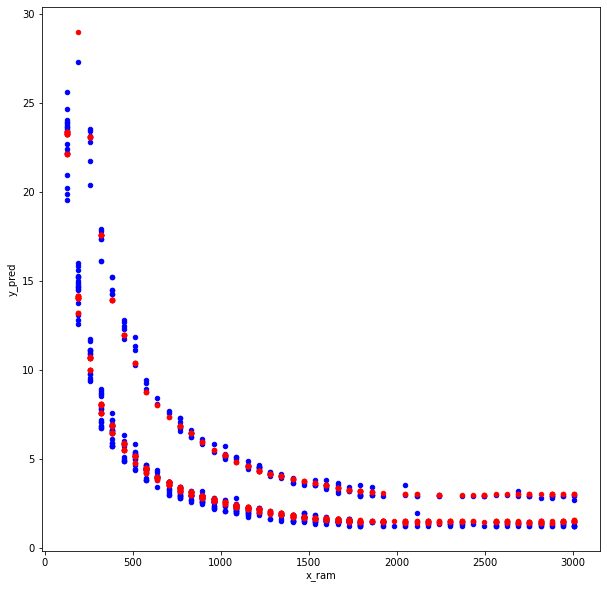

In [91]:
plt.figure (figsize=(10,10))
ax = df.plot(kind = 'scatter', x = 'x_ram',
                  y = 'y_test', color = 'Blue', figsize=(10,10))
  
ax2 = df.plot(kind = 'scatter', x = 'x_ram', 
                   y = 'y_pred',
                   color = 'Red',
                   ax = ax, figsize=(10,10))


